In [1]:
if (!require("MASS")) install.packages("MASS")   # For stepwise regression
if (!require("leaps")) install.packages("leaps") # For all-subset regression
if (!require("glmulti")) install.packages("glmulti") # For automated all-subset regression

library(MASS)
library(leaps)
library(glmulti)


Loading required package: MASS



Loading required package: leaps



Loading required package: glmulti



Warning message in library(package, lib.loc = lib.loc, character.only = TRUE, logical.return = TRUE, :
“there is no package called ‘glmulti’”


Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



also installing the dependency ‘rJava’




Loading required package: rJava



In [2]:
# Load the dataset
data <- read.csv("/kaggle/input/who-life/who_train.csv")

# Drop unnecessary columns
data <- subset(data, select = -c(Country, Year))

# Convert categorical variables (if needed)
data$Status <- as.factor(data$Status)

# Handle missing values
data[is.na(data)] <- 0  # Replace NA values with 0

# Check the structure of the dataset
str(data)

'data.frame':	183 obs. of  20 variables:
 $ Status                         : Factor w/ 2 levels "Developed","Developing": 2 2 2 2 2 2 2 1 1 2 ...
 $ Life.expectancy                : num  59.9 77.5 75.4 51.7 76.2 76.2 74.6 82.7 81.4 72.5 ...
 $ Adult.Mortality                : num  271 8 11 348 131 118 12 6 66 119 ...
 $ infant.deaths                  : int  64 0 21 67 0 8 1 1 0 5 ...
 $ Alcohol                        : num  0.01 4.51 0.01 8.33 8.56 ...
 $ percentage.expenditure         : num  73.5 428.7 54.2 24 2423 ...
 $ Hepatitis.B                    : num  62 98 95 64 99 94 93 91 98 94 ...
 $ Measles                        : int  492 0 0 11699 0 1 13 340 117 0 ...
 $ BMI                            : num  18.6 57.2 58.4 22.7 47 62.2 54.1 66.1 57.1 51.5 ...
 $ under.five.deaths              : int  86 1 24 101 0 9 1 1 0 6 ...
 $ Polio                          : num  58 98 95 68 96 92 95 92 98 97 ...
 $ Total.expenditure              : num  8.18 5.88 7.21 3.31 5.54 ...
 $ Diphtheria   

In [3]:
# Fit the full linear model
full_model <- lm(Life.expectancy ~ ., data = data)

# Display summary of the full model
summary(full_model)



Call:
lm(formula = Life.expectancy ~ ., data = data)

Residuals:
     Min       1Q   Median       3Q      Max 
-12.4441  -1.9236   0.0184   2.1429  13.1074 

Coefficients:
                                  Estimate Std. Error t value Pr(>|t|)    
(Intercept)                      6.873e+01  2.294e+00  29.958  < 2e-16 ***
StatusDeveloping                -2.530e+00  1.003e+00  -2.522 0.012622 *  
Adult.Mortality                 -2.825e-02  3.931e-03  -7.187 2.26e-11 ***
infant.deaths                    1.253e-01  6.355e-02   1.972 0.050285 .  
Alcohol                          2.526e-01  9.098e-02   2.776 0.006146 ** 
percentage.expenditure          -9.047e-05  2.990e-04  -0.303 0.762614    
Hepatitis.B                     -2.087e-02  1.453e-02  -1.437 0.152738    
Measles                         -2.475e-05  5.408e-05  -0.458 0.647810    
BMI                              1.993e-02  1.702e-02   1.171 0.243253    
under.five.deaths               -9.288e-02  4.373e-02  -2.124 0.035184 *  
Po

In [4]:
# Perform AIC-based stepwise regression
stepwise_model_aic <- step(full_model, direction = "both", trace = TRUE)

# Summary of the AIC-selected model
summary(stepwise_model_aic)


Start:  AIC=513.69
Life.expectancy ~ Status + Adult.Mortality + infant.deaths + 
    Alcohol + percentage.expenditure + Hepatitis.B + Measles + 
    BMI + under.five.deaths + Polio + Total.expenditure + Diphtheria + 
    HIV.AIDS + GDP + Population + thinness..1.19.years + thinness.5.9.years + 
    Income.composition.of.resources + Schooling

                                  Df Sum of Sq    RSS    AIC
- thinness.5.9.years               1      0.15 2435.8 511.70
- percentage.expenditure           1      1.37 2437.0 511.79
- Population                       1      1.63 2437.3 511.81
- Measles                          1      3.13 2438.8 511.93
- Schooling                        1      3.28 2438.9 511.94
- Polio                            1     10.54 2446.2 512.48
- GDP                              1     13.27 2448.9 512.68
- thinness..1.19.years             1     16.04 2451.7 512.89
- BMI                              1     20.49 2456.1 513.22
<none>                                       


Call:
lm(formula = Life.expectancy ~ Status + Adult.Mortality + infant.deaths + 
    Alcohol + under.five.deaths + Total.expenditure + Diphtheria + 
    HIV.AIDS + GDP + thinness..1.19.years + Income.composition.of.resources, 
    data = data)

Residuals:
     Min       1Q   Median       3Q      Max 
-12.4606  -1.7840   0.2186   2.0903  12.8650 

Coefficients:
                                  Estimate Std. Error t value Pr(>|t|)    
(Intercept)                      7.055e+01  1.989e+00  35.465  < 2e-16 ***
StatusDeveloping                -2.899e+00  9.333e-01  -3.107  0.00222 ** 
Adult.Mortality                 -2.955e-02  3.798e-03  -7.781 6.52e-13 ***
infant.deaths                    1.057e-01  3.868e-02   2.733  0.00694 ** 
Alcohol                          2.567e-01  8.637e-02   2.972  0.00339 ** 
under.five.deaths               -8.079e-02  2.921e-02  -2.765  0.00631 ** 
Total.expenditure                1.898e-01  1.121e-01   1.694  0.09214 .  
Diphtheria                       2.6

In [5]:
# Perform BIC-based stepwise regression
n <- nrow(data)  # Number of observations
stepwise_model_bic <- step(full_model, direction = "both", k = log(n), trace = TRUE)

# Summary of the BIC-selected model
summary(stepwise_model_bic)


Start:  AIC=577.88
Life.expectancy ~ Status + Adult.Mortality + infant.deaths + 
    Alcohol + percentage.expenditure + Hepatitis.B + Measles + 
    BMI + under.five.deaths + Polio + Total.expenditure + Diphtheria + 
    HIV.AIDS + GDP + Population + thinness..1.19.years + thinness.5.9.years + 
    Income.composition.of.resources + Schooling

                                  Df Sum of Sq    RSS    AIC
- thinness.5.9.years               1      0.15 2435.8 572.68
- percentage.expenditure           1      1.37 2437.0 572.77
- Population                       1      1.63 2437.3 572.79
- Measles                          1      3.13 2438.8 572.91
- Schooling                        1      3.28 2438.9 572.92
- Polio                            1     10.54 2446.2 573.46
- GDP                              1     13.27 2448.9 573.67
- thinness..1.19.years             1     16.04 2451.7 573.87
- BMI                              1     20.49 2456.1 574.20
- Diphtheria                       1     28.6


Call:
lm(formula = Life.expectancy ~ Status + Adult.Mortality + infant.deaths + 
    Alcohol + under.five.deaths + HIV.AIDS + thinness..1.19.years + 
    Income.composition.of.resources, data = data)

Residuals:
     Min       1Q   Median       3Q      Max 
-12.0784  -1.9807  -0.2852   2.1905  14.2023 

Coefficients:
                                 Estimate Std. Error t value Pr(>|t|)    
(Intercept)                     73.984170   1.597499  46.312  < 2e-16 ***
StatusDeveloping                -3.539890   0.915950  -3.865 0.000157 ***
Adult.Mortality                 -0.031344   0.003816  -8.214 4.68e-14 ***
infant.deaths                    0.108409   0.039298   2.759 0.006425 ** 
Alcohol                          0.300341   0.086045   3.490 0.000611 ***
under.five.deaths               -0.083532   0.029669  -2.815 0.005432 ** 
HIV.AIDS                        -1.076687   0.271968  -3.959 0.000110 ***
thinness..1.19.years            -0.276352   0.091993  -3.004 0.003057 ** 
Income.composi

In [6]:
# Adjusted R^2 for the AIC-selected model
adj_r2_aic <- summary(stepwise_model_aic)$adj.r.squared
cat("Adjusted R^2 for AIC-selected model:", adj_r2_aic, "\n")

# Adjusted R^2 for the BIC-selected model
adj_r2_bic <- summary(stepwise_model_bic)$adj.r.squared
cat("Adjusted R^2 for BIC-selected model:", adj_r2_bic, "\n")


Adjusted R^2 for AIC-selected model: 0.7996924 


Adjusted R^2 for BIC-selected model: 0.7921614 


Best model size: 8 


Variables in the best model: (Intercept), StatusDeveloping, Adult.Mortality, Alcohol, Polio, Total.expenditure, HIV.AIDS, thinness.5.9.years, Income.composition.of.resources 


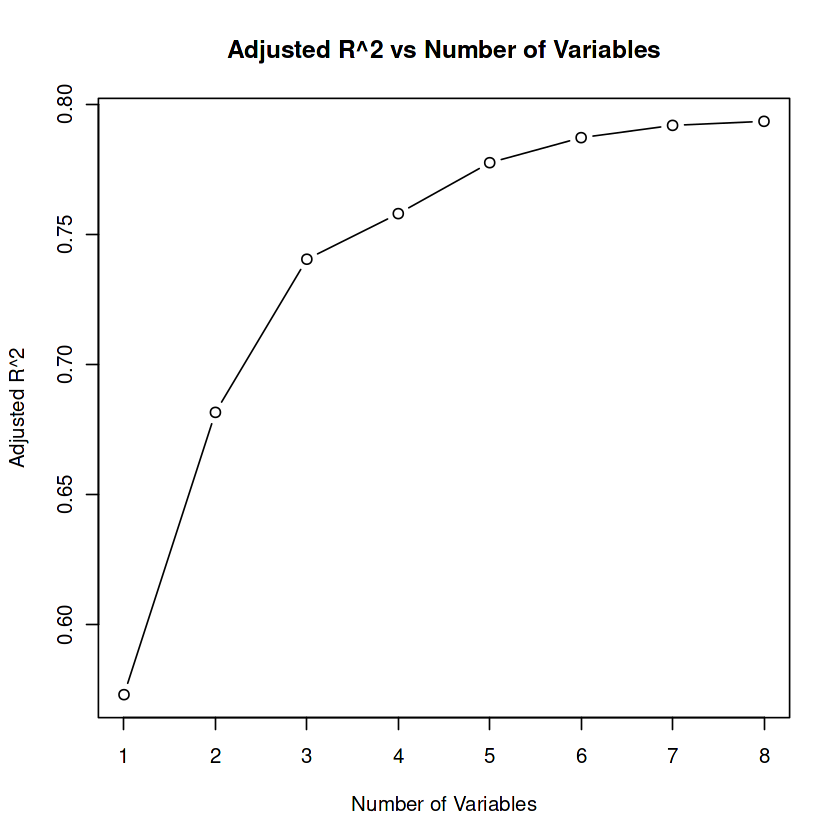

In [7]:
# Perform all-subset regression using leaps
all_subset <- regsubsets(Life.expectancy ~ ., data = data, nbest = 1)

# View summary of all-subset regression
subset_summary <- summary(all_subset)

# Plot Adjusted R^2 for each model size
plot(subset_summary$adjr2, xlab = "Number of Variables", ylab = "Adjusted R^2", type = "b",
     main = "Adjusted R^2 vs Number of Variables")

# Identify the best model based on Adjusted R^2
best_model_size <- which.max(subset_summary$adjr2)
cat("Best model size:", best_model_size, "\n")

# Variables in the best model
best_model_vars <- names(coef(all_subset, best_model_size))
cat("Variables in the best model:", paste(best_model_vars, collapse = ", "), "\n")


Initialization...
TASK: Exhaustive screening of candidate set.
Fitting...



After 50 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure
Crit= 1096.8789069601
Mean crit= 1196.69649114838



After 100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI
Crit= 1088.92843317719
Mean crit= 1187.17414391812



After 150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI
Crit= 1088.92843317719
Mean crit= 1146.44163456283


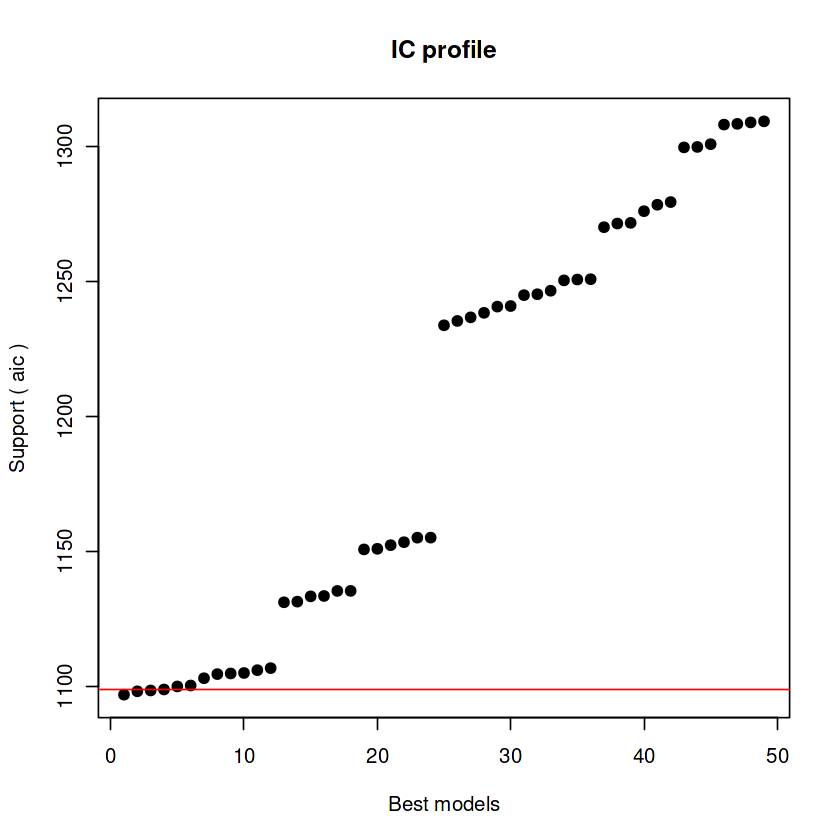


After 200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI
Crit= 1088.92843317719
Mean crit= 1120.1569617145


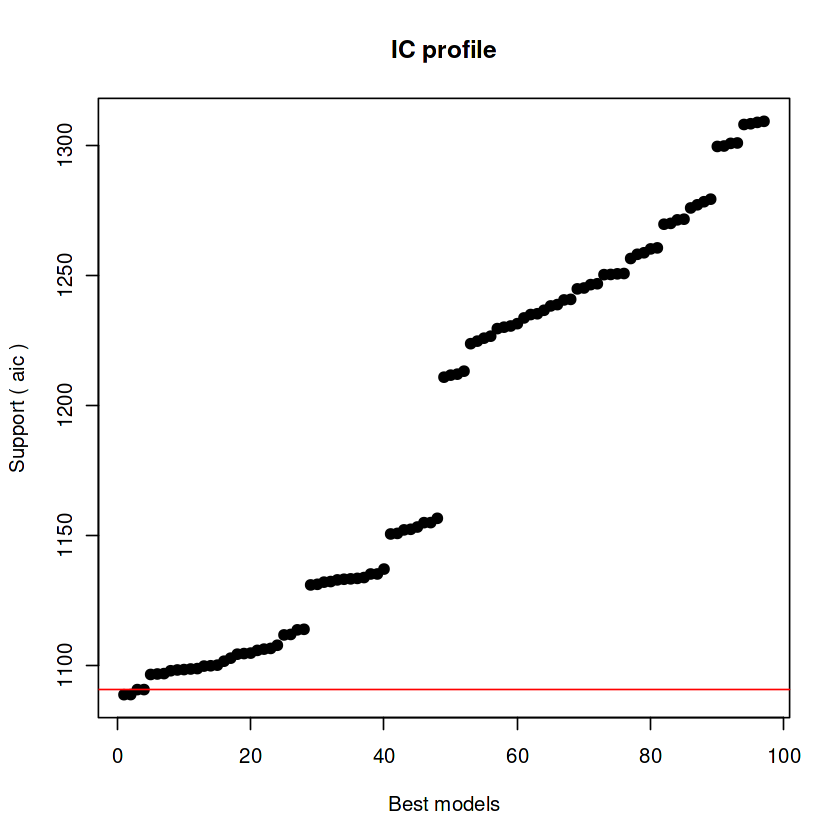


After 250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths
Crit= 1084.53710702953
Mean crit= 1108.23780129894


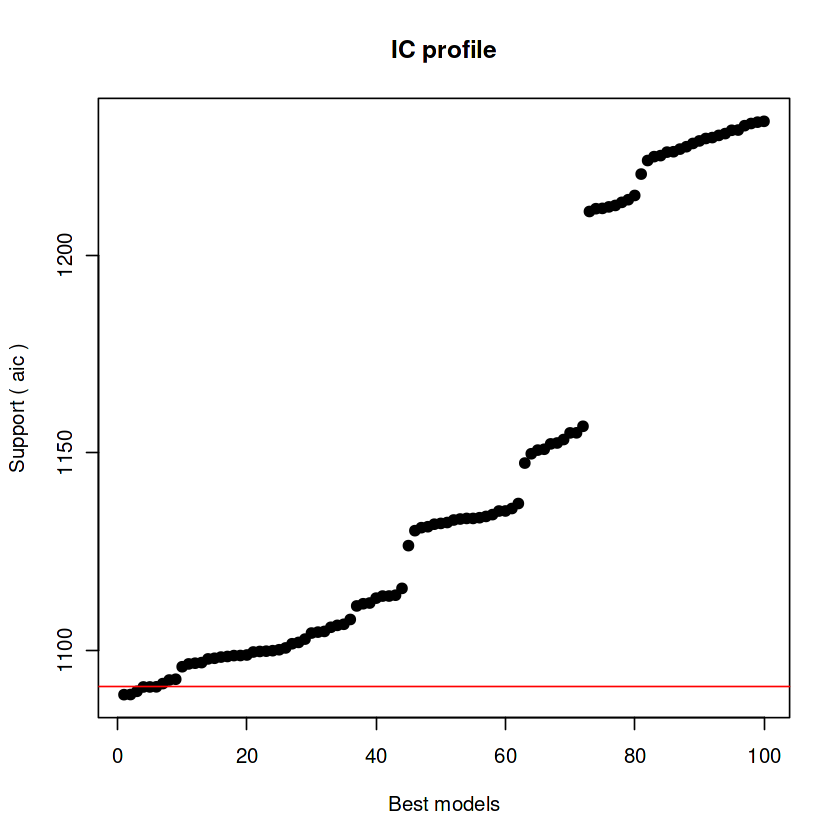


After 300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths
Crit= 1084.53710702953
Mean crit= 1103.14517883137


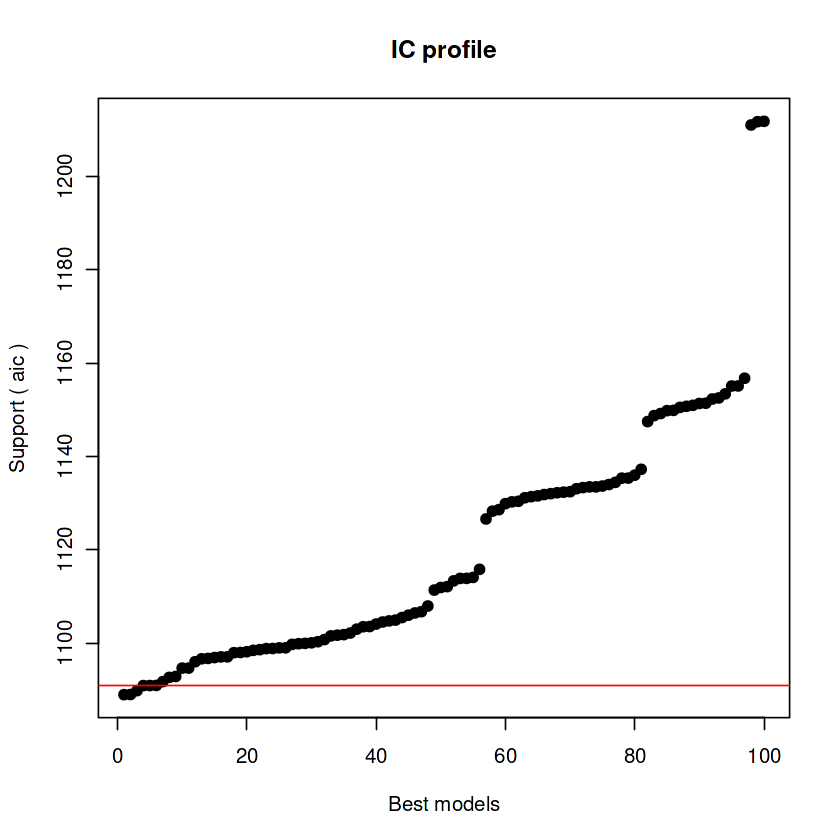


After 350 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+BMI+Polio
Crit= 1083.98637948802
Mean crit= 1098.96803617324


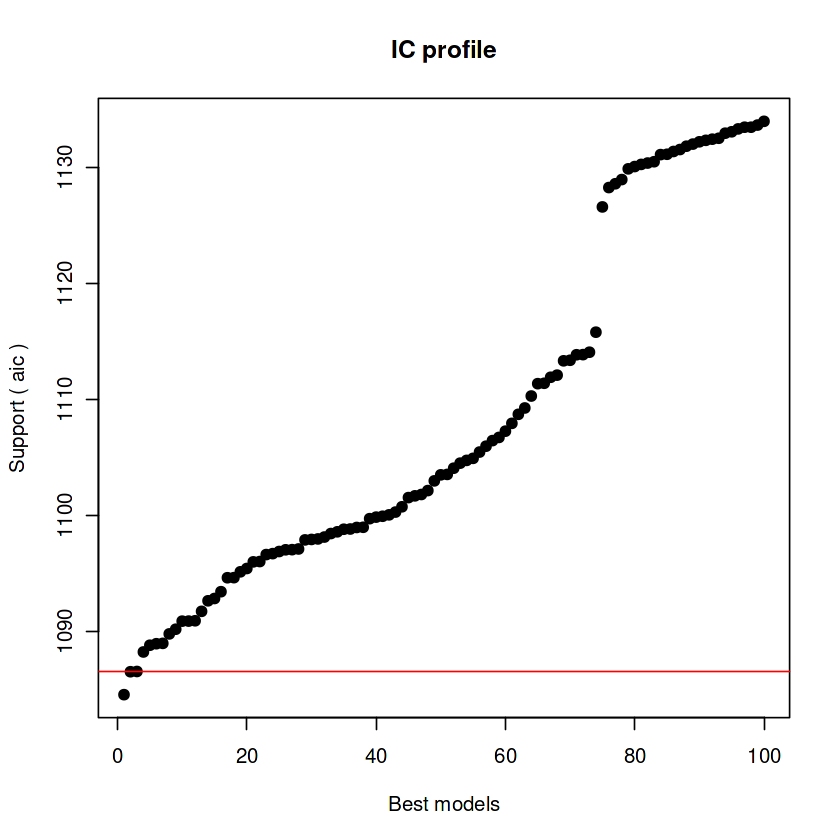


After 400 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+BMI+Polio
Crit= 1083.98637948802
Mean crit= 1096.1773072612


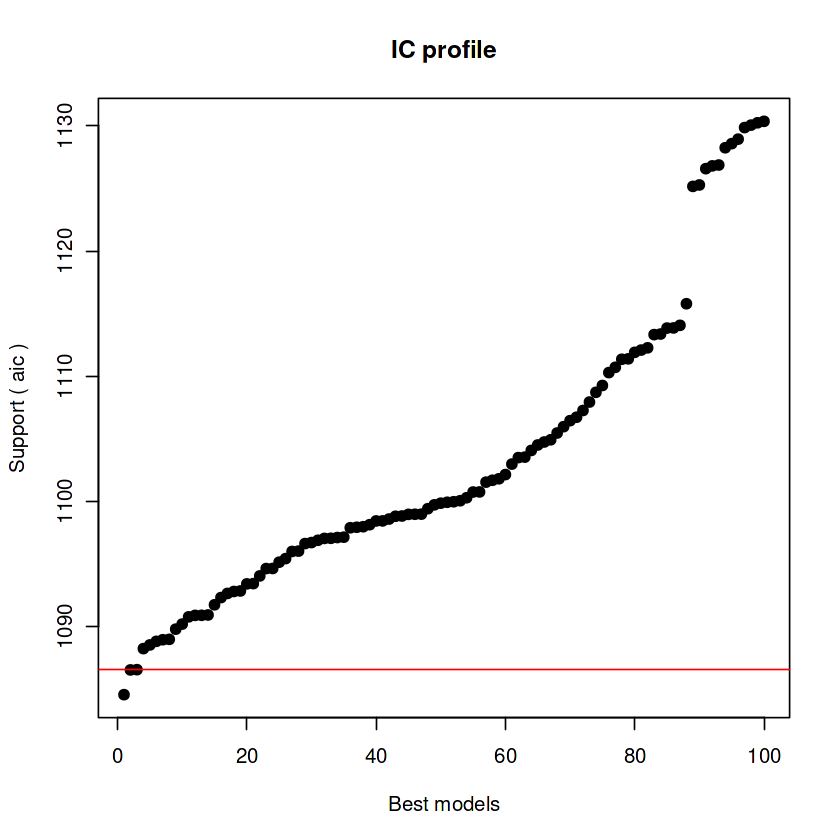


After 450 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+BMI+Polio
Crit= 1083.98637948802
Mean crit= 1094.81294888142


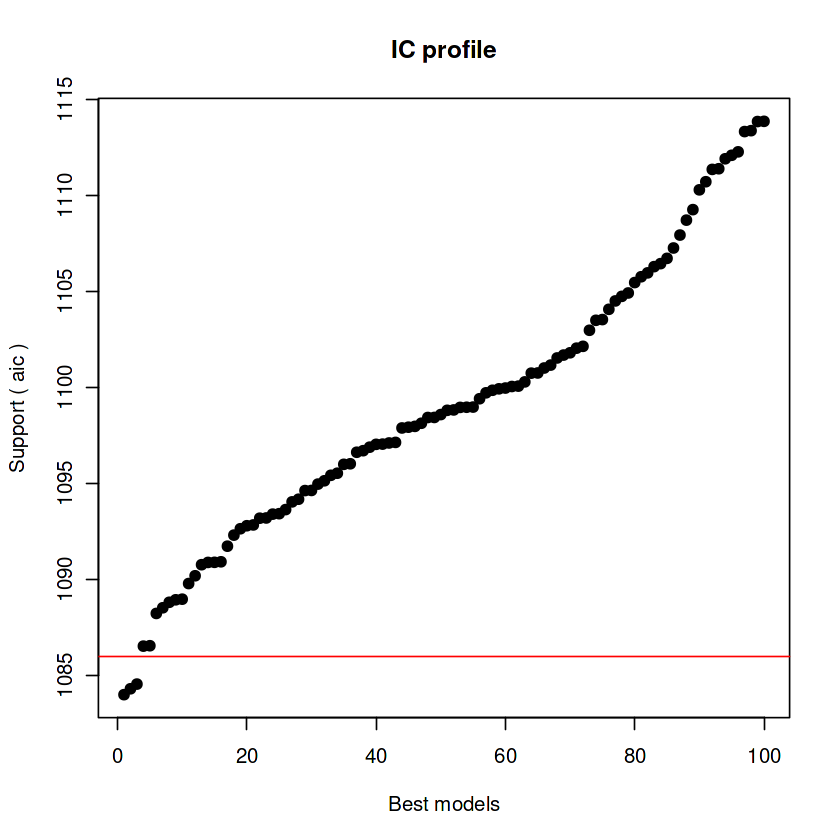


After 500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio
Crit= 1080.29475144141
Mean crit= 1093.2581977301


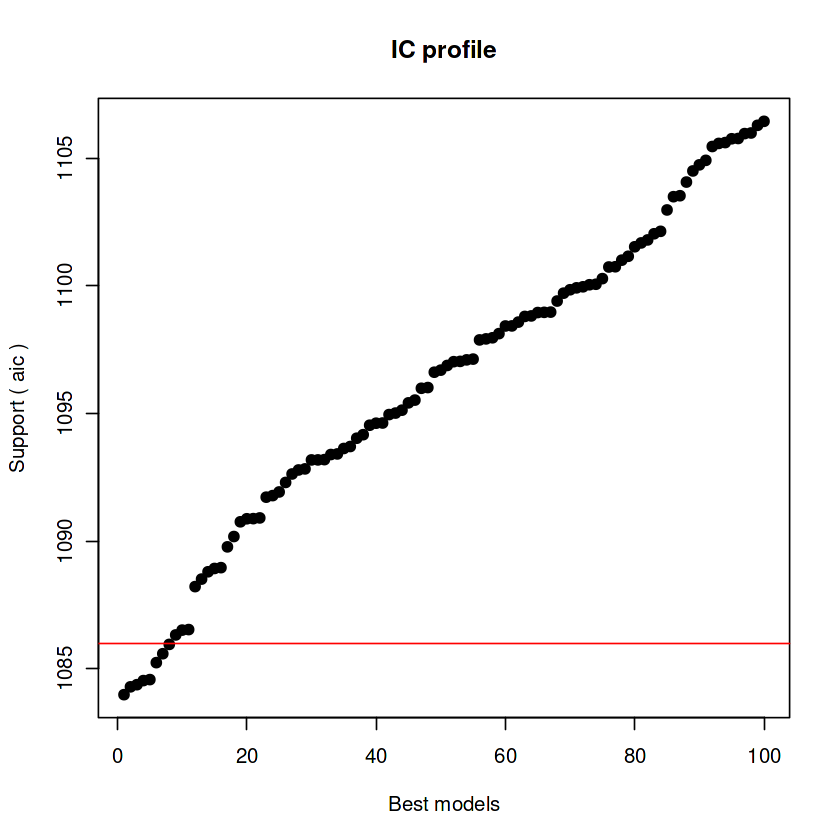


After 550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio
Crit= 1080.29475144141
Mean crit= 1092.17698424032


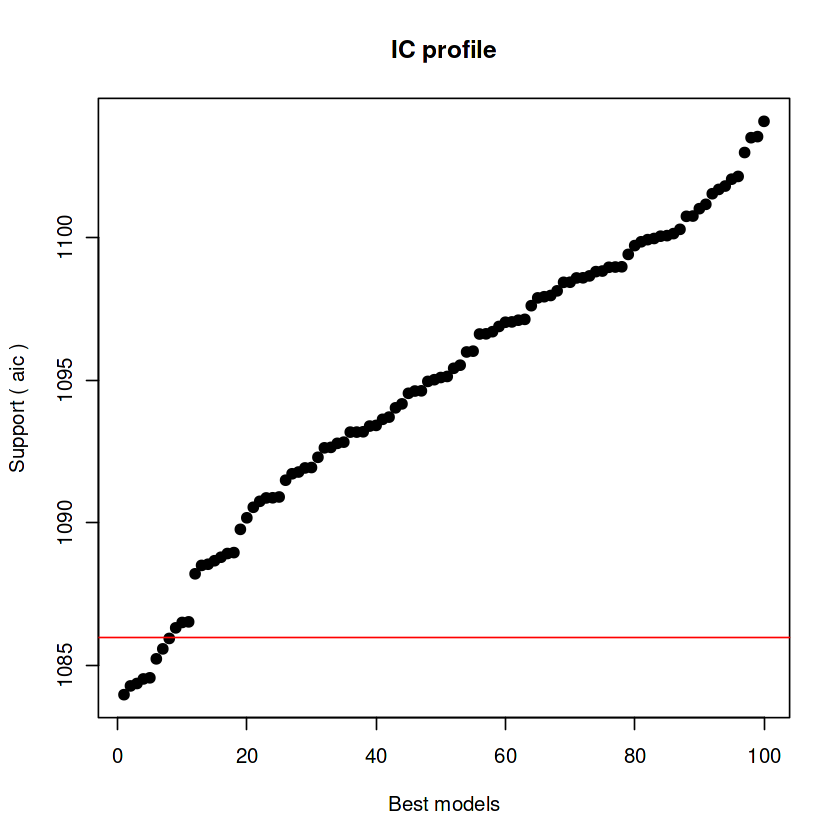


After 600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio
Crit= 1080.29475144141
Mean crit= 1092.05532337602


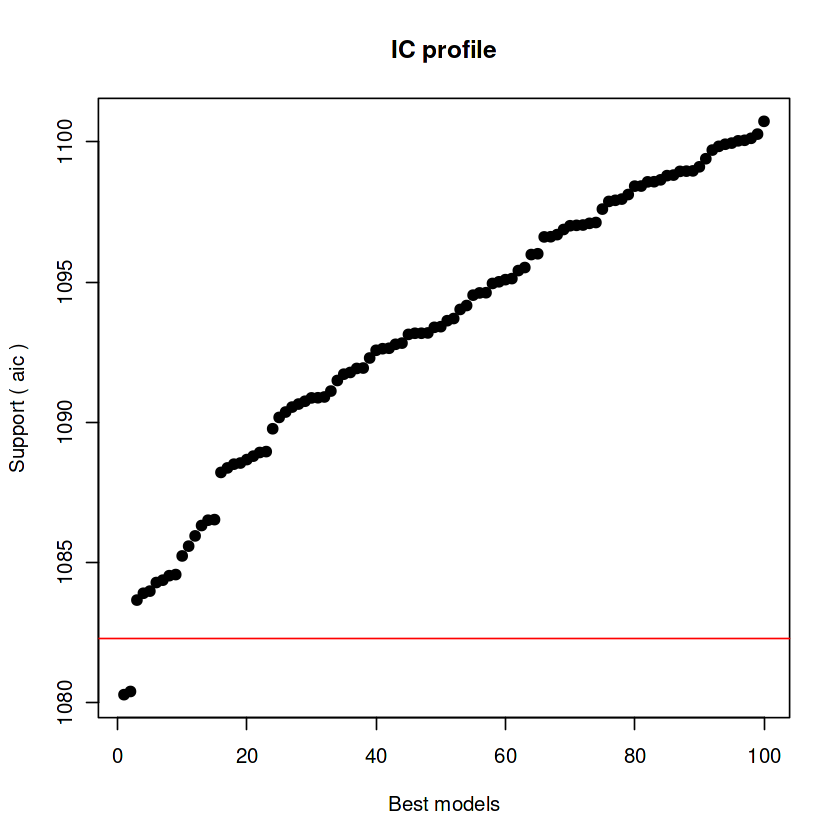


After 650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio
Crit= 1080.29475144141
Mean crit= 1091.22733128642


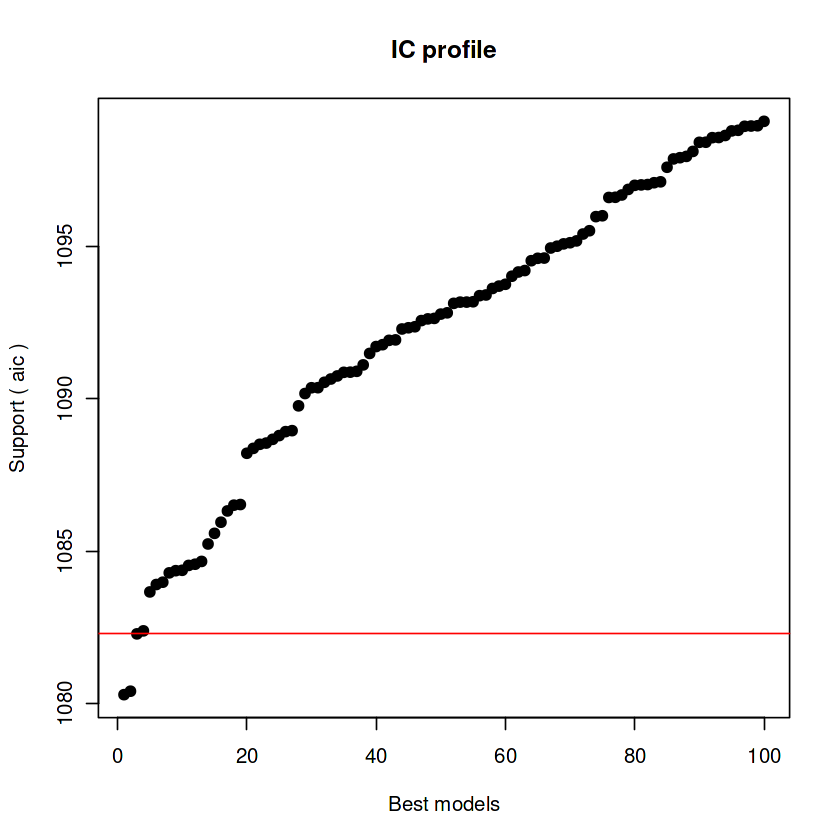


After 700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio
Crit= 1080.29475144141
Mean crit= 1090.89887195717


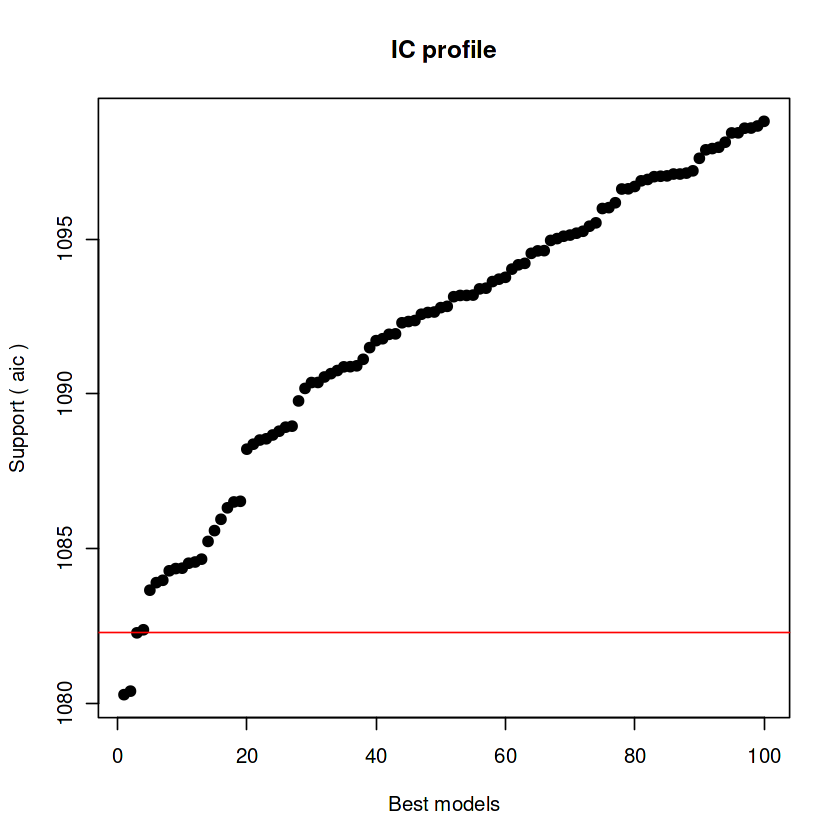


After 750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio
Crit= 1080.29475144141
Mean crit= 1090.46145856472


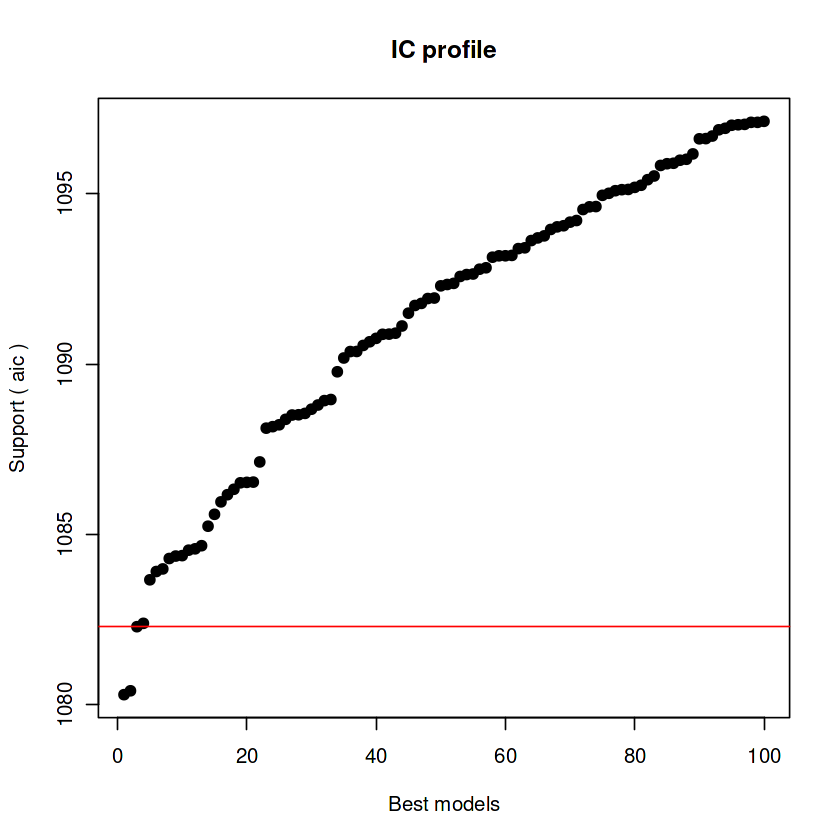


After 800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio
Crit= 1080.29475144141
Mean crit= 1089.80540229204


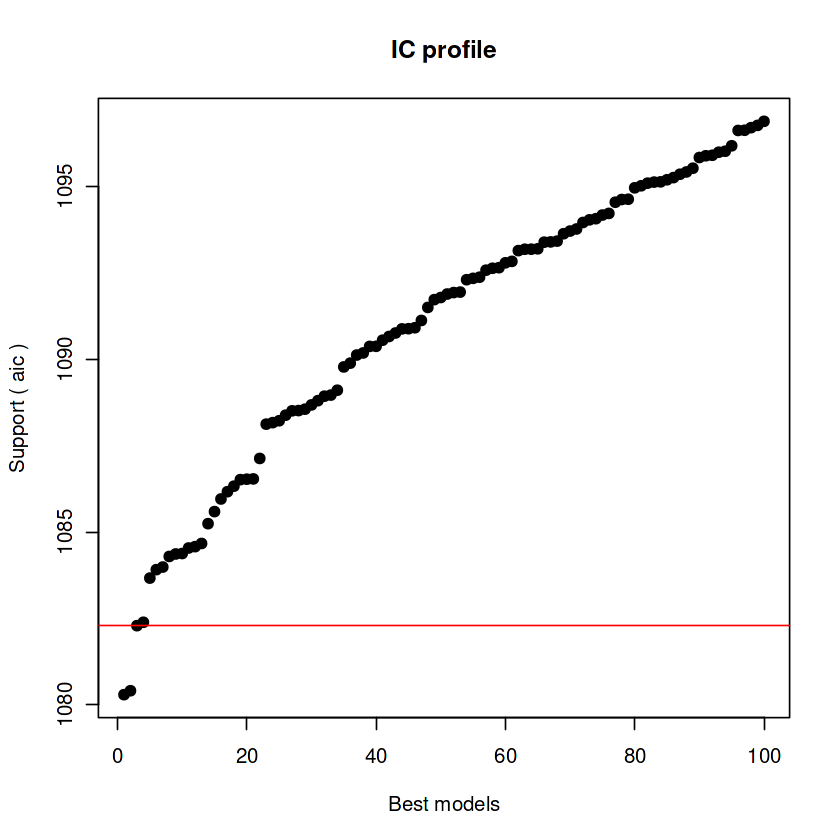


After 850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio
Crit= 1080.29475144141
Mean crit= 1089.61003376688


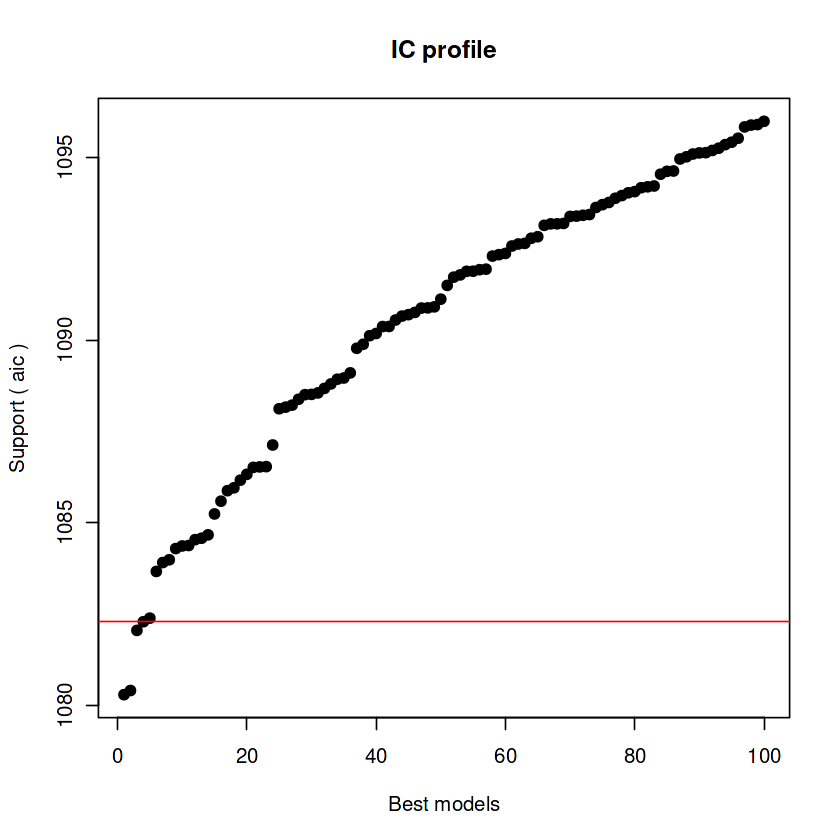


After 900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio
Crit= 1080.29475144141
Mean crit= 1088.98577362265


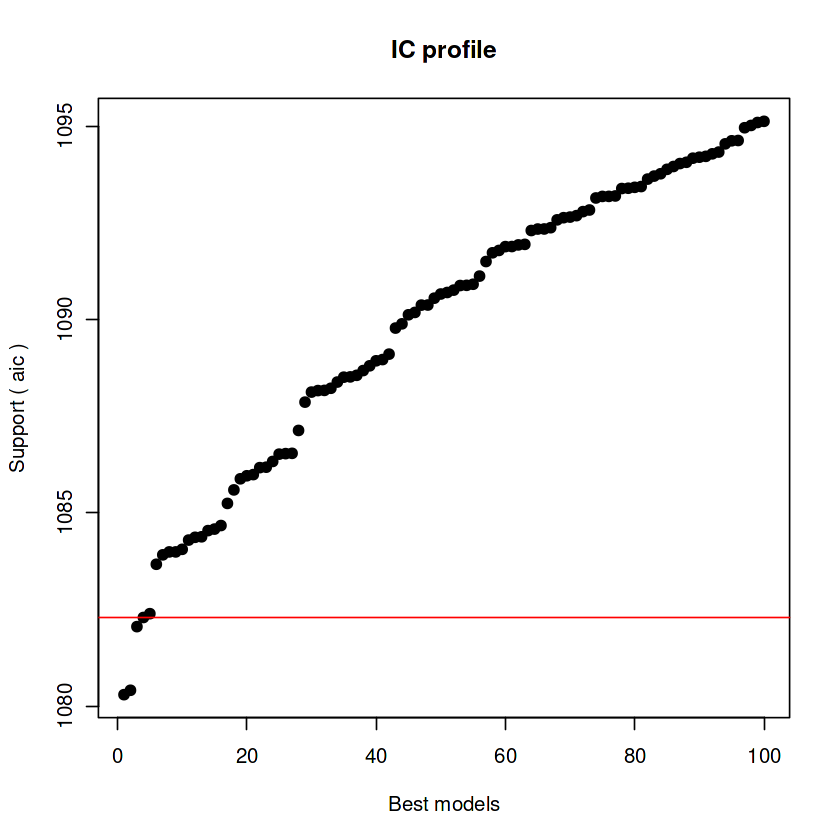


After 950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio
Crit= 1080.29475144141
Mean crit= 1088.46749554243


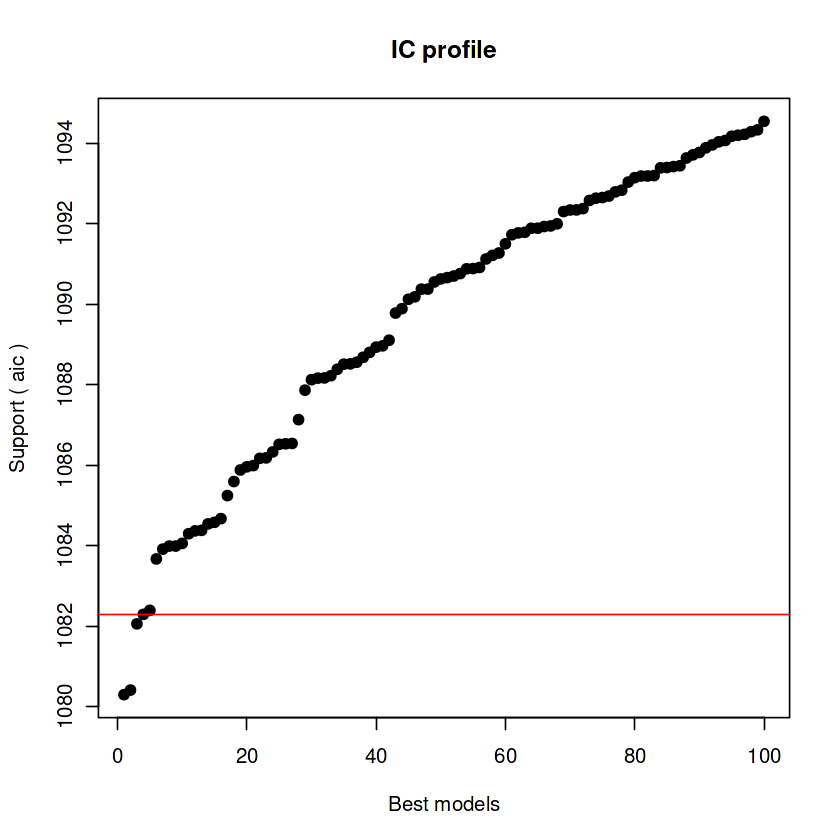


After 1000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio
Crit= 1080.29475144141
Mean crit= 1088.24312646866


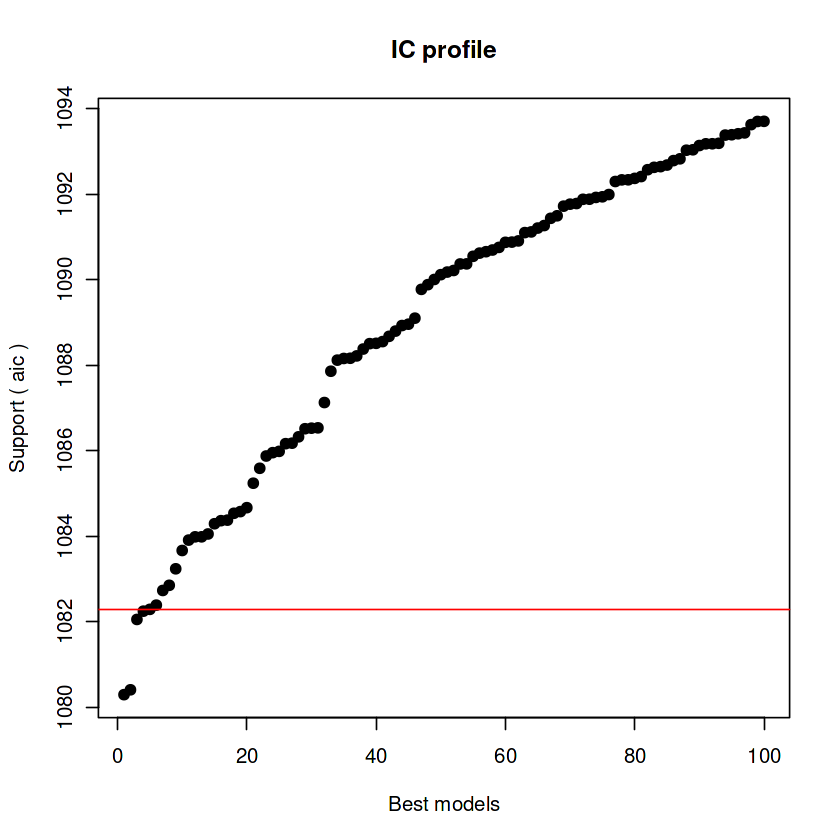


After 1050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+Total.expenditure
Crit= 1078.85712747789
Mean crit= 1087.40164055587


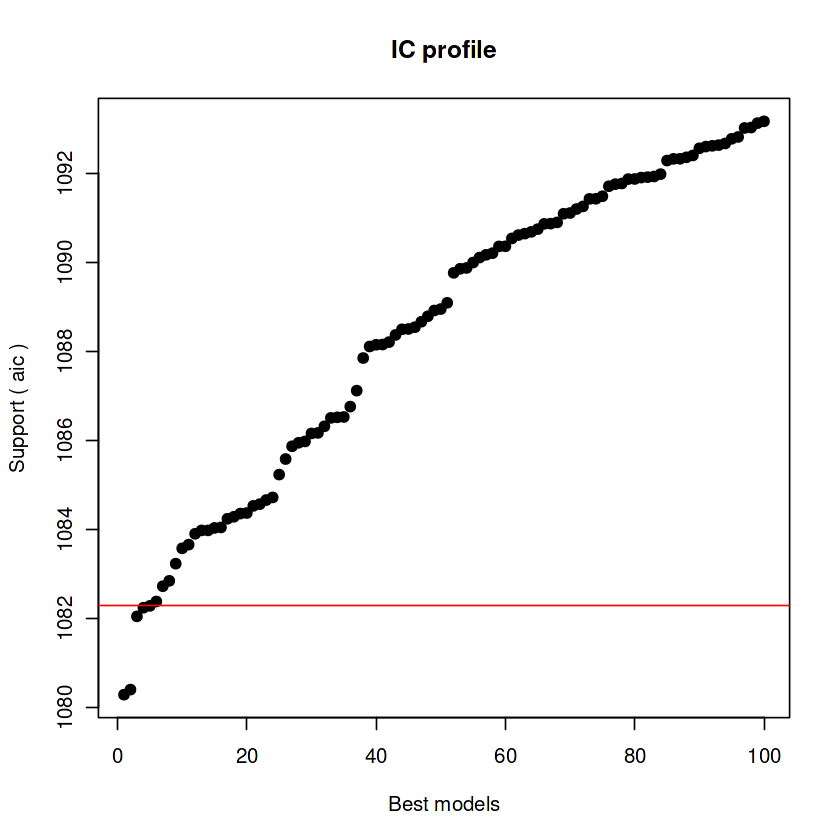


After 1100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+Total.expenditure
Crit= 1078.85712747789
Mean crit= 1086.97595058845


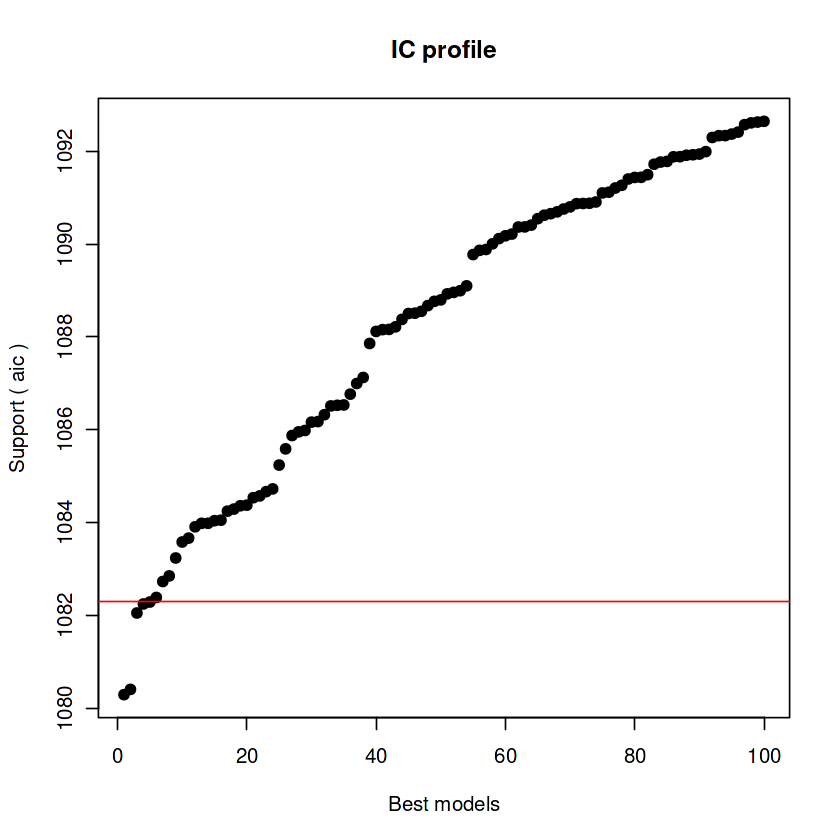


After 1150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+Total.expenditure
Crit= 1078.85712747789
Mean crit= 1086.46786880359


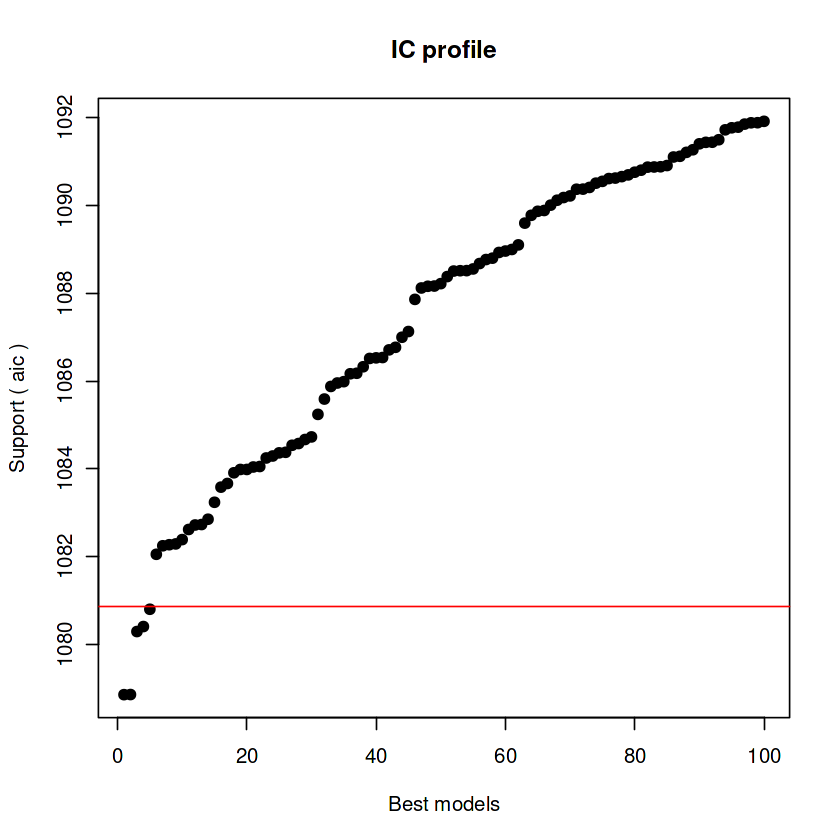


After 1200 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Diphtheria
Crit= 1076.36031125049
Mean crit= 1085.61192430137


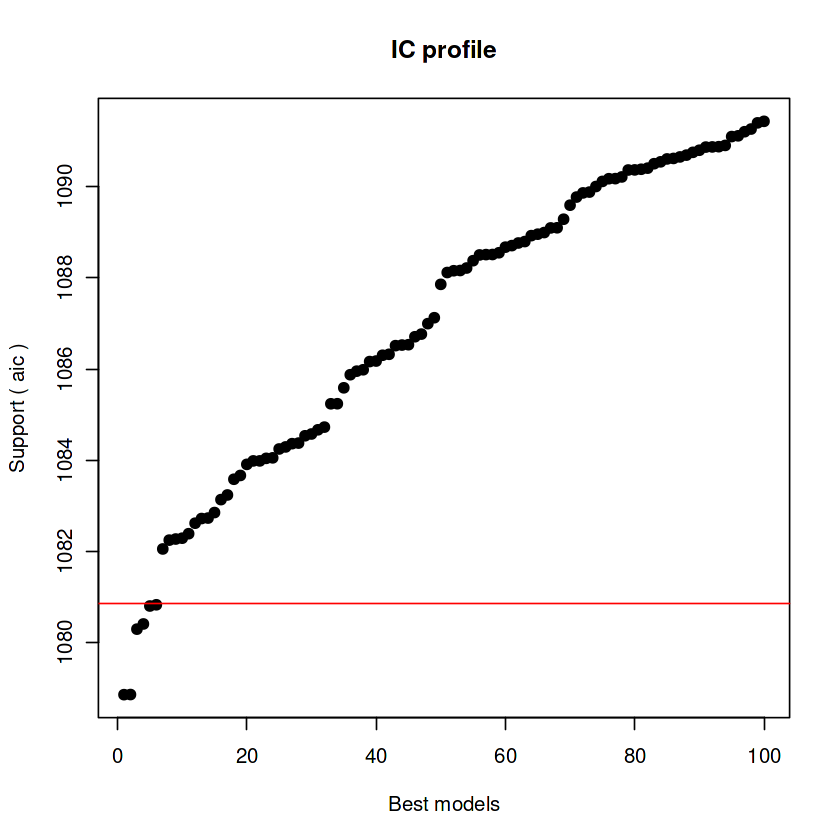


After 1250 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Diphtheria
Crit= 1076.36031125049
Mean crit= 1085.28751716589


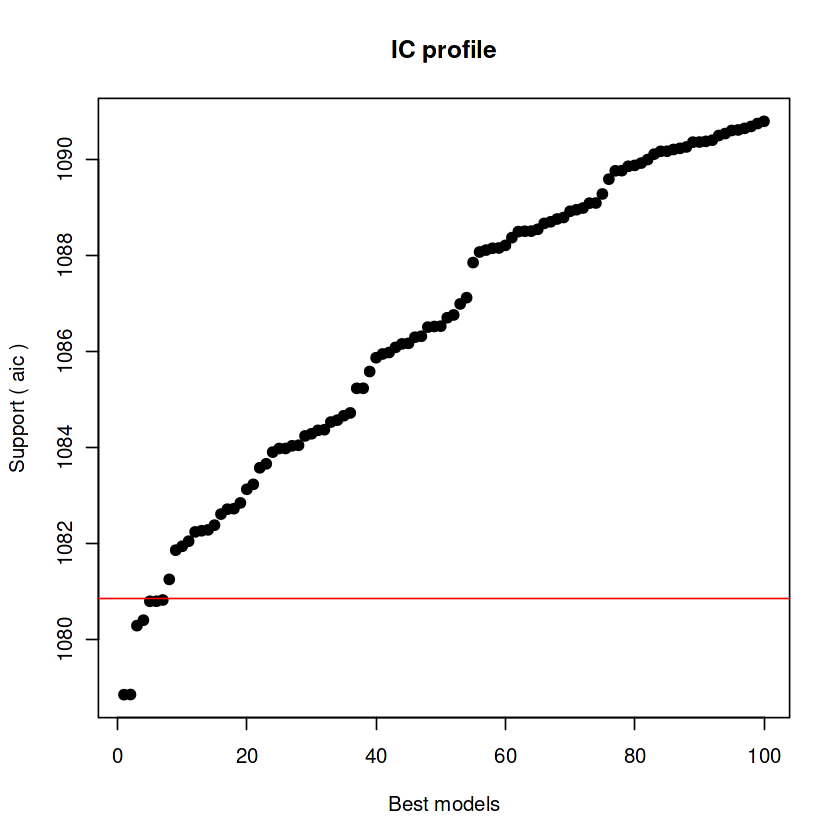


After 1300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria
Crit= 1072.98934954395
Mean crit= 1084.45646144606


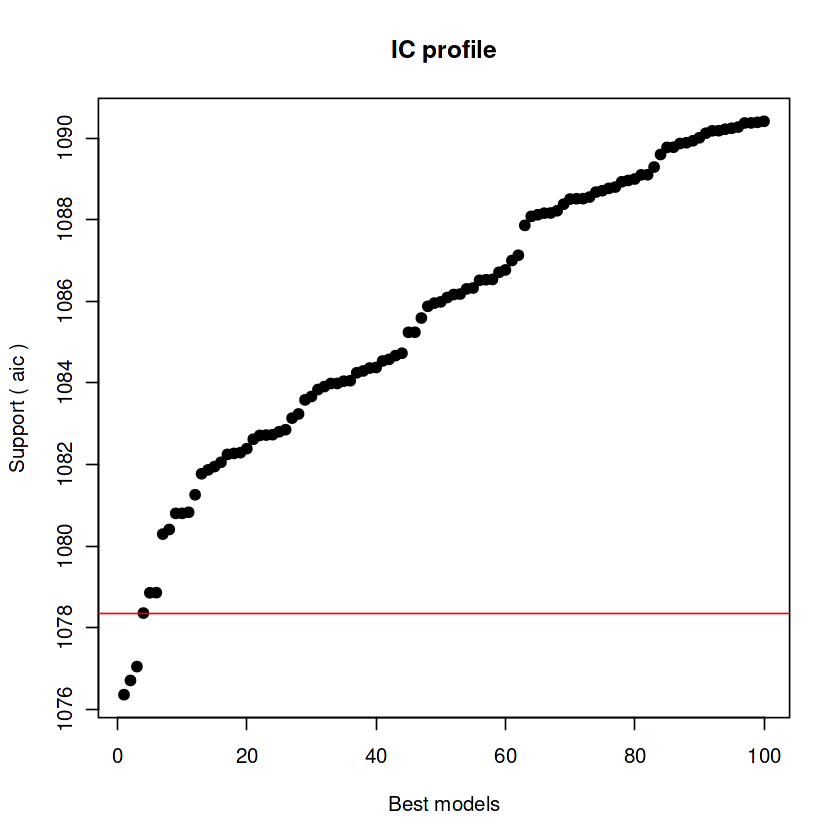


After 1350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria
Crit= 1072.98934954395
Mean crit= 1083.85801357716


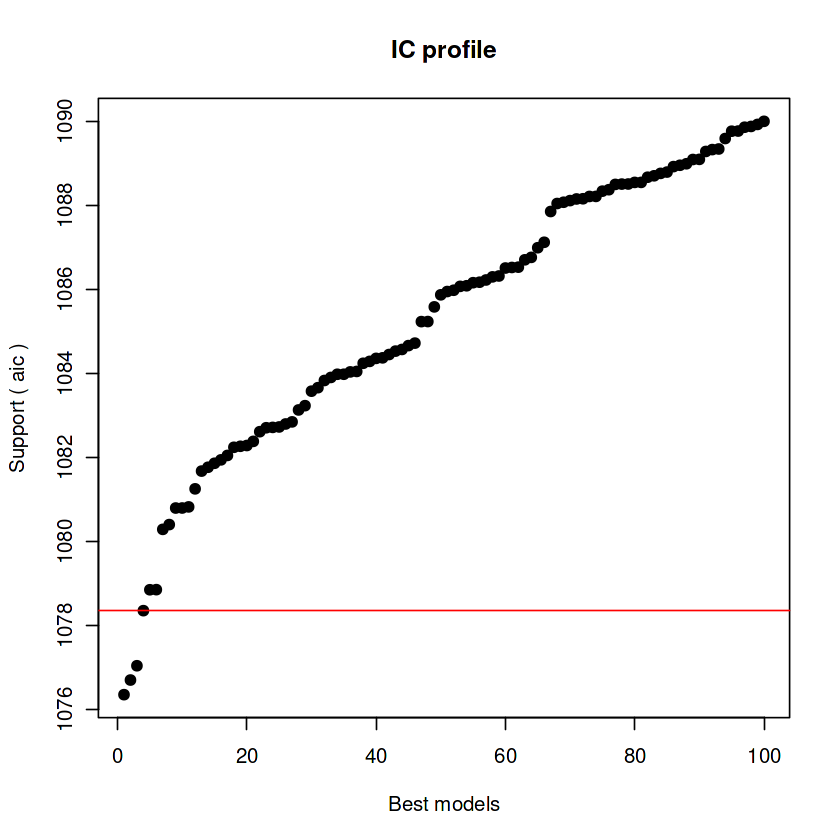


After 1400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria
Crit= 1072.98934954395
Mean crit= 1083.81845375801


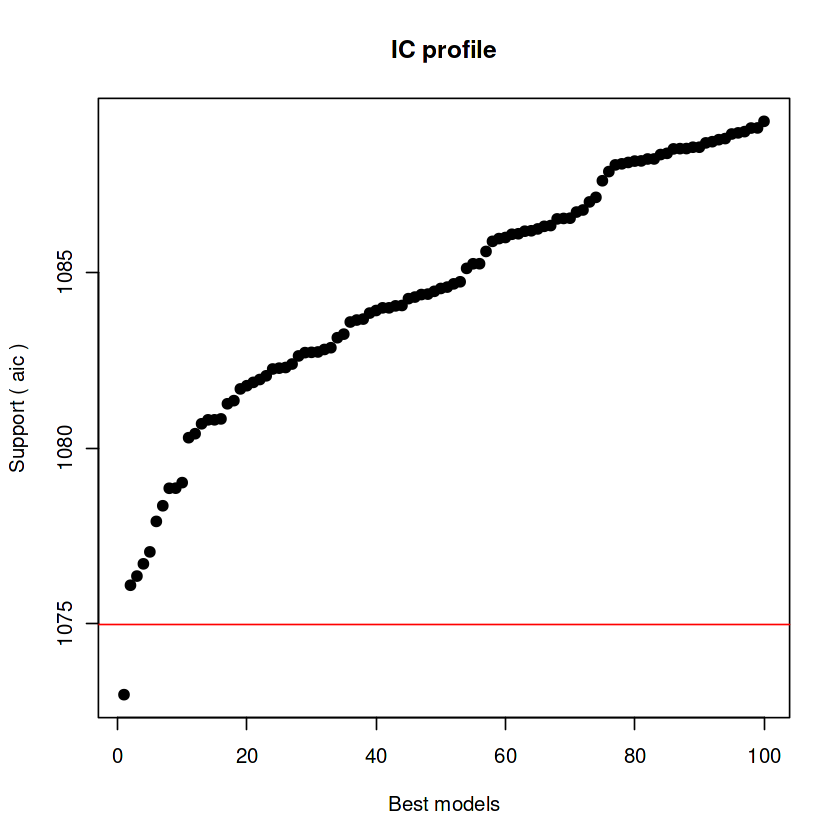


After 1450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria
Crit= 1072.98934954395
Mean crit= 1083.24171845412


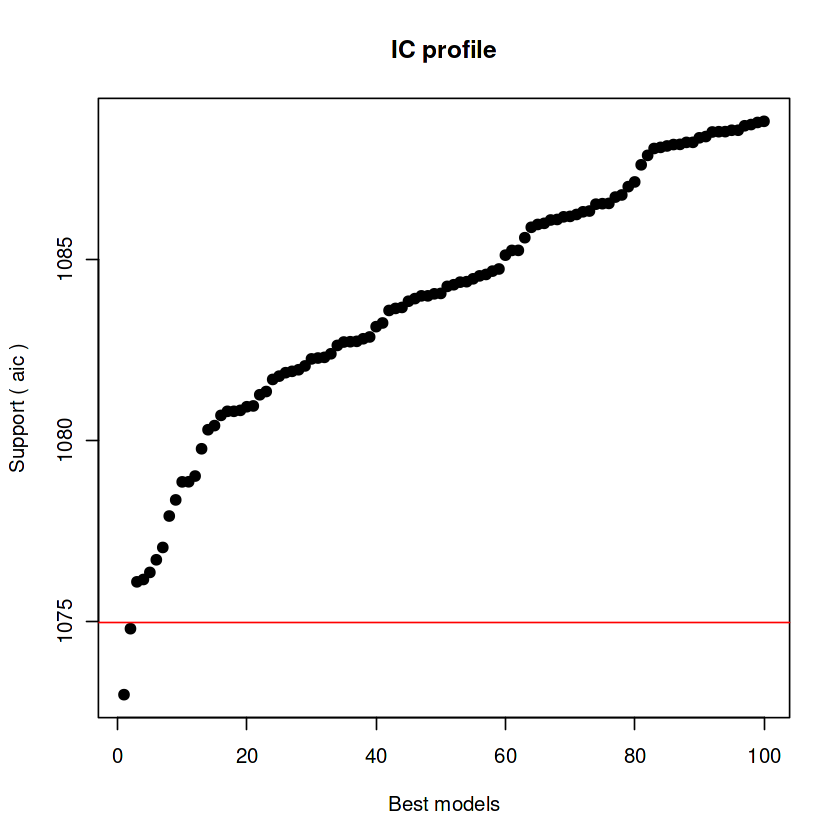


After 1500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria
Crit= 1072.98934954395
Mean crit= 1082.99070236553


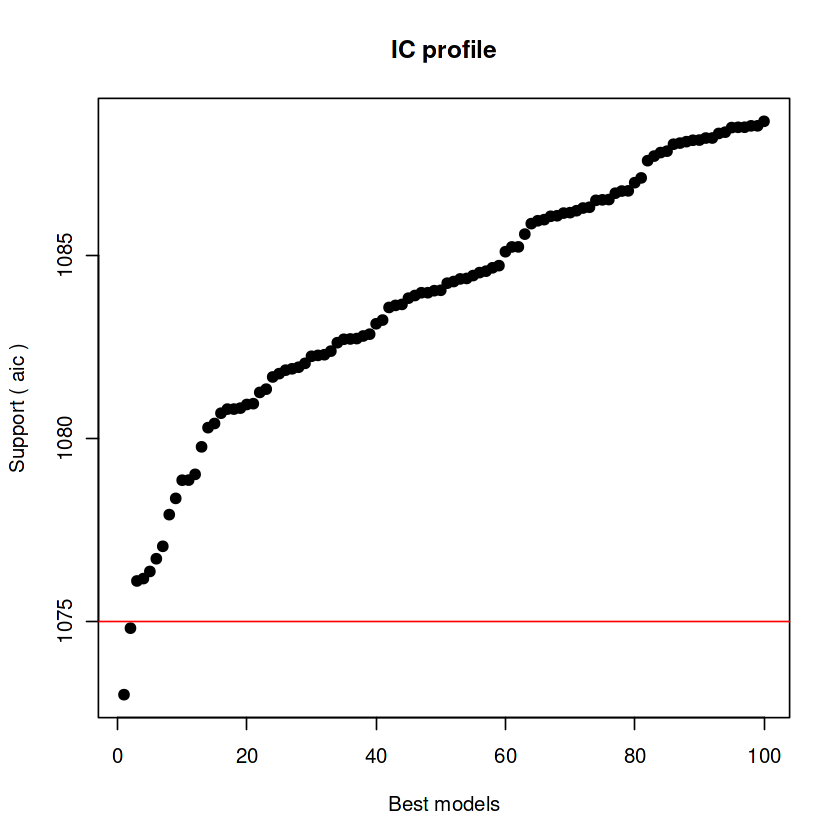


After 1550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria
Crit= 1072.98934954395
Mean crit= 1082.7072823075


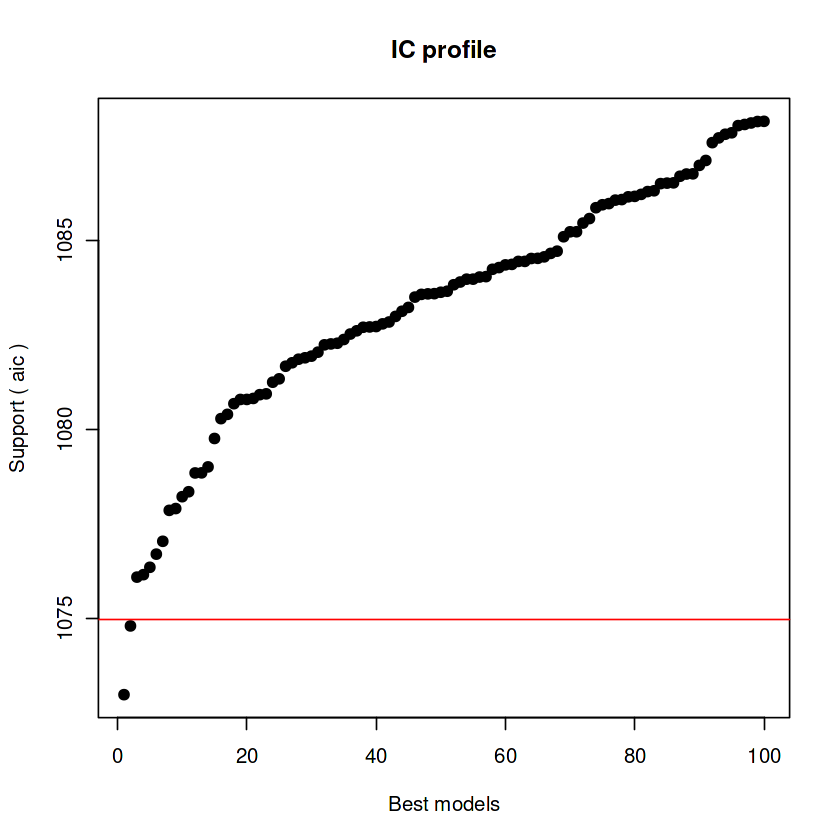


After 1600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria
Crit= 1072.98934954395
Mean crit= 1082.13853188349


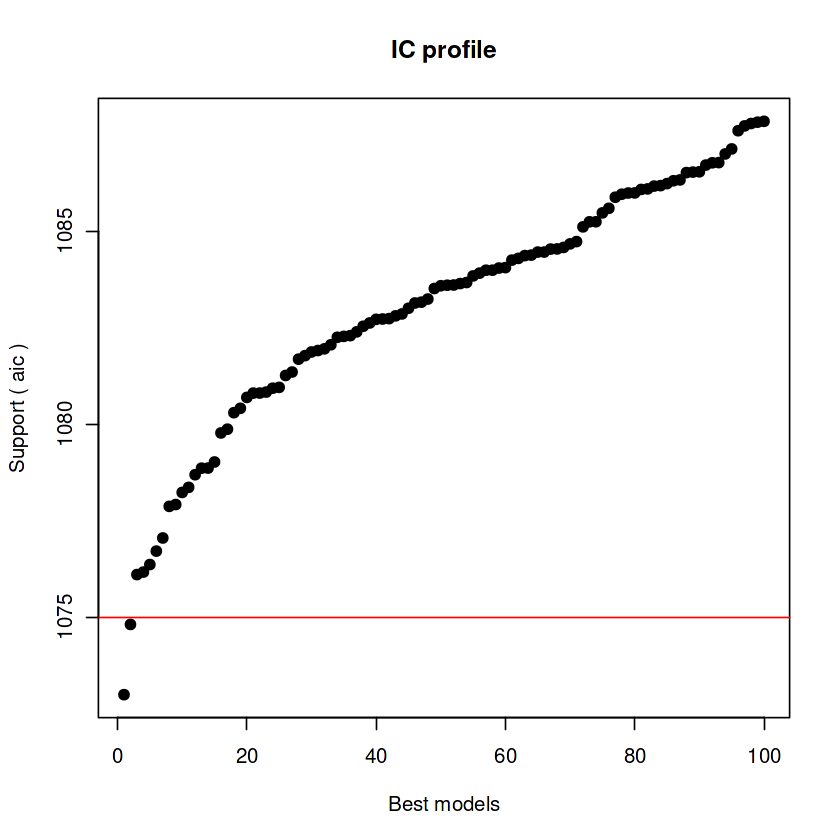


After 1650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria
Crit= 1072.98934954395
Mean crit= 1082.11299578296


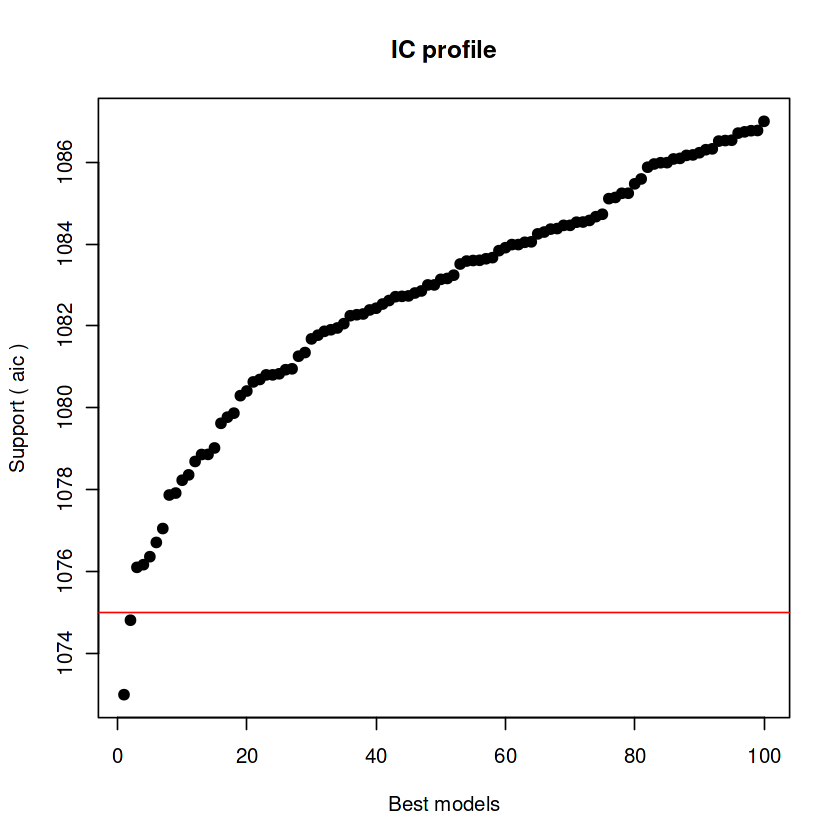


After 1700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria
Crit= 1072.98934954395
Mean crit= 1081.68859686267


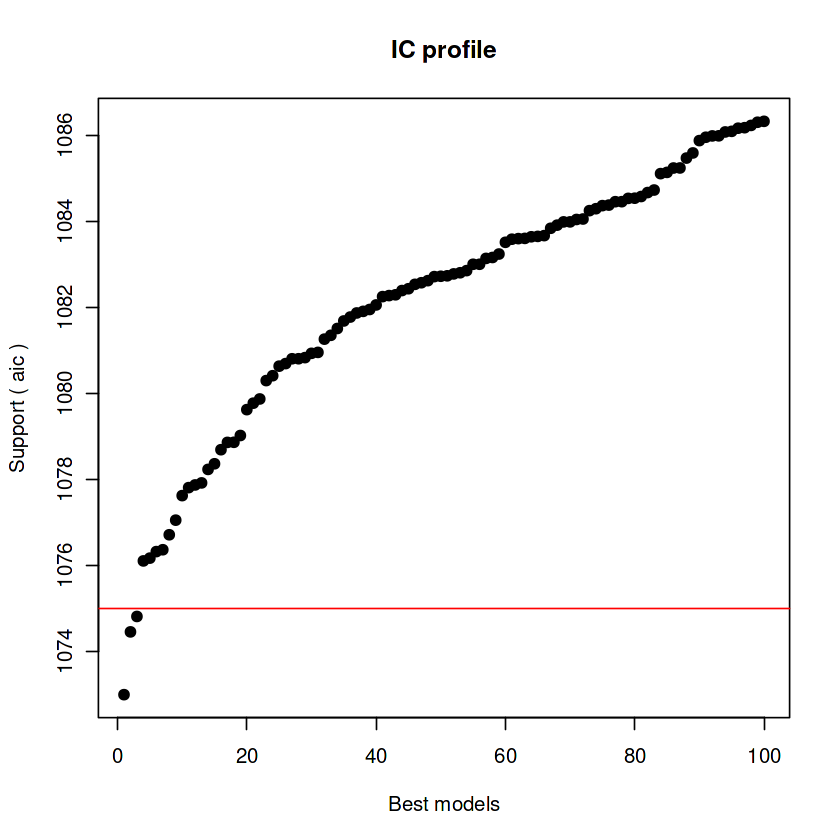


After 1750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria
Crit= 1072.98934954395
Mean crit= 1081.36676328866


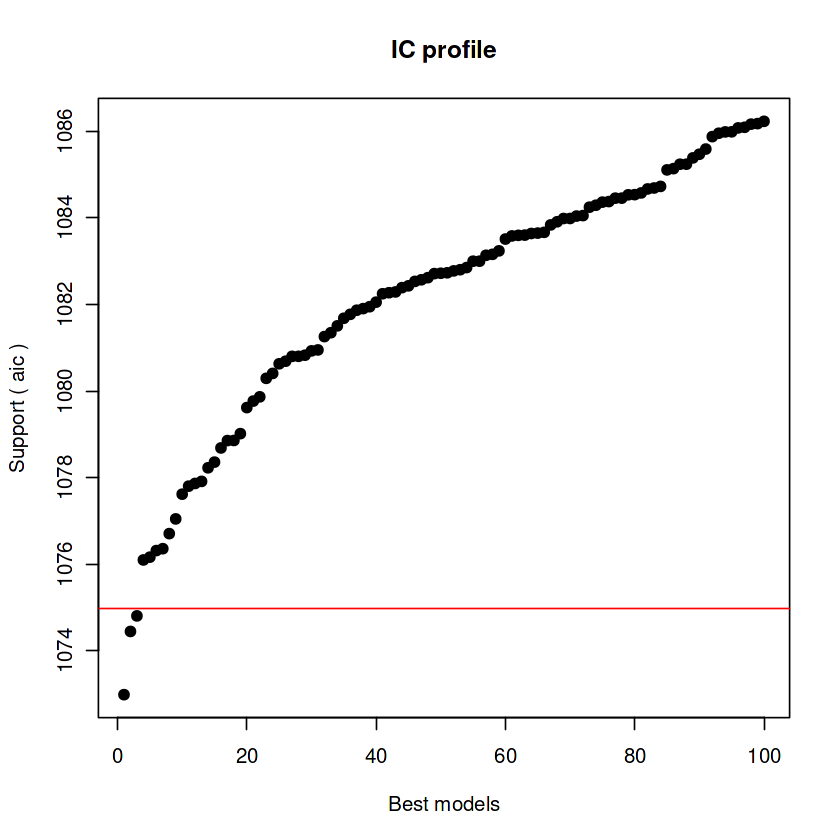


After 1800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria
Crit= 1072.98934954395
Mean crit= 1081.28711180206


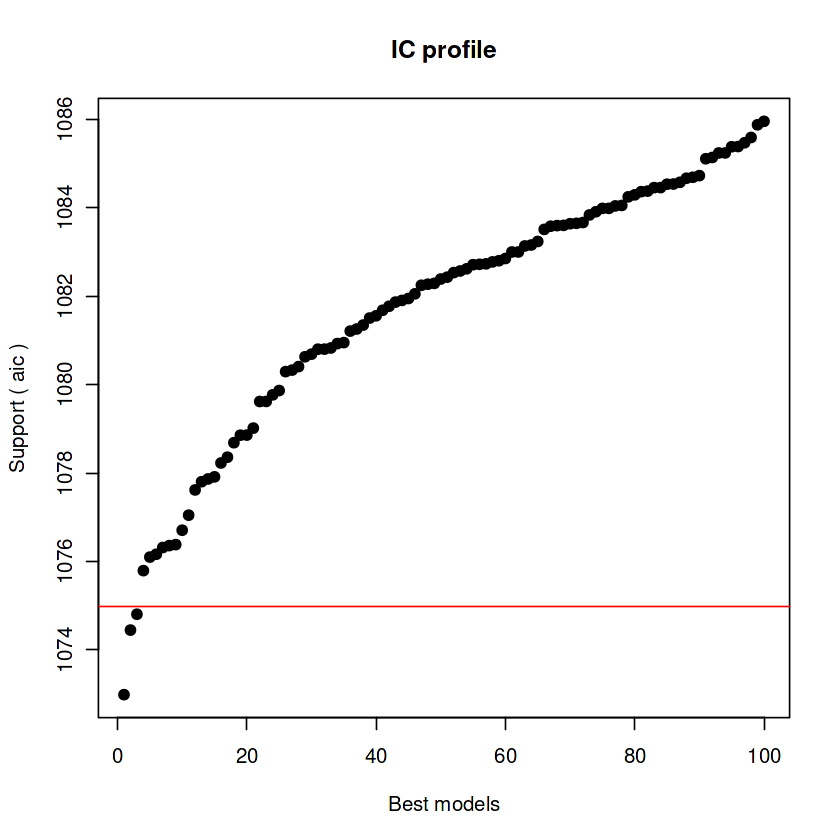


After 1850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1080.68001665913


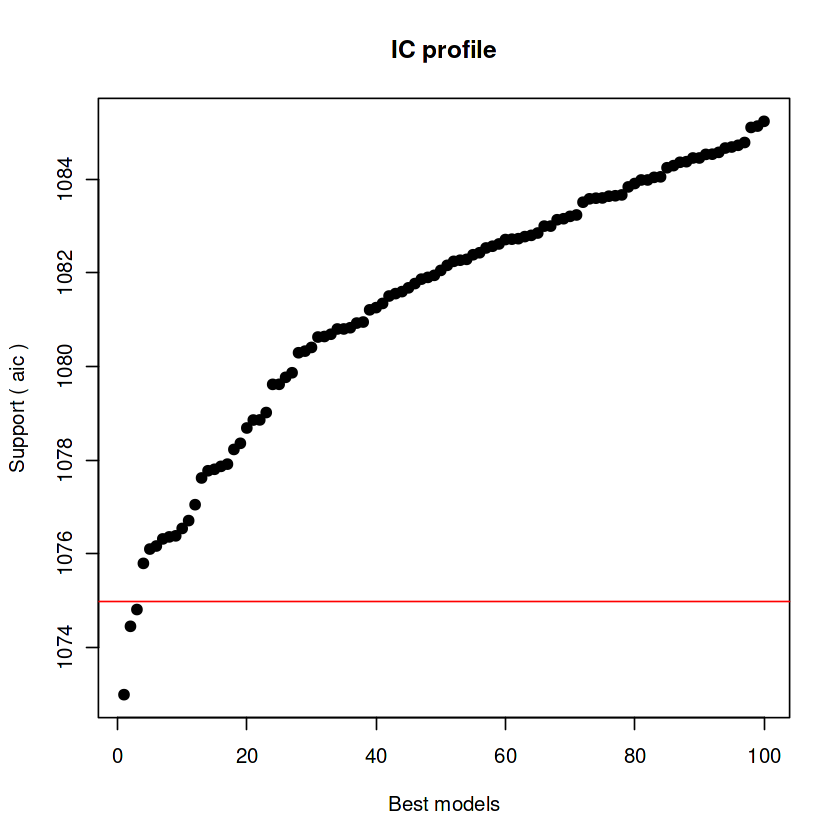


After 1900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1080.49322227908


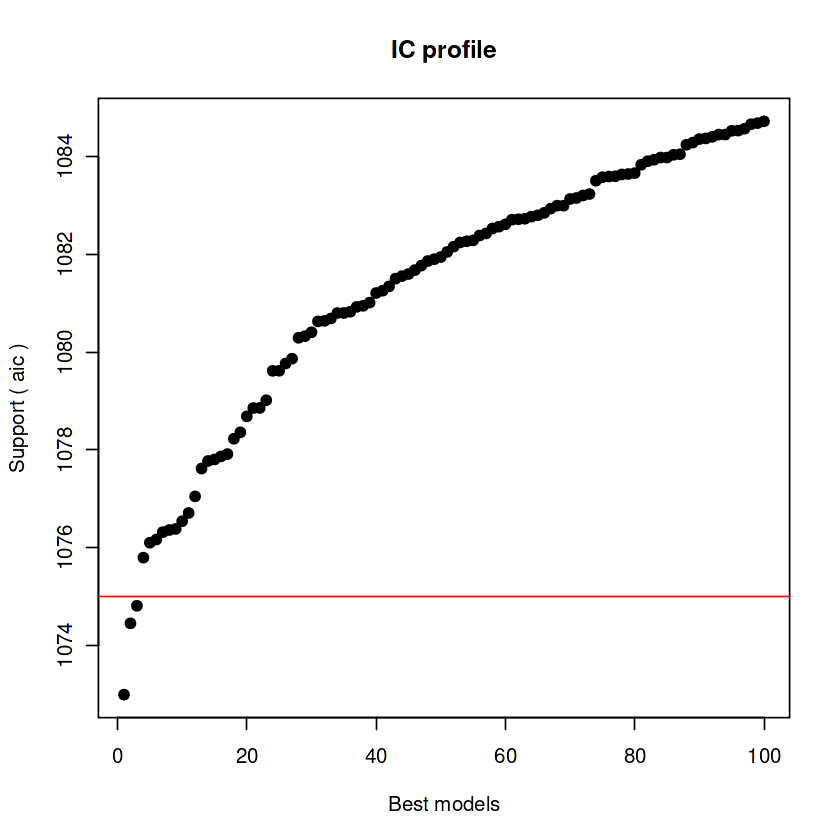


After 1950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1080.42562653046


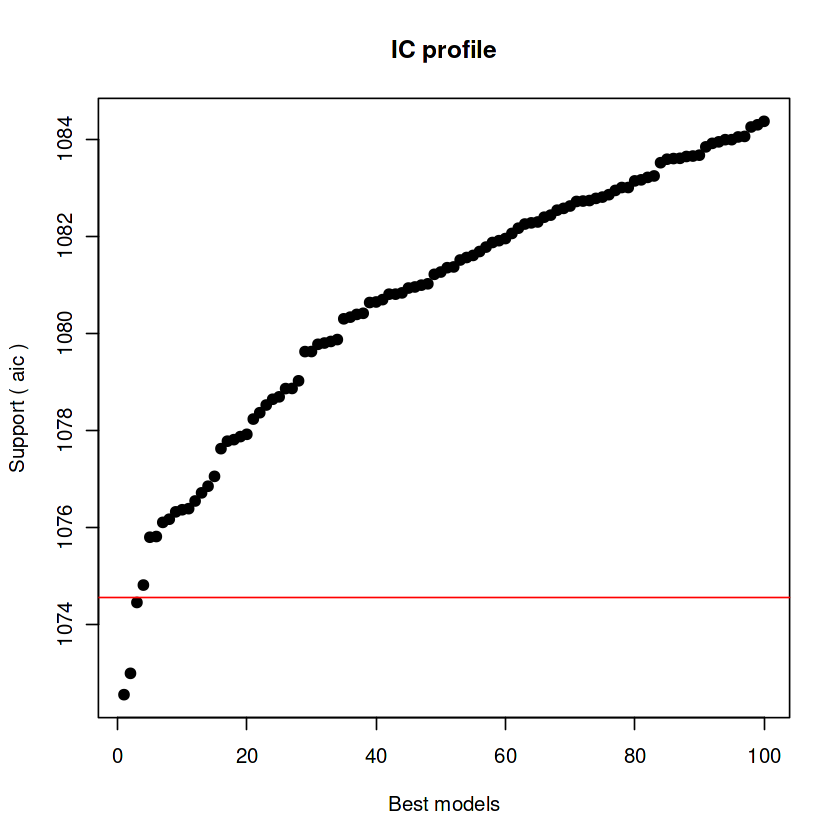


After 2000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1080.182031467


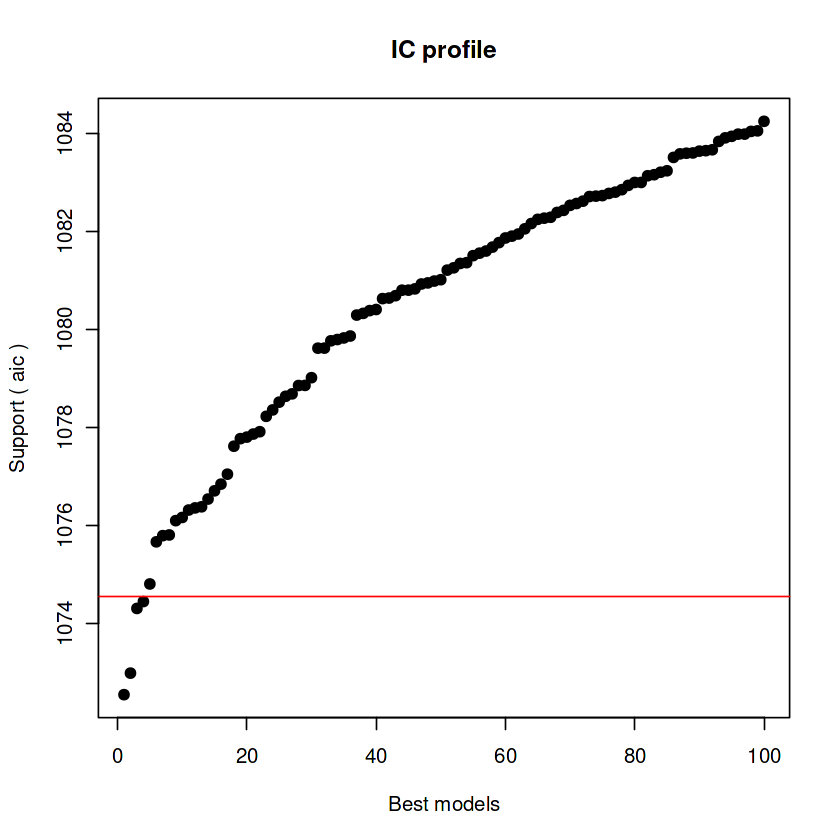


After 2050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1080.17087361315


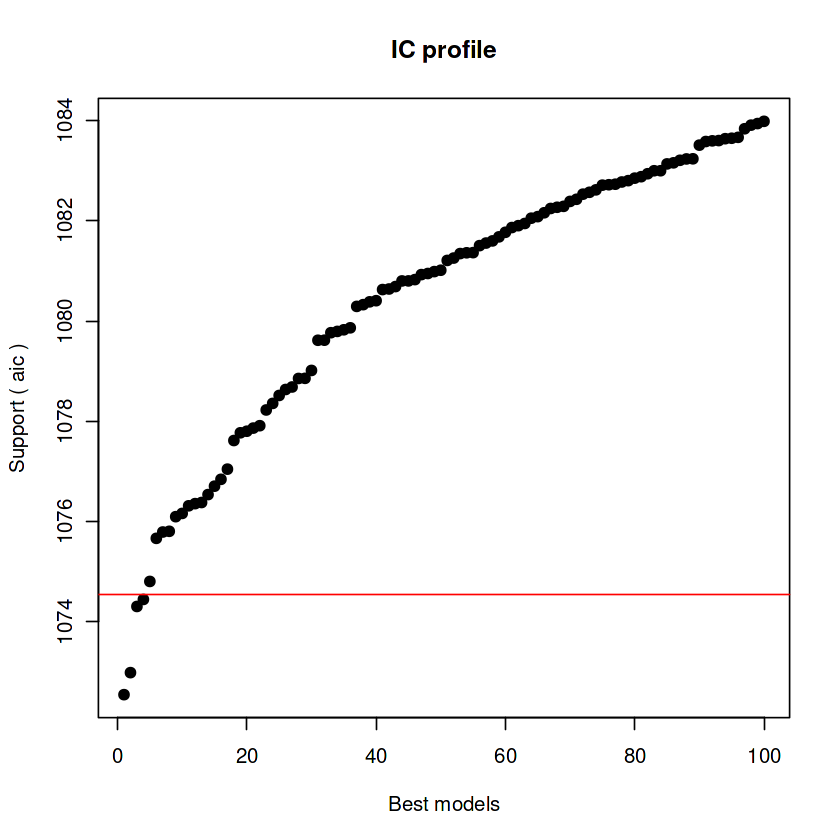


After 2100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1079.88970405384


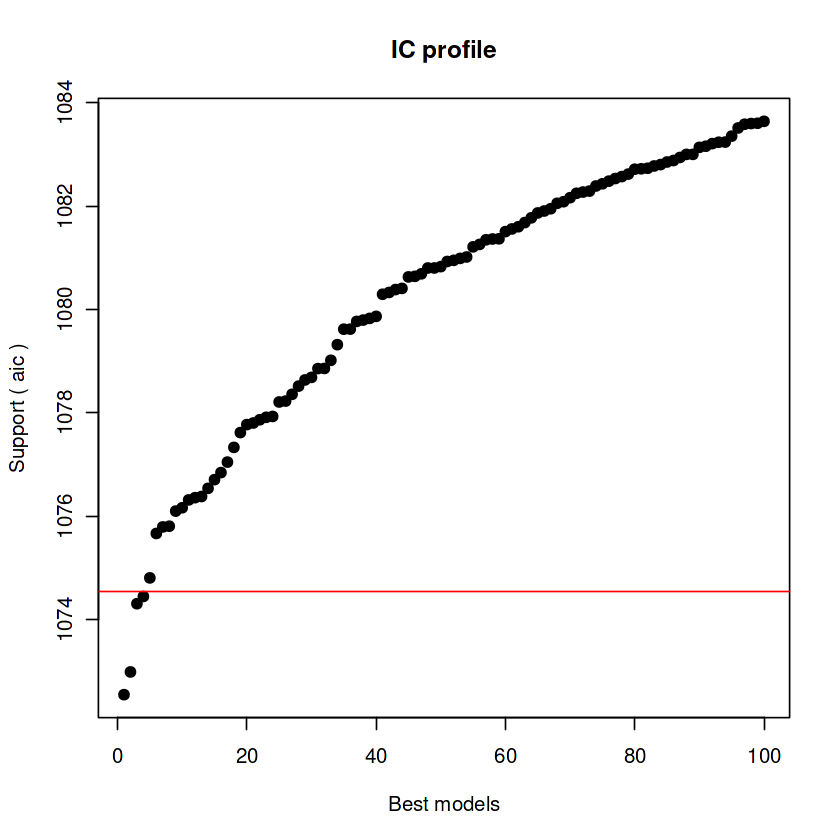


After 2150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1079.721135962


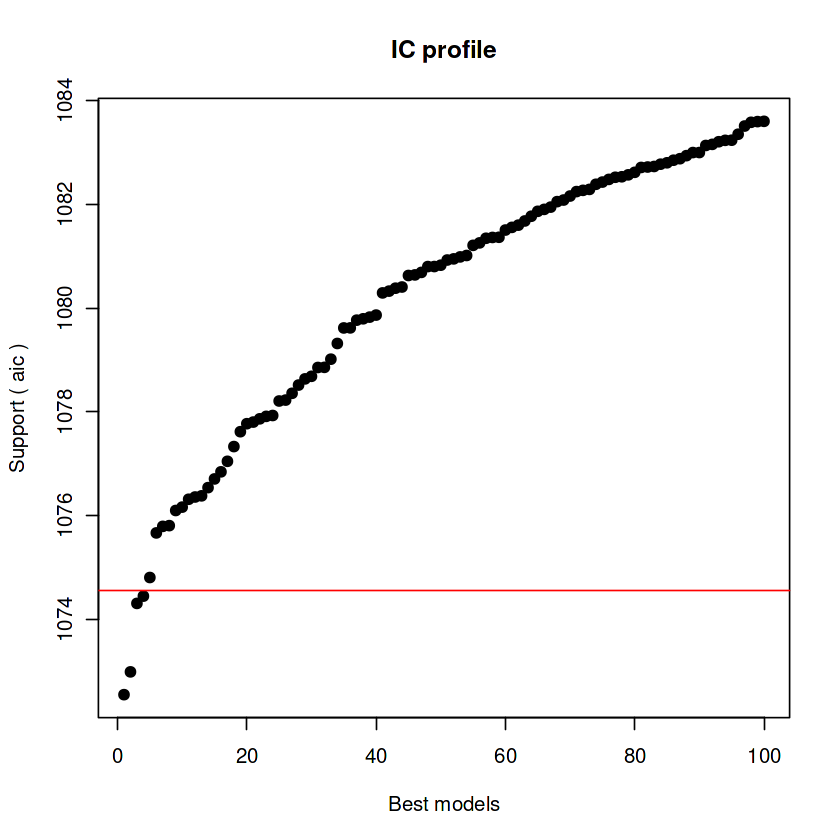


After 2200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1079.66073435973


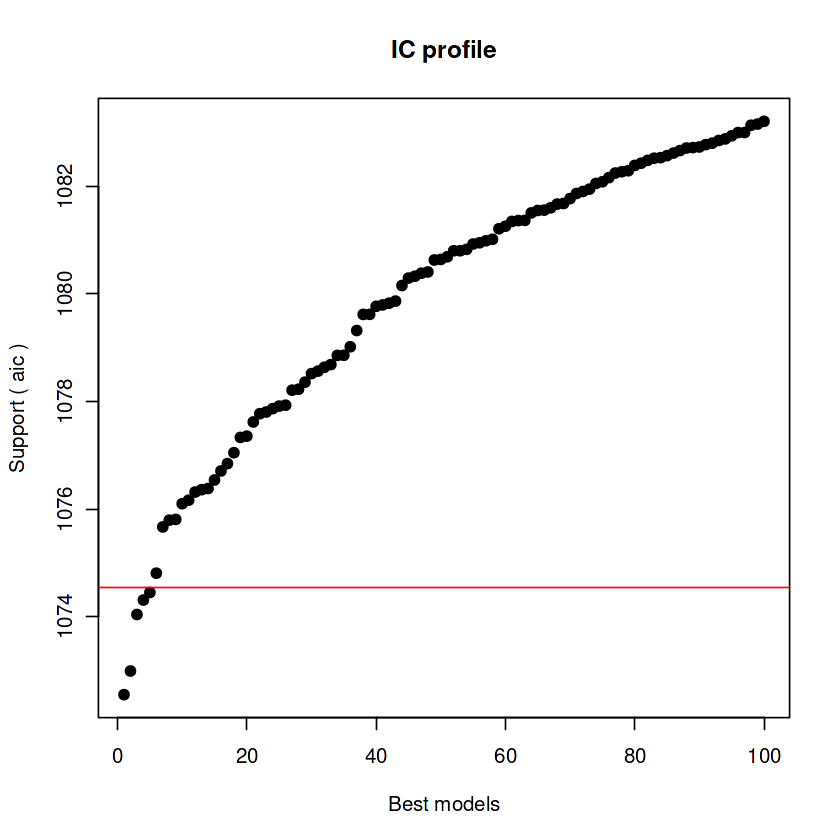


After 2250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1079.3956123442


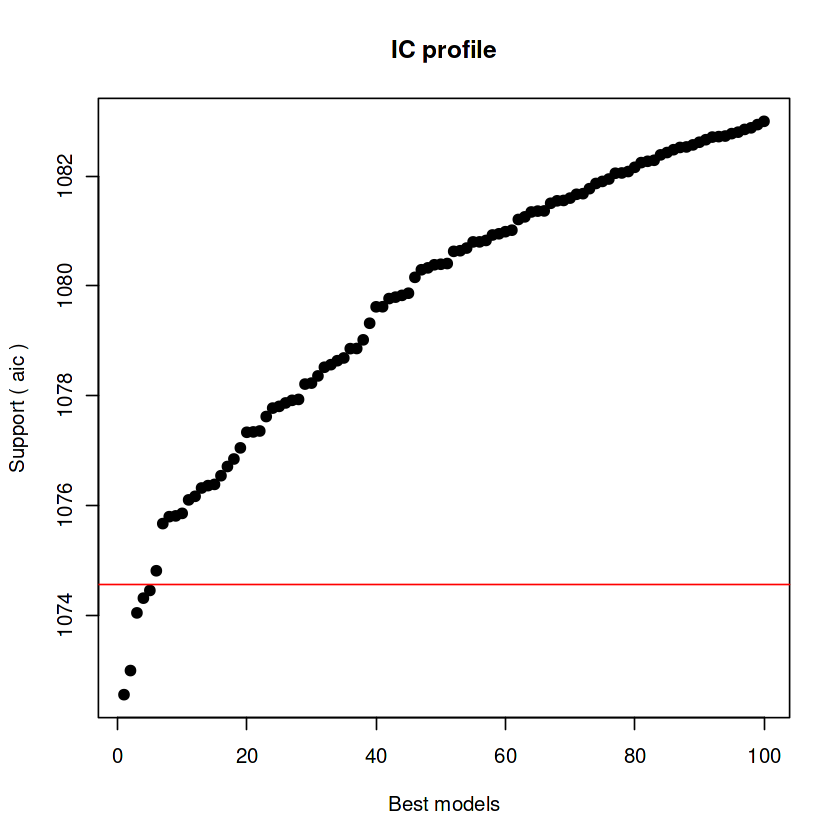


After 2300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1079.34870473547


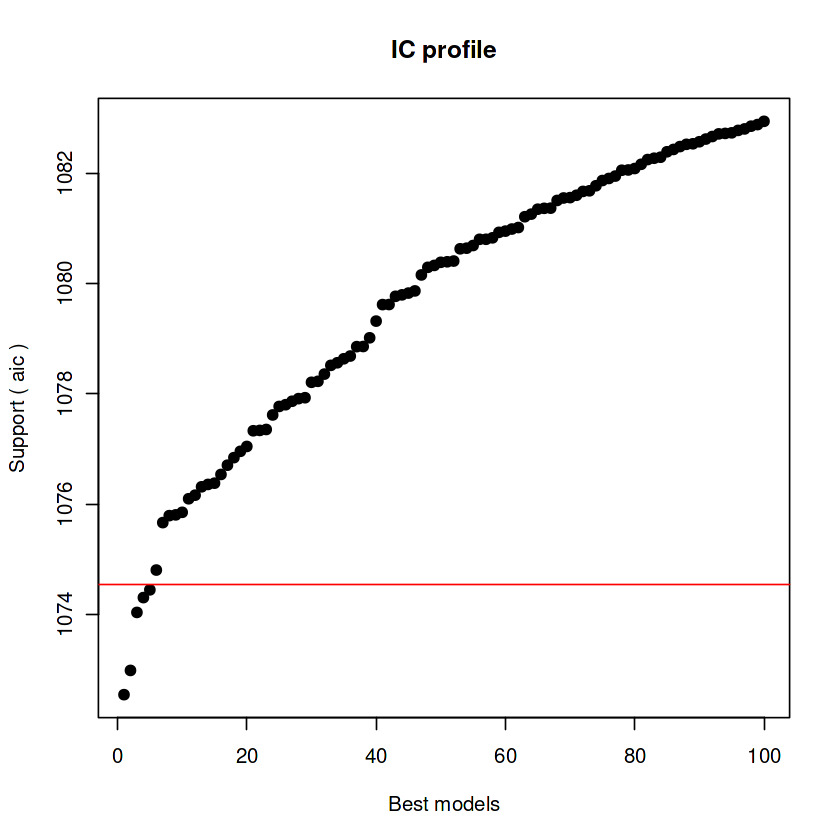


After 2350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1079.07807753702


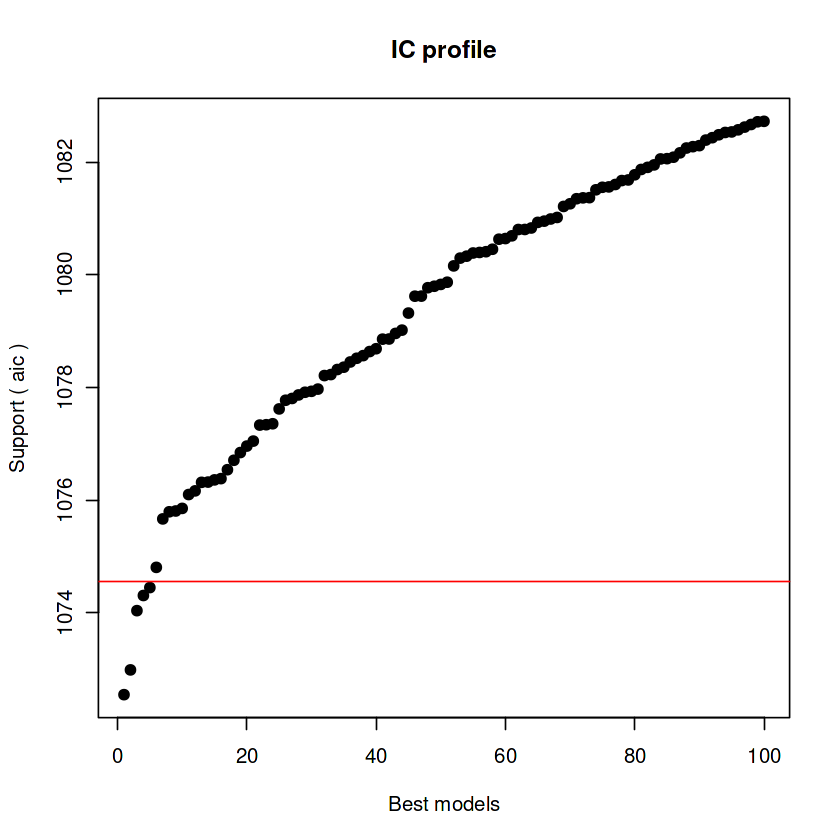


After 2400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1078.86688112447


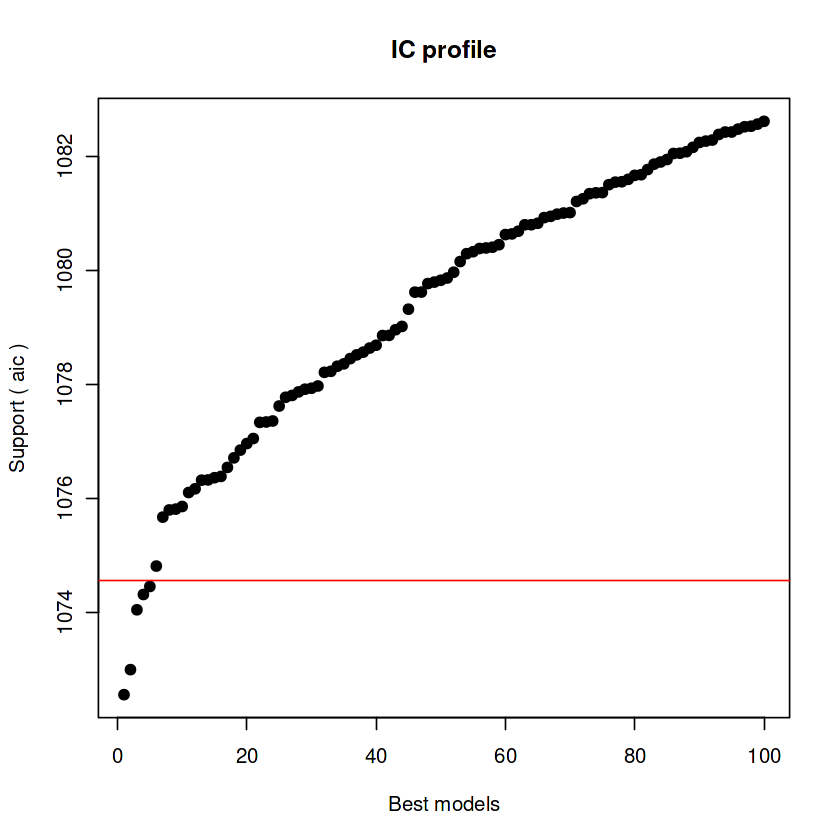


After 2450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1078.85486232973


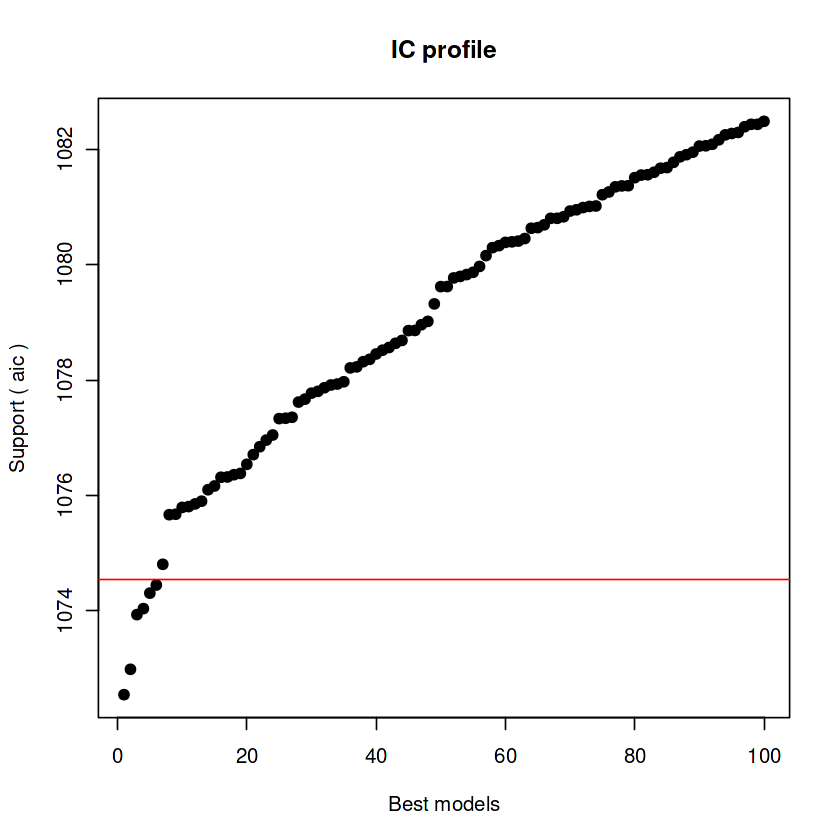


After 2500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1078.39699076815


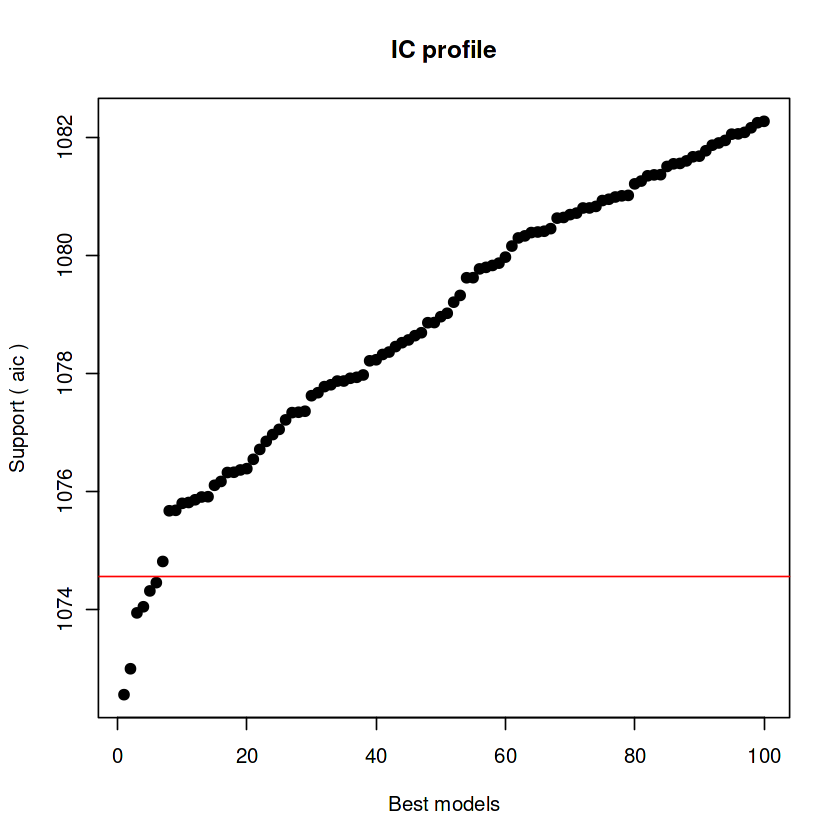


After 2550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria
Crit= 1072.55001997479
Mean crit= 1078.18403678326


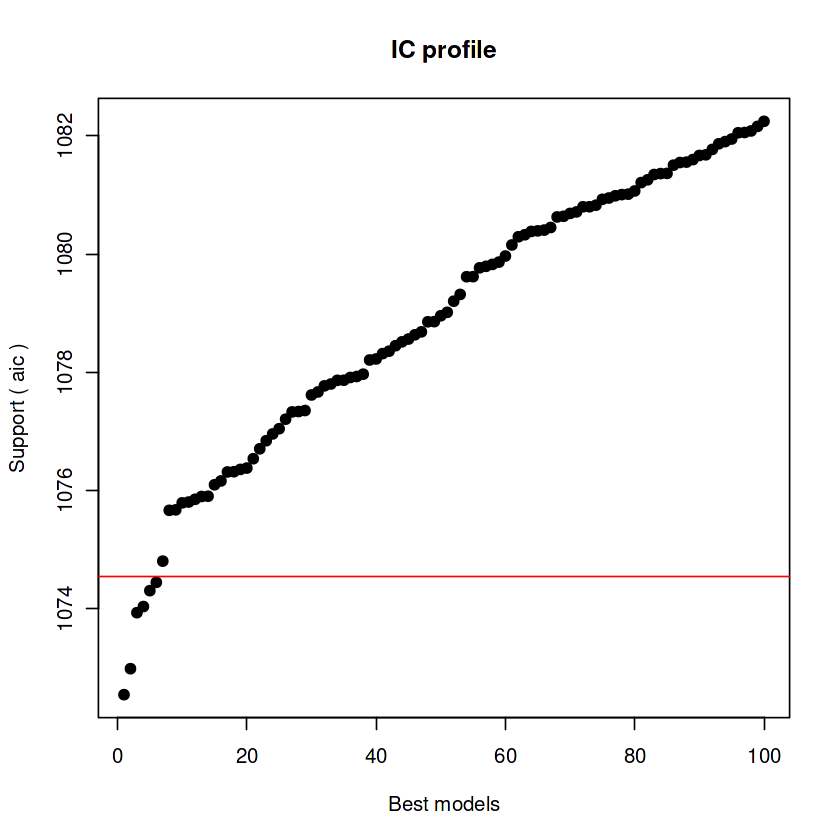


After 2600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths+Polio+HIV.AIDS
Crit= 1071.56034071078
Mean crit= 1077.98302423412


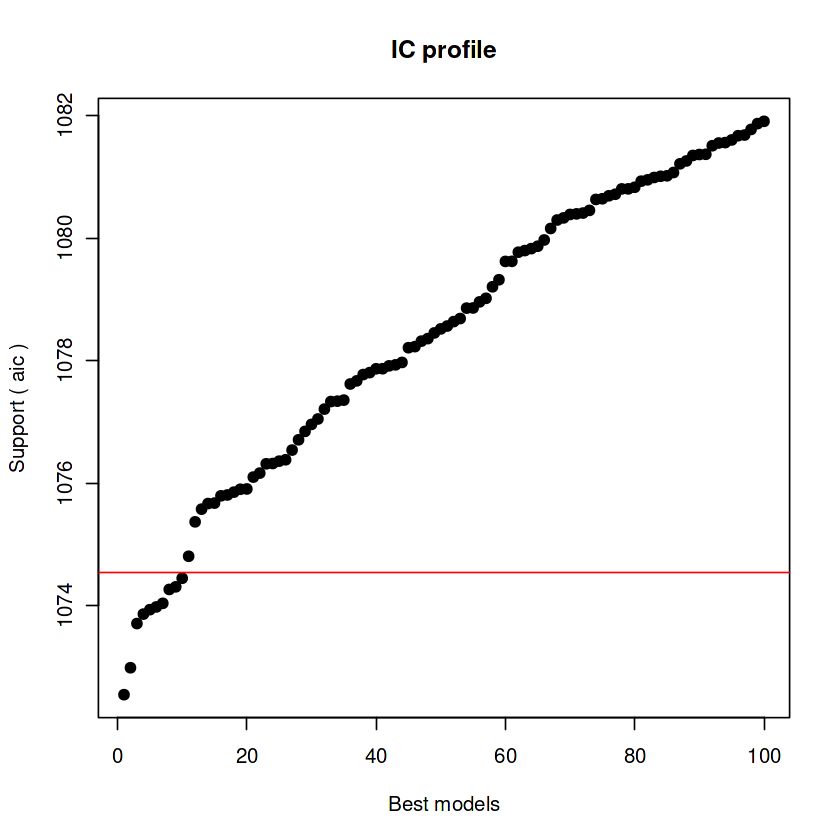


After 2650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+HIV.AIDS
Crit= 1071.37603427897
Mean crit= 1077.51842469494


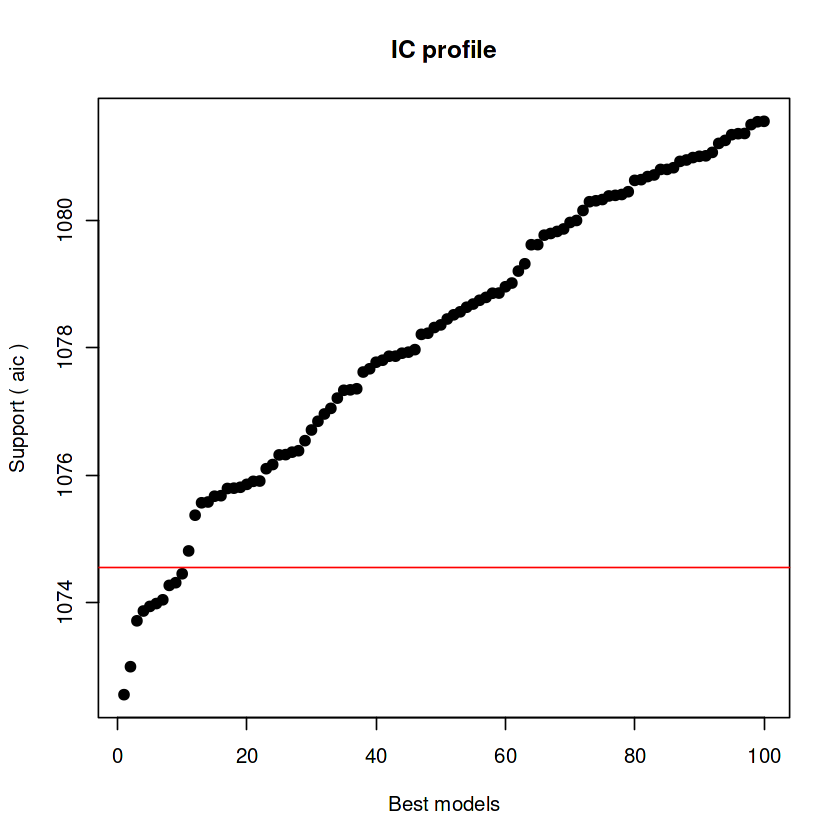


After 2700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+HIV.AIDS
Crit= 1071.37603427897
Mean crit= 1077.50285846378


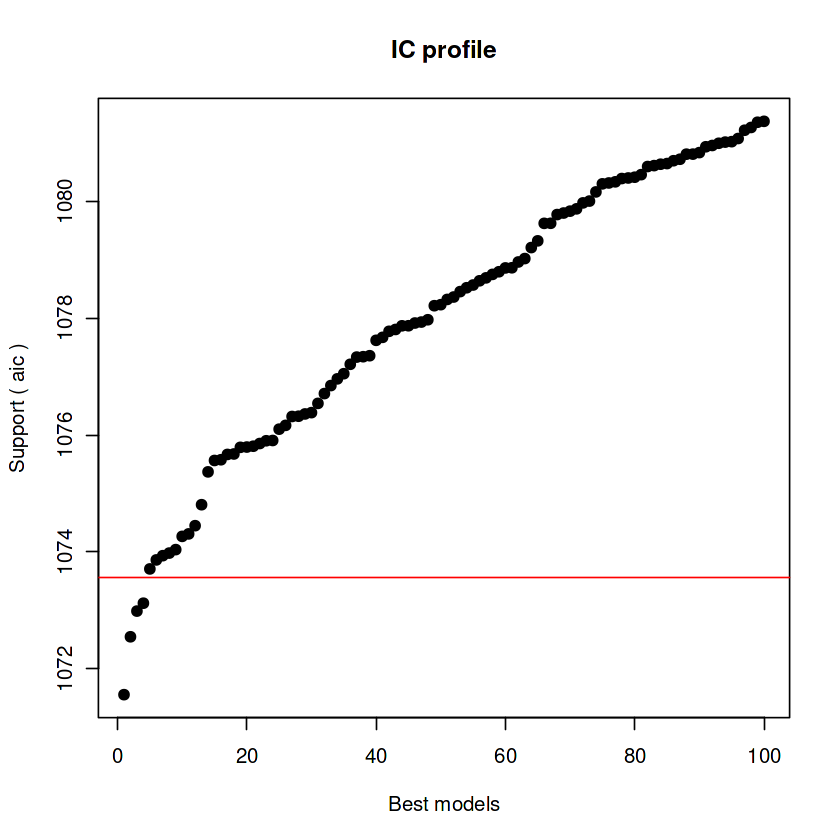


After 2750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+HIV.AIDS
Crit= 1071.37603427897
Mean crit= 1077.22416078938


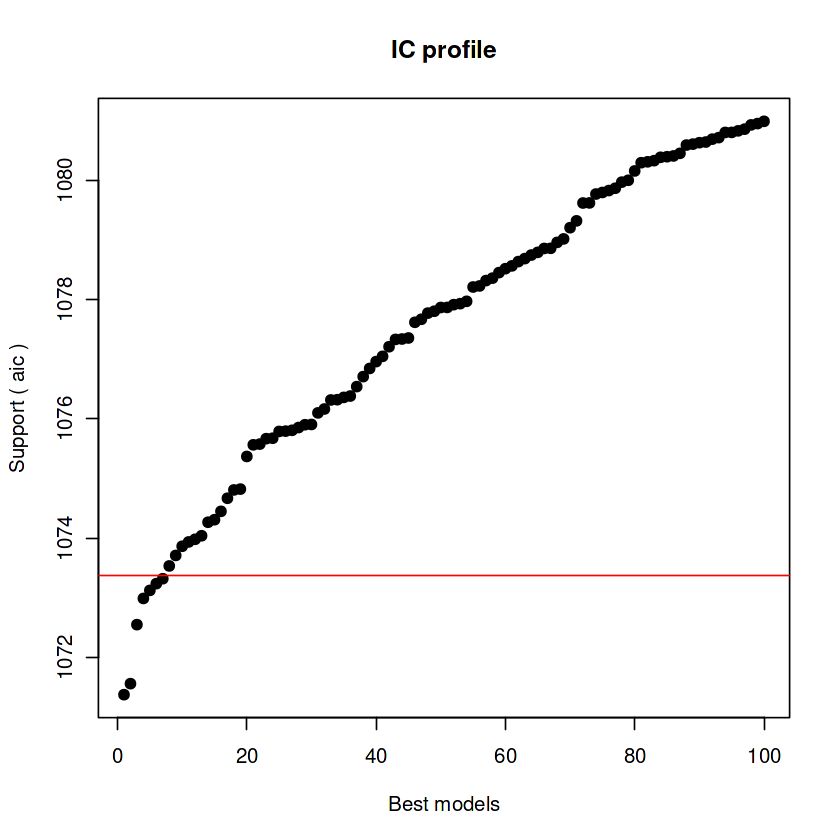


After 2800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+HIV.AIDS
Crit= 1071.37603427897
Mean crit= 1076.96237884733


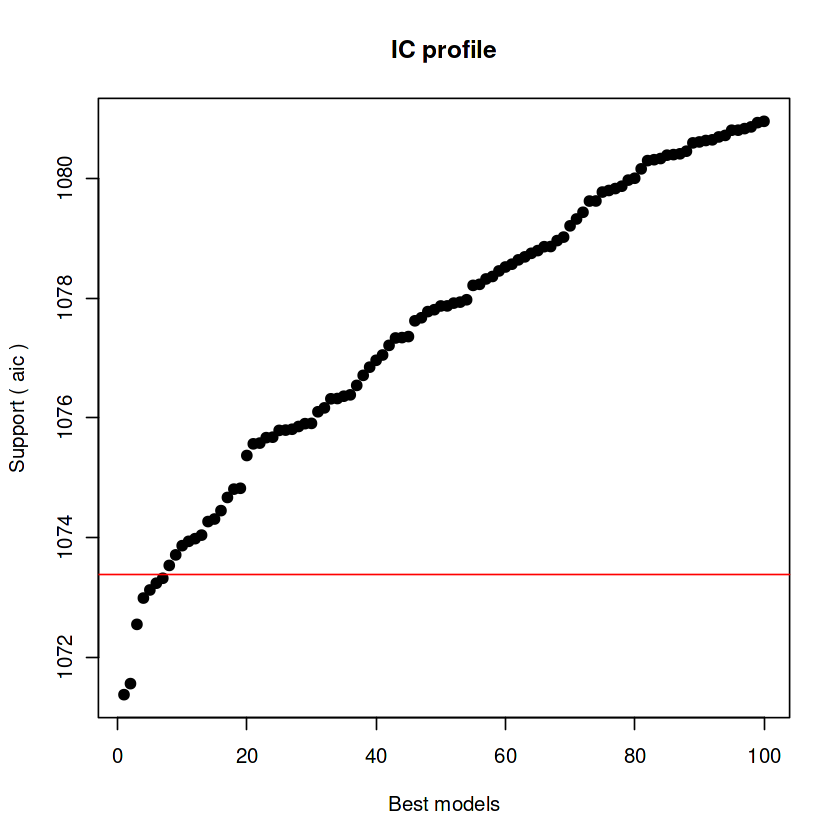


After 2850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+HIV.AIDS
Crit= 1071.37603427897
Mean crit= 1076.93298600856


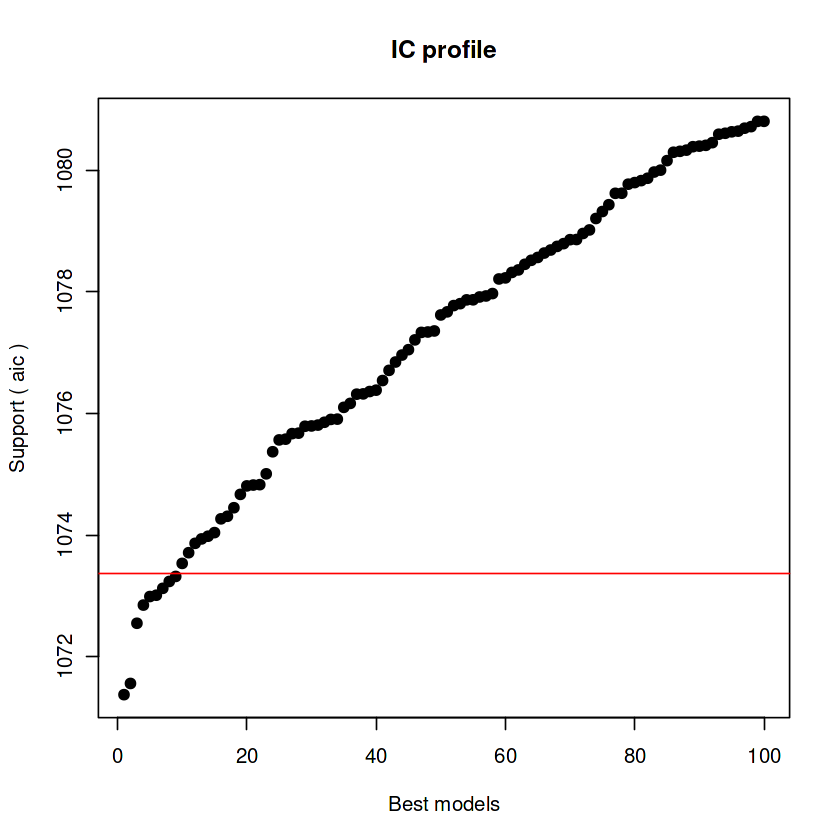


After 2900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths+Total.expenditure+HIV.AIDS
Crit= 1070.45497871485
Mean crit= 1076.46492351953


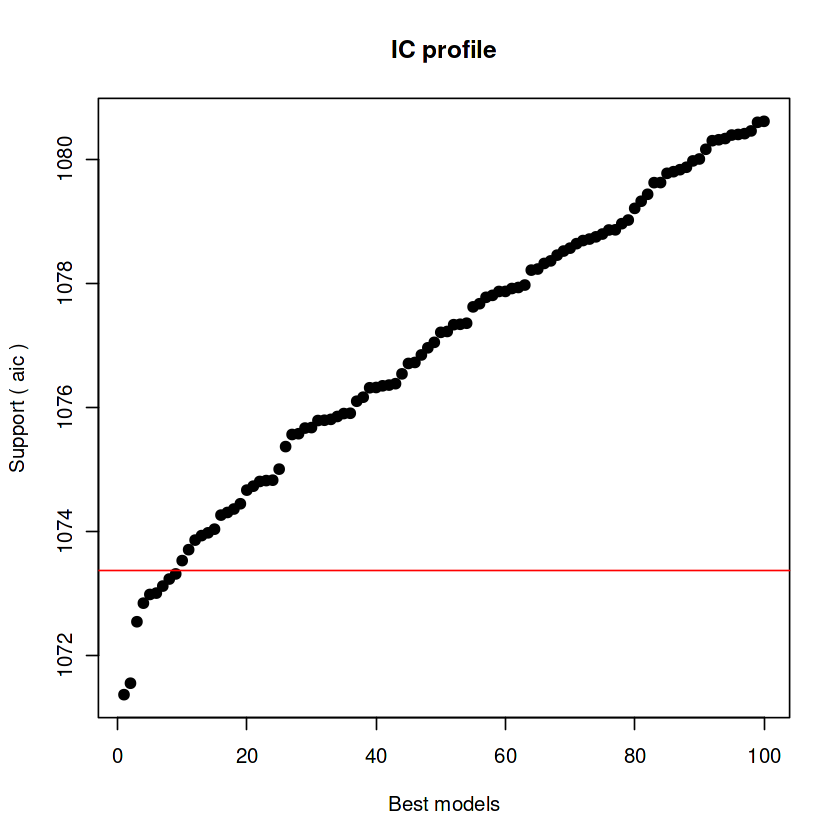


After 2950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths+Total.expenditure+HIV.AIDS
Crit= 1070.45497871485
Mean crit= 1076.31633289066


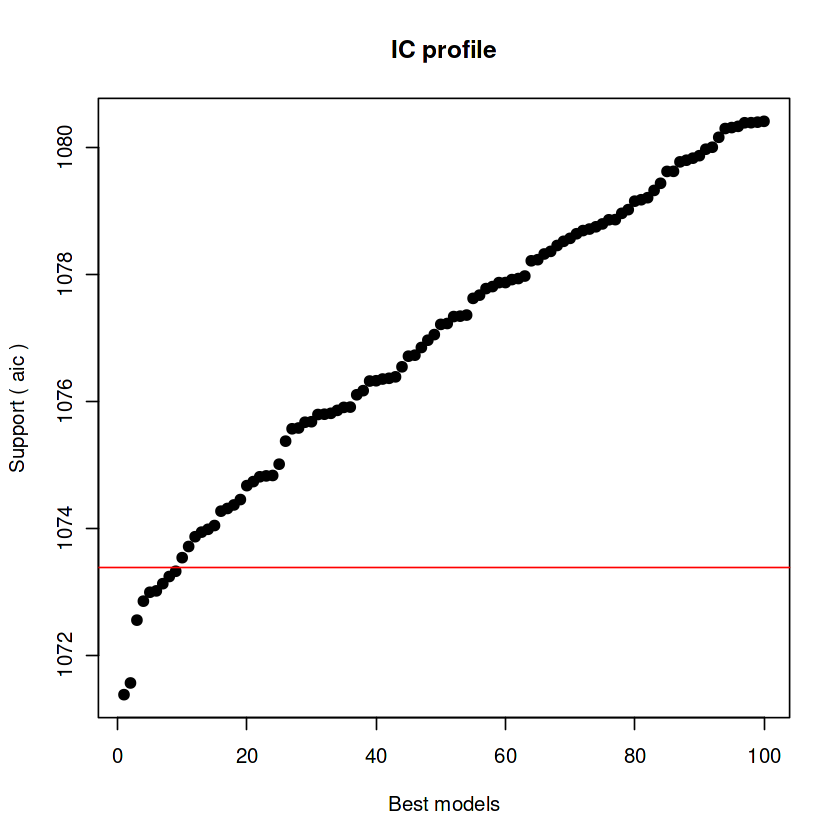


After 3000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths+Total.expenditure+HIV.AIDS
Crit= 1070.45497871485
Mean crit= 1076.14245175669


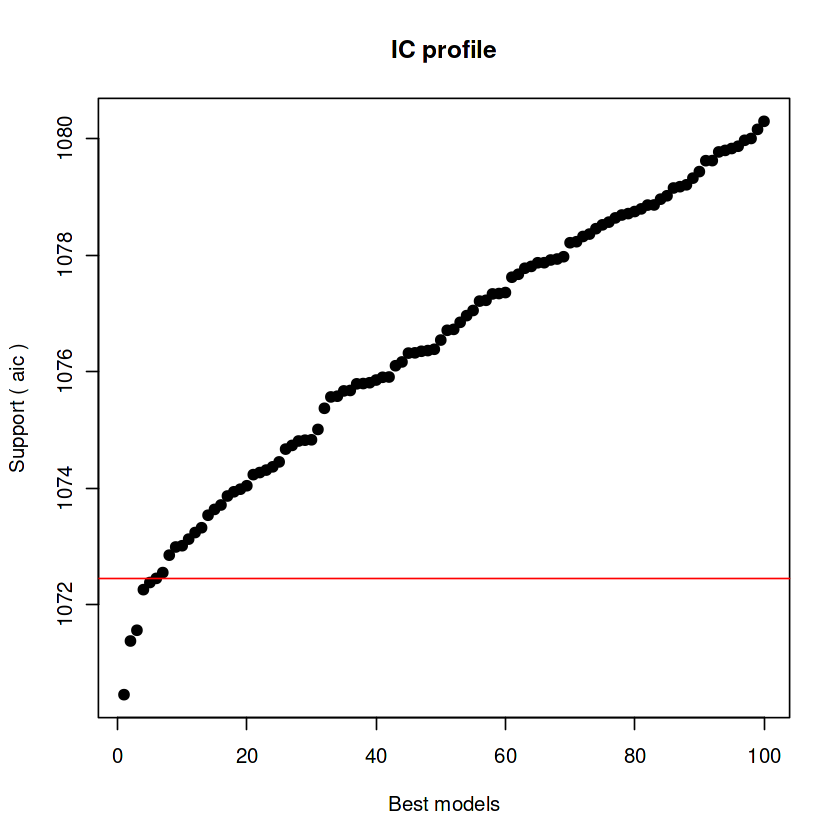


After 3050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths+Total.expenditure+HIV.AIDS
Crit= 1070.45497871485
Mean crit= 1075.7217272102


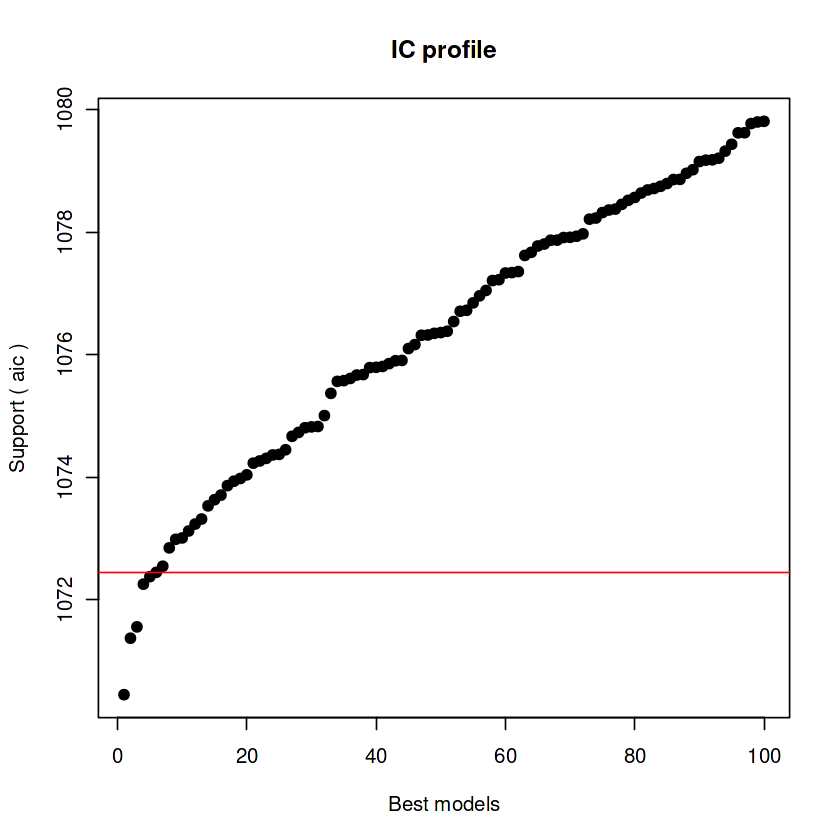


After 3100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths+Total.expenditure+HIV.AIDS
Crit= 1070.45497871485
Mean crit= 1075.6140617335


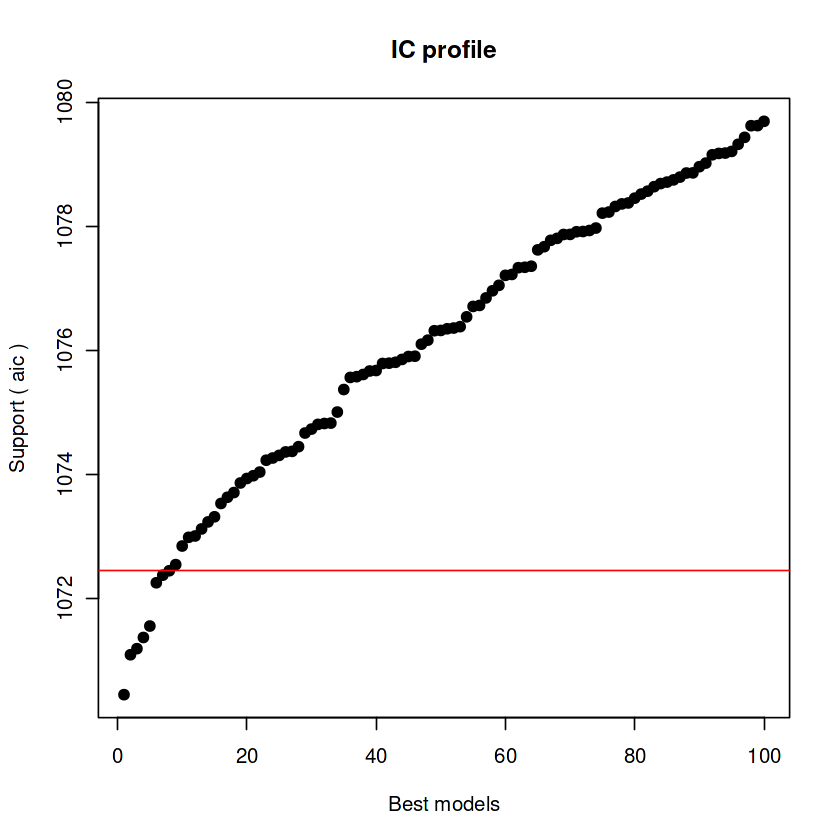


After 3150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+Total.expenditure+HIV.AIDS
Crit= 1068.95049664487
Mean crit= 1075.24431463269


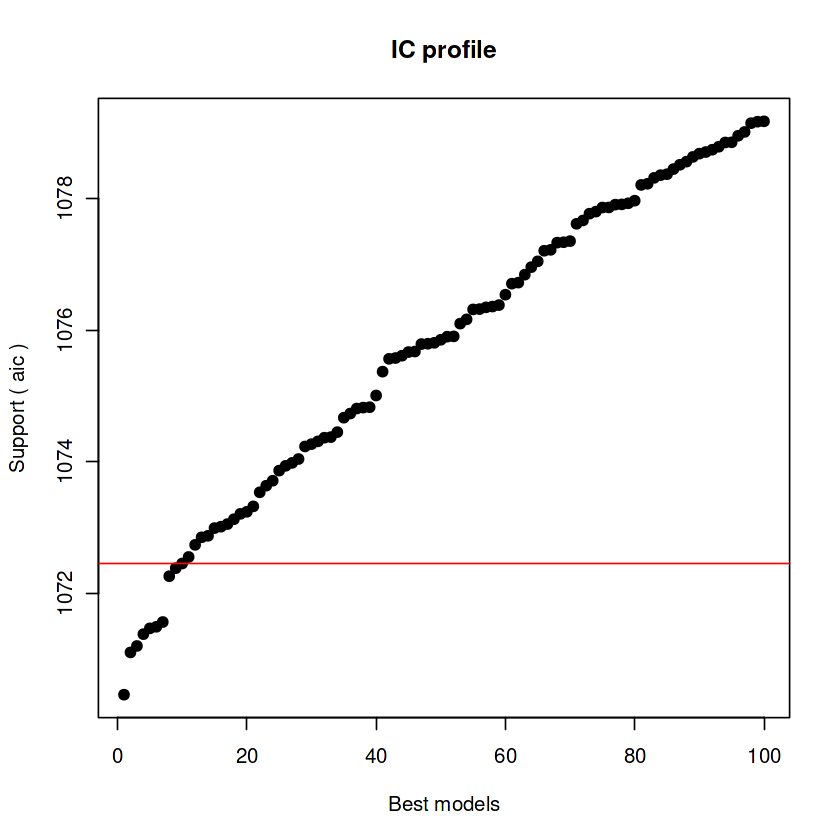


After 3200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+Total.expenditure+HIV.AIDS
Crit= 1068.95049664487
Mean crit= 1074.91674942632


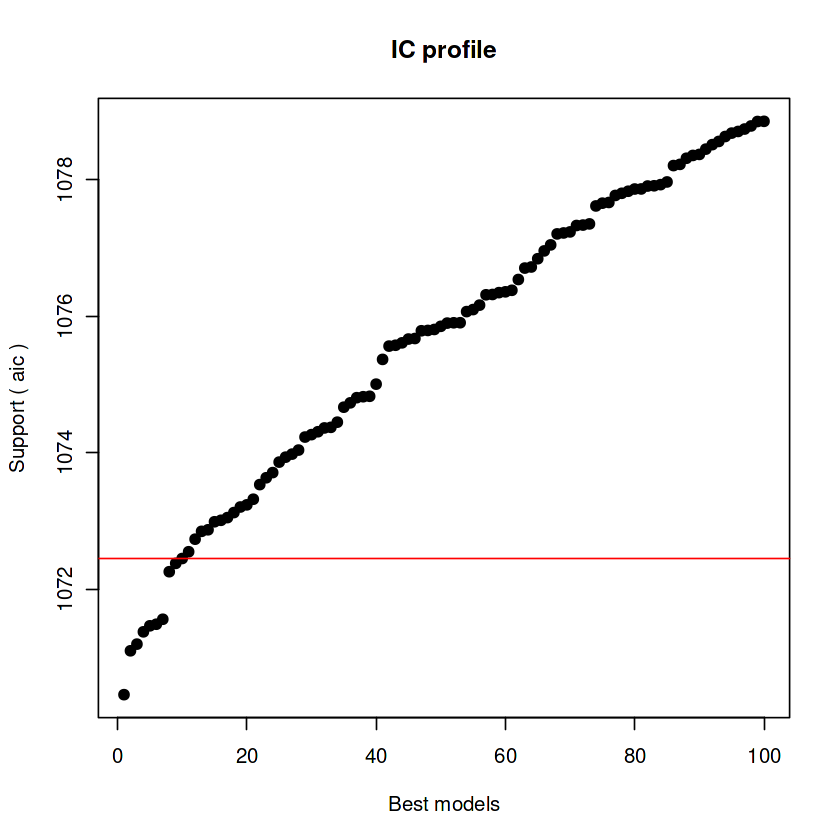


After 3250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+Total.expenditure+HIV.AIDS
Crit= 1068.95049664487
Mean crit= 1074.59645168217


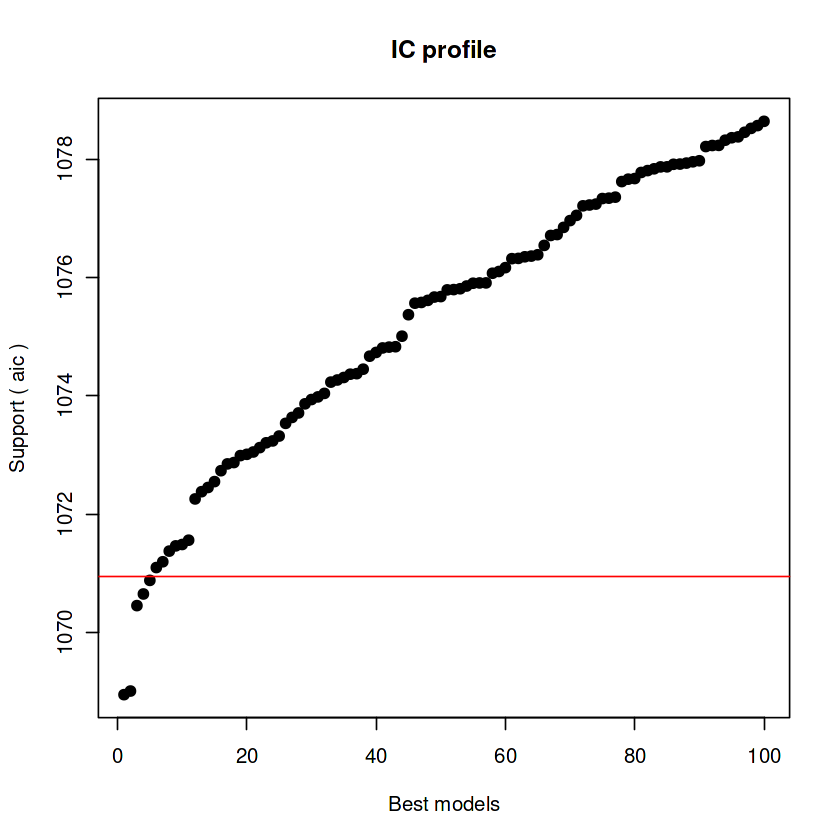


After 3300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Diphtheria+HIV.AIDS
Crit= 1062.23252059454
Mean crit= 1073.7247815363


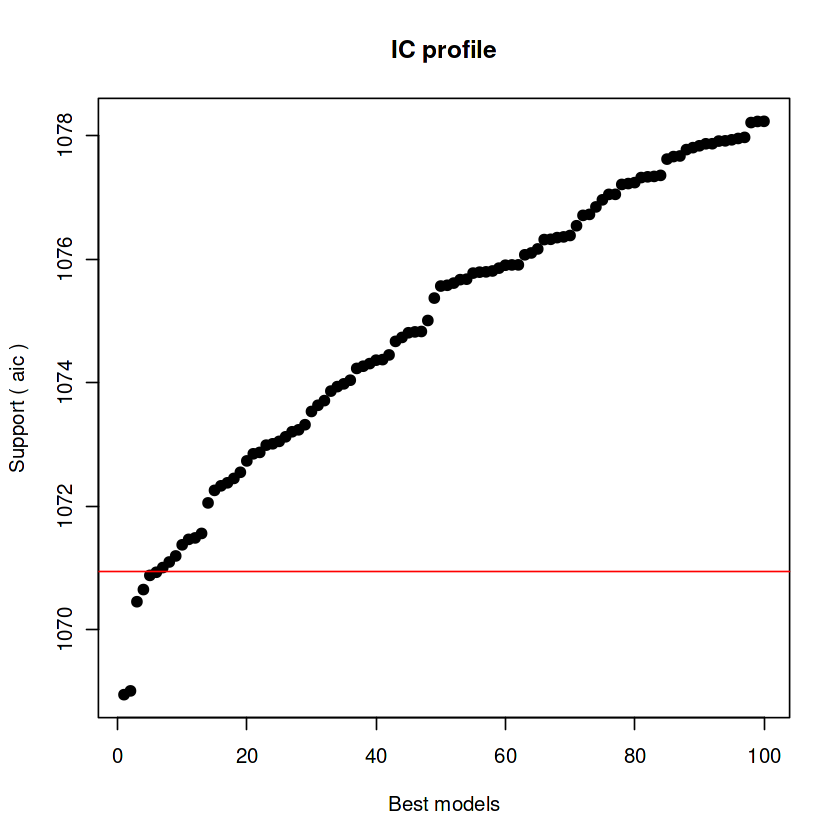


After 3350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Diphtheria+HIV.AIDS
Crit= 1062.23252059454
Mean crit= 1073.10340473745


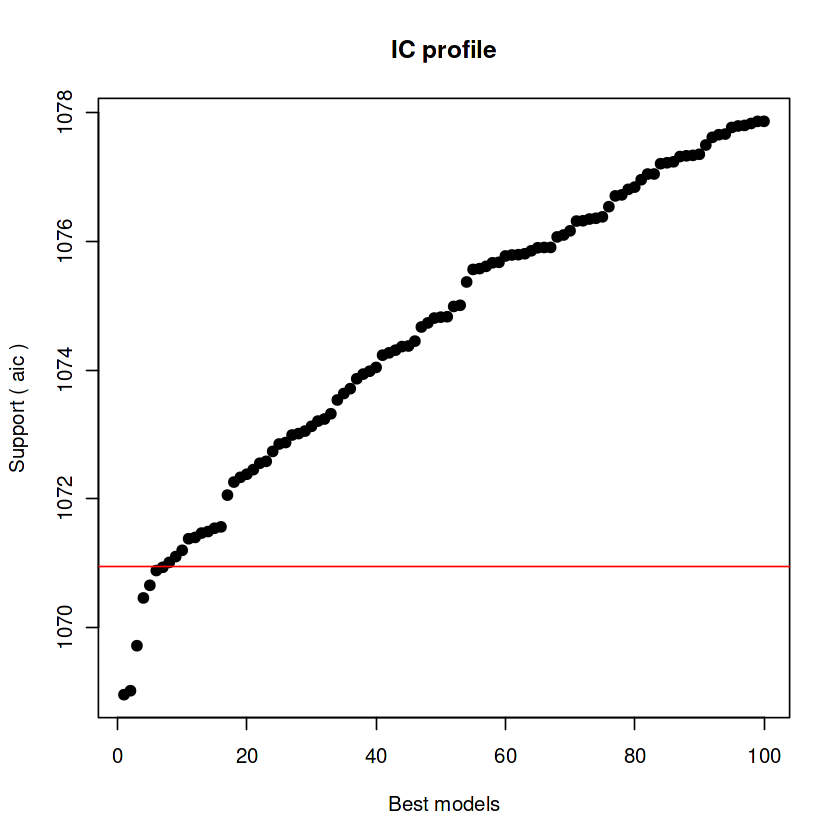


After 3400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Diphtheria+HIV.AIDS
Crit= 1062.23252059454
Mean crit= 1072.69387904183


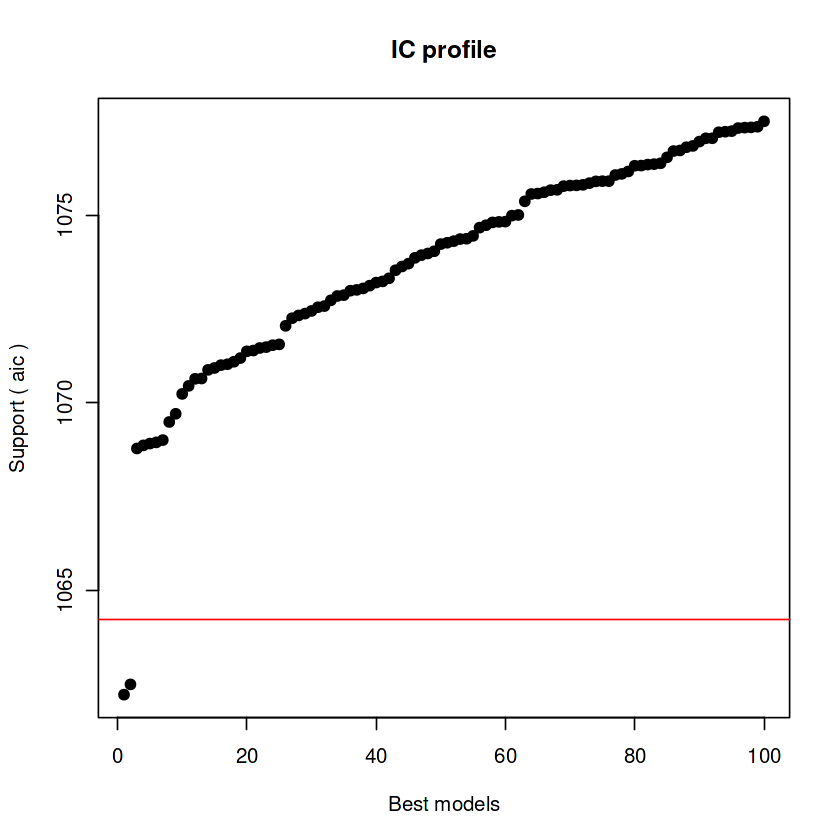


After 3450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS
Crit= 1060.46250095222
Mean crit= 1071.77046101476


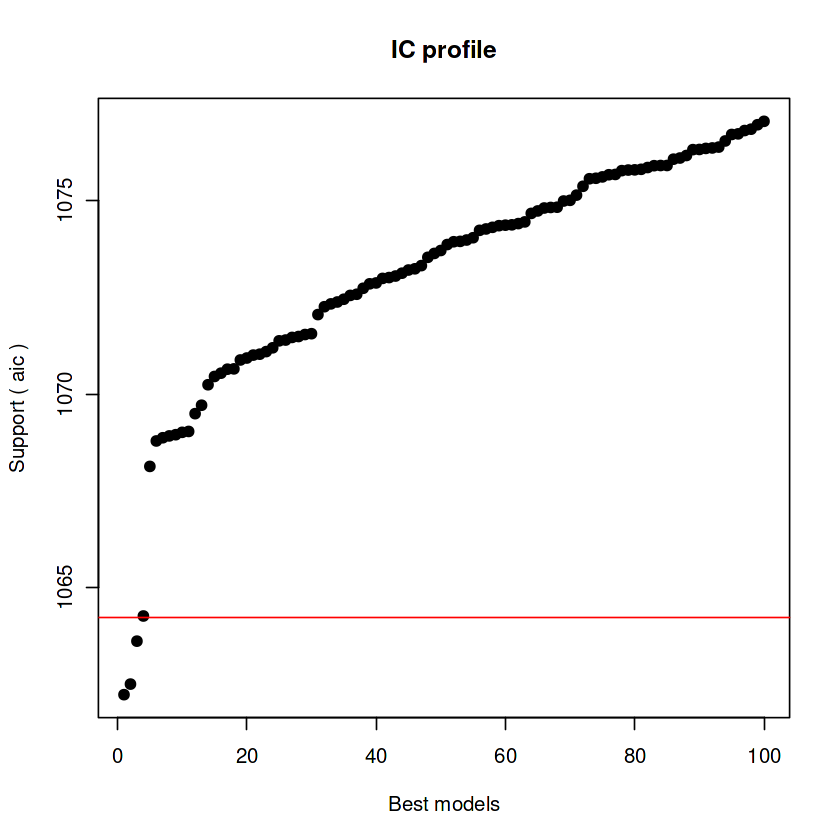


After 3500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS
Crit= 1060.46250095222
Mean crit= 1071.70476985958


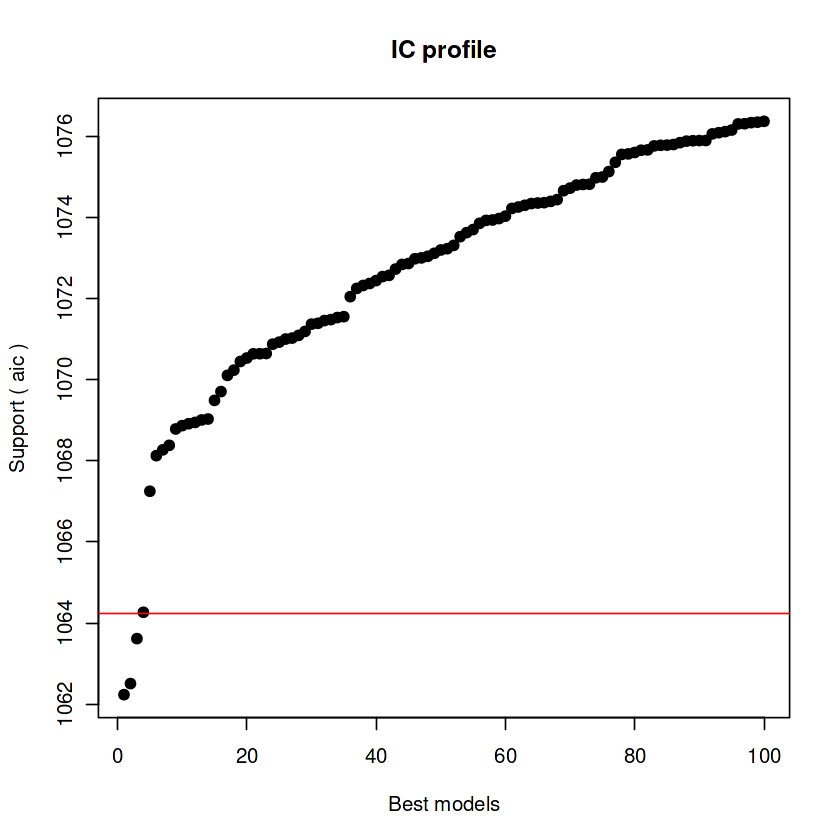


After 3550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS
Crit= 1060.46250095222
Mean crit= 1071.24735742418


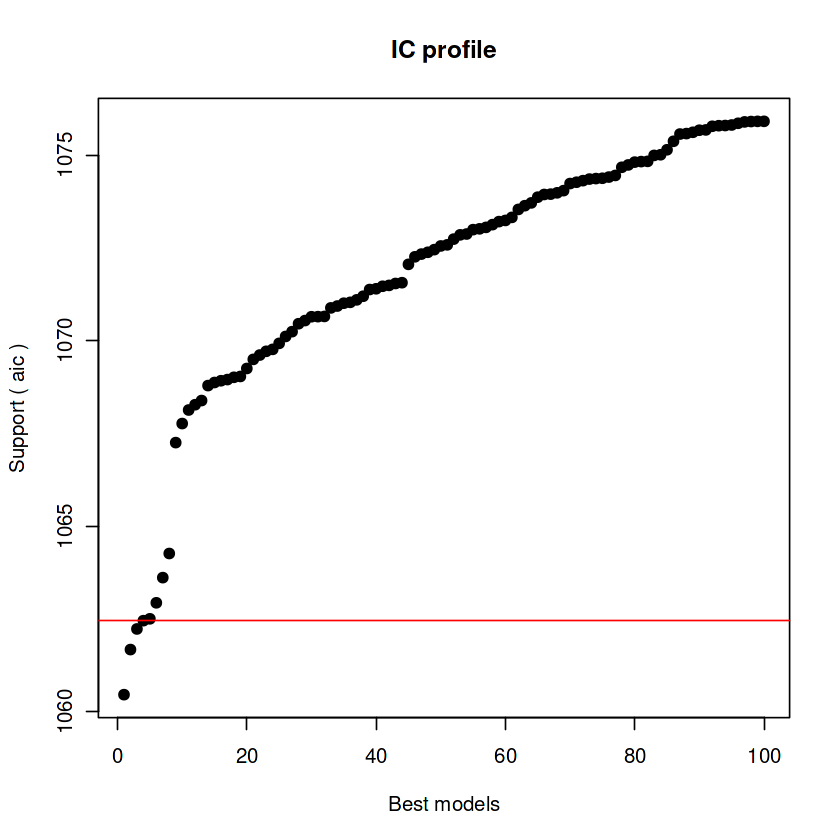


After 3600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS
Crit= 1060.46250095222
Mean crit= 1070.94100182571


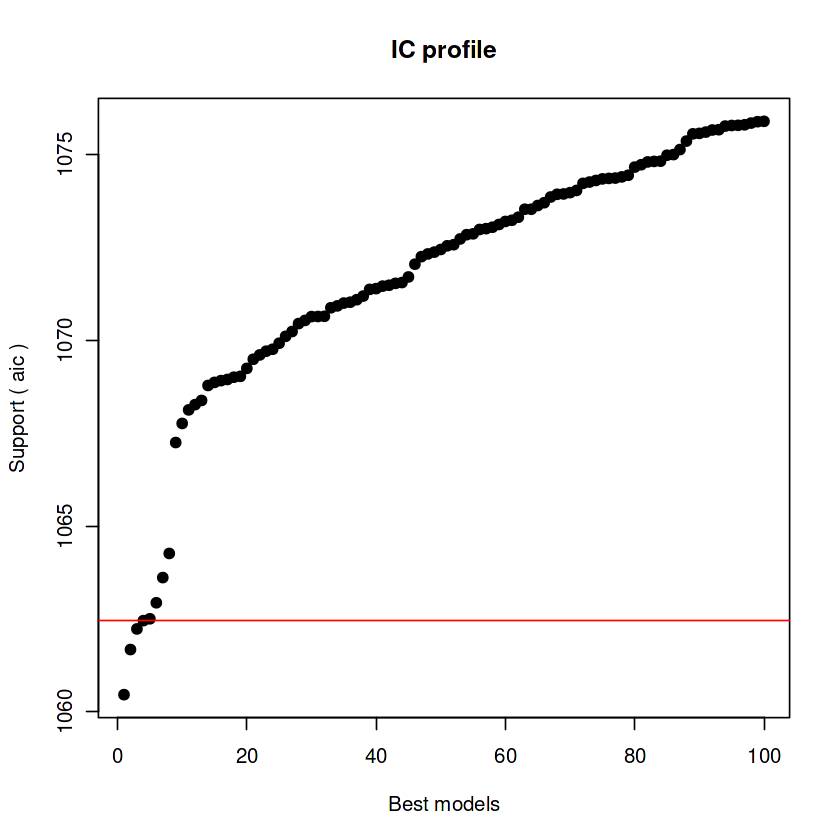


After 3650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS
Crit= 1060.46250095222
Mean crit= 1070.80348050987


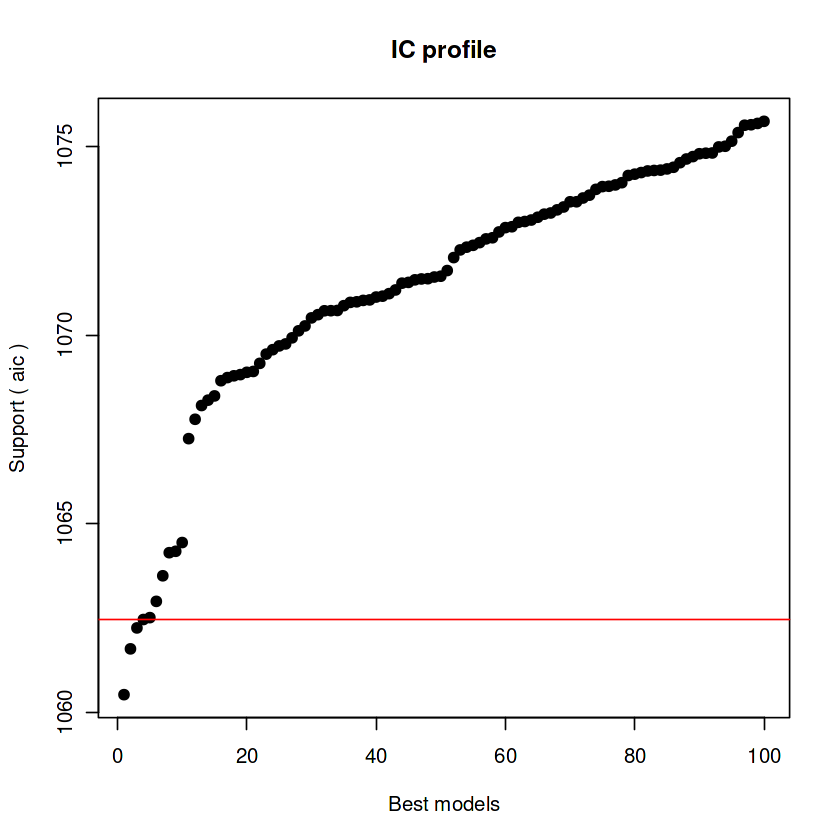


After 3700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS
Crit= 1060.46250095222
Mean crit= 1070.27618025612


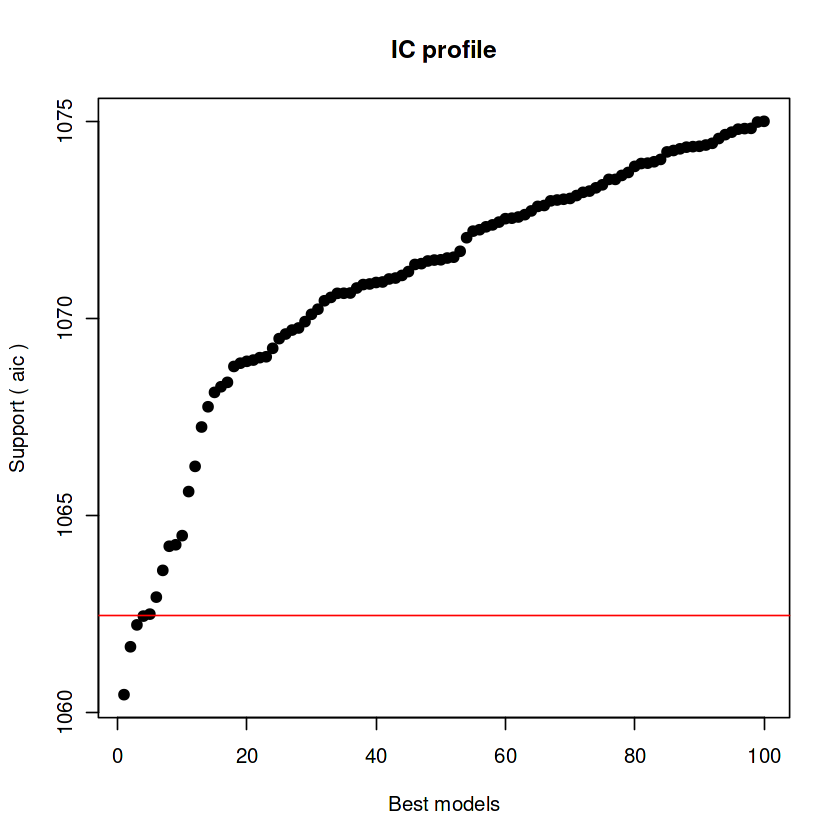


After 3750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS
Crit= 1060.46250095222
Mean crit= 1069.97937732677


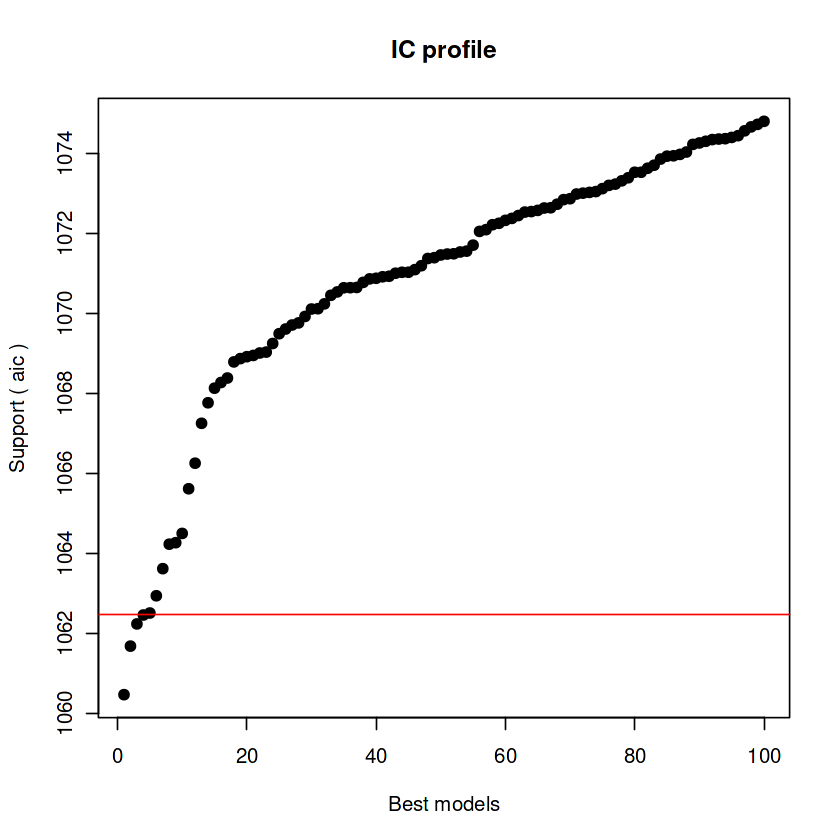


After 3800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS
Crit= 1060.46250095222
Mean crit= 1069.66341785059


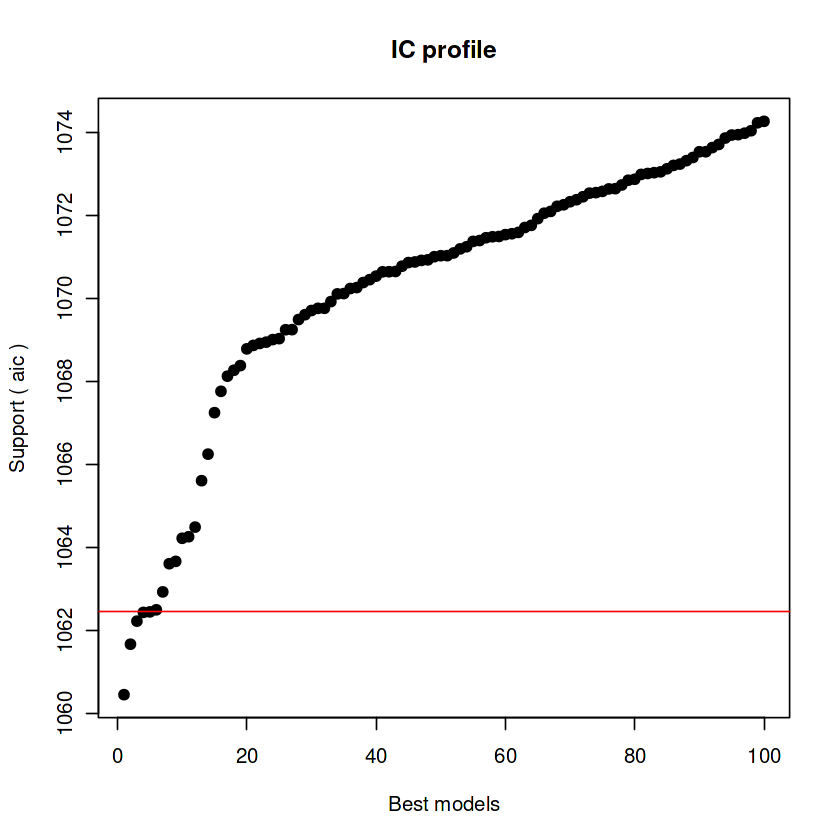


After 3850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS
Crit= 1060.46250095222
Mean crit= 1069.03938957852


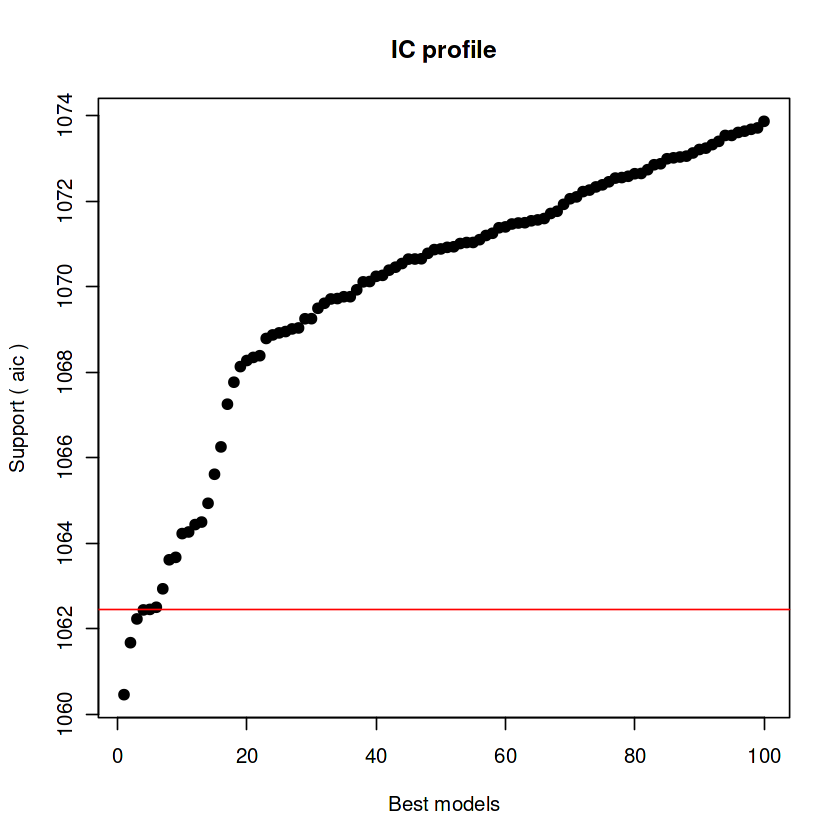


After 3900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS
Crit= 1060.46250095222
Mean crit= 1068.91346001799


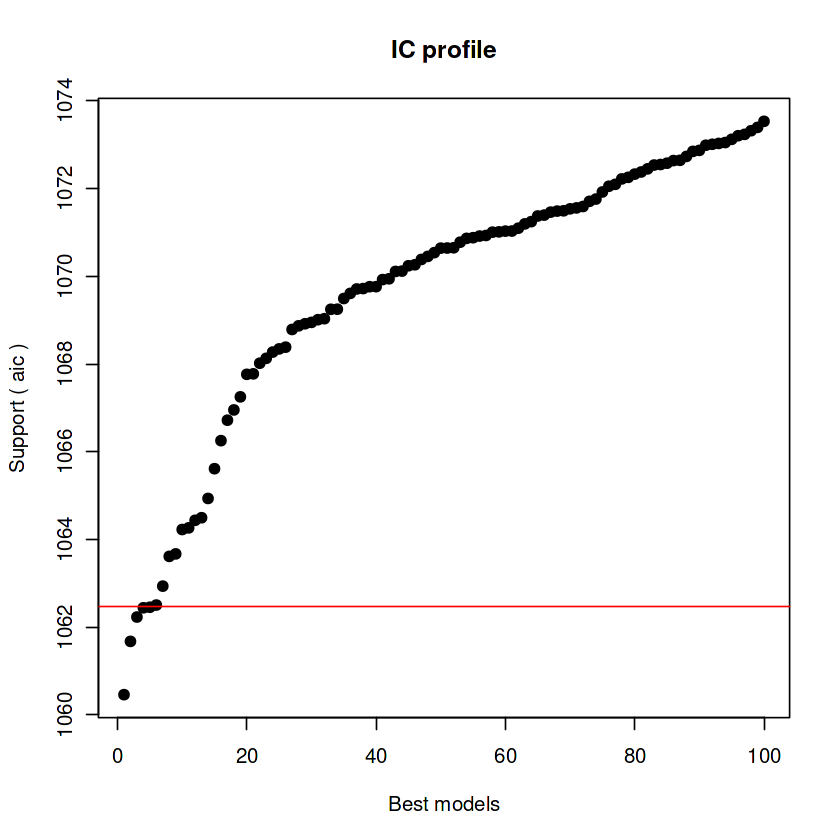


After 3950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1068.34153312005


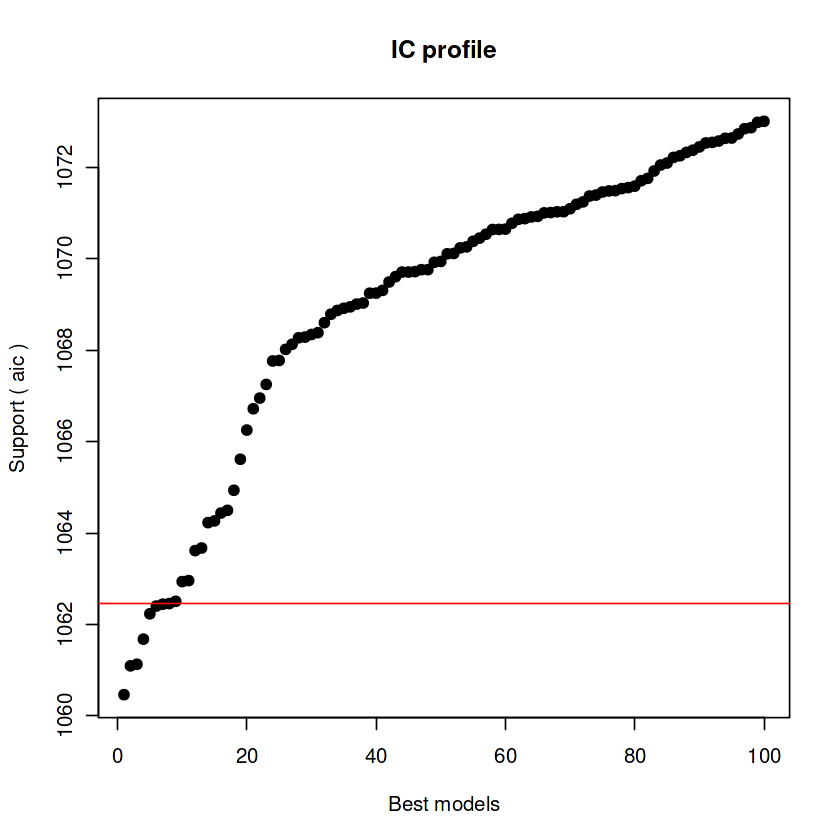


After 4000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.95915269149


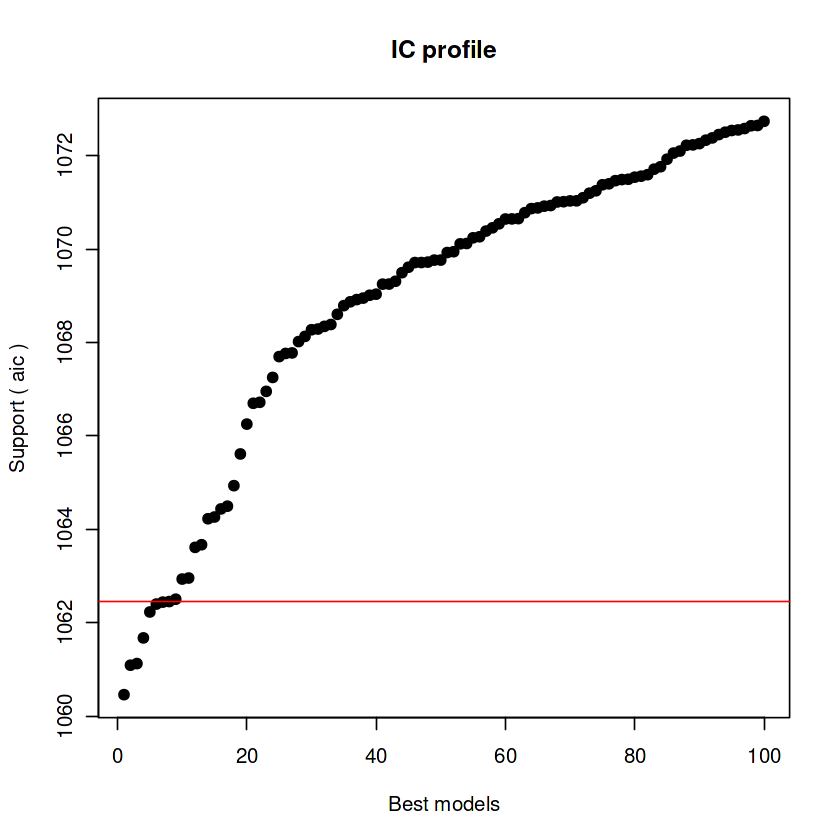


After 4050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.94003640257


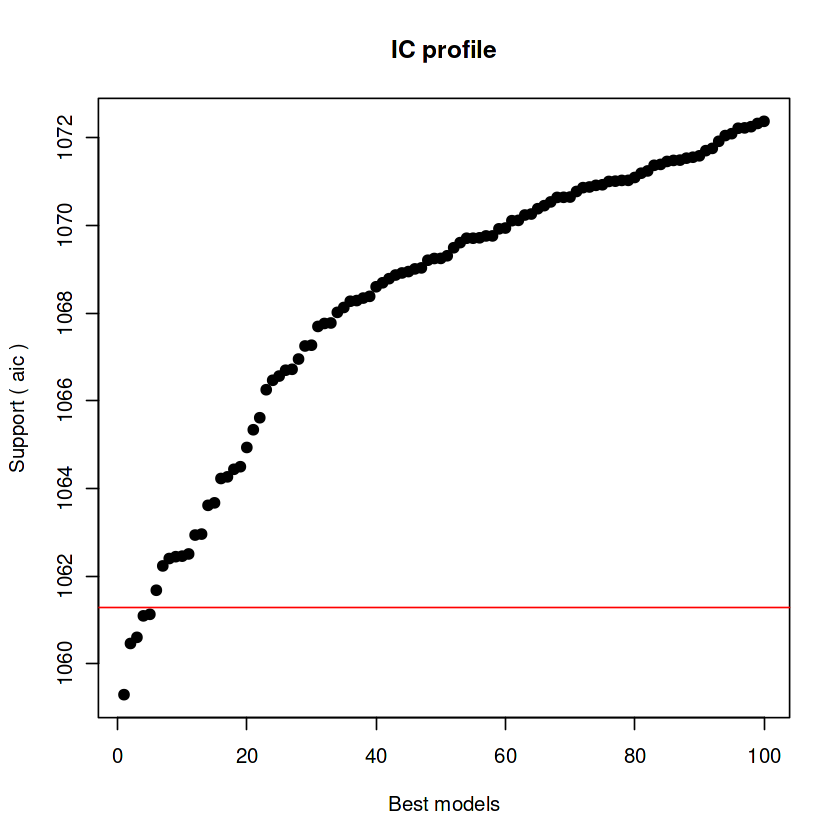


After 4100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.65475268206


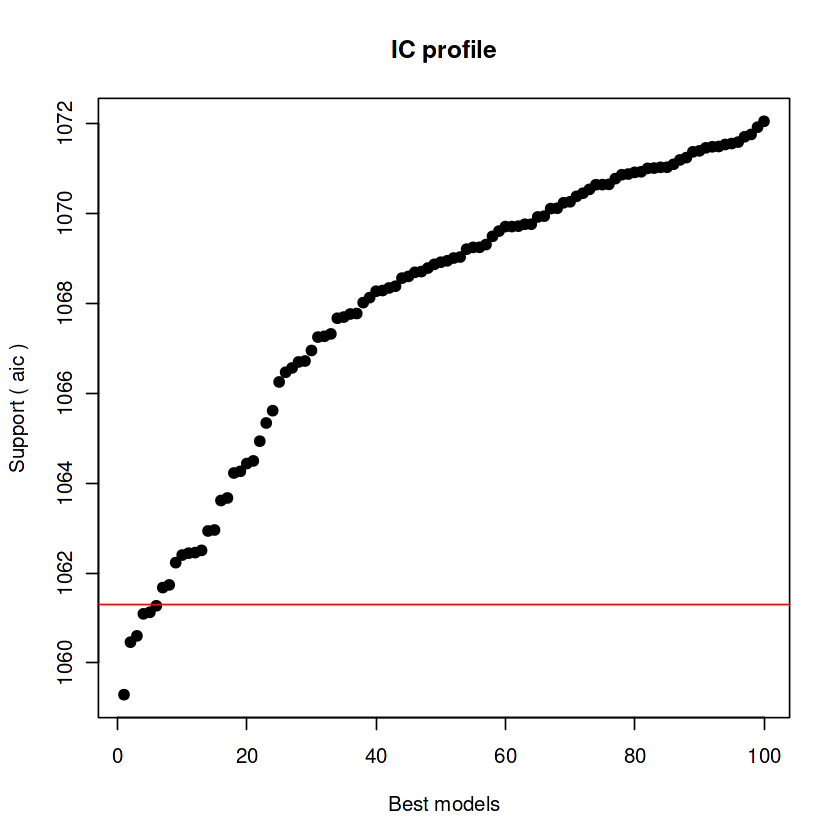


After 4150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.47902464908


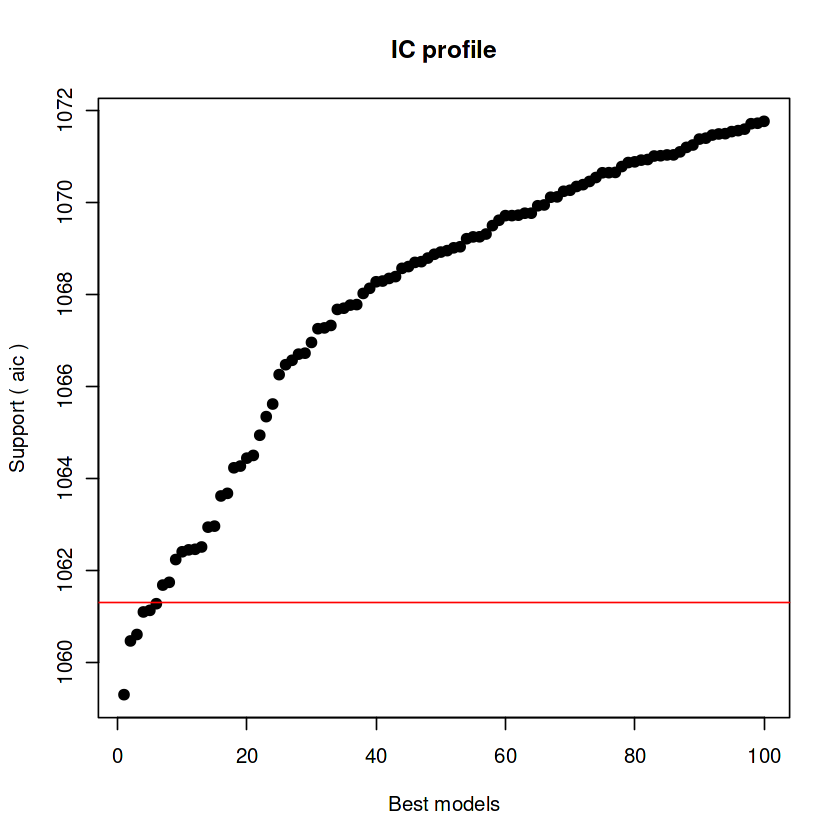


After 4200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.36840105405


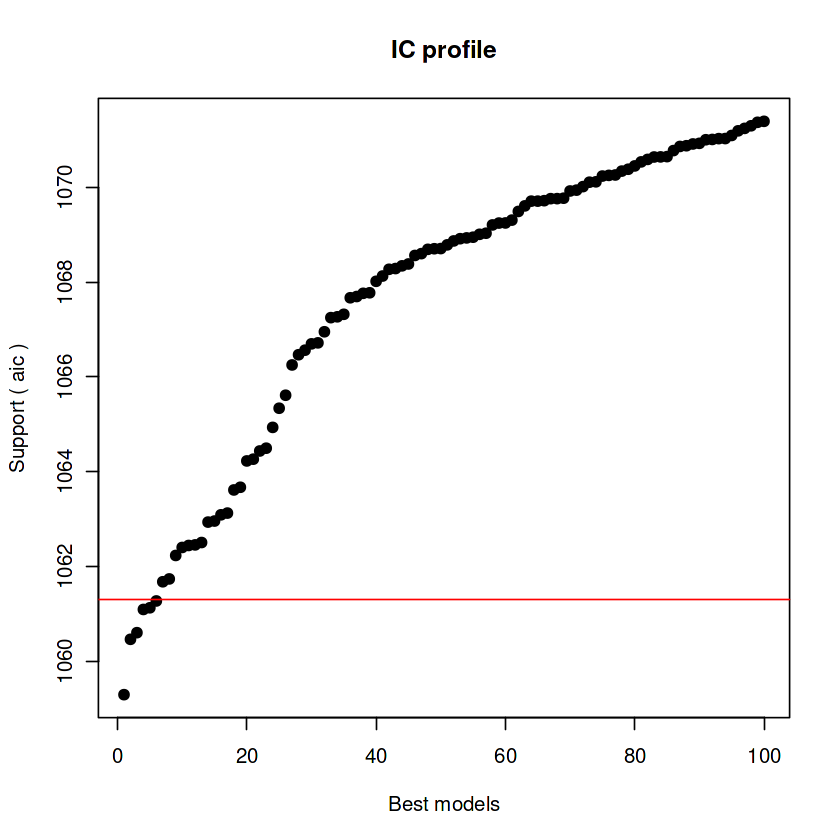


After 4250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926


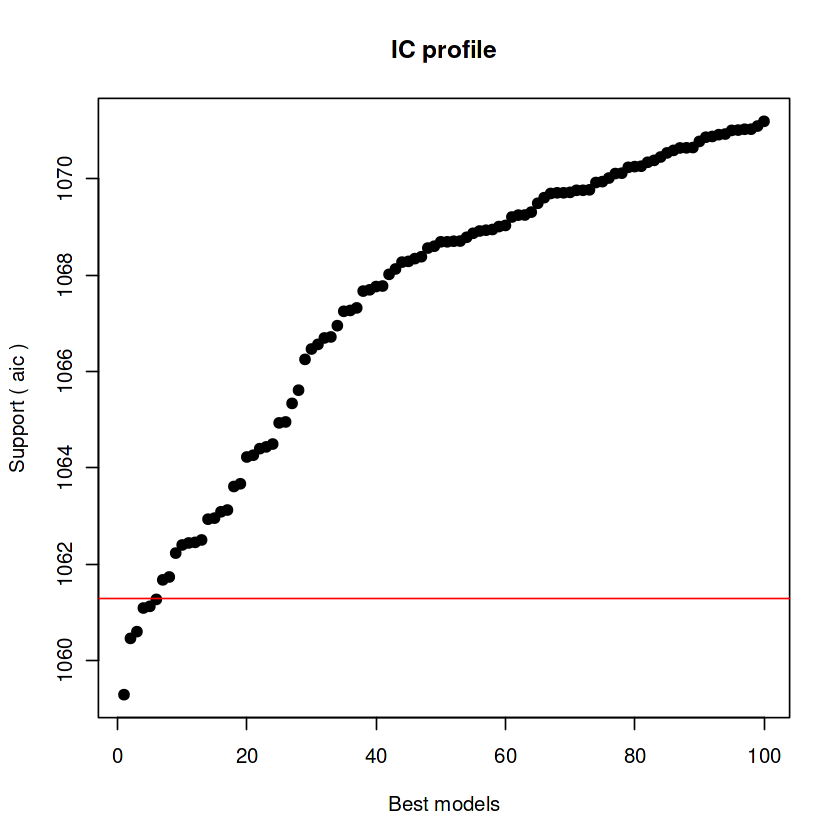


After 4300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926


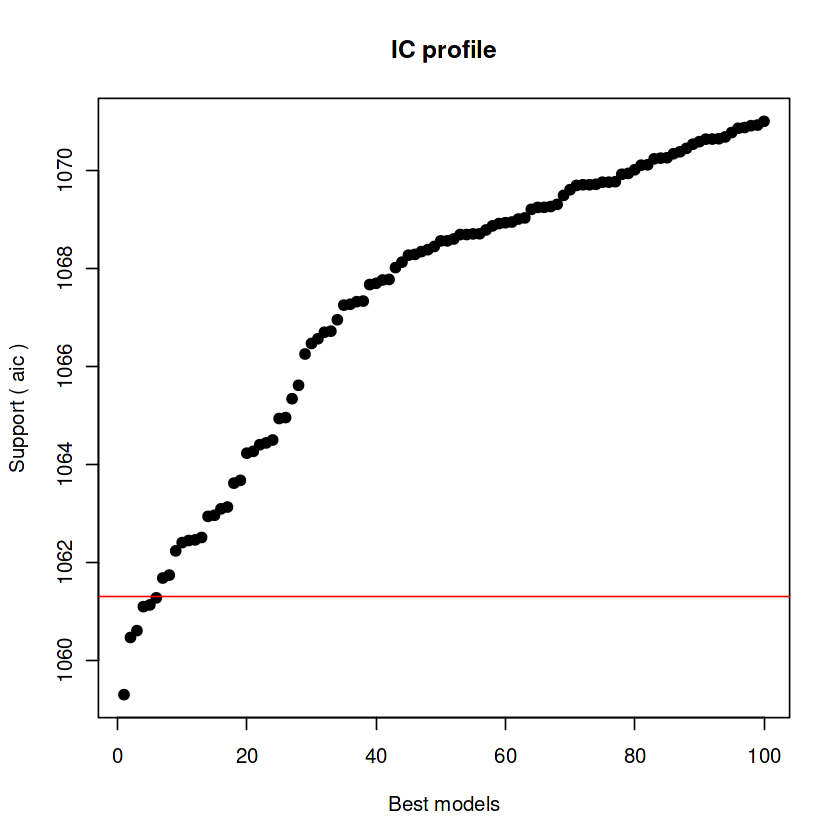


After 4350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 4400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 4450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 4500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 4550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 4600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 4650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 4700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 4750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 4800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 4850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 4900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 4950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 5000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 5050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 5100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 5150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 5200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 5250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 5300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 5350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 5400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 5450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 5500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01174475926



After 5550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01163900425



After 5600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01163900425


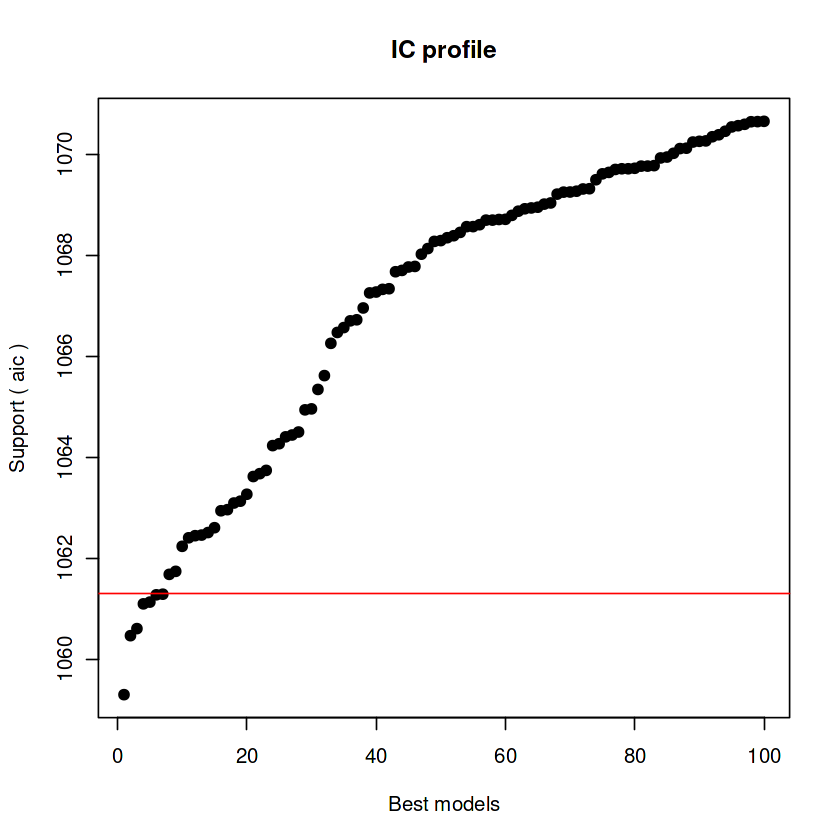


After 5650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01163900425



After 5700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01163900425



After 5750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01163900425



After 5800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01163900425



After 5850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01163900425



After 5900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01163900425



After 5950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01163900425



After 6000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1067.01163900425



After 6050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.99441112702



After 6100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.9938591057


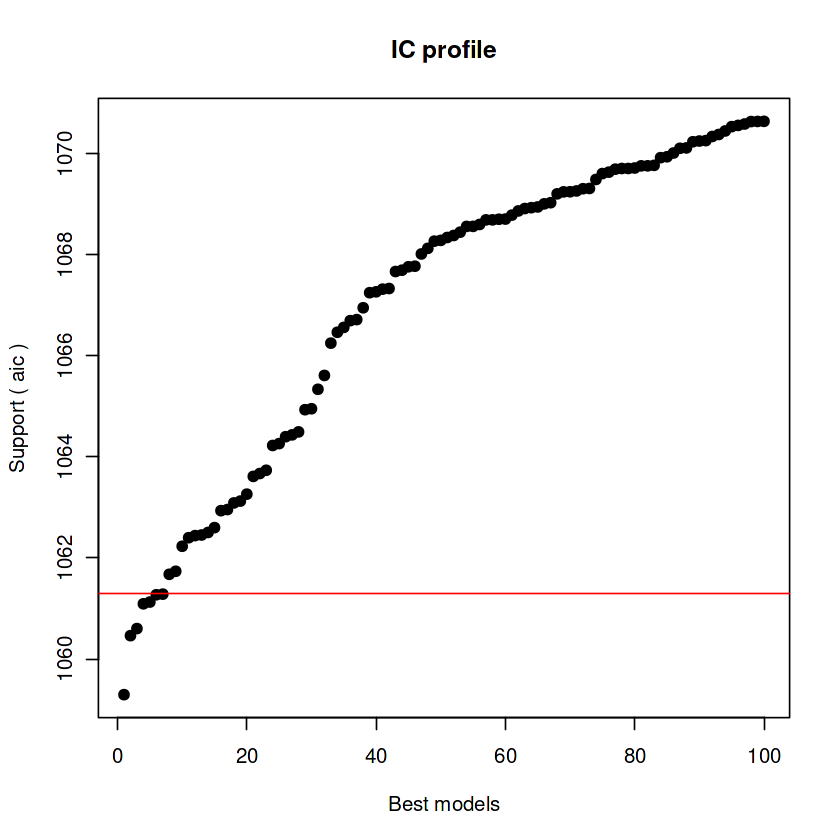


After 6150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.9938591057


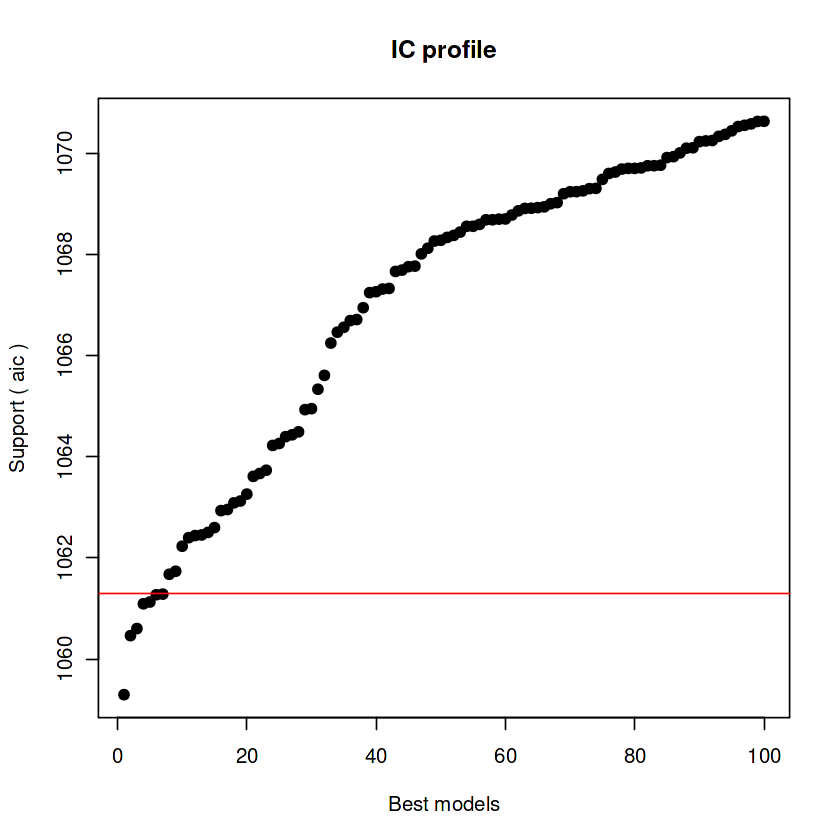


After 6200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.9938591057



After 6250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.9938591057



After 6300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.9938591057



After 6350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.99240849575



After 6400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.99240849575


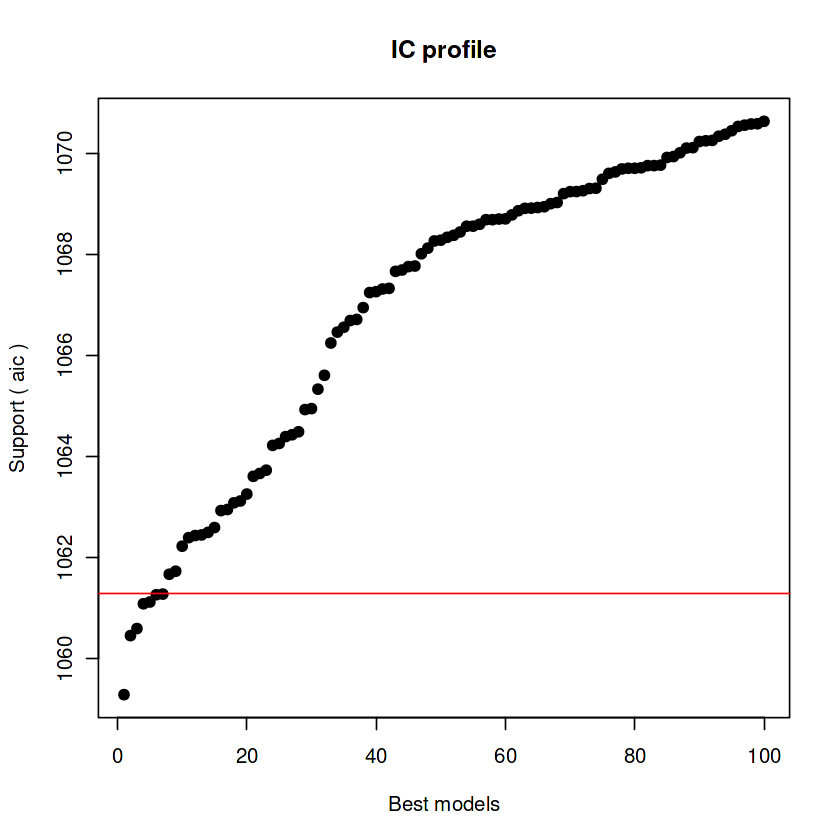


After 6450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.99240849575



After 6500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.99240849575



After 6550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.99240849575



After 6600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.99240849575



After 6650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.99240849575



After 6700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.99240849575



After 6750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.99240849575



After 6800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.99240849575



After 6850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.9765087374



After 6900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.9765087374


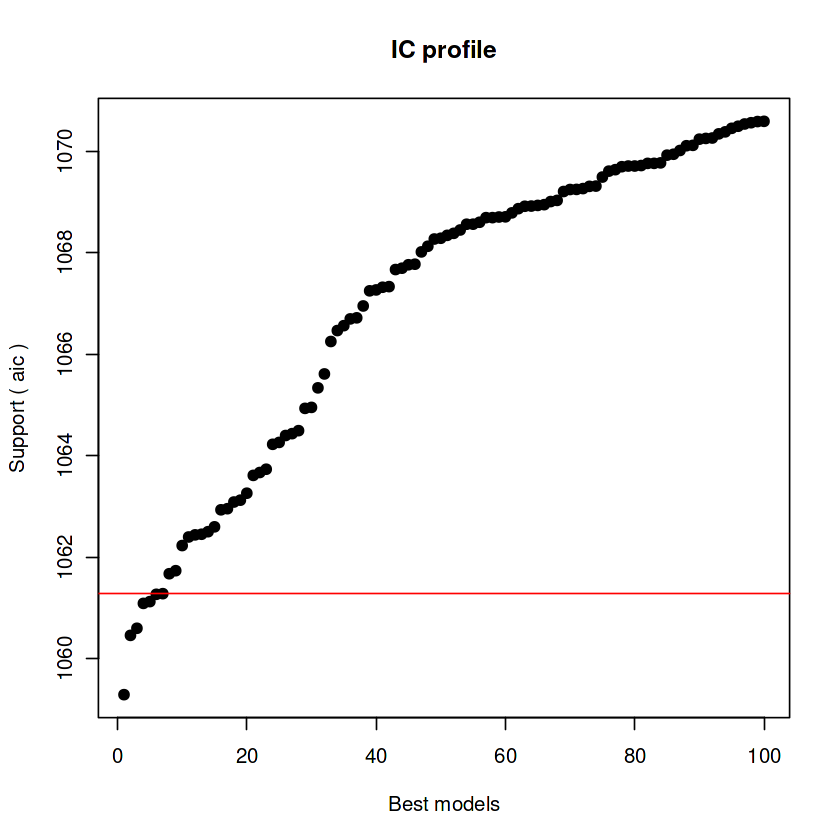


After 6950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.9765087374



After 7000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.94201629847



After 7050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.94201629847


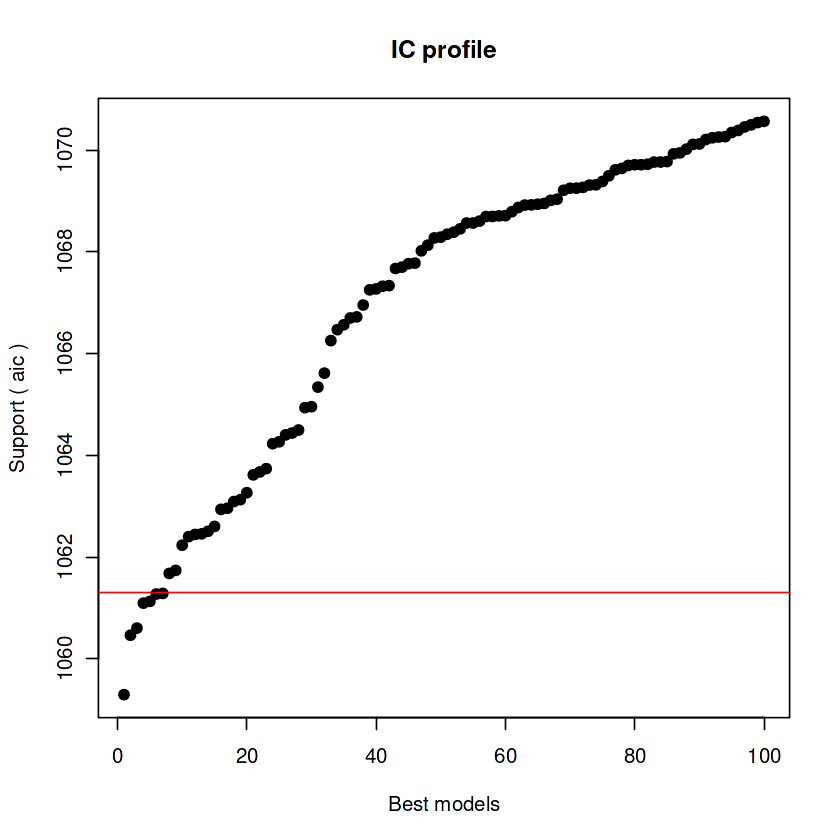


After 7100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.85377761692



After 7150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.8010563401


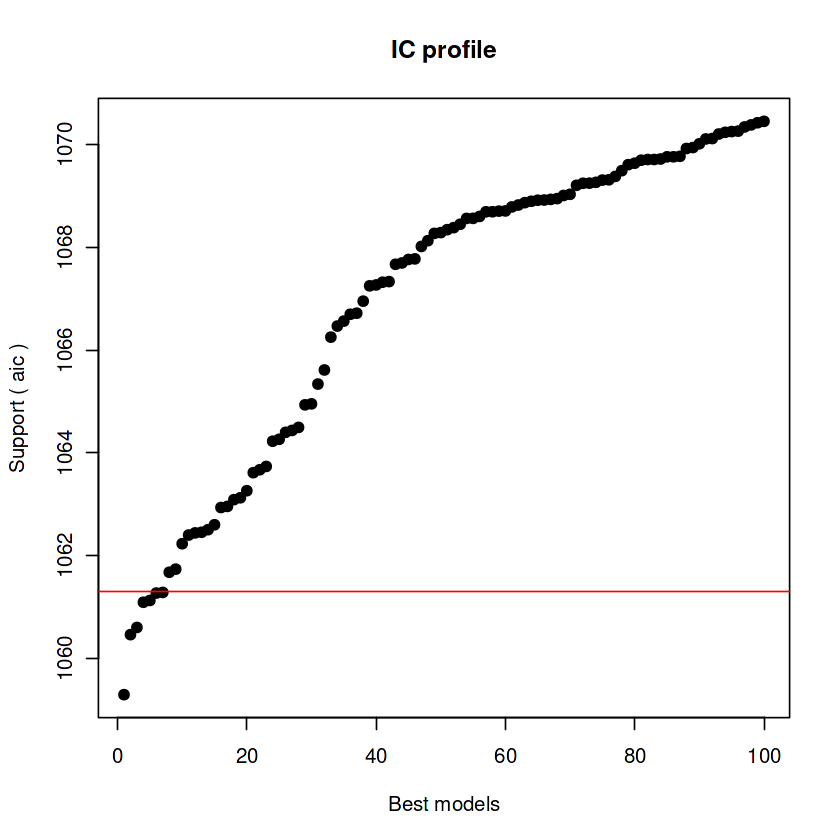


After 7200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.8010563401


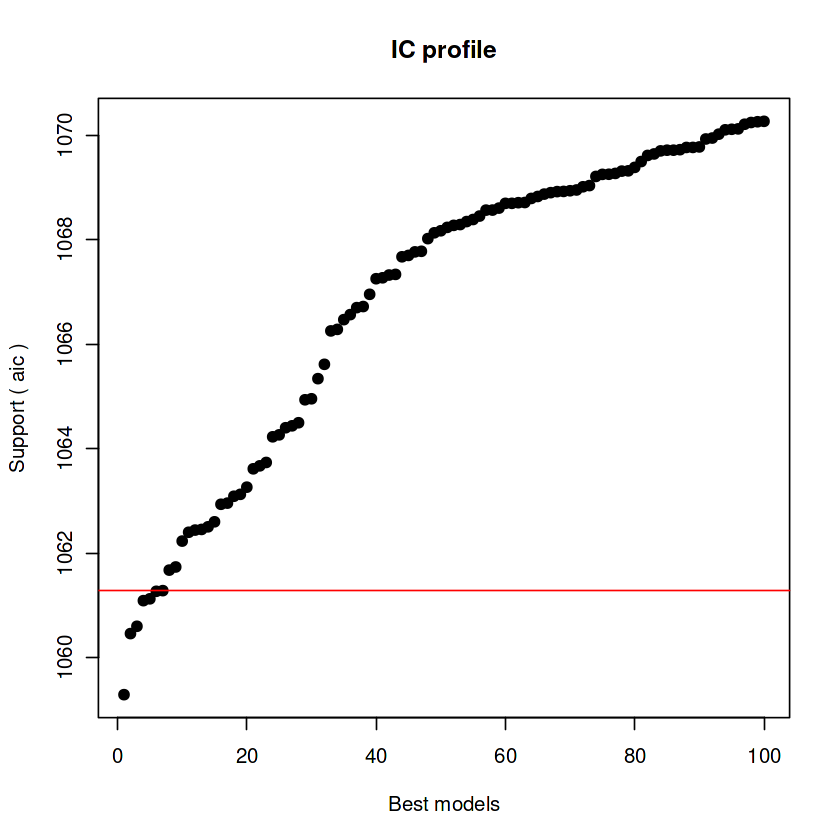


After 7250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.69611407835



After 7300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.68088012553


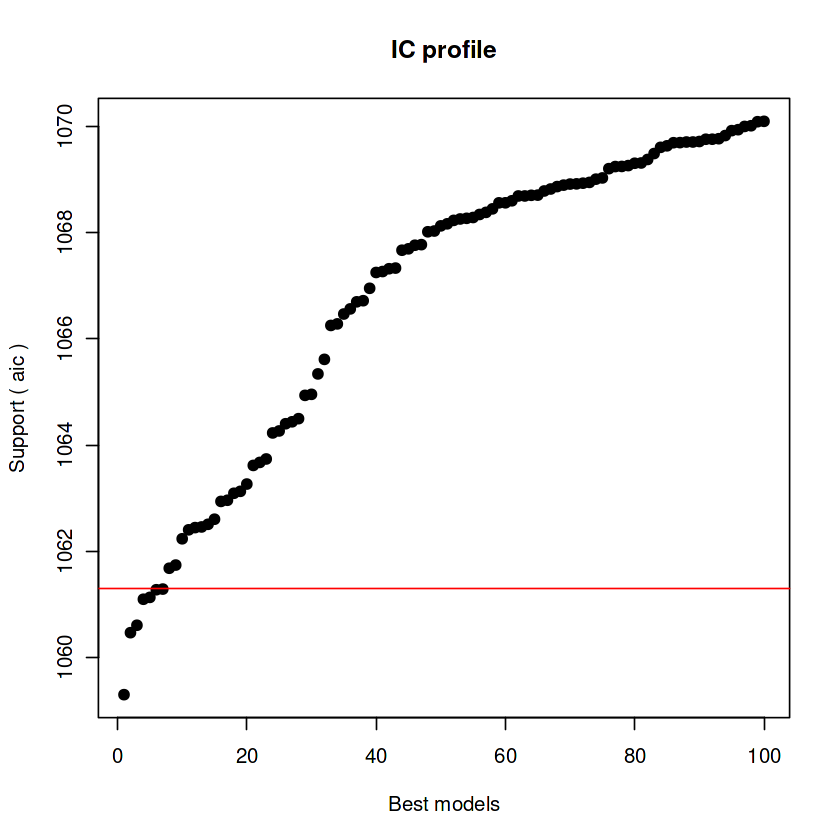


After 7350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.68088012553


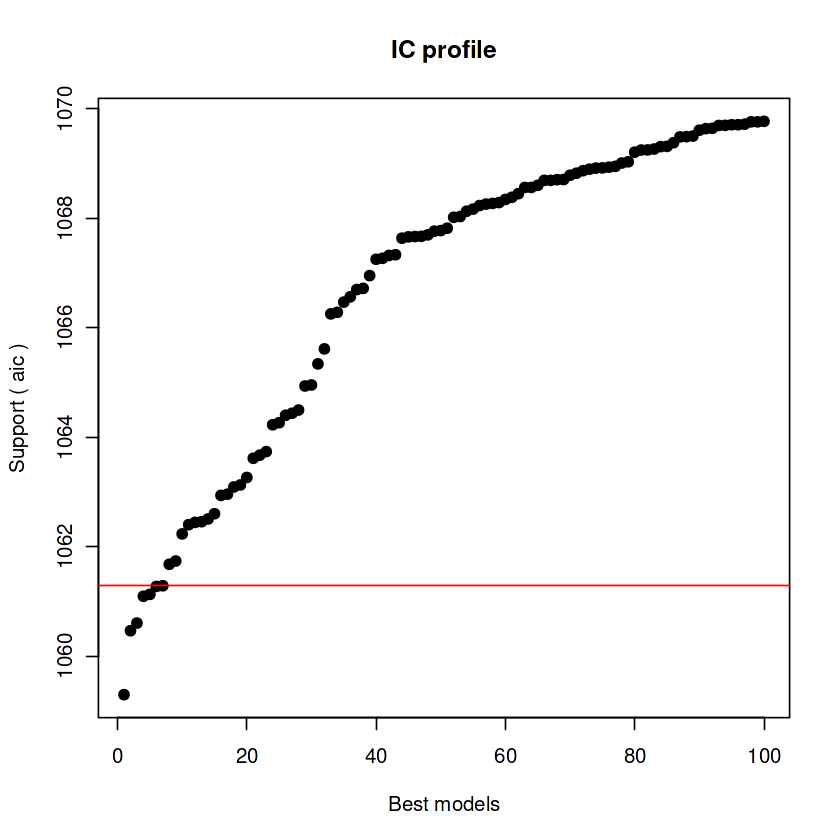


After 7400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.45317888794



After 7450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.35528330477


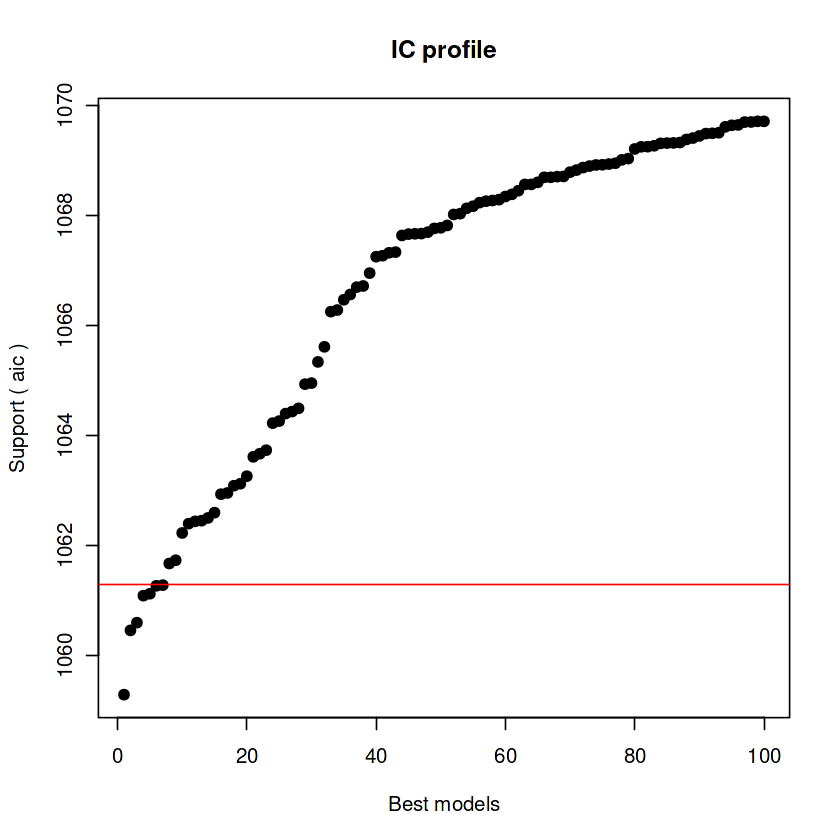


After 7500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1066.30573782024


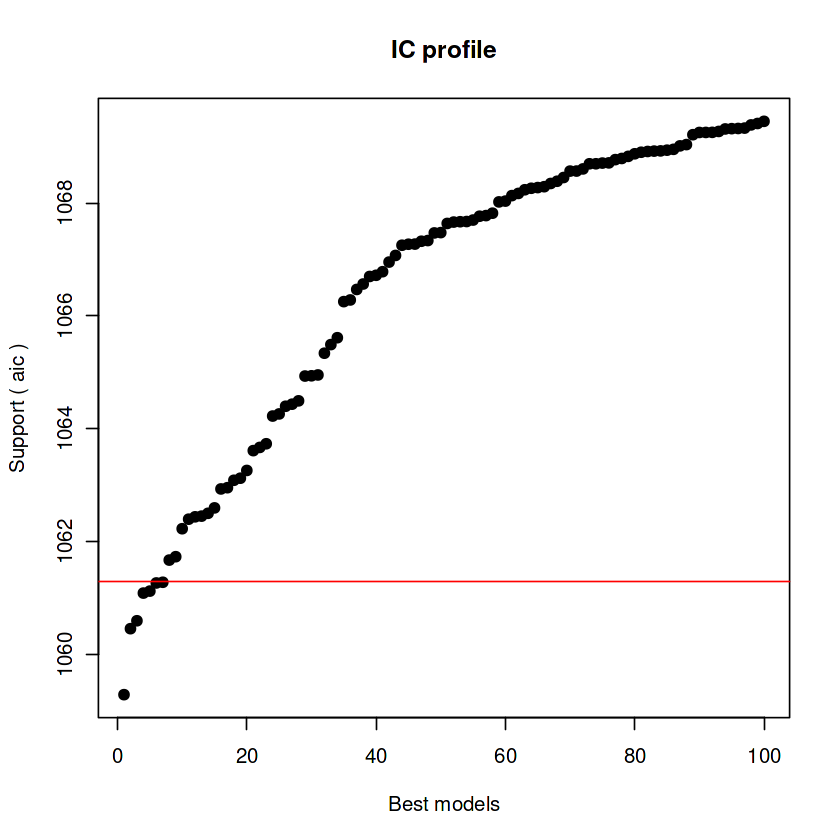


After 7550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1065.71069588412


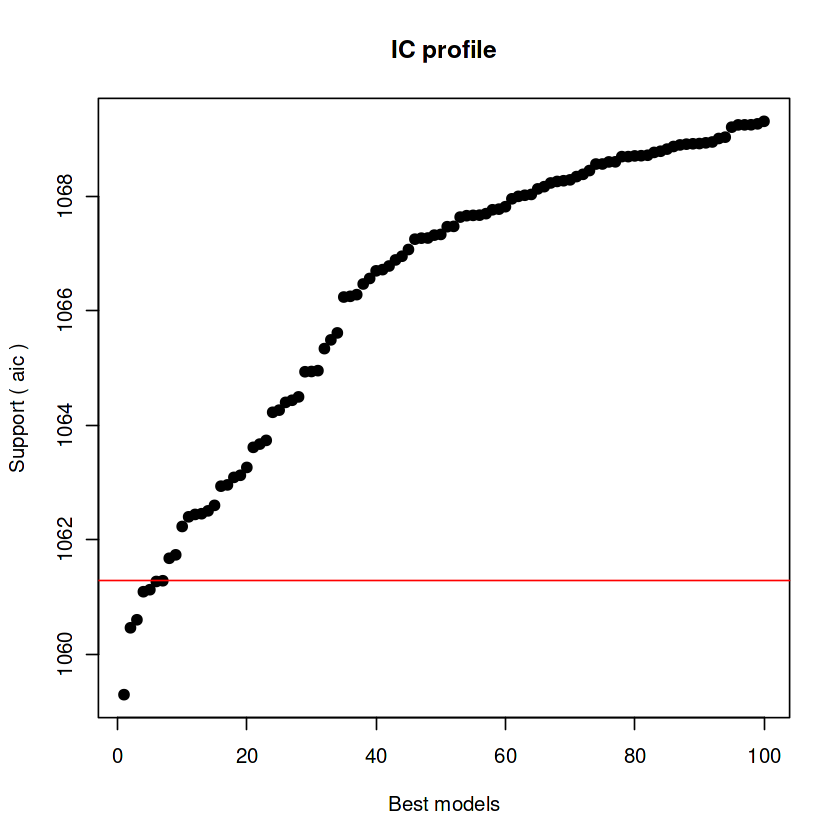


After 7600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS
Crit= 1059.2940879312
Mean crit= 1065.58982144095


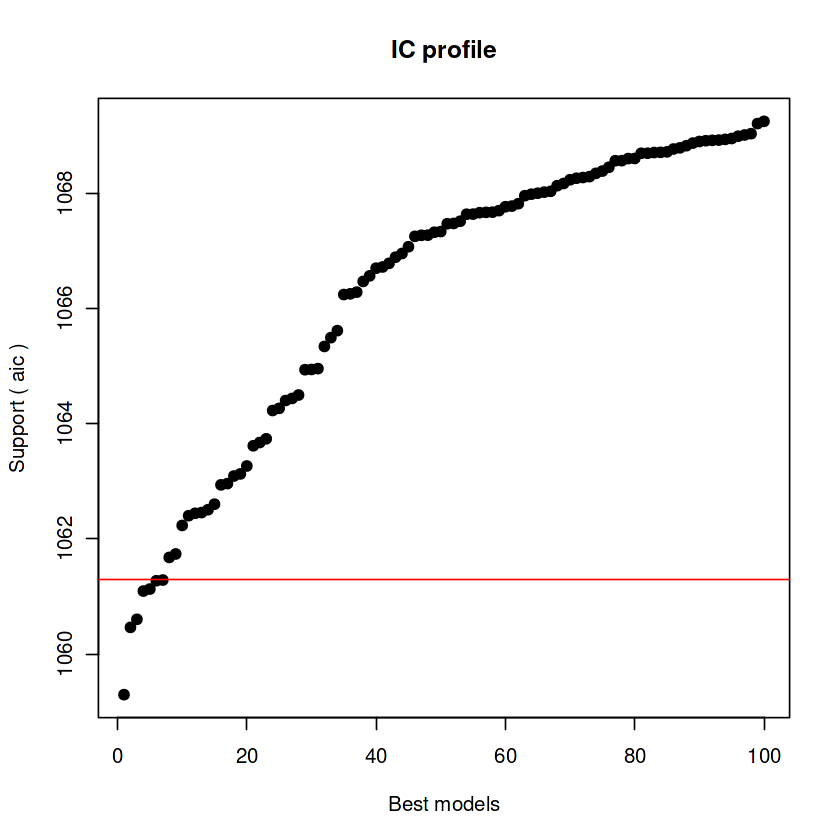


After 7650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP
Crit= 1057.75229867145
Mean crit= 1065.11884167793


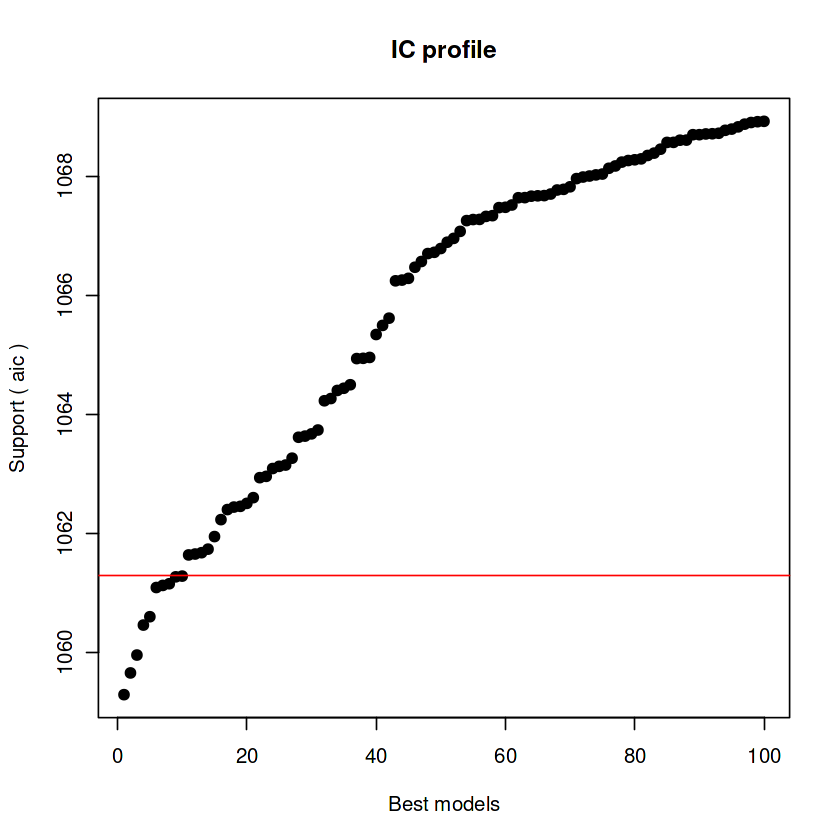


After 7700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP
Crit= 1057.75229867145
Mean crit= 1064.81896605773


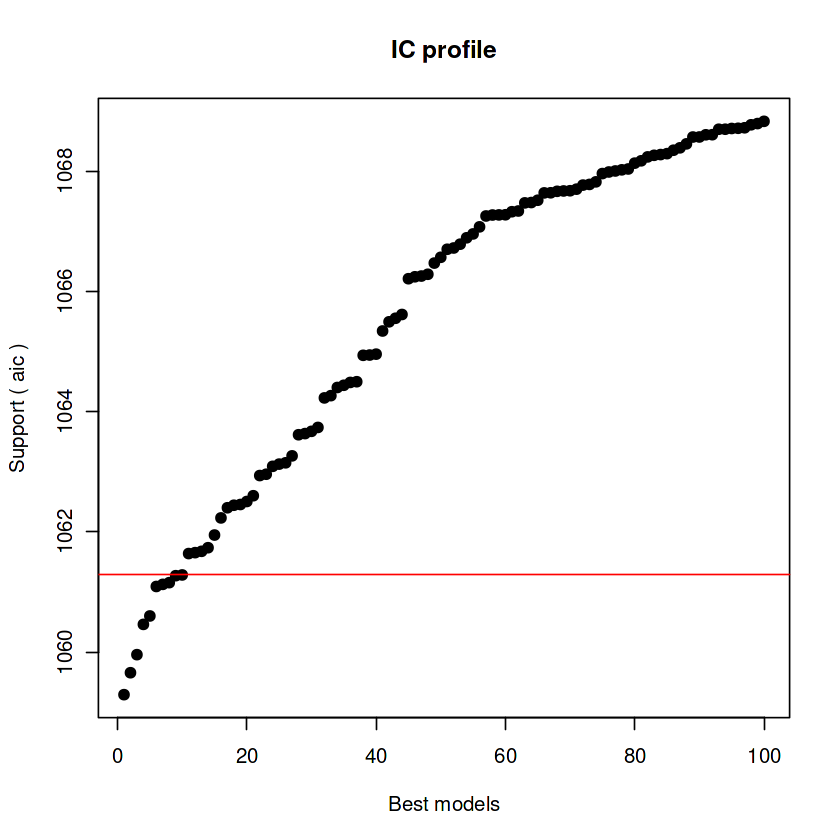


After 7750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP
Crit= 1057.75229867145
Mean crit= 1064.81848839824


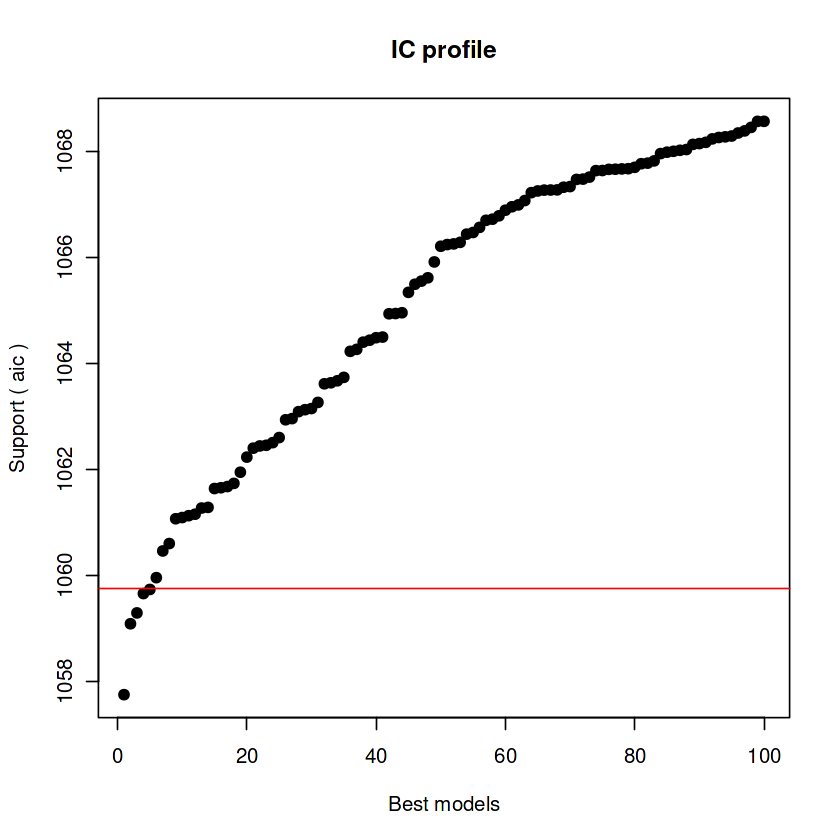


After 7800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP
Crit= 1057.75229867145
Mean crit= 1064.60043789225


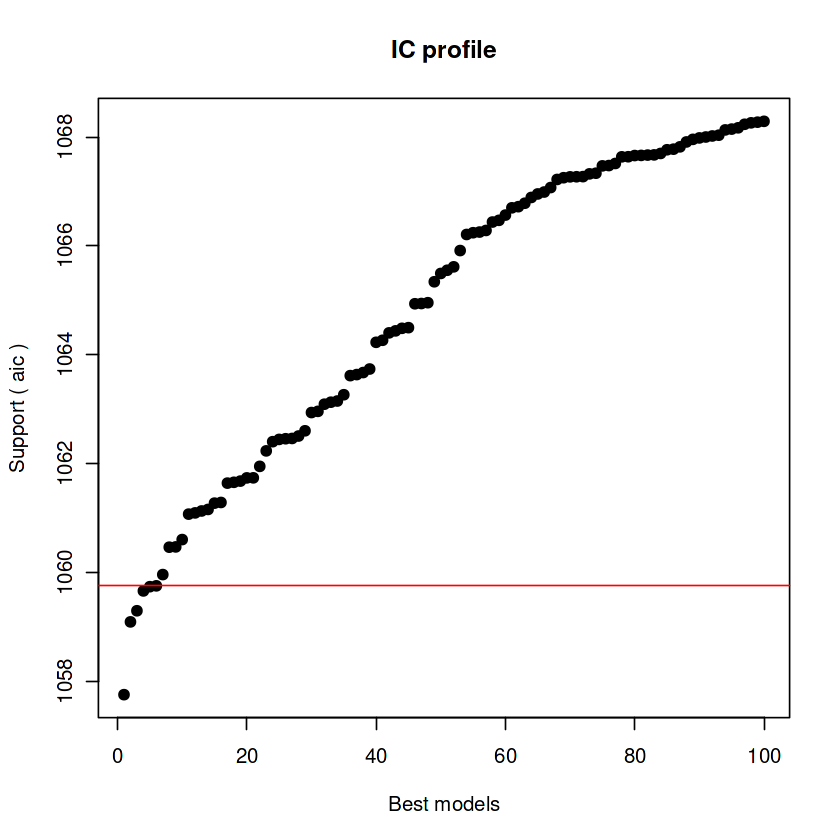


After 7850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP
Crit= 1057.75229867145
Mean crit= 1064.43166025895


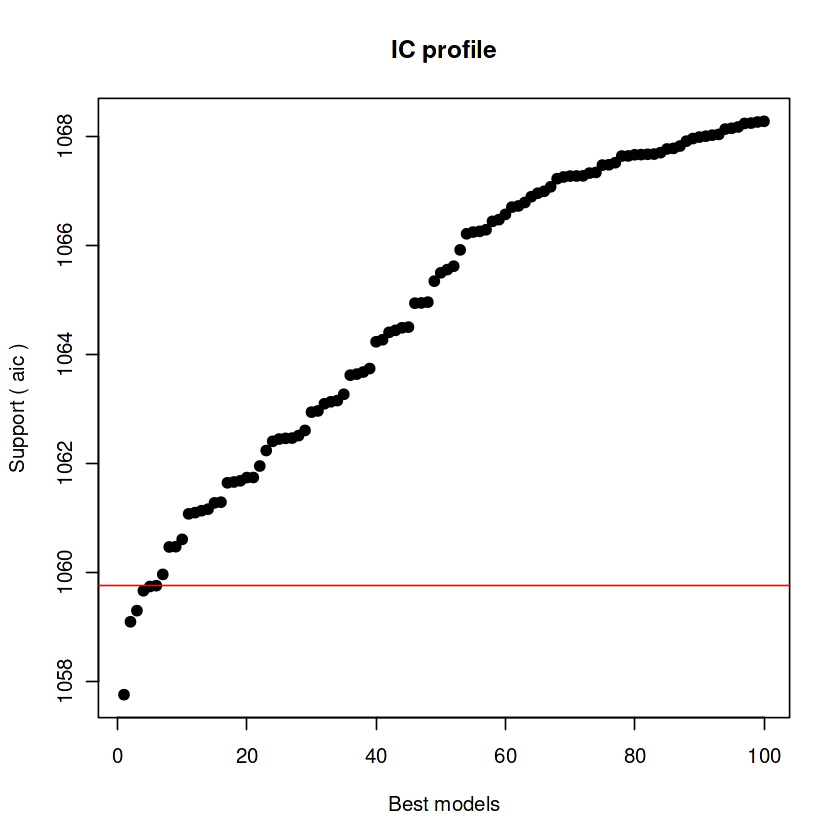


After 7900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP
Crit= 1057.75229867145
Mean crit= 1064.43077106369


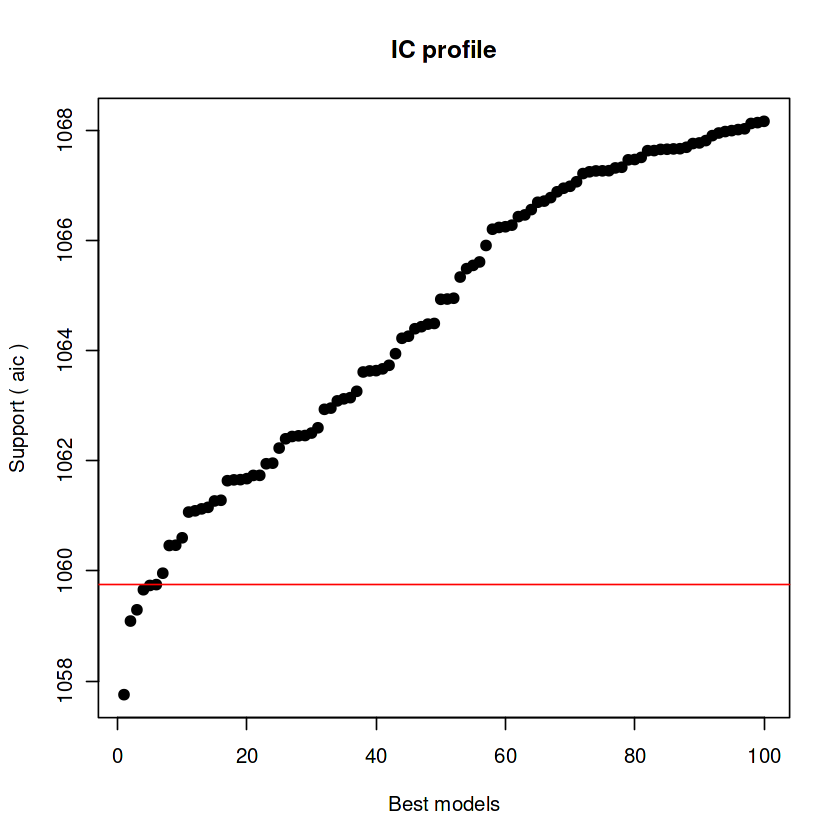


After 7950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP
Crit= 1057.75229867145
Mean crit= 1063.98626730509


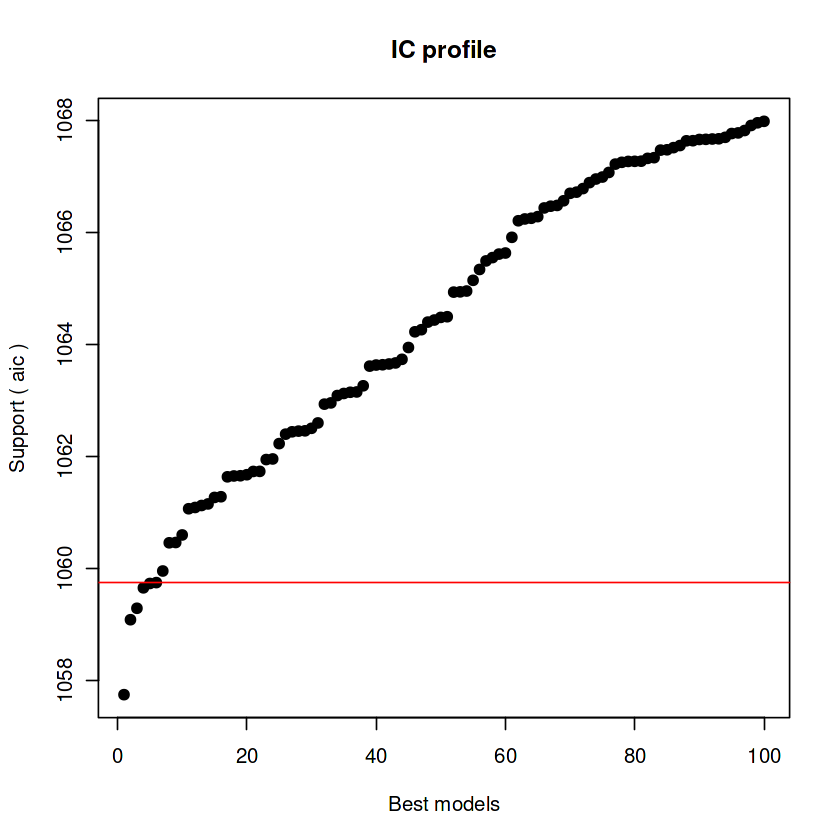


After 8000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP
Crit= 1057.75229867145
Mean crit= 1063.83827933388


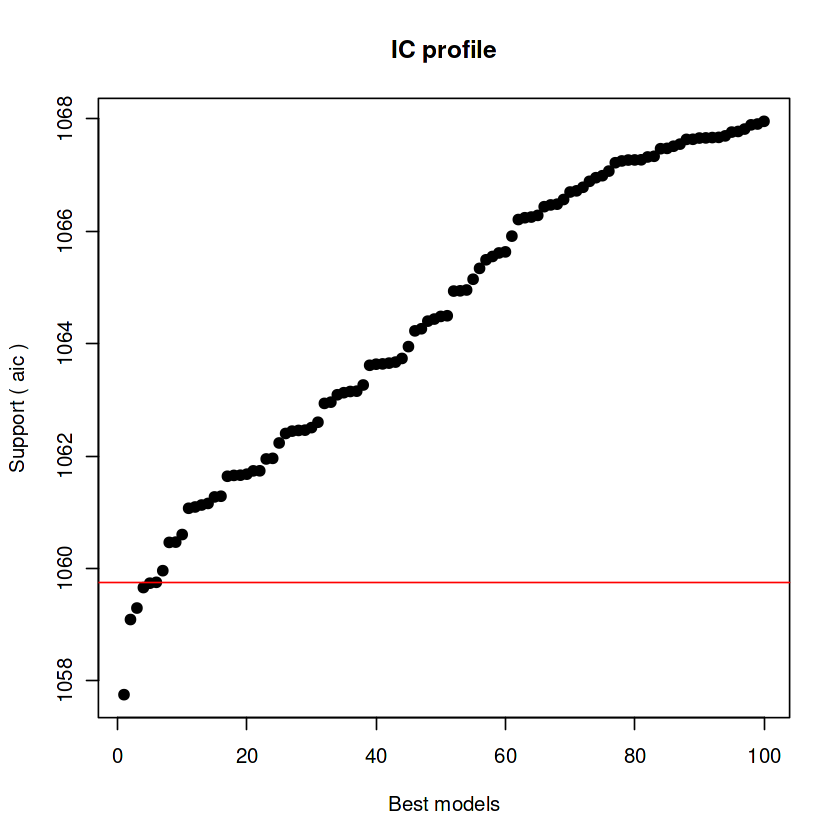


After 8050 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+Hepatitis.B+BMI+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1056.94725702512
Mean crit= 1063.28287599791


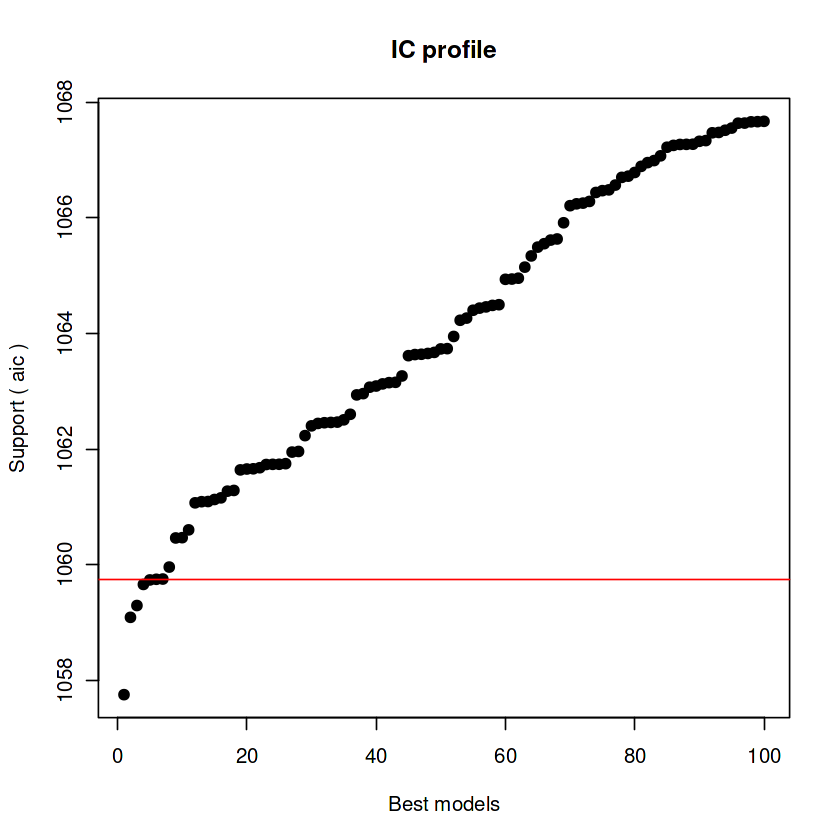


After 8100 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+Hepatitis.B+BMI+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1056.94725702512
Mean crit= 1062.92772492317


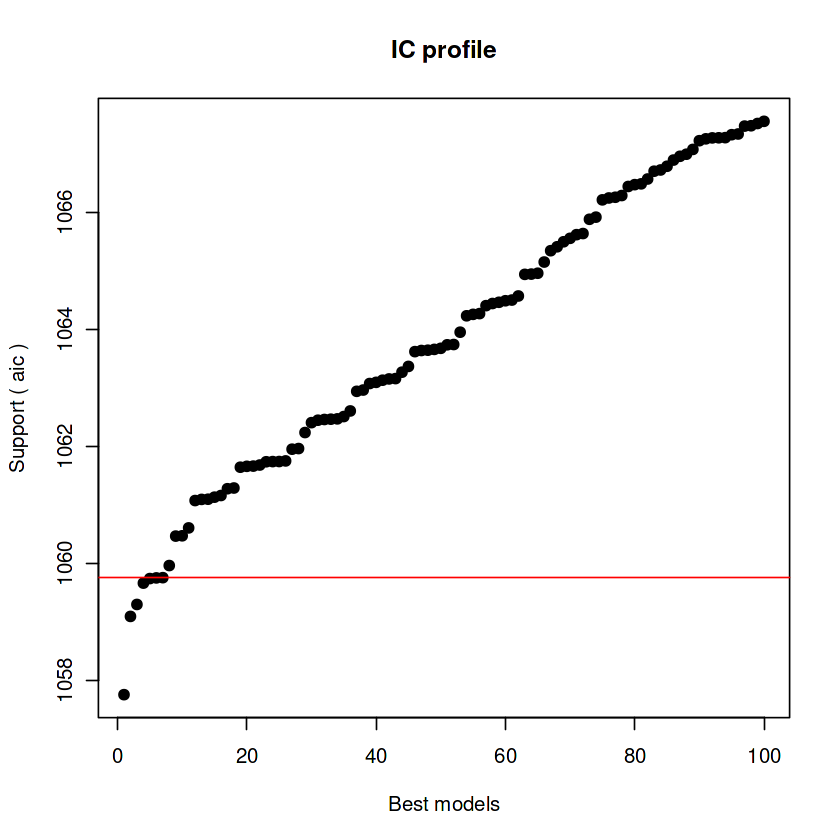


After 8150 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+Hepatitis.B+BMI+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1056.94725702512
Mean crit= 1062.69299077325


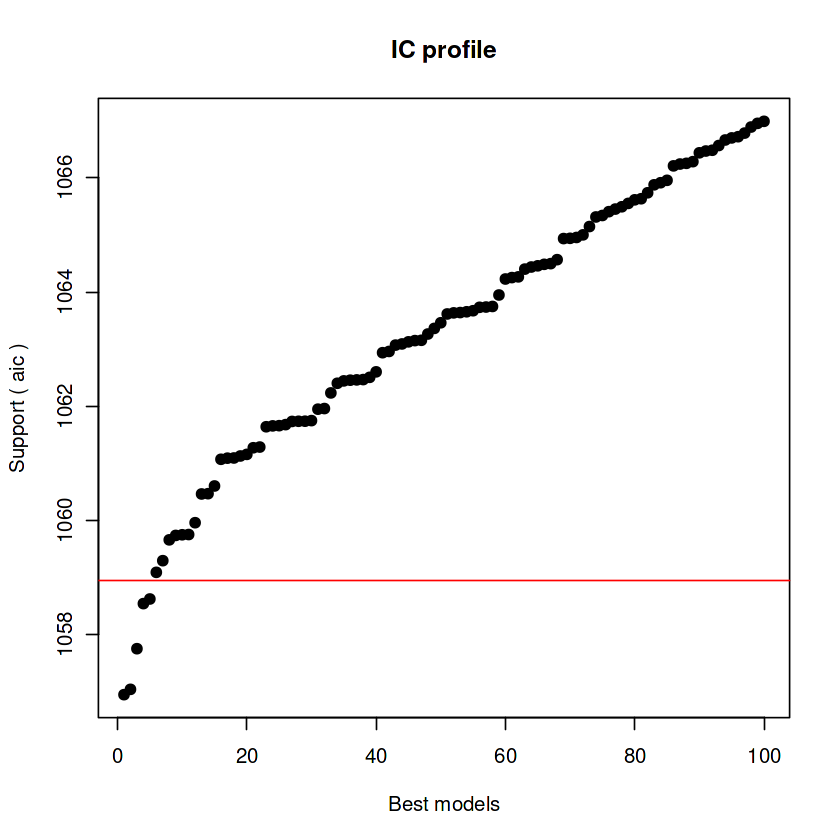


After 8200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1062.15529208085


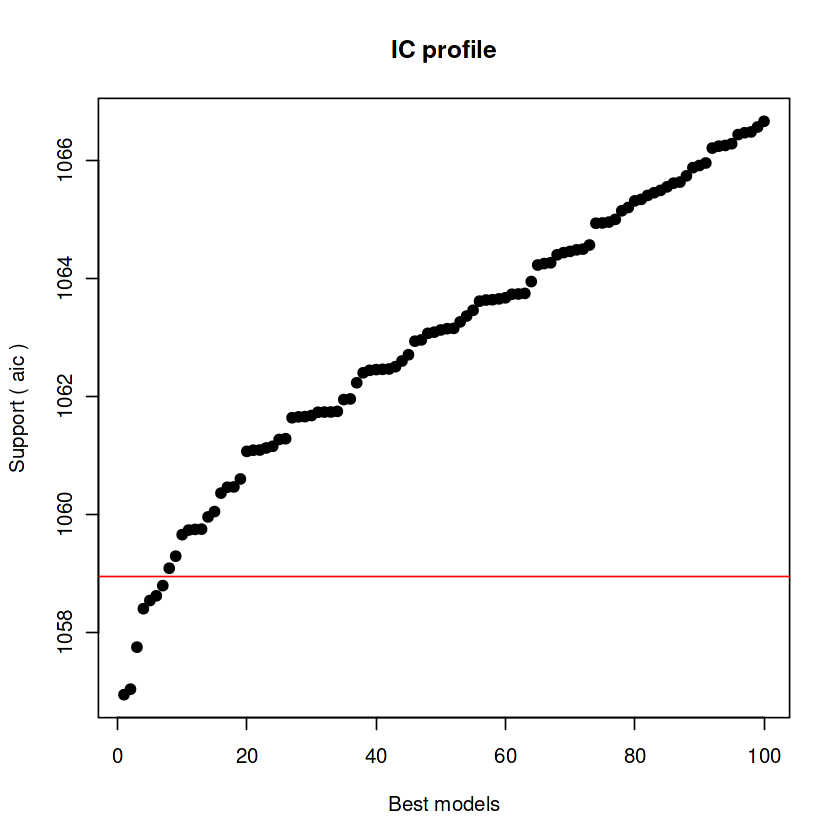


After 8250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.94418643991


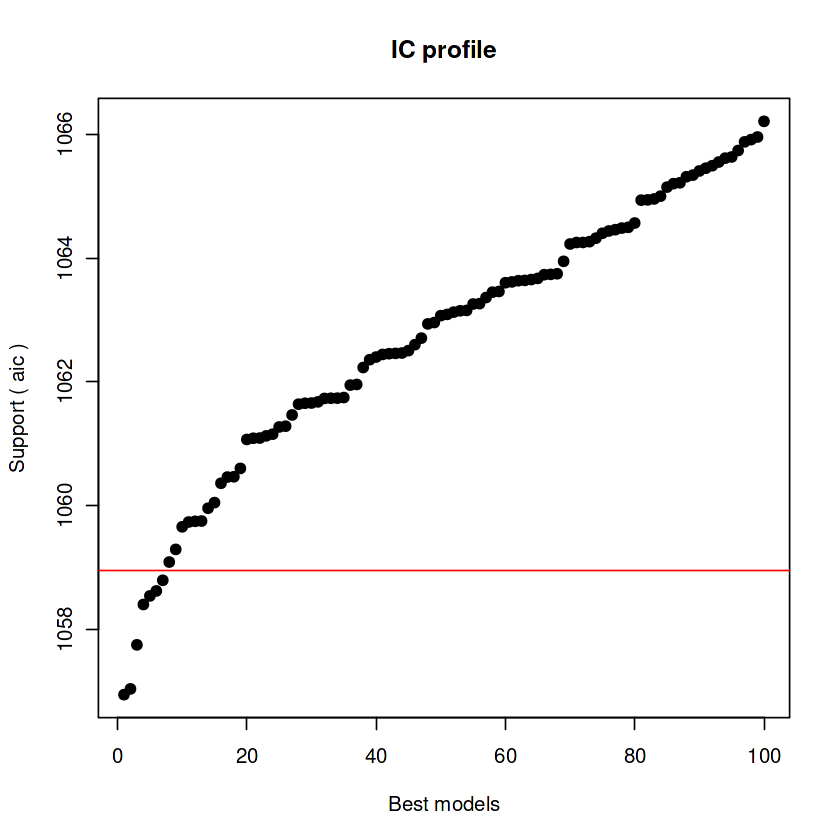


After 8300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.81937078422


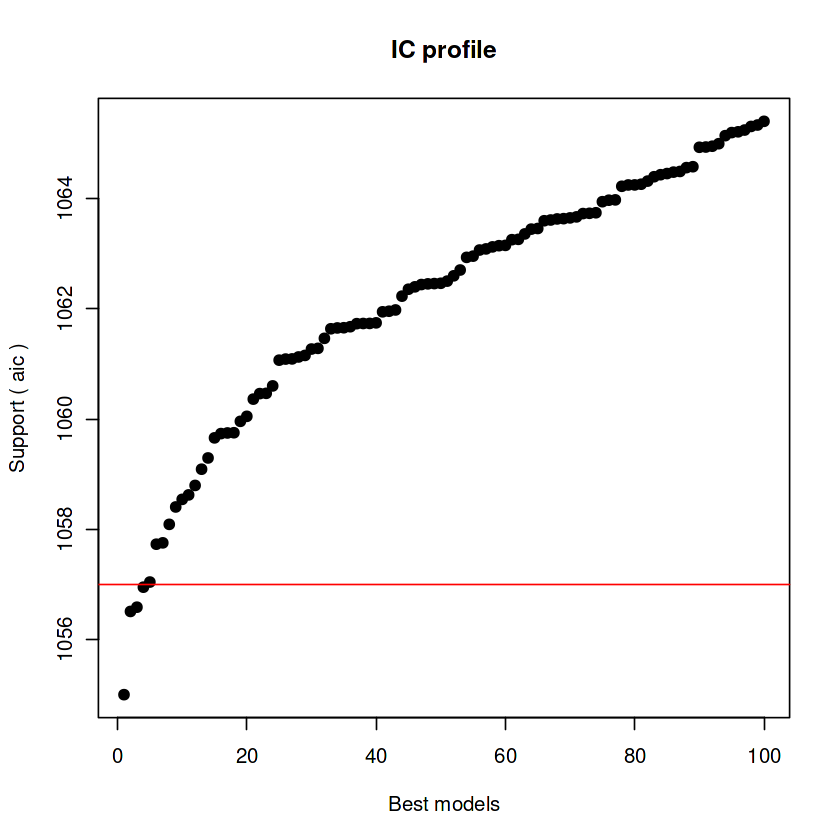


After 8350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.58488280329


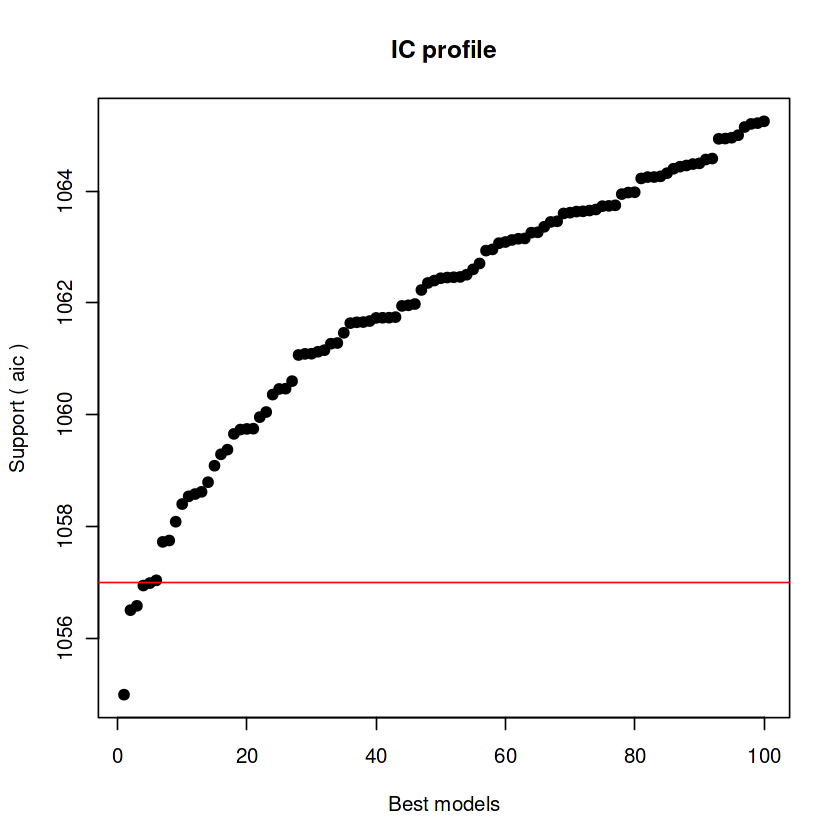


After 8400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.57158537467


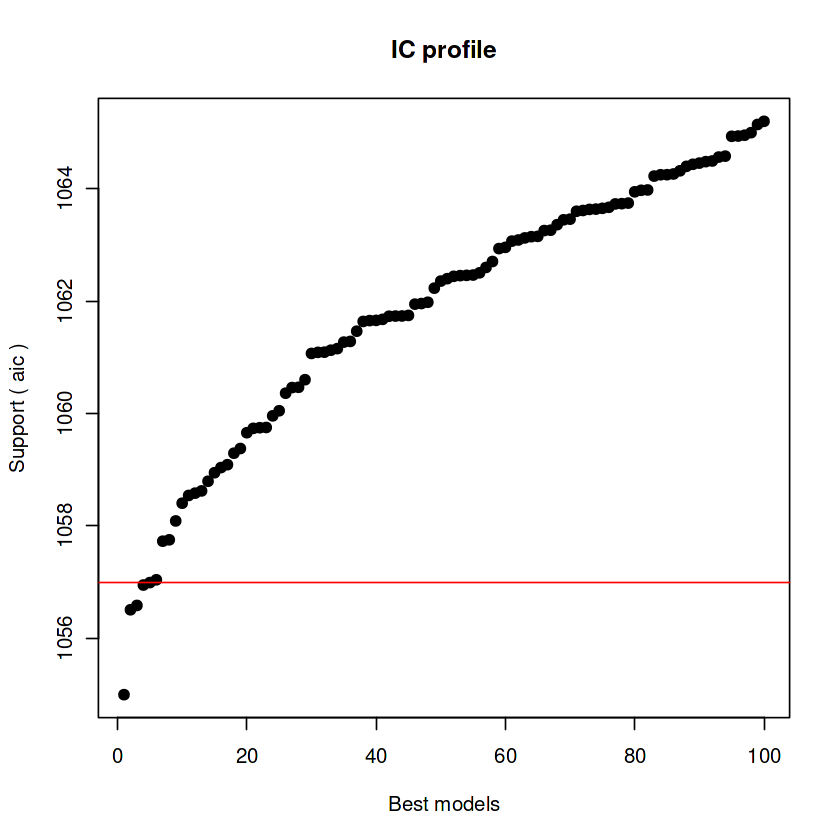


After 8450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.32992213614


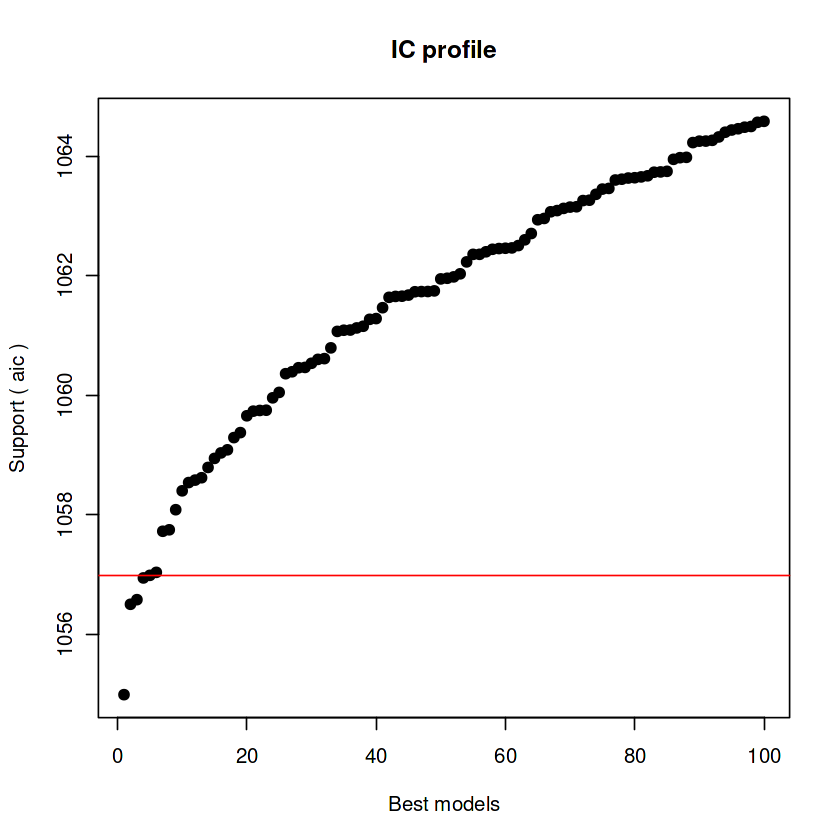


After 8500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471


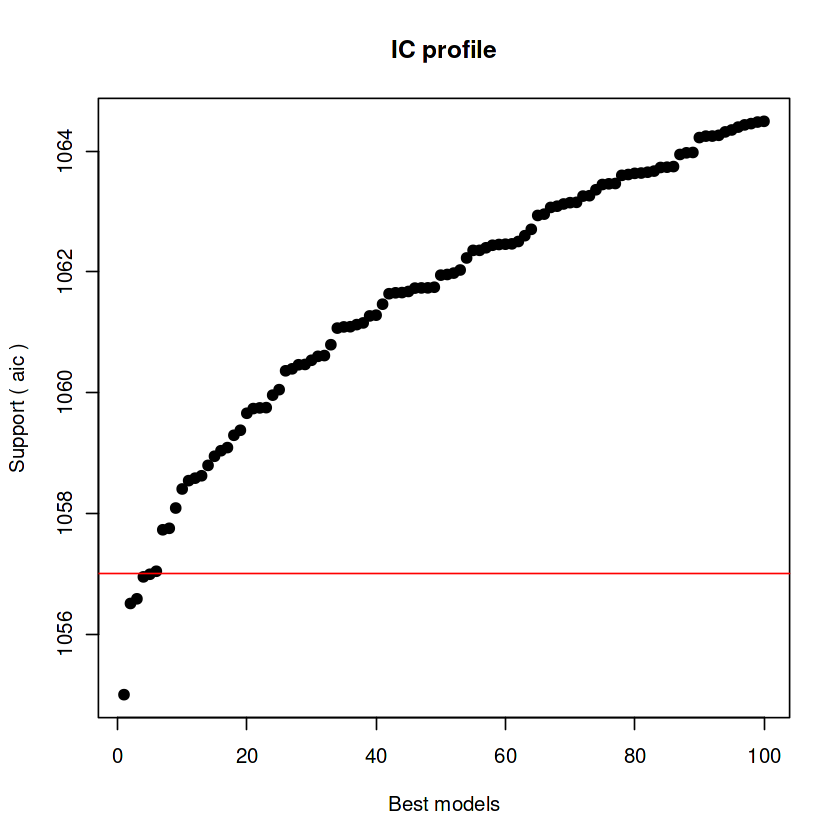


After 8550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471


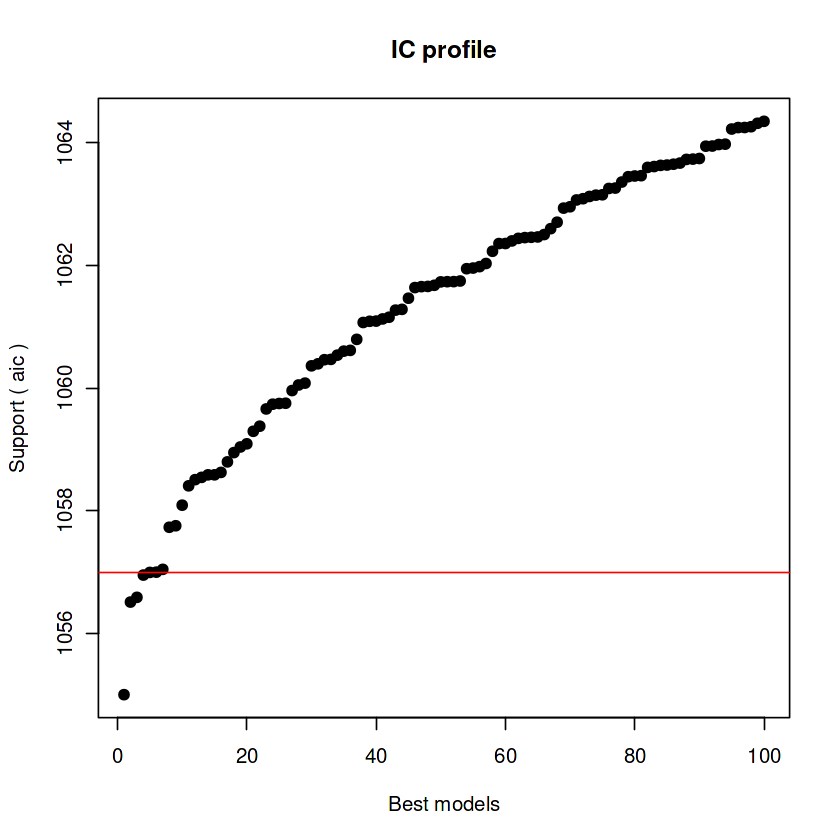


After 8600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 8650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 8700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 8750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 8800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 8850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 8900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 8950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 9950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 10950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.16452758471



After 11800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.14080618588



After 11850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.14080618588


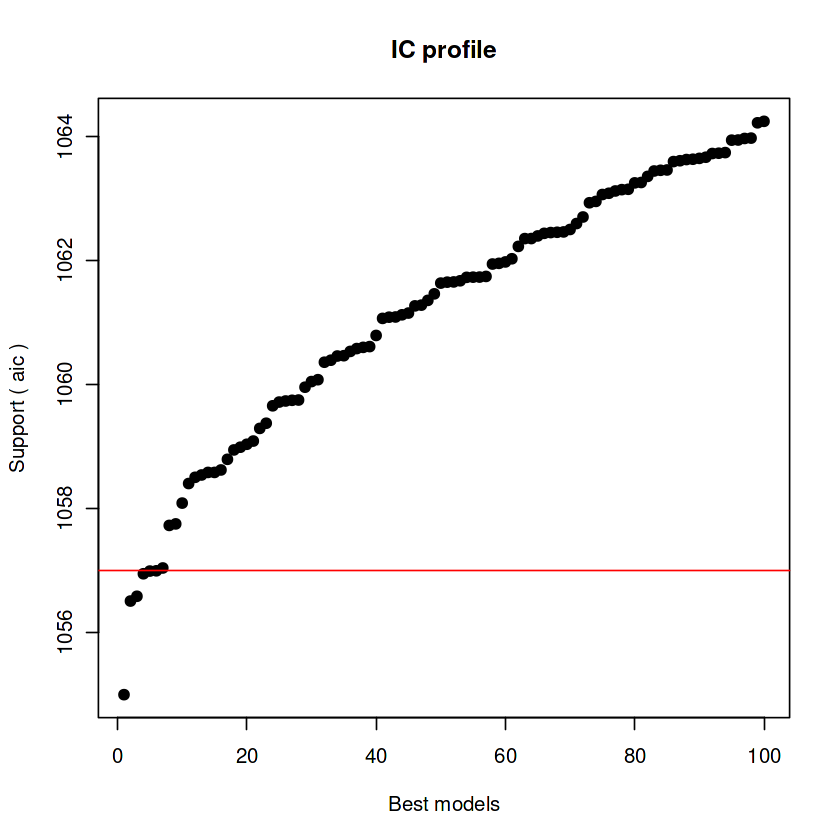


After 11900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.10171529219



After 11950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.09564251968


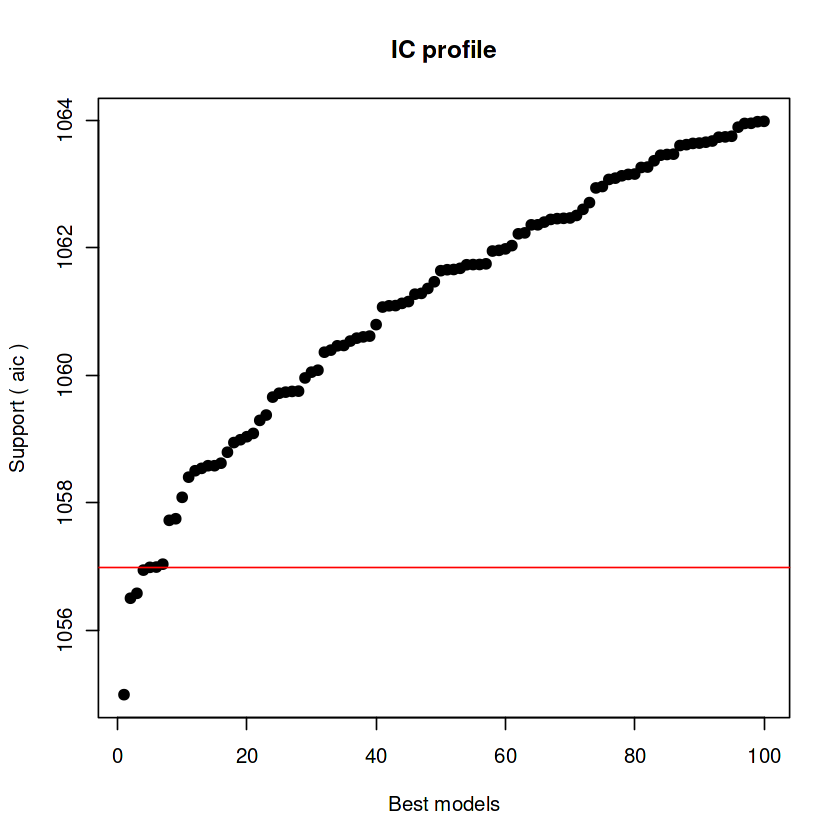


After 12000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.09564251968


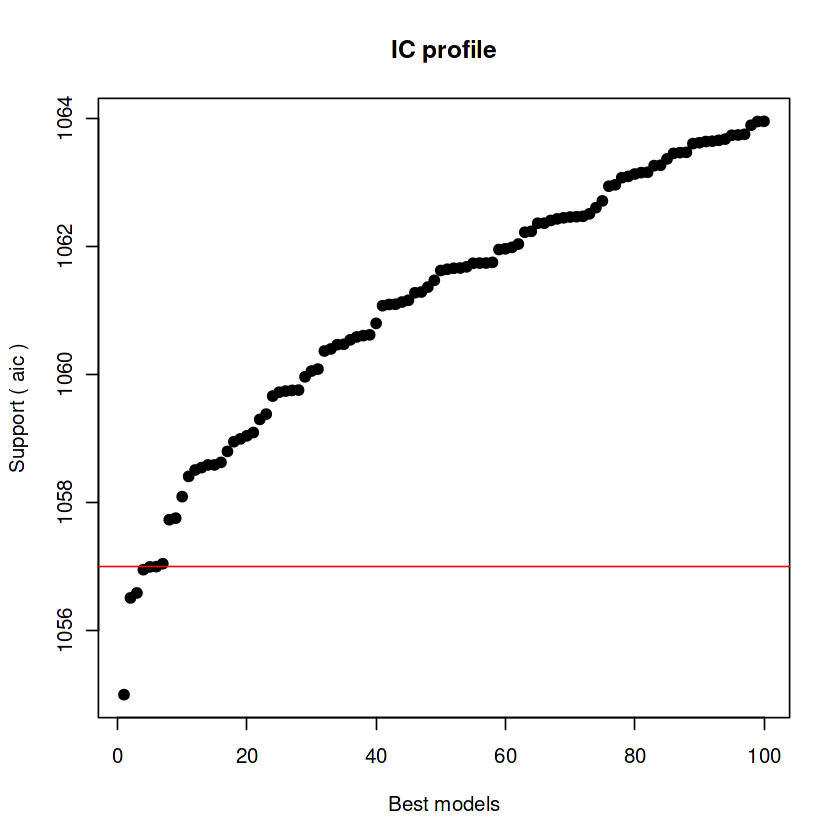


After 12050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.09564251968



After 12100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.09564251968



After 12150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.0915871554



After 12200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.0915871554


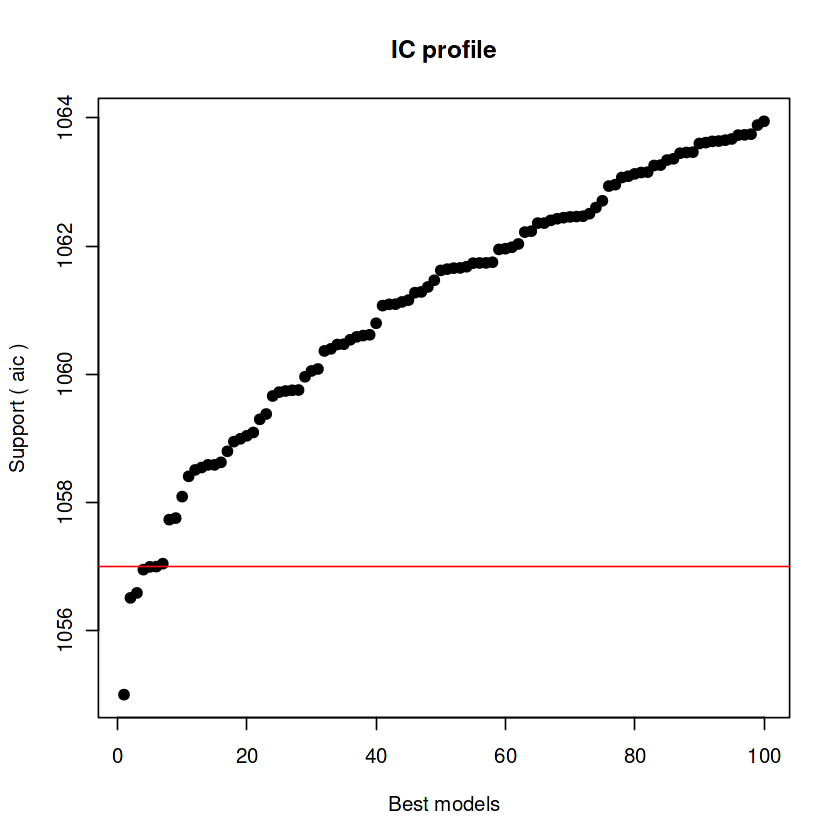


After 12250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.0915871554



After 12300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.05549572824



After 12350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.04499601072


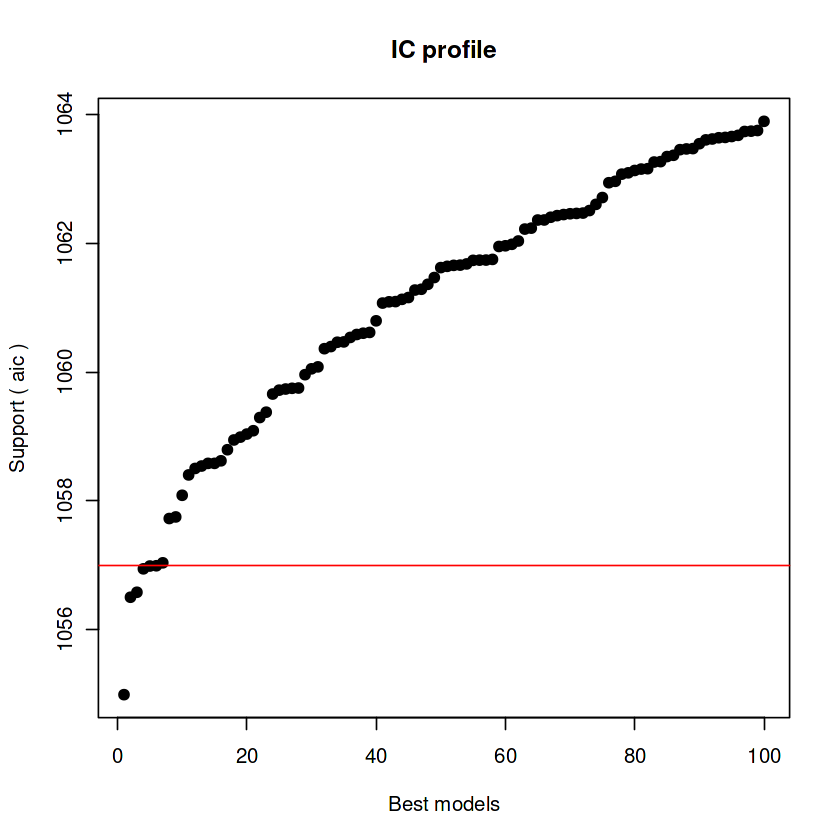


After 12400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1061.04499601072


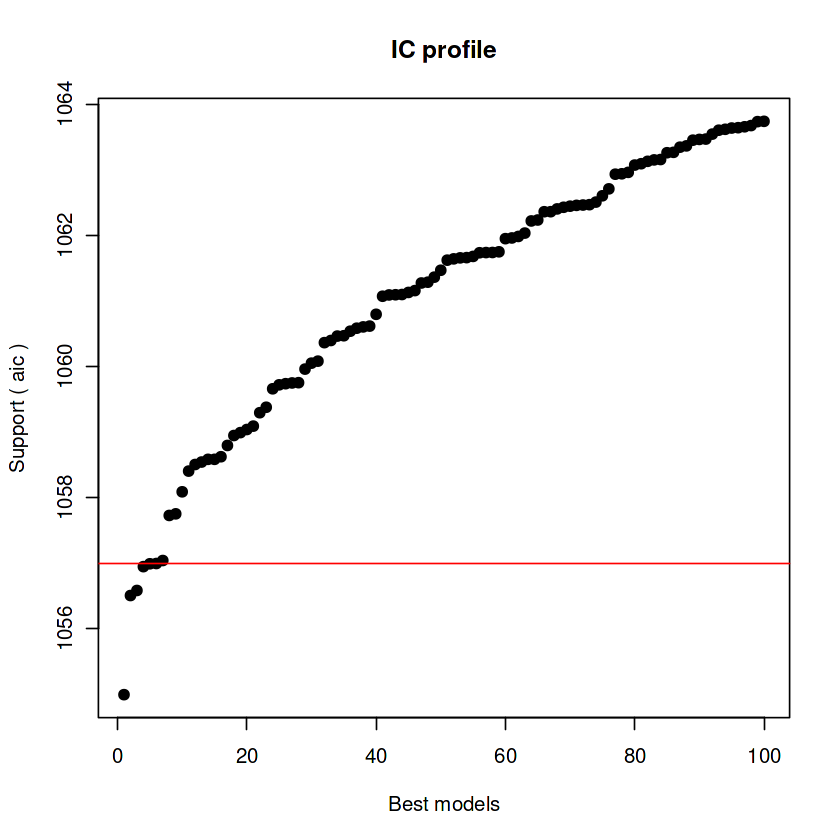


After 12450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.96945982412



After 12500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.96945982412


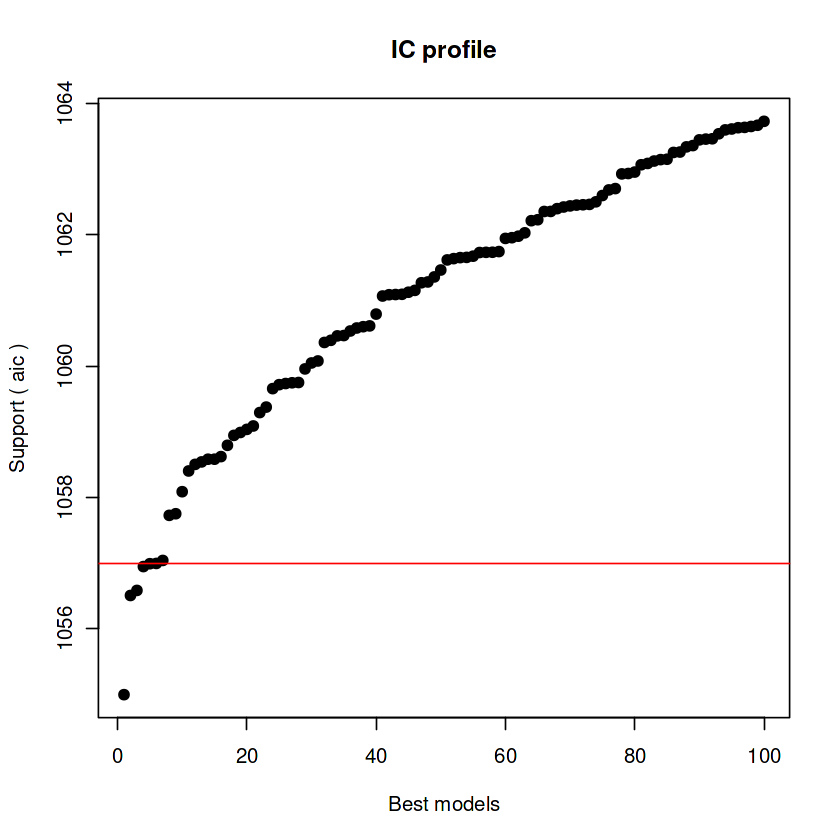


After 12550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.96347117777



After 12600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.96347117777


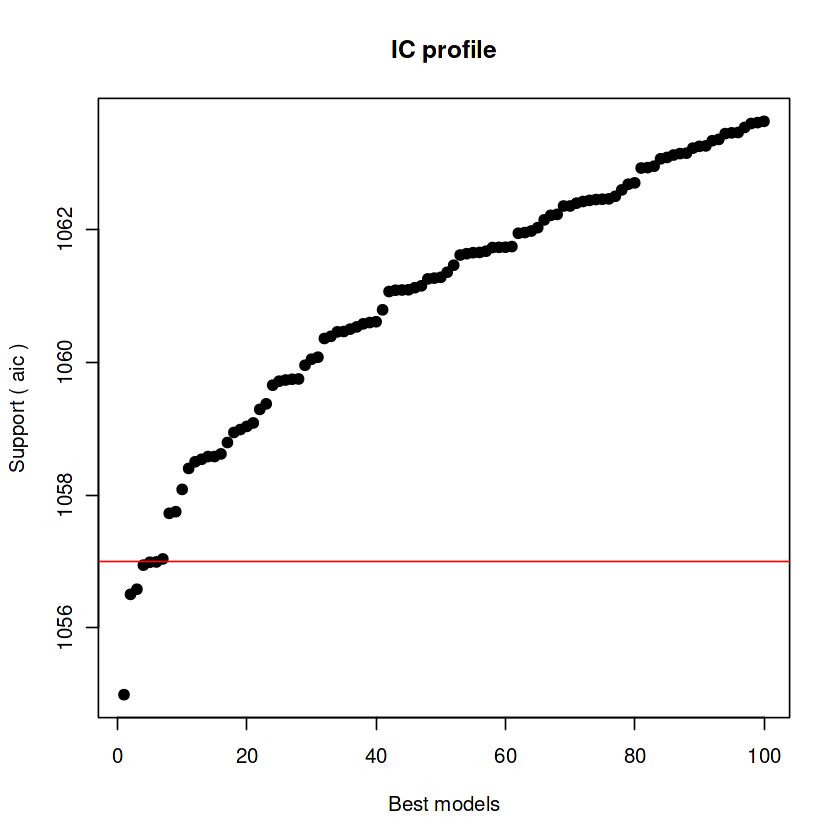


After 12650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.96347117777



After 12700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 12750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788


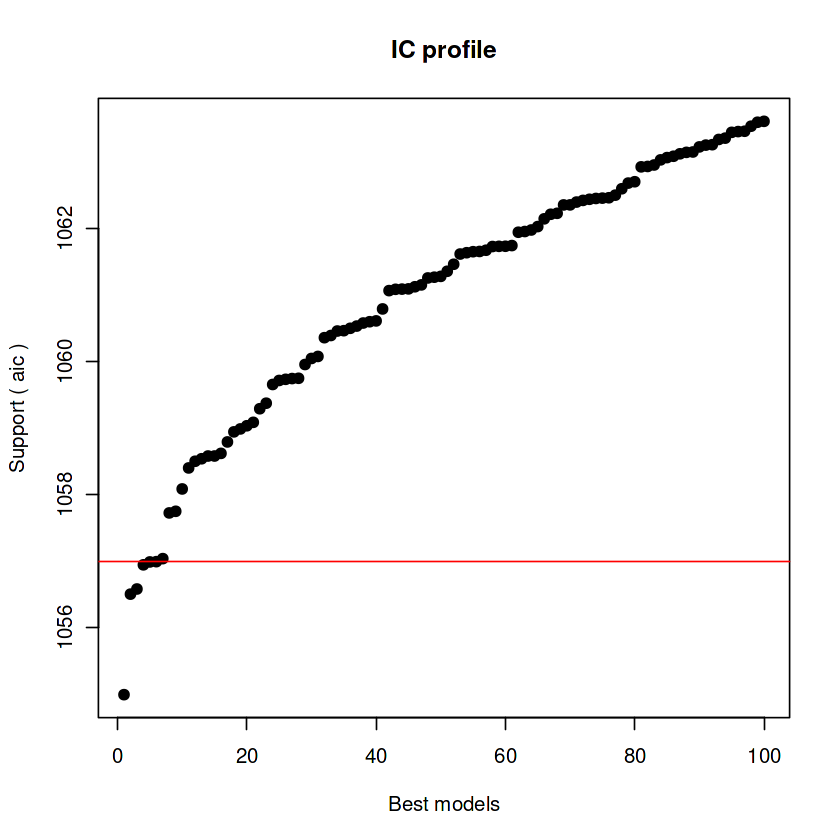


After 12800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 12850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 12900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 12950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 13950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 14950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 15950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.9481901788



After 16000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.87254382554



After 16050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.85156418987


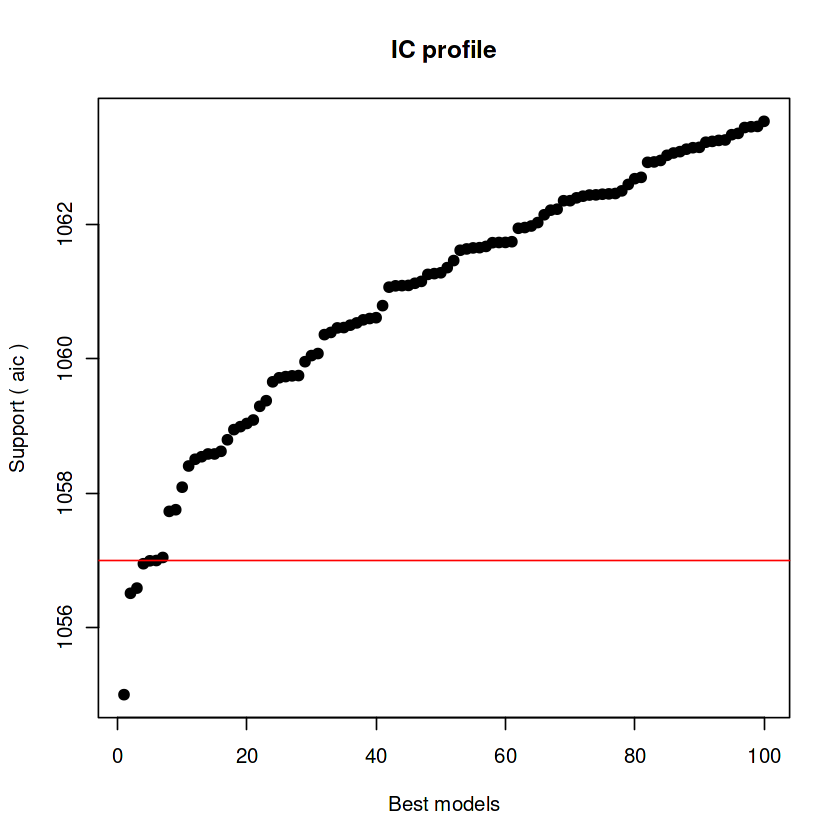


After 16100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.85156418987


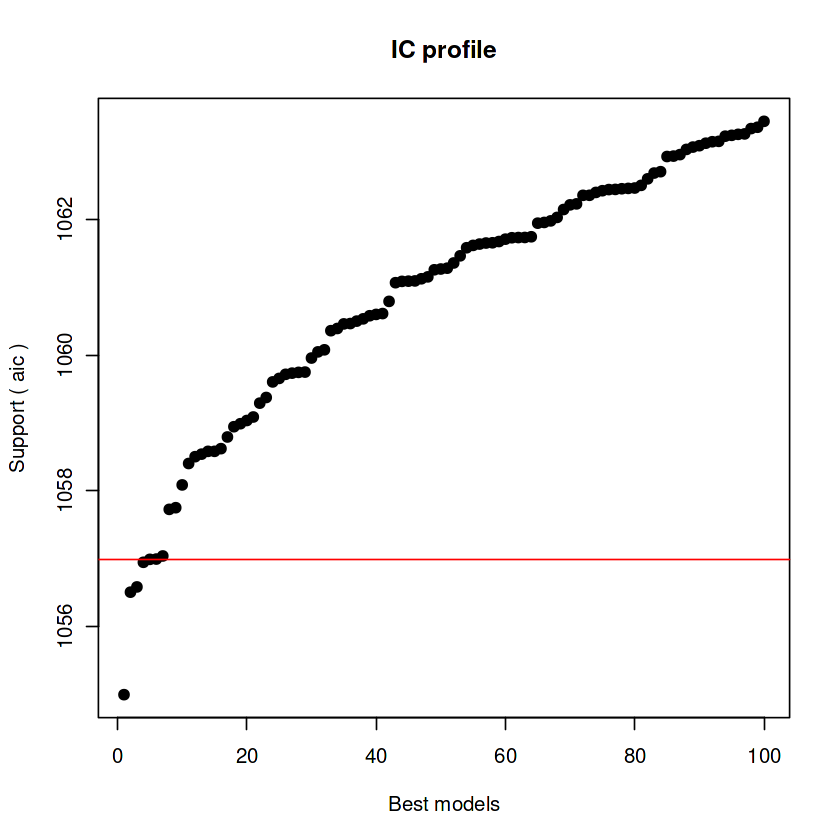


After 16150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.6935332938



After 16200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.68972179605


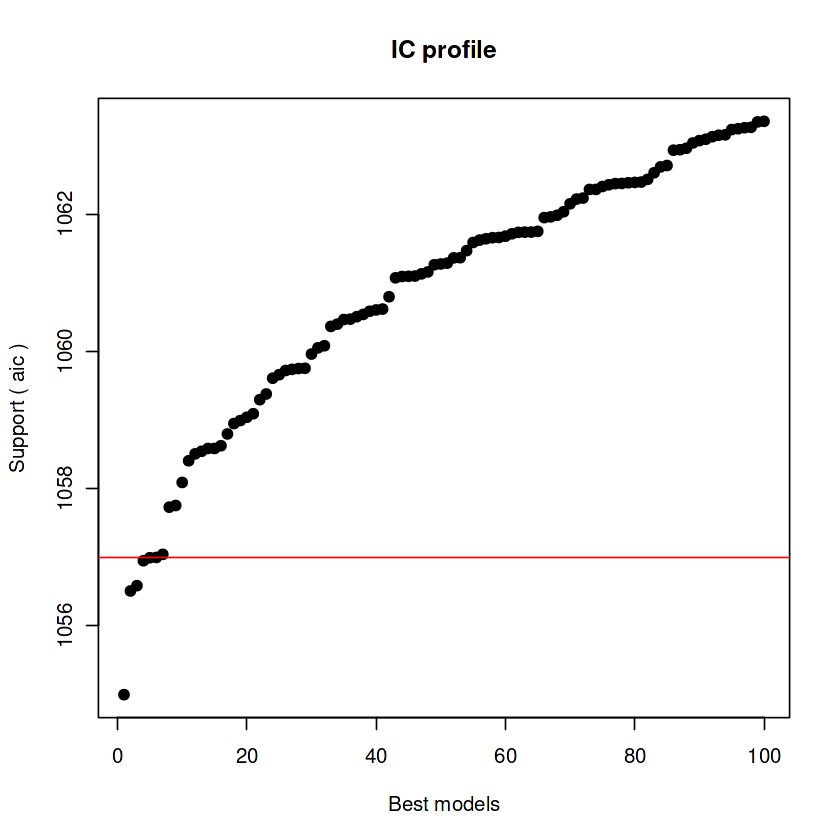


After 16250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.67383852648


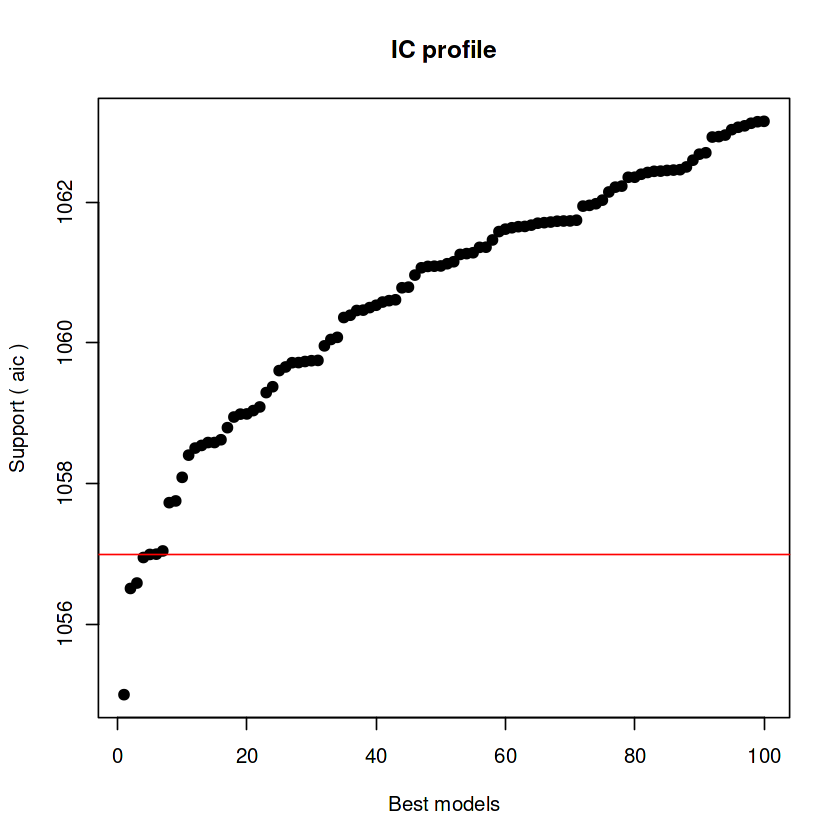


After 16300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.67383852648


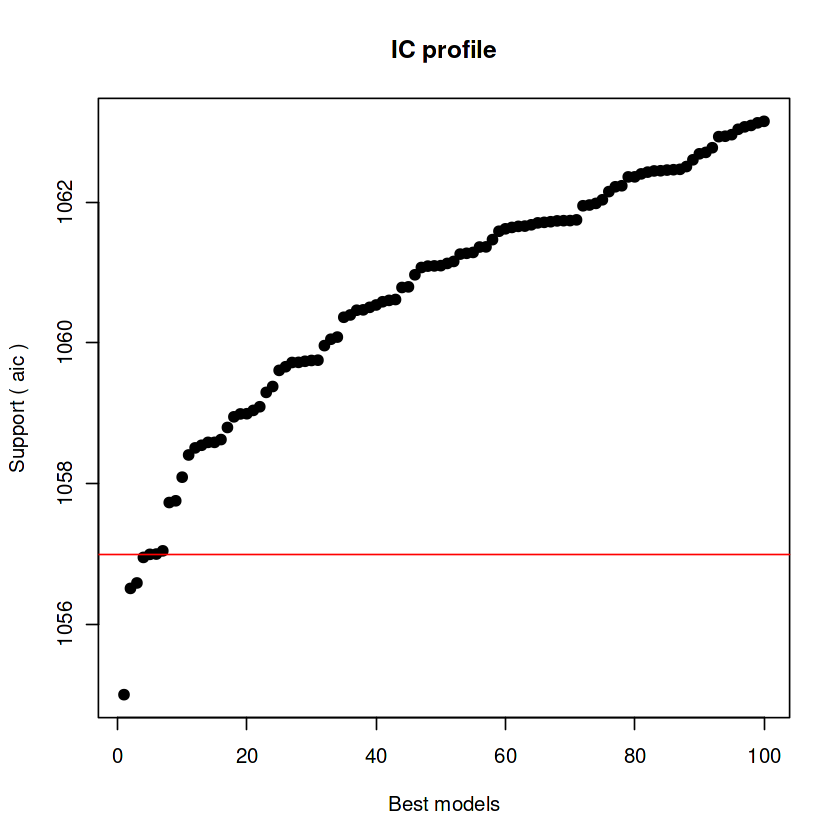


After 16350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.67383852648



After 16400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.63677040512



After 16450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.63398142641


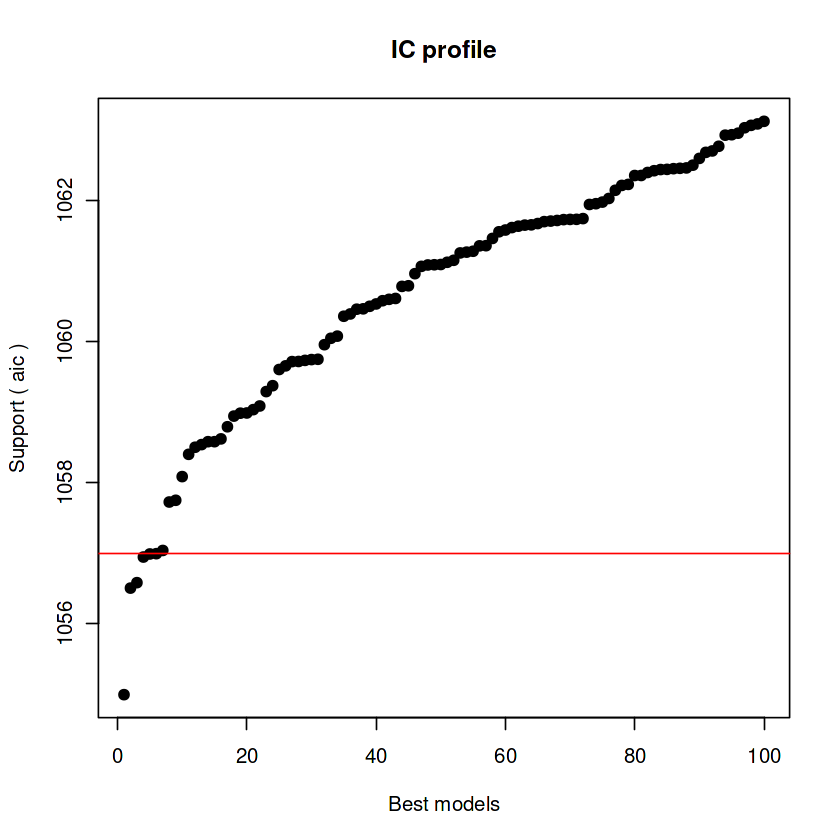


After 16500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.63398142641


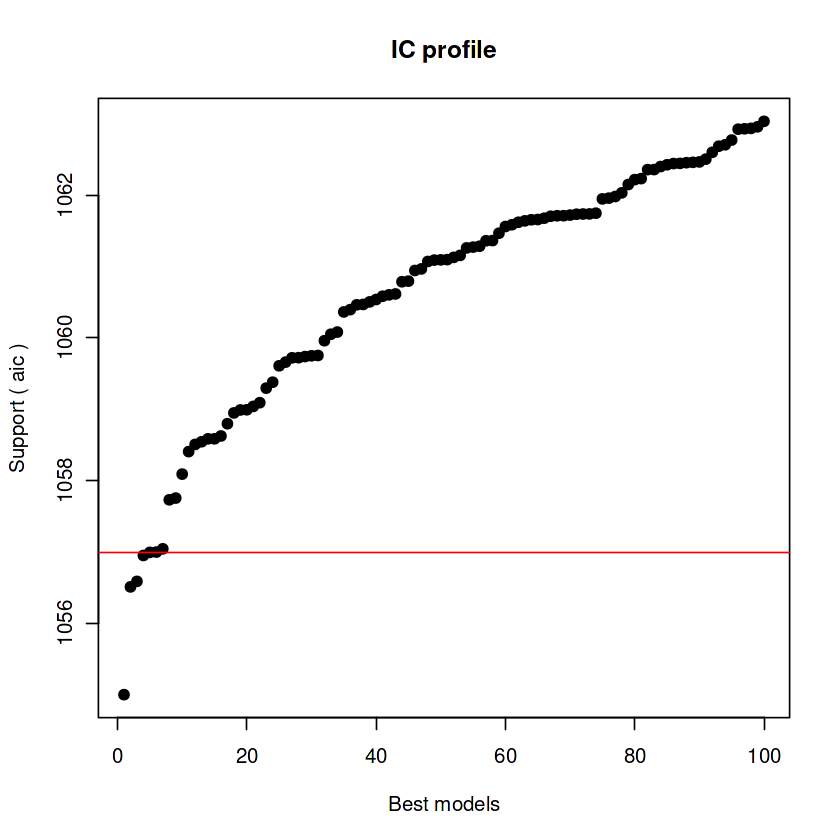


After 16550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.39845208216



After 16600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.37235016036


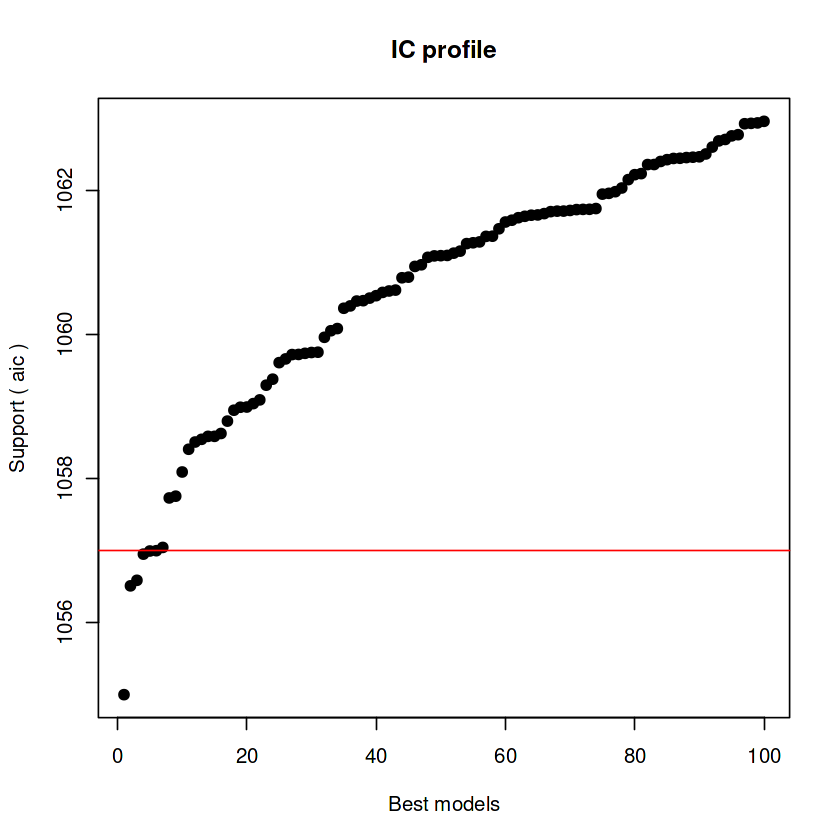


After 16650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.21026083694


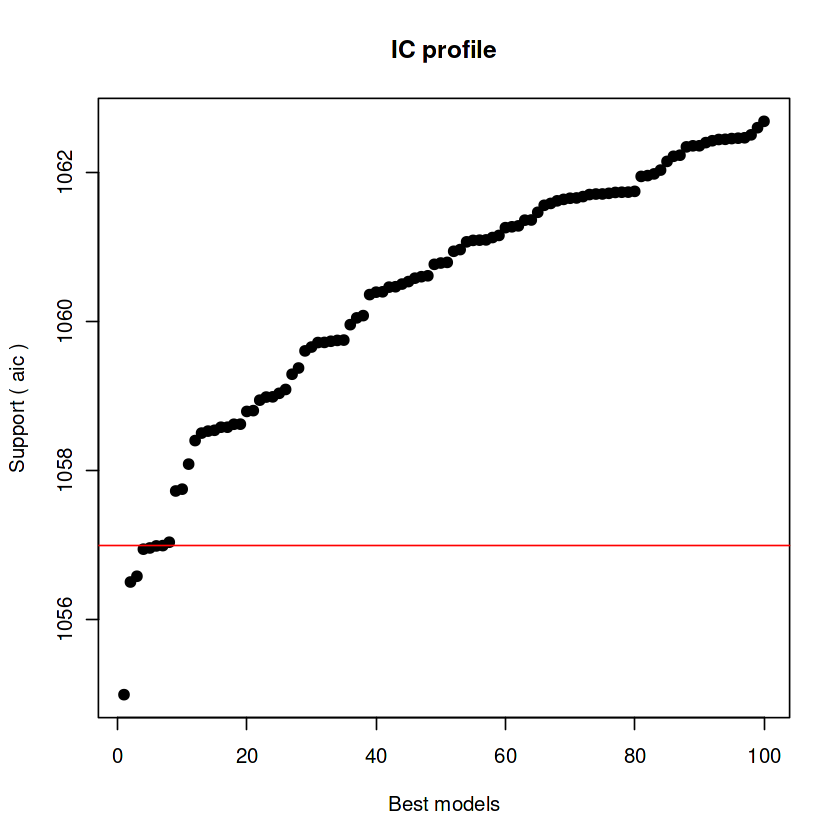


After 16700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.04603154067


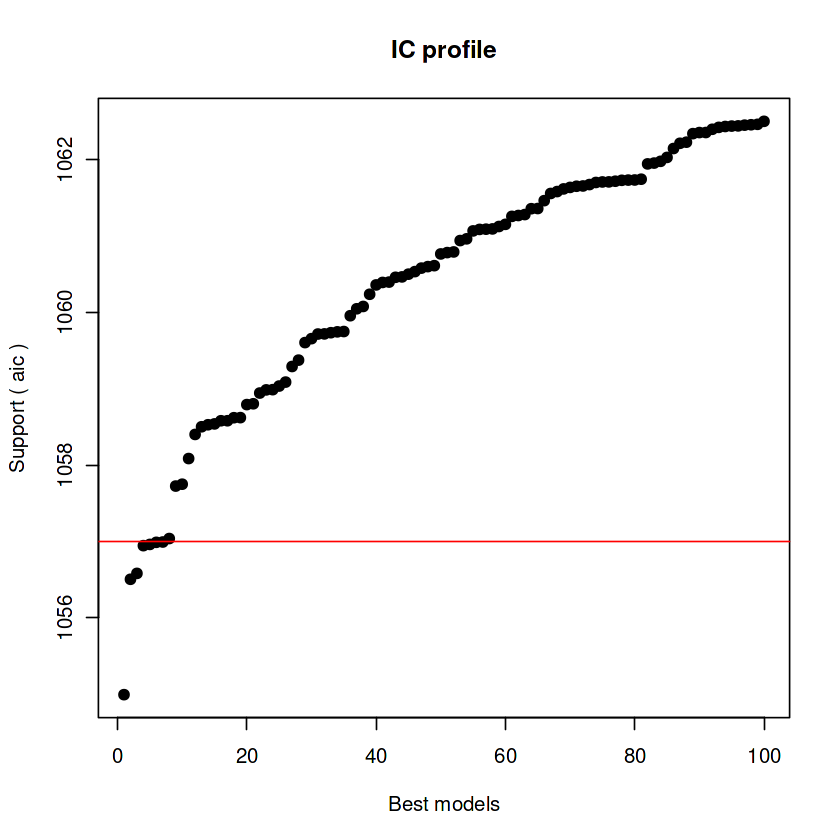


After 16750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1060.04603154067


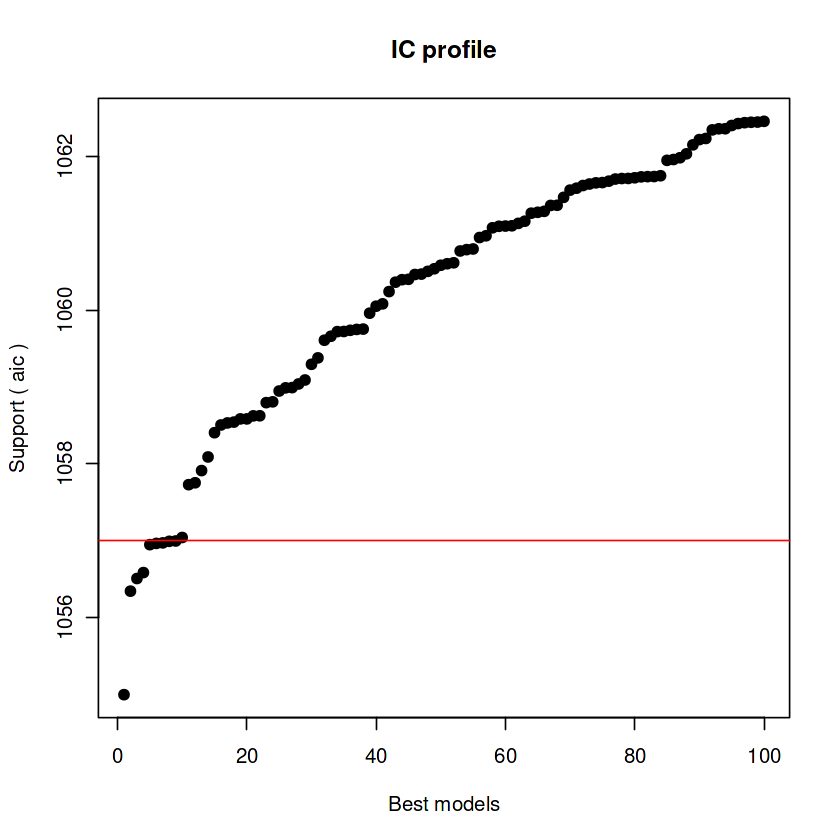


After 16800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.97735291004



After 16850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.96000492598


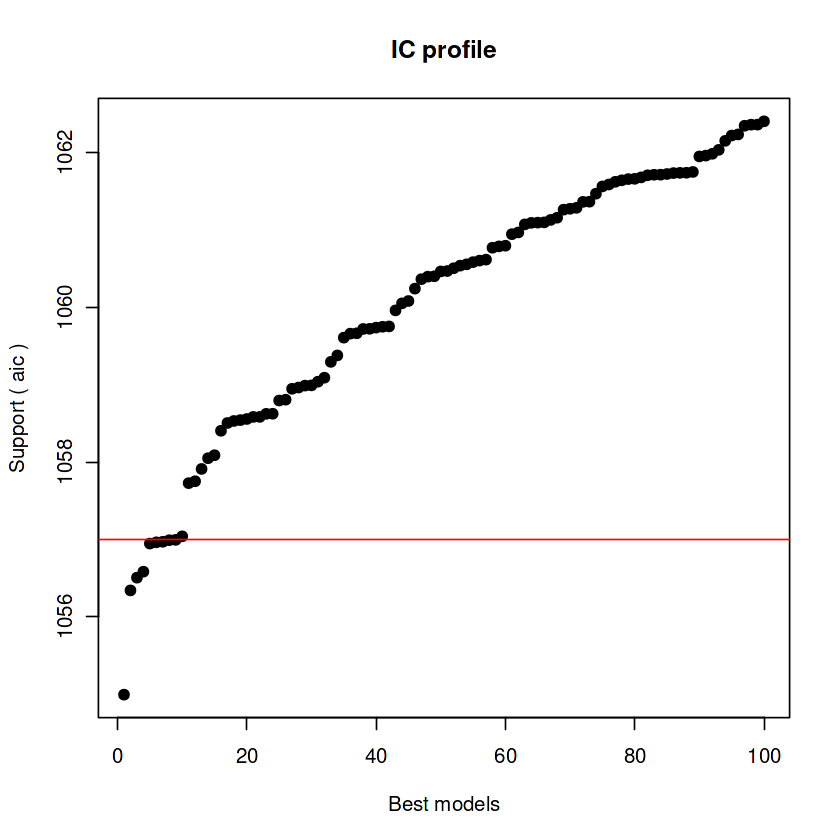


After 16900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.96000492598


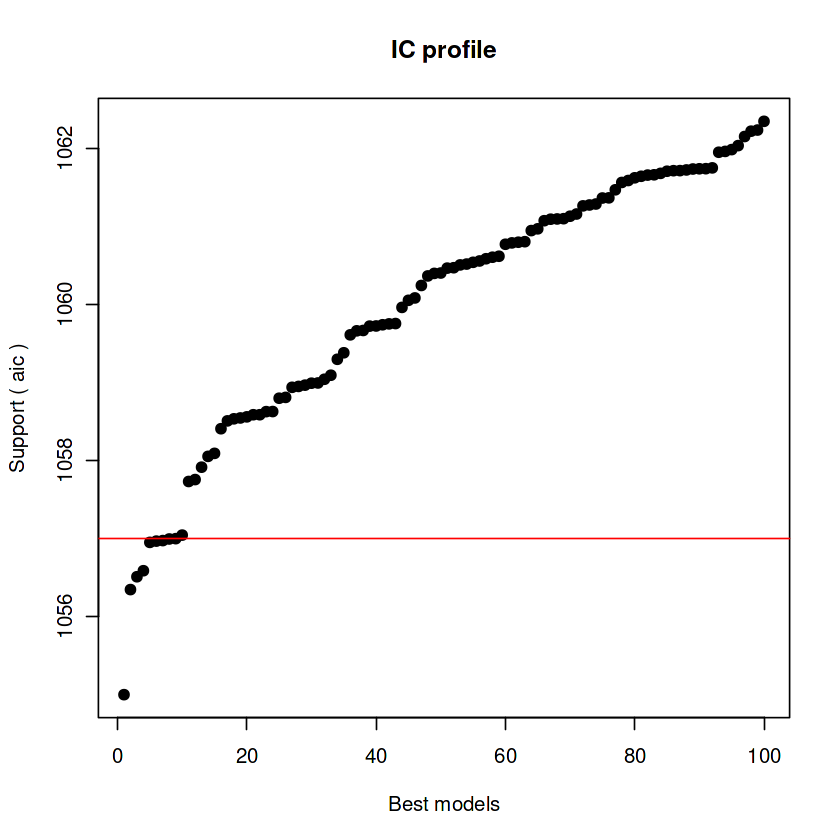


After 16950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458


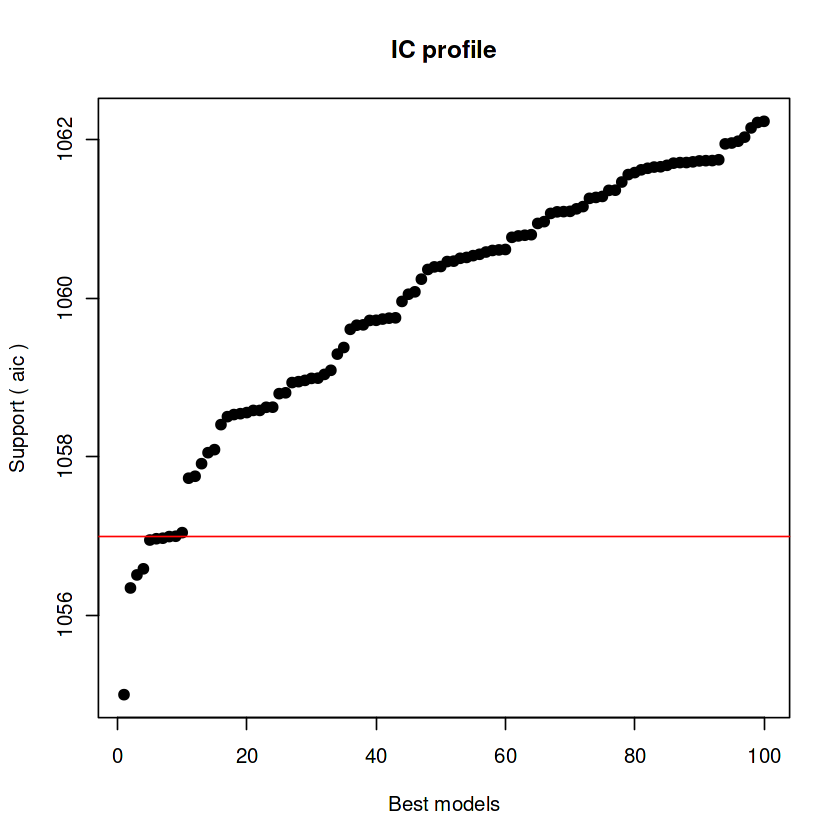


After 17050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 17950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 18950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 19950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 20000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 20050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.81869343458



After 20100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.80045750936



After 20150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.80045750936


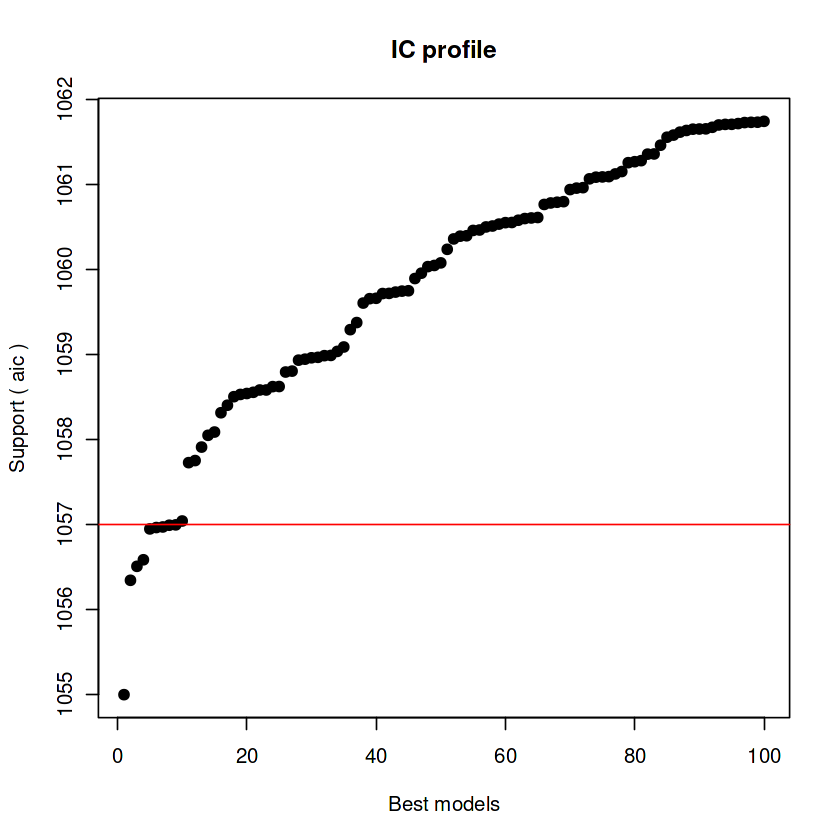


After 20200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.7842877282



After 20250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP
Crit= 1054.99528351228
Mean crit= 1059.70977336652


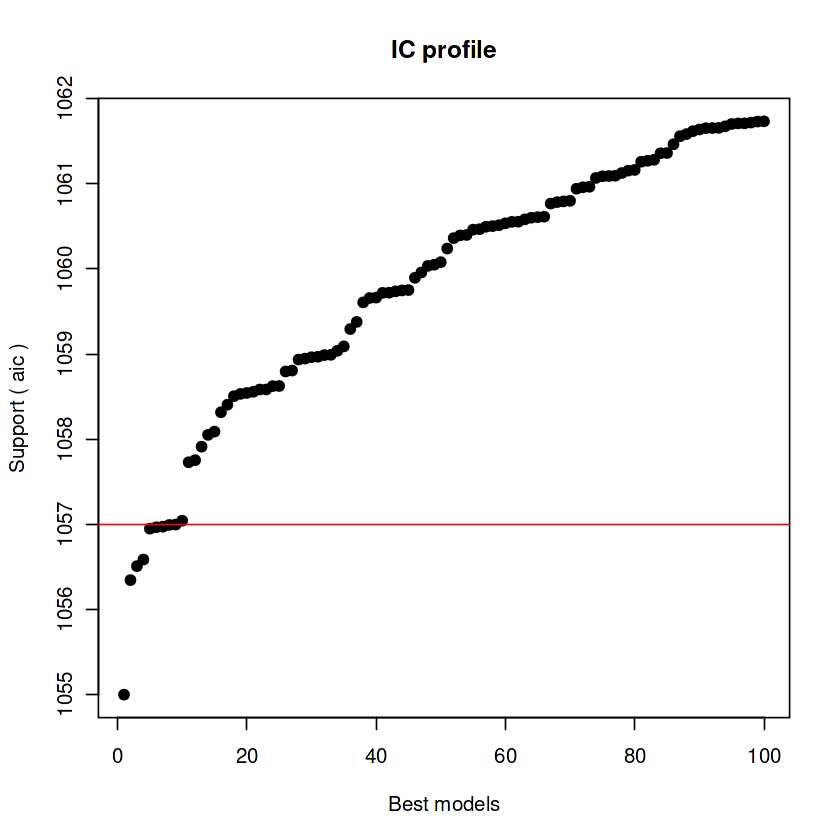


After 20300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1054.69422263743
Mean crit= 1059.56179515643


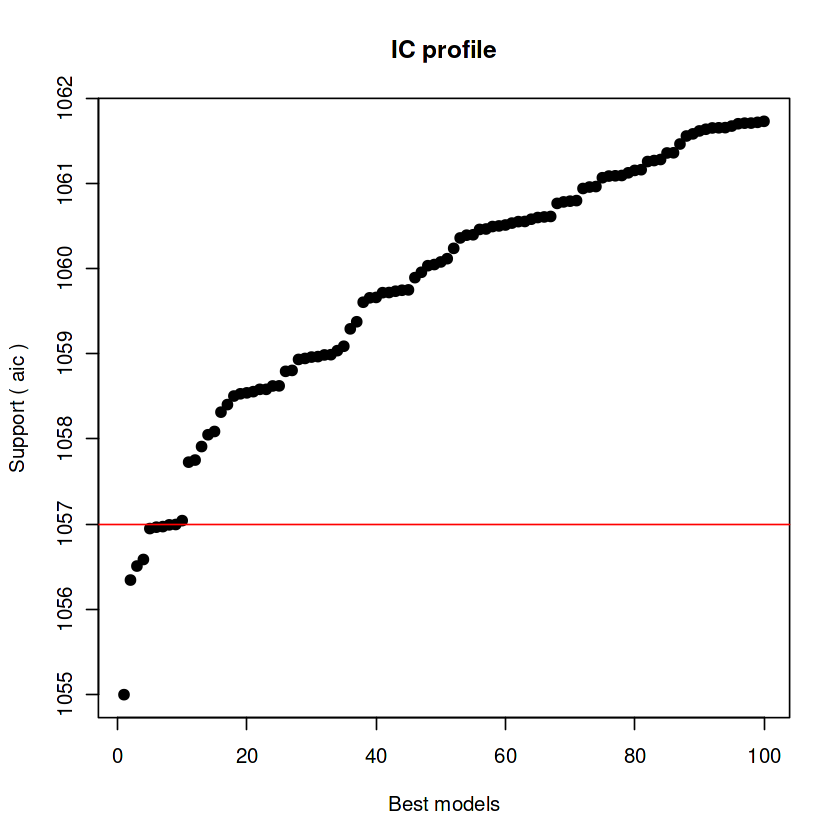


After 20350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1054.69422263743
Mean crit= 1059.43124664304


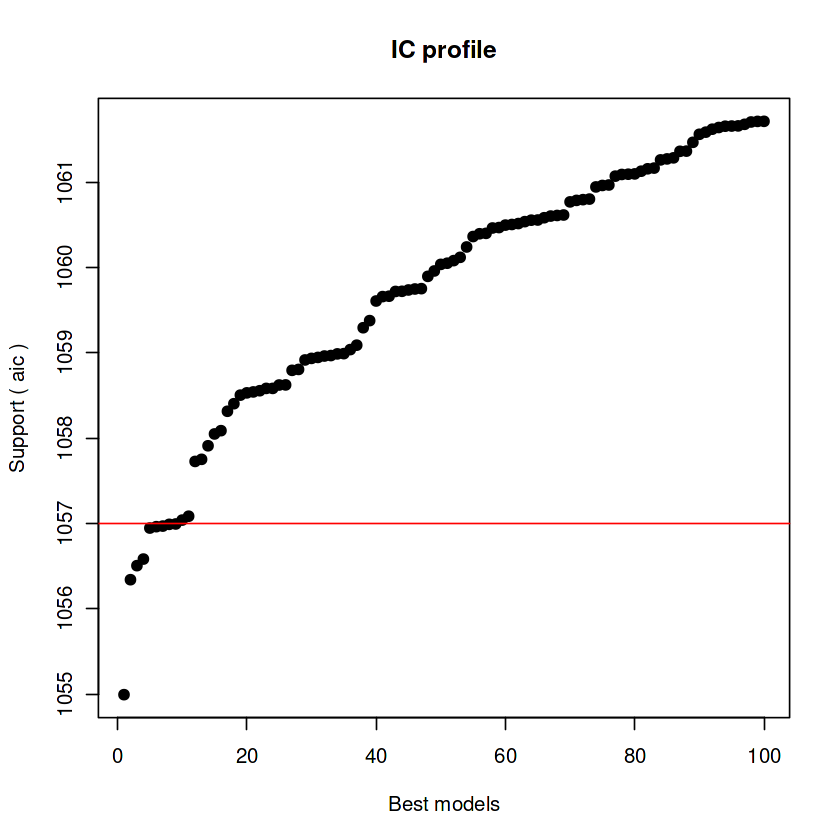


After 20400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.74749118133
Mean crit= 1059.20622698045


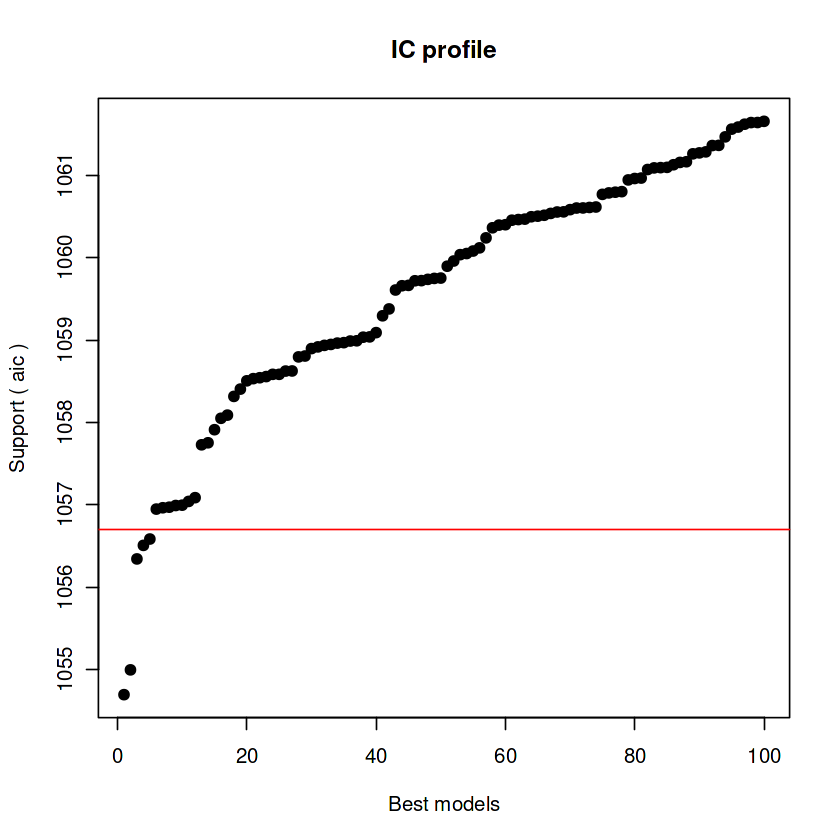


After 20450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.74749118133
Mean crit= 1059.20622698045


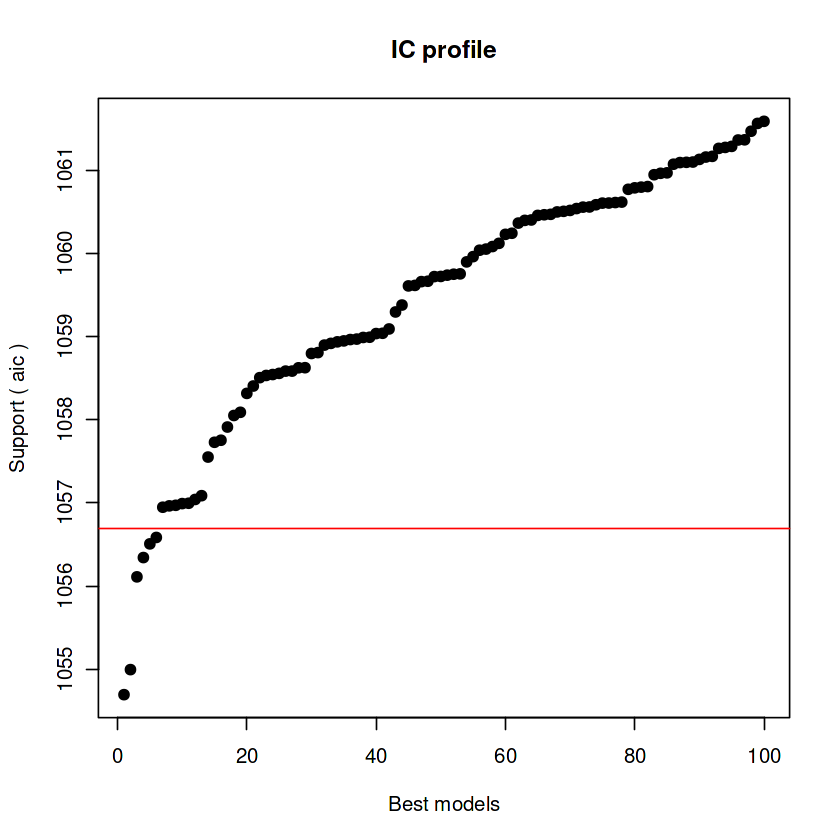


After 20500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.74749118133
Mean crit= 1059.17990567896



After 20550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.74749118133
Mean crit= 1059.17422581629


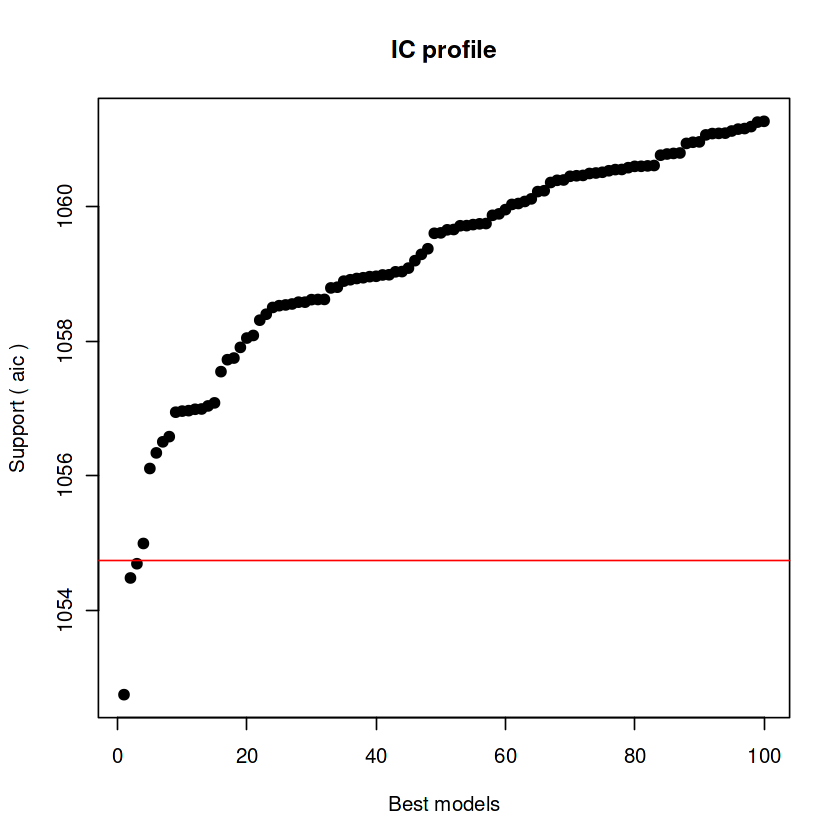


After 20600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.74749118133
Mean crit= 1059.09526081907


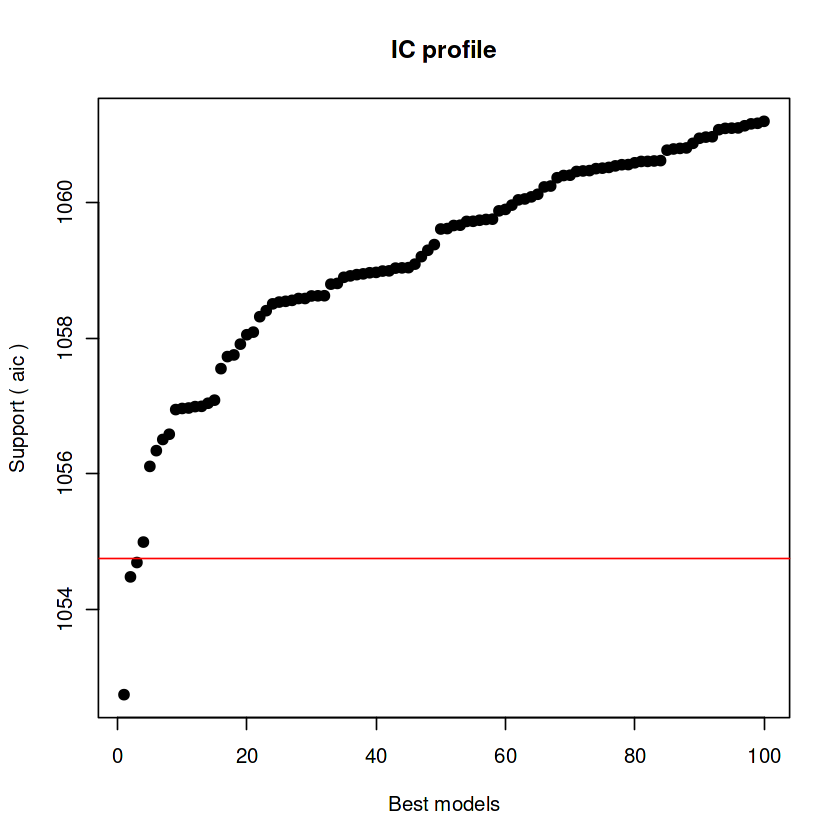


After 20650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.74749118133
Mean crit= 1059.00900317624


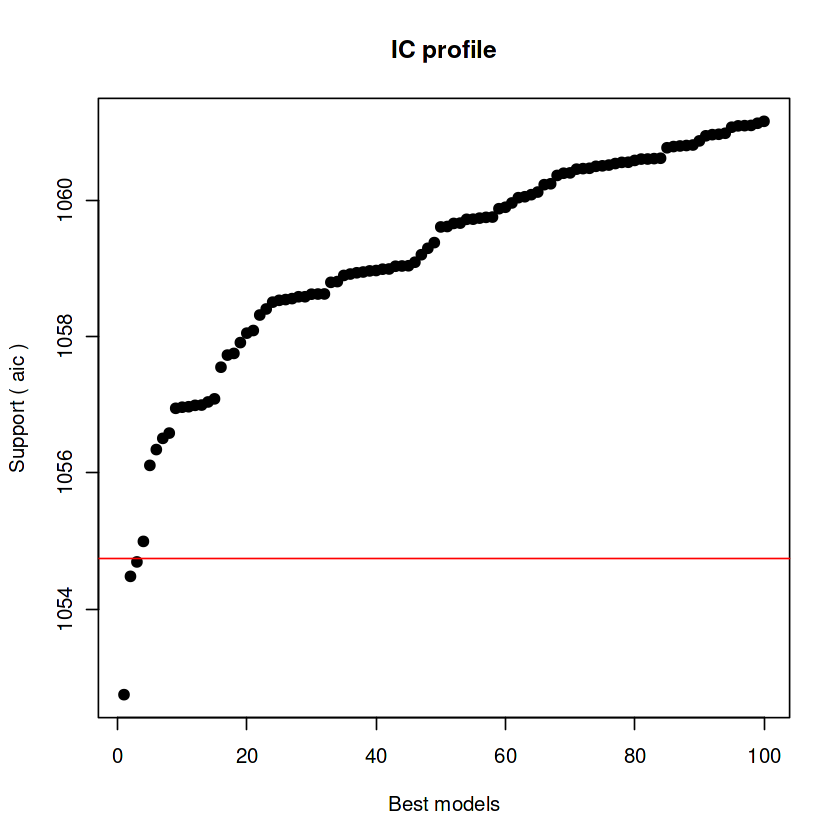


After 20700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.74749118133
Mean crit= 1058.94784971901


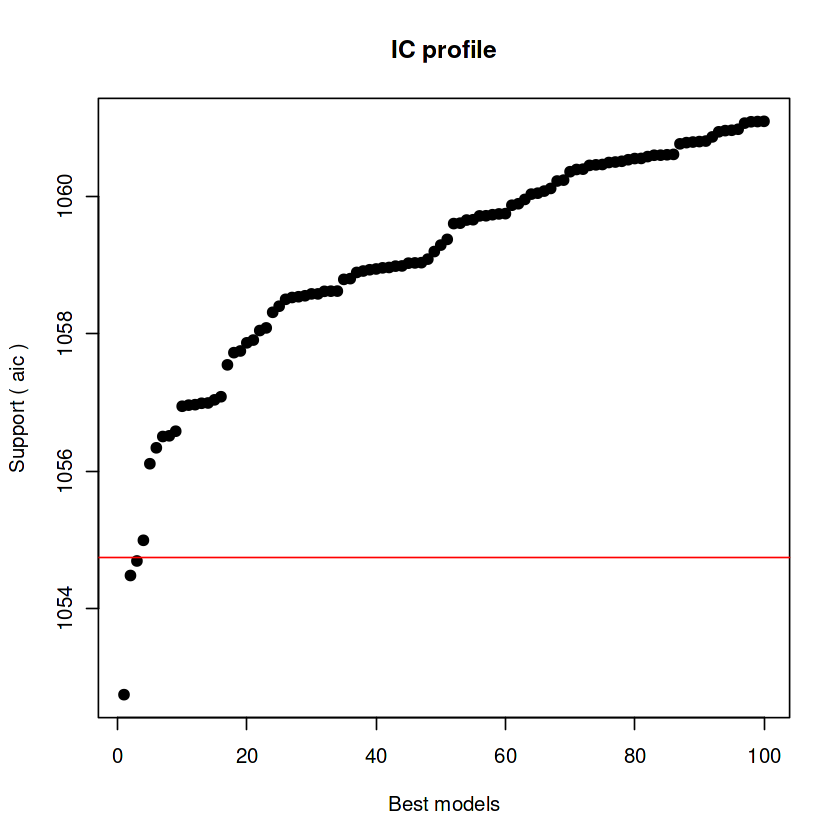


After 20750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.74749118133
Mean crit= 1058.94784971901


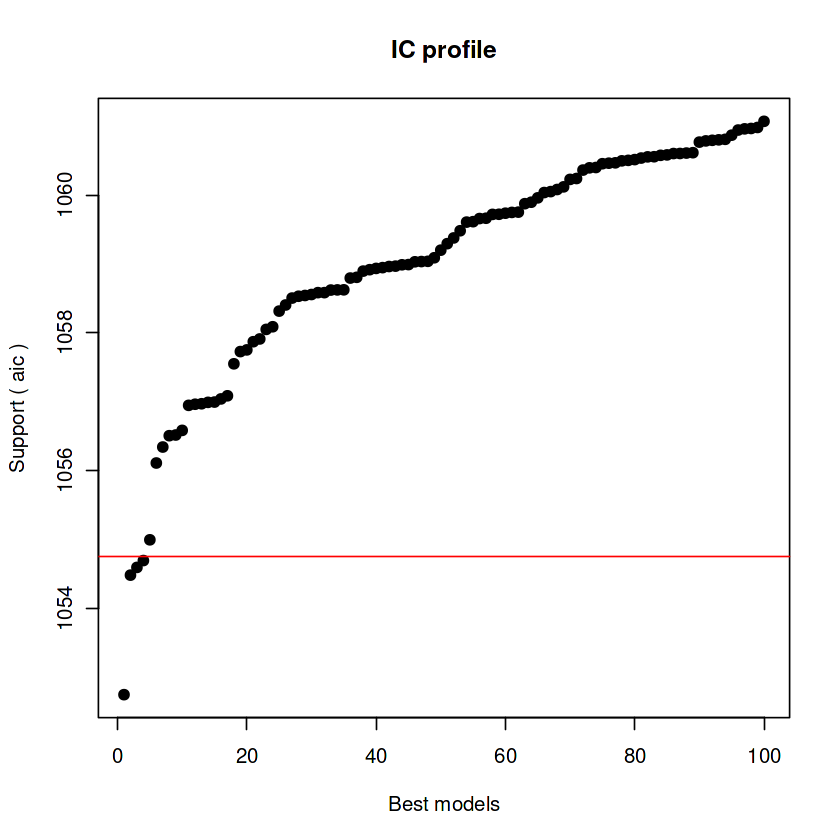


After 20800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.74749118133
Mean crit= 1058.84472099476



After 20850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.74749118133
Mean crit= 1058.7383622975


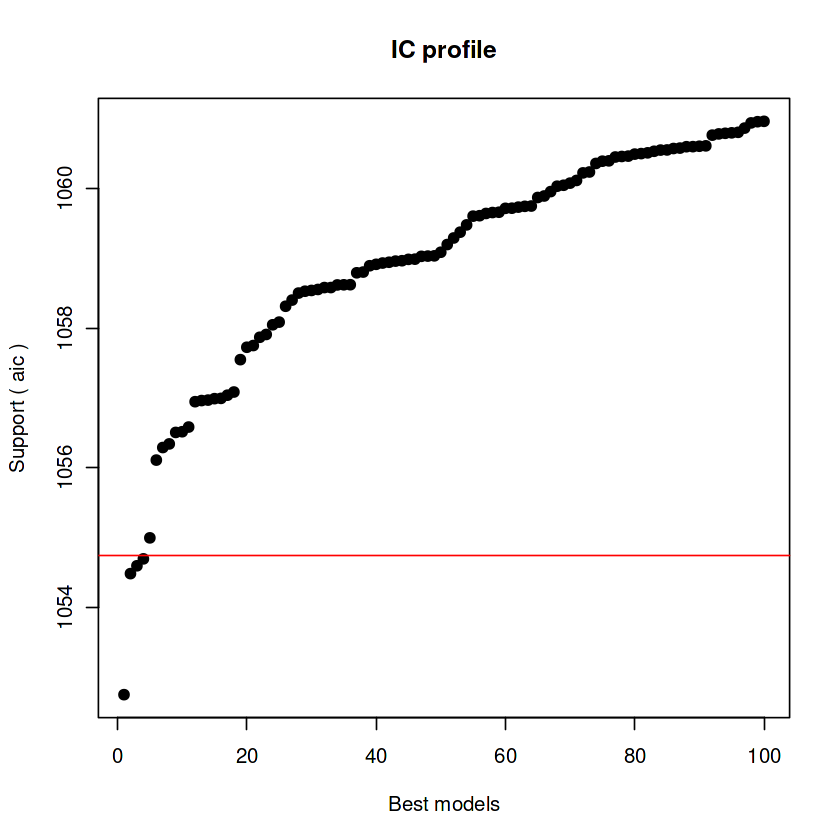


After 20900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.53286965712


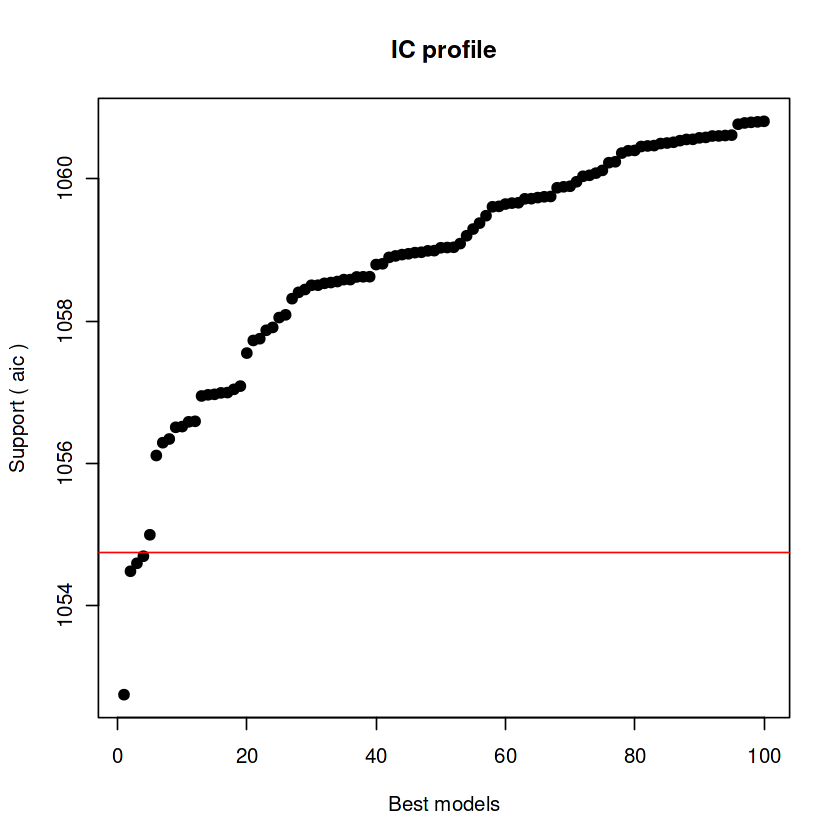


After 20950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.43664332944


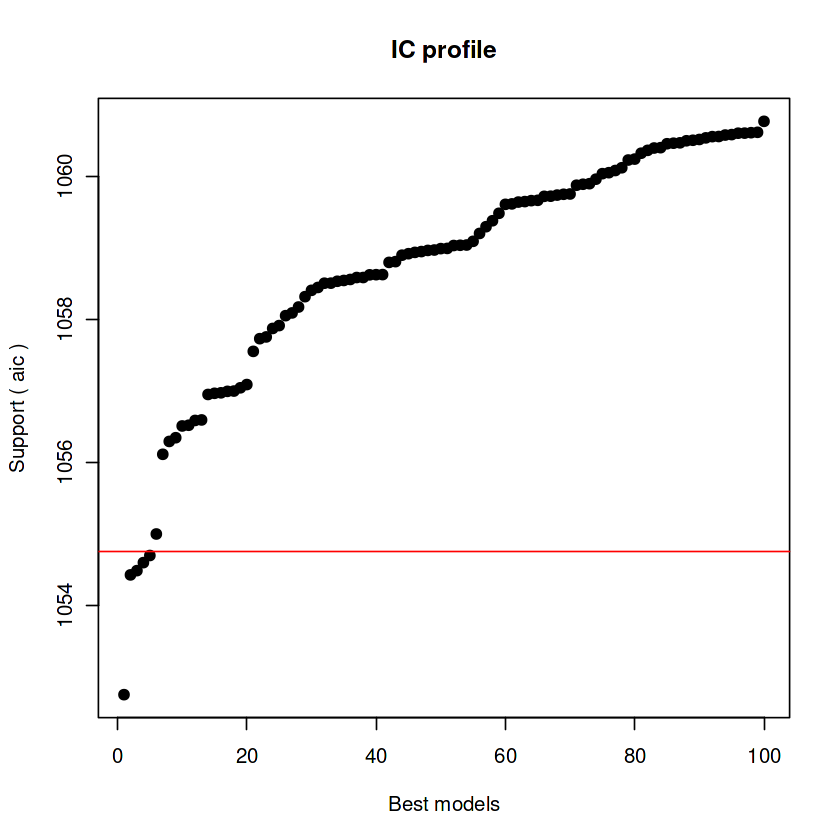


After 21000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.43664332944


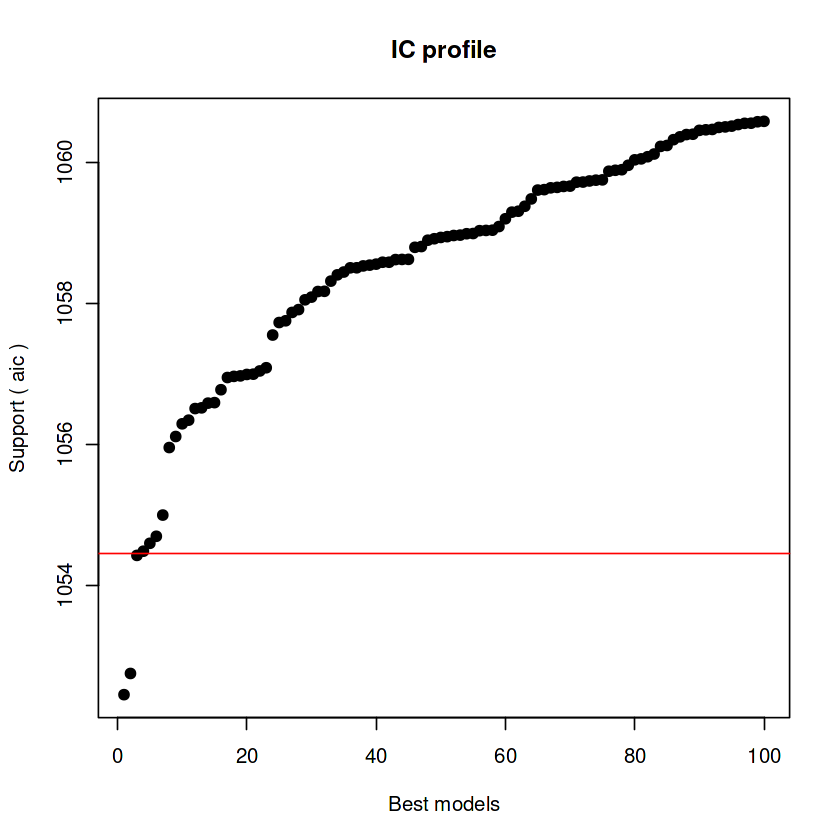


After 21050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.41542846832



After 21100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.36886570393


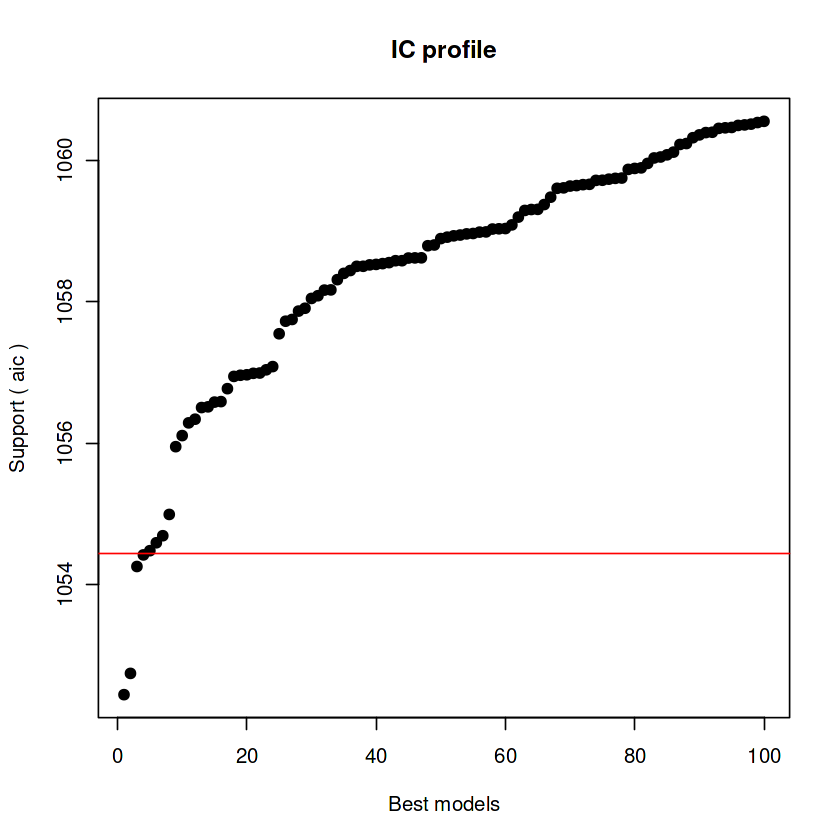


After 21150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.32436384459


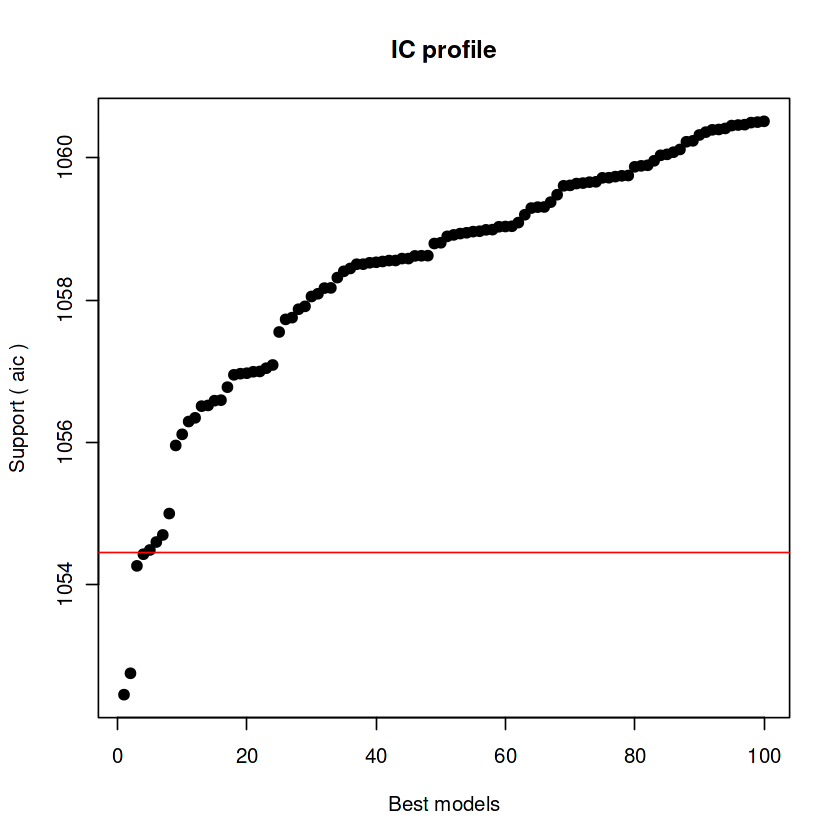


After 21200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309


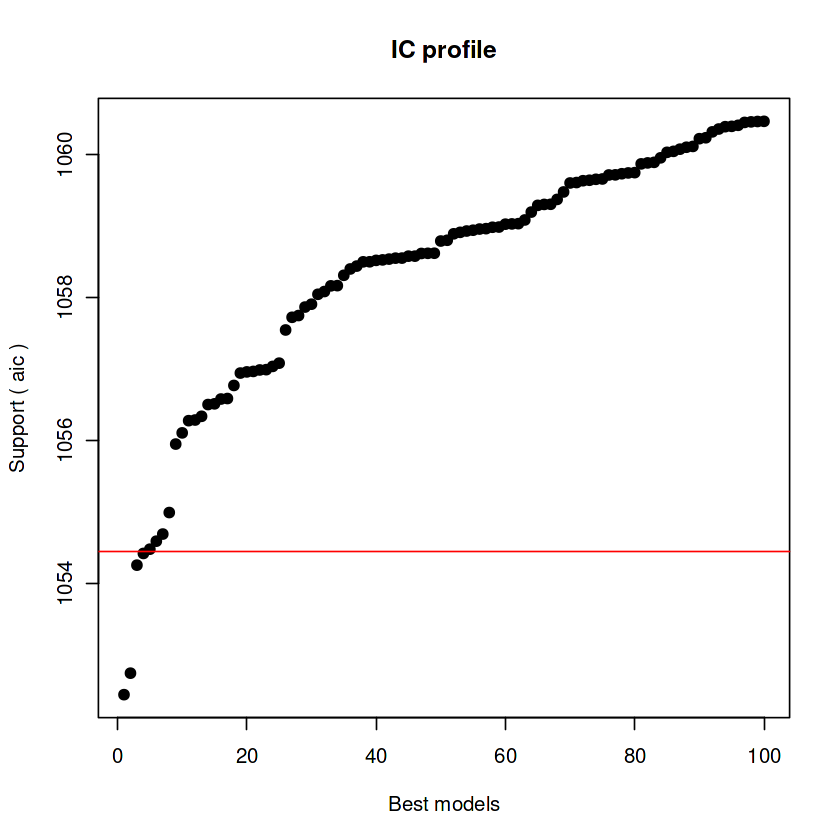


After 21250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309


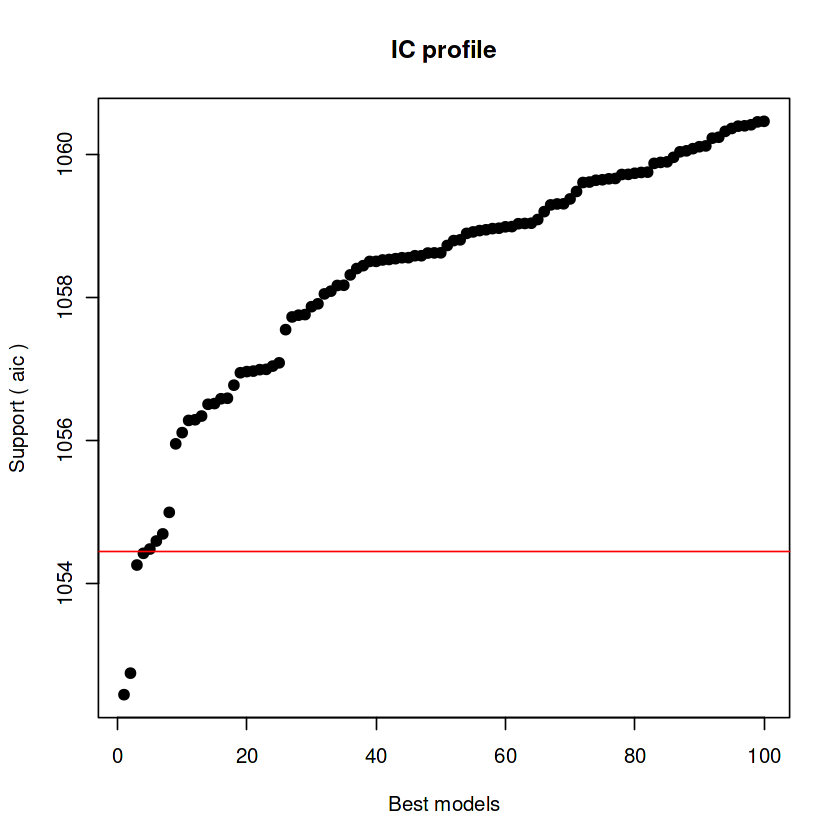


After 21300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 21950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 22950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 23950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 24000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.21680991309



After 24050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.20952434364



After 24100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.20952434364


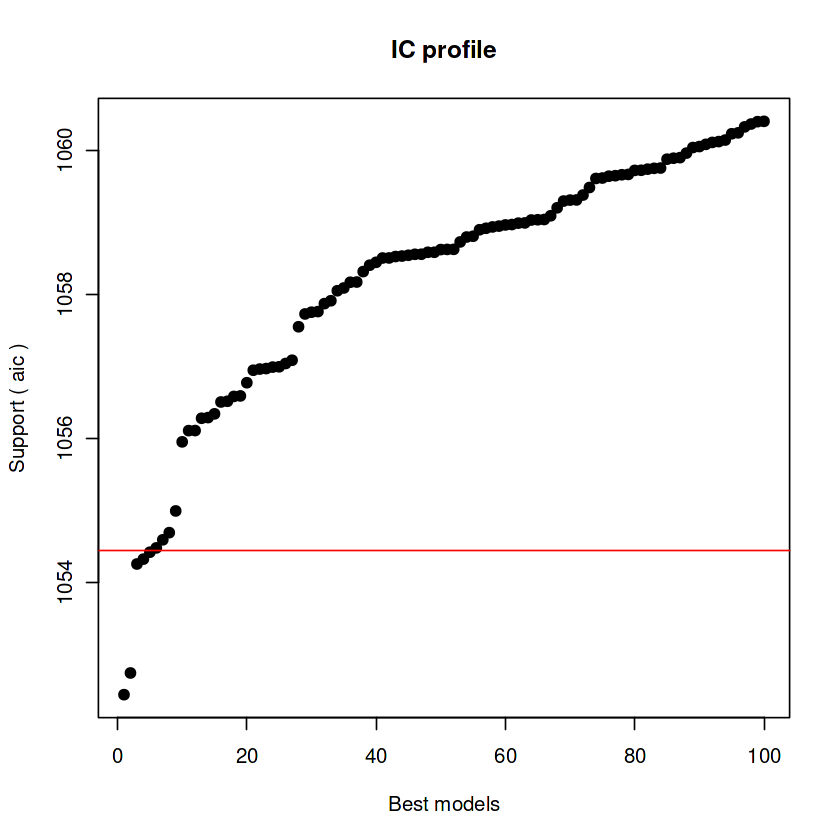


After 24150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.20952434364



After 24200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.20952434364



After 24250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.18308099464



After 24300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.14835998933


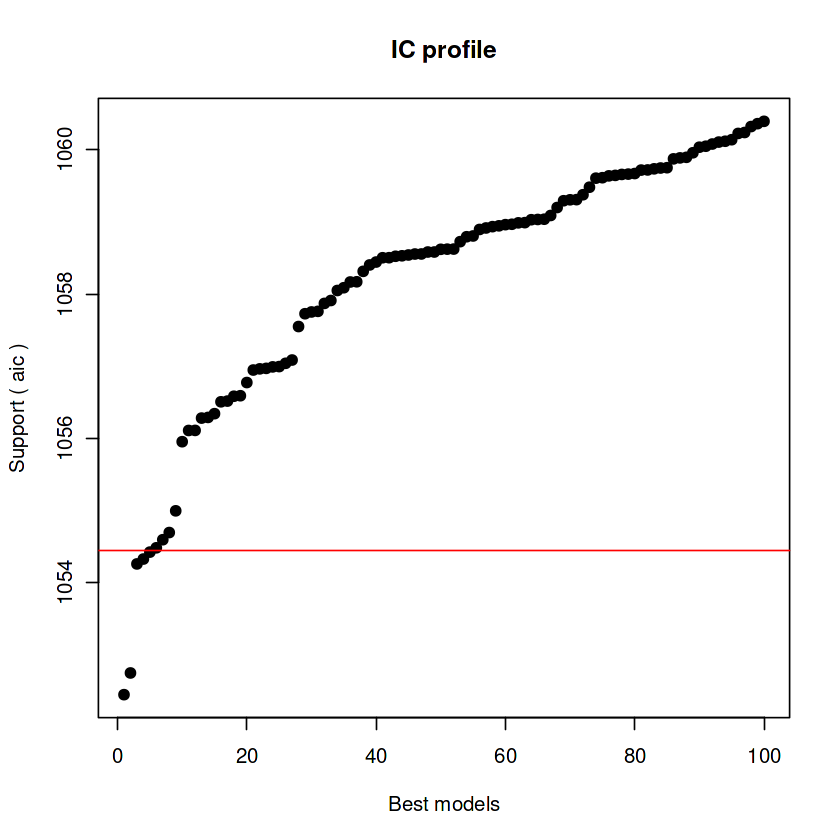


After 24350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.06691308629


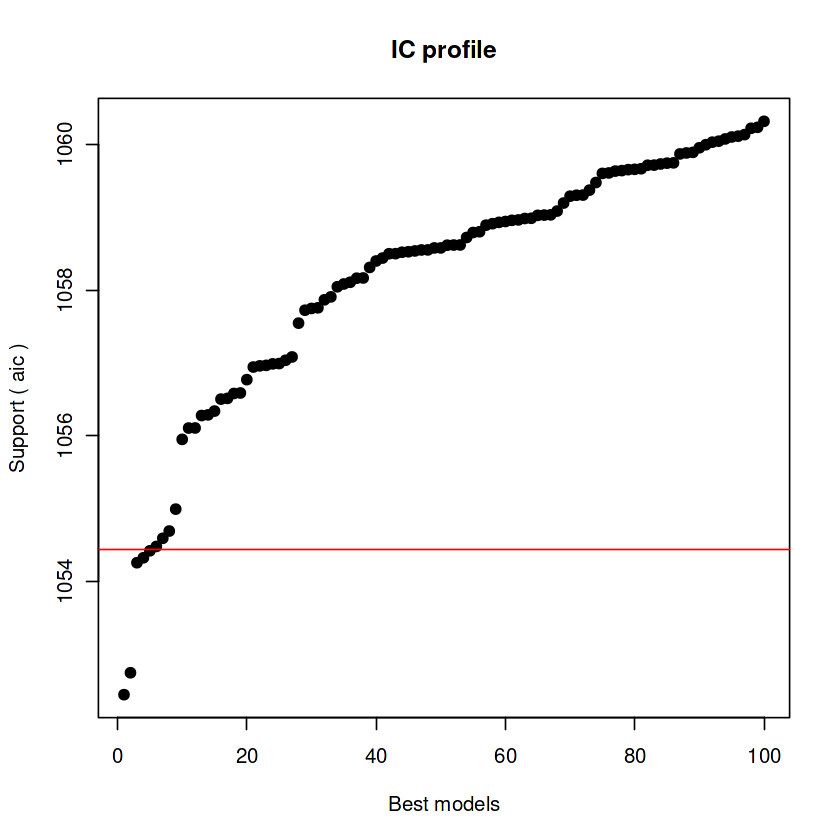


After 24400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1058.00733218216


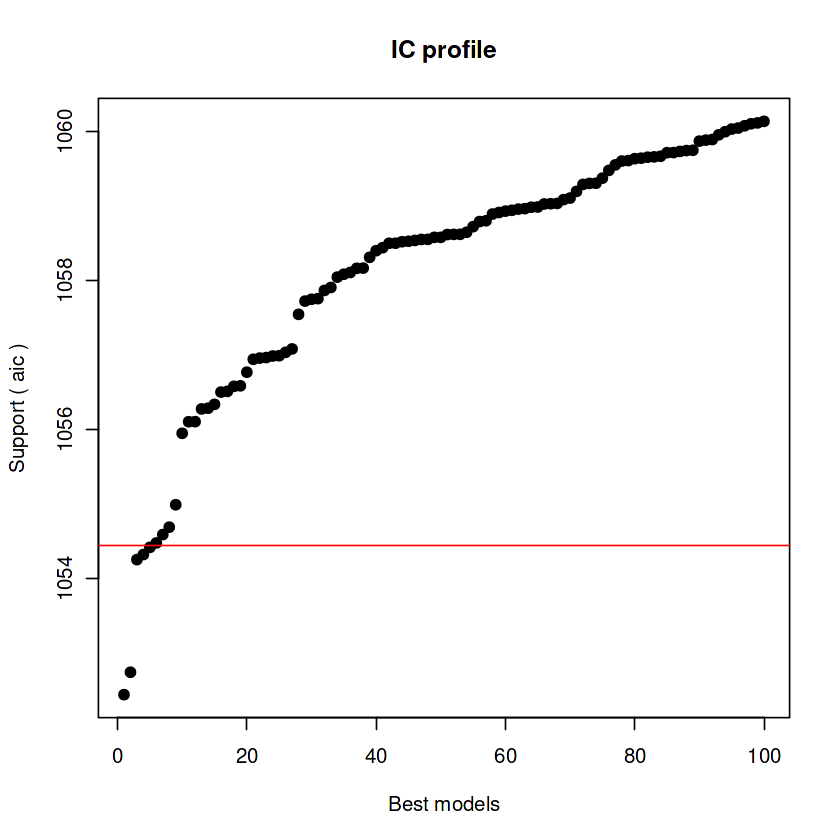


After 24450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1057.99976337634


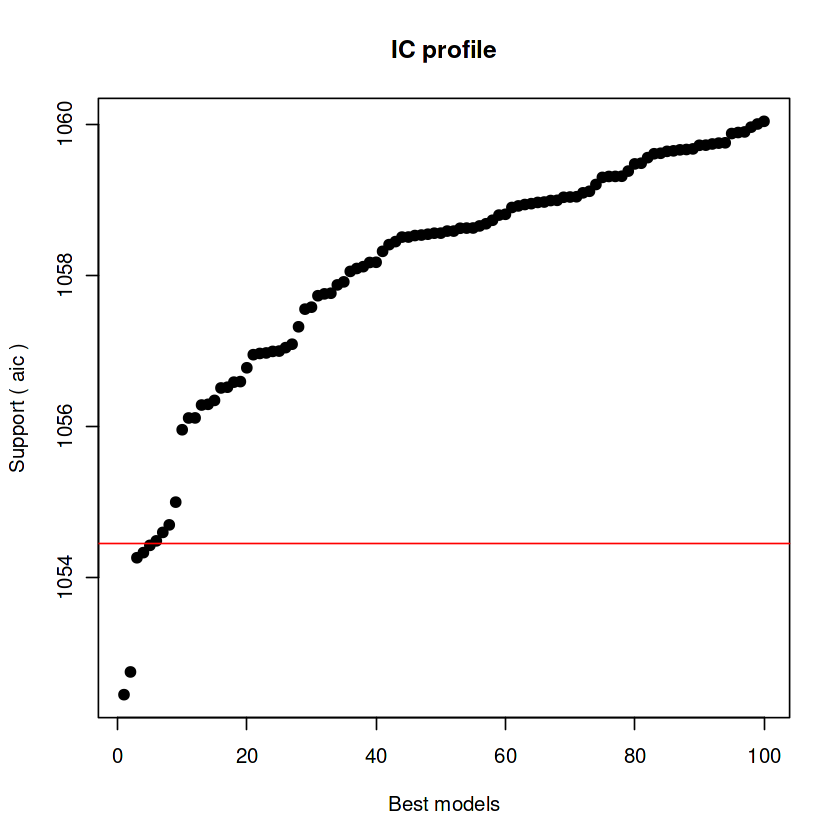


After 24500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years
Crit= 1052.44672418333
Mean crit= 1057.81396899885


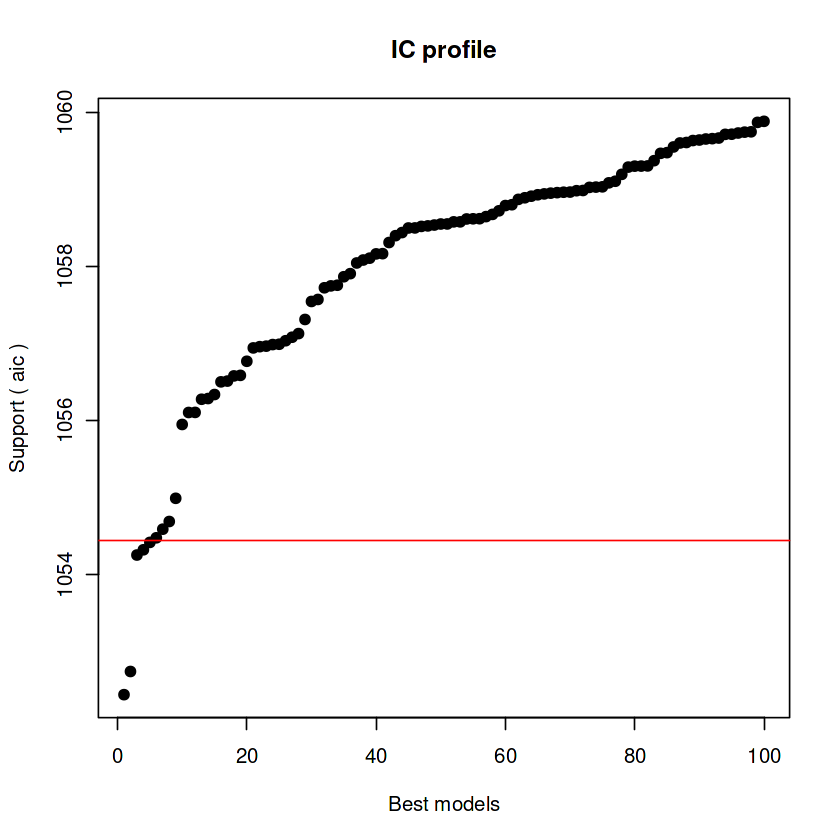


After 24550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1051.57674175663
Mean crit= 1057.60823631697


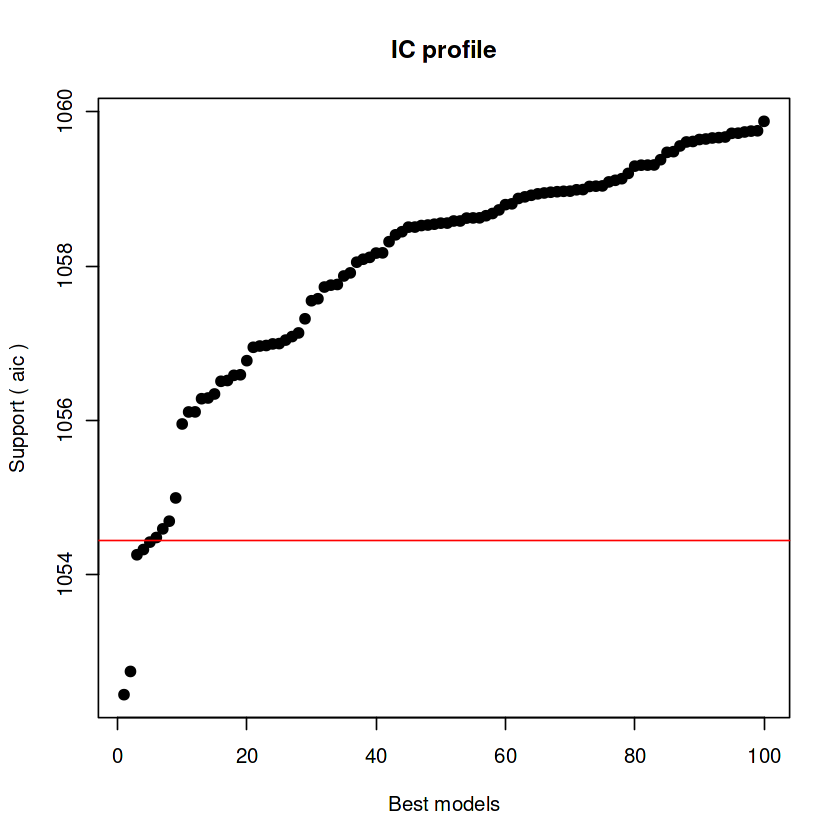


After 24600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1050.16364281741
Mean crit= 1057.24032994455


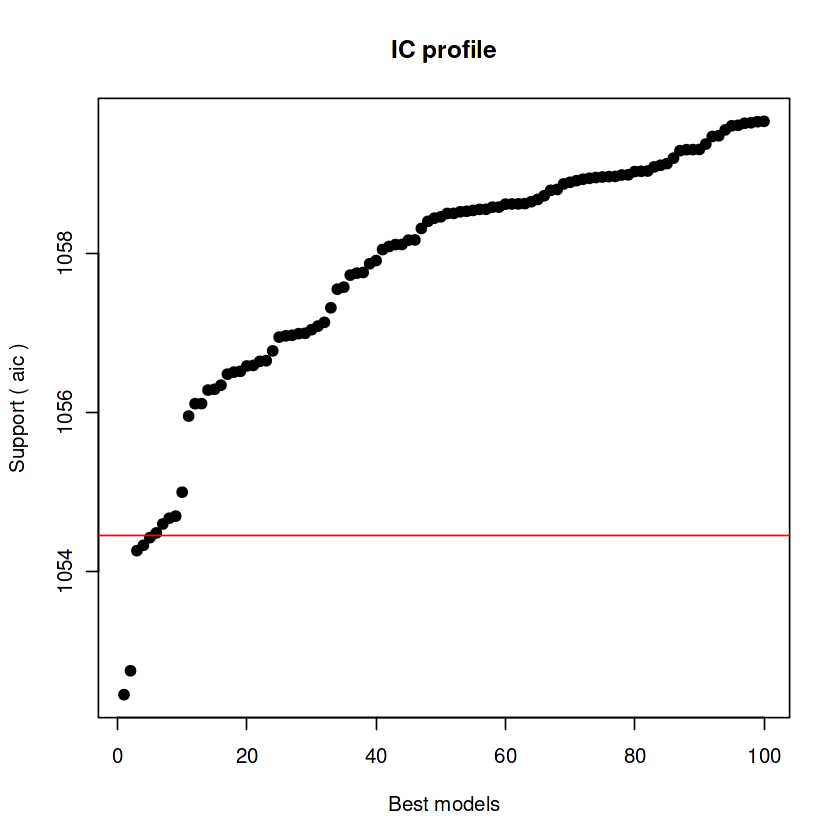


After 24650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1050.16364281741
Mean crit= 1057.08227907853


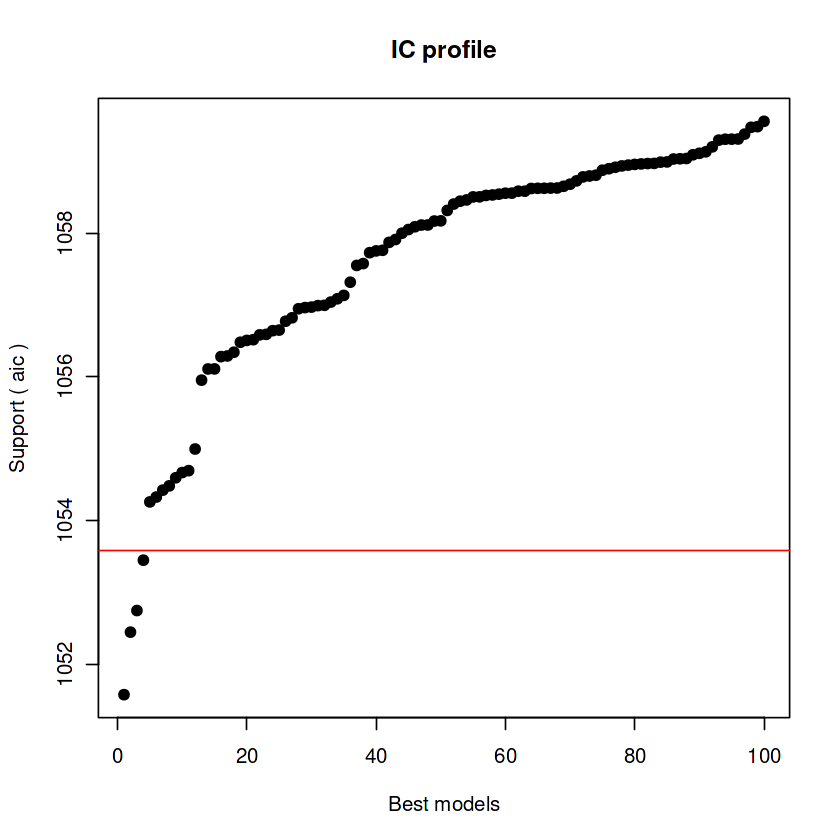


After 24700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1050.16364281741
Mean crit= 1057.08227907853


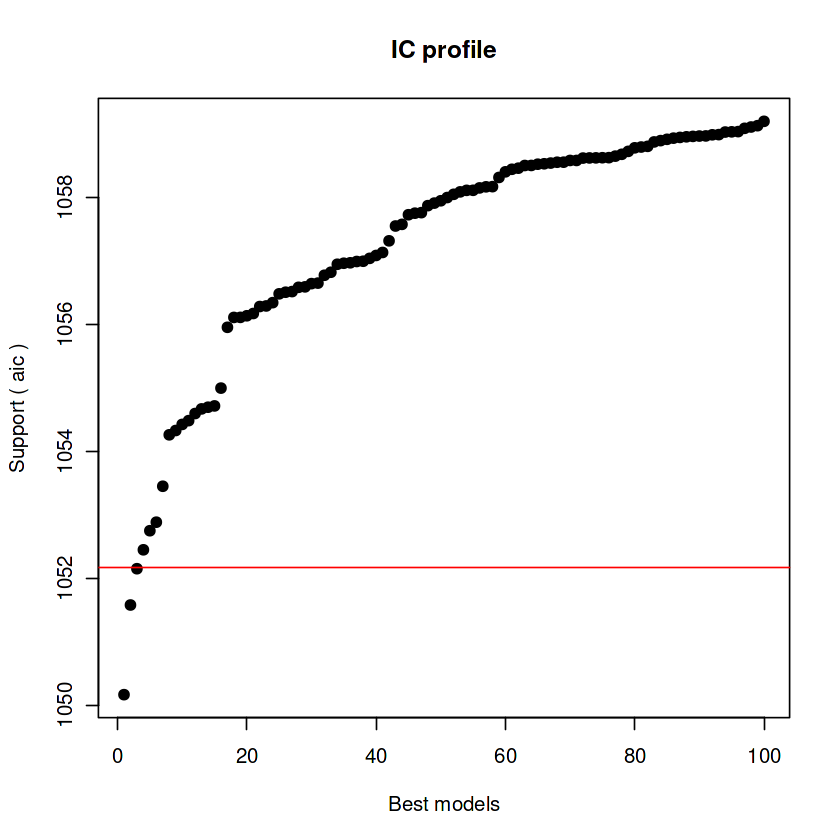


After 24750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1050.16364281741
Mean crit= 1057.0484983652



After 24800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1050.16364281741
Mean crit= 1056.95123355084


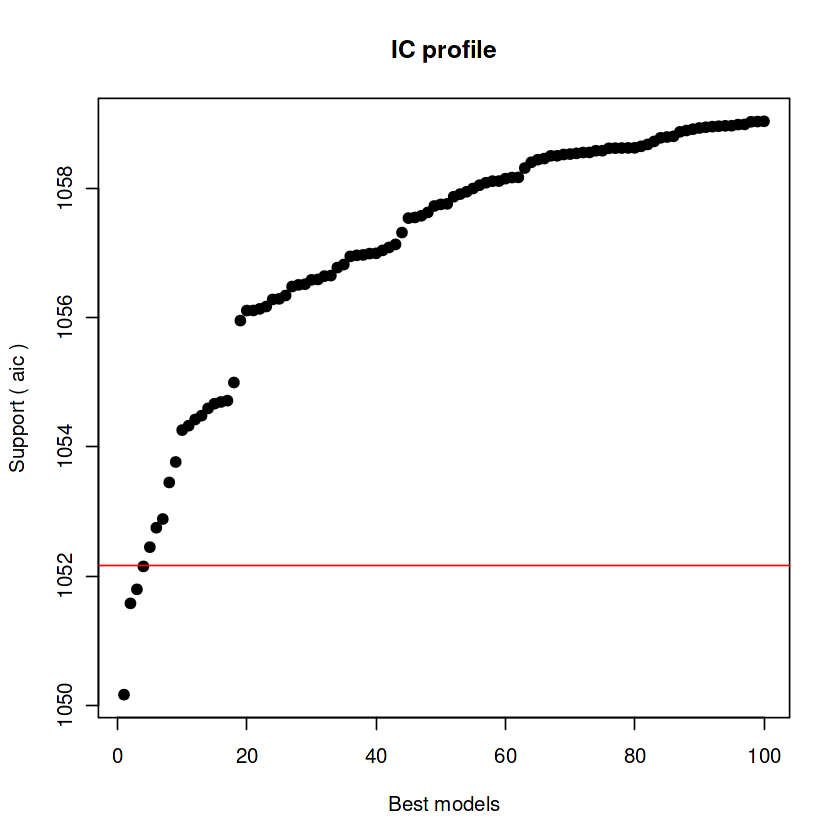


After 24850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1050.16364281741
Mean crit= 1056.86835610743


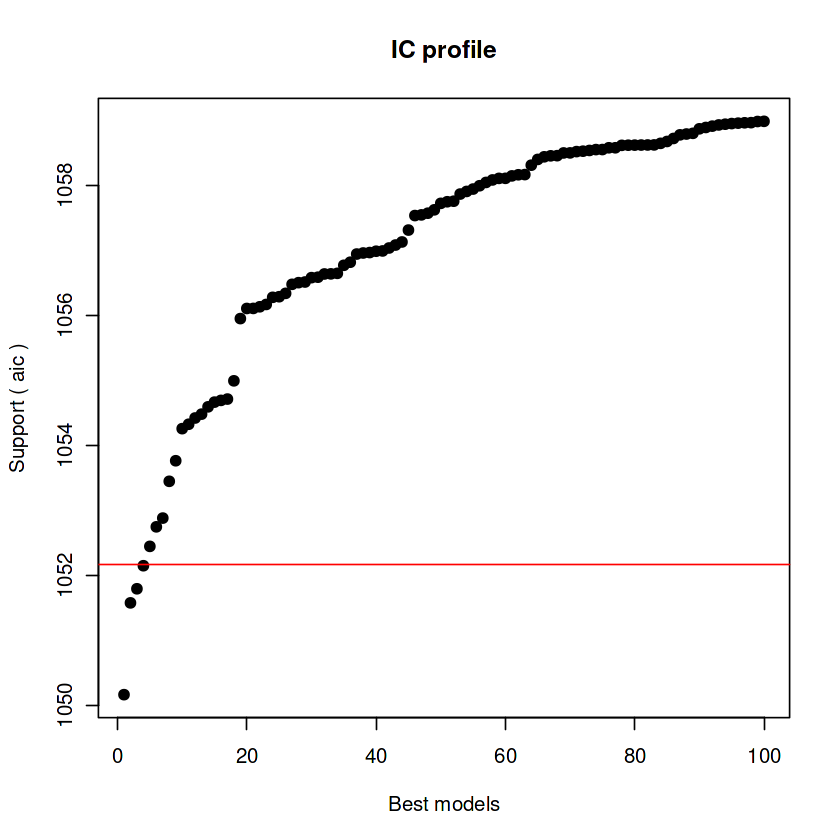


After 24900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1050.16364281741
Mean crit= 1056.66738913674


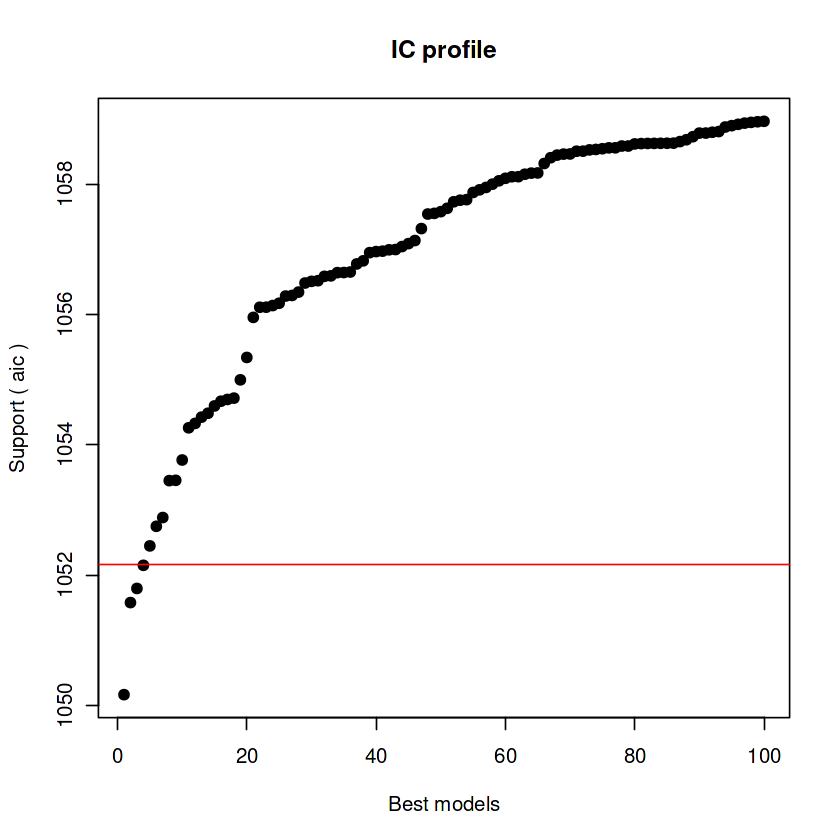


After 24950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1050.16364281741
Mean crit= 1056.57910799429


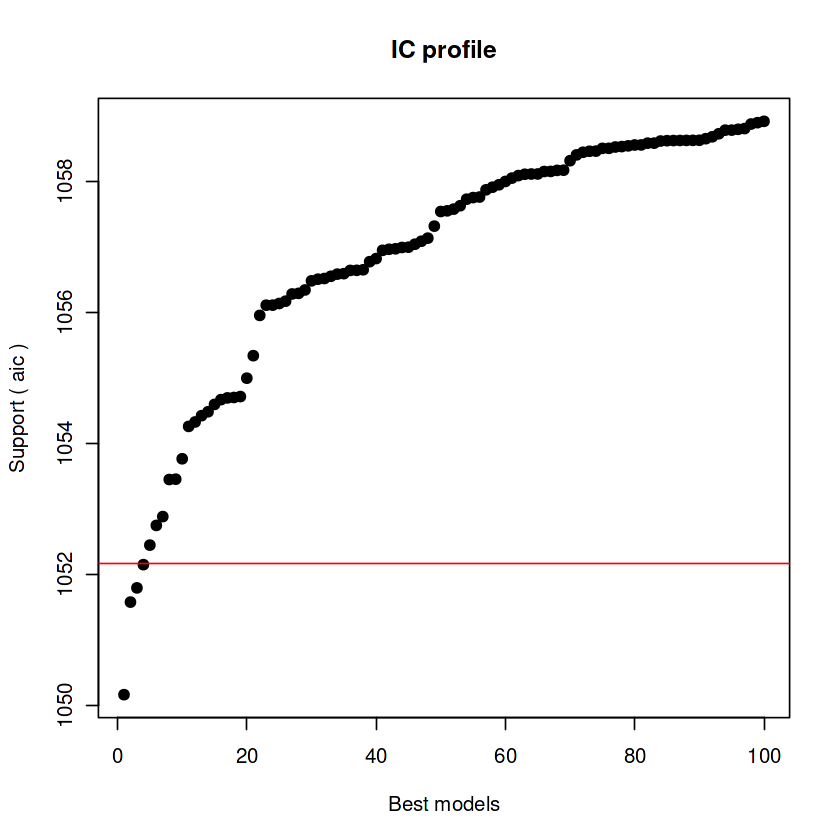


After 25000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1050.16364281741
Mean crit= 1056.4106847982


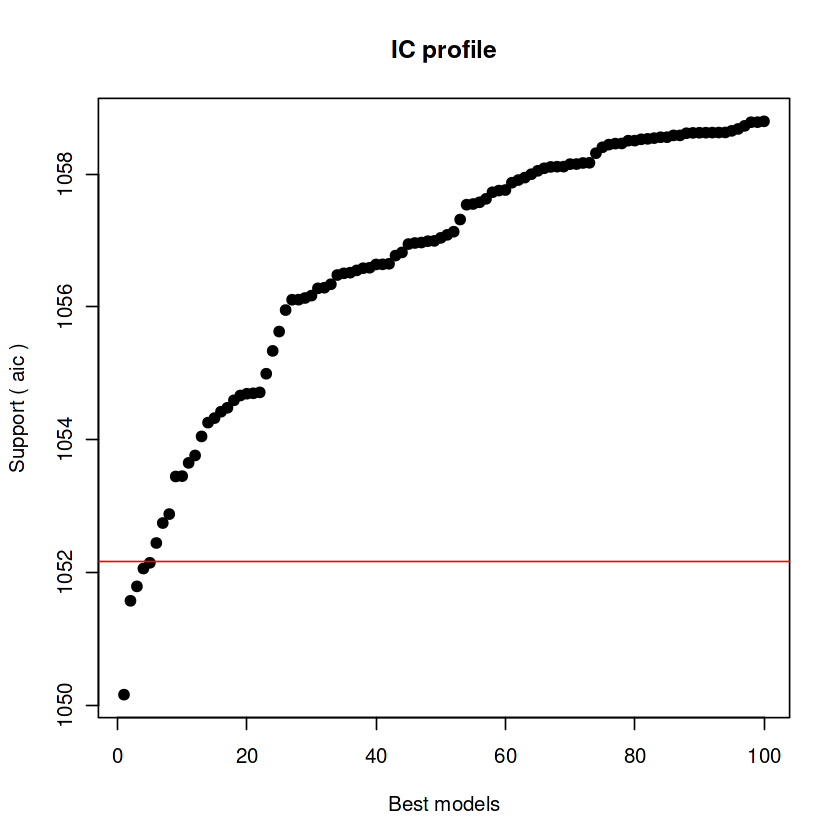


After 25050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1050.16364281741
Mean crit= 1056.23969491946


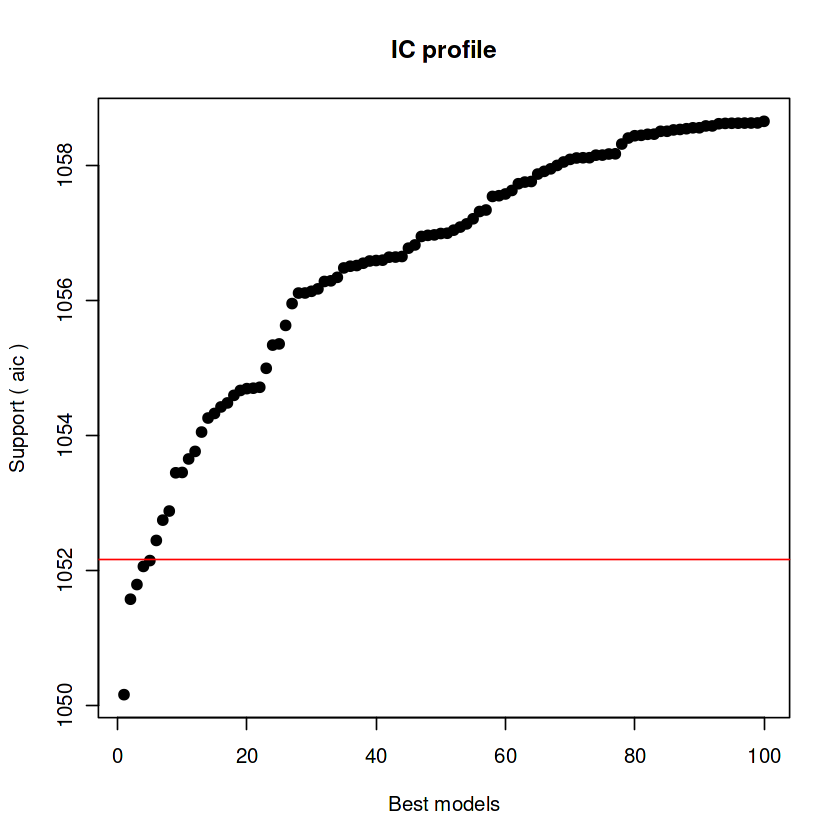


After 25100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1049.98734488326
Mean crit= 1055.86811728911


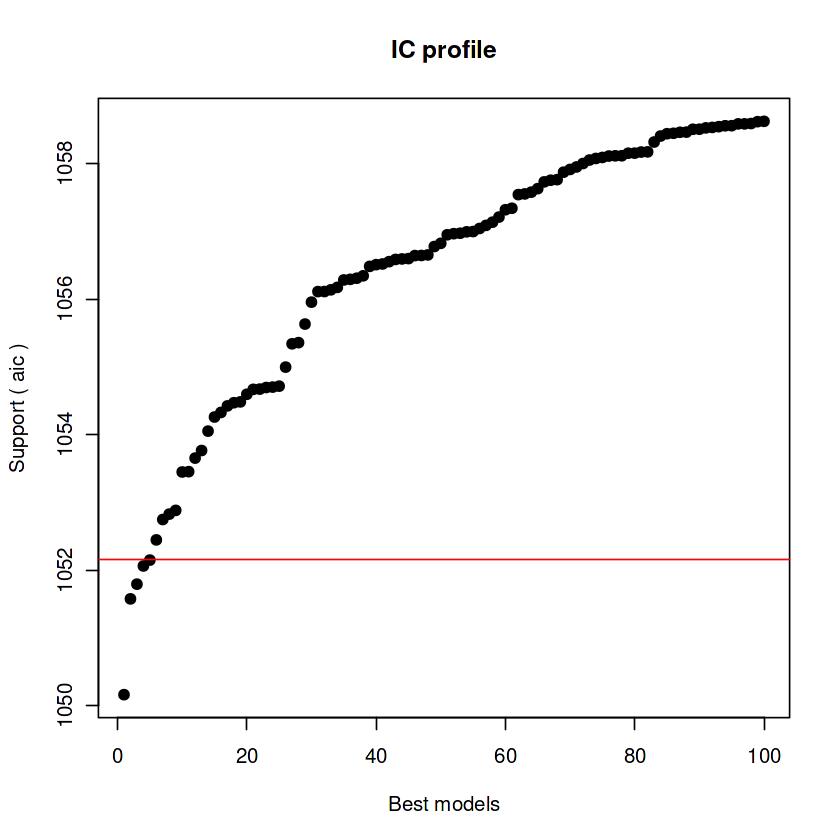


After 25150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1055.46148135161


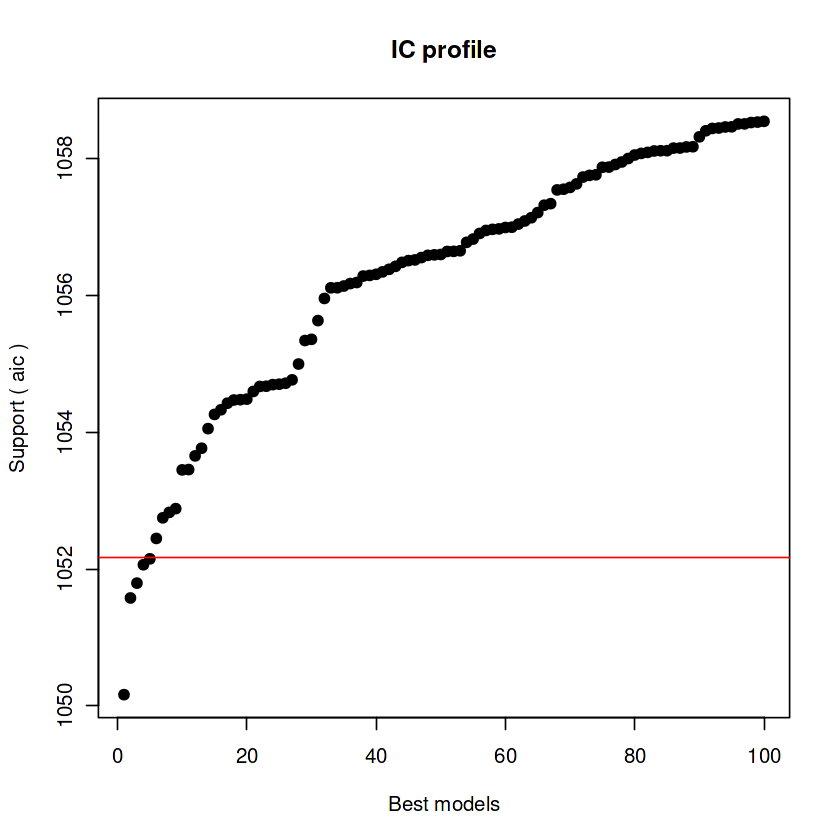


After 25200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1055.38366611555


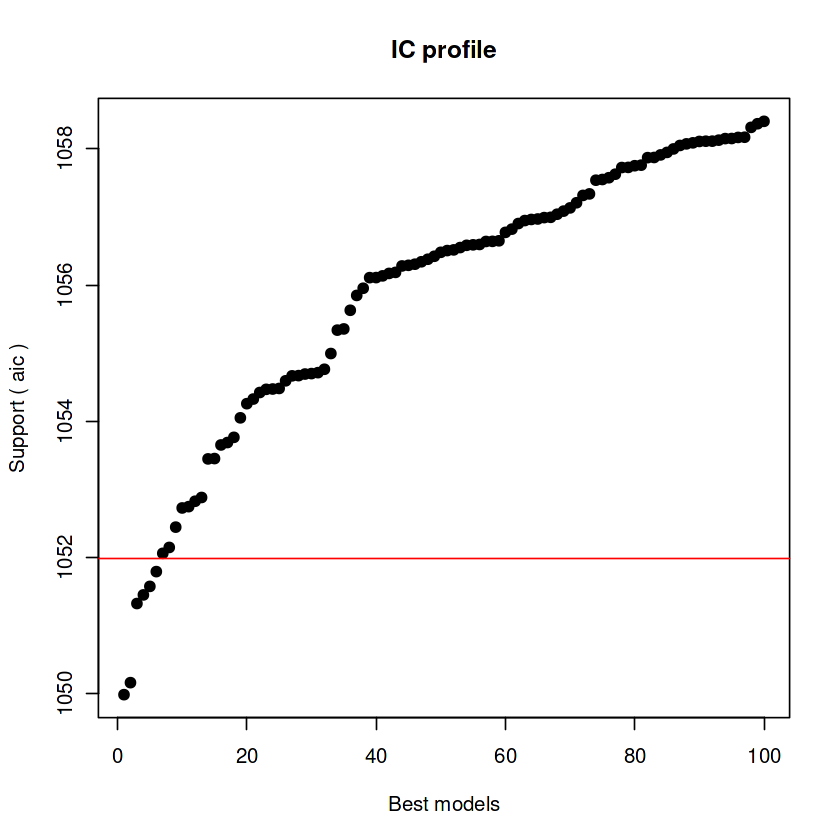


After 25250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1055.33721689927


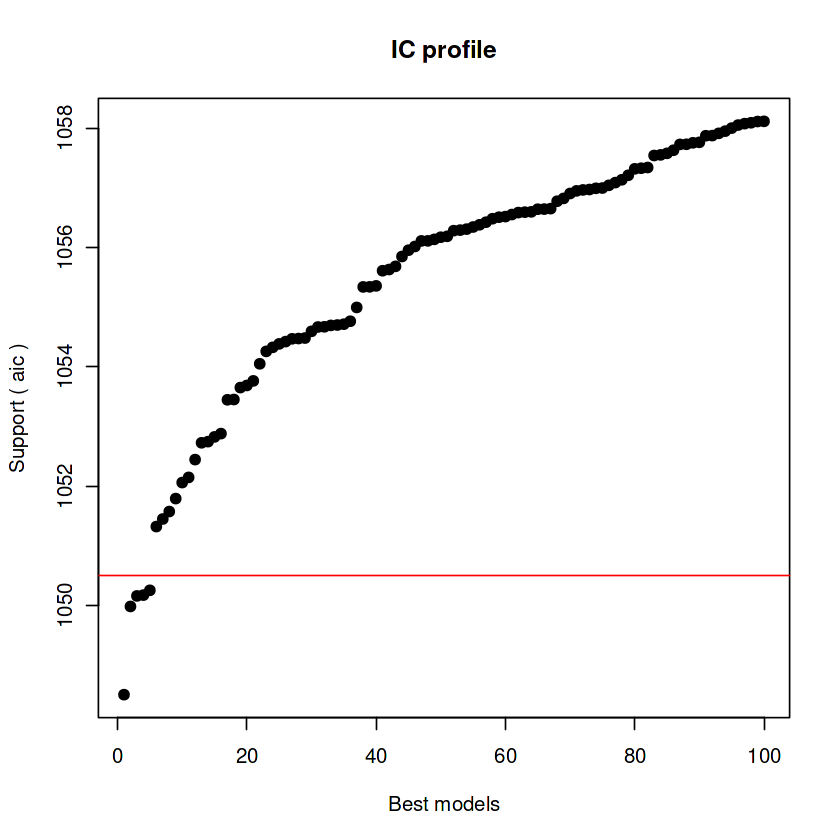


After 25300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1055.29535032145


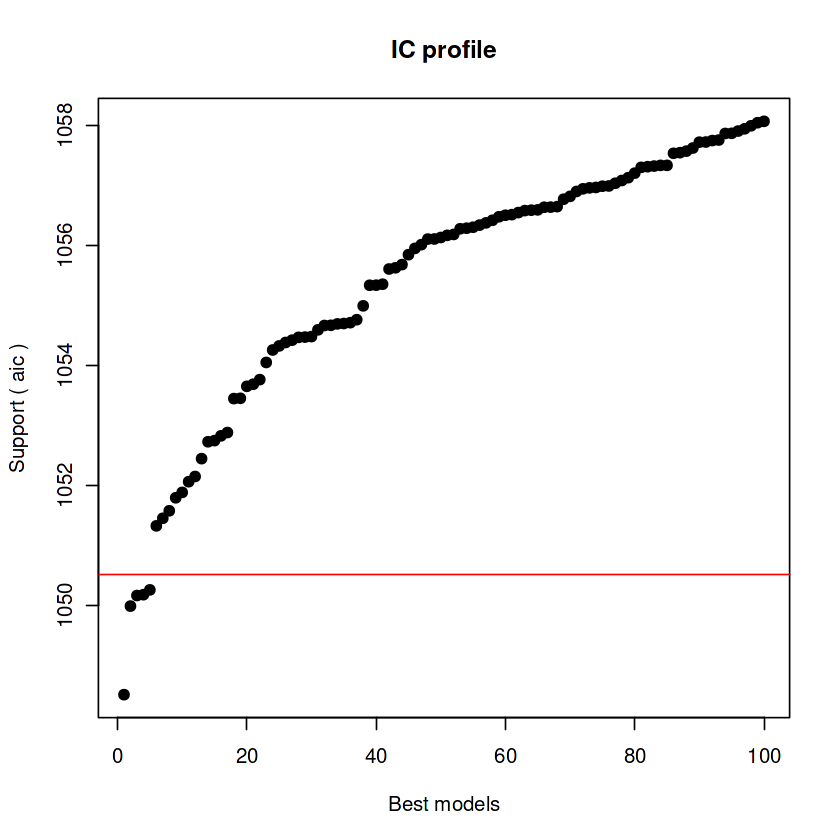


After 25350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1055.14516344509


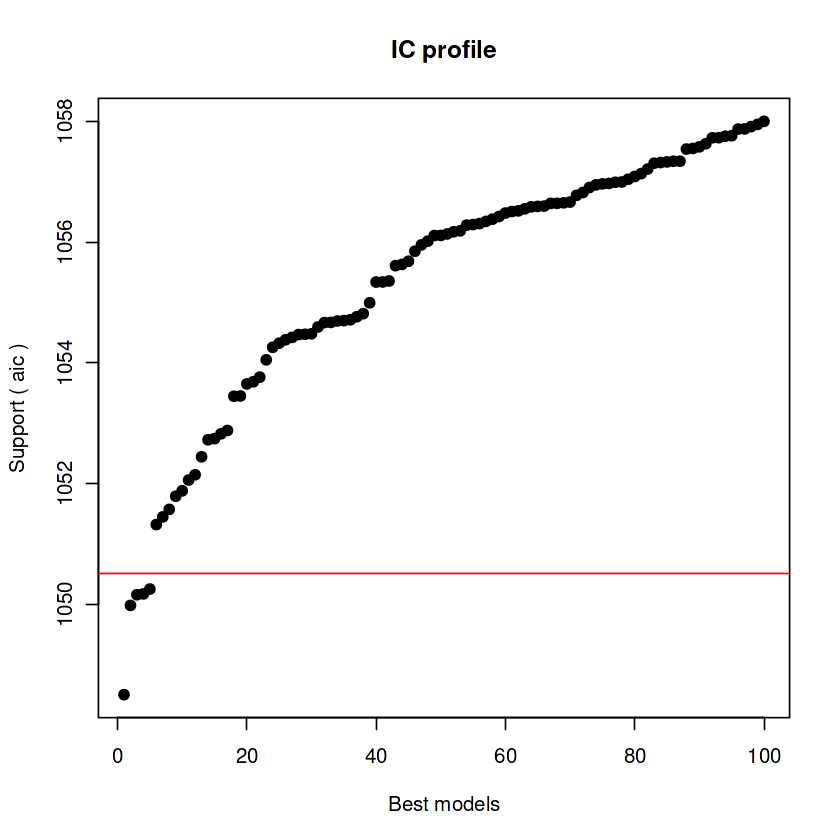


After 25400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.95122186396


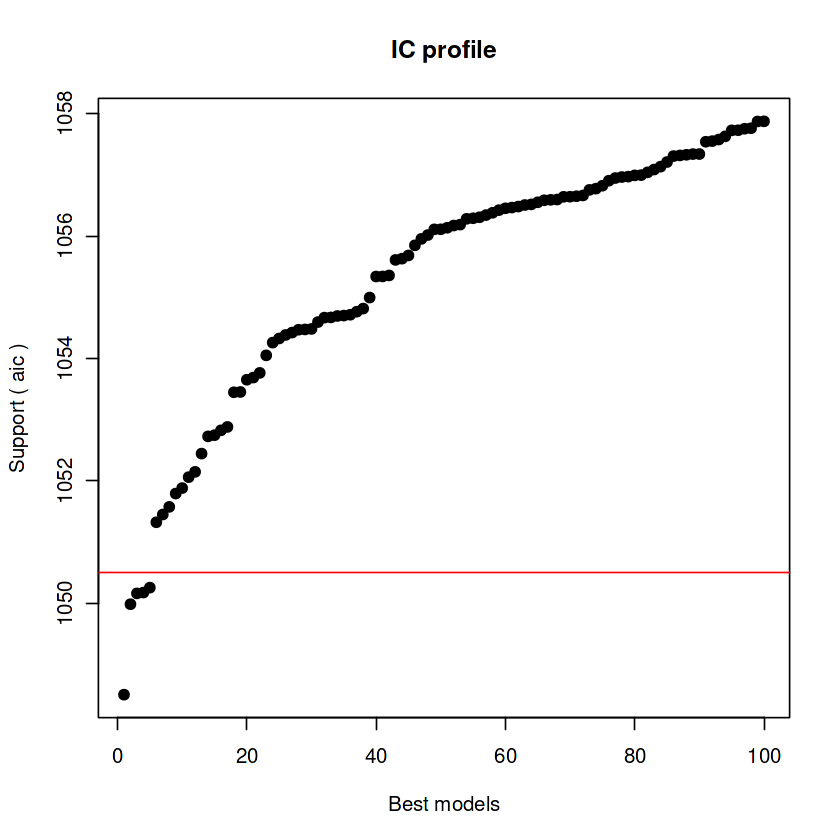


After 25450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751


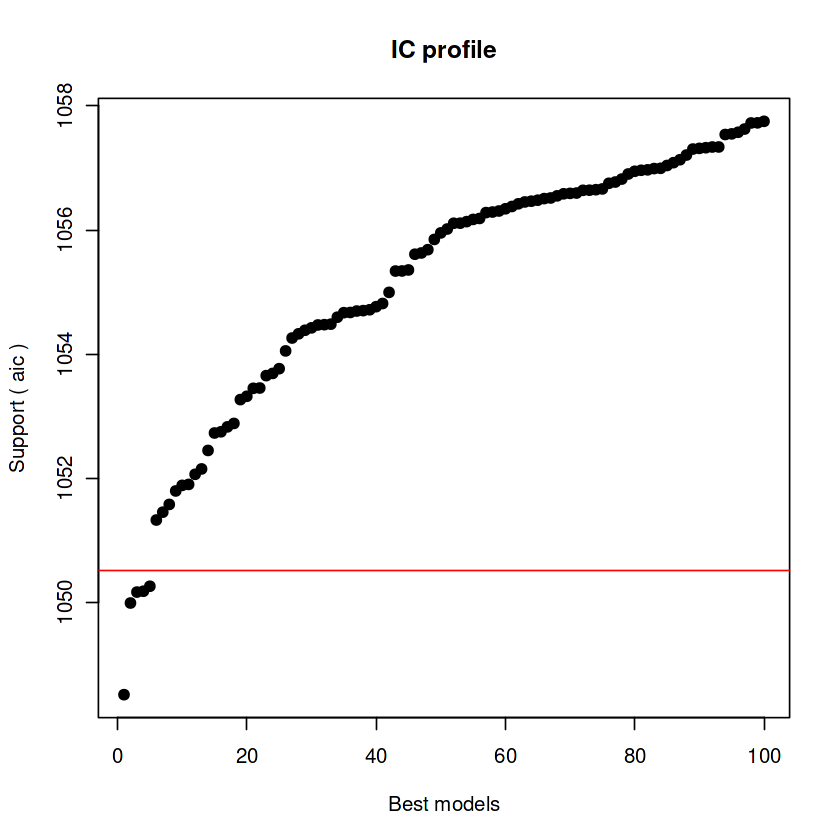


After 25500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751


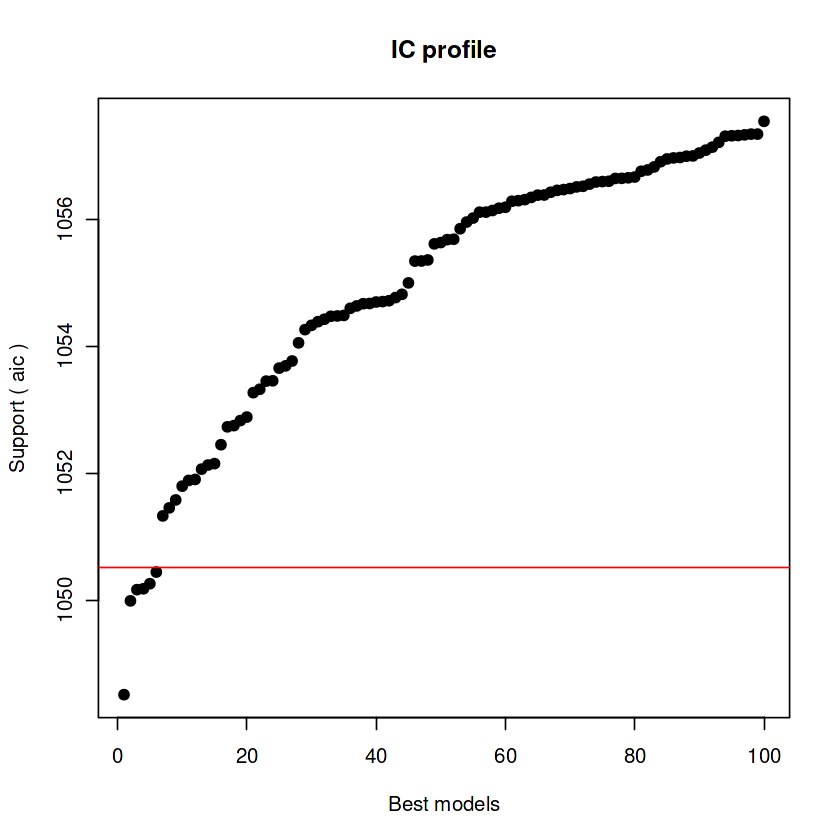


After 25550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 25600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 25650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 25700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 25750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 25800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 25850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 25900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 25950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 26950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 27950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.86213289751



After 28800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.85559748687



After 28850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.8221949574


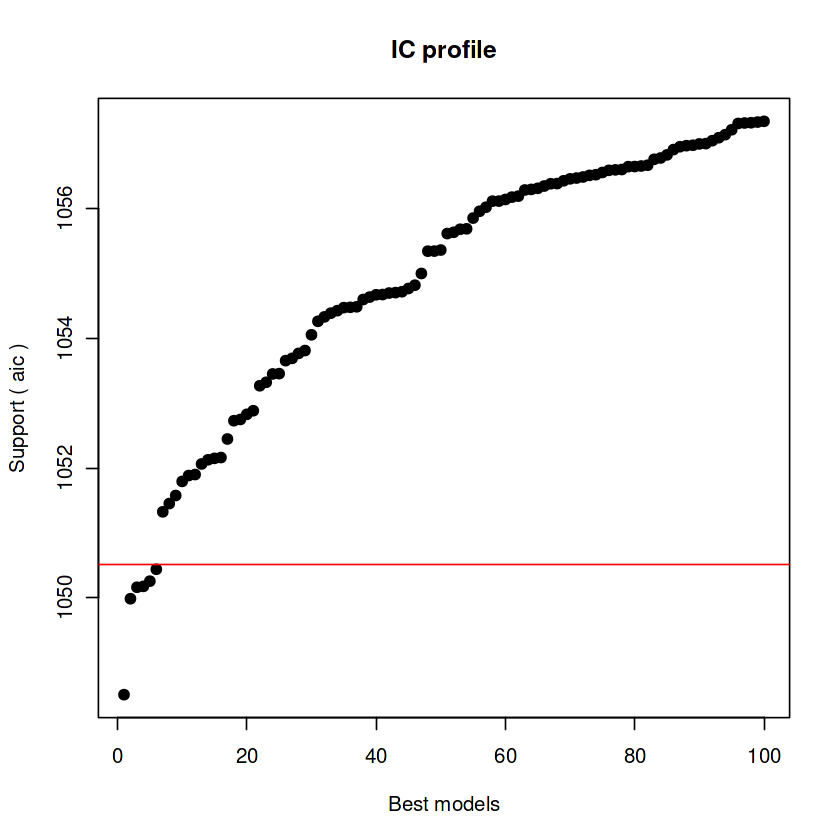


After 28900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.81388512739


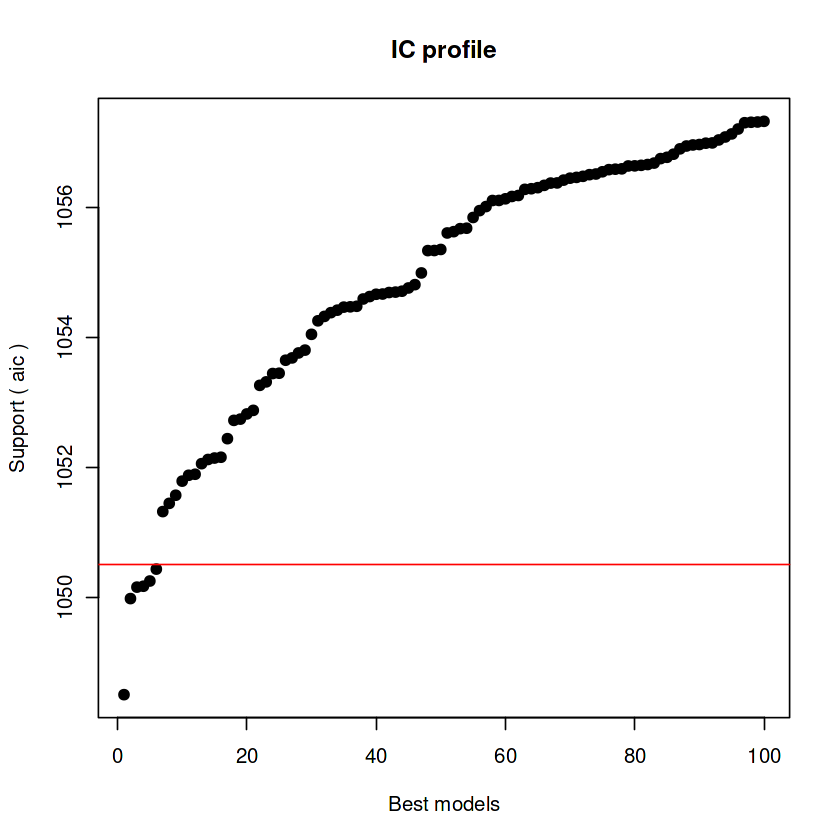


After 28950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.81388512739


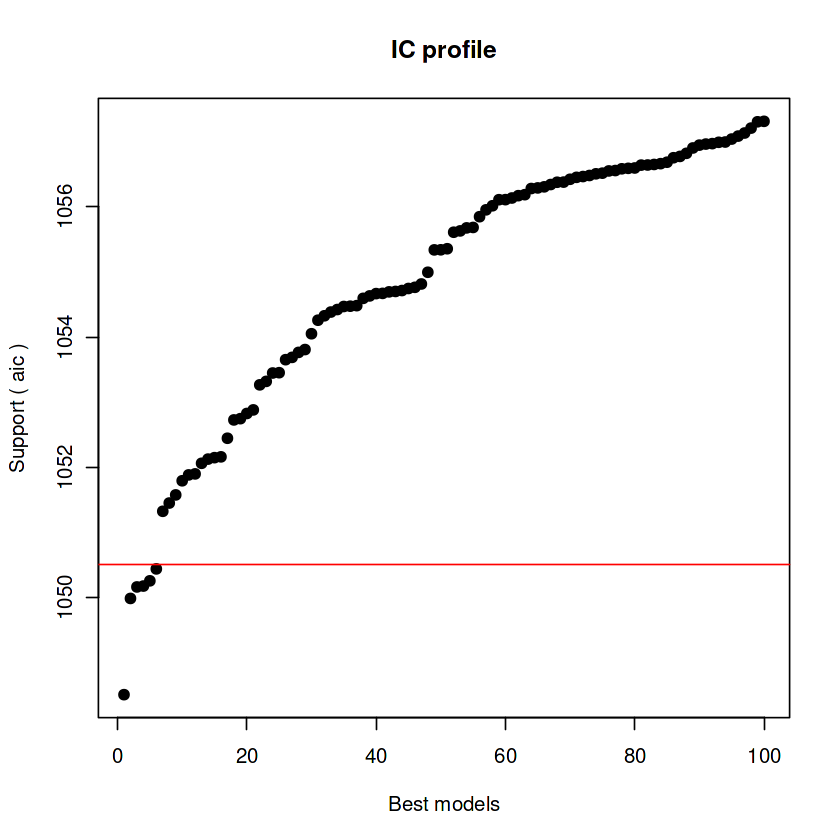


After 29000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.81388512739



After 29050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.81388512739



After 29100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.80667098713



After 29150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.80667098713


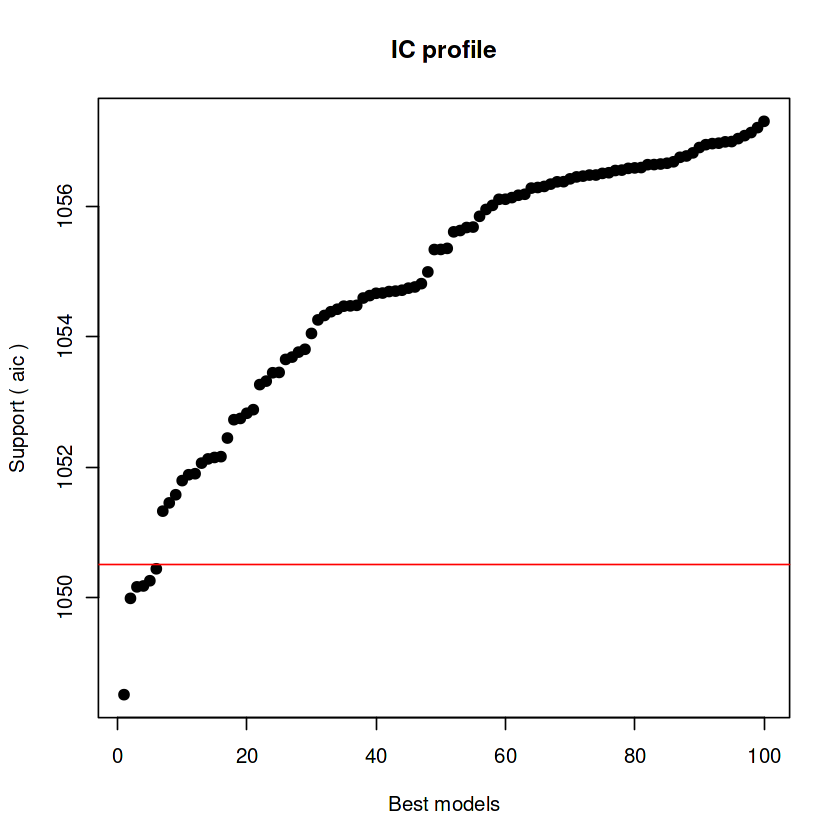


After 29200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.80667098713



After 29250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.80483735104



After 29300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.79763908979


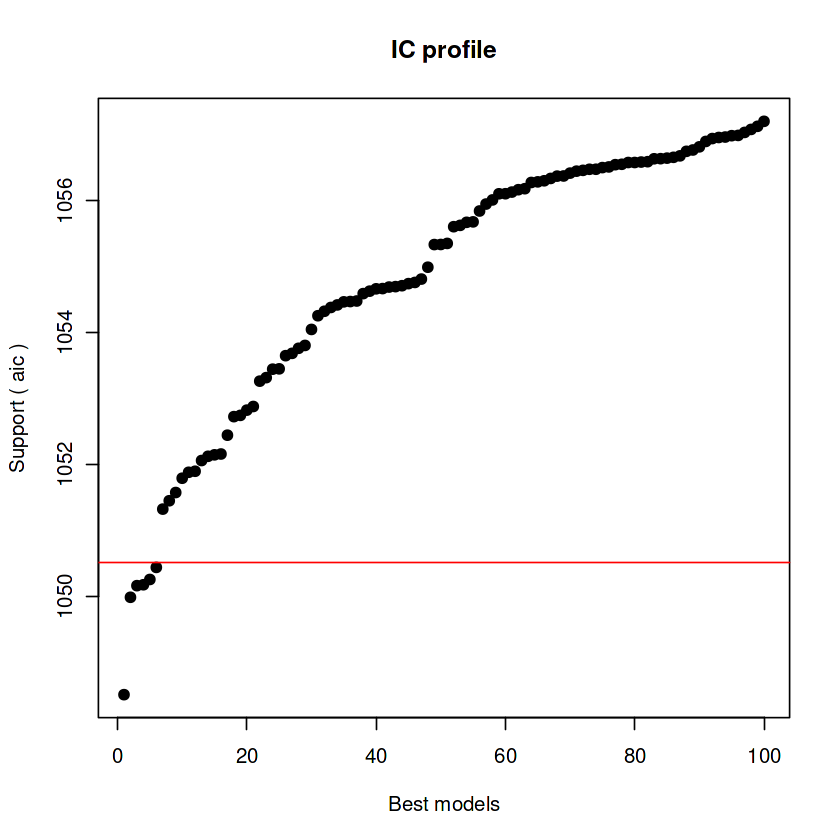


After 29350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.79763908979


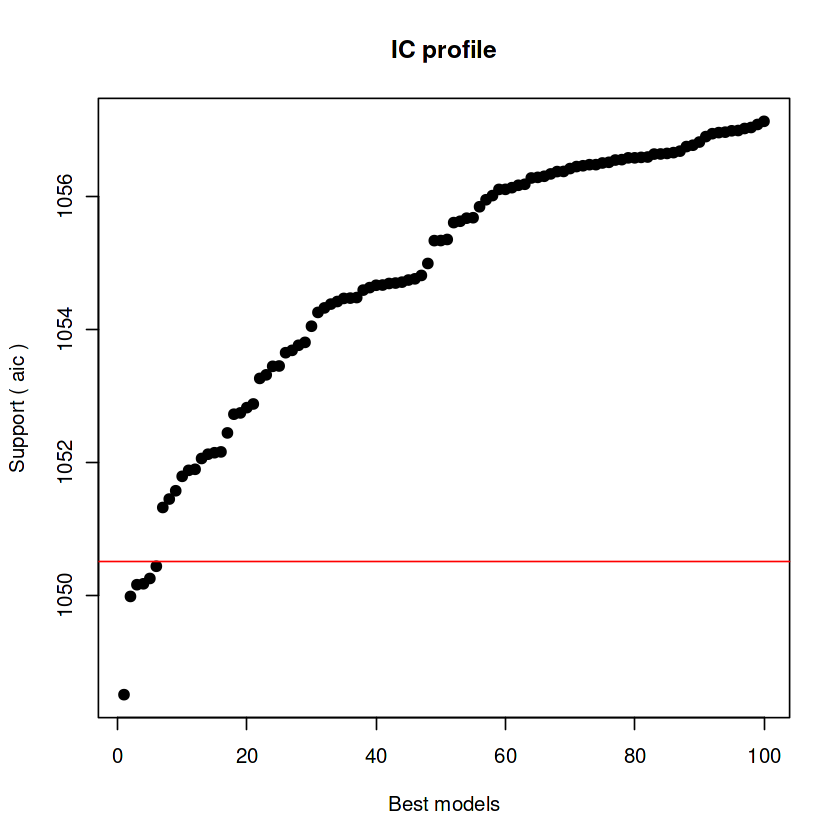


After 29400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.75495508631



After 29450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.75495508631


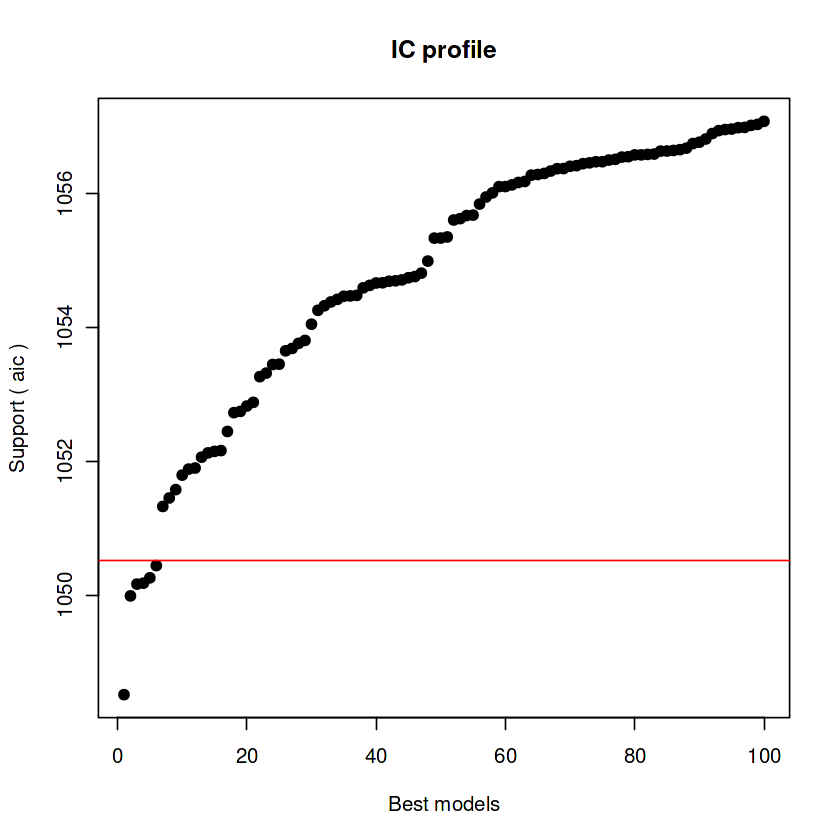


After 29500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.75495508631



After 29550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.75495508631



After 29600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.75495508631



After 29650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 29700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618


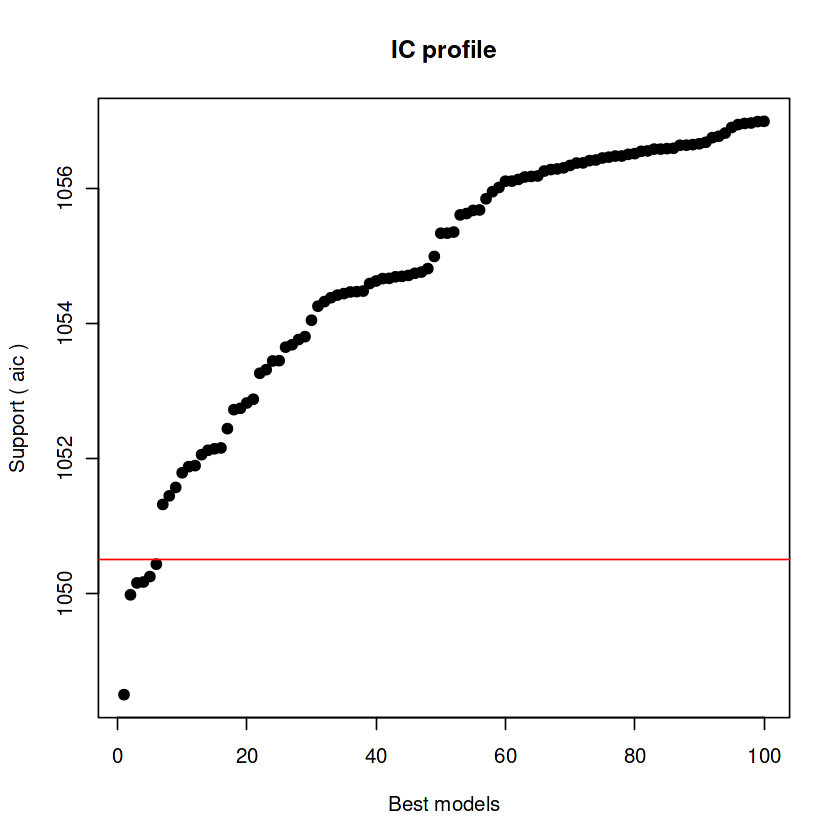


After 29750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 29800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 29850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 29900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 29950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 30950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 31950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.74818103618



After 32900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.7463371144



After 32950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.71738090555


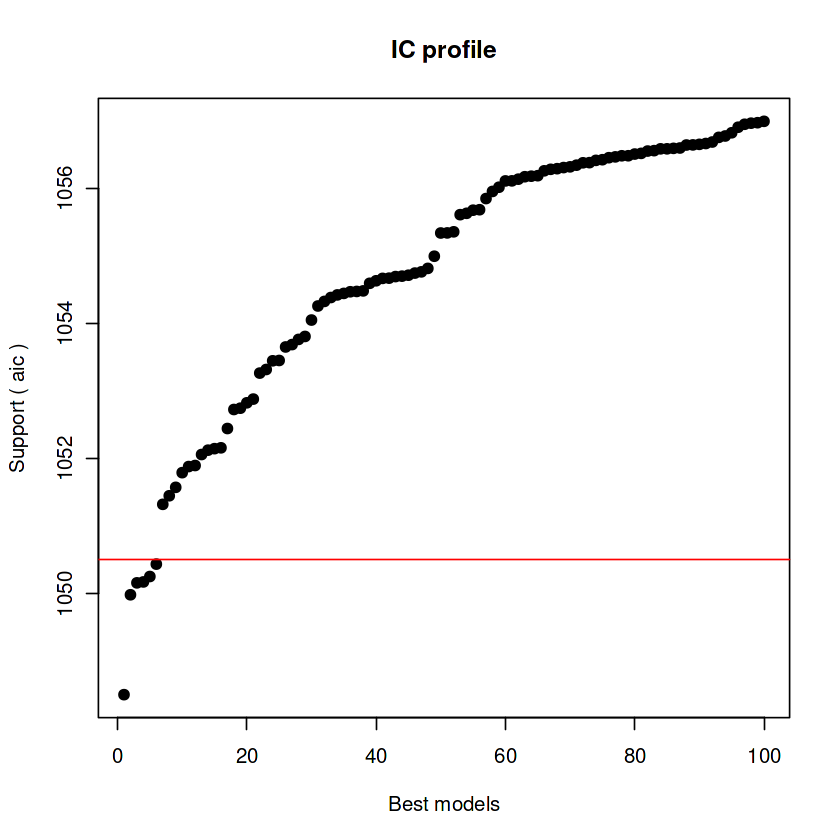


After 33000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.67279663924


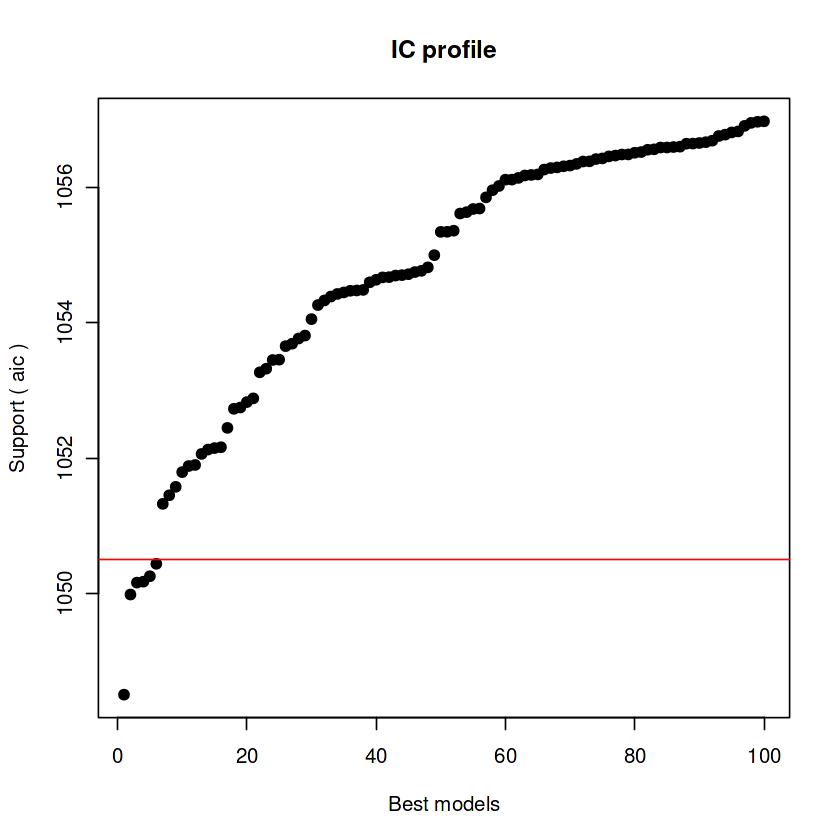


After 33050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.6391368629


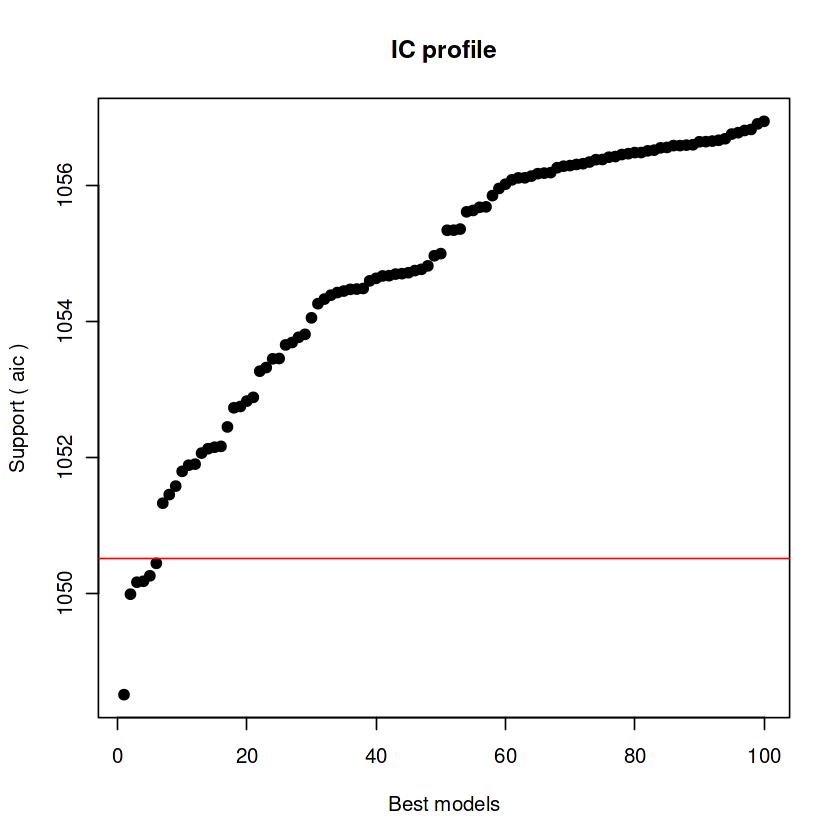


After 33100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.50016300358


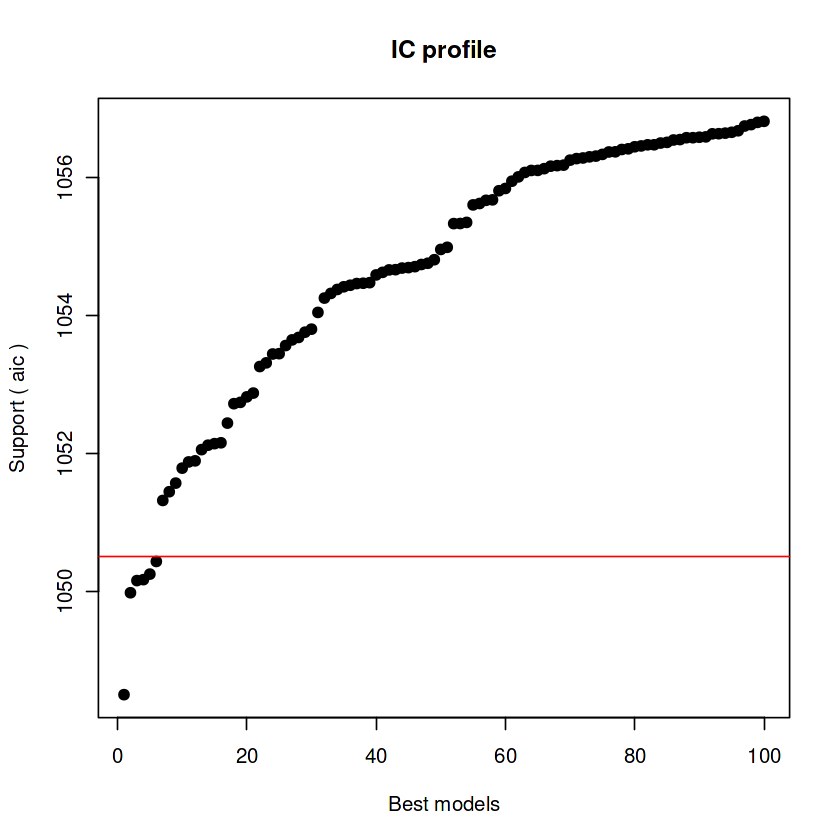


After 33150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.49137703009


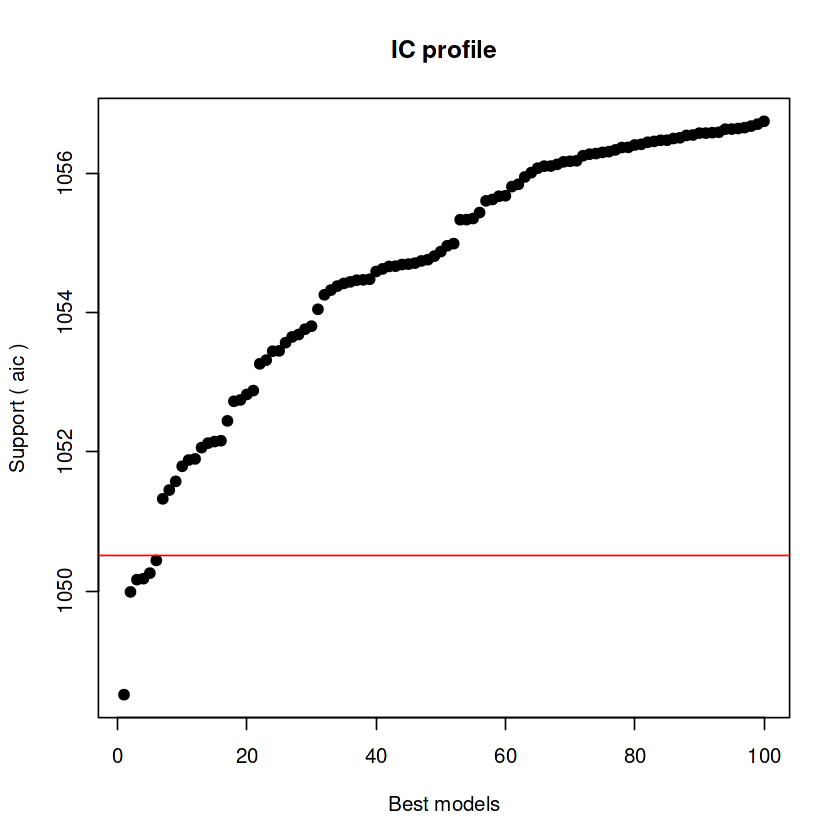


After 33200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.49137703009


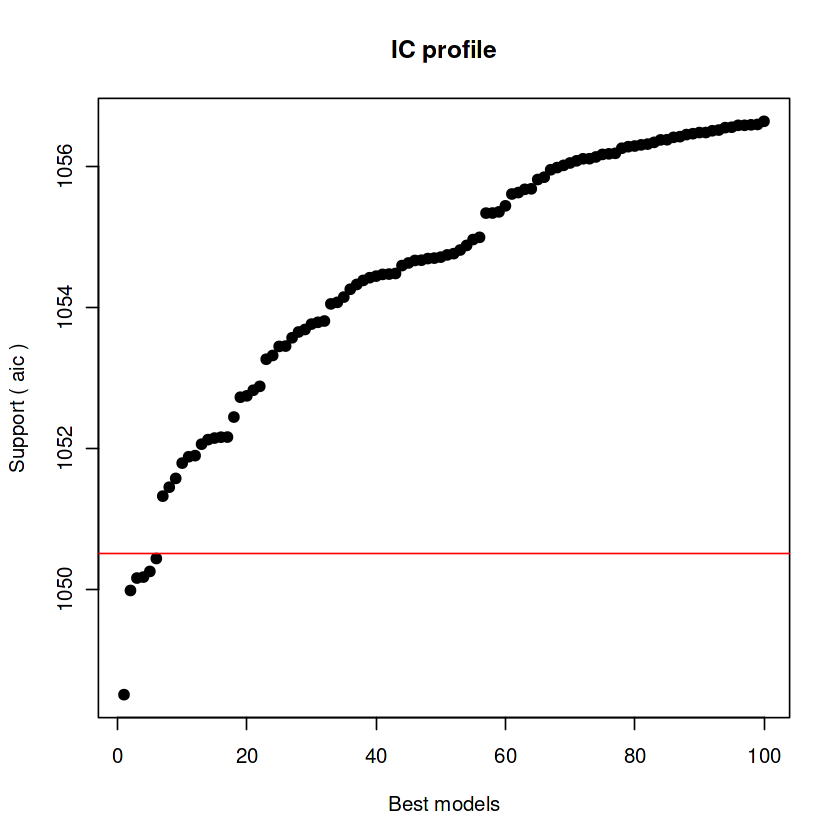


After 33250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.49137703009



After 33300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.47975996158



After 33350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.44167157104


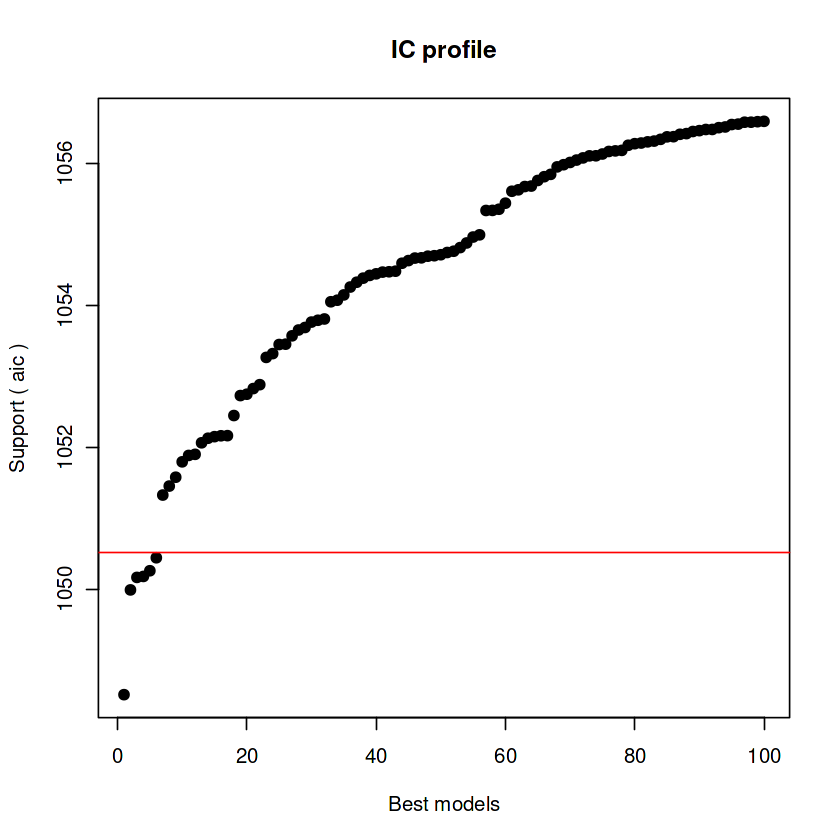


After 33400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.41863181258


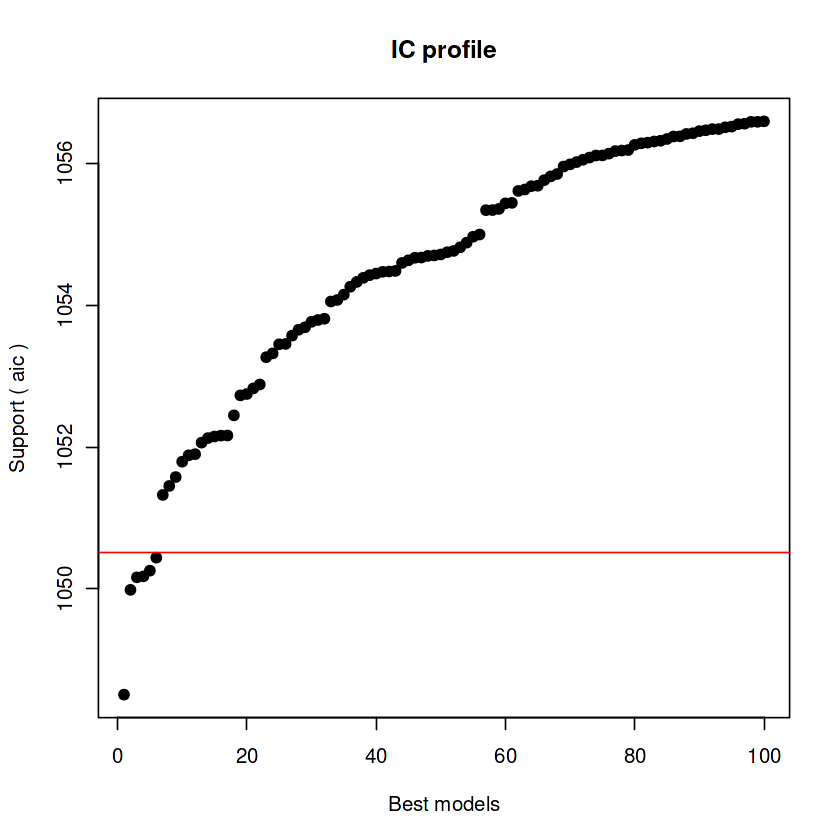


After 33450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.41748077237


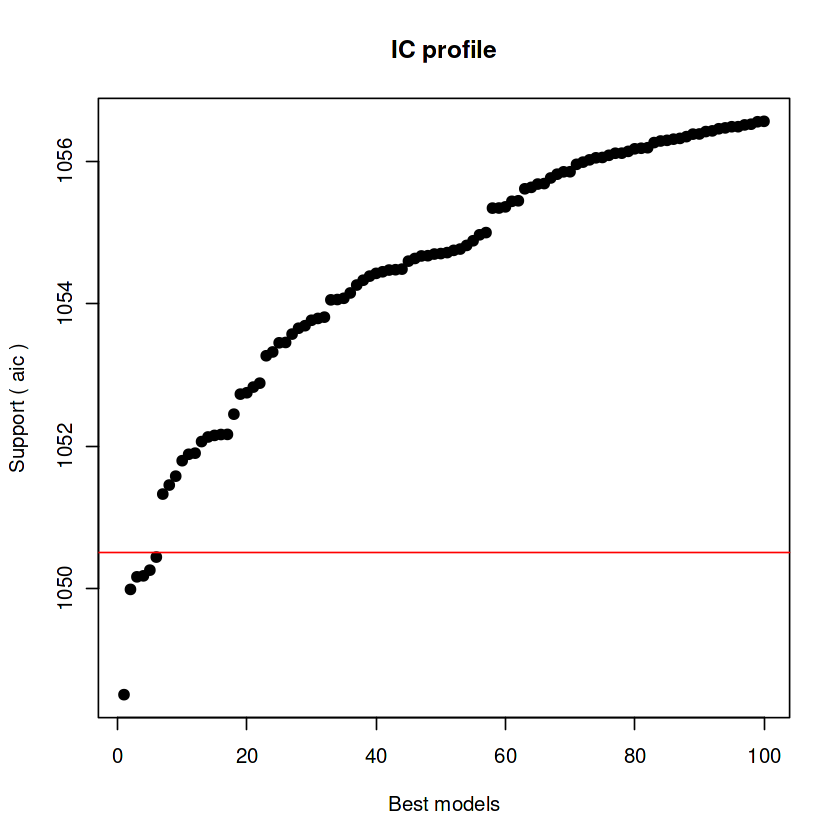


After 33500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.32353115774


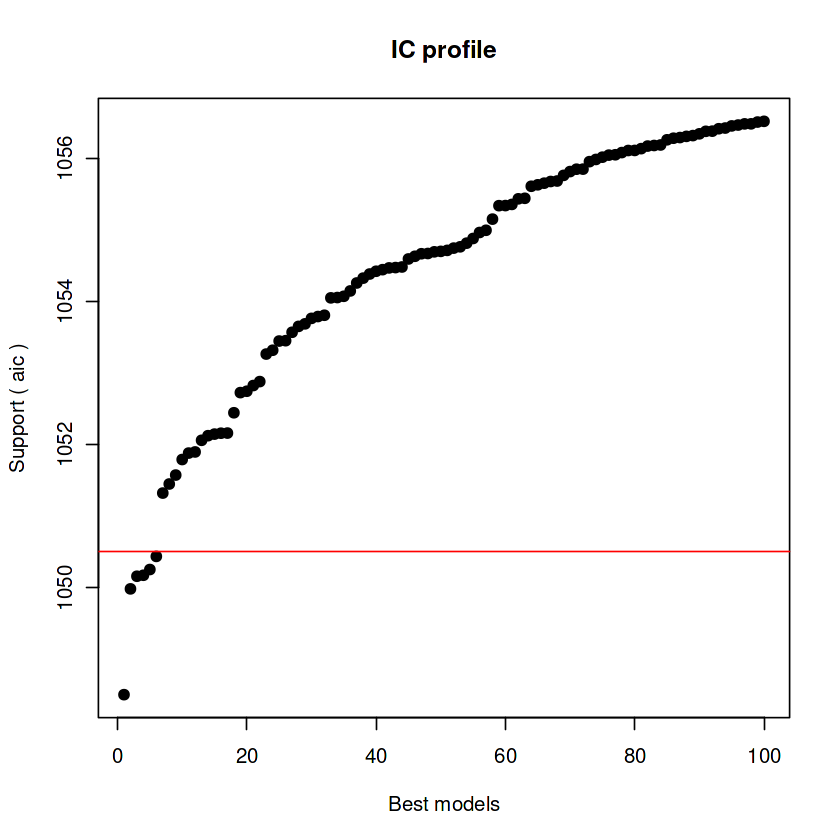


After 33550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.21711593324


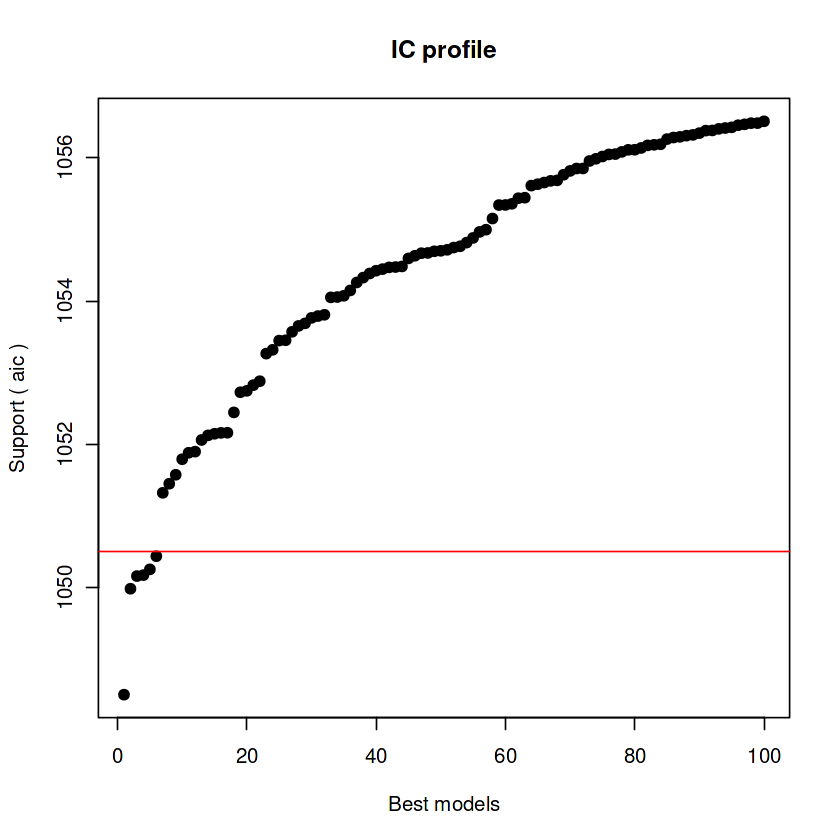


After 33600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1054.00621815931


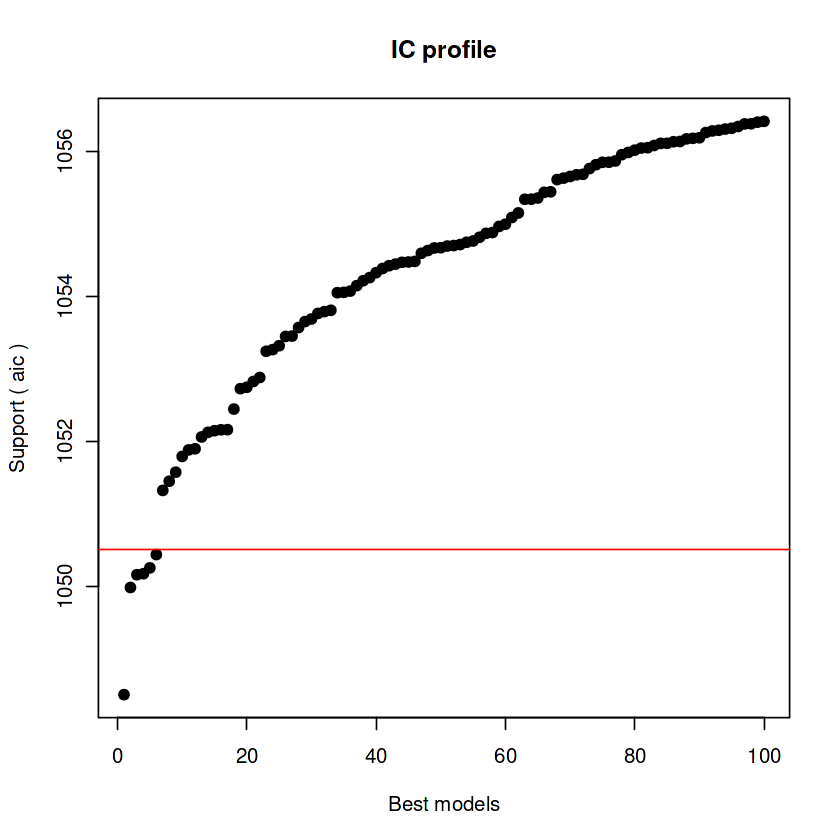


After 33650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.92284012914


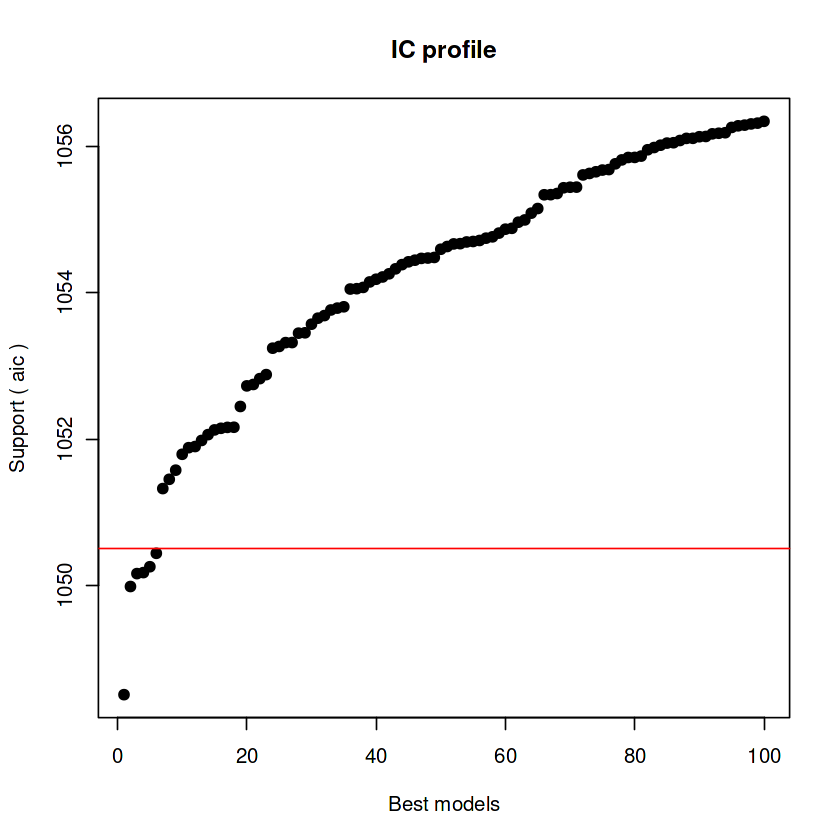


After 33700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.92284012914


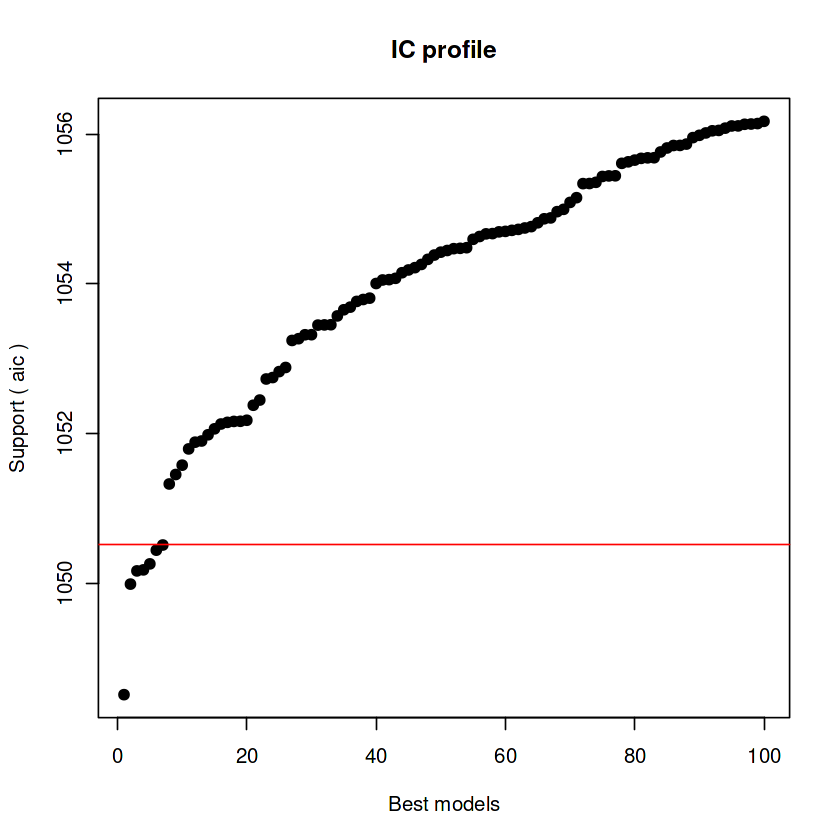


After 33750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.91253843478



After 33800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.88120450162


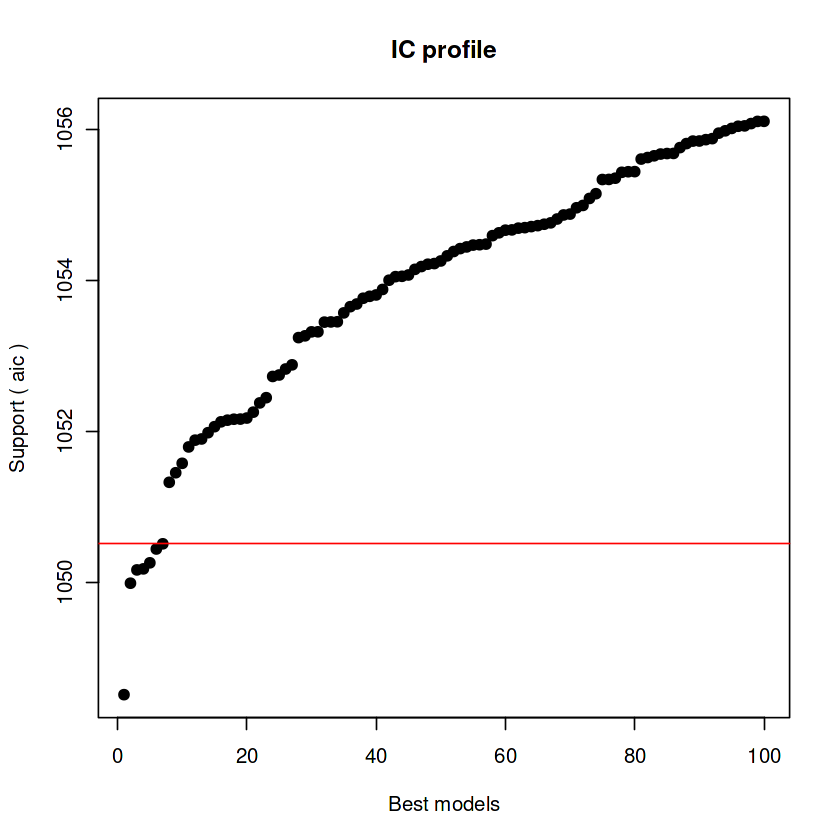


After 33850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.87394970561


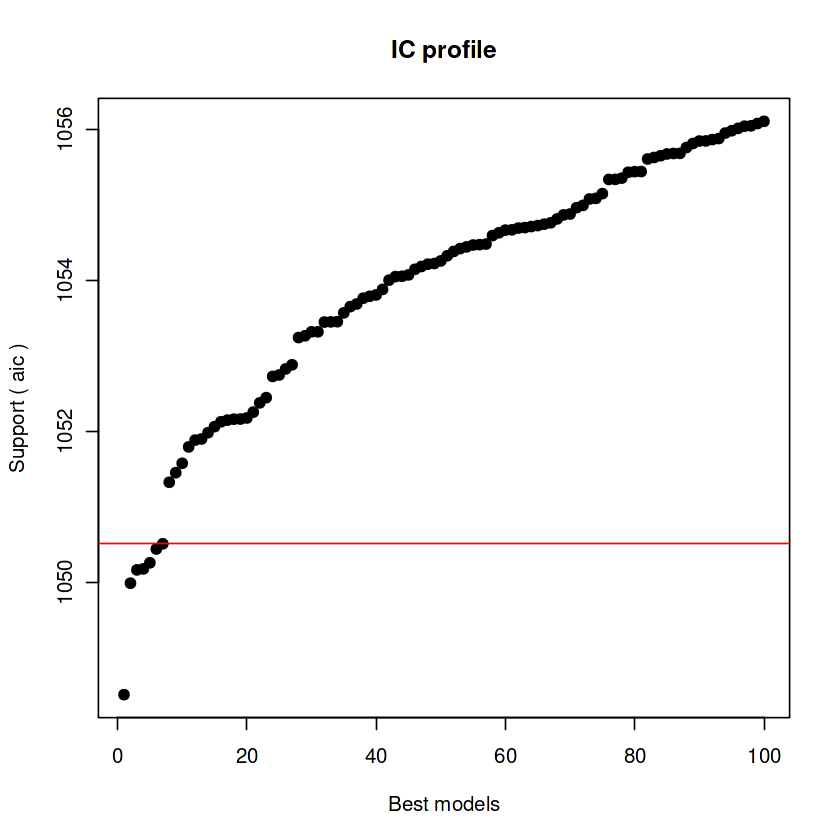


After 33900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233


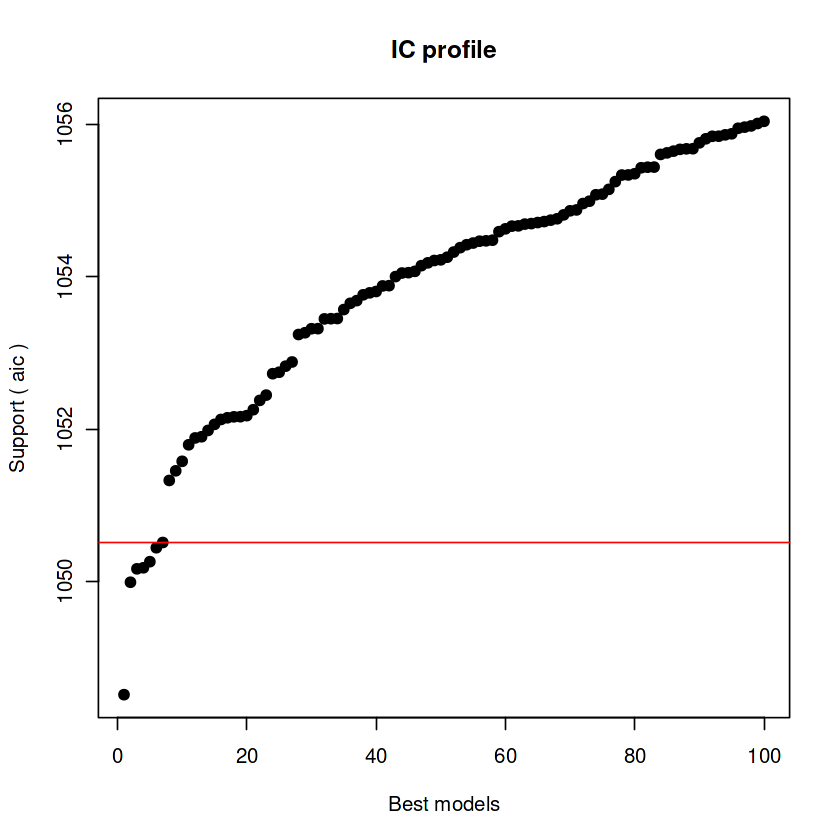


After 33950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233


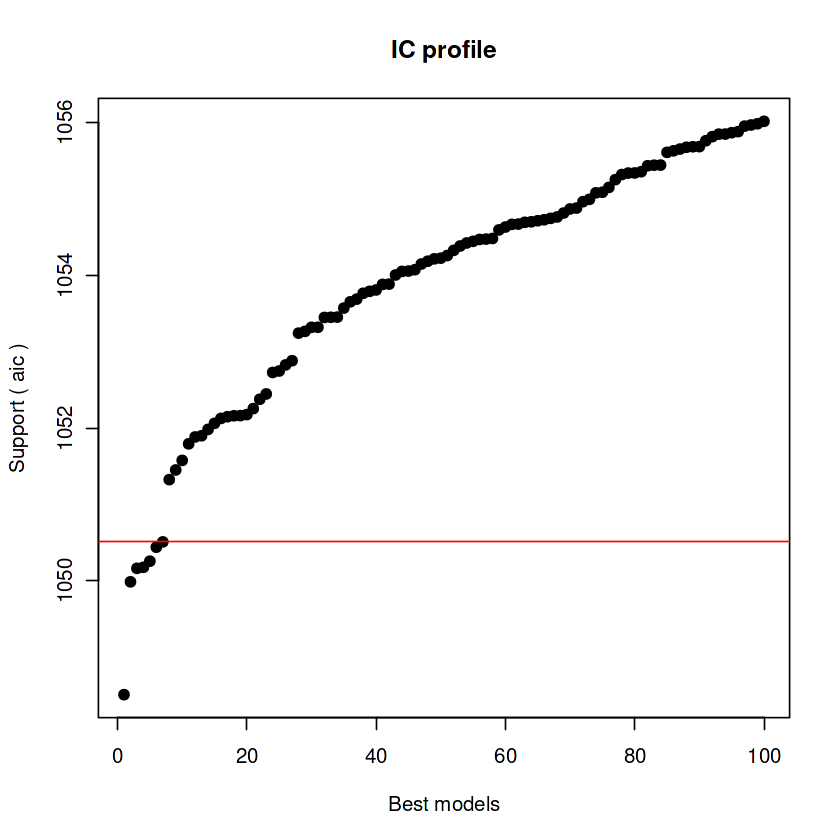


After 34000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 34950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 35950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 36950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 37000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 37050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 37100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 37150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 37200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 37250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 37300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.78322324233



After 37350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.77121173177



After 37400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.77121173177


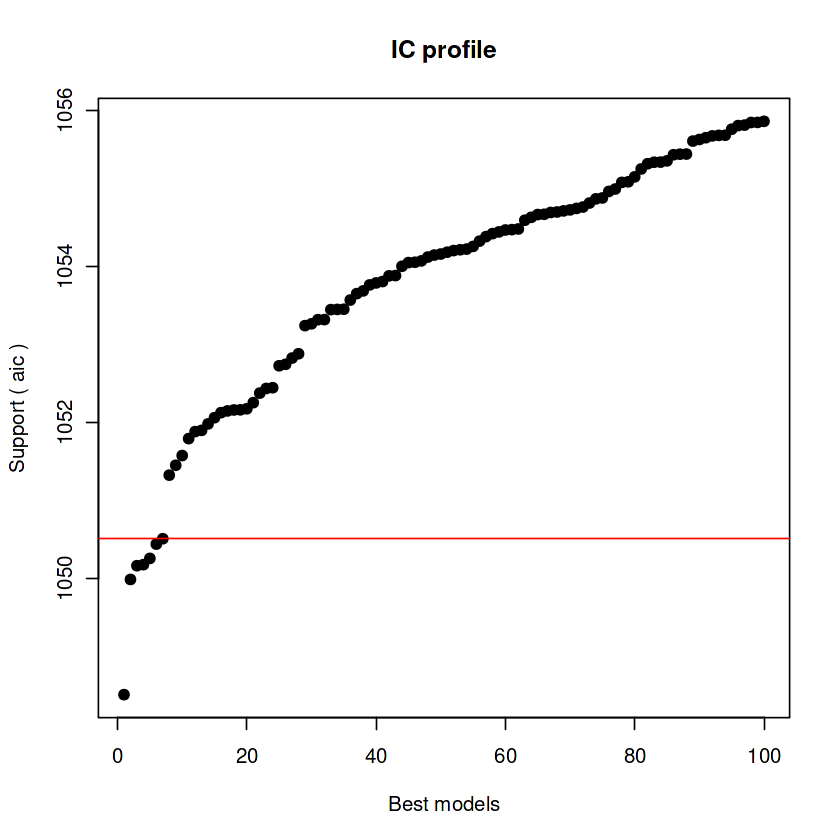


After 37450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.77121173177



After 37500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.77121173177



After 37550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.77121173177



After 37600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.77121173177



After 37650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.77121173177



After 37700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.77121173177



After 37750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.77121173177



After 37800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.77121173177



After 37850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 37900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208


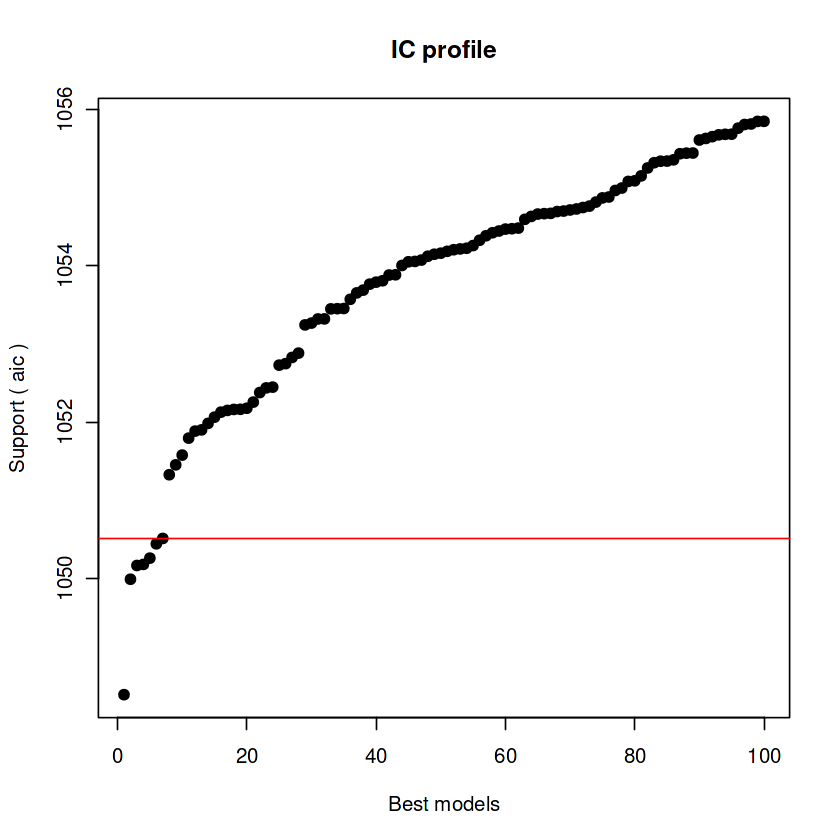


After 37950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 38950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 39950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 40950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 41000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 41050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 41100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 41150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 41200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 41250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 41300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 41350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 41400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.75790498208



After 41450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.7410880646



After 41500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.71401353955


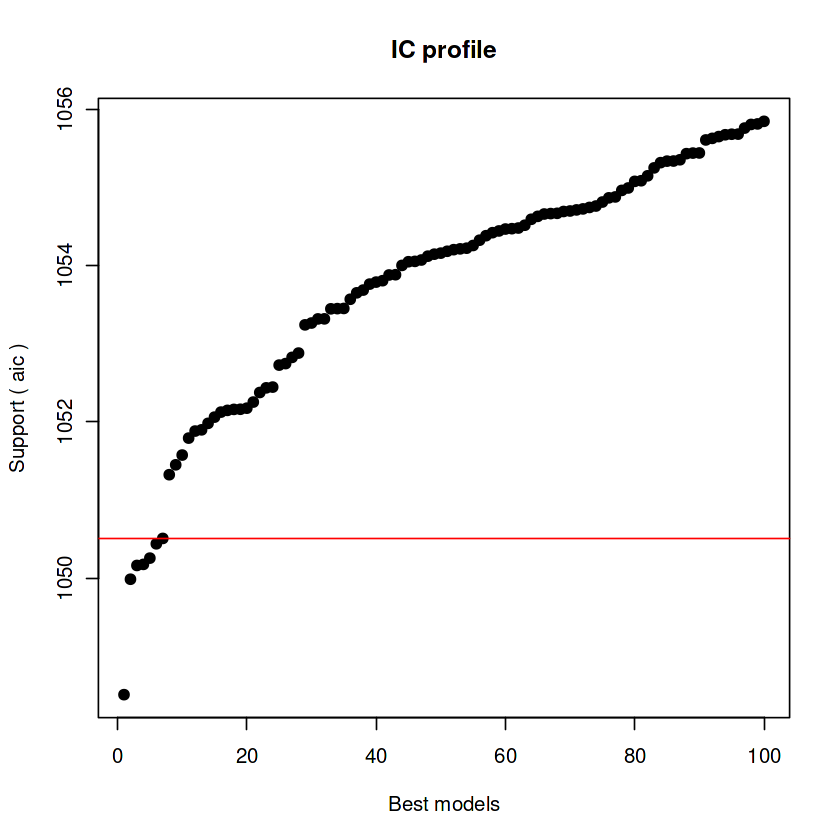


After 41550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.65888001132


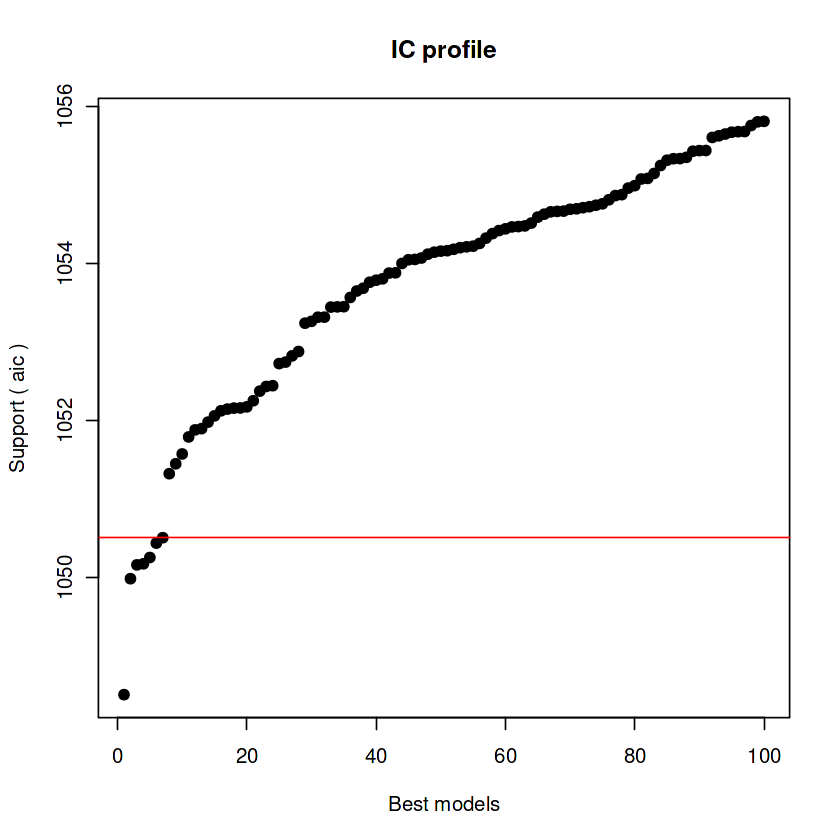


After 41600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.64290600668


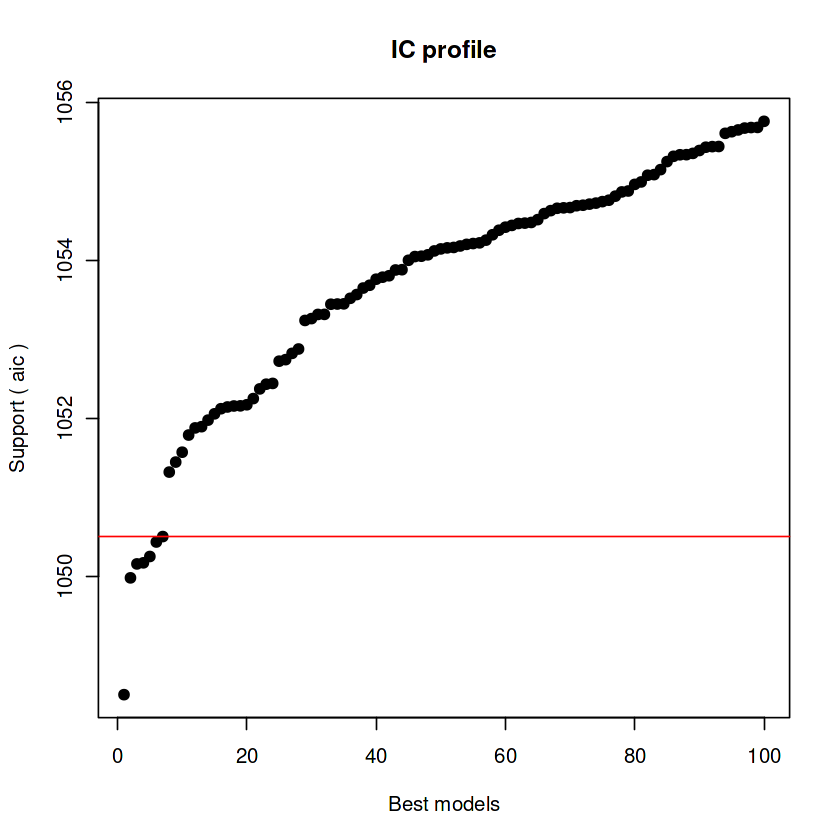


After 41650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.64290600668


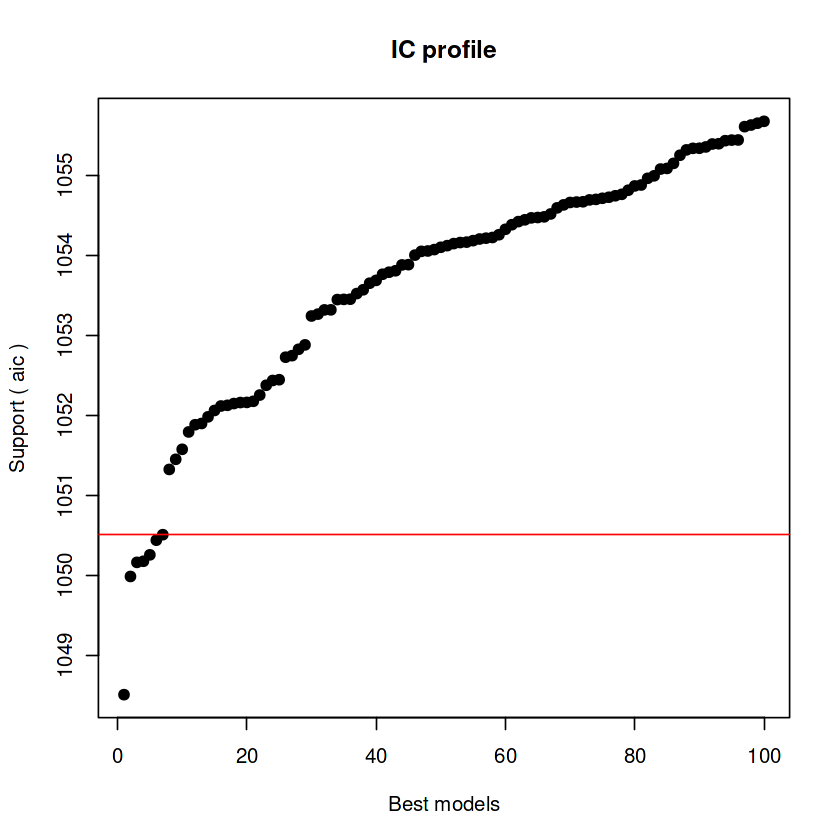


After 41700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.64290600668



After 41750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.64071618811



After 41800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.64071618811


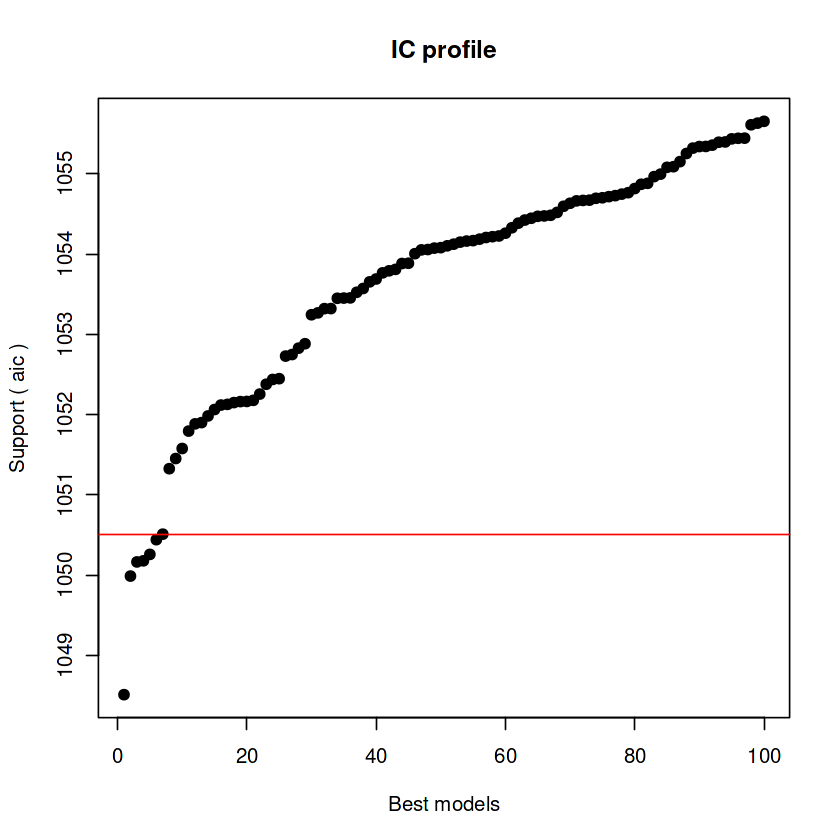


After 41850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.62488157512



After 41900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.61558043137


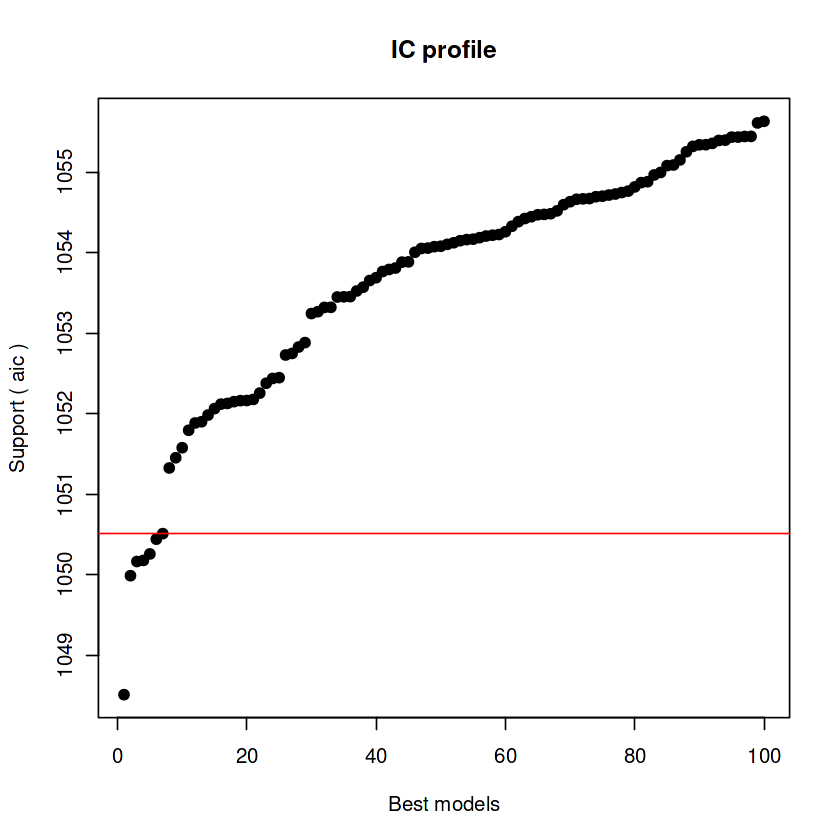


After 41950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.5683781643


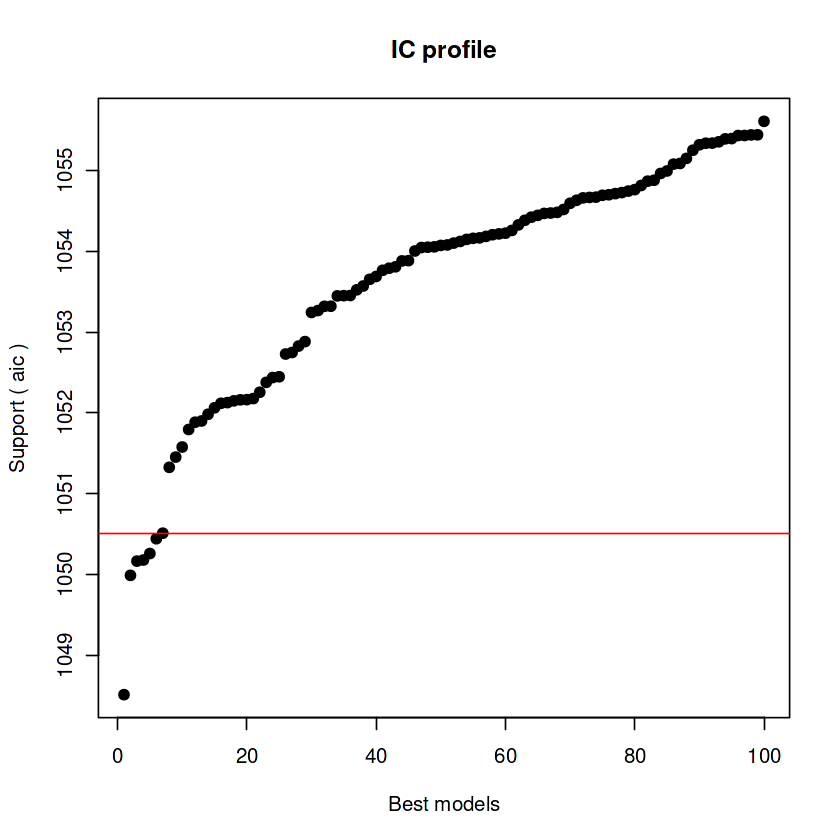


After 42000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.52655902004


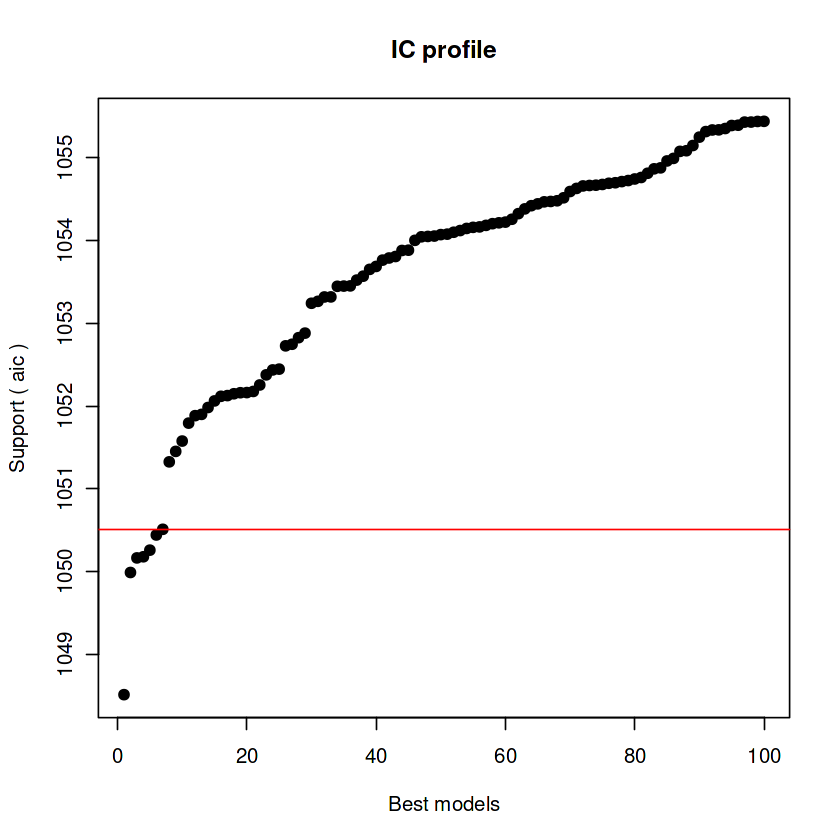


After 42050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.49643409003


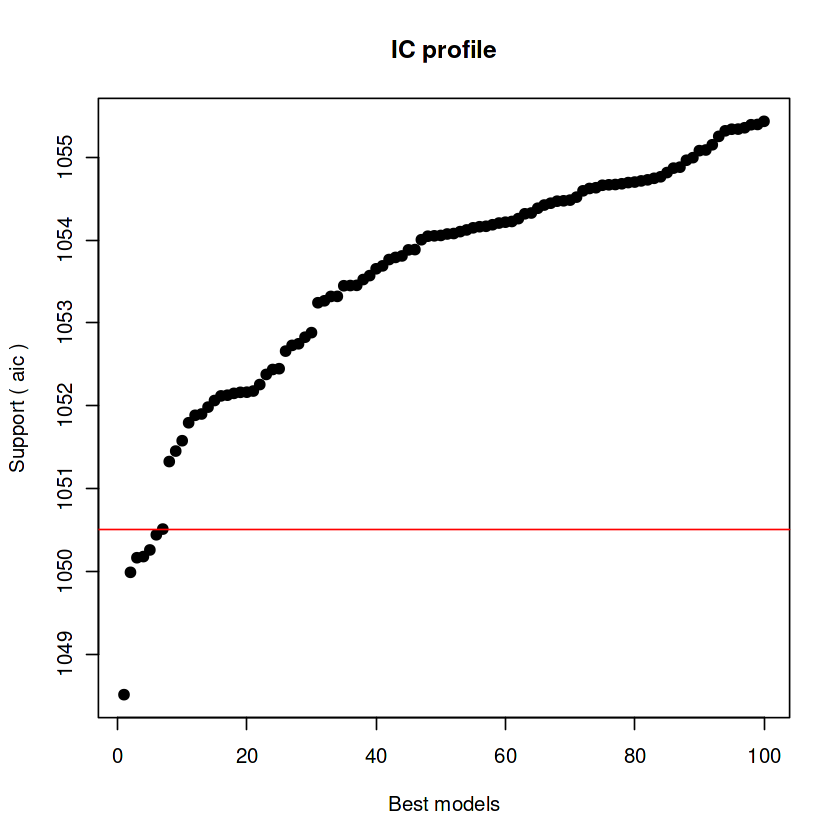


After 42100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.38520724666


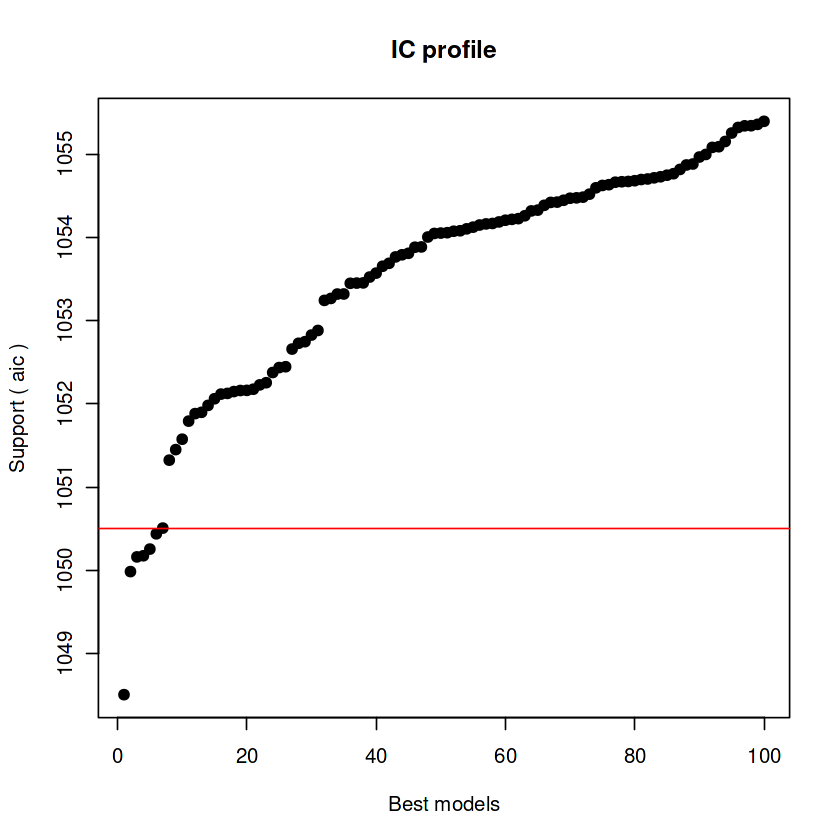


After 42150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.37689145962


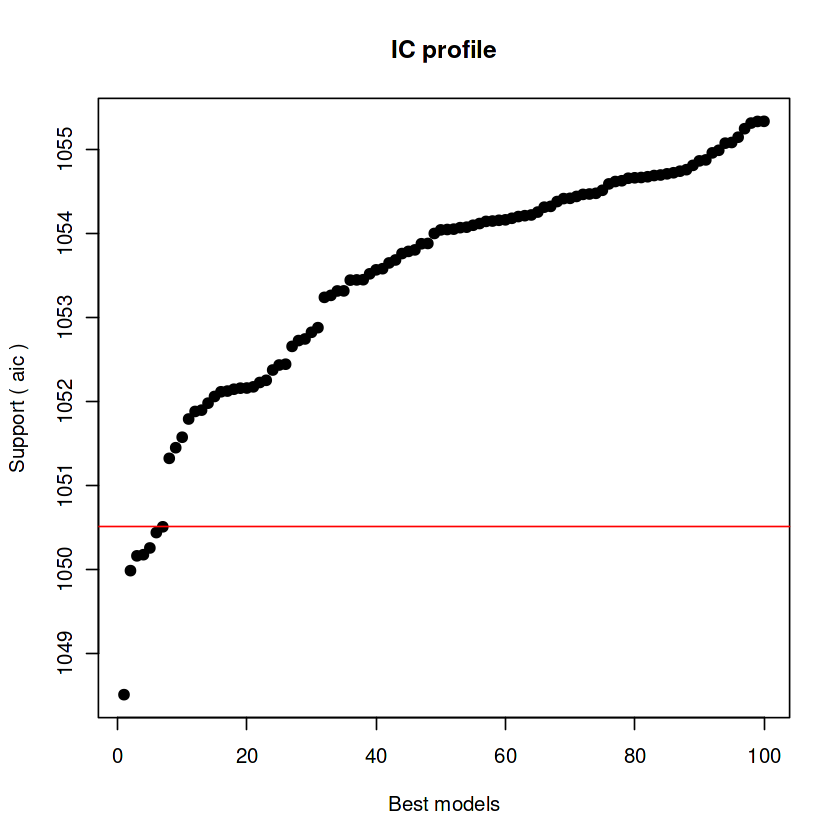


After 42200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.37249848154


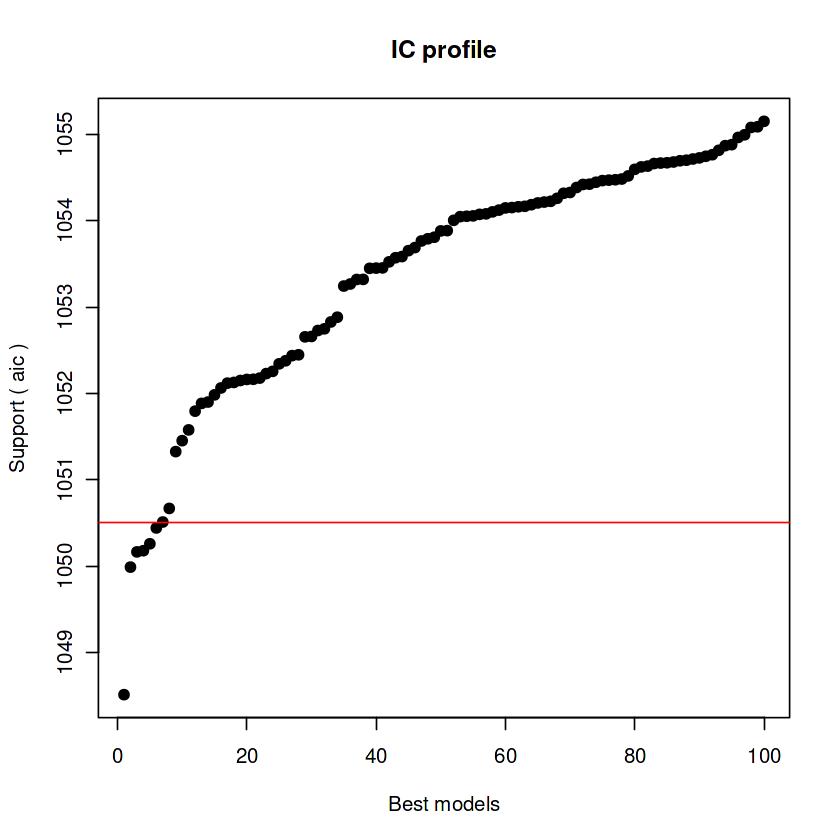


After 42250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.37249848154


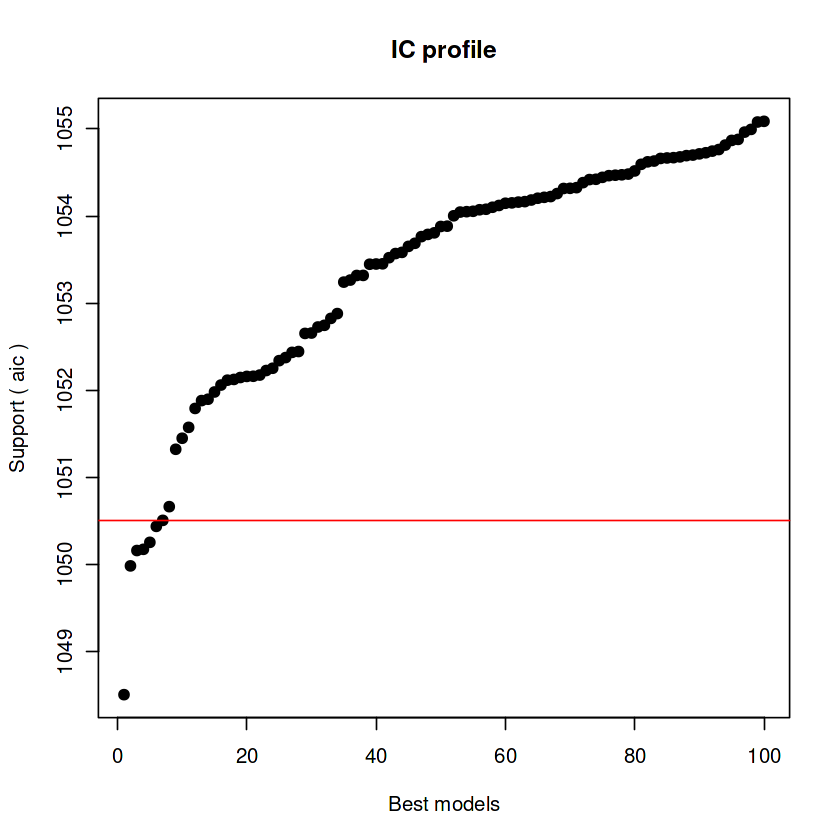


After 42300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.36339481984



After 42350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33315320039


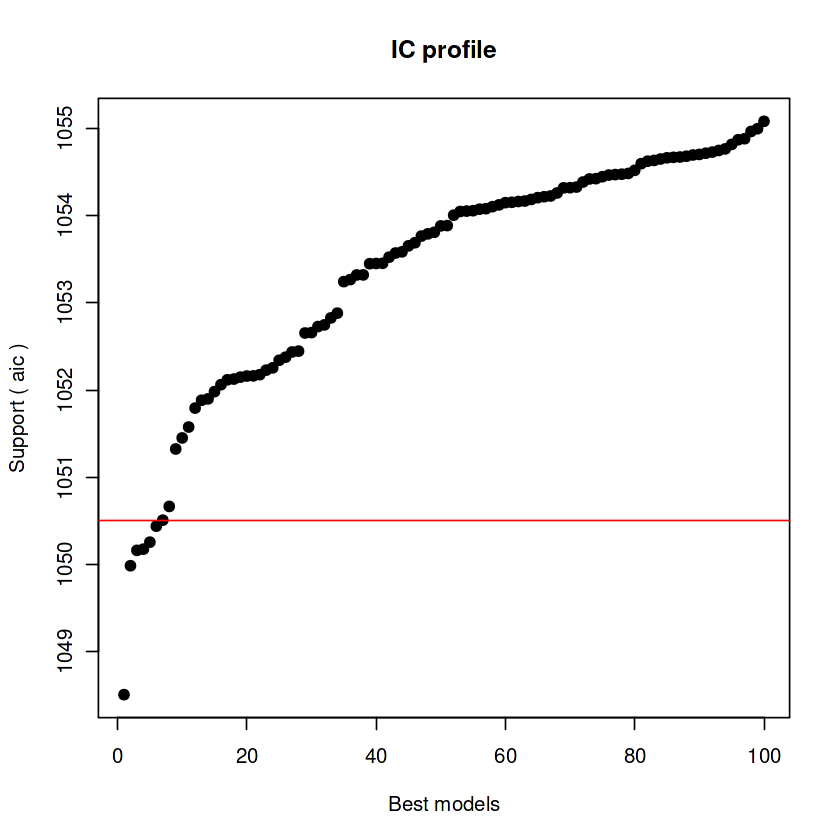


After 42400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476


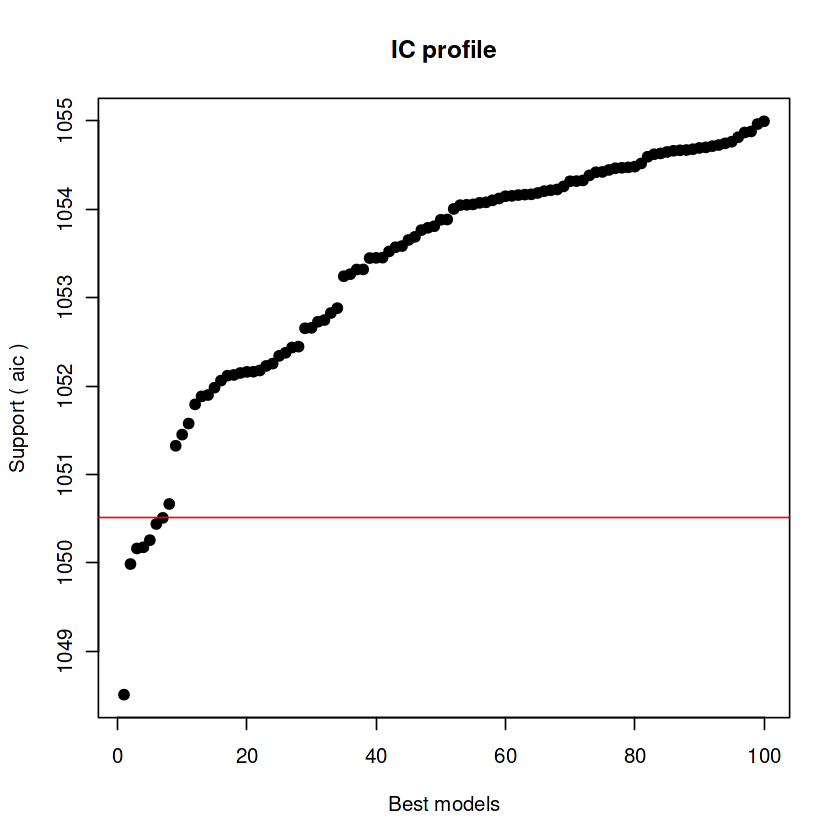


After 42450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476


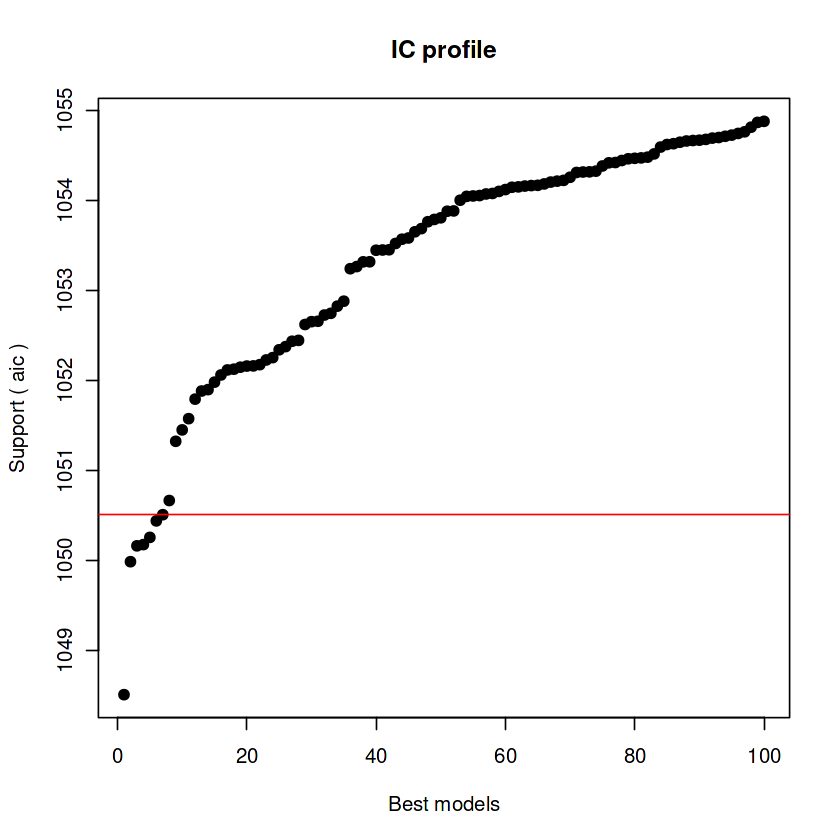


After 42500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 42550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 42600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 42650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 42700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 42750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 42800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 42850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 42900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 42950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 43950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 44950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 45950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 46950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 47950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 48950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 49950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 50000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.33041032476



After 50050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.32286978368



After 50100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.32286978368


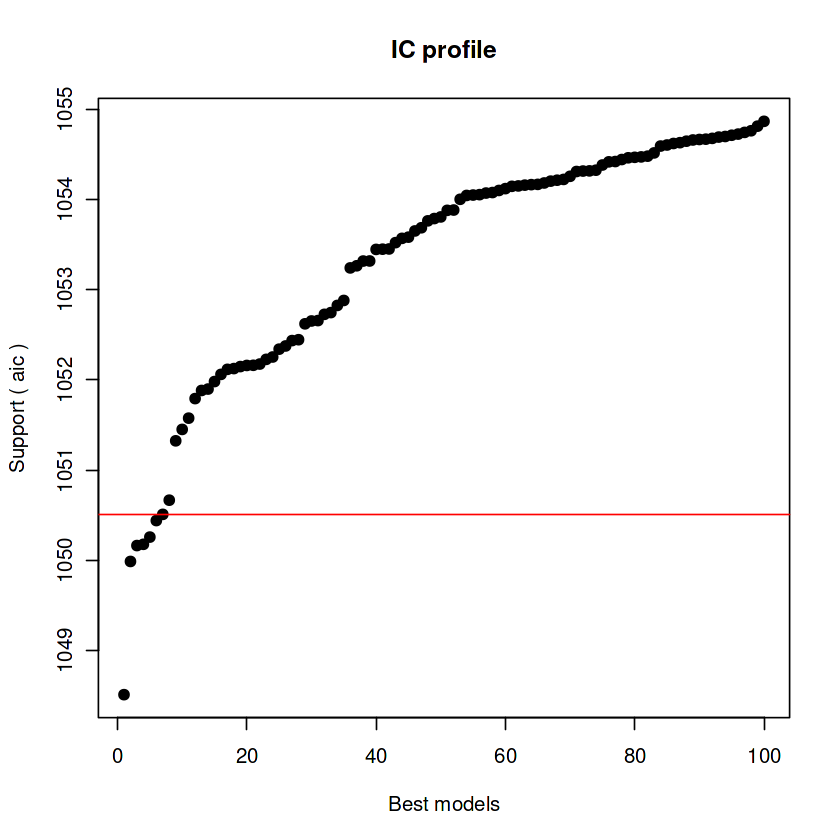


After 50150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.32286978368



After 50200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.32286978368



After 50250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.32286978368



After 50300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.32286978368



After 50350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.32286978368



After 50400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.32286978368



After 50450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.30905044978



After 50500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.30387011283


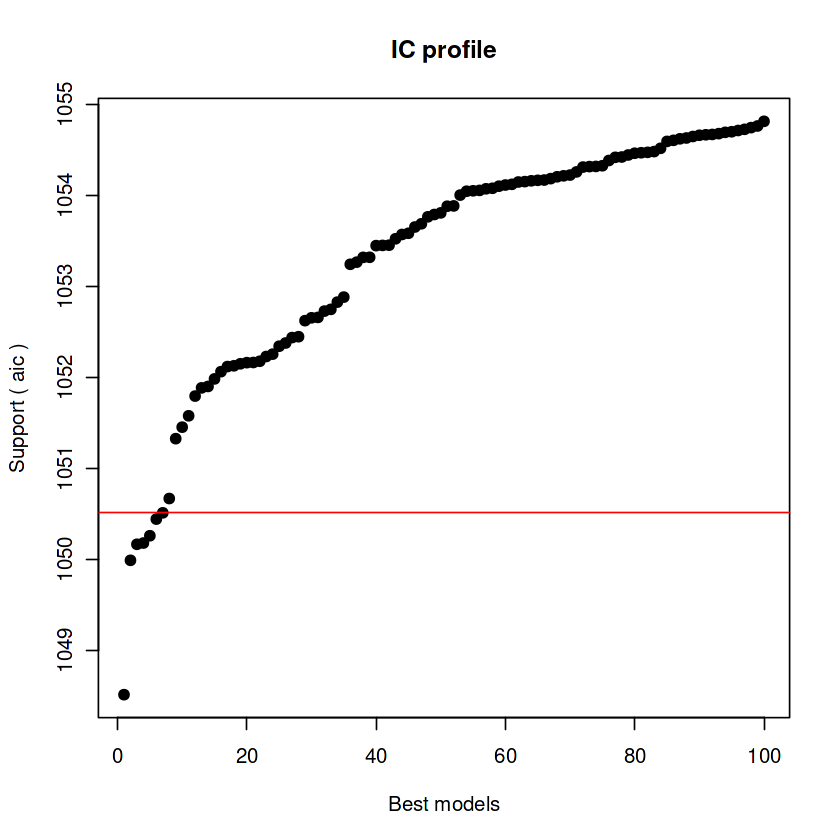


After 50550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.2679203861


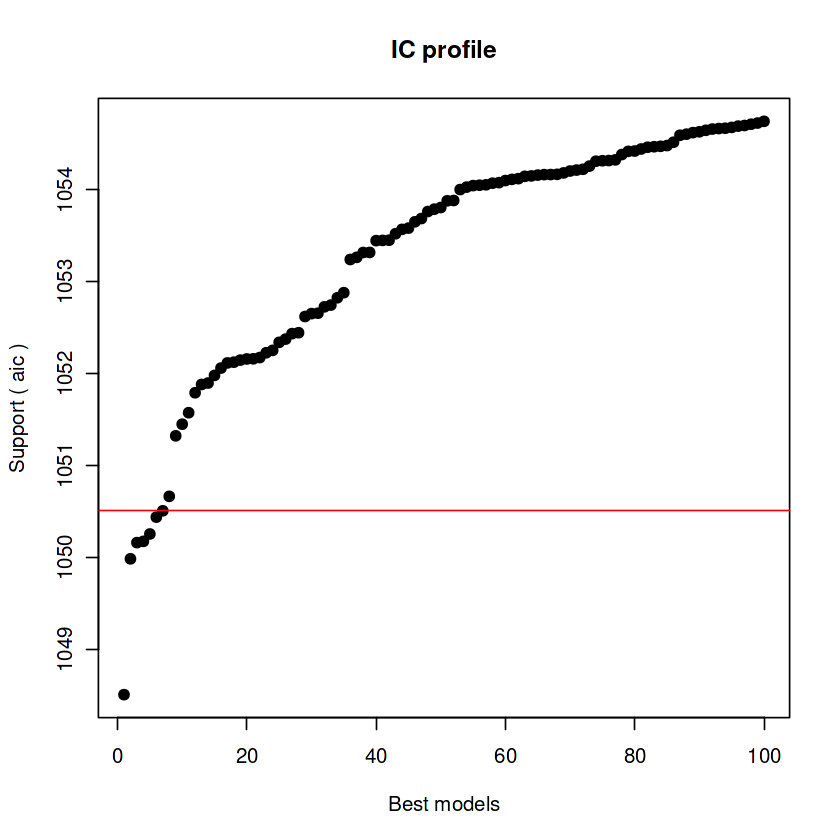


After 50600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26747492487


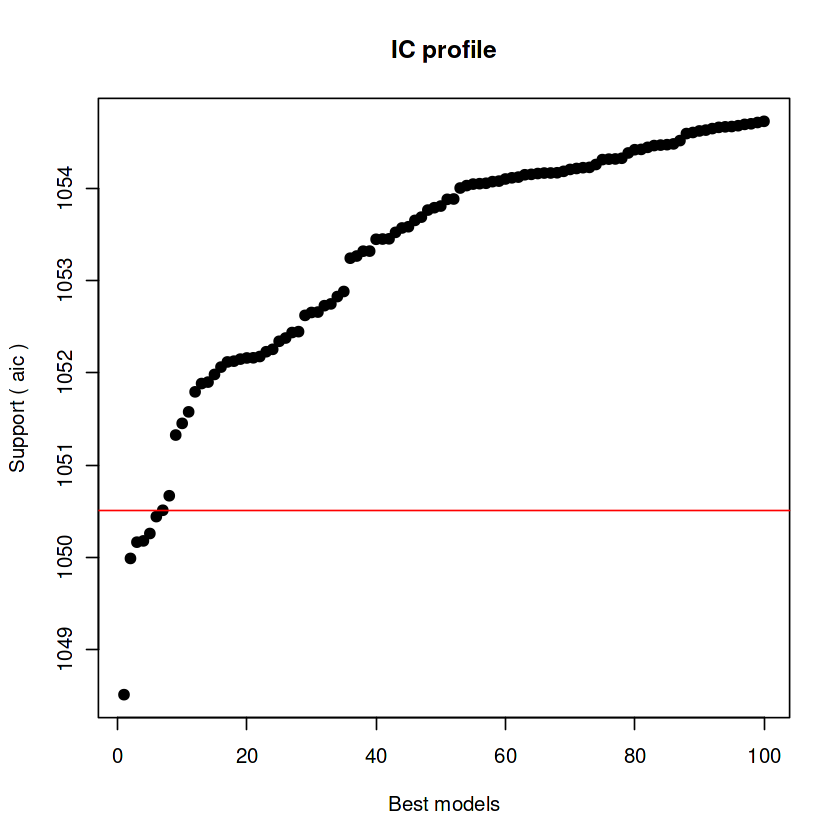


After 50650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26747492487


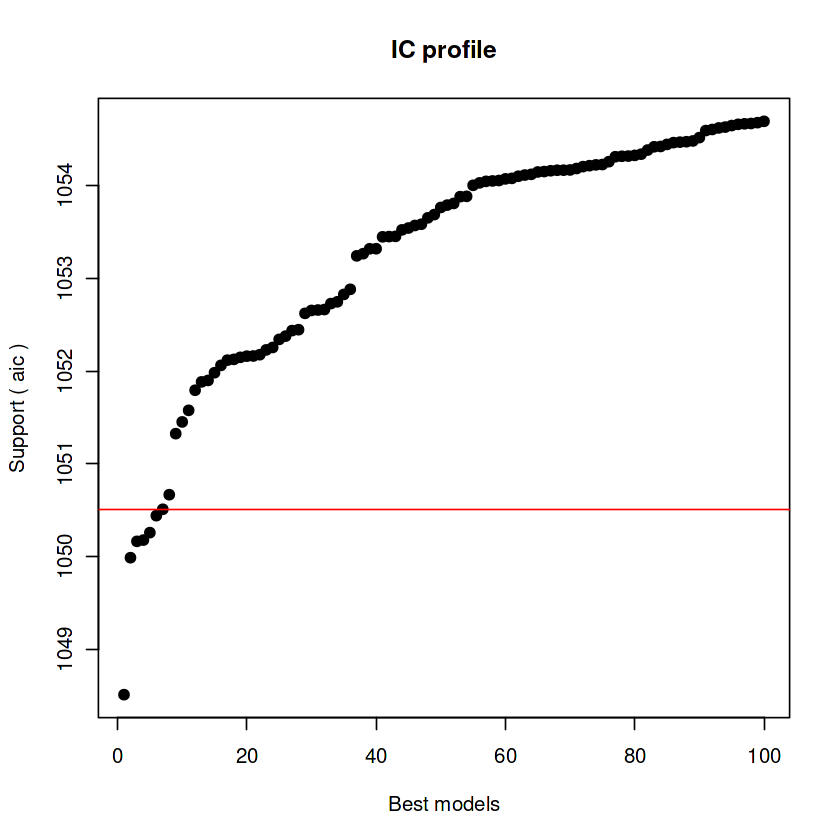


After 50700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26747492487



After 50750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26747492487



After 50800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26747492487



After 50850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 50900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112


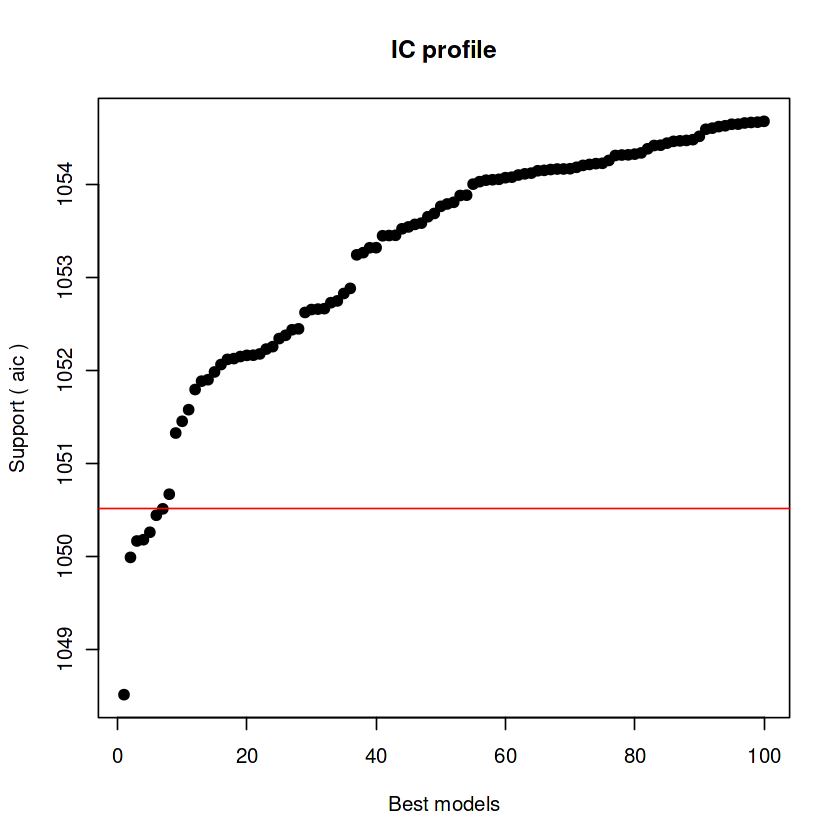


After 50950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 51950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 52950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 53950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26690226112



After 54800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 54850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063


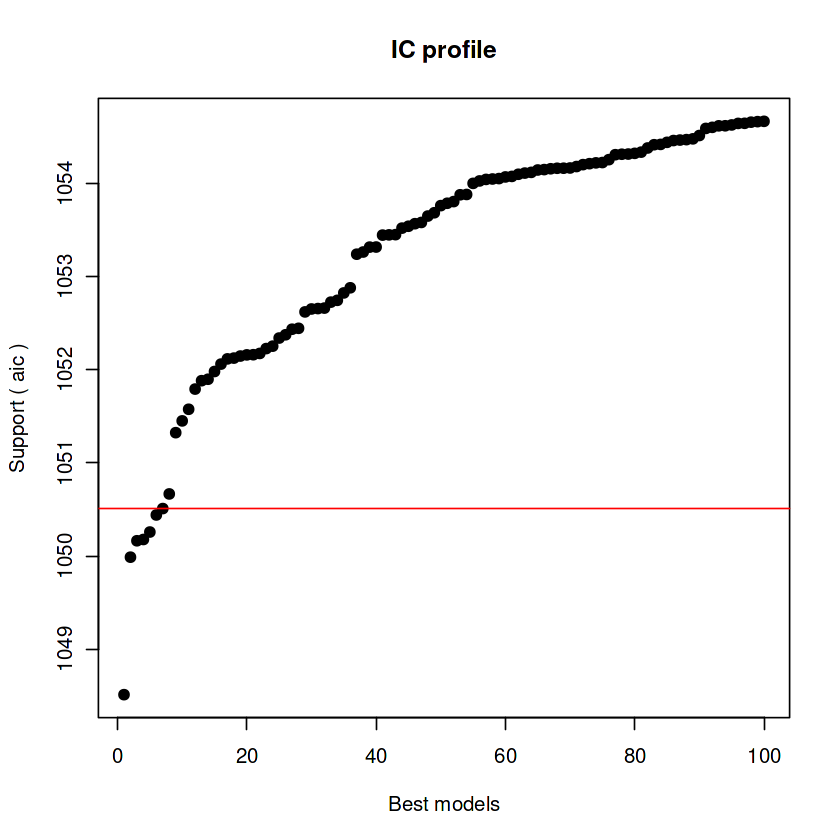


After 54900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 54950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 55950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 56950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 57950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 58000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 58050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 58100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 58150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 58200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 58250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 58300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 58350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 58400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.26368970063



After 58450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.25273374453



After 58500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.22198456674


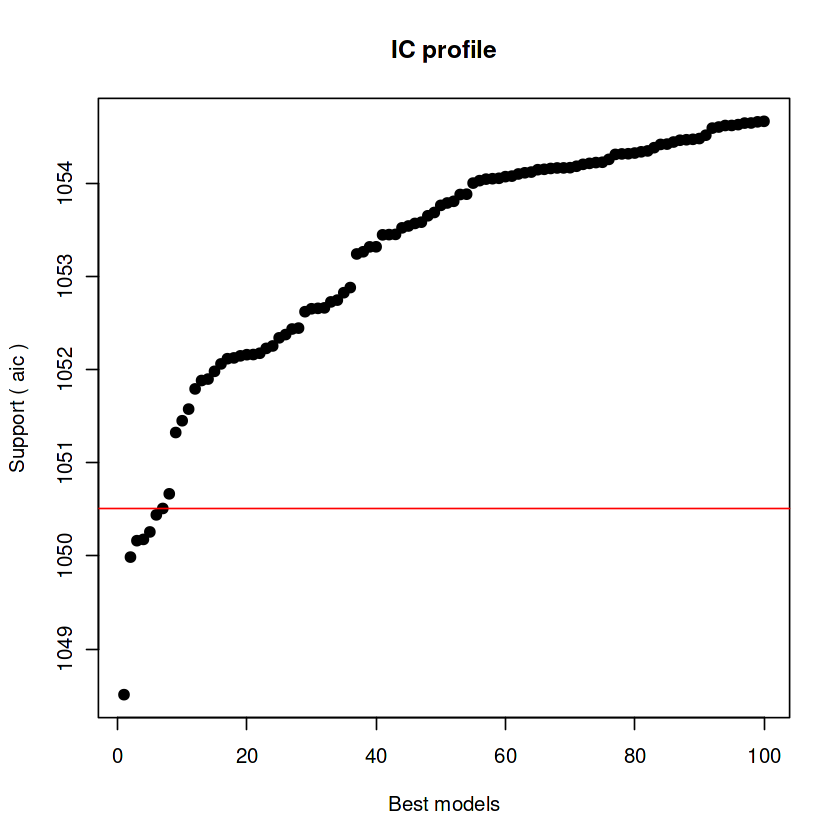


After 58550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.21203415493


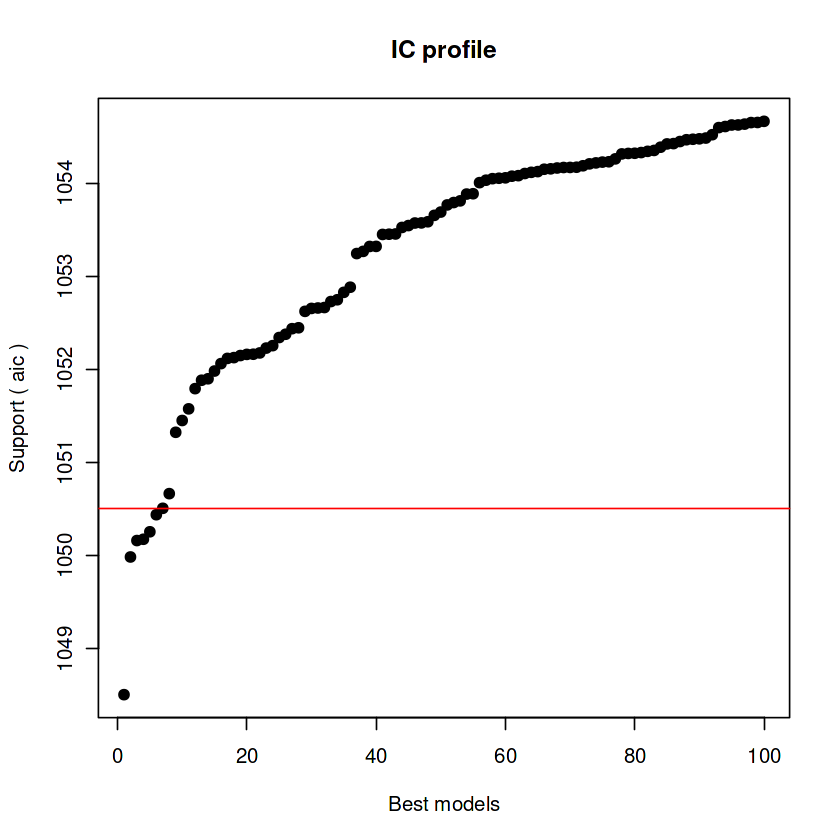


After 58600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.21203415493


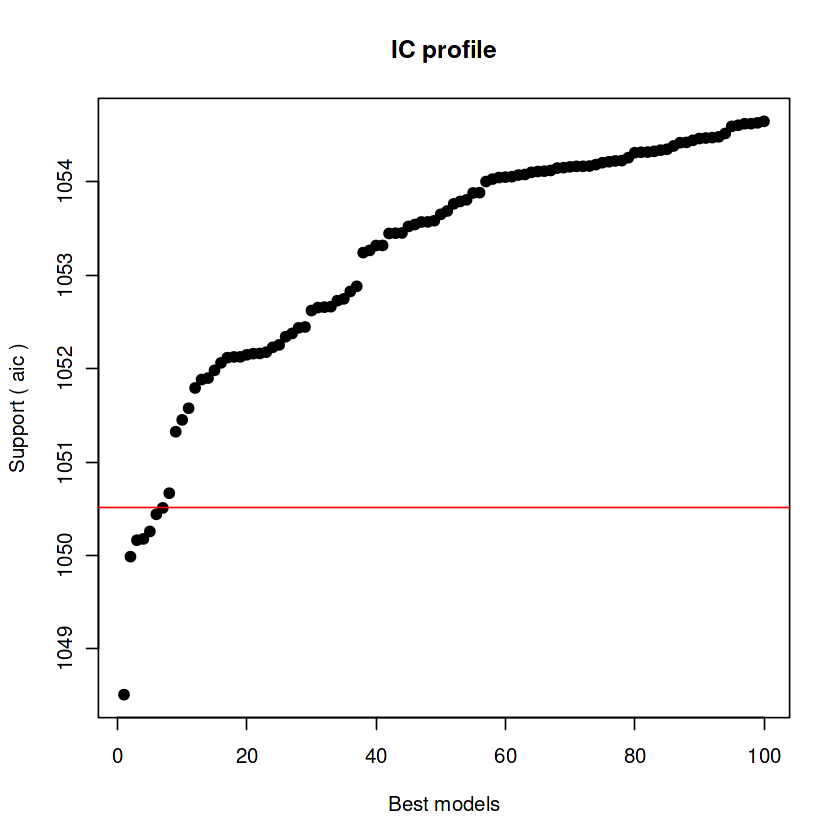


After 58650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.21203415493



After 58700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.21203415493



After 58750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.2059491903



After 58800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.2059491903


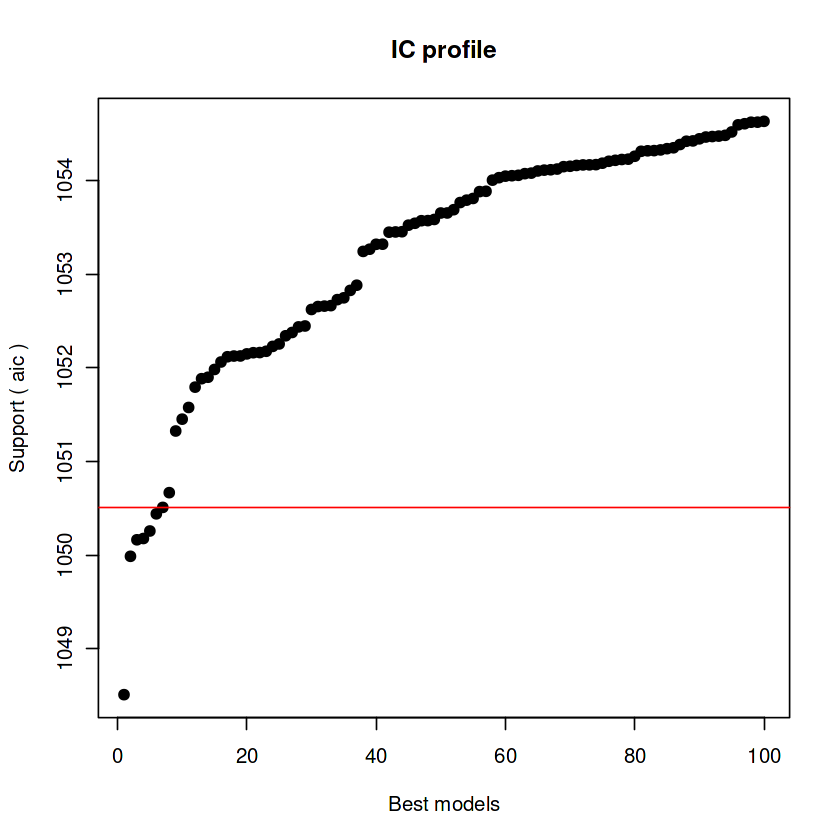


After 58850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.2059491903



After 58900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.20470336526



After 58950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.17821336225


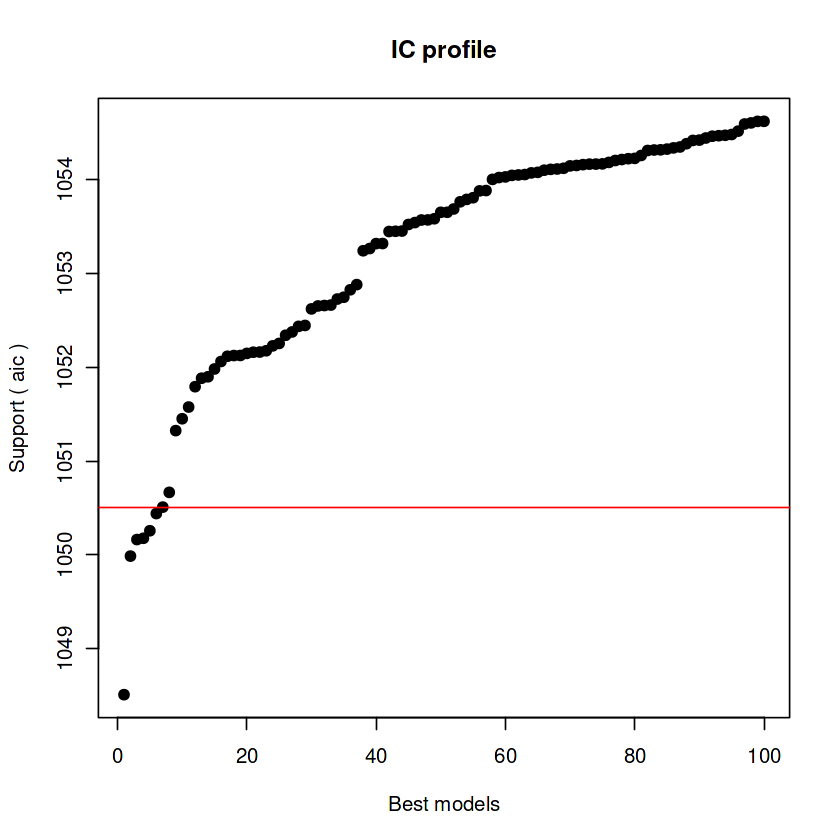


After 59000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.15261816718


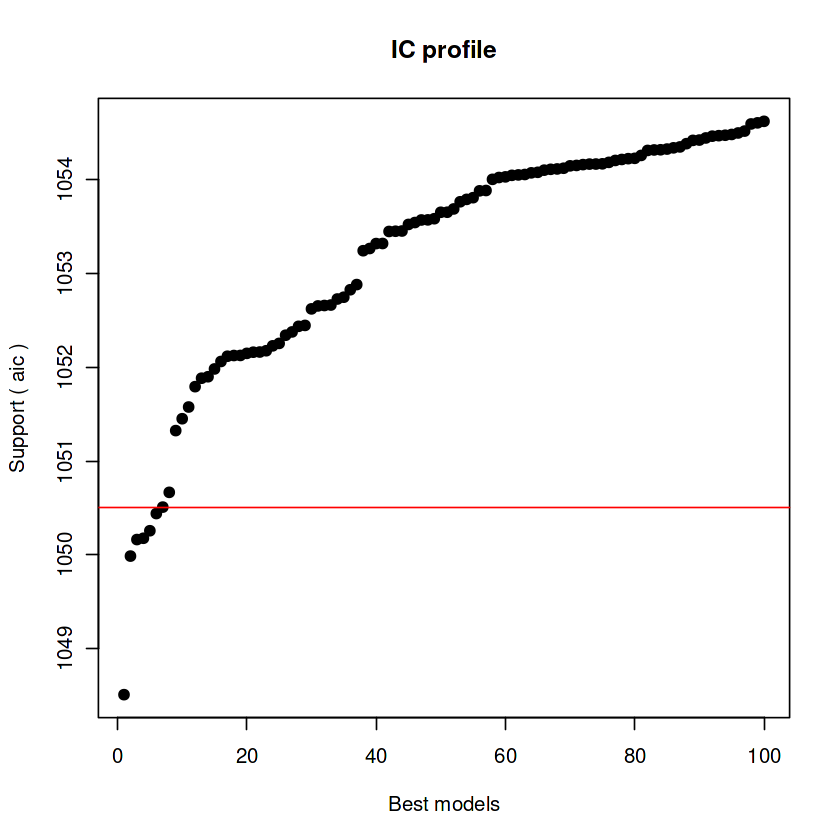


After 59050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.06099795755


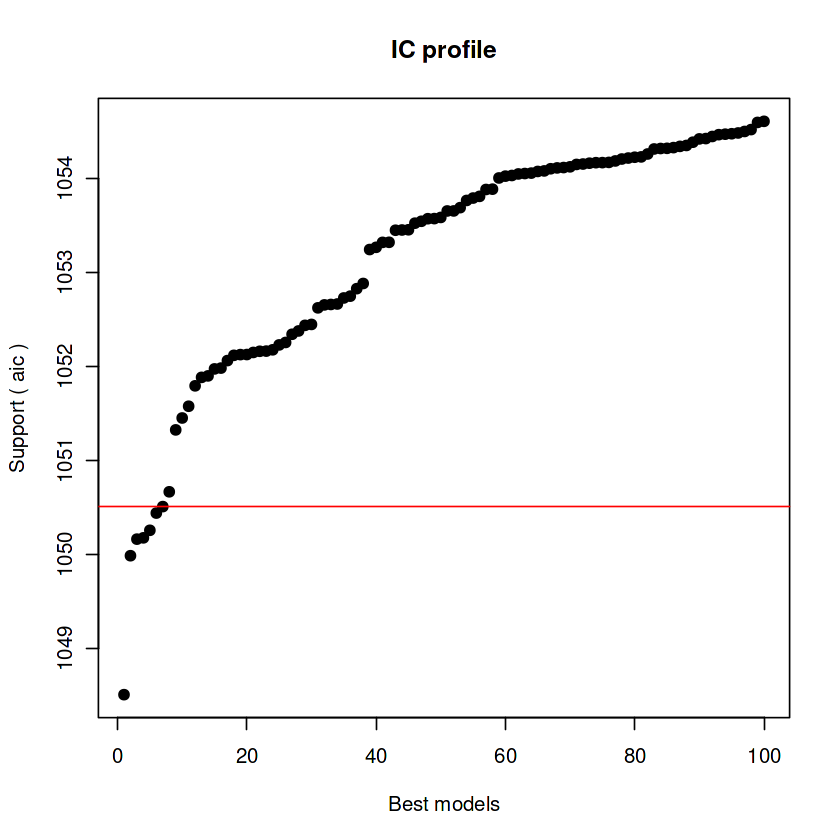


After 59100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.05186326872


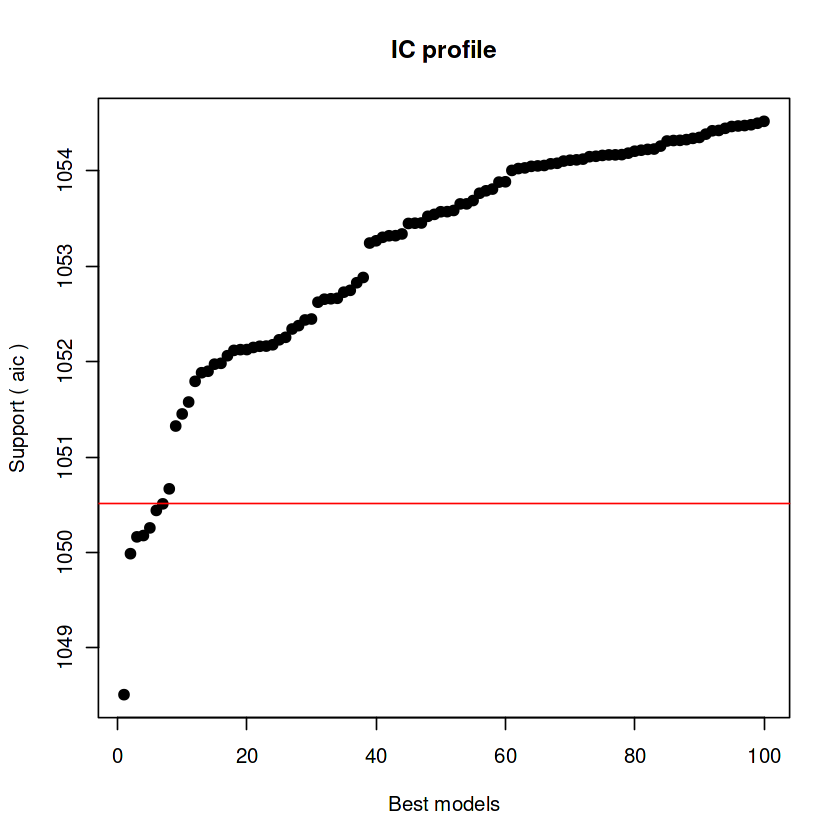


After 59150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.05186326872


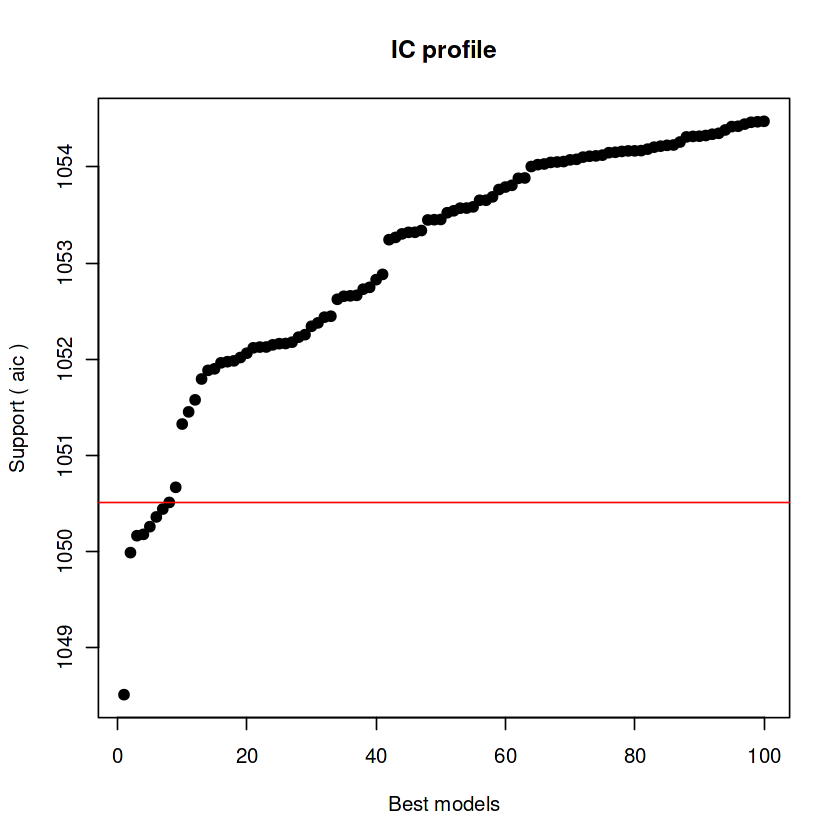


After 59200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.05186326872



After 59250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.04602083924



After 59300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01947647173


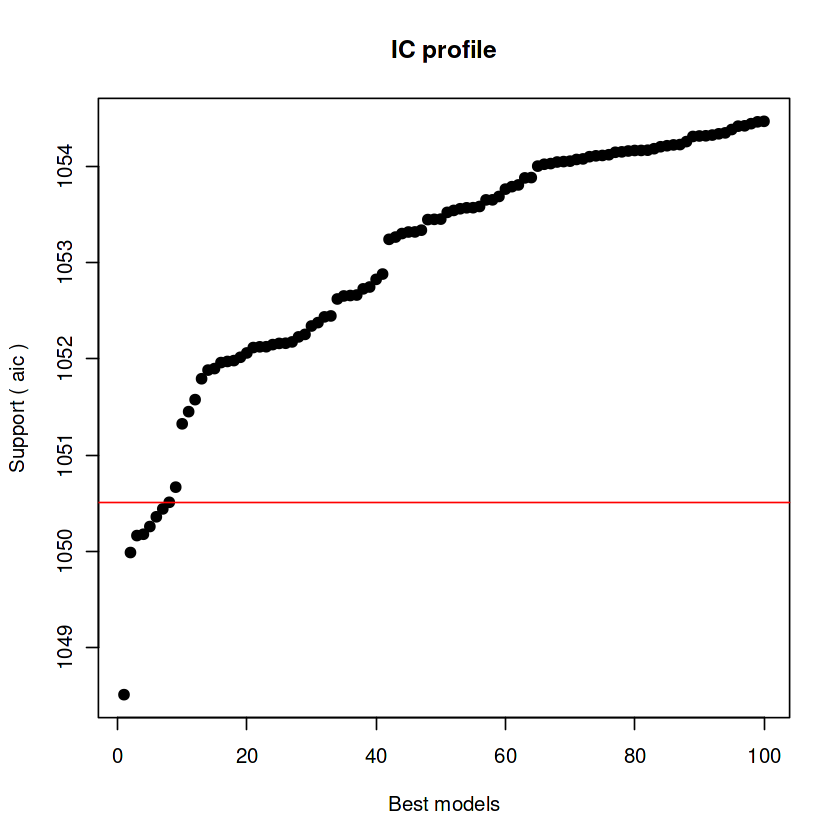


After 59350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922


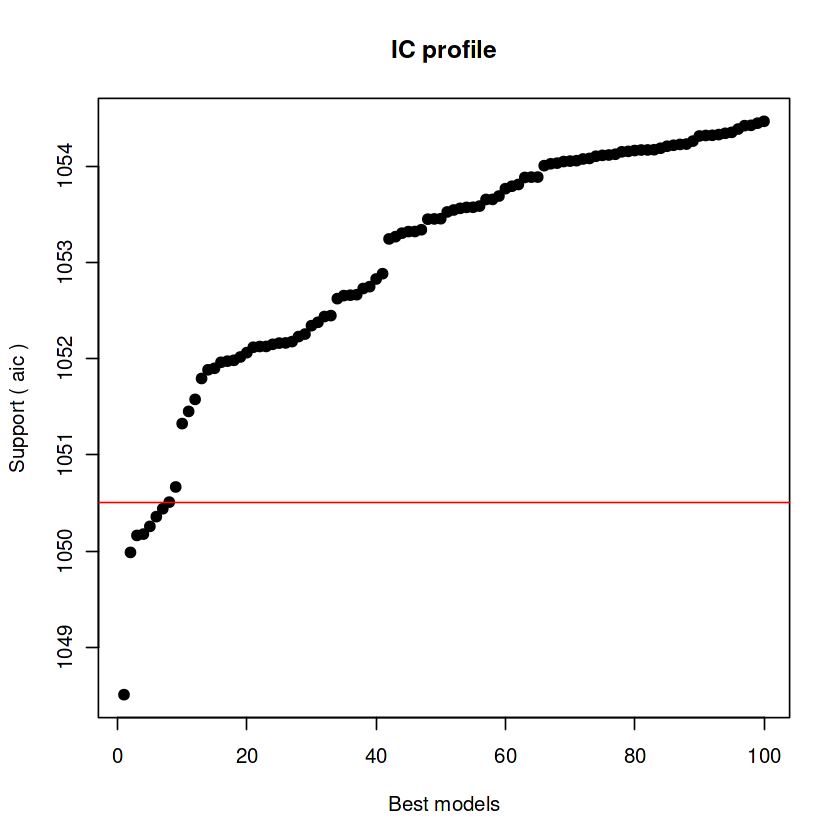


After 59400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922


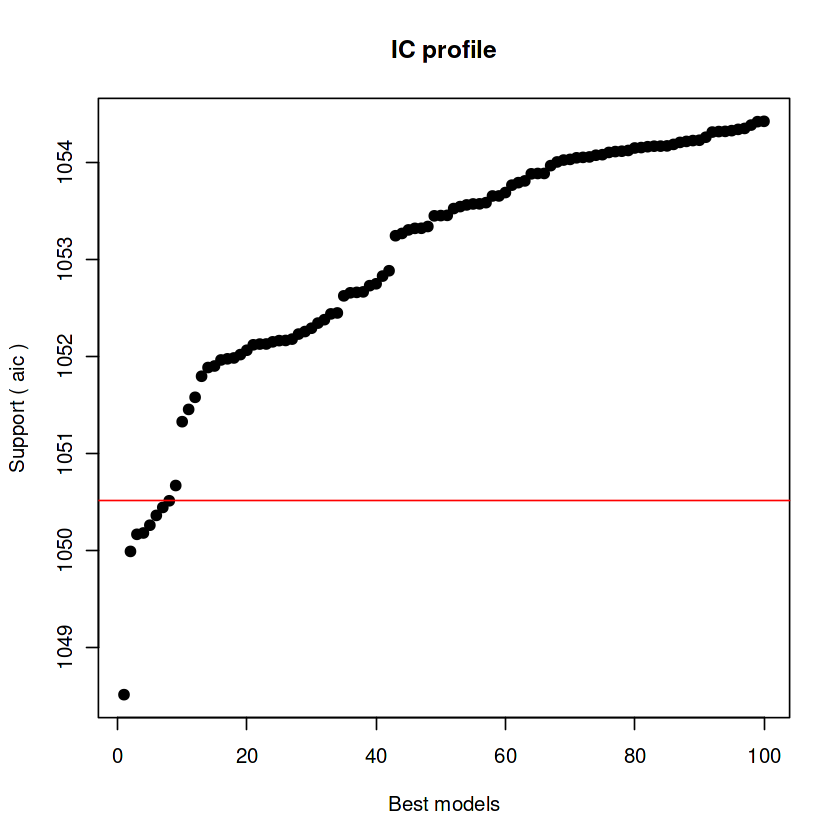


After 59450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 59500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 59550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 59600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 59650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 59700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 59750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 59800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 59850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 59900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 59950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 60950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 61950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 62950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 63950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 64950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 65950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 66950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01380462922



After 67000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01084610969



After 67050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01084610969


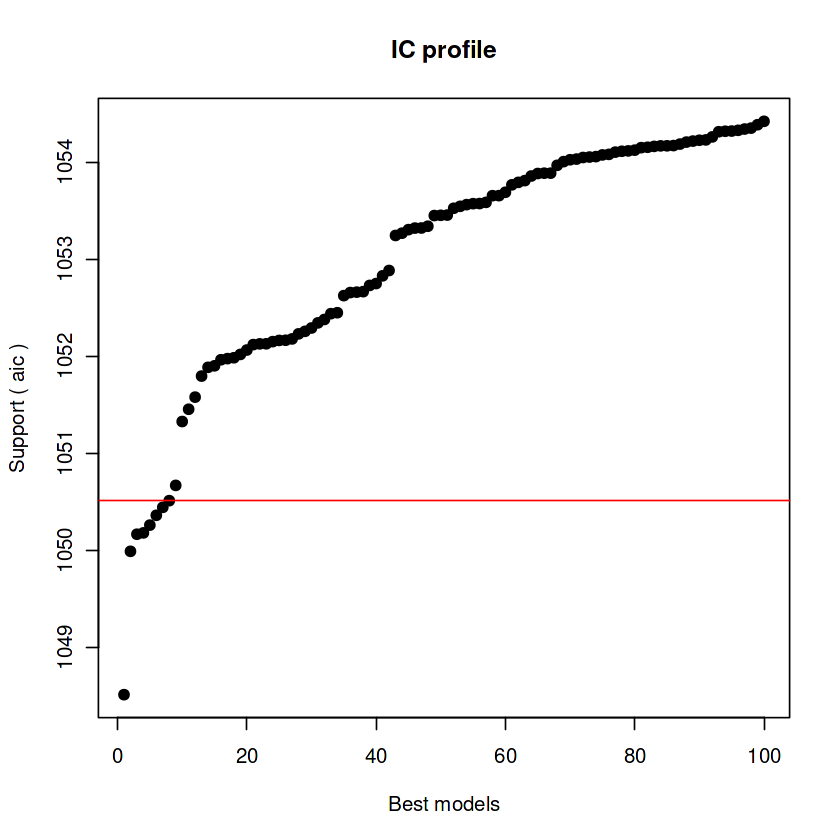


After 67100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01084610969



After 67150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01084610969



After 67200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01084610969



After 67250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01084610969



After 67300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01084610969



After 67350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01084610969



After 67400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.01084610969



After 67450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1053.00667062932



After 67500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.98345439783


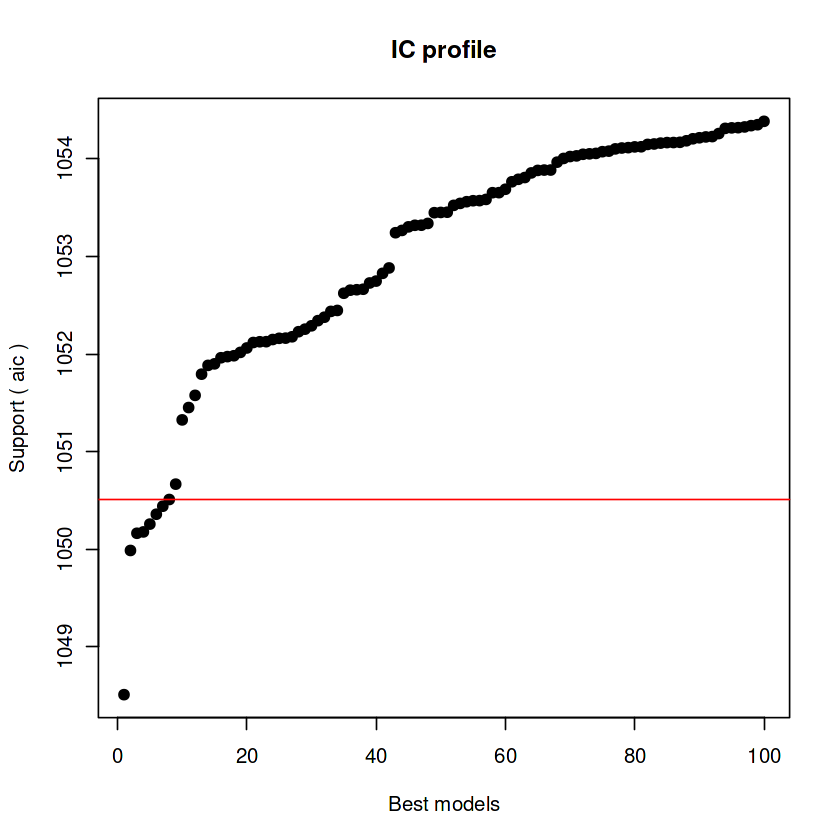


After 67550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97980275193


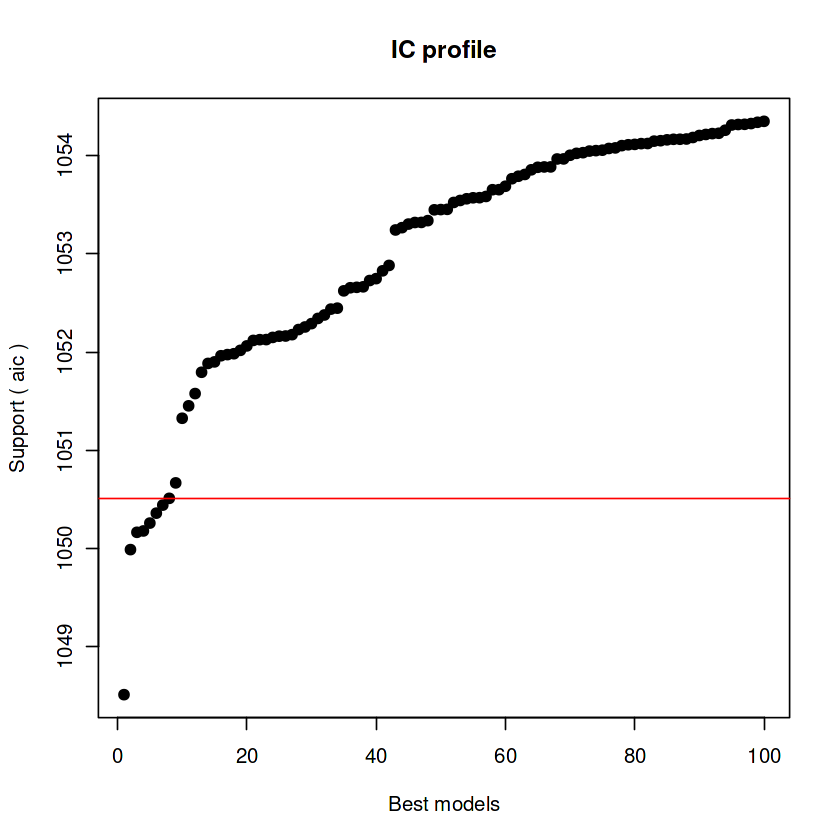


After 67600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97980275193


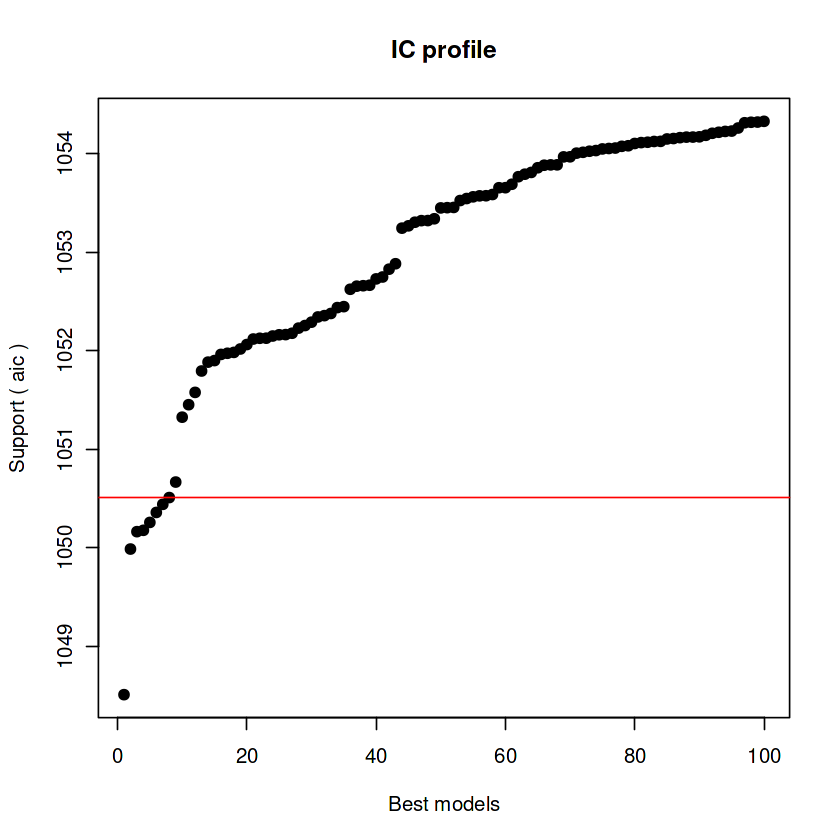


After 67650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97980275193



After 67700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97980275193



After 67750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97980275193



After 67800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97939608642



After 67850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97939608642


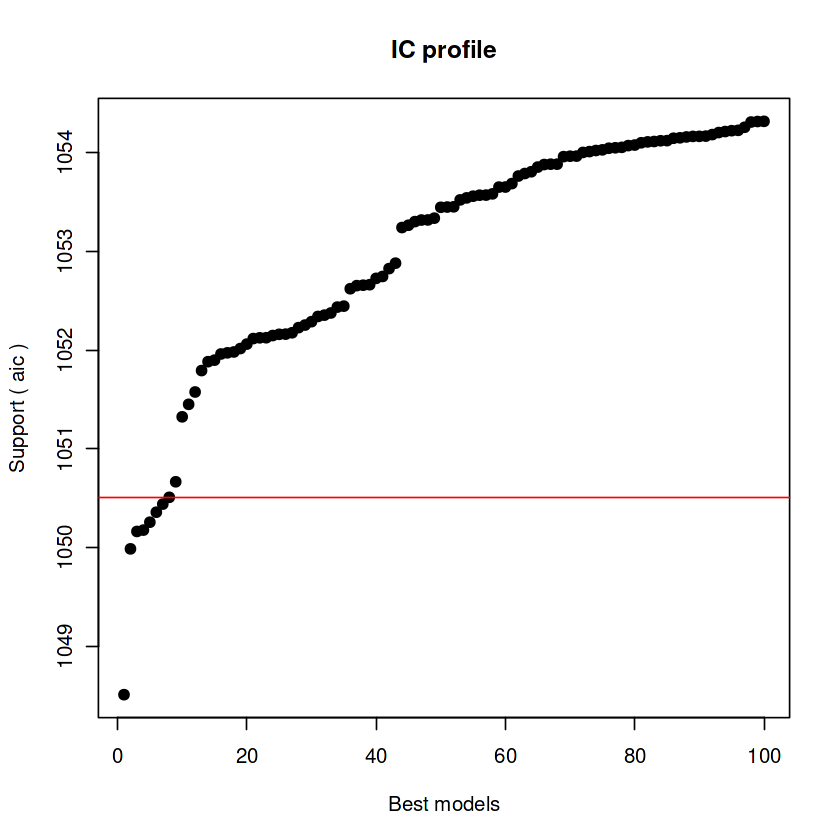


After 67900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97939608642



After 67950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97939608642



After 68000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97939608642



After 68050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97939608642



After 68100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97939608642



After 68150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97939608642



After 68200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97939608642



After 68250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.97939608642



After 68300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.94634901648



After 68350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.94634901648


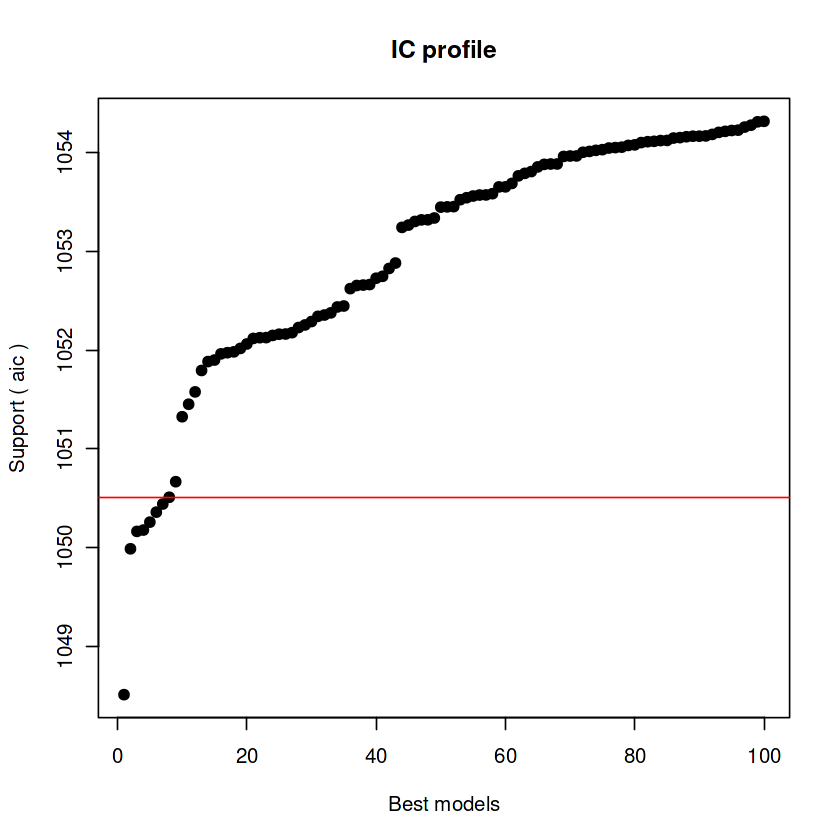


After 68400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.94634901648



After 68450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.94634901648



After 68500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.94634901648



After 68550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.94634901648



After 68600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.94634901648



After 68650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.94634901648



After 68700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.88915185687



After 68750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.887436684


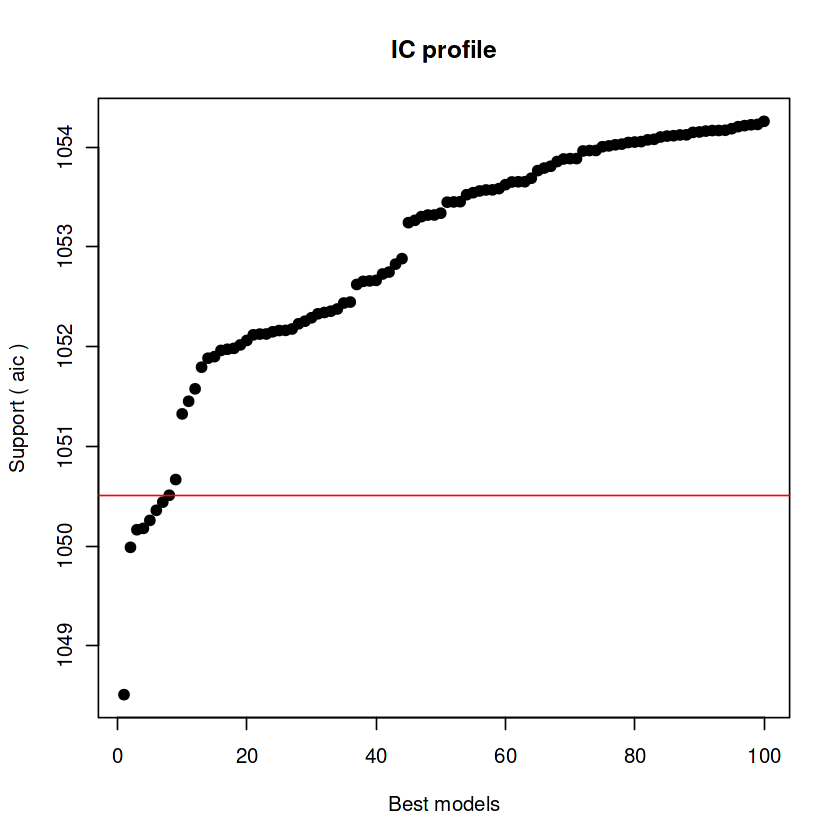


After 68800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.88142871396


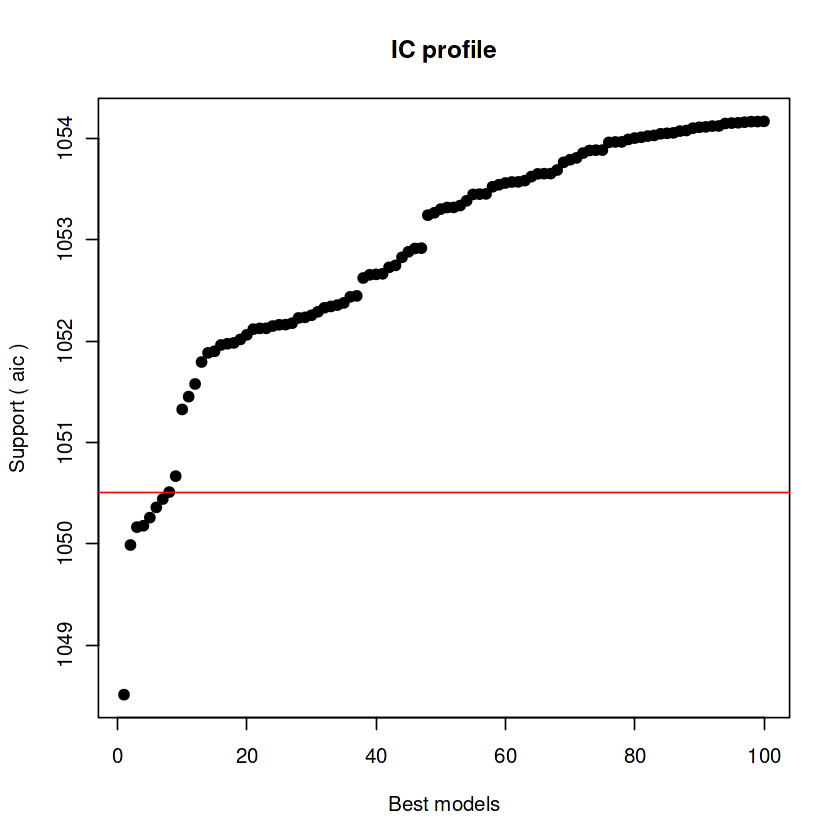


After 68850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.75623706054


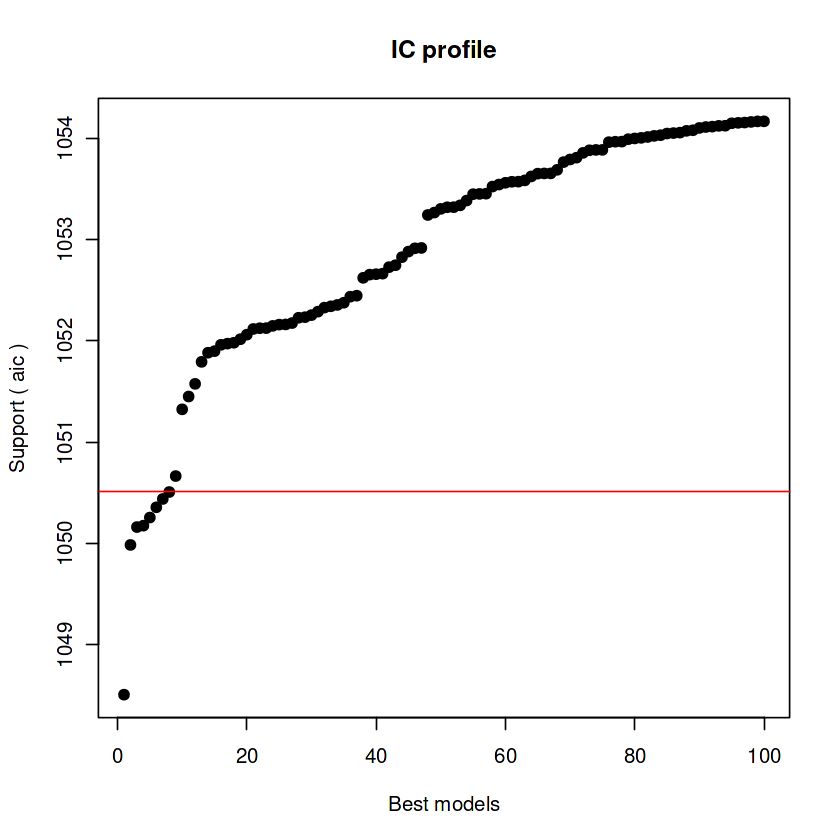


After 68900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.73509587263


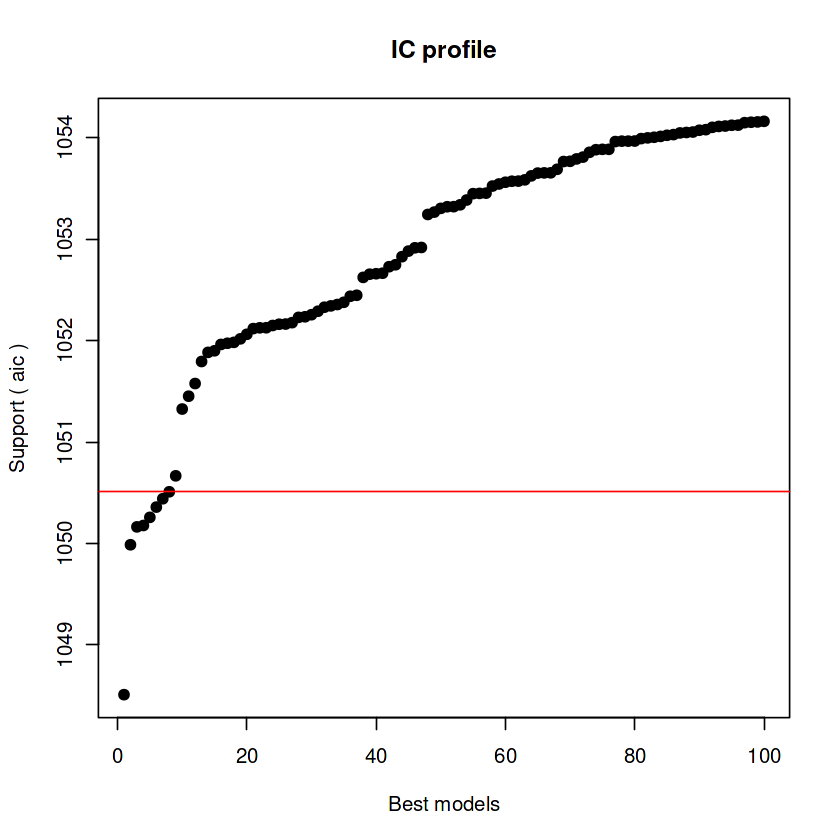


After 68950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.73307661439


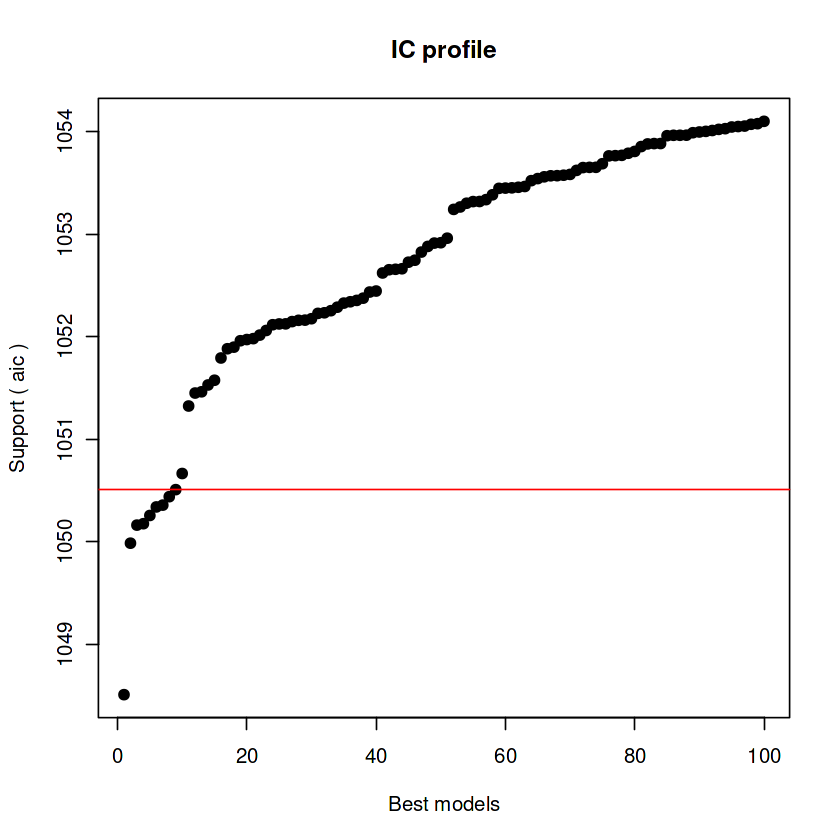


After 69000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.72614950854


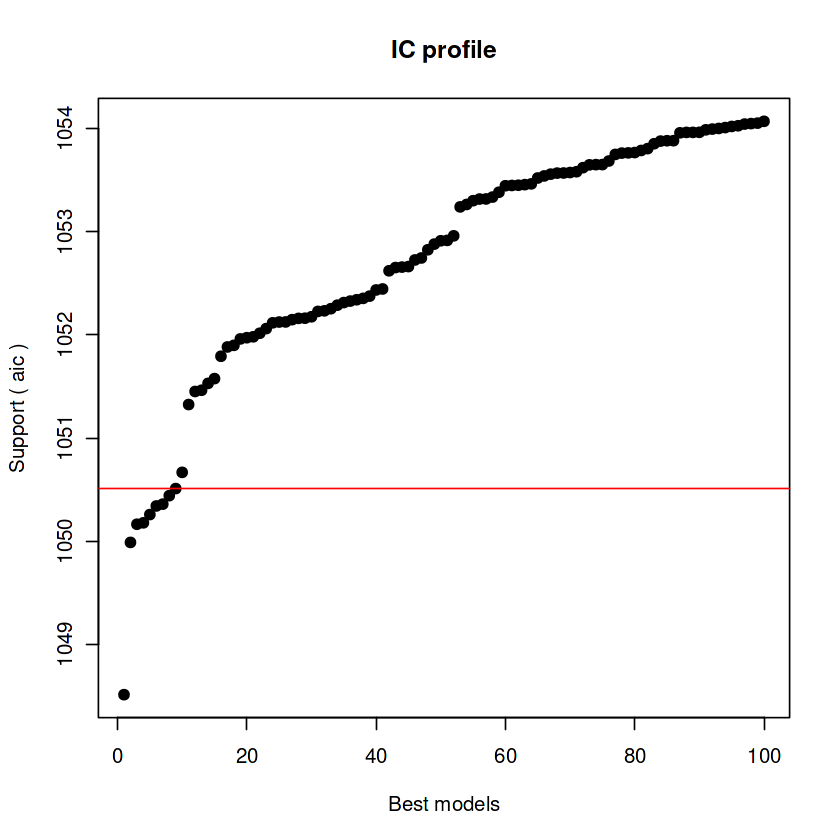


After 69050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.72614950854


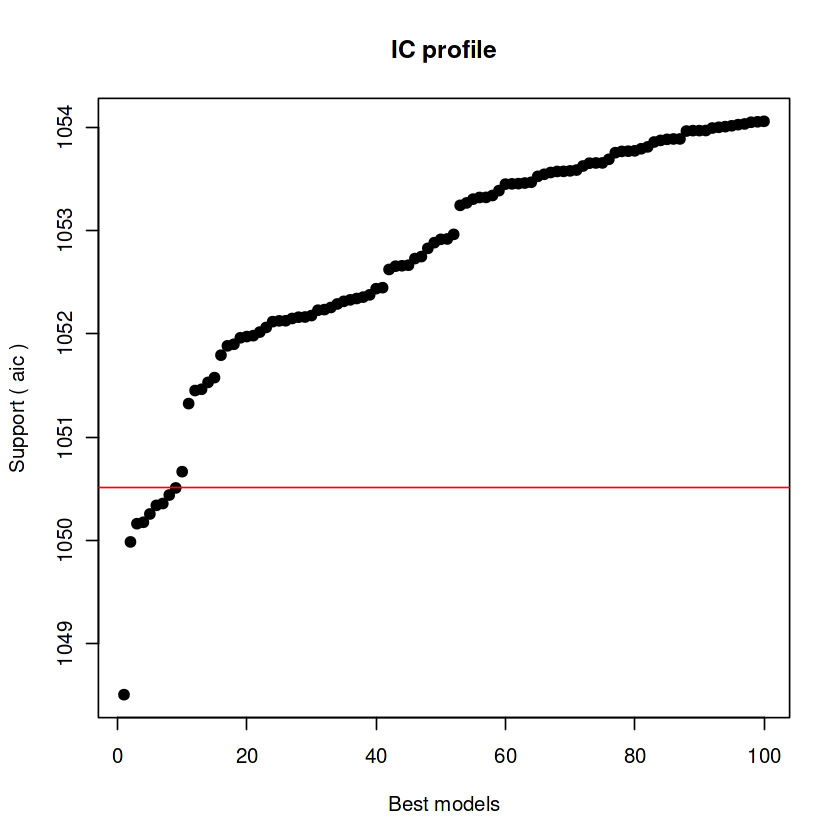


After 69100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.68320331242



After 69150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.67723651272


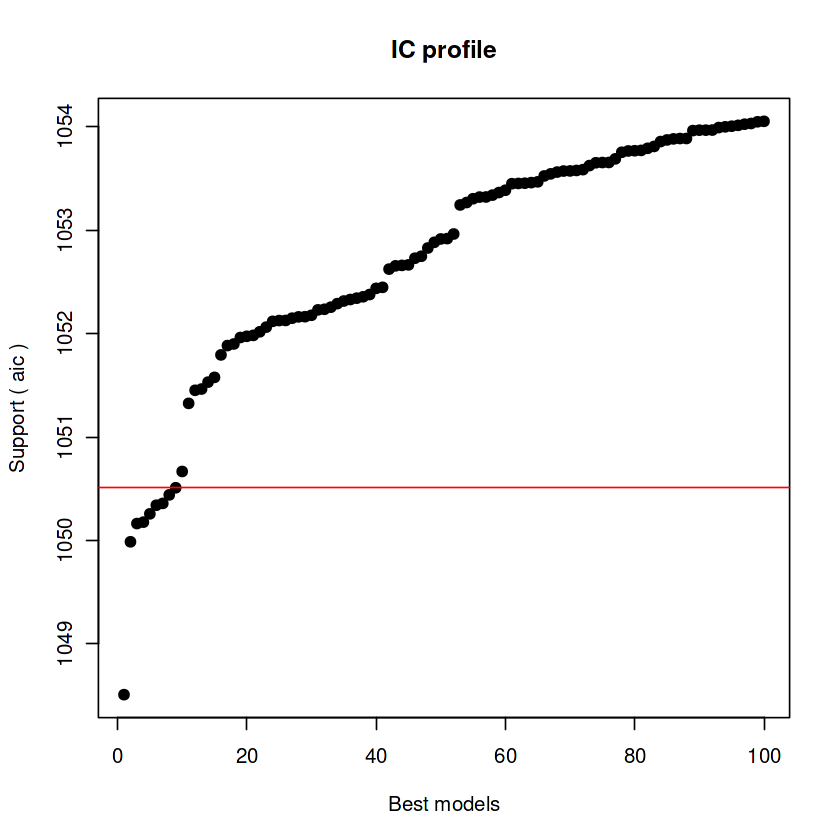


After 69200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.67723651272


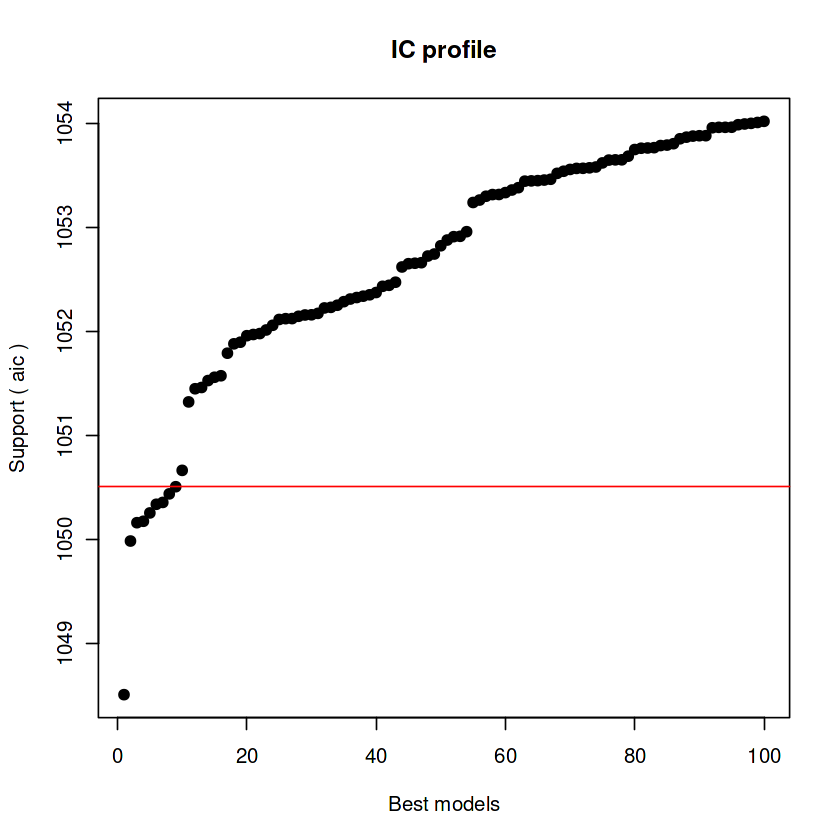


After 69250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.66717401041



After 69300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.66717401041


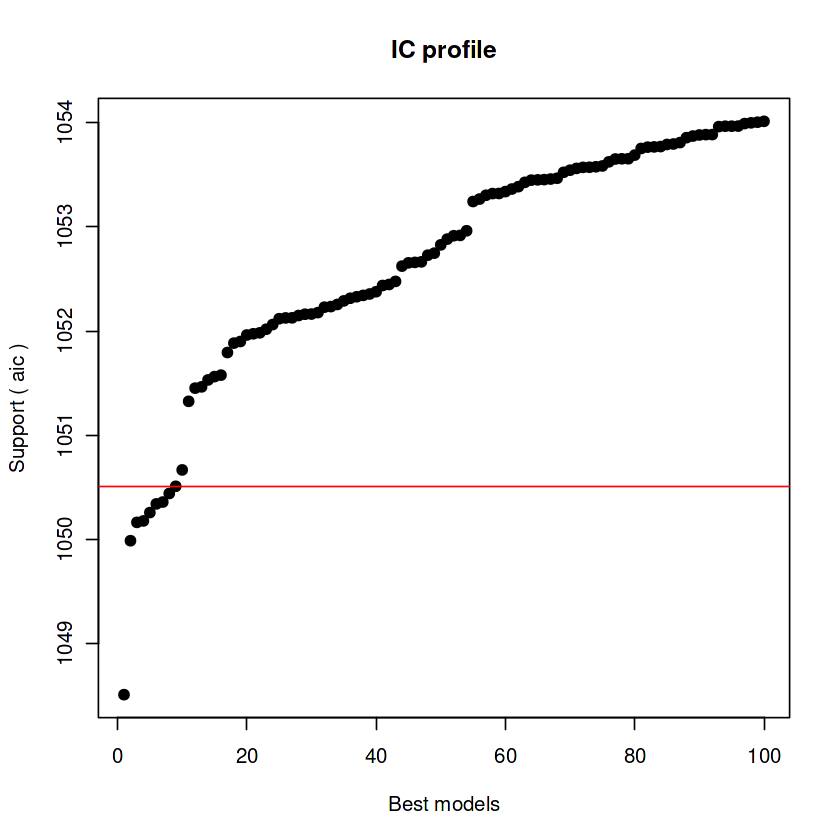


After 69350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.64803098169



After 69400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.61630526281


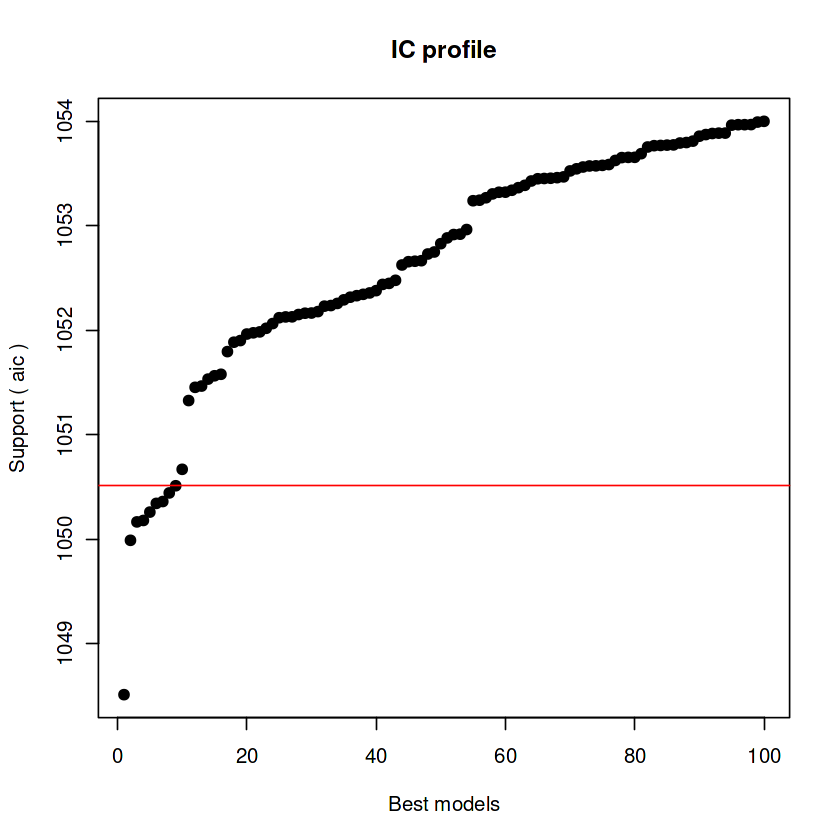


After 69450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.61630526281


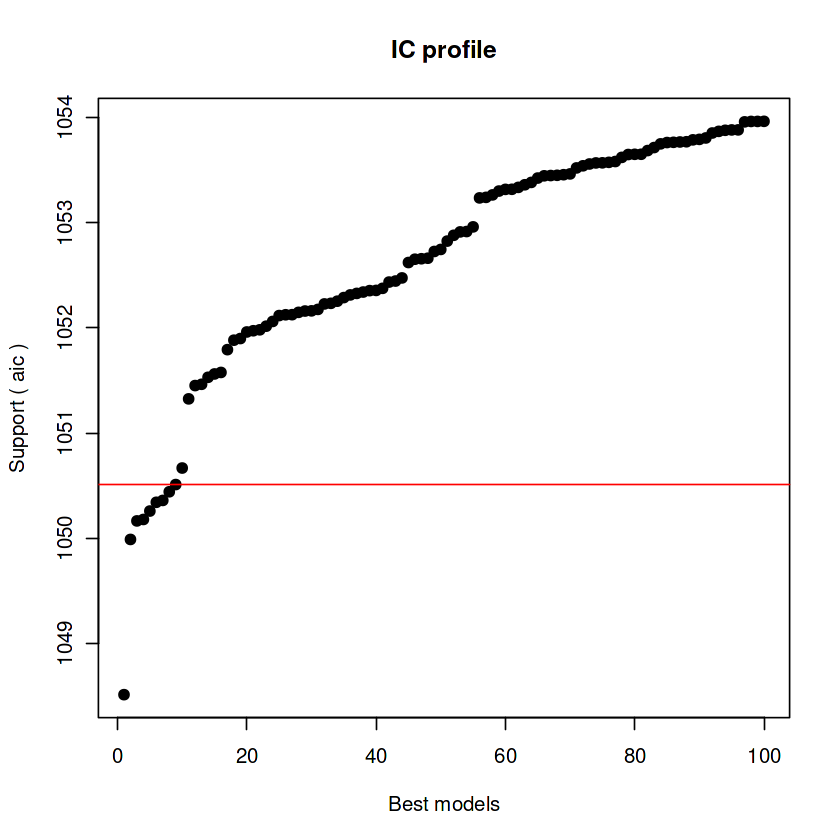


After 69500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.5665648817



After 69550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.5633249266


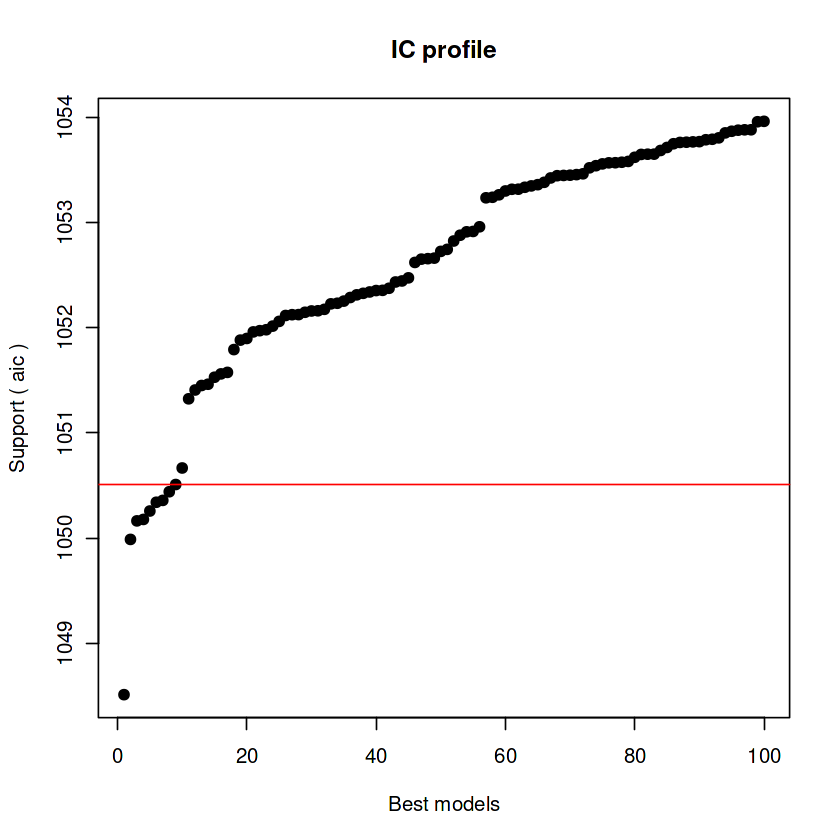


After 69600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.55583643273


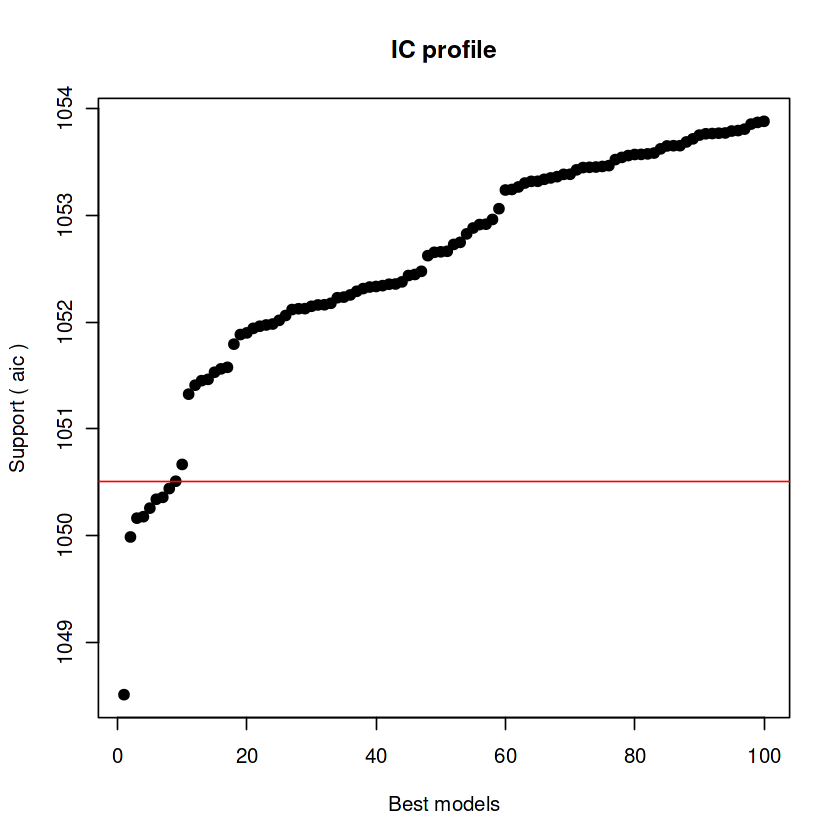


After 69650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.43617723992


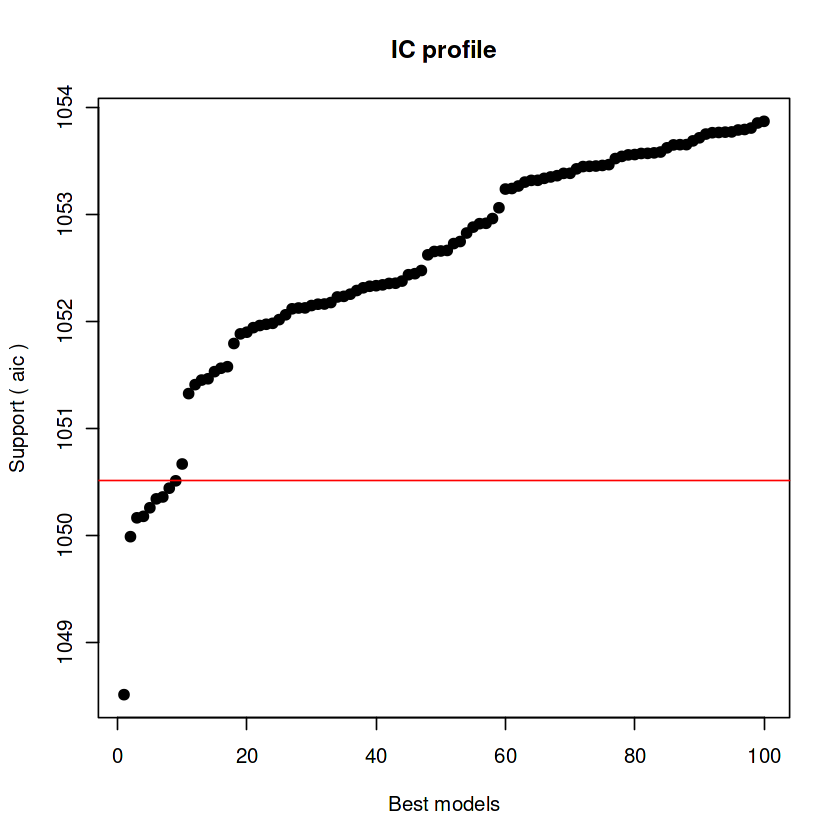


After 69700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.43617723992


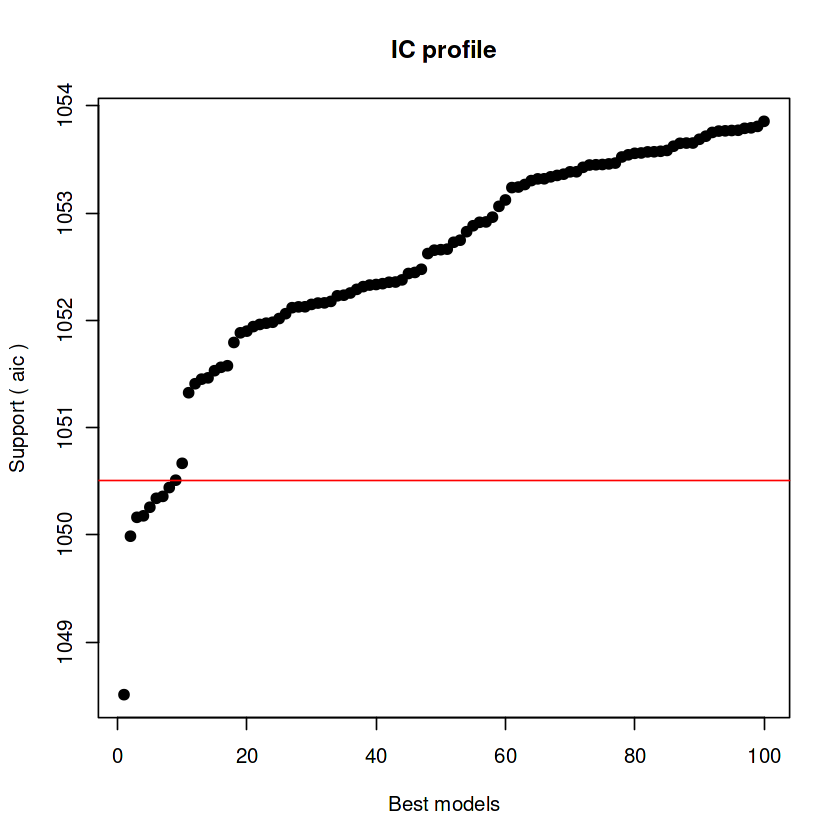


After 69750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.39298328218



After 69800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.39298328218


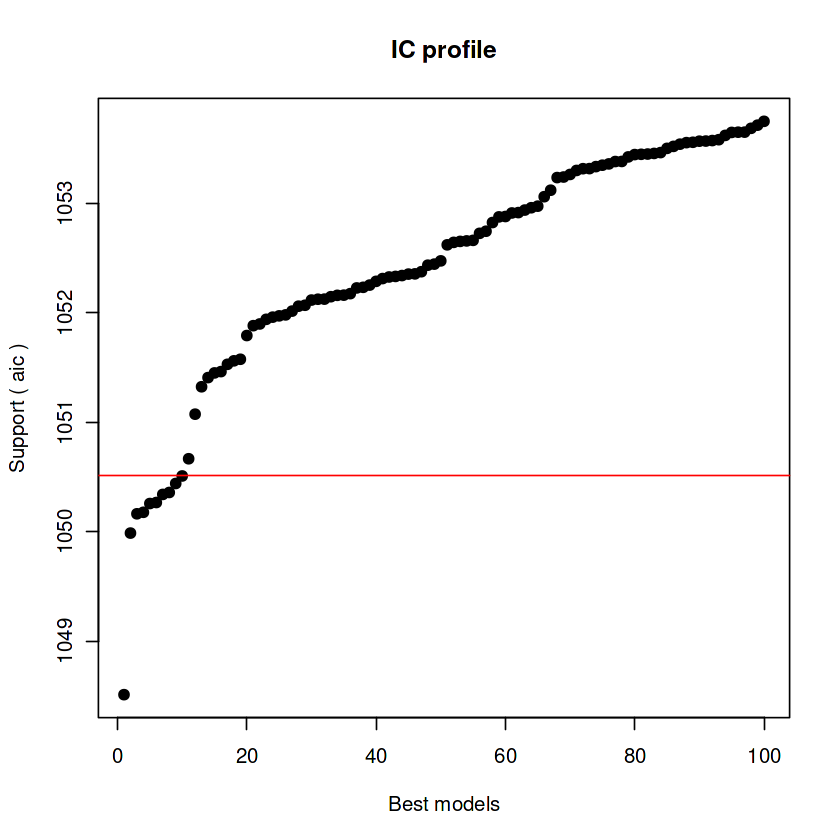


After 69850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.39298328218



After 69900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.31290254559



After 69950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years
Crit= 1048.50988606697
Mean crit= 1052.20811213926


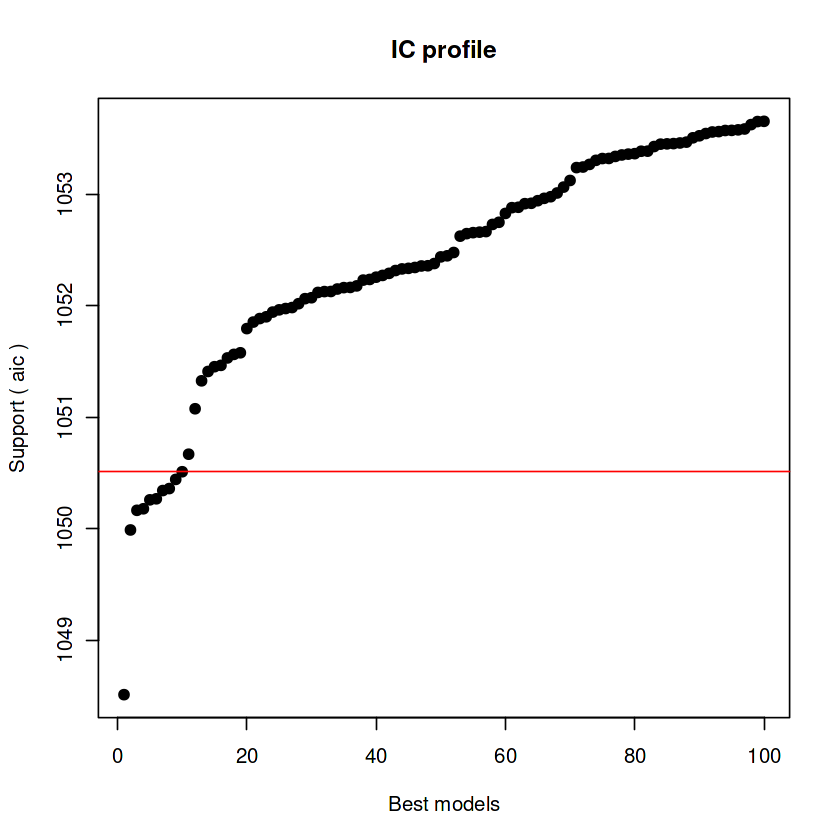


After 70000 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+BMI+HIV.AIDS+Income.composition.of.resources
Crit= 1047.96475056022
Mean crit= 1052.02938217292


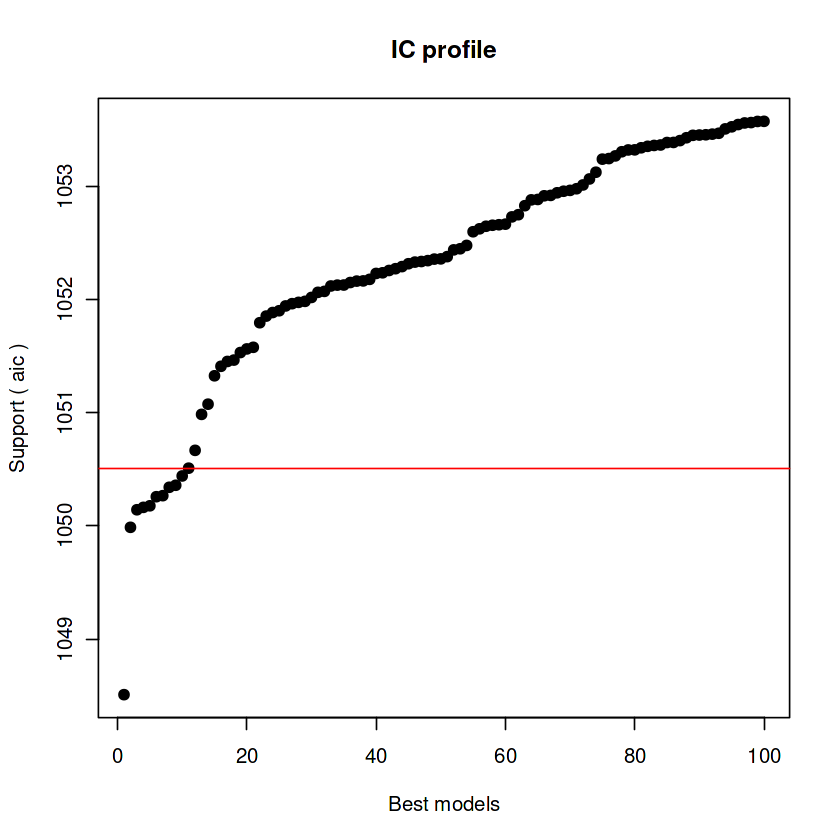


After 70050 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+BMI+HIV.AIDS+Income.composition.of.resources
Crit= 1047.96475056022
Mean crit= 1051.81410503515


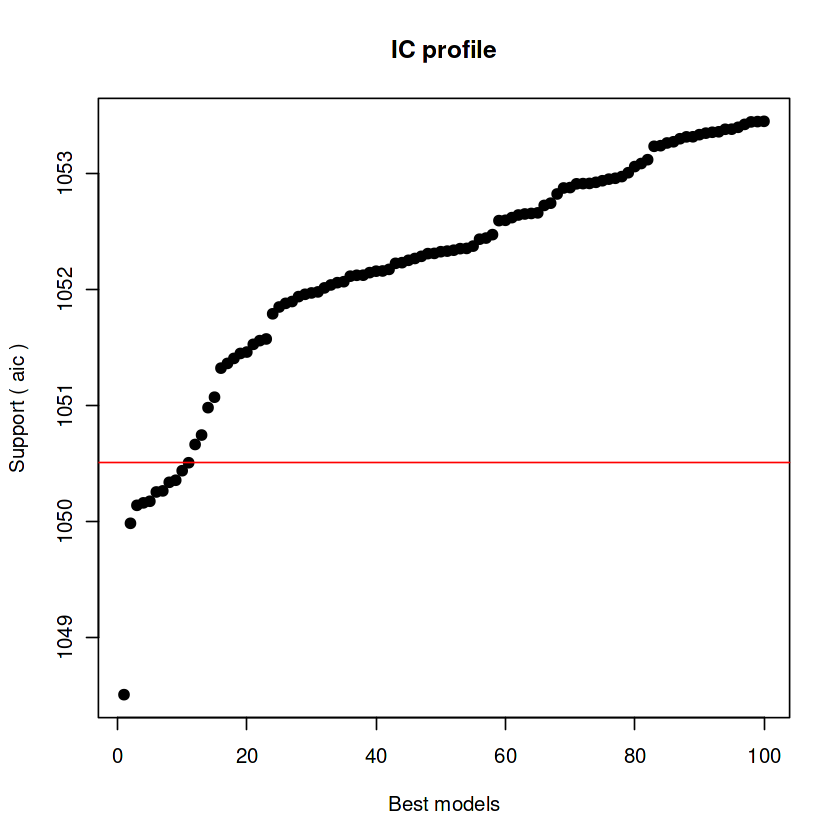


After 70100 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+BMI+HIV.AIDS+Income.composition.of.resources
Crit= 1047.96475056022
Mean crit= 1051.67389544631


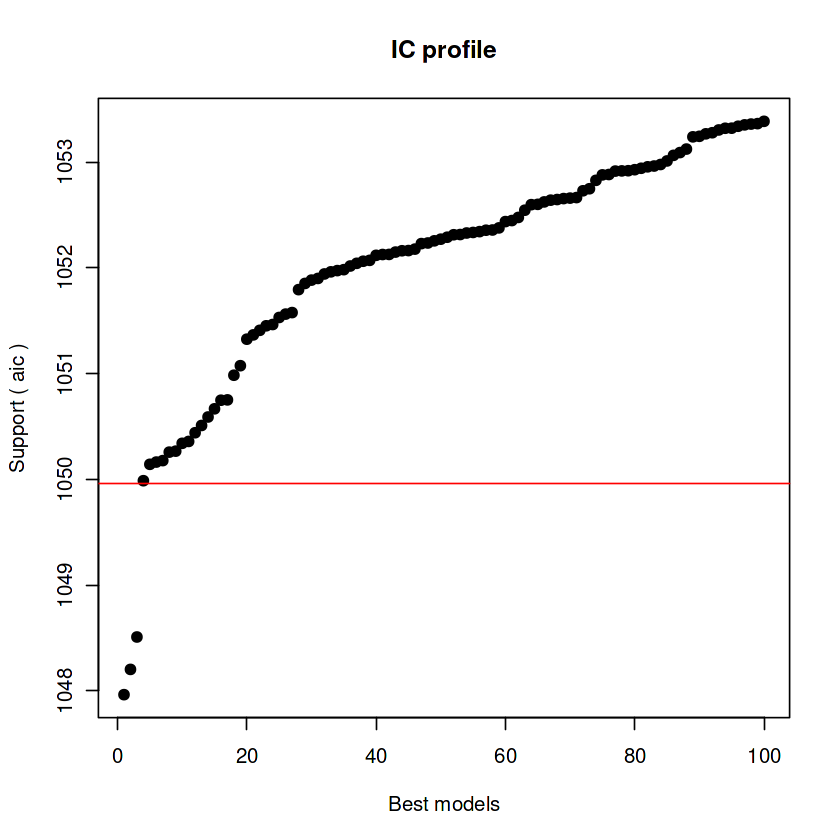


After 70150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths+HIV.AIDS+Income.composition.of.resources
Crit= 1046.97262235812
Mean crit= 1051.40442211088


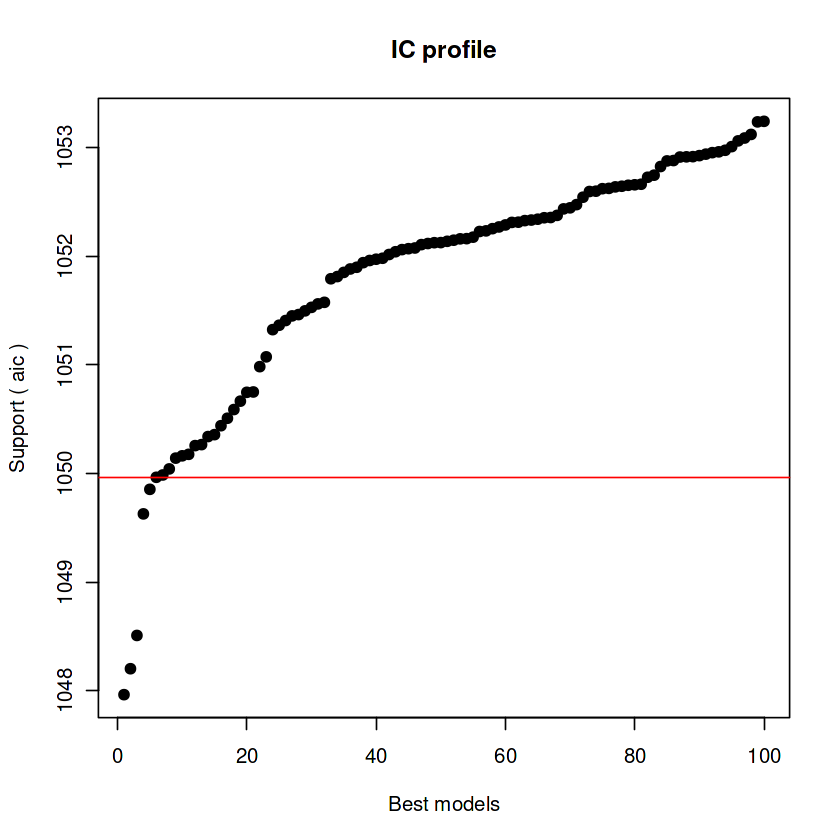


After 70200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths+HIV.AIDS+Income.composition.of.resources
Crit= 1046.97262235812
Mean crit= 1051.16061056021


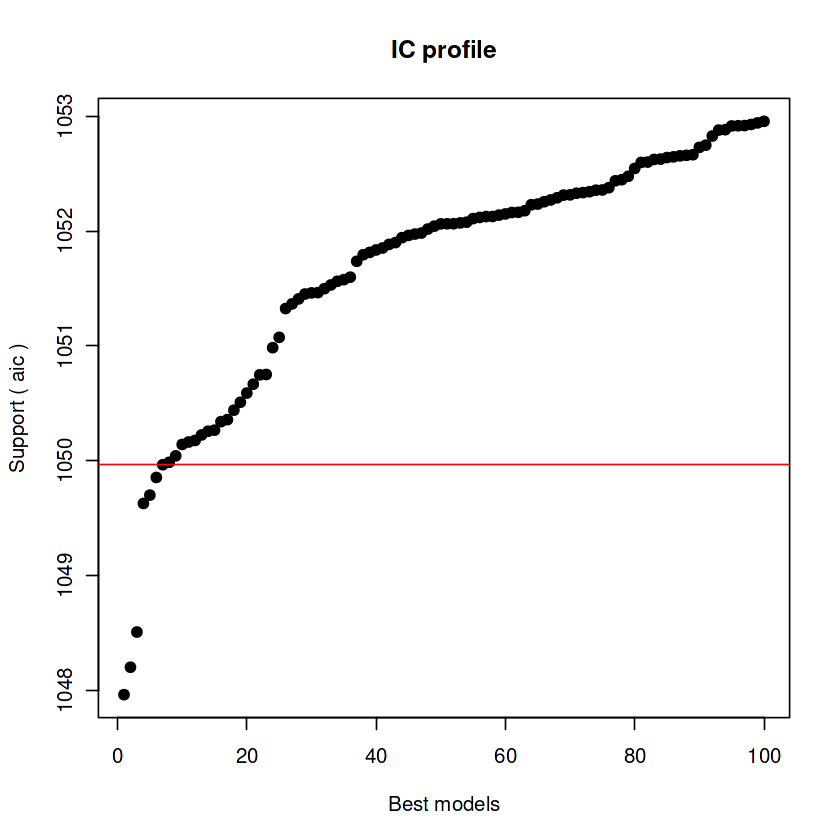


After 70250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths+HIV.AIDS+Income.composition.of.resources
Crit= 1046.97262235812
Mean crit= 1050.81161876368


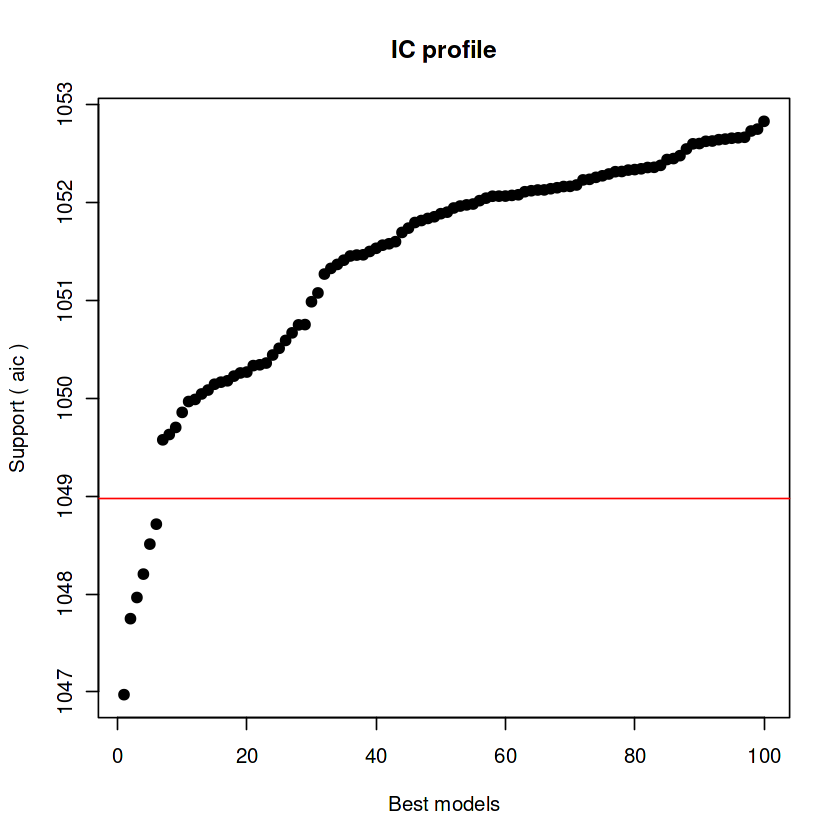


After 70300 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Polio+HIV.AIDS+Income.composition.of.resources
Crit= 1044.19790325324
Mean crit= 1050.18314019755


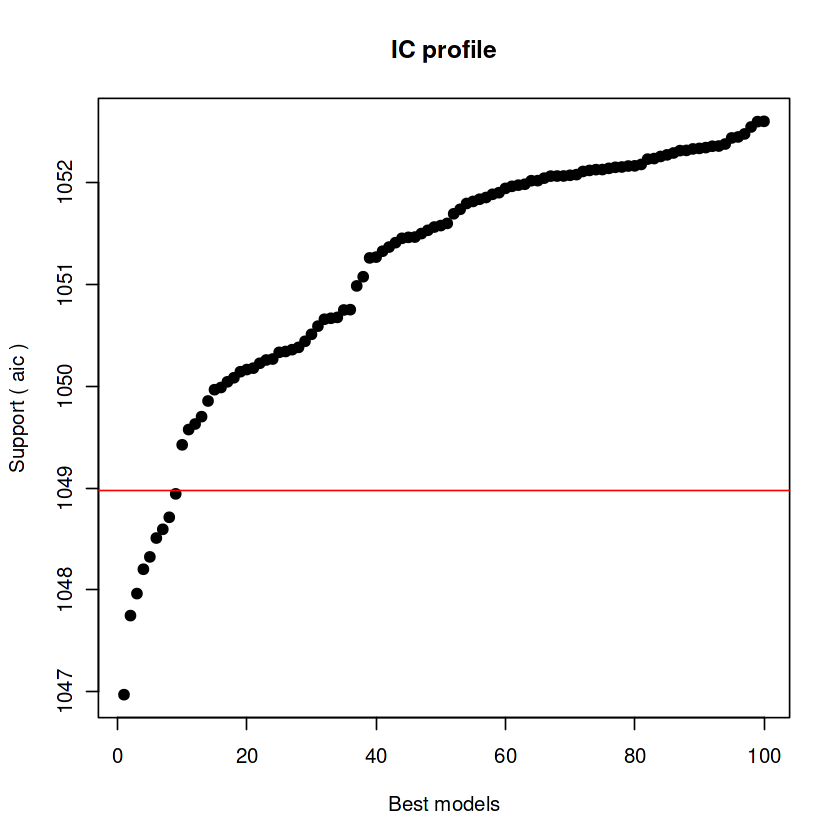


After 70350 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Polio+HIV.AIDS+Income.composition.of.resources
Crit= 1044.19790325324
Mean crit= 1049.64426515162


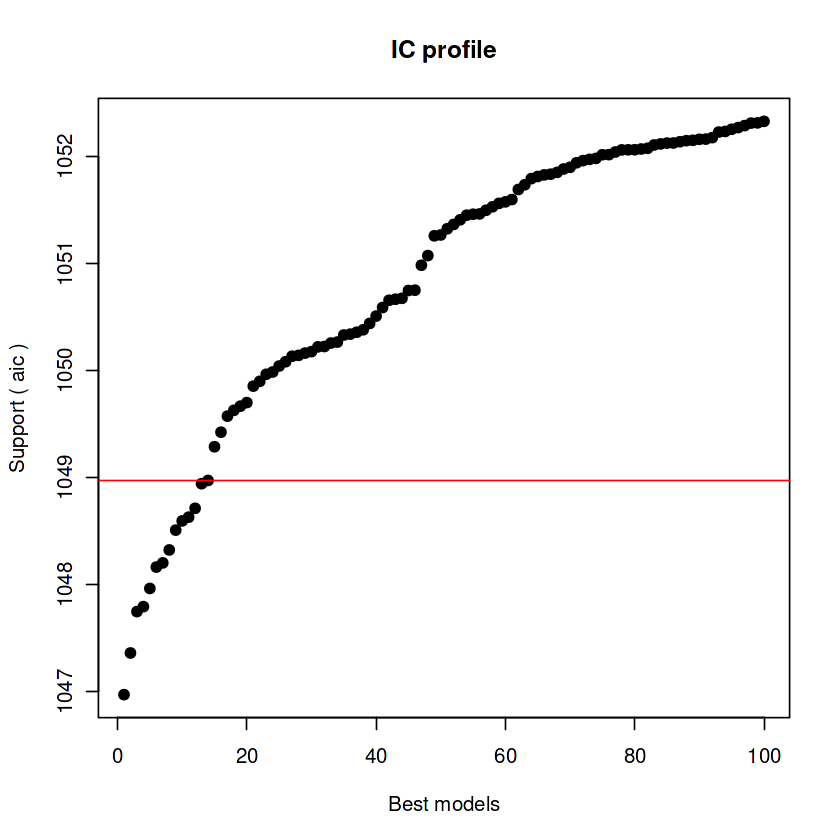


After 70400 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Polio+HIV.AIDS+Income.composition.of.resources
Crit= 1044.19790325324
Mean crit= 1049.20253311524


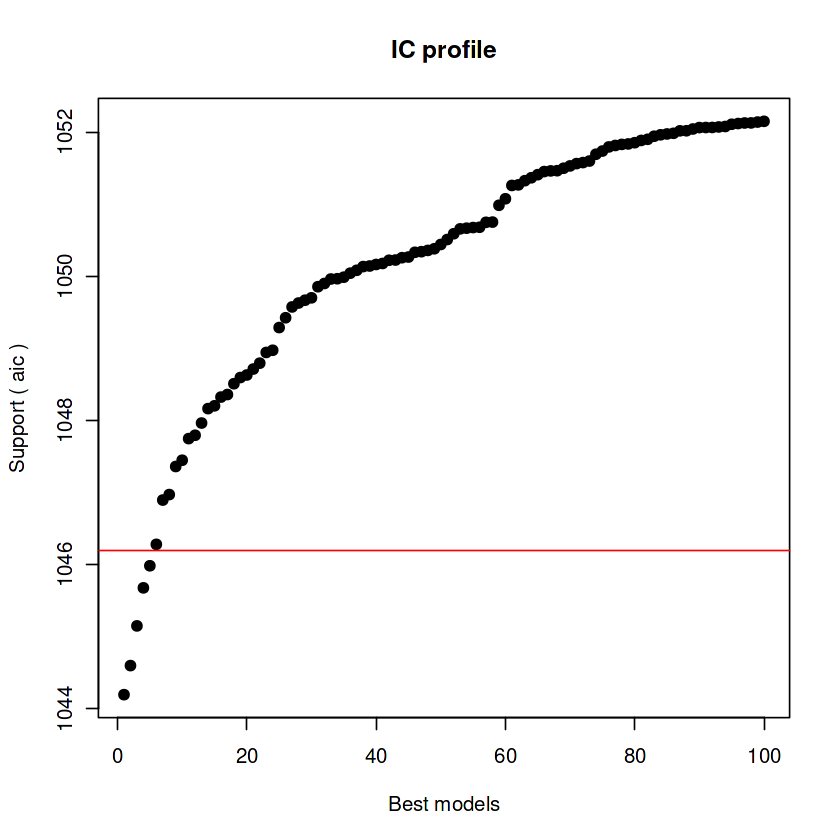


After 70450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+HIV.AIDS+Income.composition.of.resources
Crit= 1043.20998849641
Mean crit= 1048.61582503937


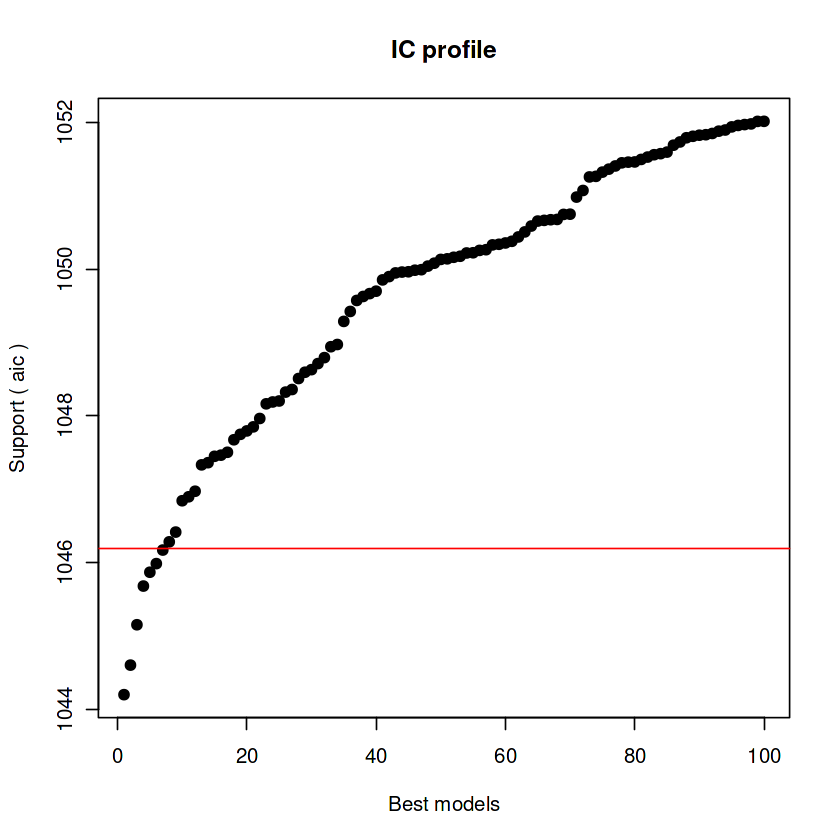


After 70500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+HIV.AIDS+Income.composition.of.resources
Crit= 1043.20998849641
Mean crit= 1048.29661833968


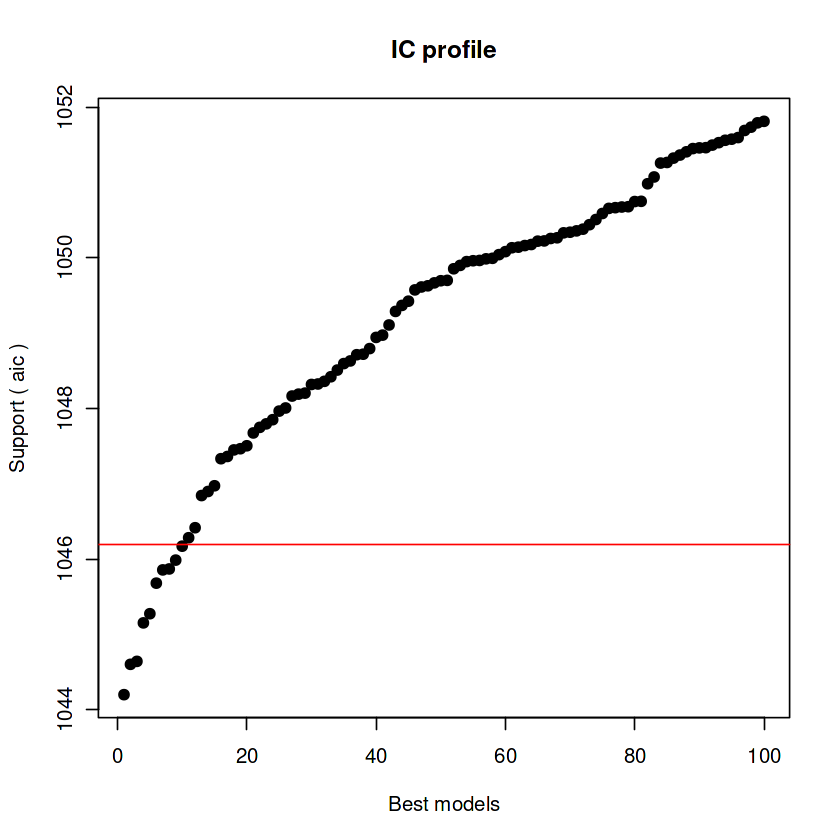


After 70550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+HIV.AIDS+Income.composition.of.resources
Crit= 1043.20998849641
Mean crit= 1047.87183260275


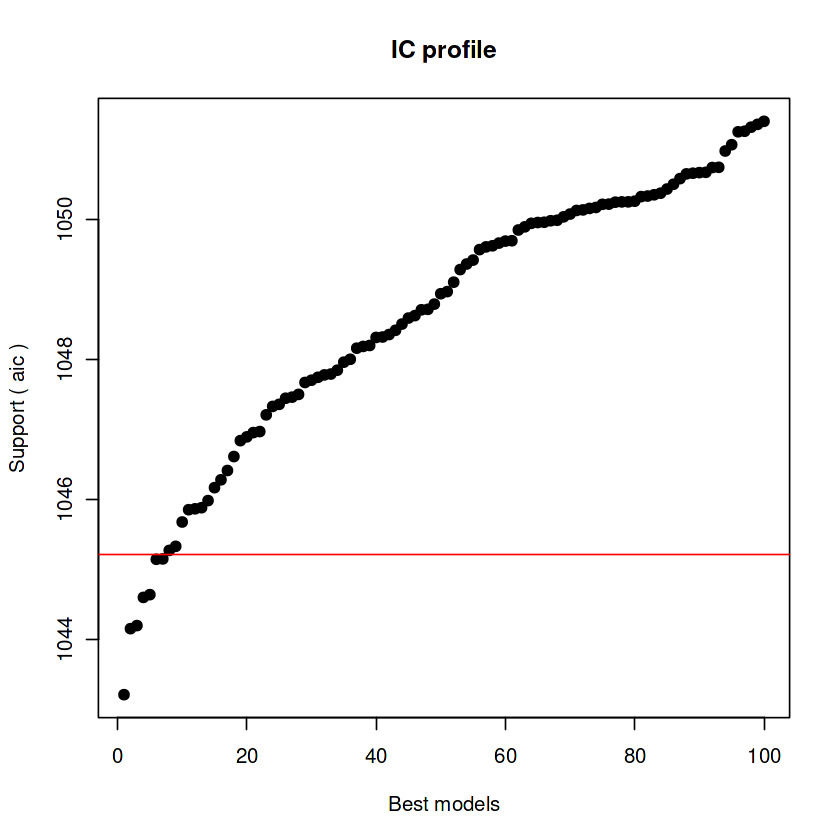


After 70600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+HIV.AIDS+Income.composition.of.resources
Crit= 1043.20998849641
Mean crit= 1047.51238751855


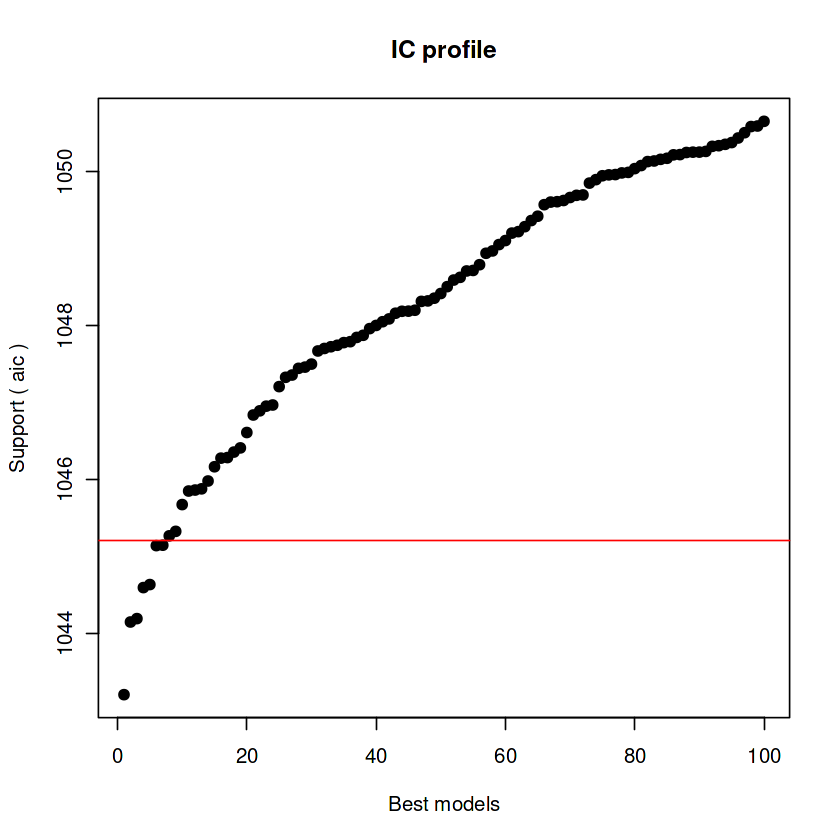


After 70650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+HIV.AIDS+Income.composition.of.resources
Crit= 1043.20998849641
Mean crit= 1047.32793284107


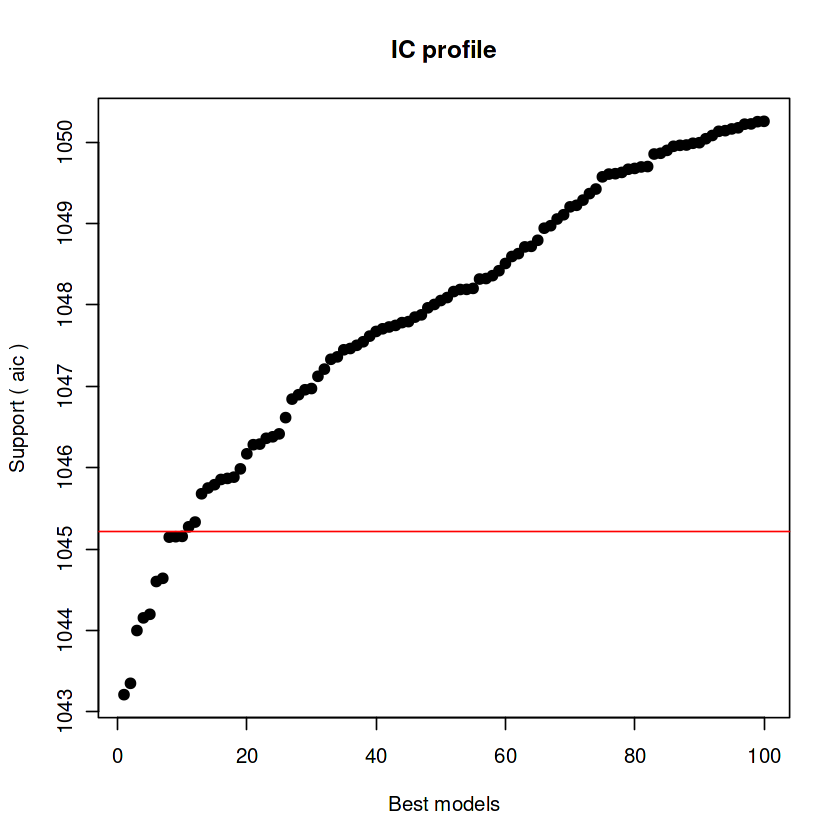


After 70700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths+Total.expenditure+HIV.AIDS+Income.composition.of.resources
Crit= 1042.76277946476
Mean crit= 1046.89502664854


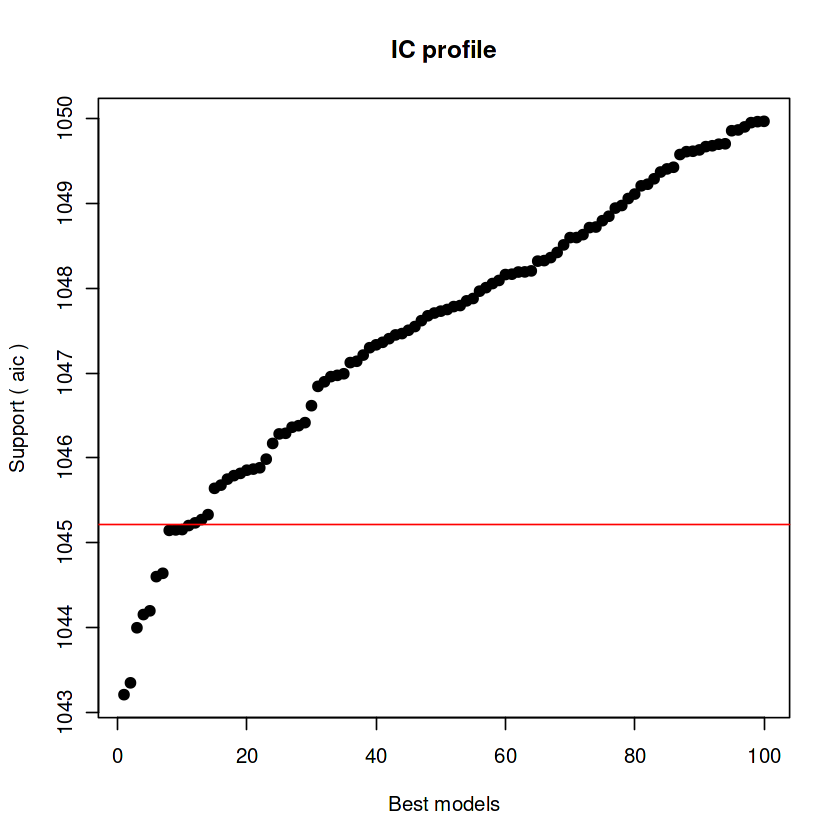


After 70750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+BMI+under.five.deaths+Total.expenditure+HIV.AIDS+Income.composition.of.resources
Crit= 1042.76277946476
Mean crit= 1046.53730502939


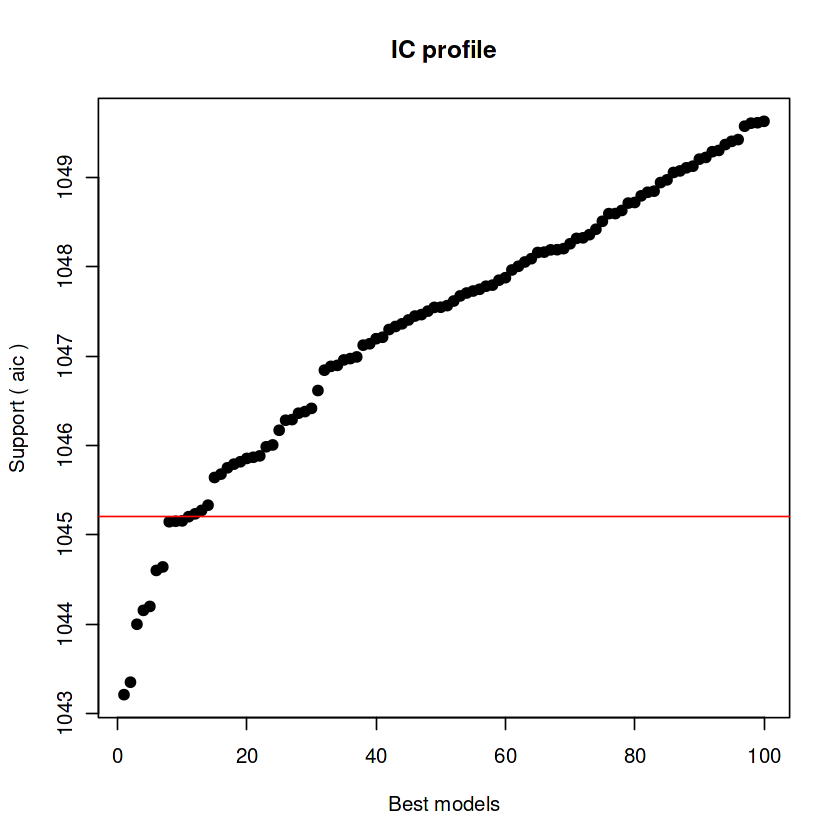


After 70800 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+BMI+Polio+Total.expenditure+HIV.AIDS+Income.composition.of.resources
Crit= 1041.63101790445
Mean crit= 1046.09810503927


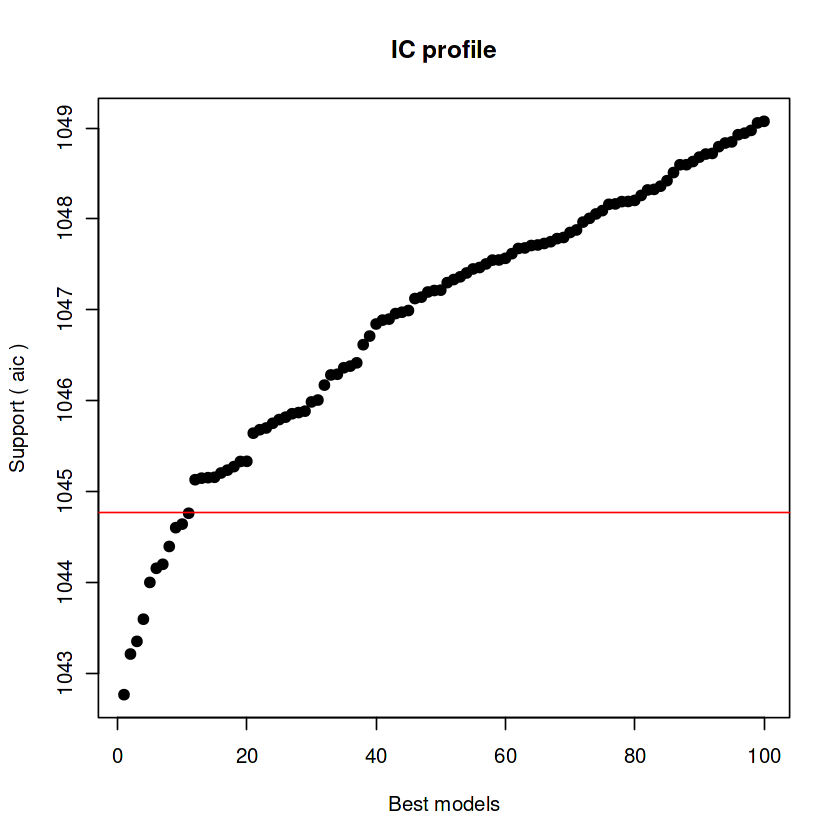


After 70850 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Polio+Total.expenditure+HIV.AIDS+Income.composition.of.resources
Crit= 1040.80266484628
Mean crit= 1045.65387726372


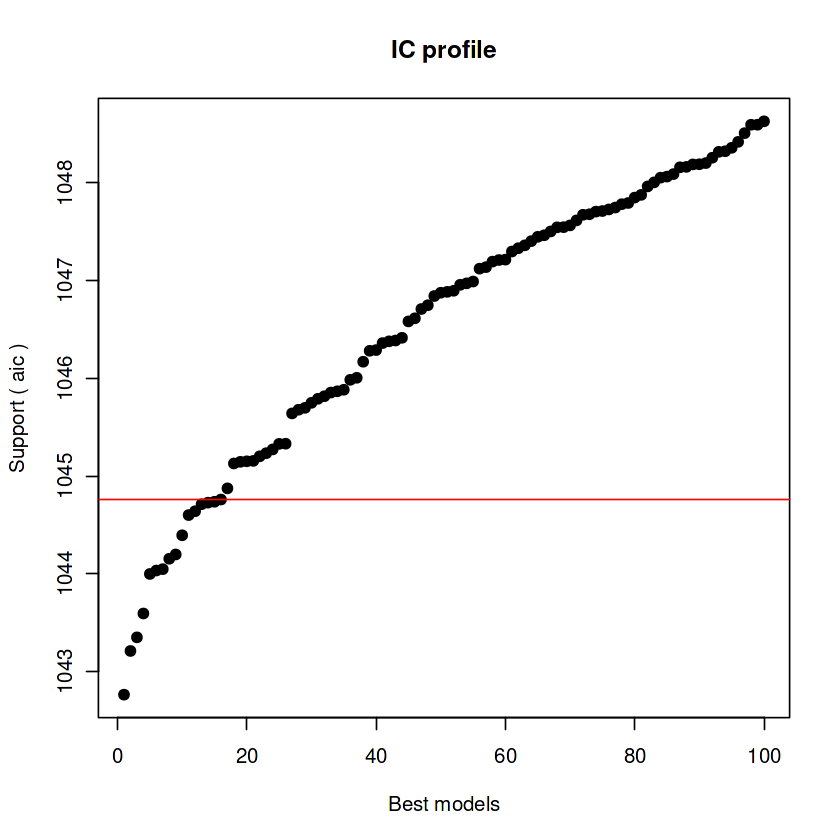


After 70900 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Polio+Total.expenditure+HIV.AIDS+Income.composition.of.resources
Crit= 1040.80266484628
Mean crit= 1045.36090483637


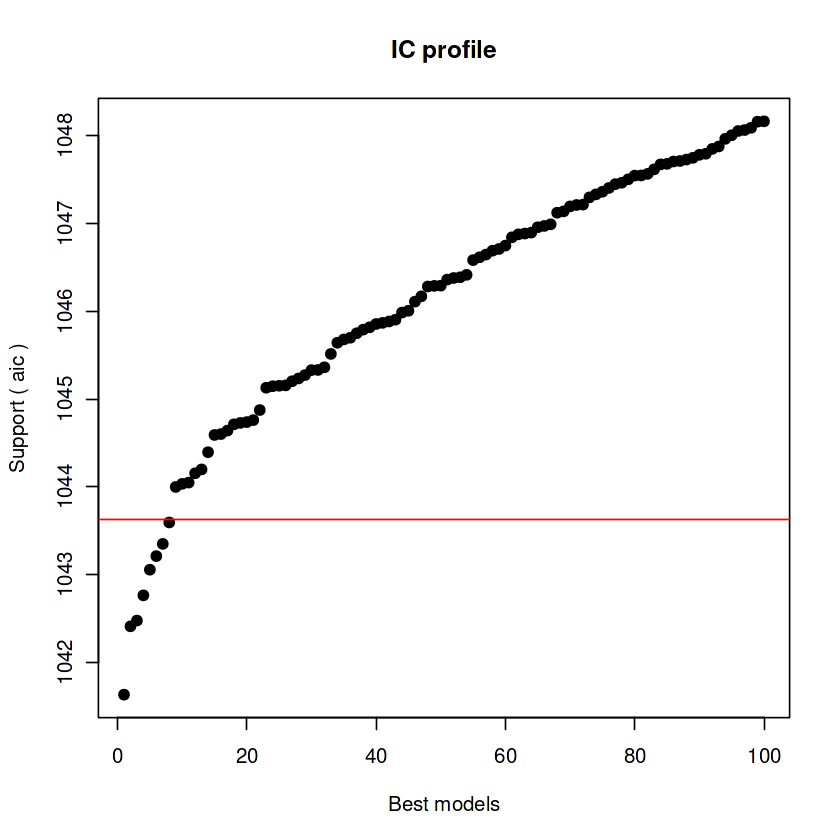


After 70950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+Income.composition.of.resources
Crit= 1040.12291670747
Mean crit= 1044.91808685177


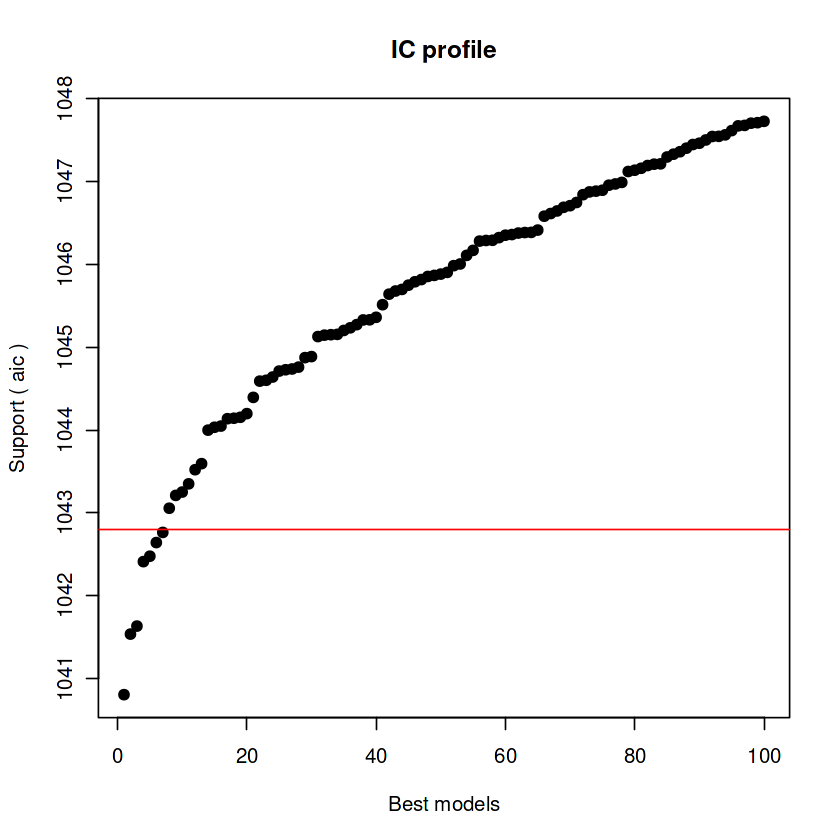


After 71000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+Income.composition.of.resources
Crit= 1040.12291670747
Mean crit= 1044.64969435226


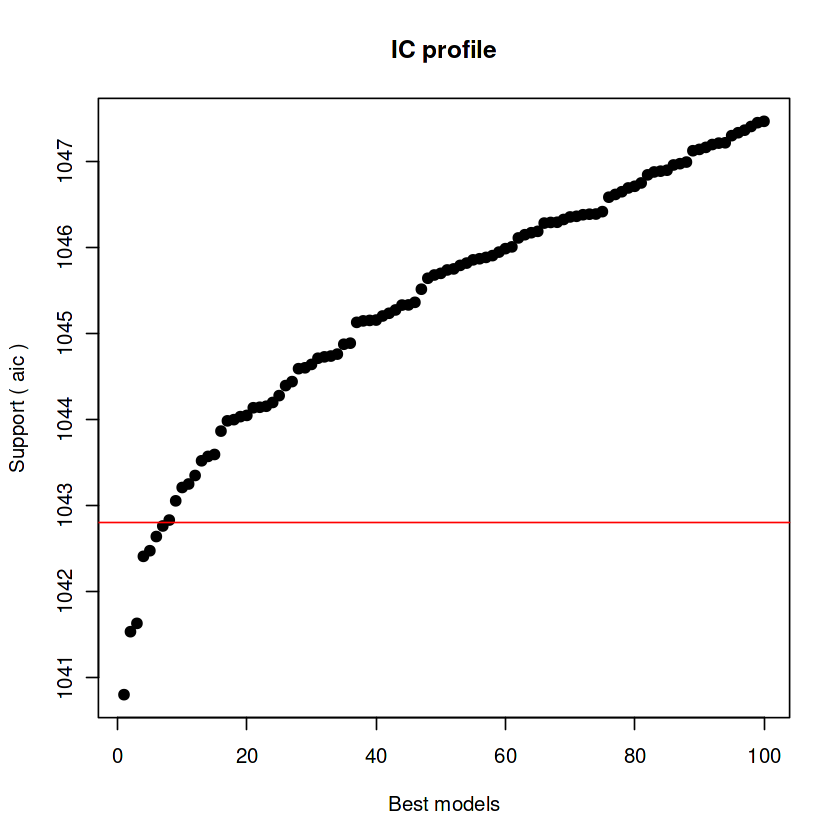


After 71050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+Income.composition.of.resources
Crit= 1040.12291670747
Mean crit= 1044.53394548517


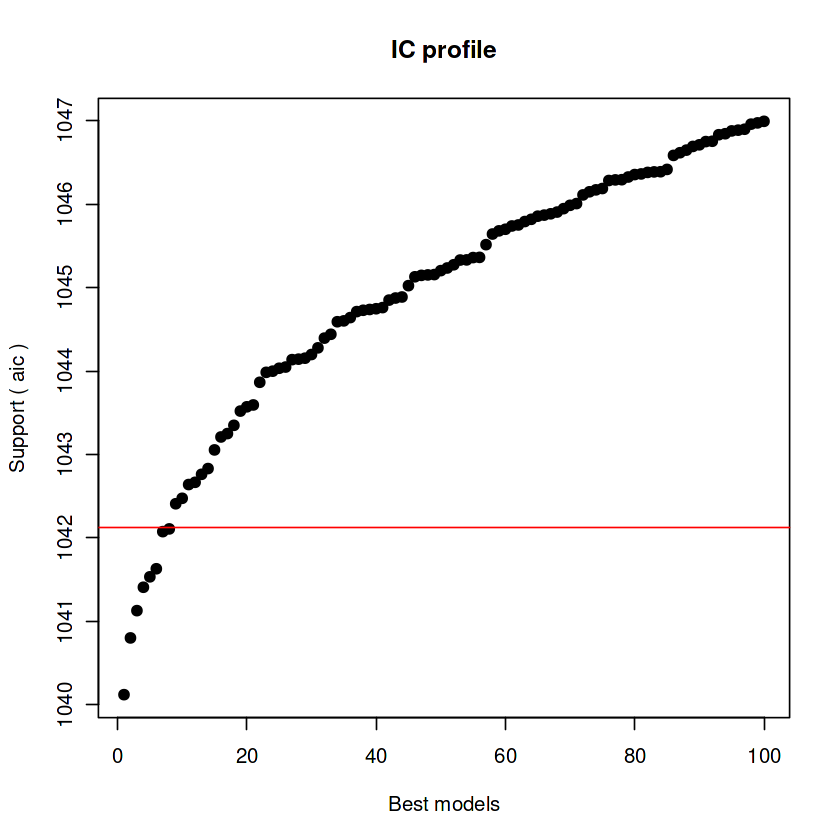


After 71100 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1039.6545211396
Mean crit= 1044.19615375201


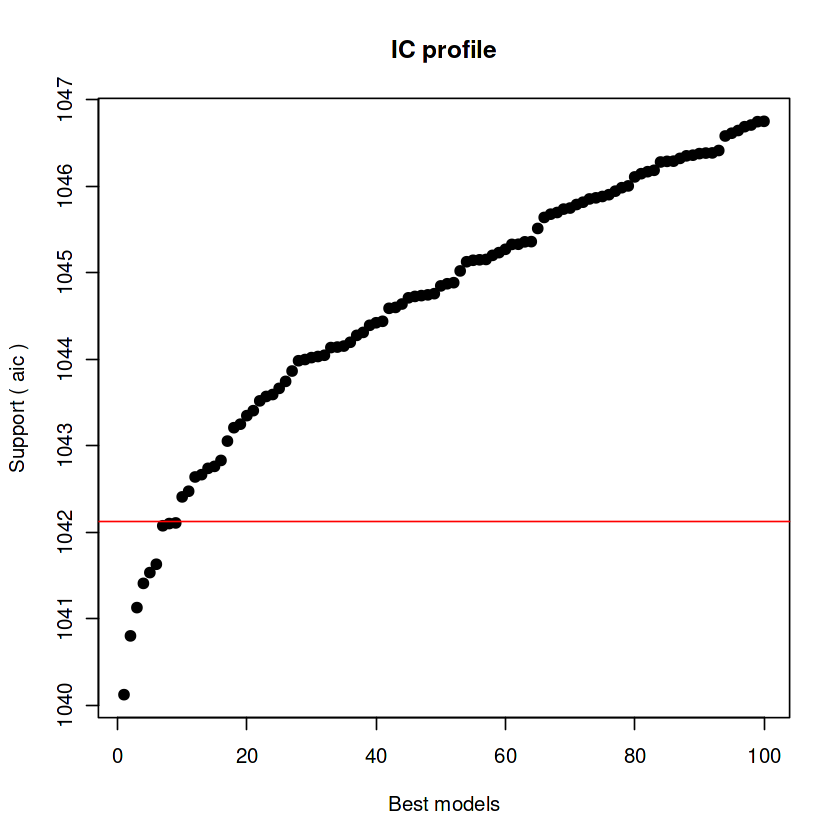


After 71150 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1039.6545211396
Mean crit= 1043.97190490555


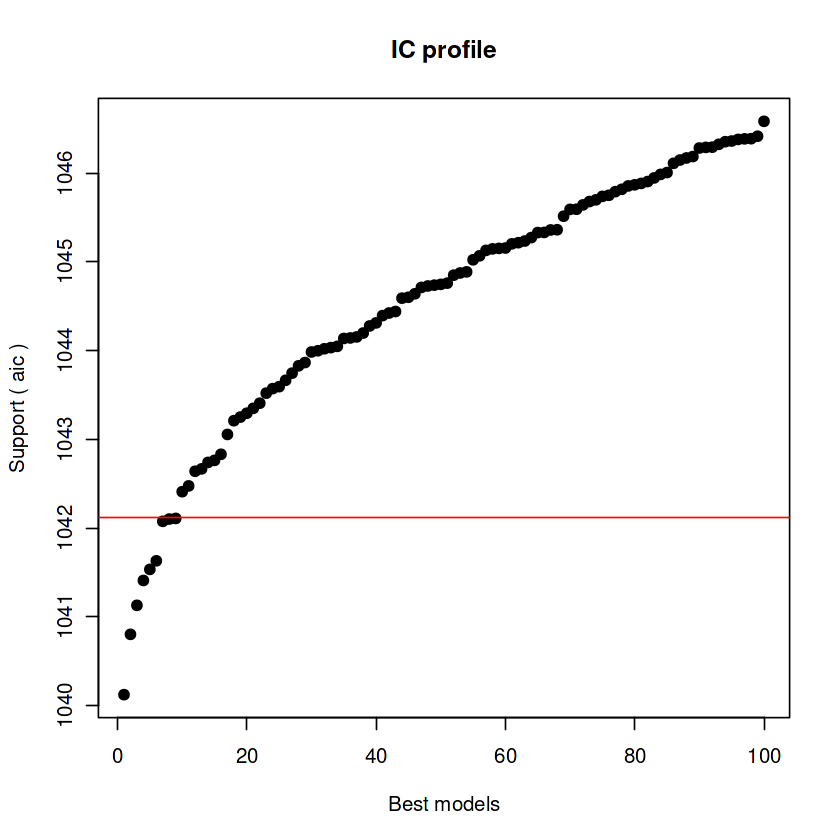


After 71200 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1039.6545211396
Mean crit= 1043.79571610462


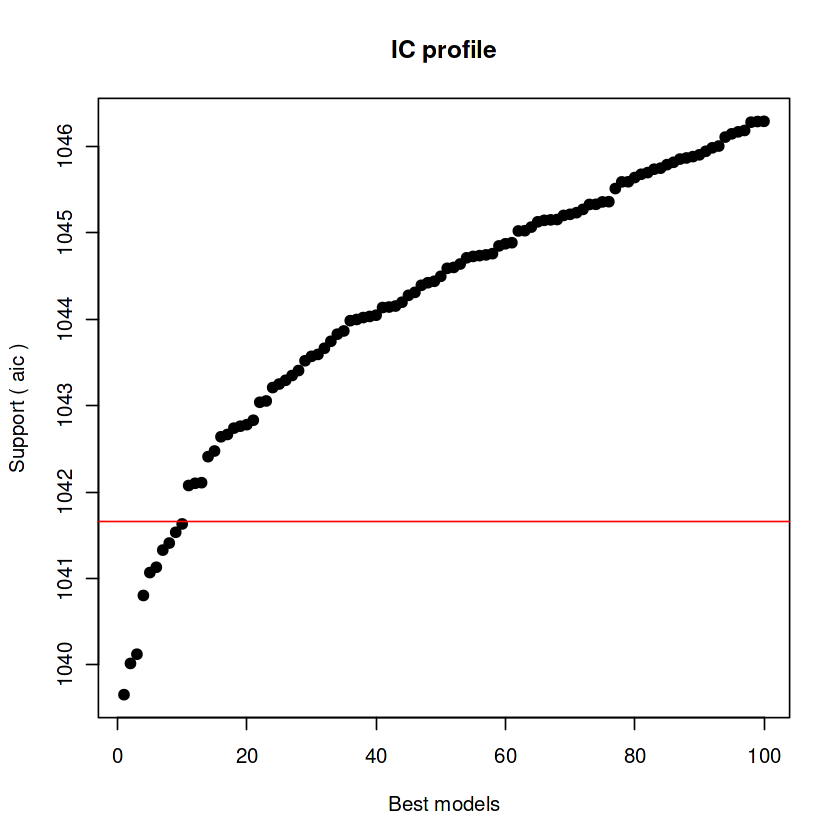


After 71250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1039.04528579717
Mean crit= 1043.51184107836


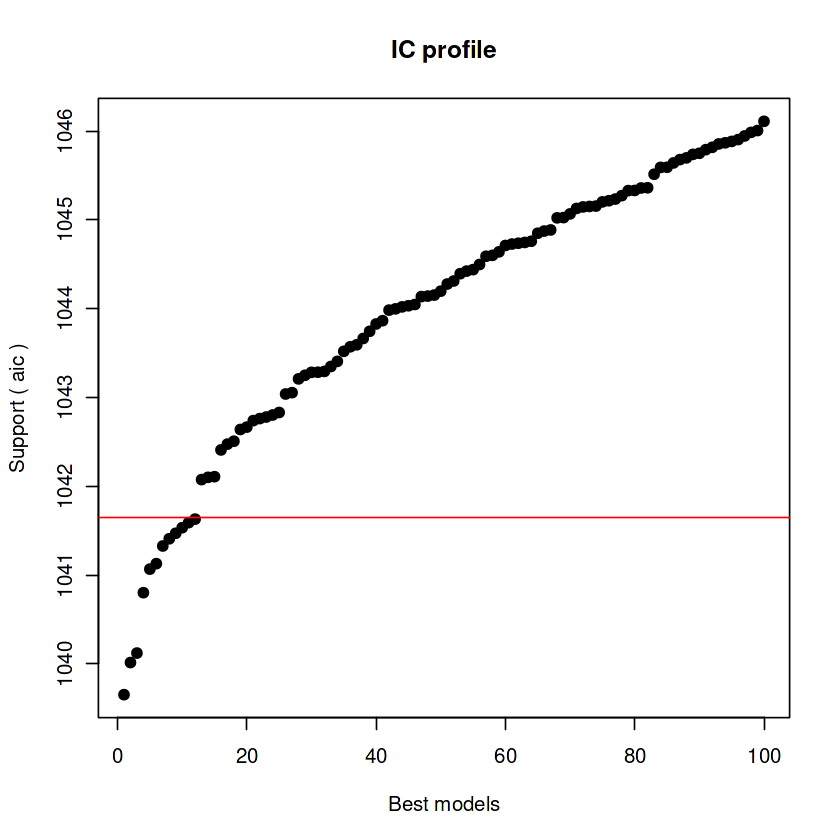


After 71300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1039.04528579717
Mean crit= 1043.48943147932


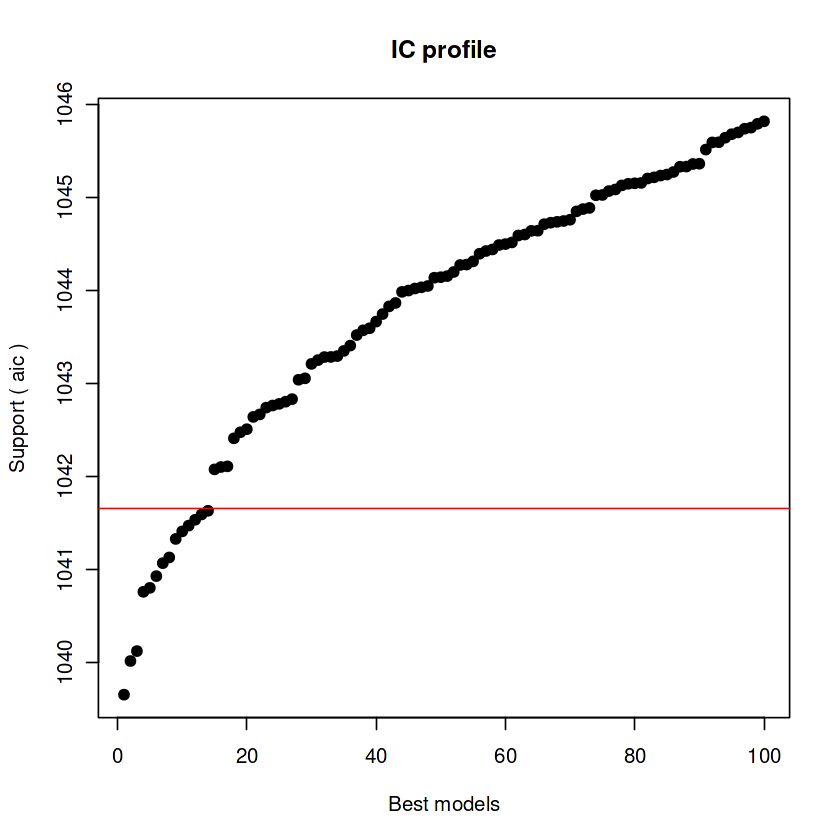


After 71350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1039.04528579717
Mean crit= 1043.34608256172


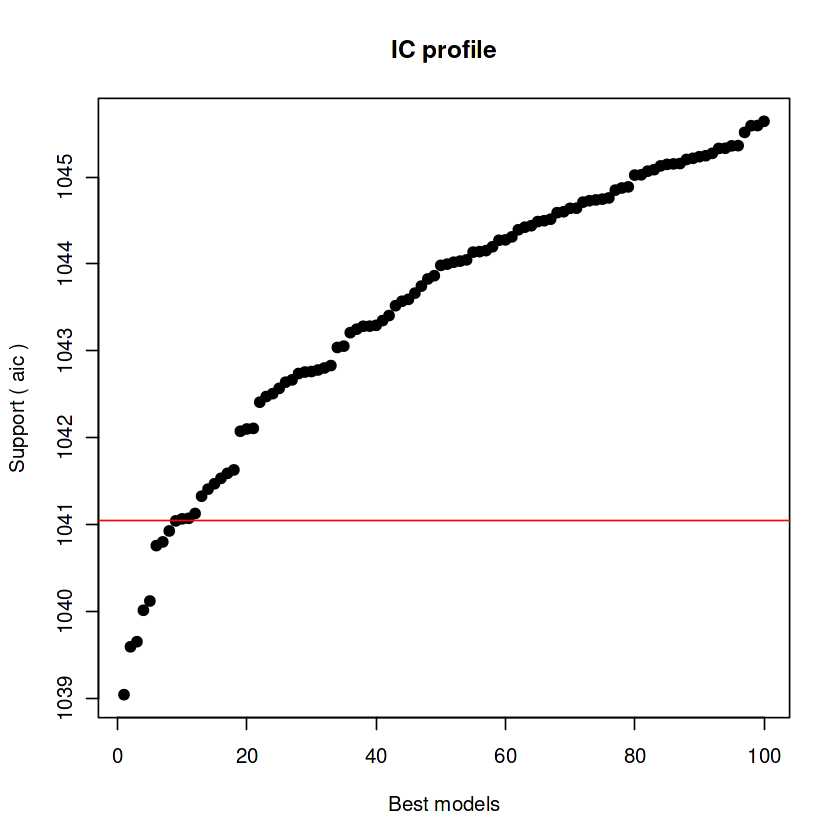


After 71400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1039.04528579717
Mean crit= 1043.26211669619


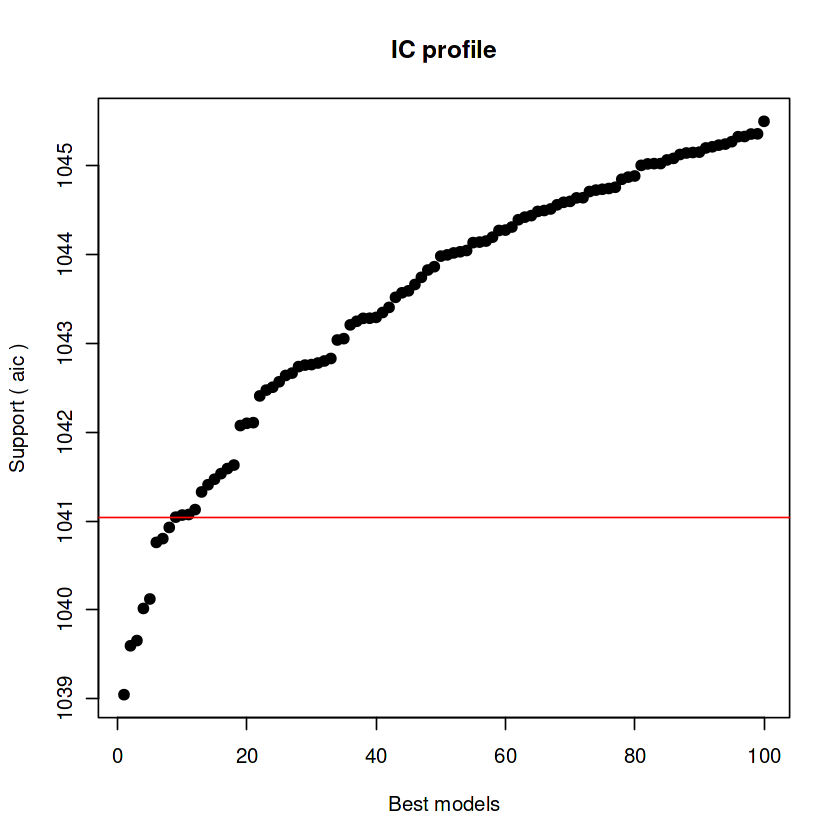


After 71450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1039.04528579717
Mean crit= 1043.23662153288


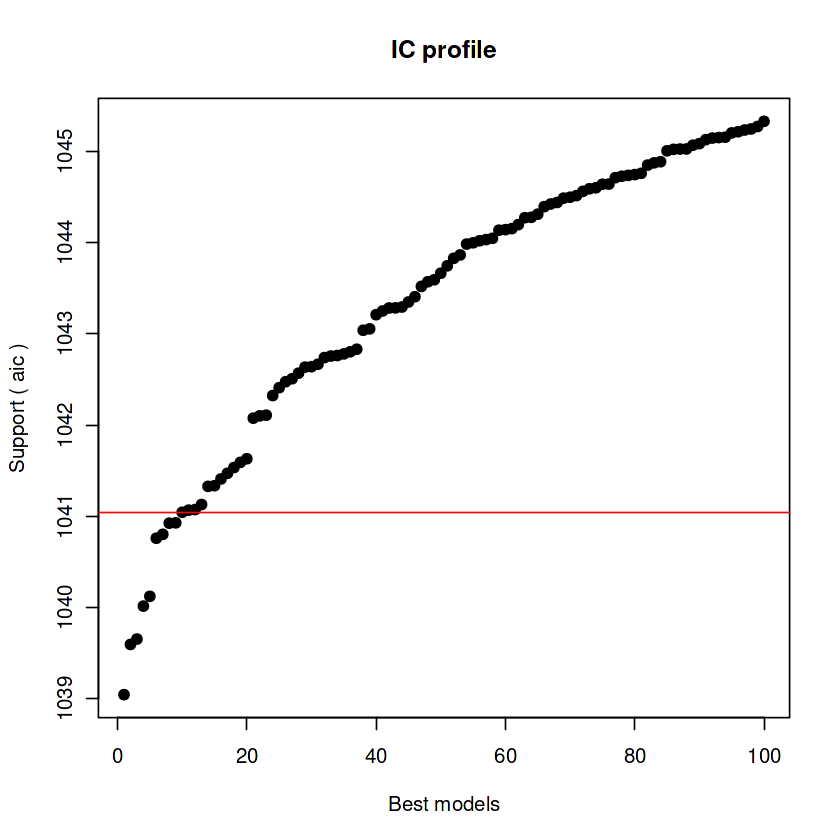


After 71500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1039.04528579717
Mean crit= 1043.06488900466


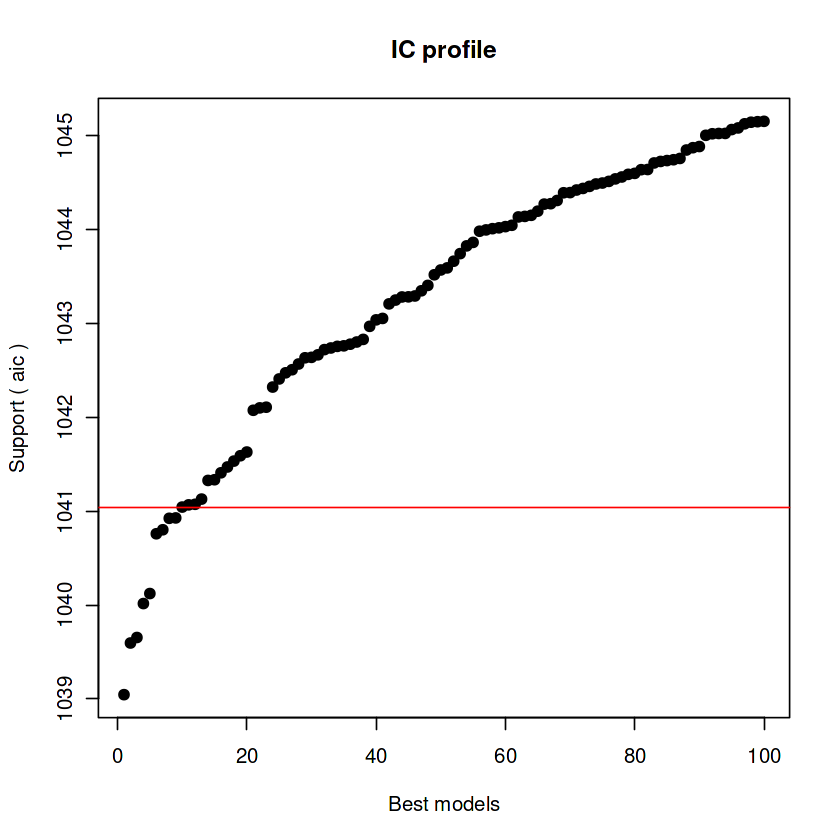


After 71550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1039.04528579717
Mean crit= 1042.86265381838


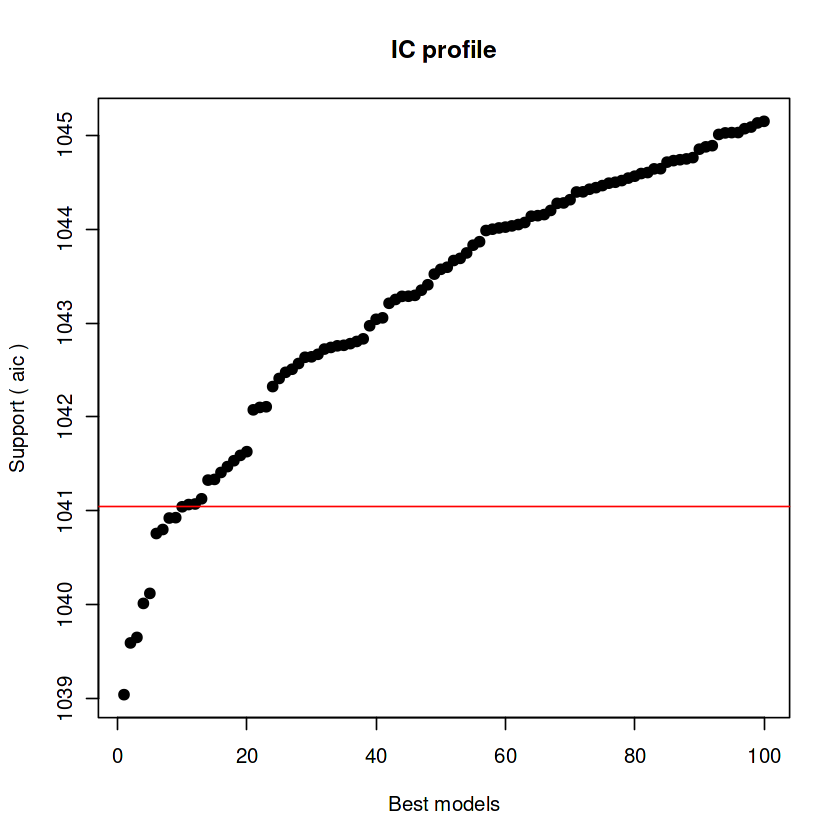


After 71600 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1037.24517361683
Mean crit= 1042.54023756772


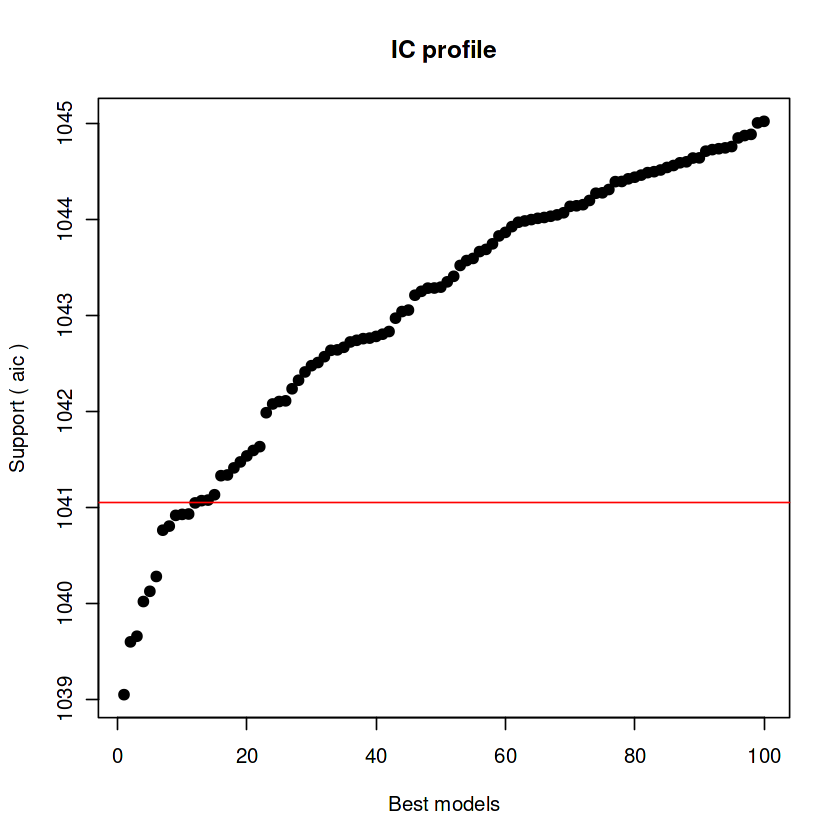


After 71650 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1037.24517361683
Mean crit= 1042.27153199226


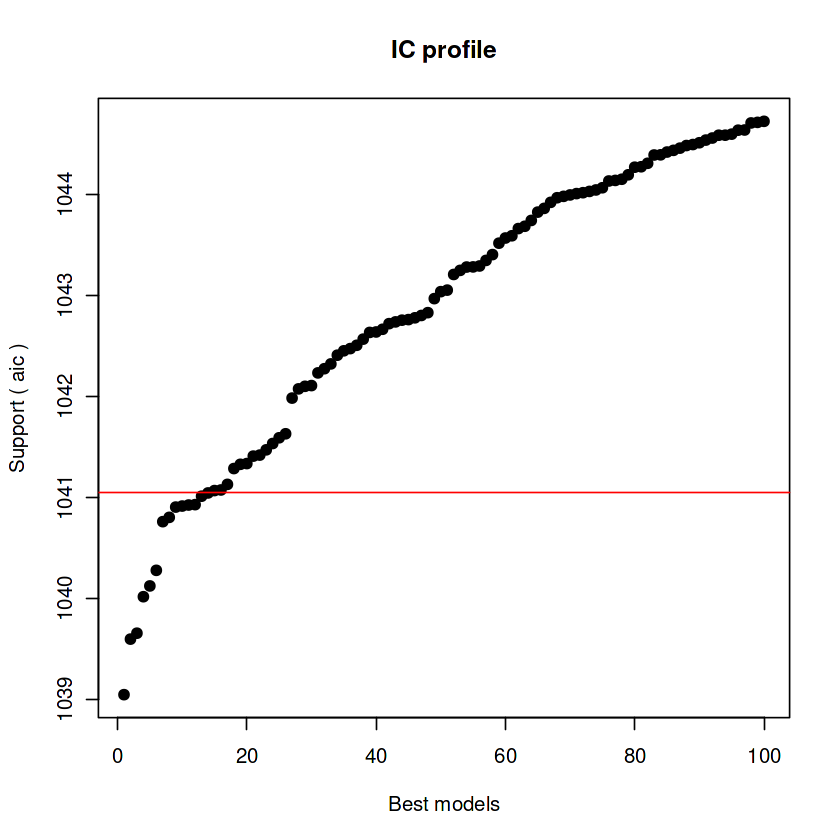


After 71700 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+percentage.expenditure+Hepatitis.B+BMI+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1037.24517361683
Mean crit= 1042.06677466735


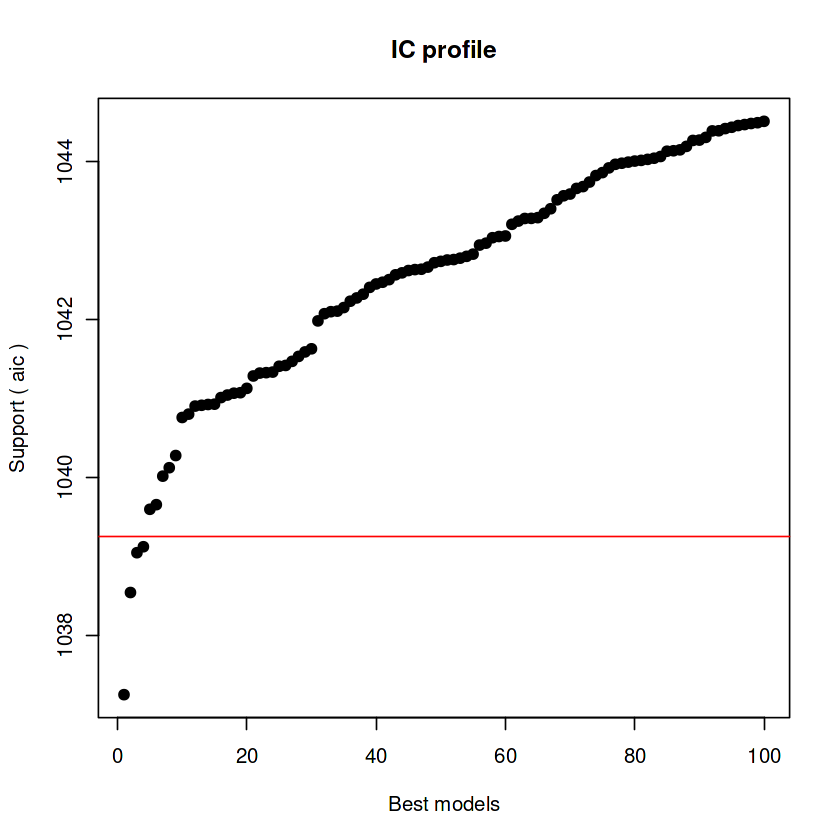


After 71750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1041.74380509891


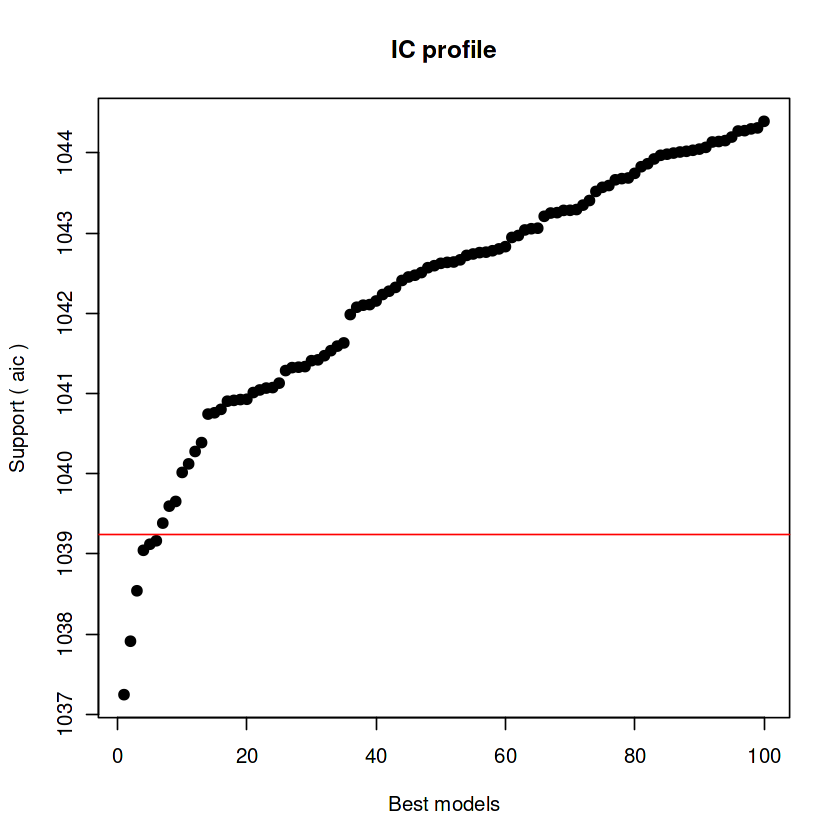


After 71800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1041.53122850715


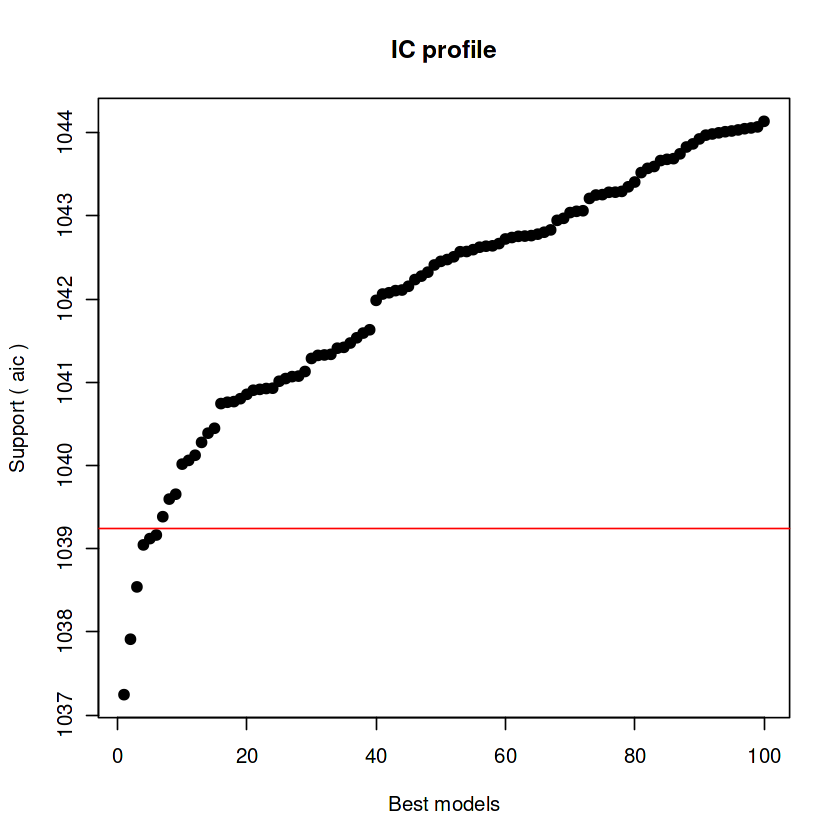


After 71850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1041.50934462864


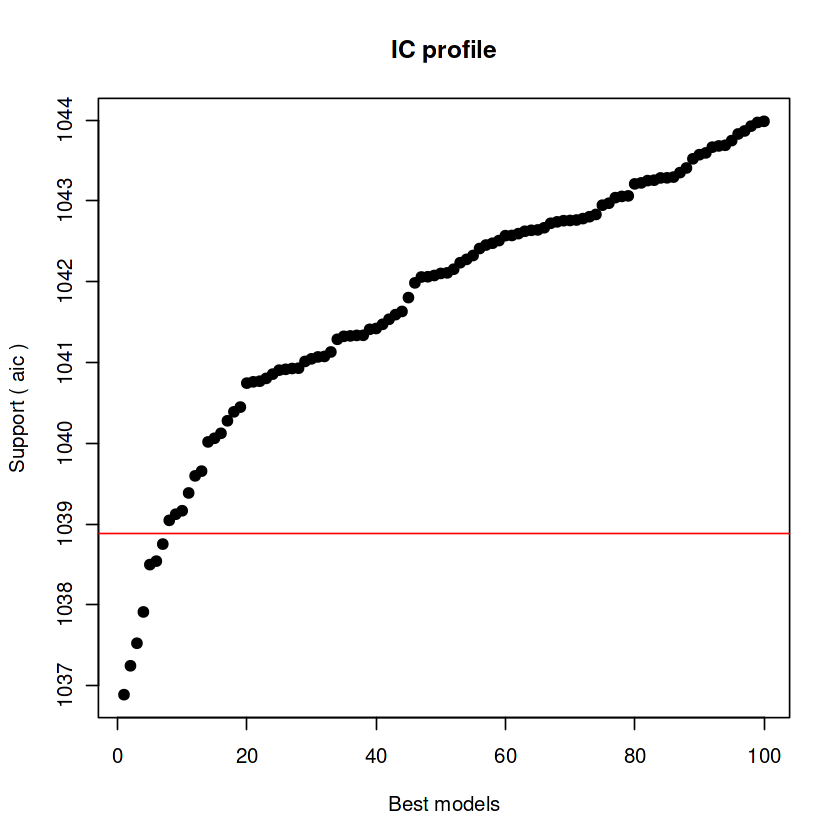


After 71900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1041.27215526393


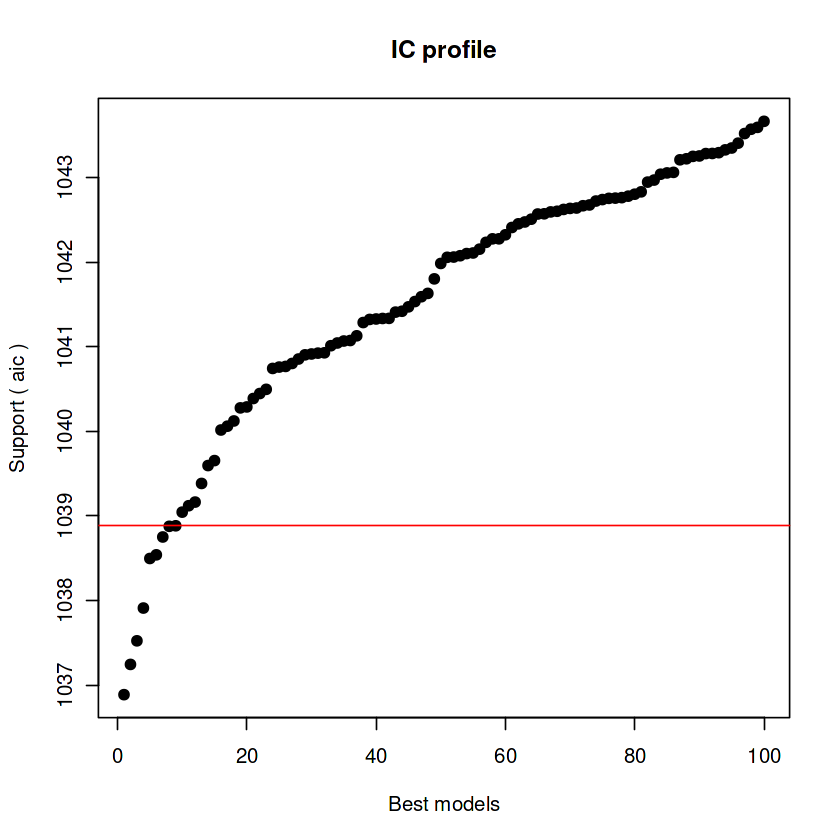


After 71950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1041.21512268284


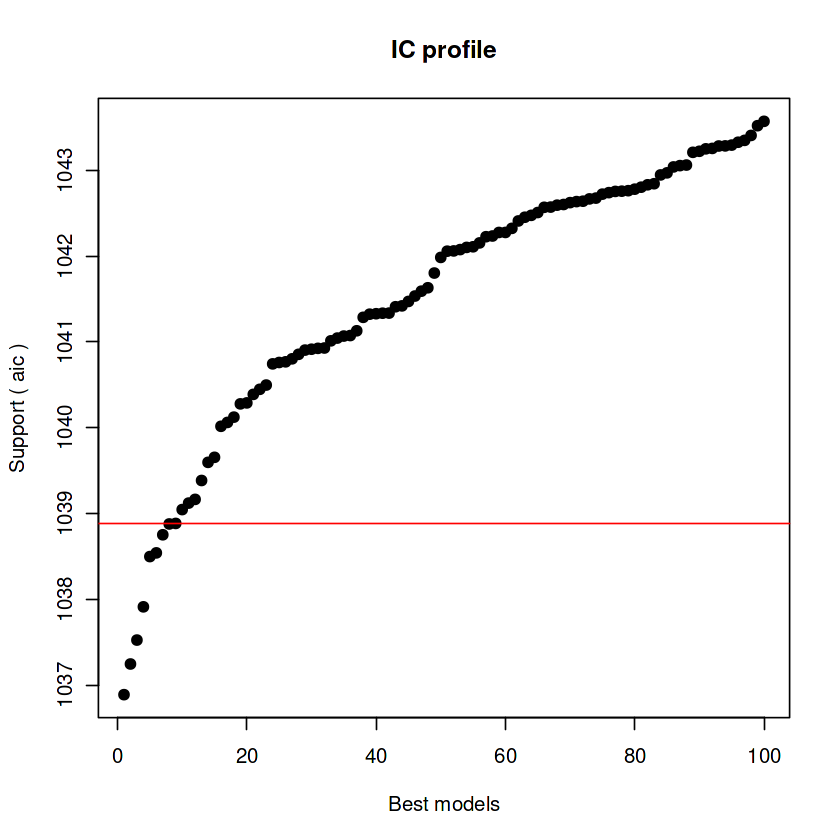


After 72000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1041.06207597679


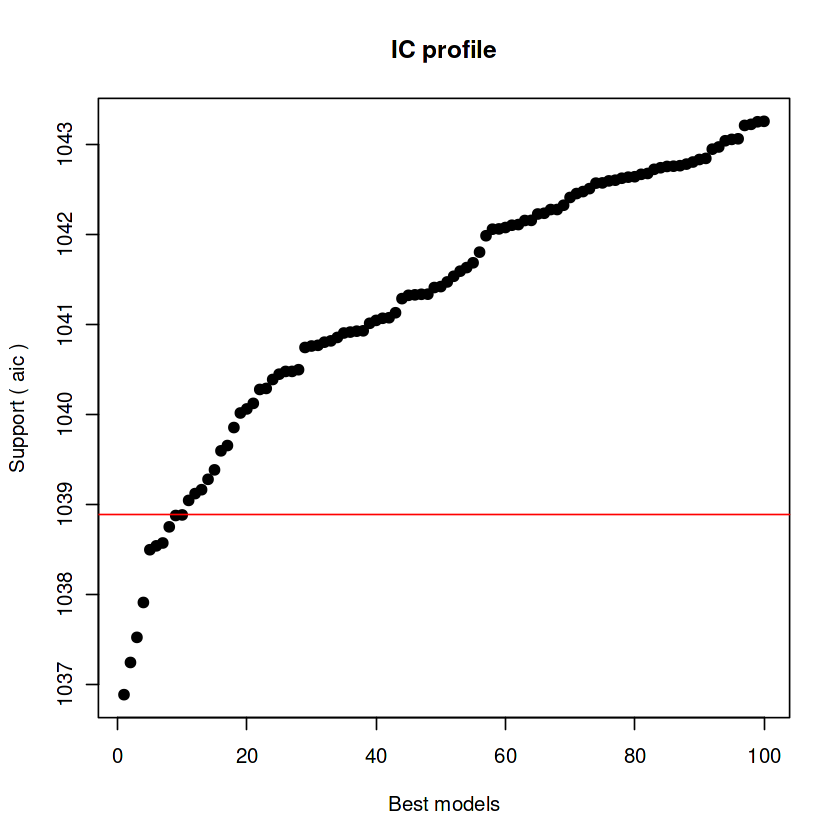


After 72050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326


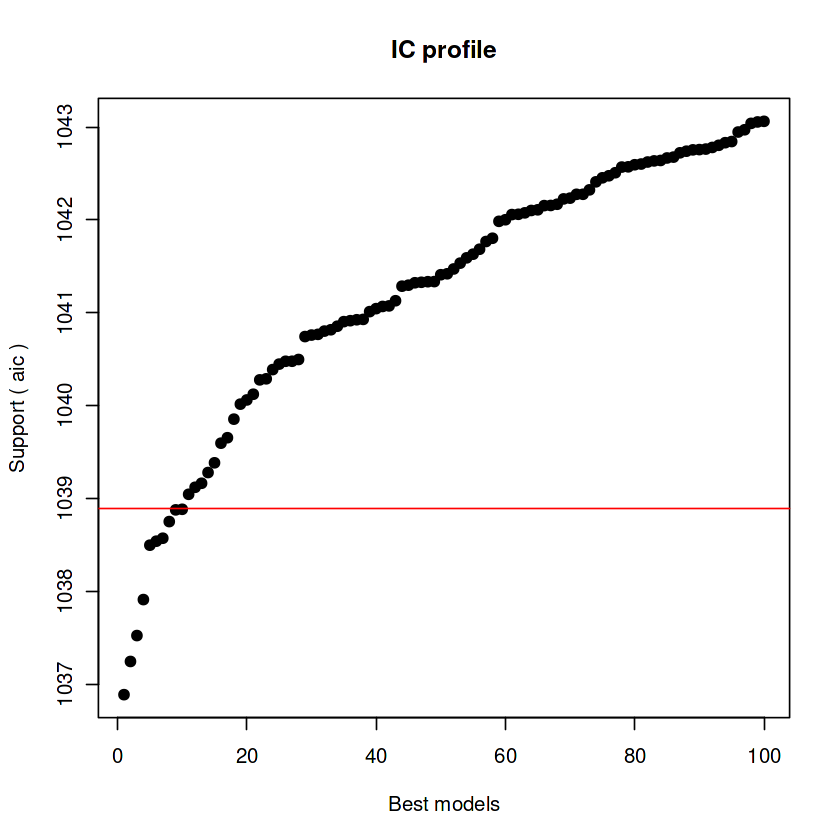


After 72100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326


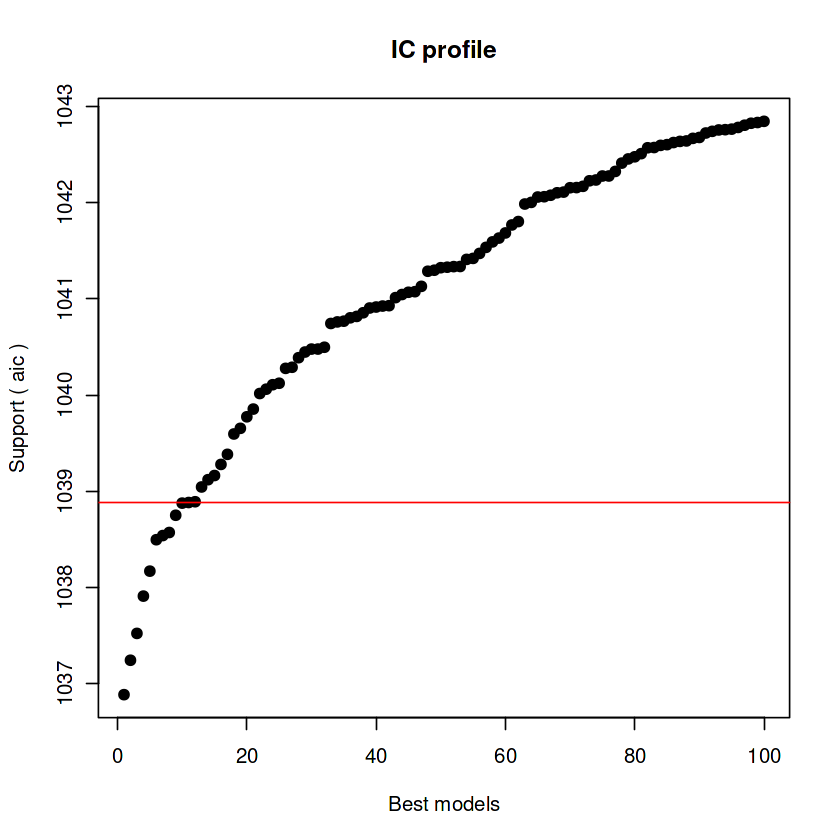


After 72150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 72950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 73950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98863990326



After 74800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98236331654



After 74850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.98236331654


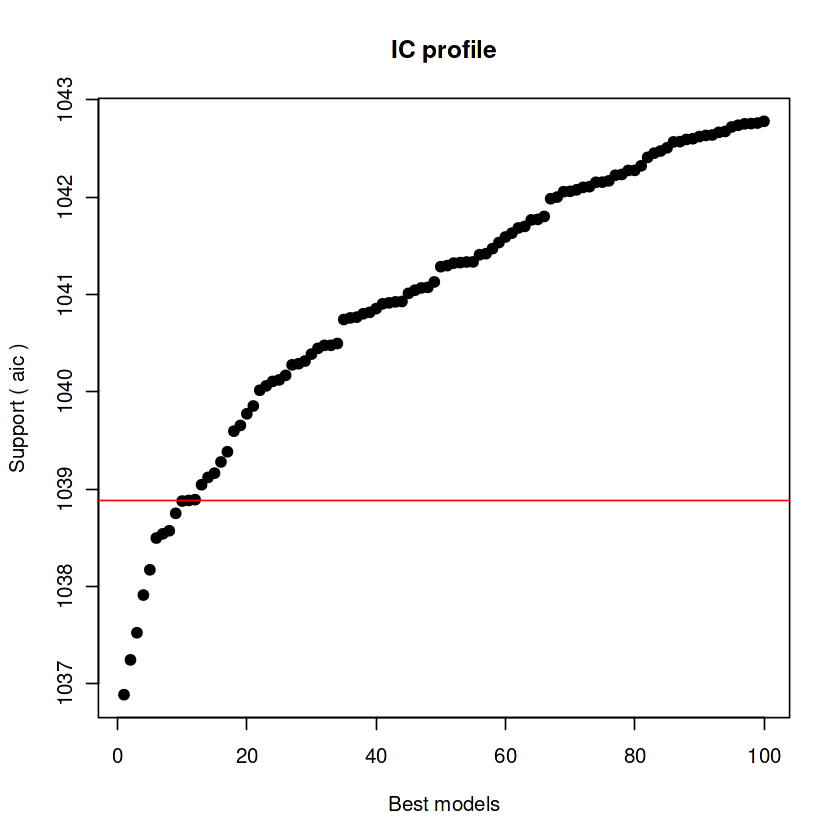


After 74900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.96599162471



After 74950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.96599162471


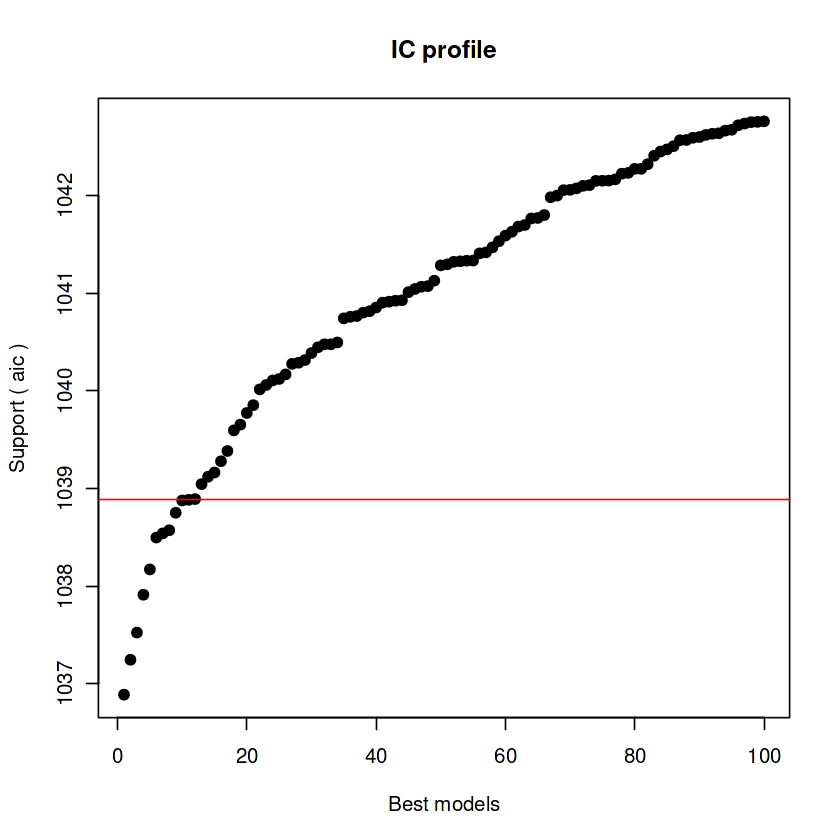


After 75000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.96335625145



After 75050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.87194301209


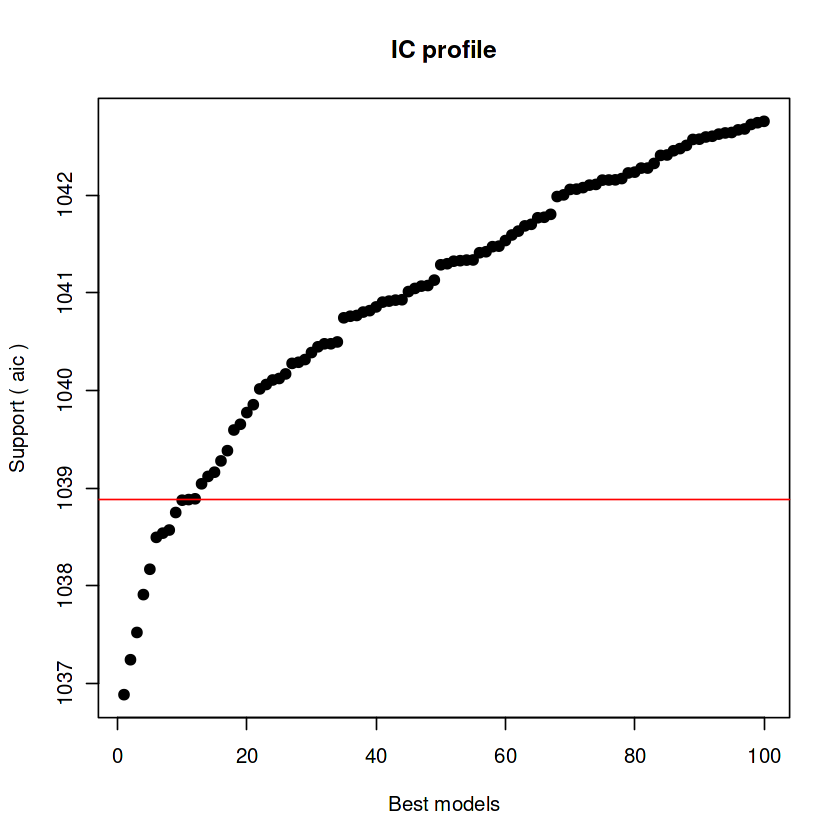


After 75100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.85680039312


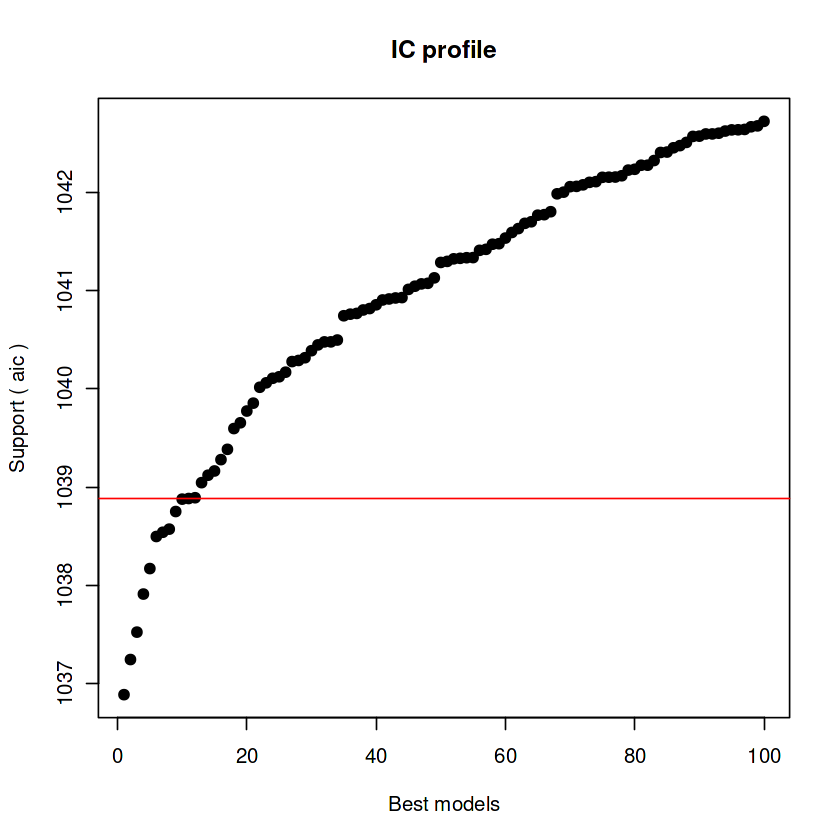


After 75150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.83904448264


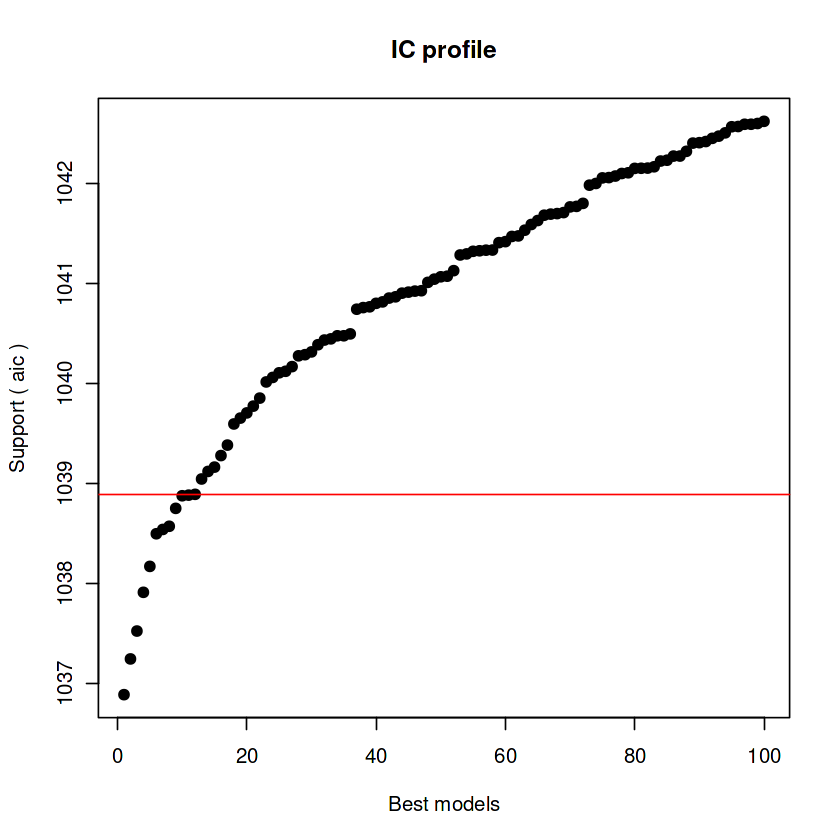


After 75200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.71857003365


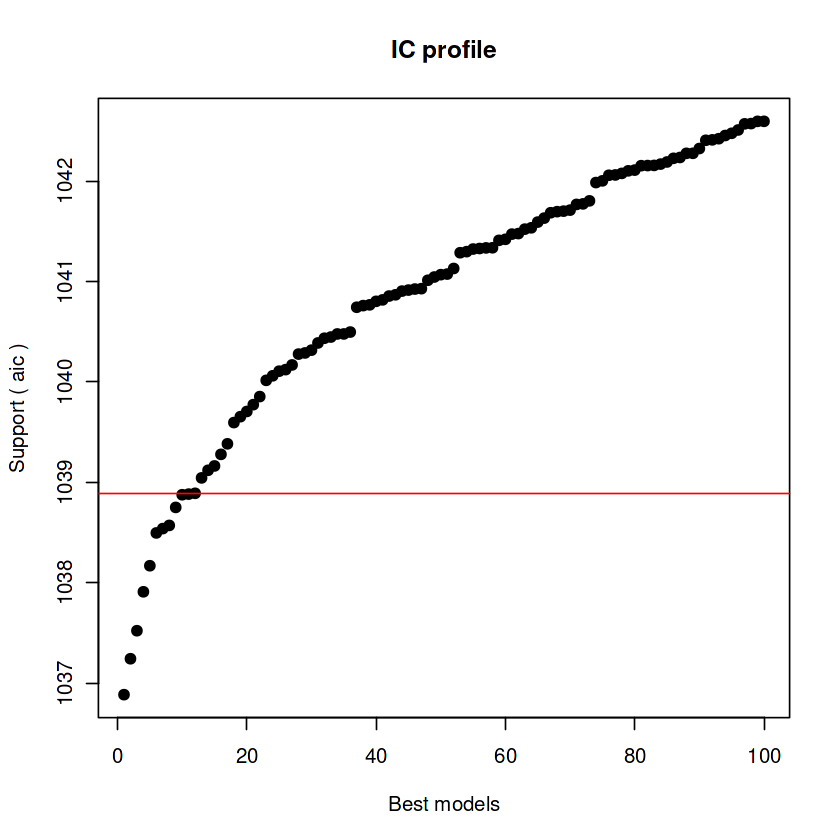


After 75250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.70299836922


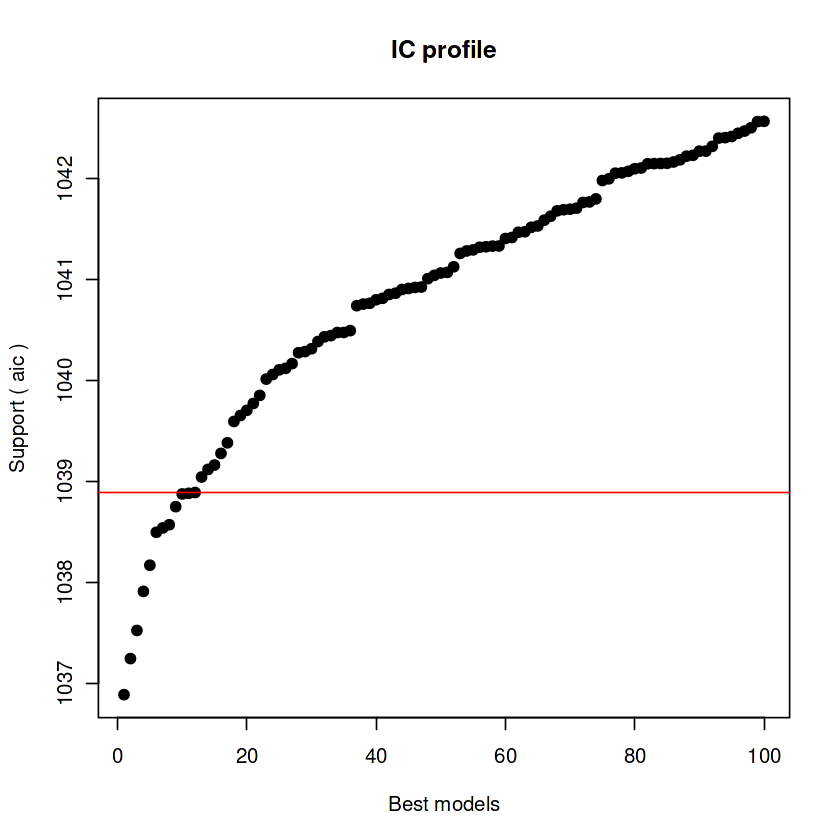


After 75300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.67138864471


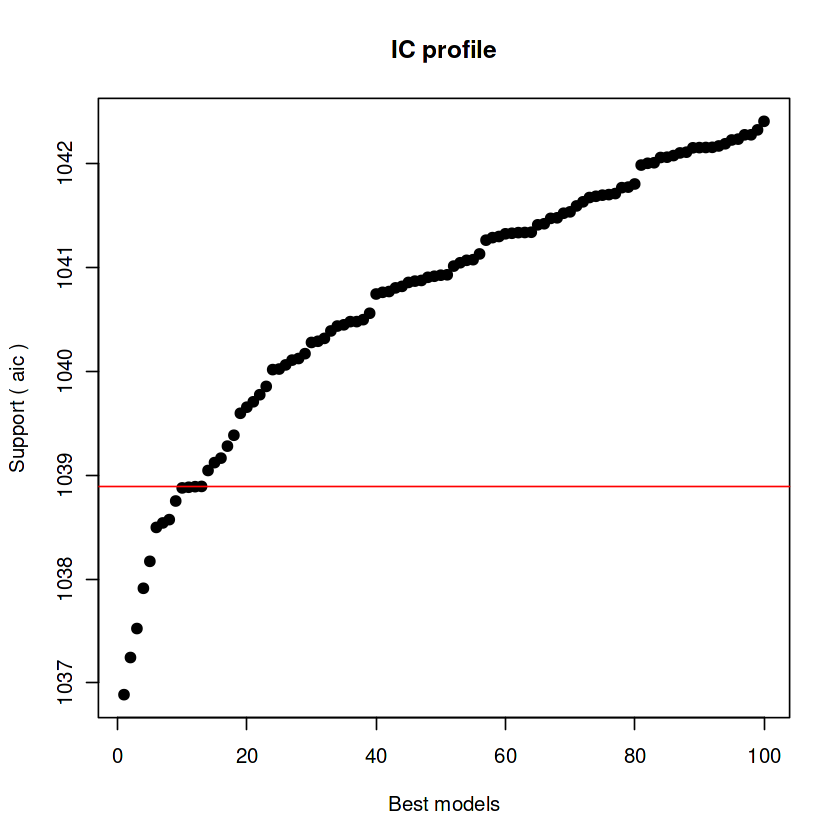


After 75350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.60063648066


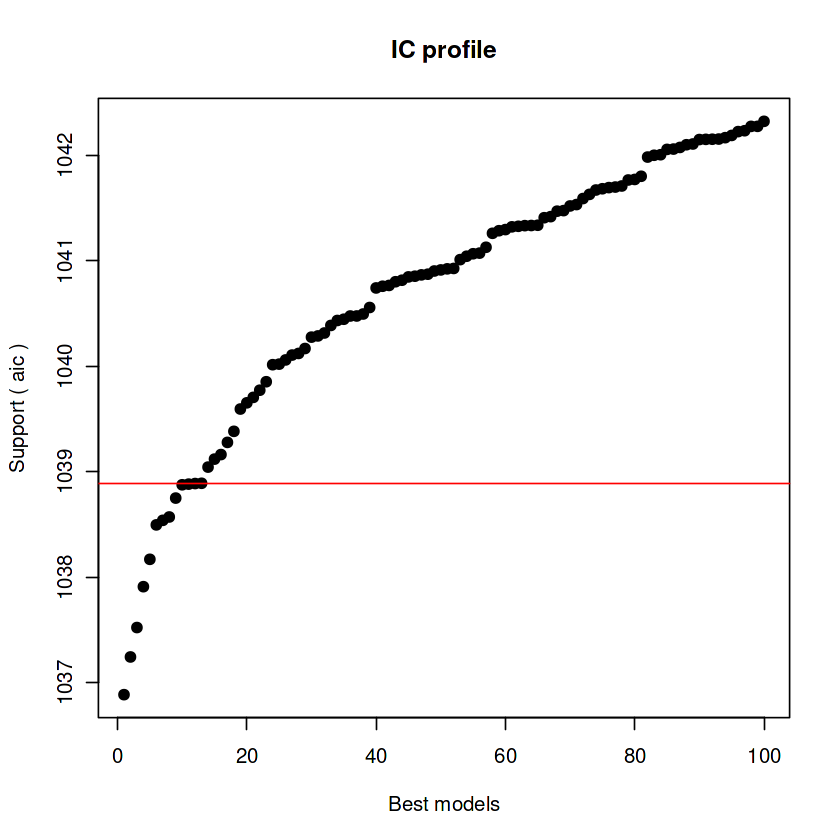


After 75400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.59225417956


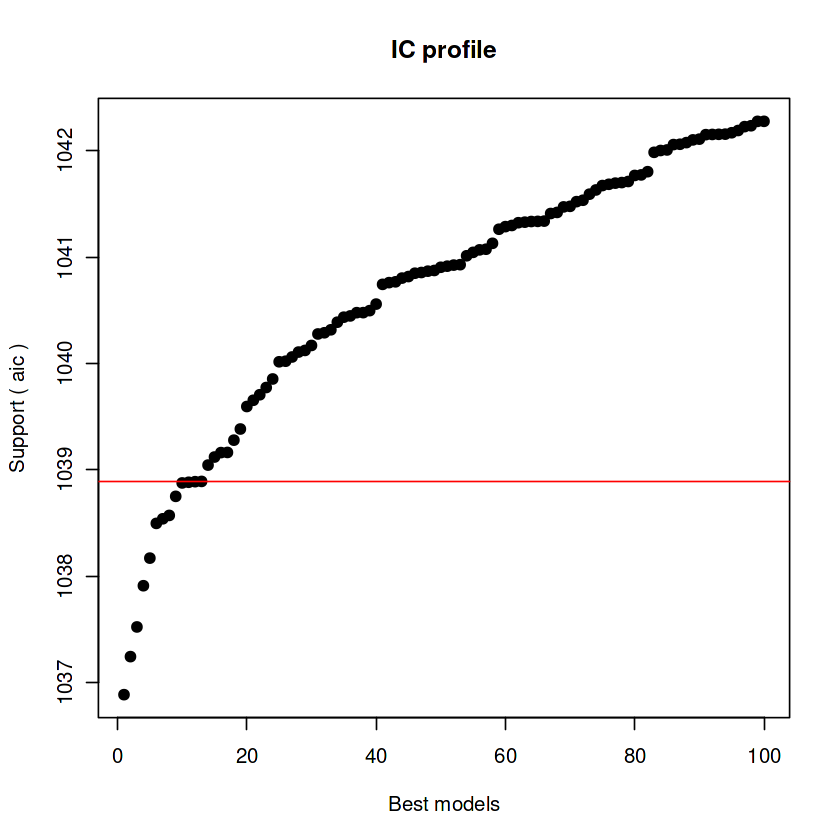


After 75450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.49582389105


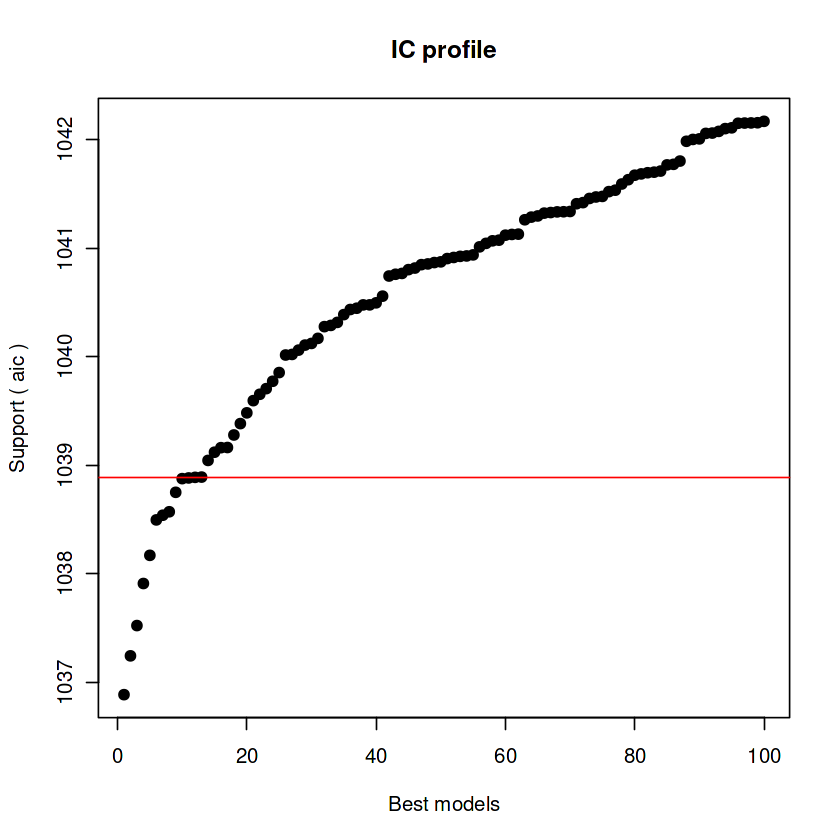


After 75500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.46433399387


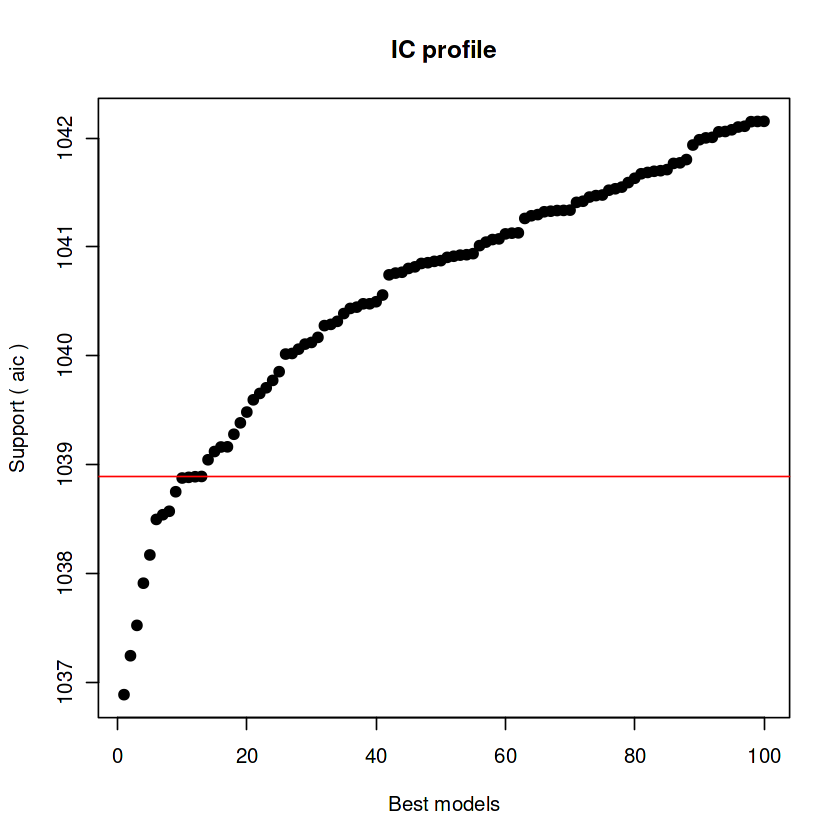


After 75550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.46433399387


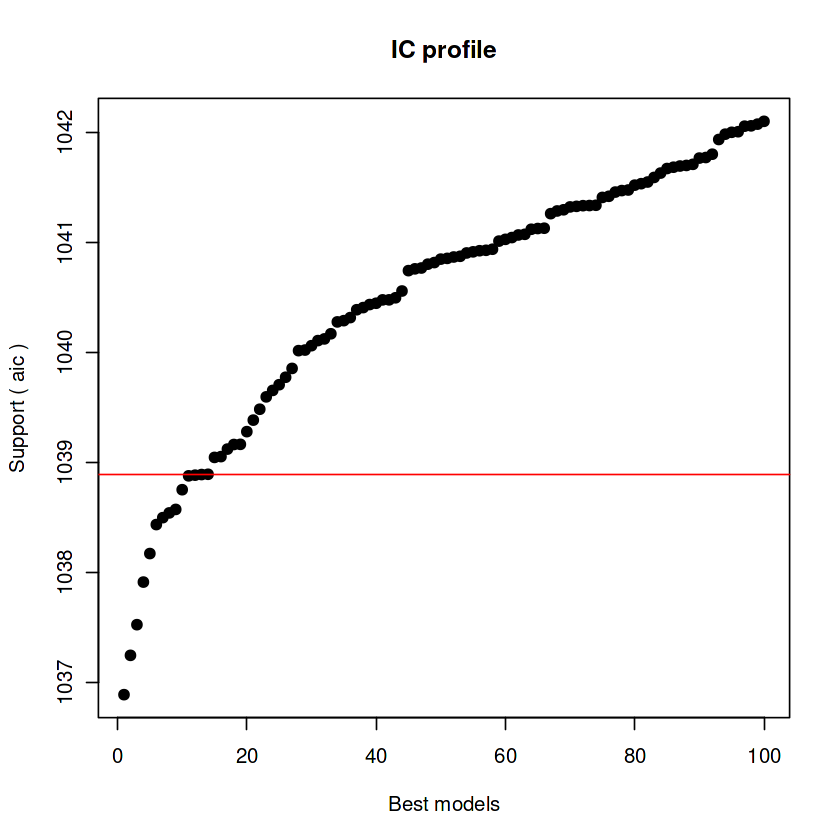


After 75600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.43771000729



After 75650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.43771000729


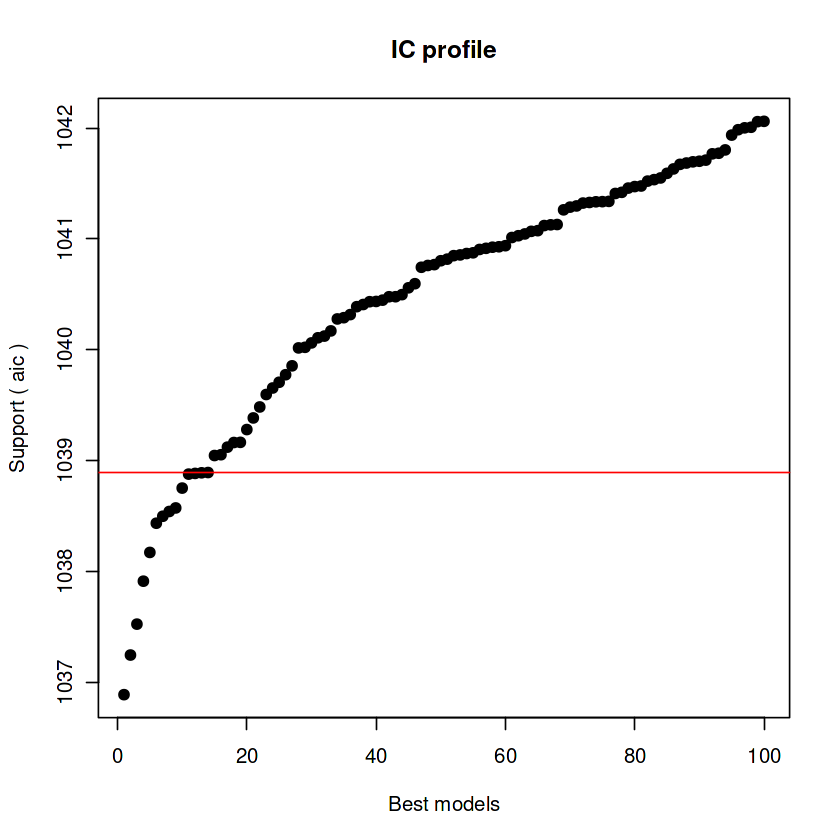


After 75700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.40029382186



After 75750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.39626089497


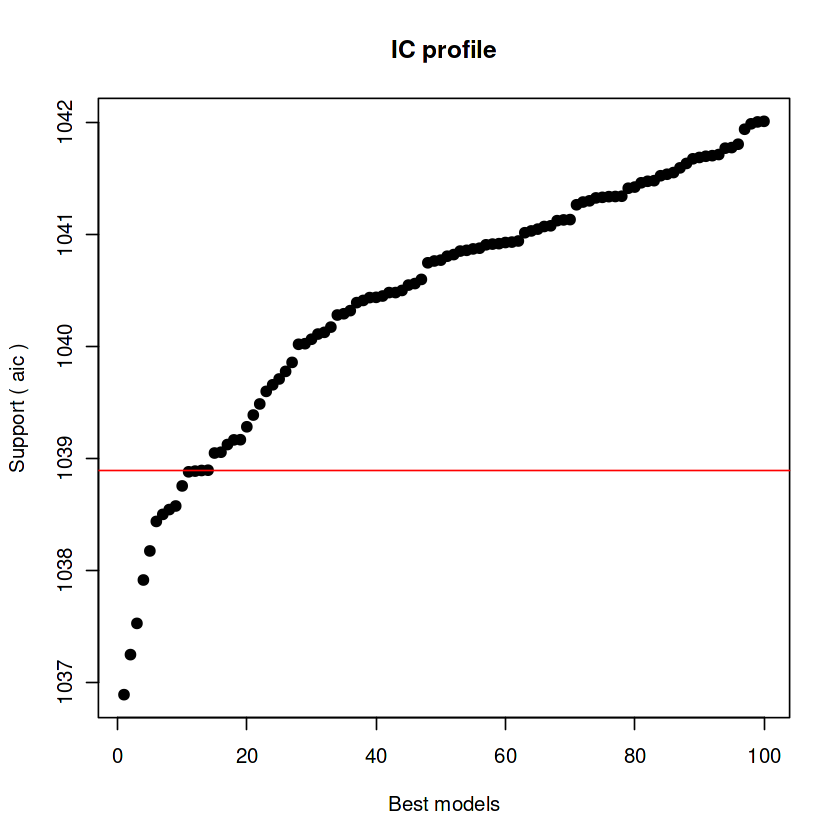


After 75800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+Income.composition.of.resources
Crit= 1036.88766947632
Mean crit= 1040.30409301217


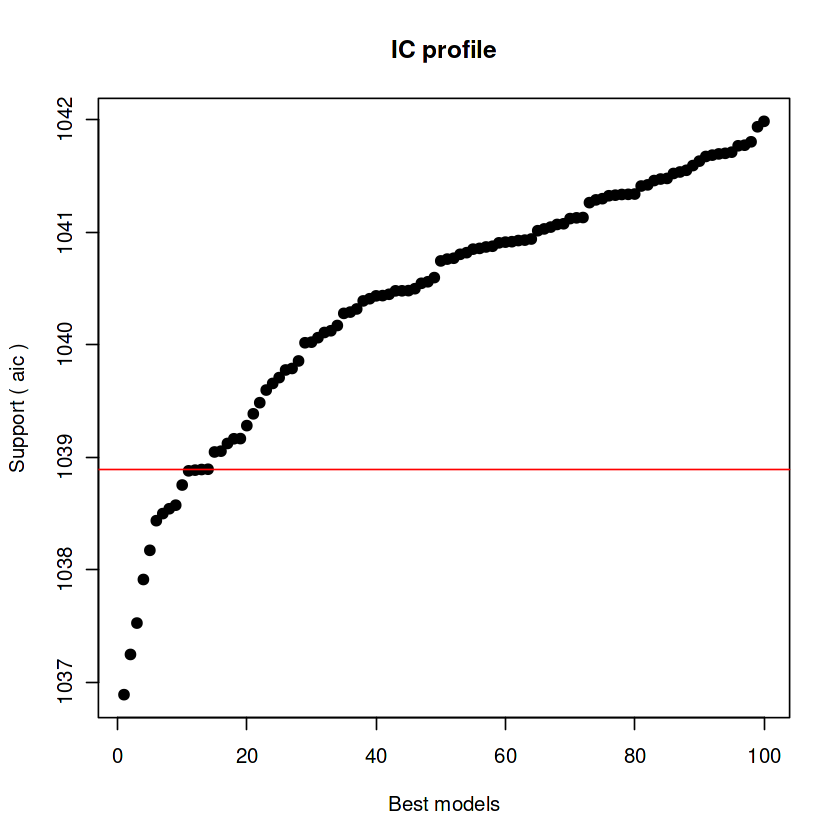


After 75850 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+Hepatitis.B+BMI+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.71489189598
Mean crit= 1040.10020318486


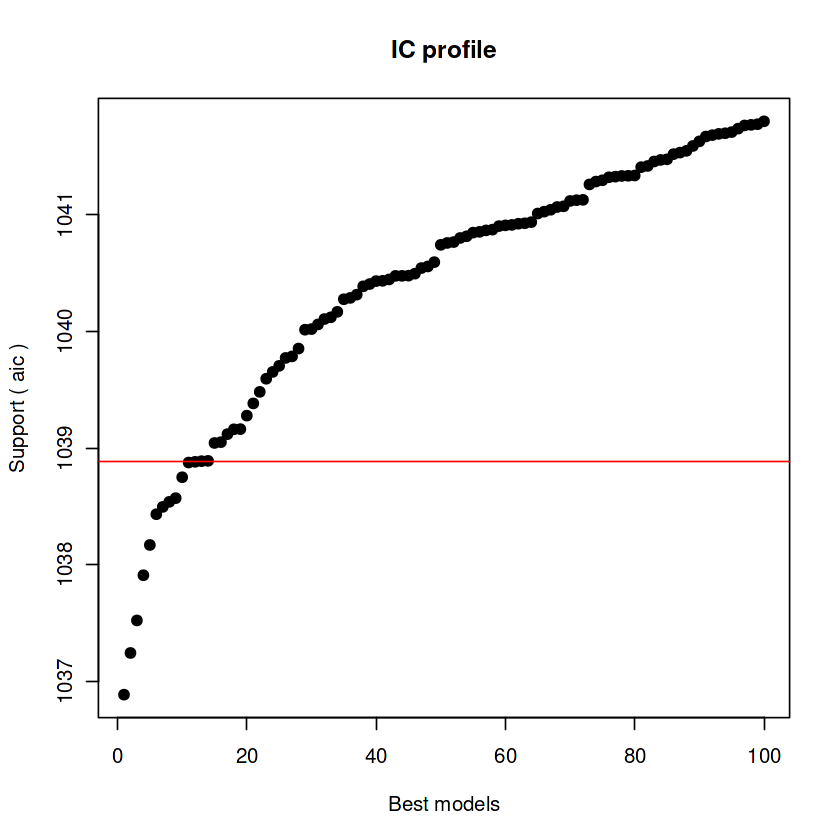


After 75900 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+Hepatitis.B+BMI+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.71489189598
Mean crit= 1039.92561447917


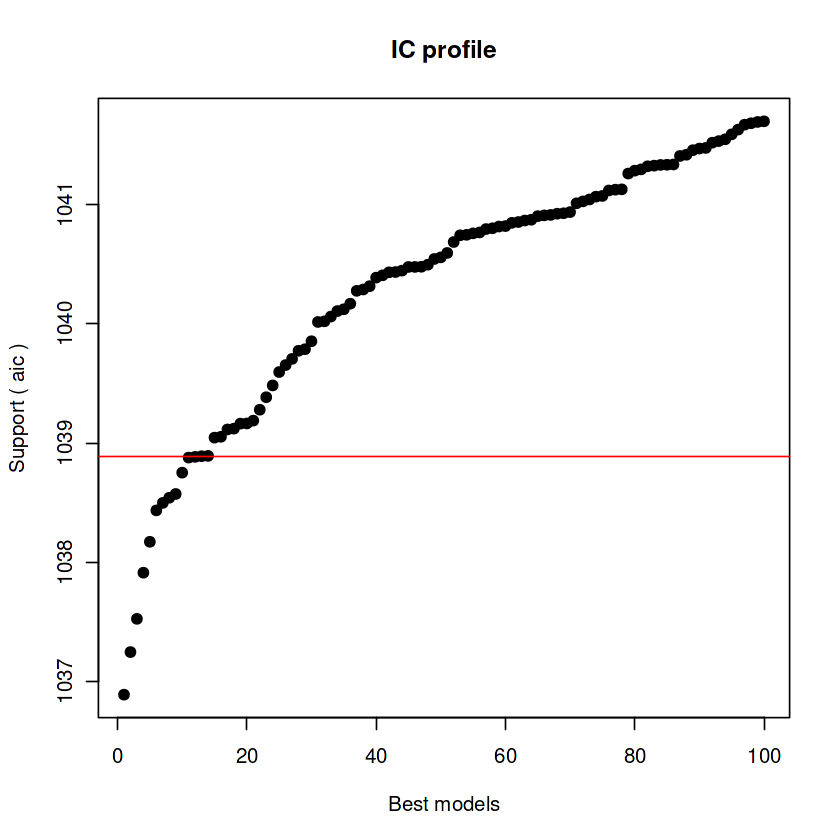


After 75950 models:
Best model: Life.expectancy~1+Adult.Mortality+Alcohol+Hepatitis.B+BMI+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.71489189598
Mean crit= 1039.85844509731


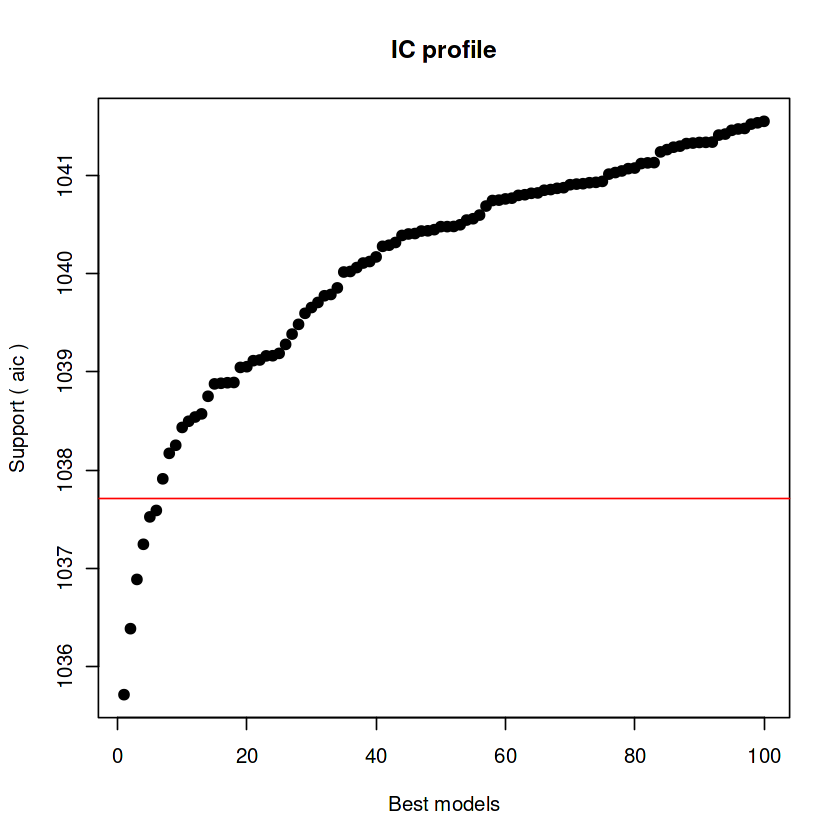


After 76000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.59042827854


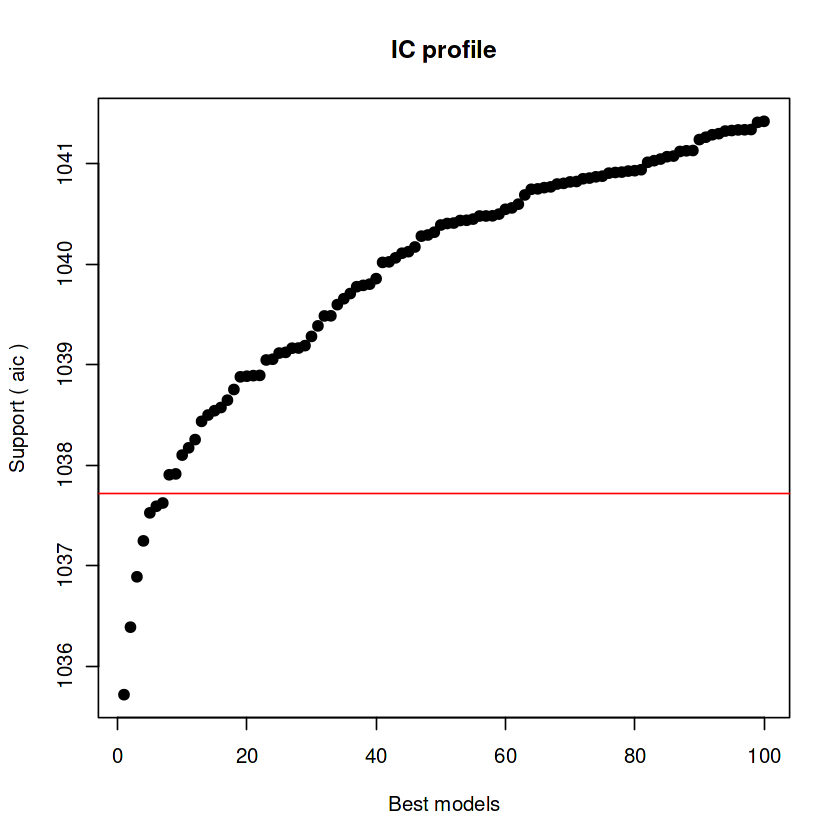


After 76050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.54154460356


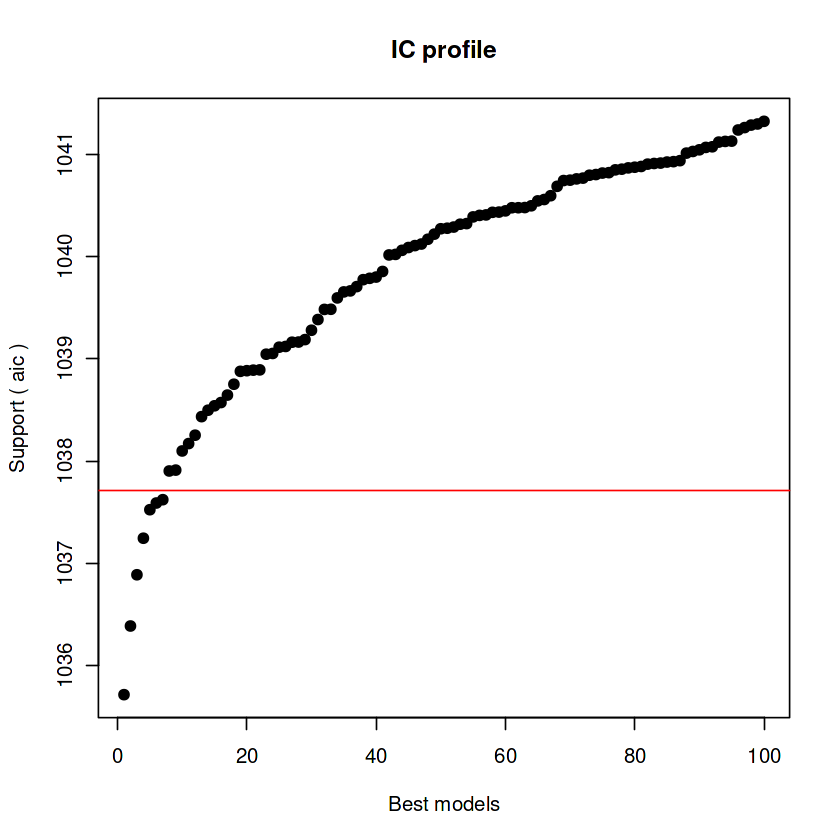


After 76100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.47126635363


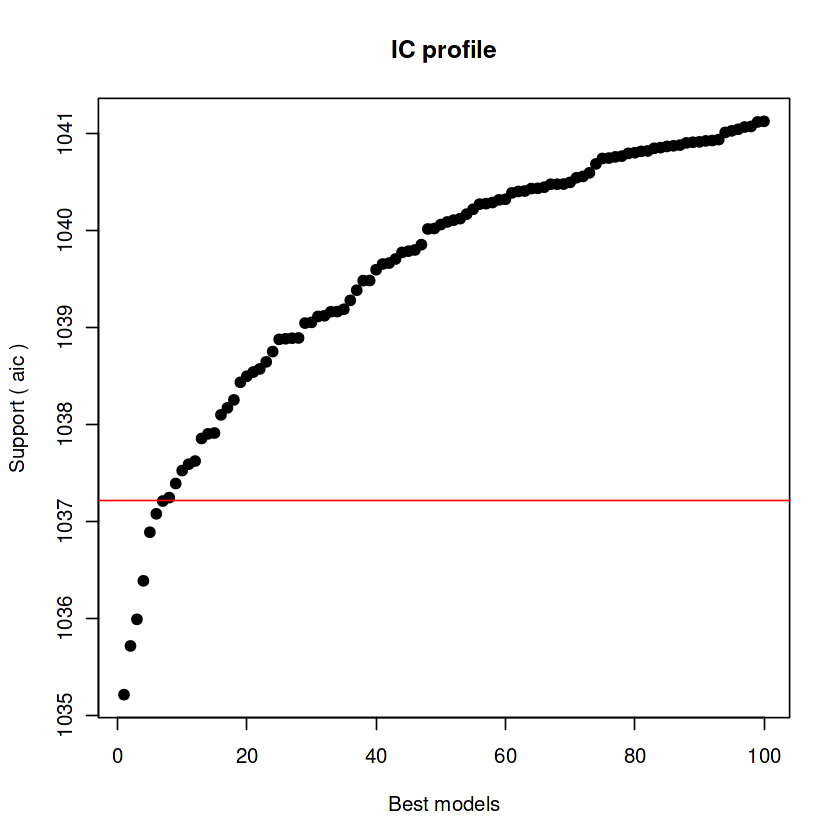


After 76150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.40690887804


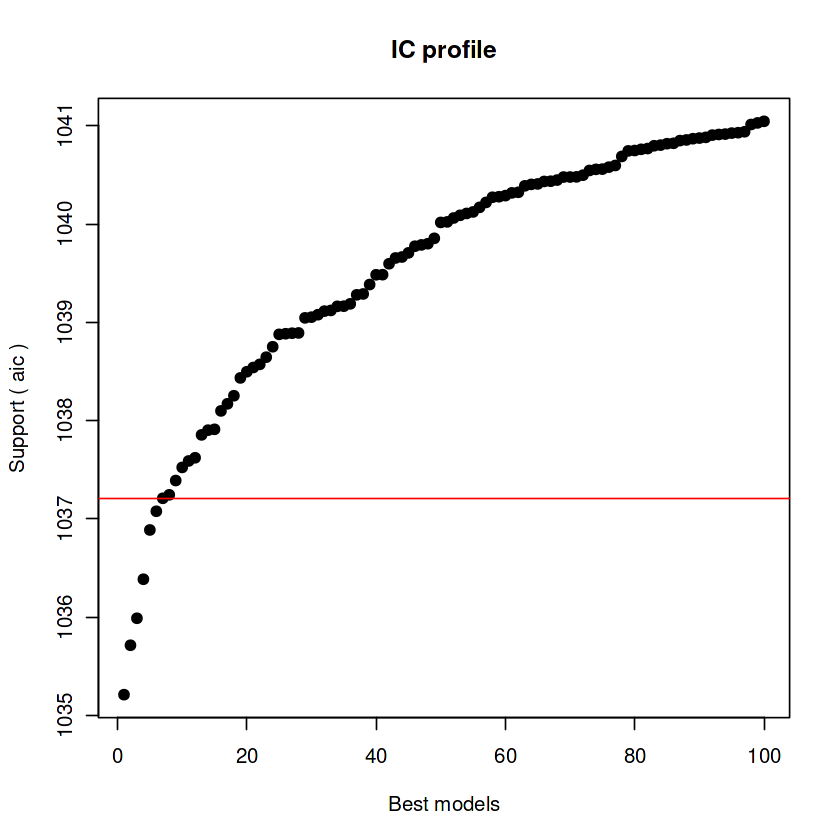


After 76200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.38420046718


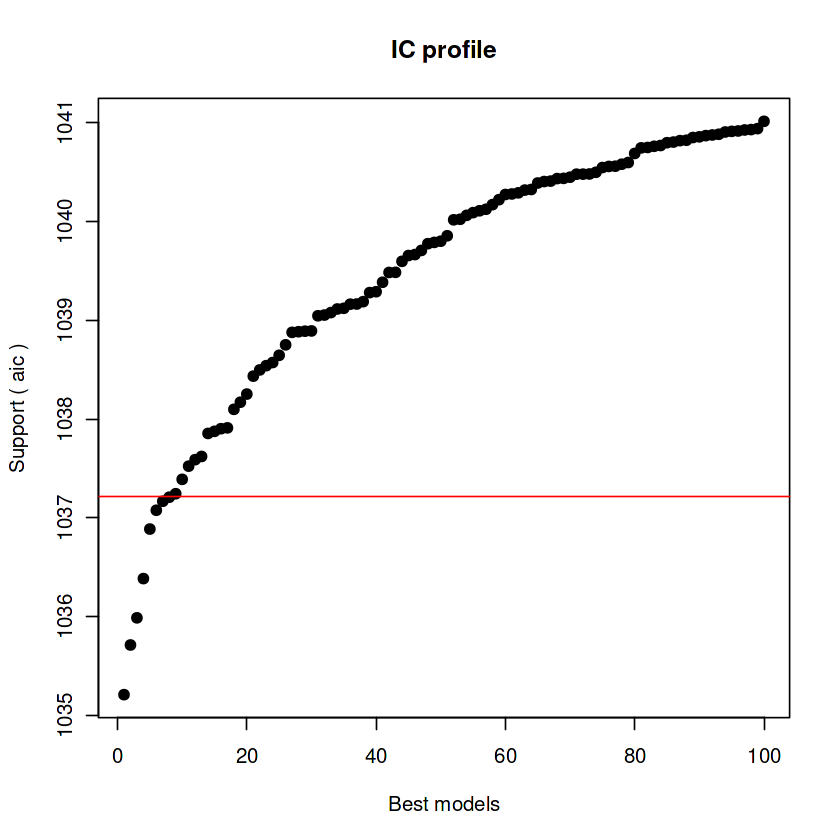


After 76250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.26916571704


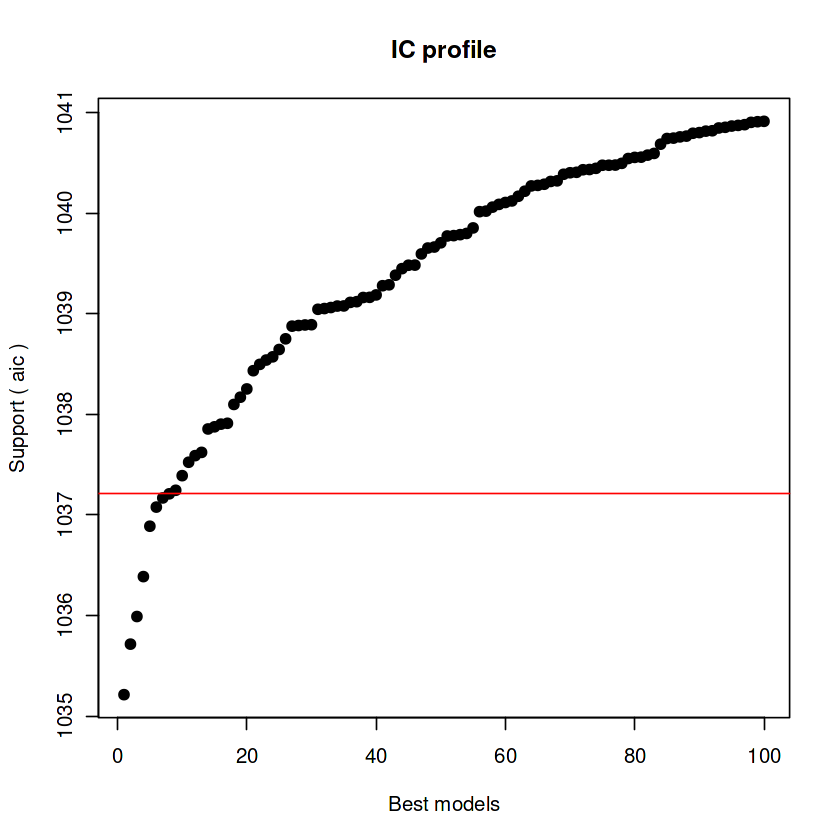


After 76300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584


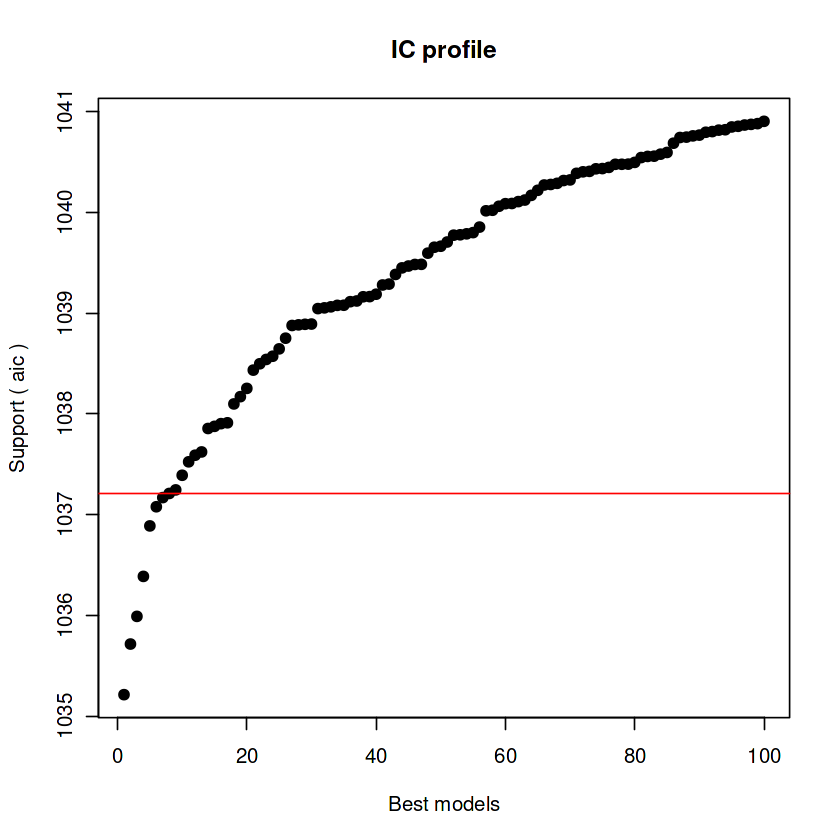


After 76350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584


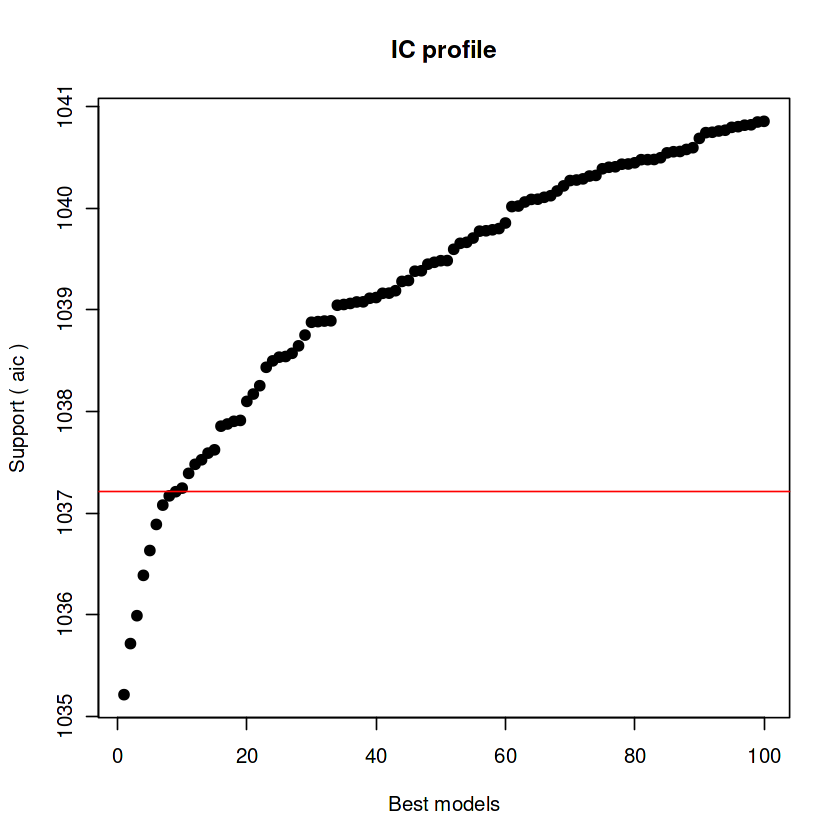


After 76400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 76450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 76500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 76550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 76600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 76650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 76700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 76750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 76800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 76850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 76900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 76950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 77950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 78950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.2249437584



After 79700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.22492259147



After 79750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.22492259147


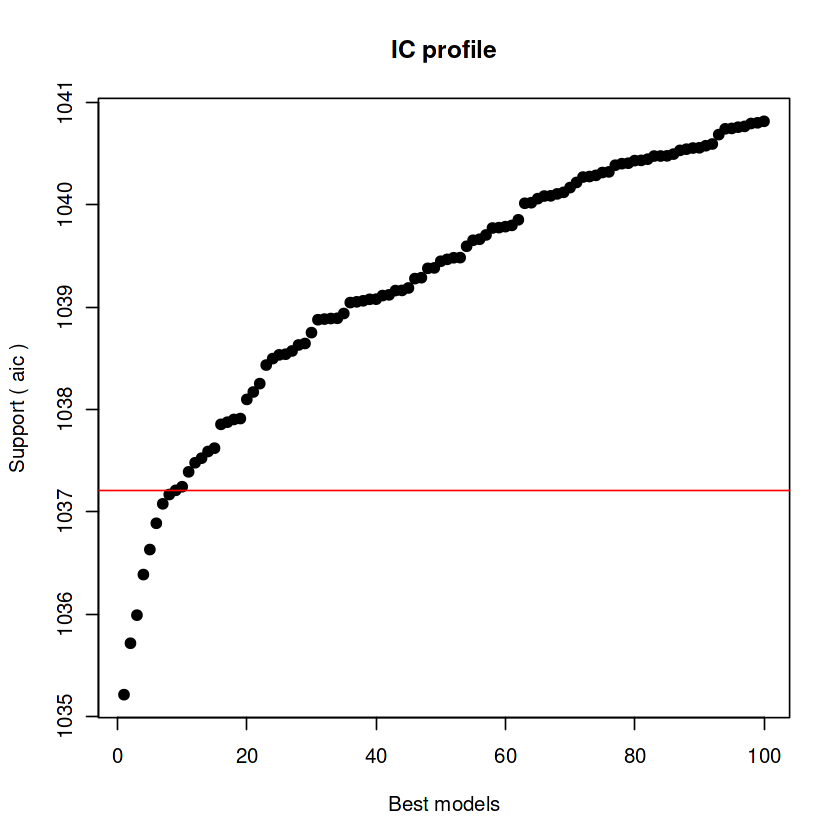


After 79800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.22492259147



After 79850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.22492259147



After 79900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.22492259147



After 79950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.22492259147



After 80000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.22492259147



After 80050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.22492259147



After 80100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.18338772965



After 80150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.18338772965


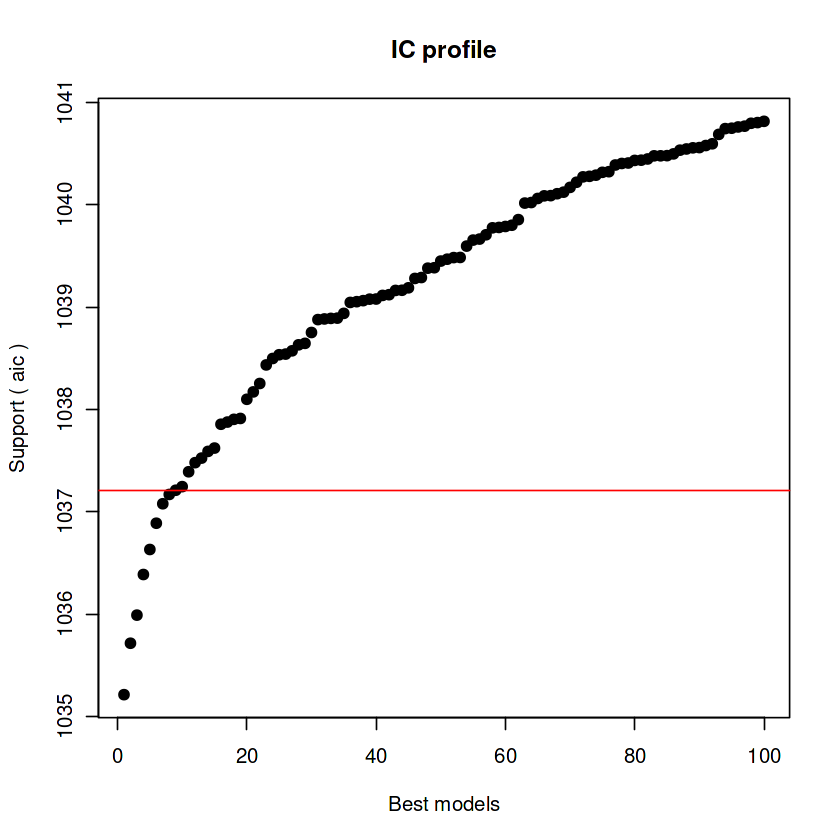


After 80200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.17737606089



After 80250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.13112042185


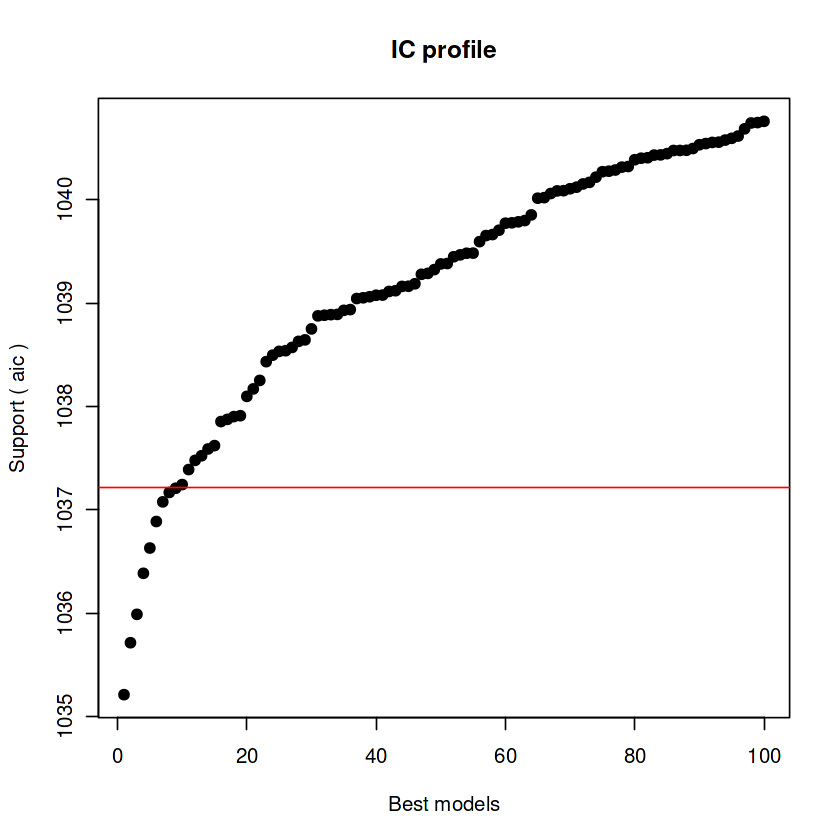


After 80300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.13112042185


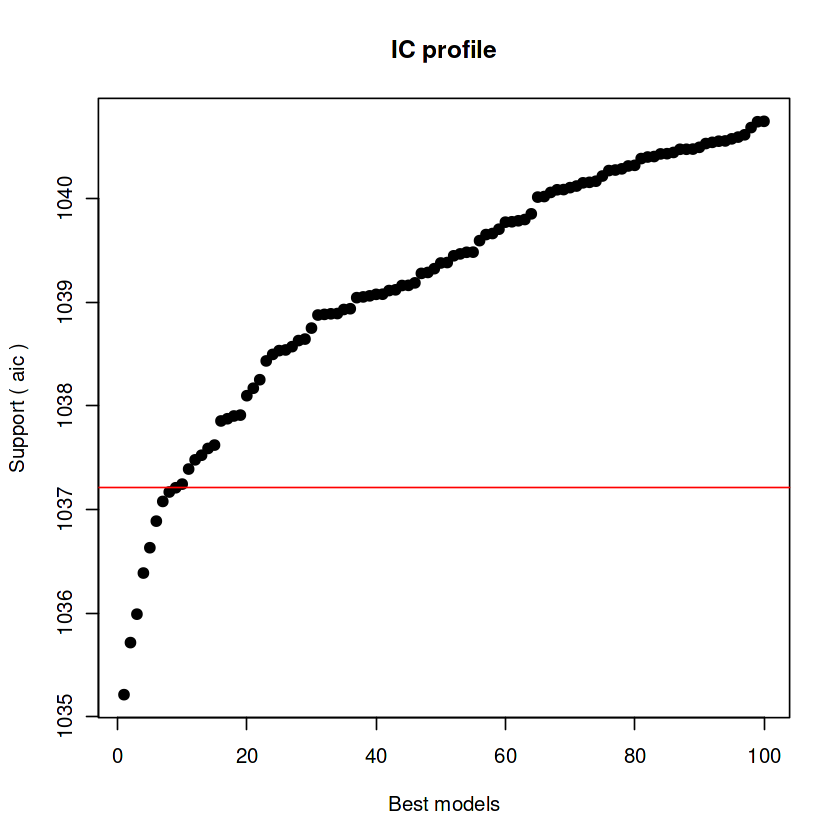


After 80350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1277813202



After 80400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1277813202


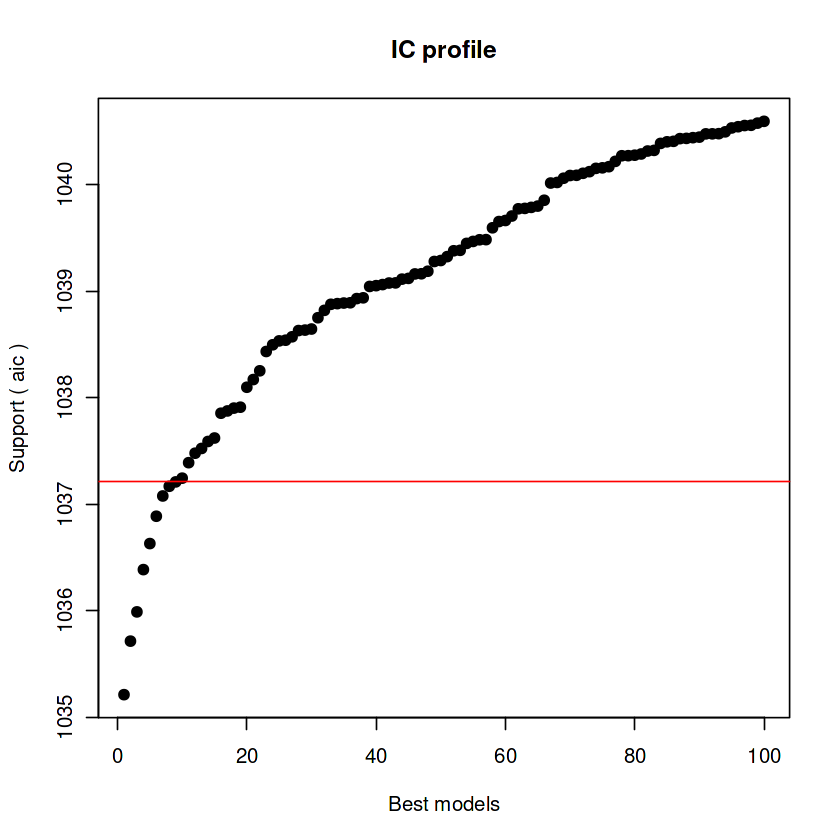


After 80450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1277813202



After 80500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 80550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275


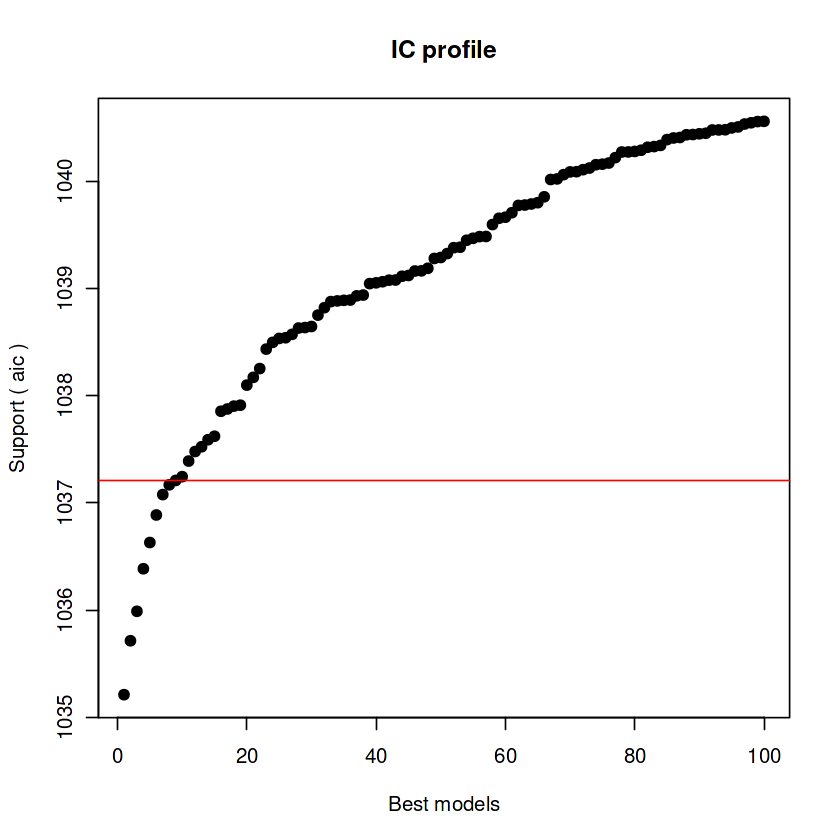


After 80600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 80650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 80700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 80750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 80800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 80850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 80900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 80950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 81950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 82950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.1168682275



After 83950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.11140447337



After 84000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.11140447337


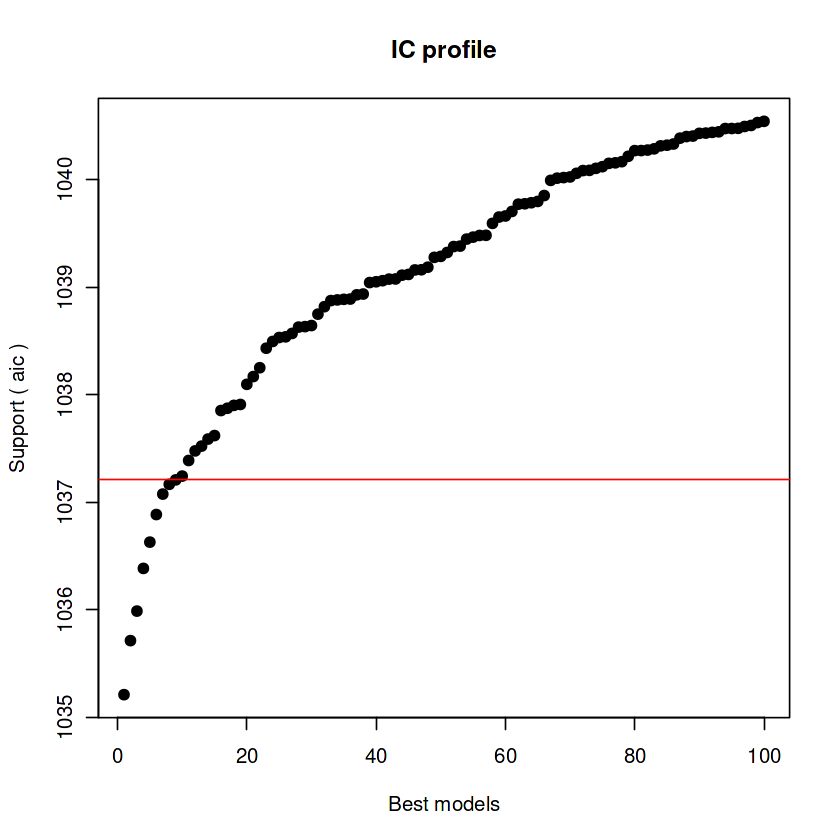


After 84050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.11140447337



After 84100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.11140447337



After 84150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.11140447337



After 84200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.11140447337



After 84250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.11084170297



After 84300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.11084170297


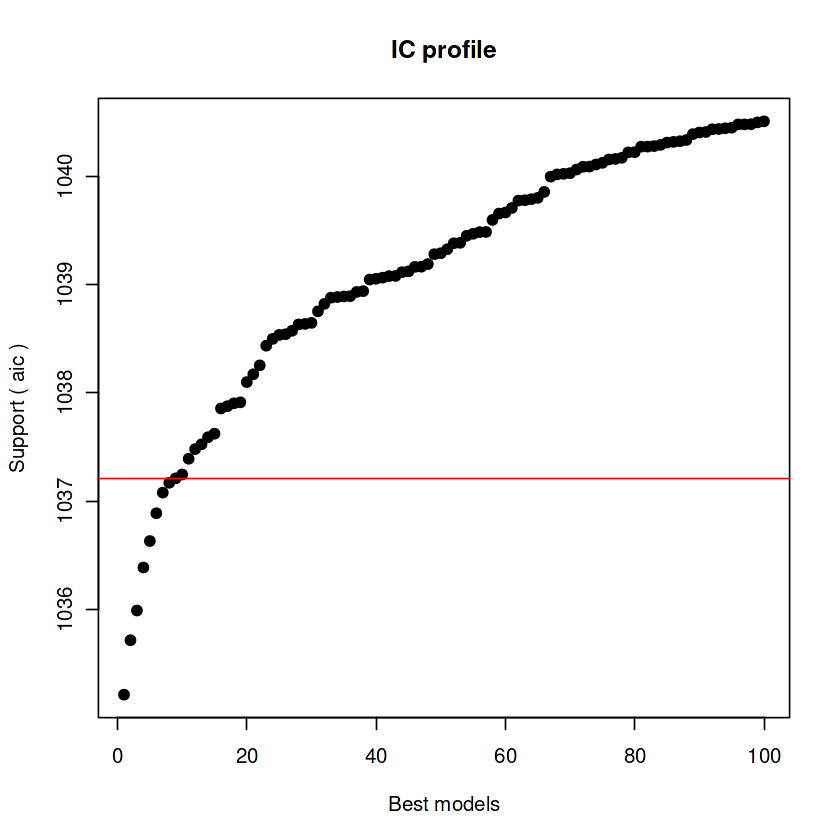


After 84350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.01145468402



After 84400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1039.00077116665


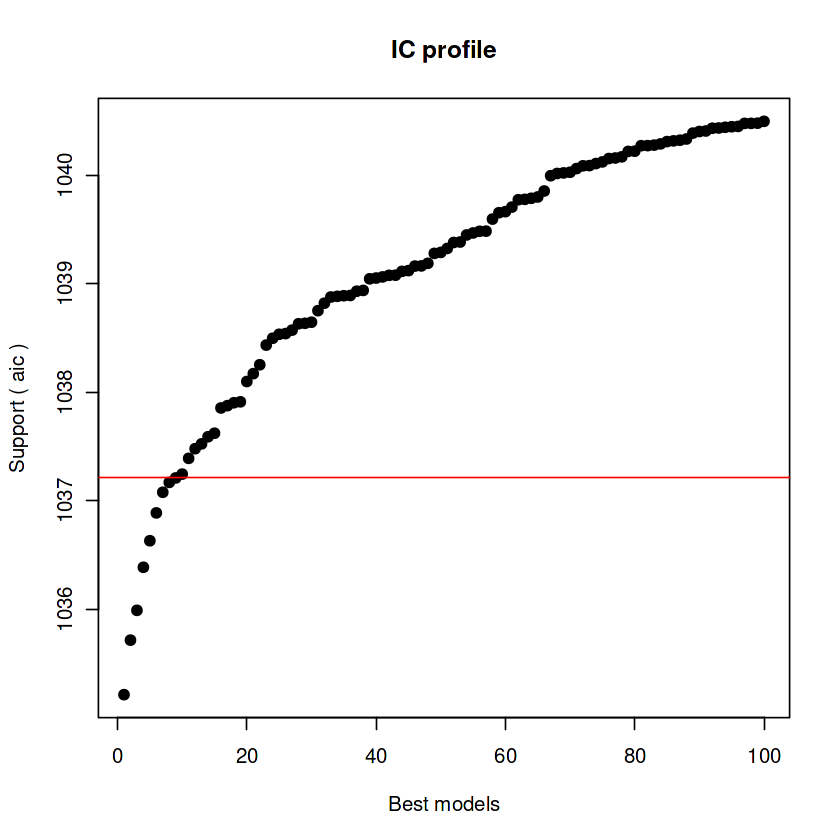


After 84450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.90556938393


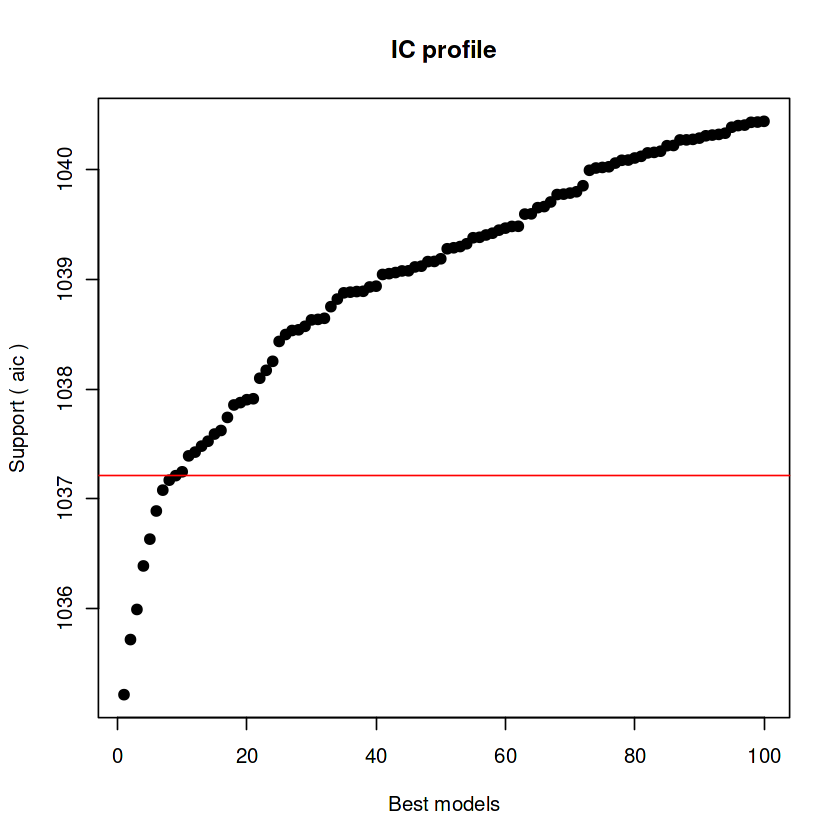


After 84500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.87757234288


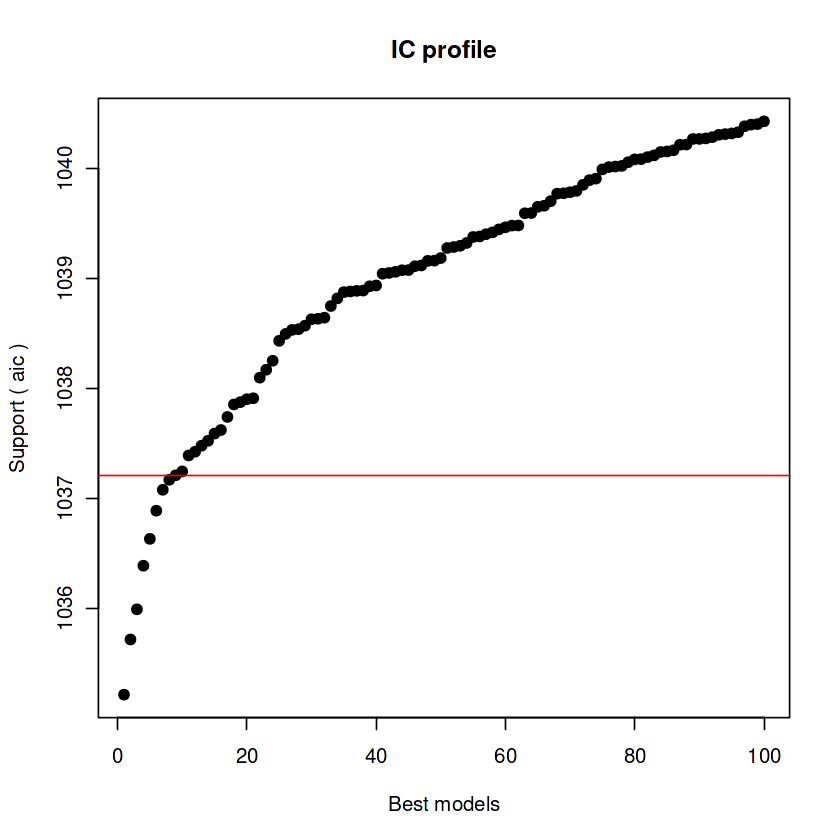


After 84550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.87757234288


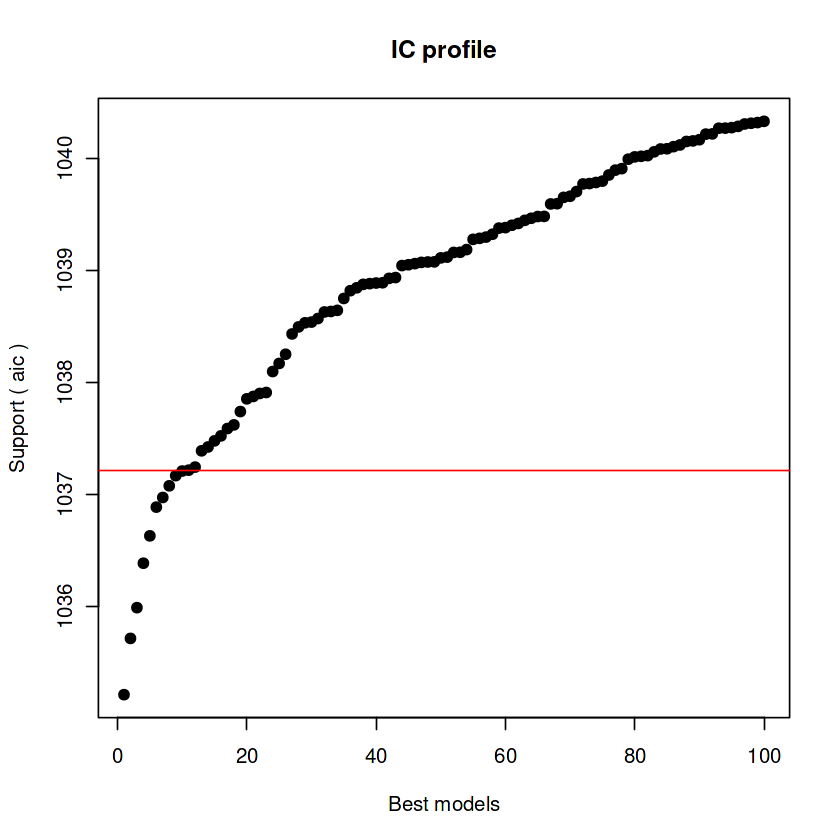


After 84600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.85130879514



After 84650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.85130879514


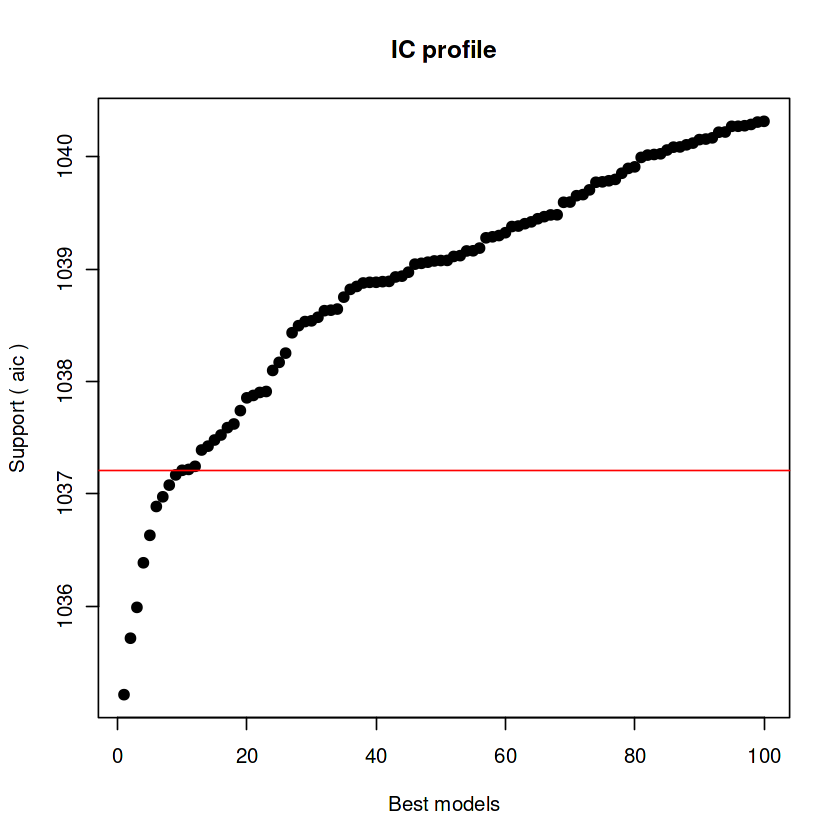


After 84700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.85130879514



After 84750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 84800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231


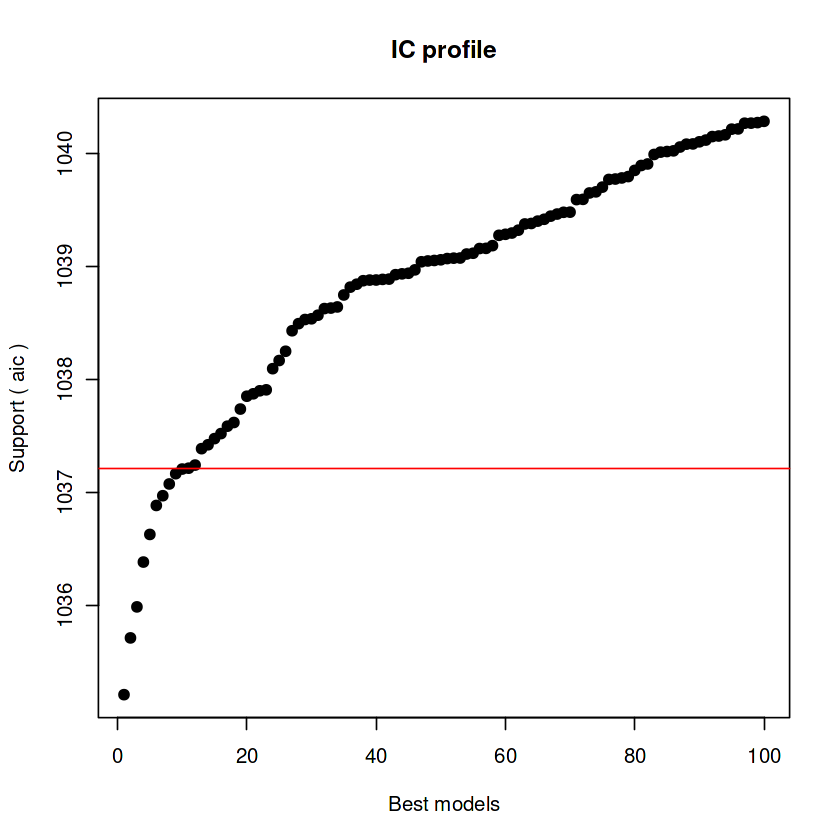


After 84850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 84900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 84950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 85950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 86950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 87000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.81580613231



After 87050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.80838134184



After 87100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.80684605053


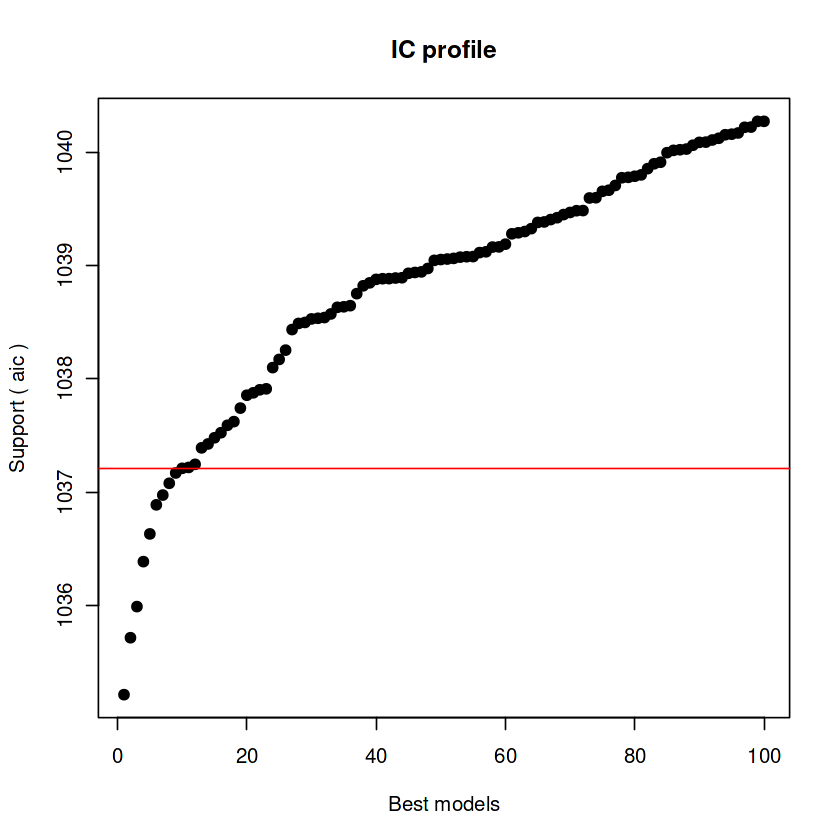


After 87150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.79752803131


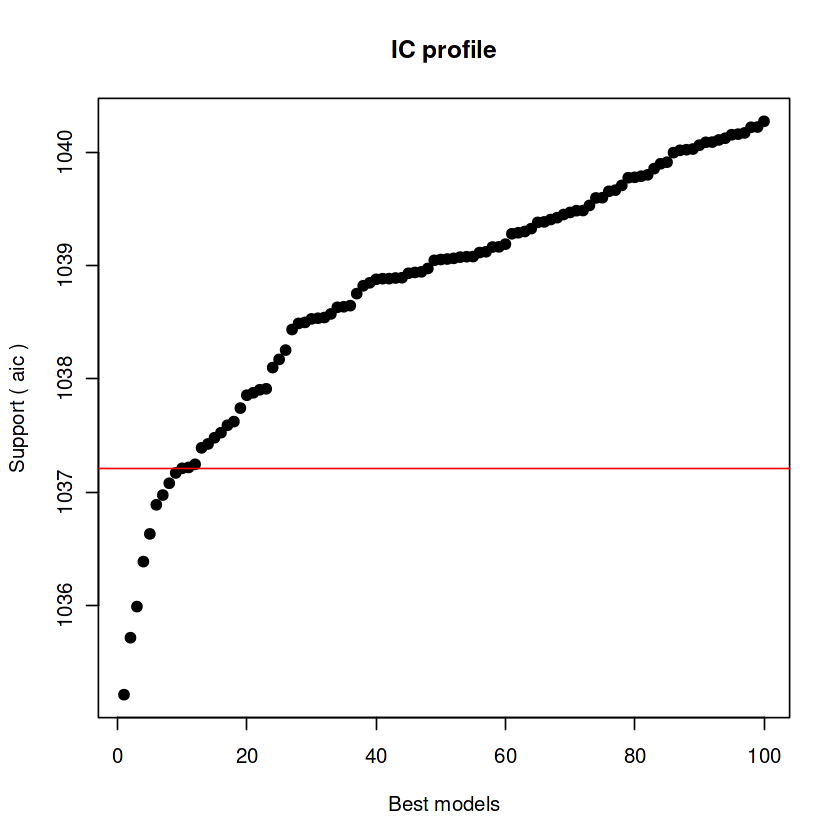


After 87200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.78649955226


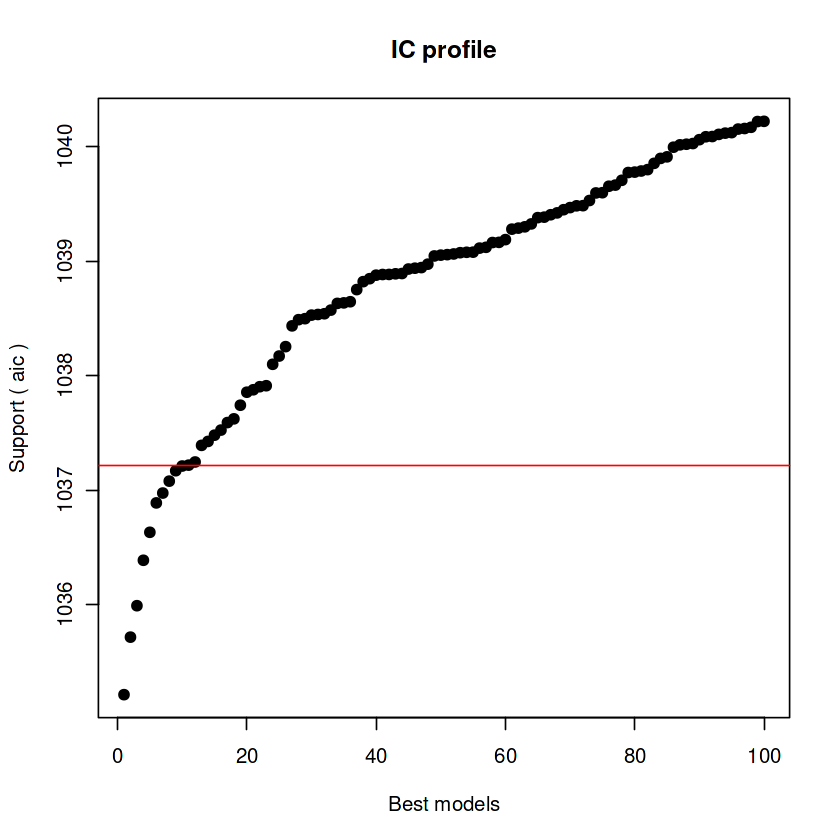


After 87250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1035.21231808604
Mean crit= 1038.77097324347


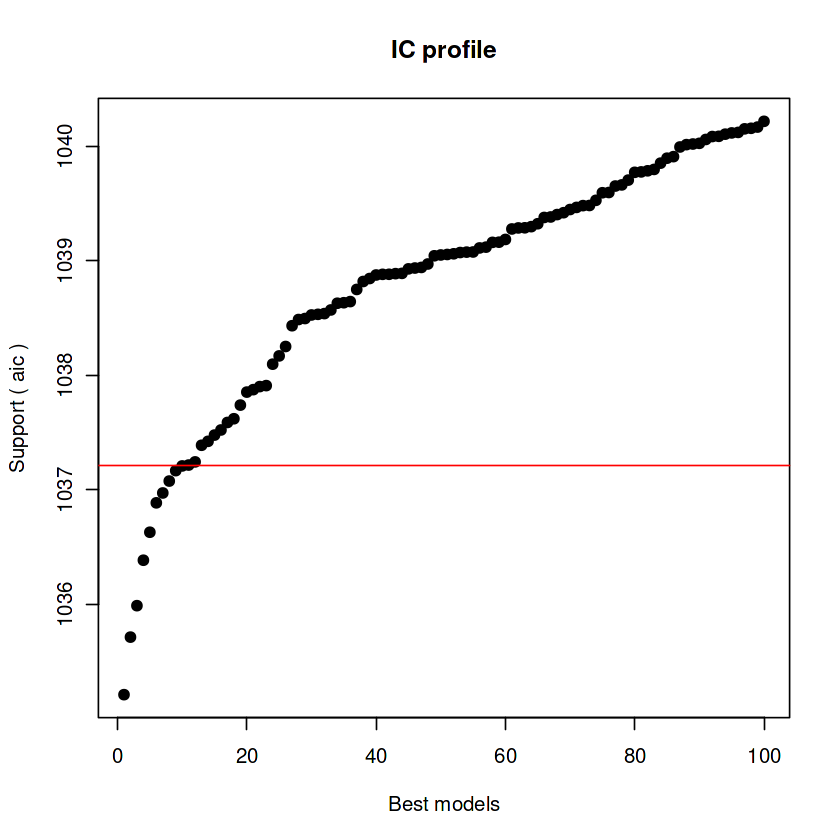


After 87300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1034.98389676623
Mean crit= 1038.61246100486


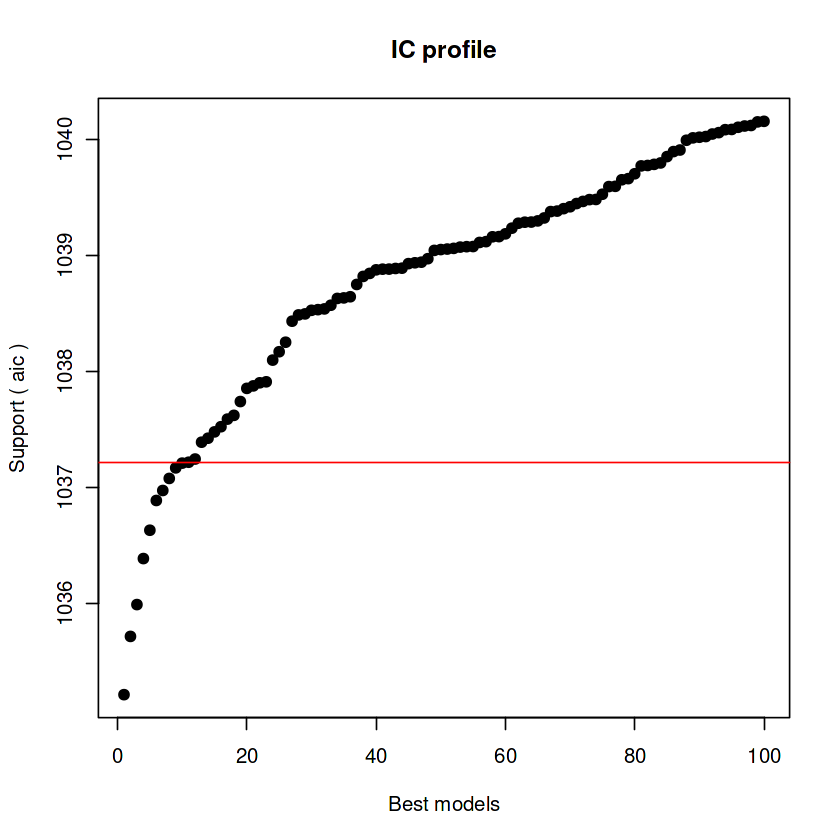


After 87350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1034.98389676623
Mean crit= 1038.44775816626


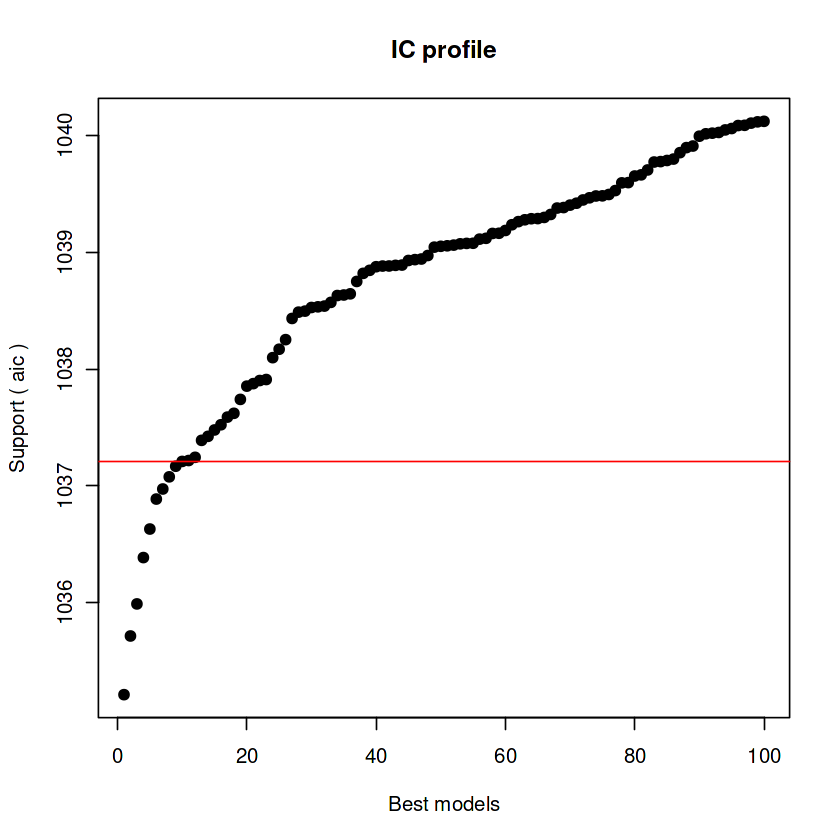


After 87400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1034.98389676623
Mean crit= 1038.31182751839


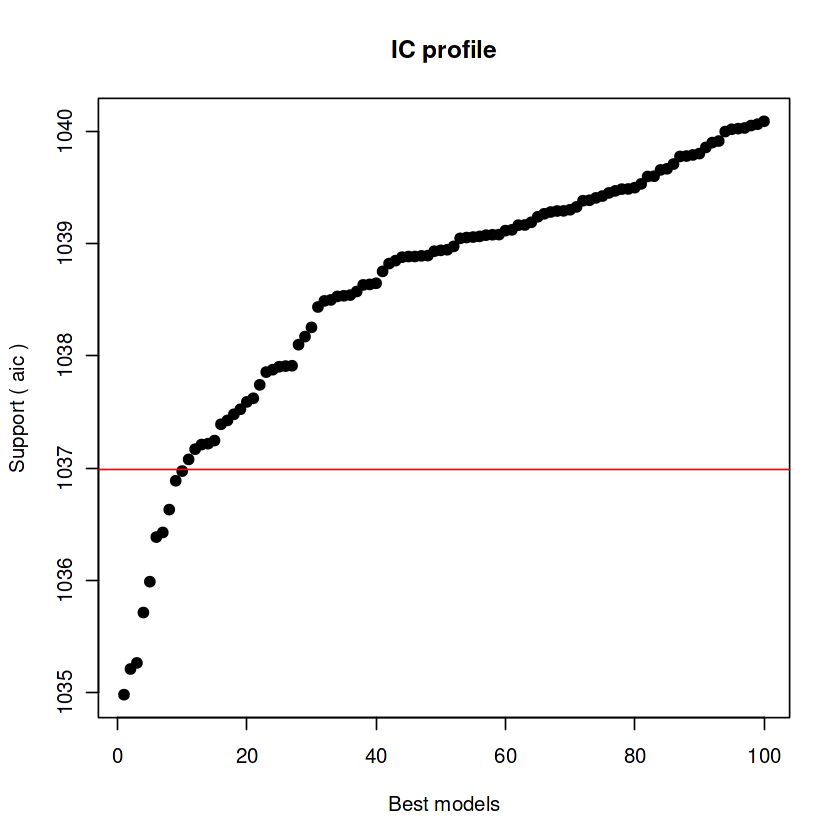


After 87450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1034.98389676623
Mean crit= 1038.31182751839


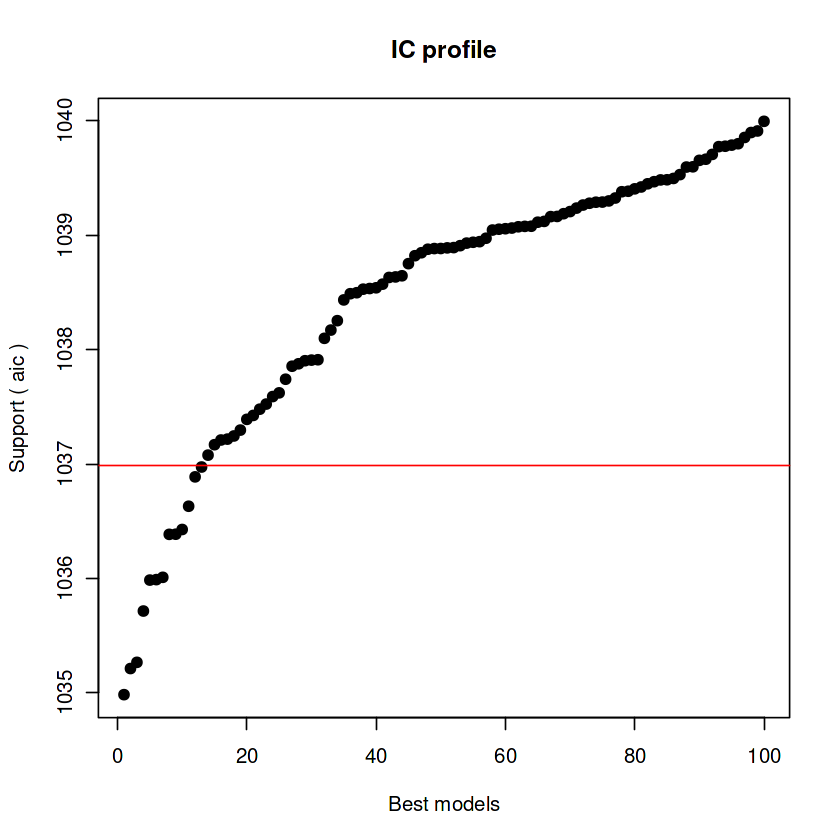


After 87500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1034.98389676623
Mean crit= 1038.31182751839



After 87550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1034.98389676623
Mean crit= 1038.26398633617



After 87600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1034.98389676623
Mean crit= 1038.23012694186


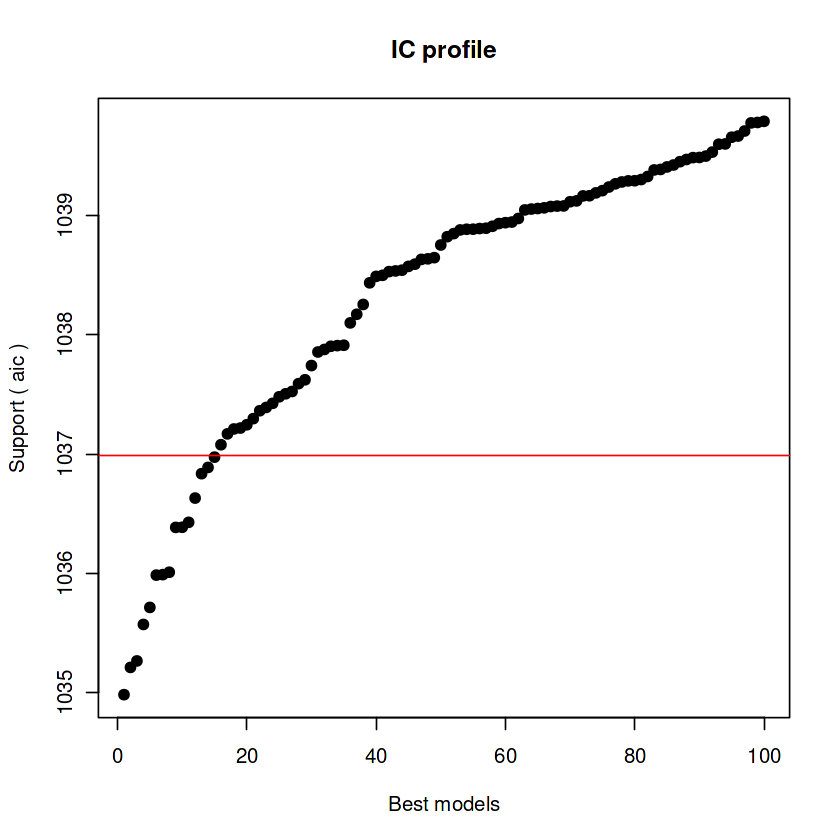


After 87650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1034.98389676623
Mean crit= 1038.18785688292


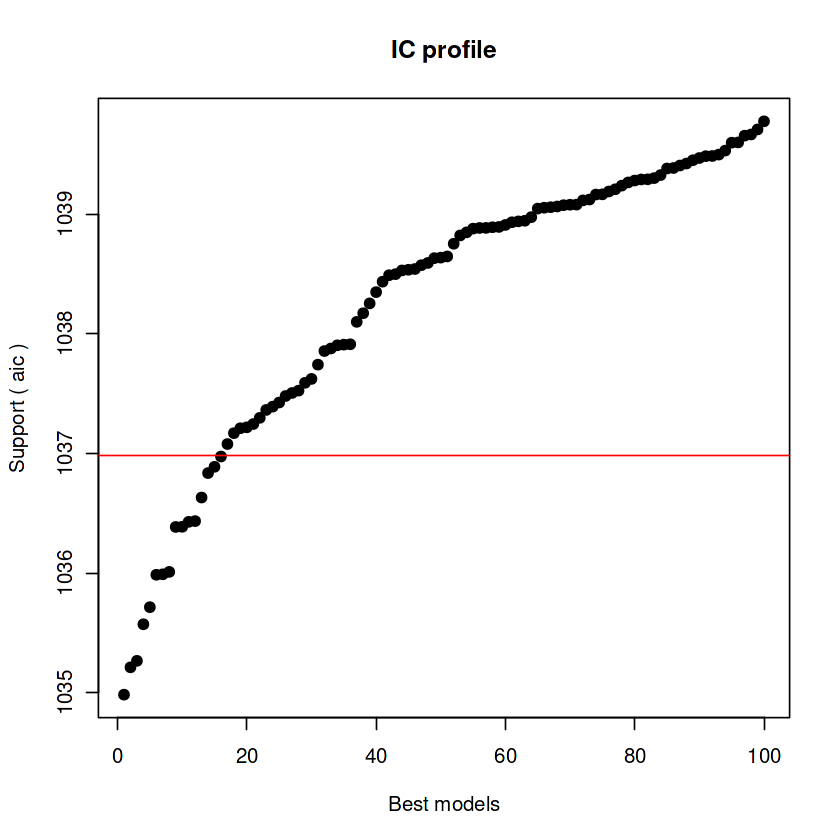


After 87700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1034.98389676623
Mean crit= 1038.10422791518


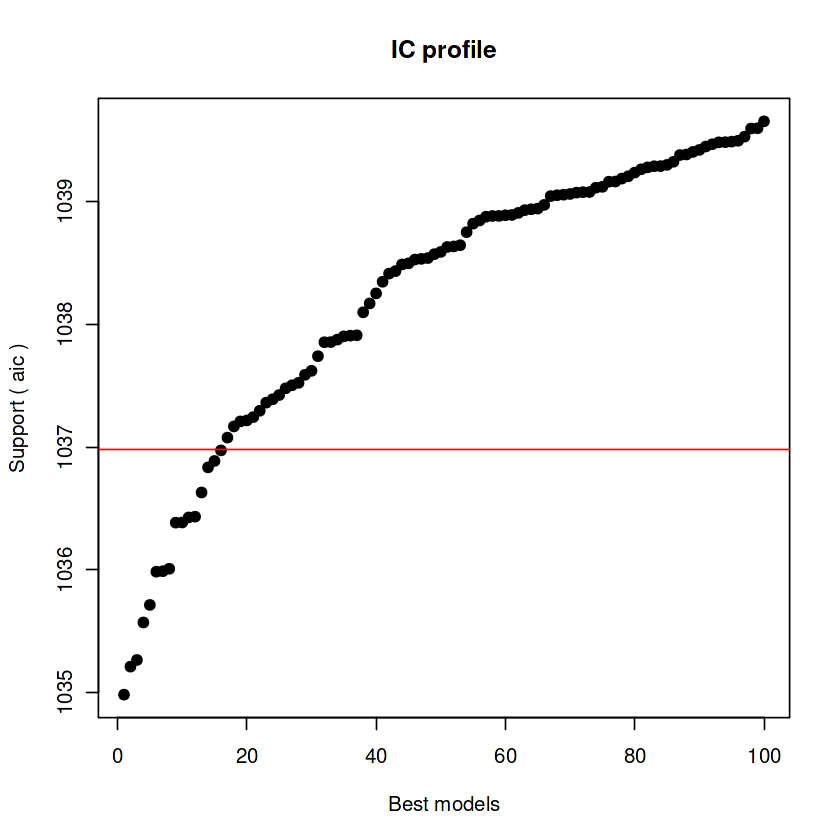


After 87750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1034.98389676623
Mean crit= 1038.06130152709


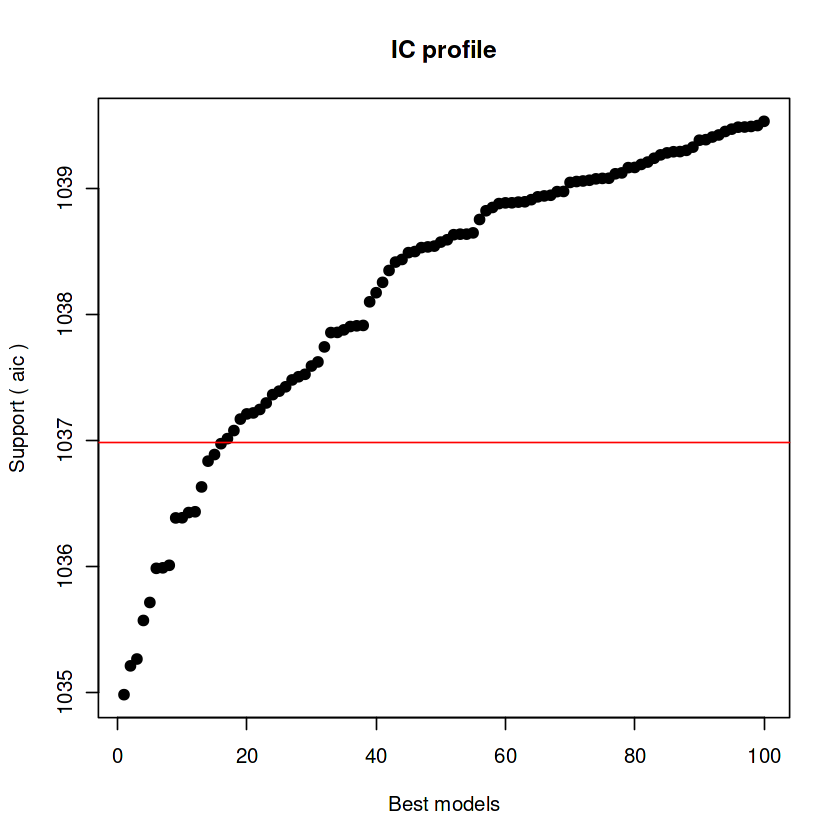


After 87800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1034.98389676623
Mean crit= 1037.99647513658


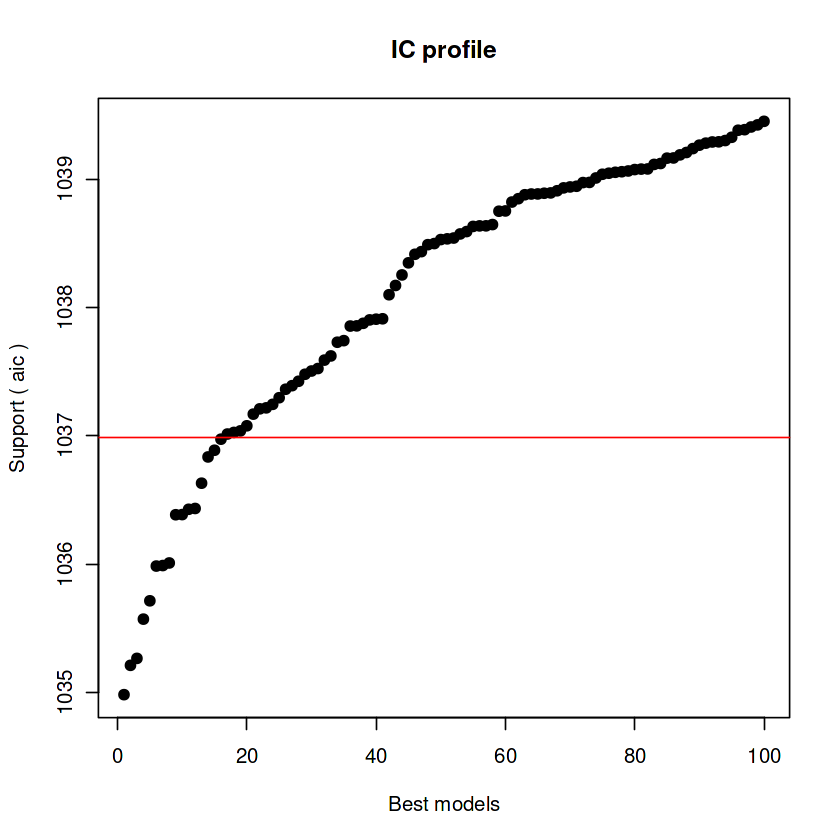


After 87850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1033.1079452225
Mean crit= 1037.72040522942


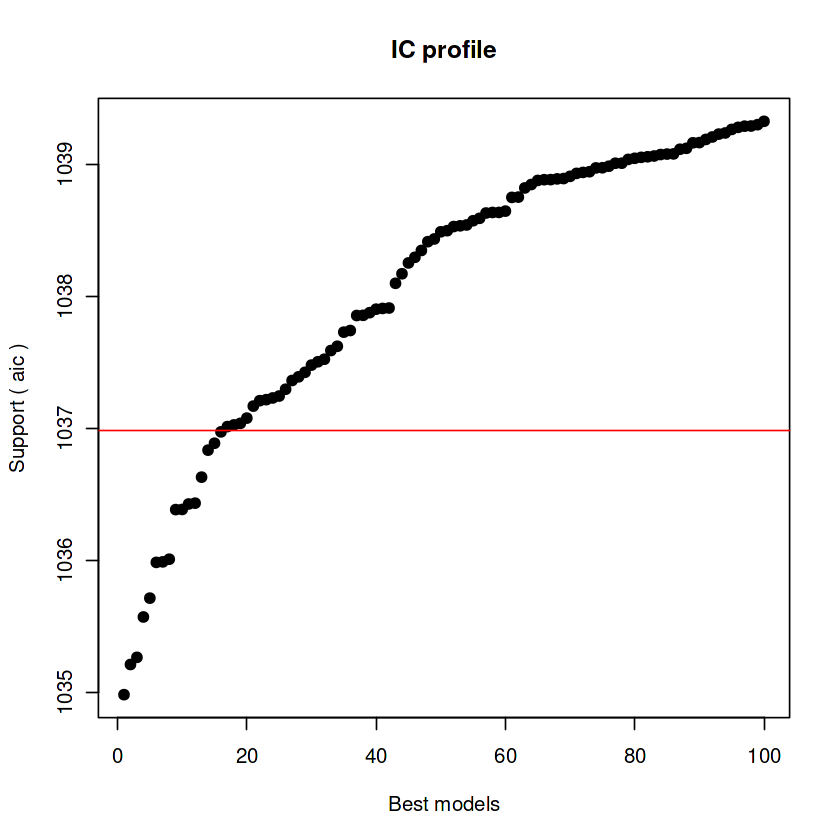


After 87900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1033.1079452225
Mean crit= 1037.50474214997


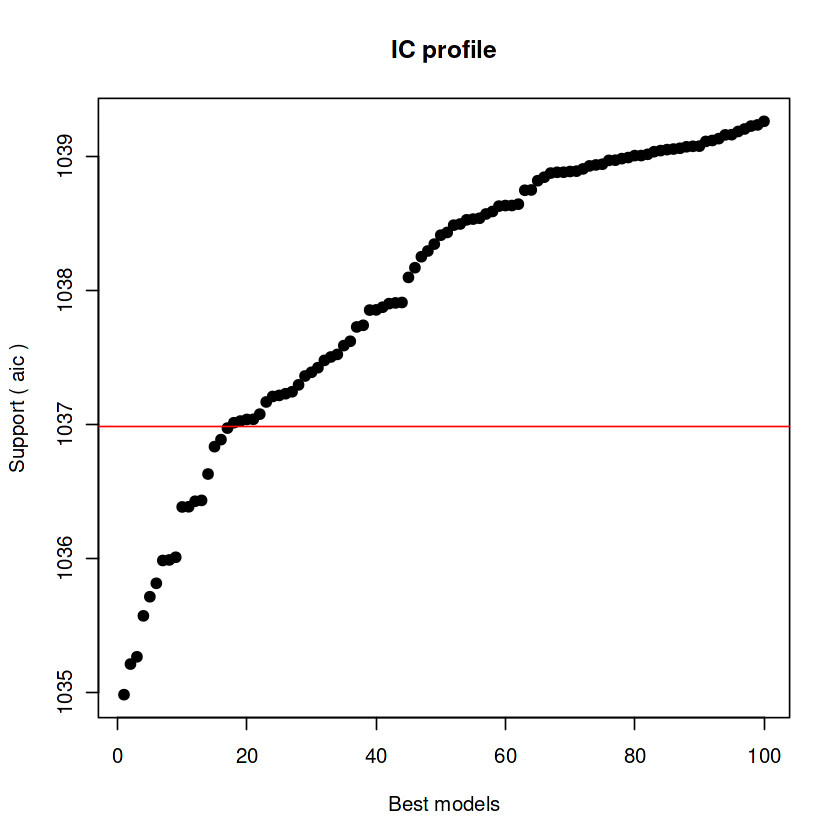


After 87950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1033.1079452225
Mean crit= 1037.36954017715


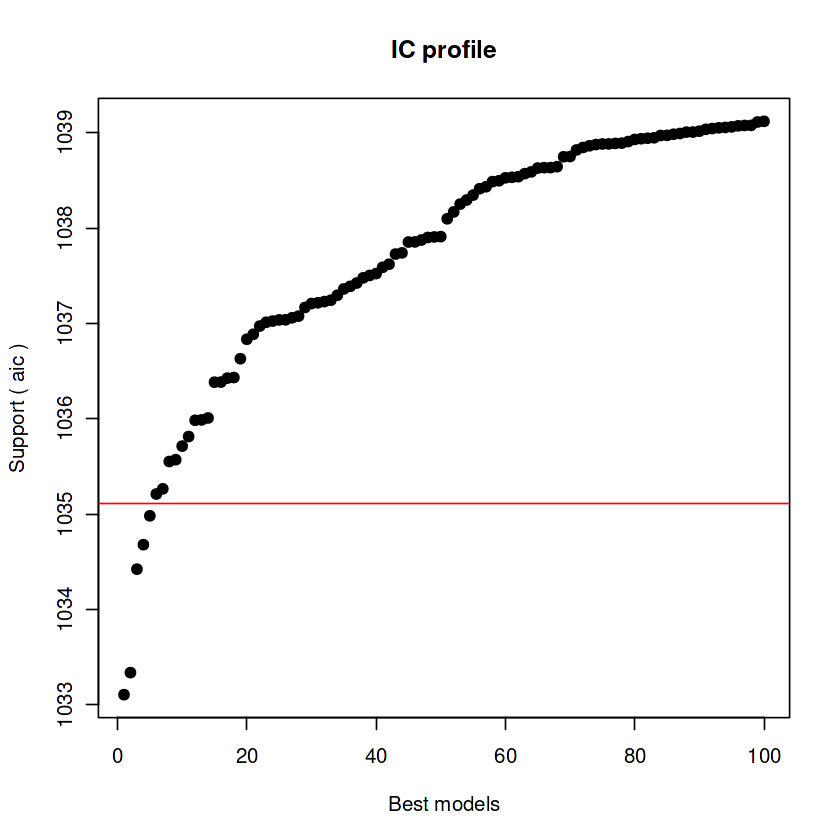


After 88000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1033.1079452225
Mean crit= 1037.30074774638


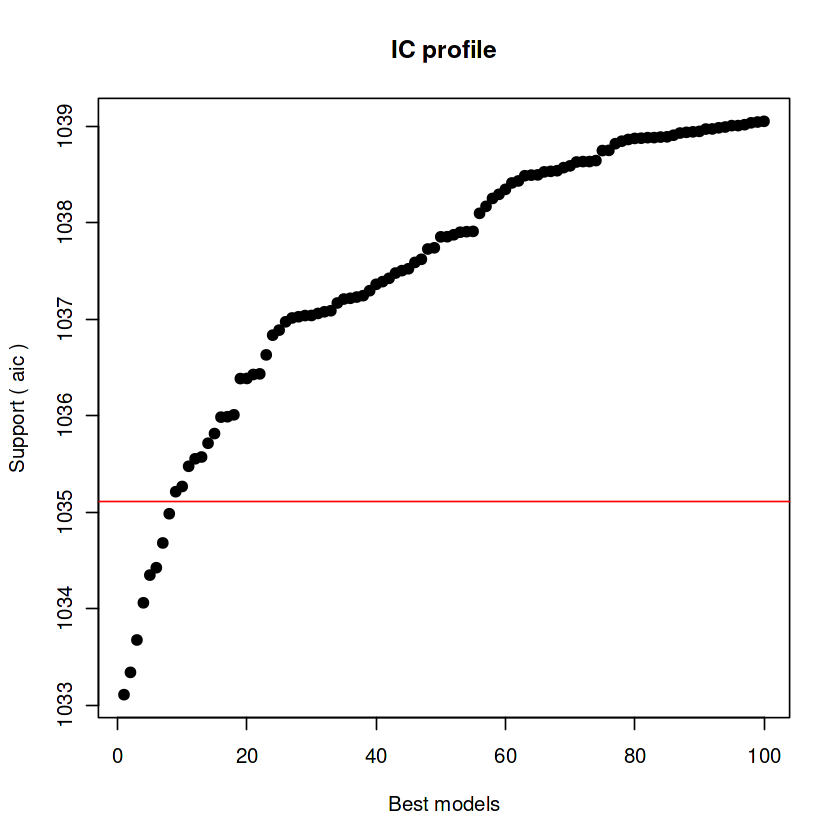


After 88050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1033.1079452225
Mean crit= 1037.20697046006


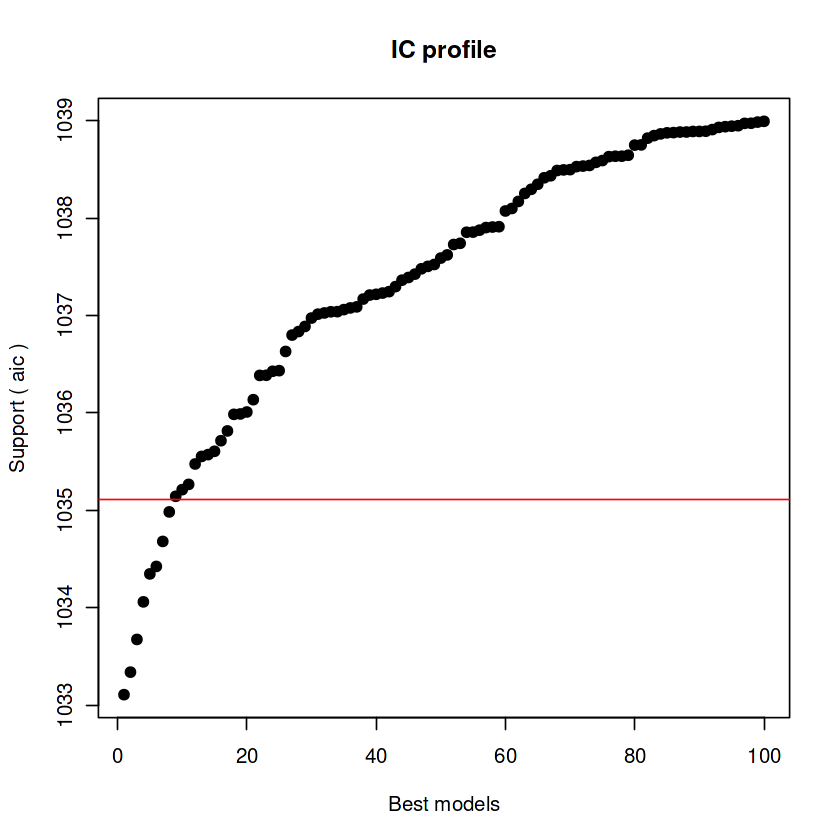


After 88100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1032.25996140033
Mean crit= 1037.00270596762


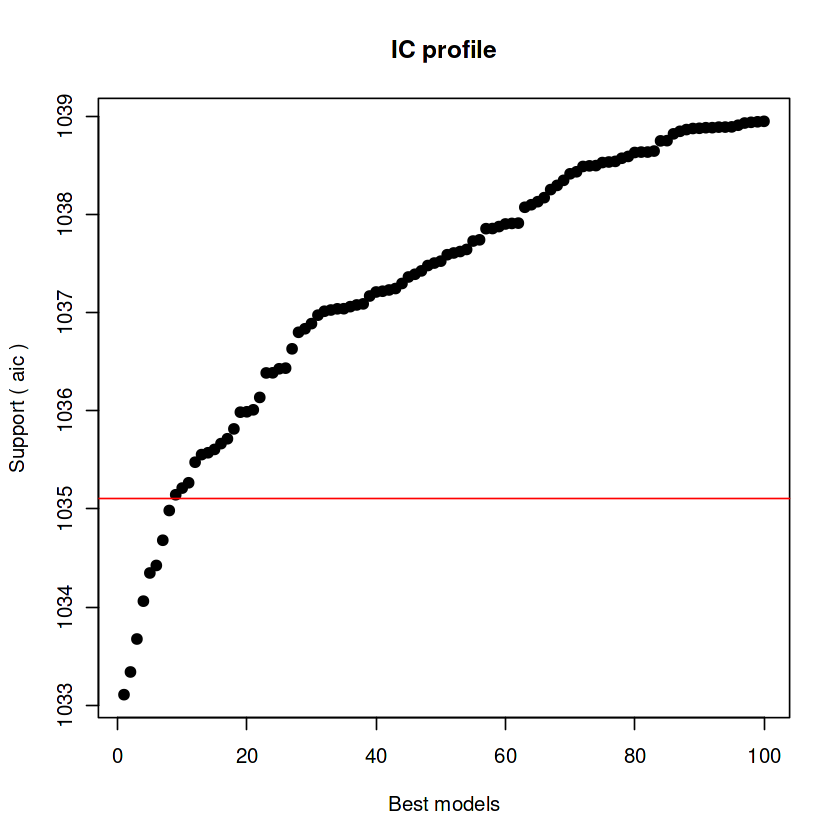


After 88150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1032.25996140033
Mean crit= 1036.81121959082


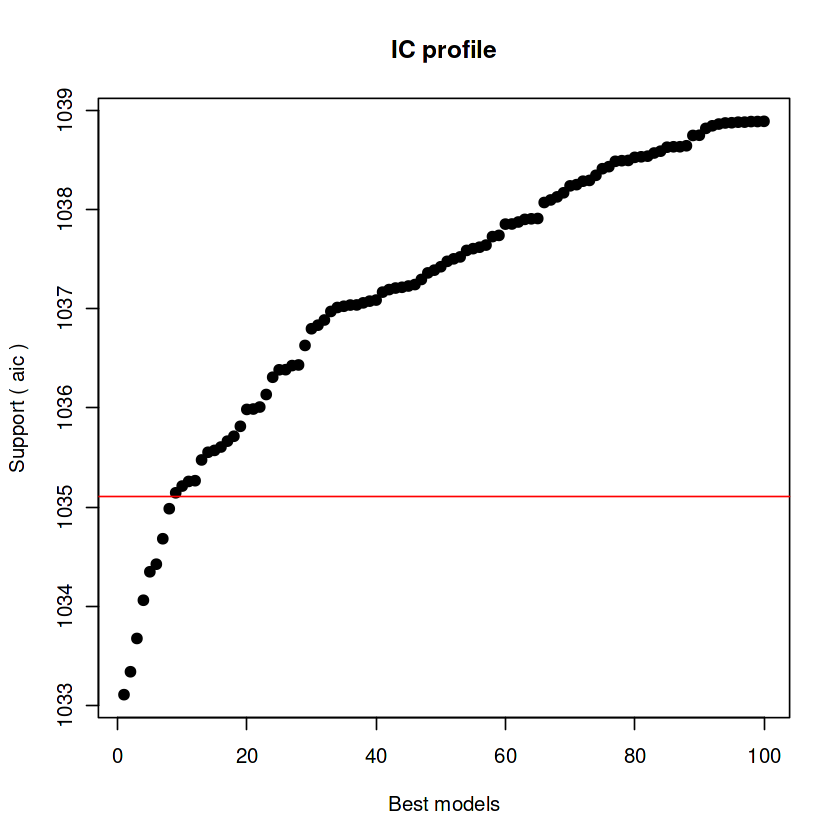


After 88200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1032.25996140033
Mean crit= 1036.64938583152


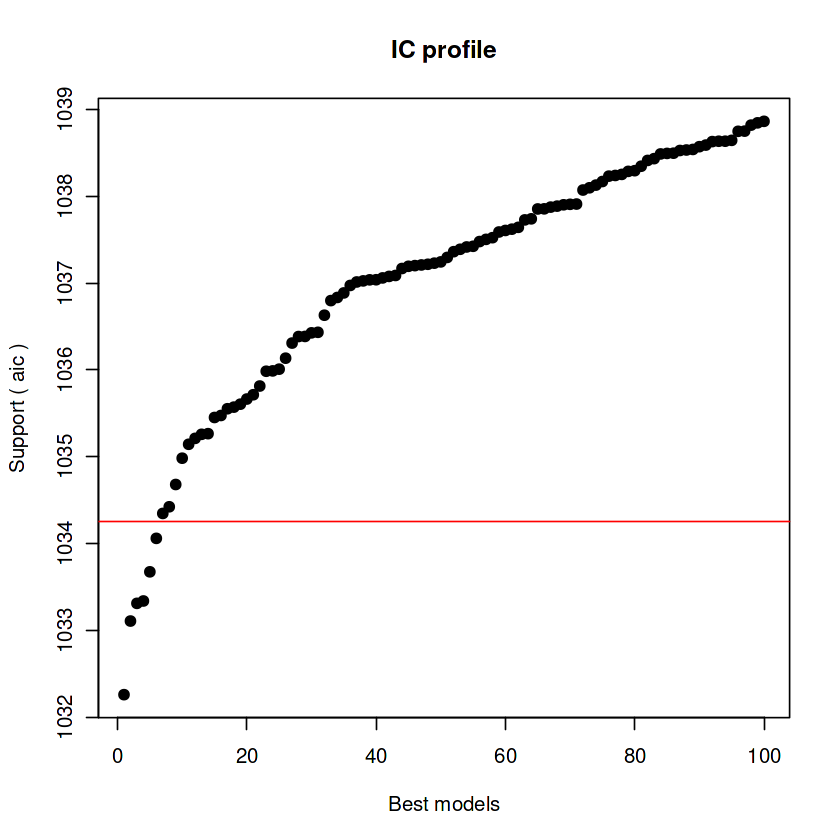


After 88250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1032.25996140033
Mean crit= 1036.61588458575


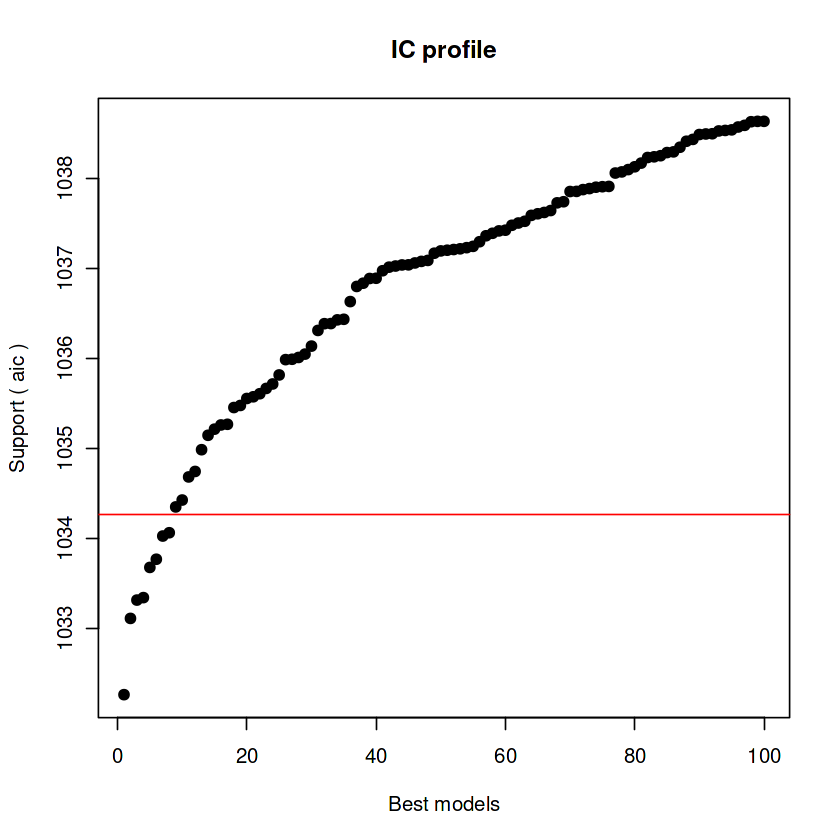


After 88300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1032.25996140033
Mean crit= 1036.58029953934


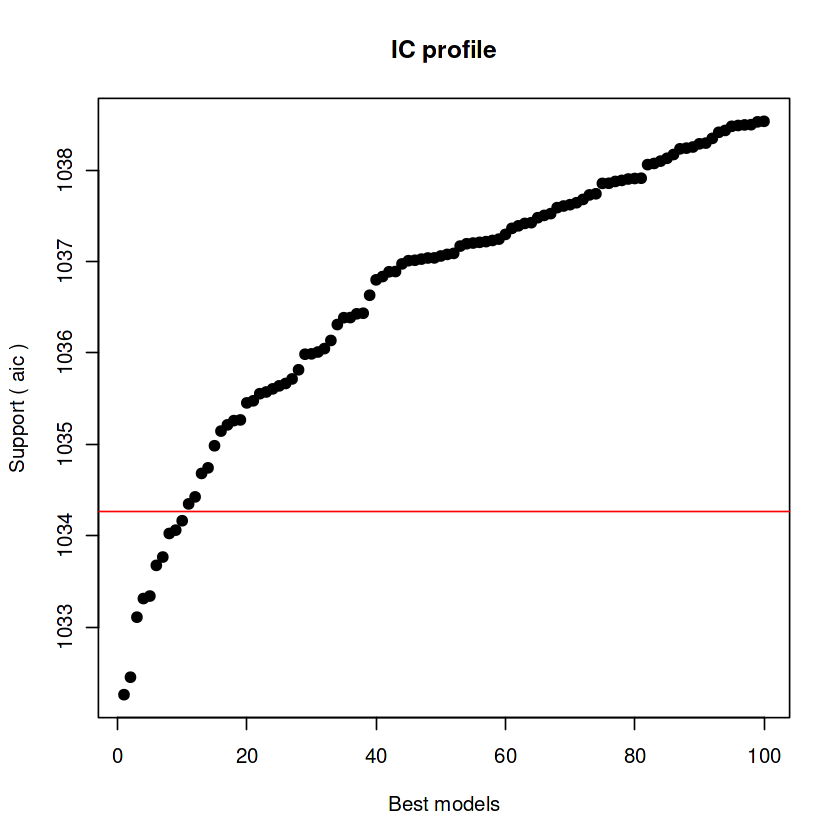


After 88350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1032.25996140033
Mean crit= 1036.5132342434


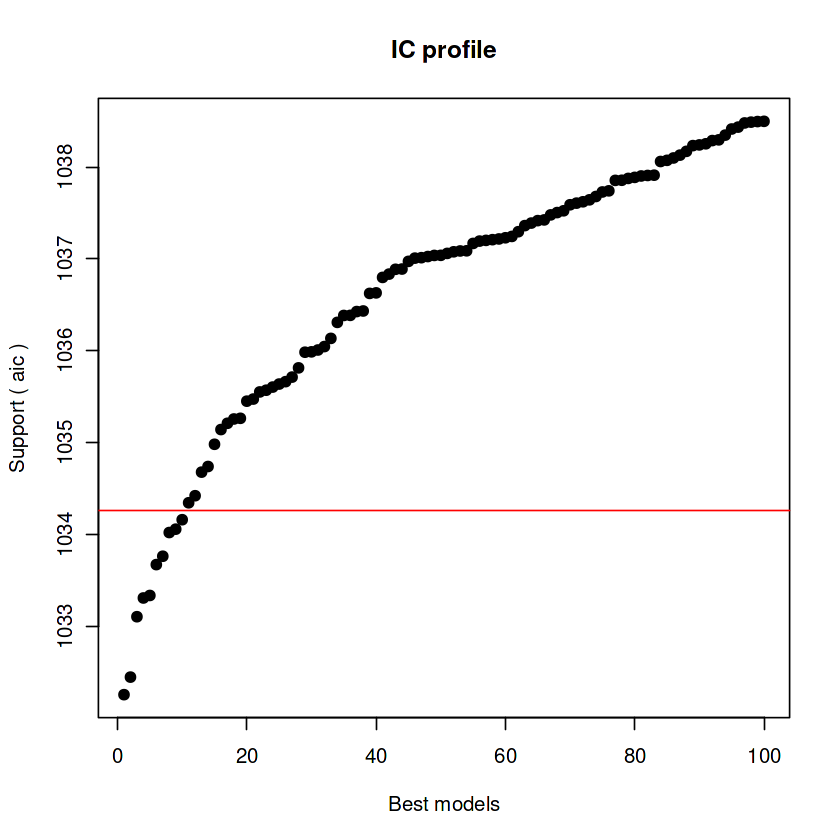


After 88400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1032.25996140033
Mean crit= 1036.38275045265


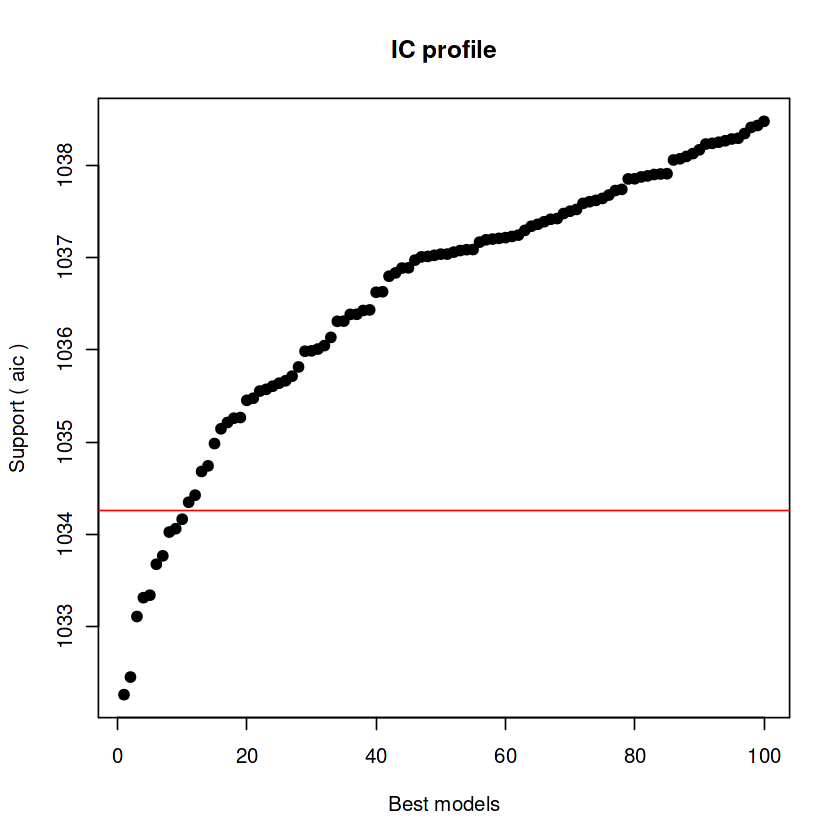


After 88450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1032.25996140033
Mean crit= 1036.26569054578


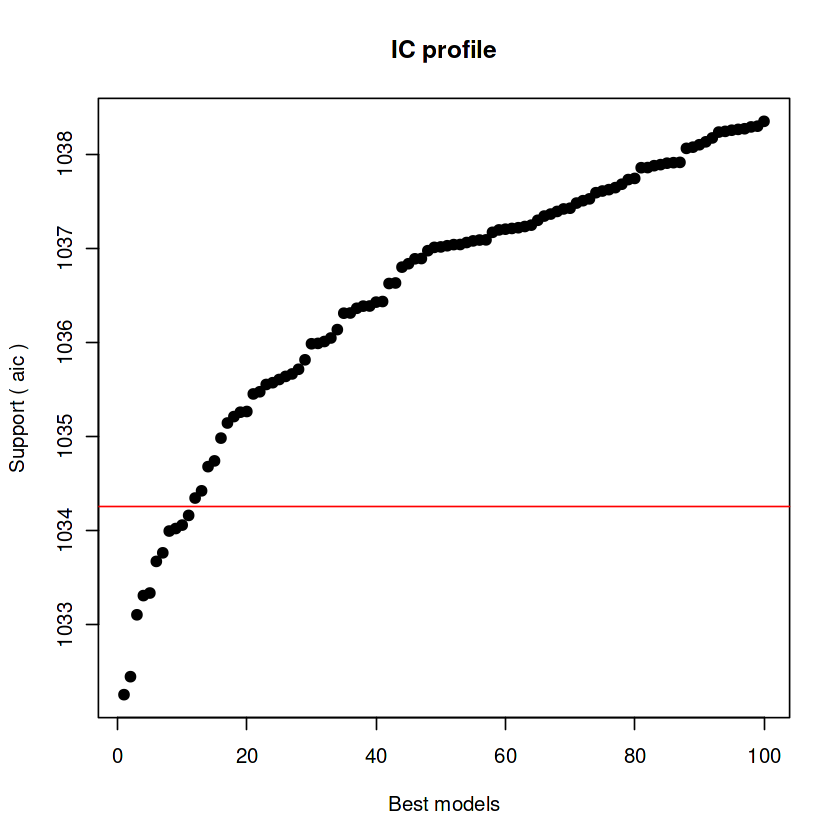


After 88500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1032.25996140033
Mean crit= 1036.11566517893


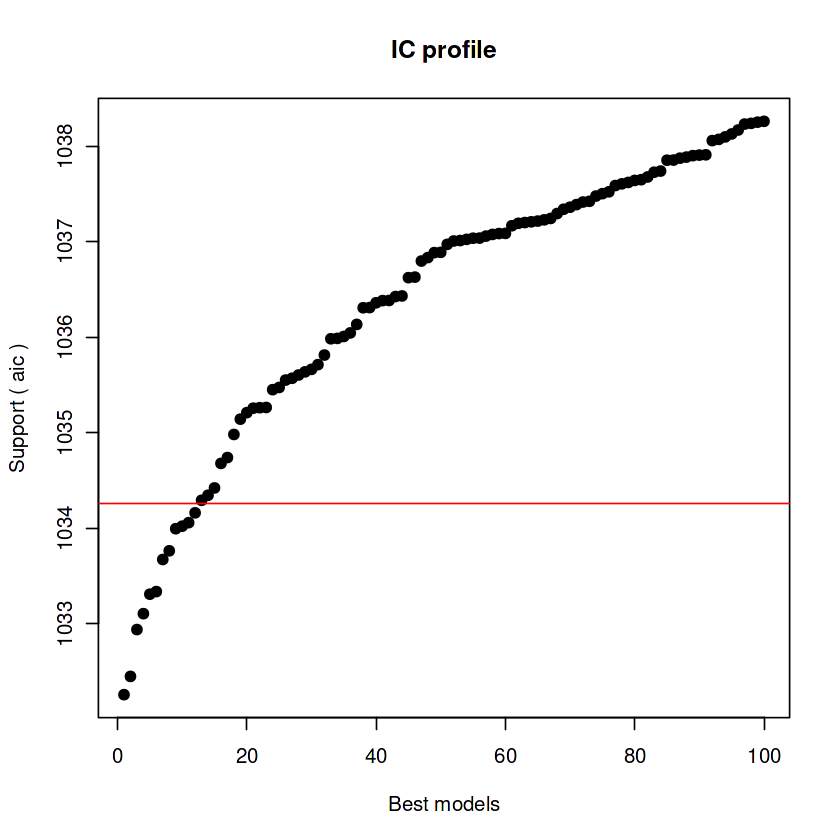


After 88550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1032.25996140033
Mean crit= 1035.9945646761


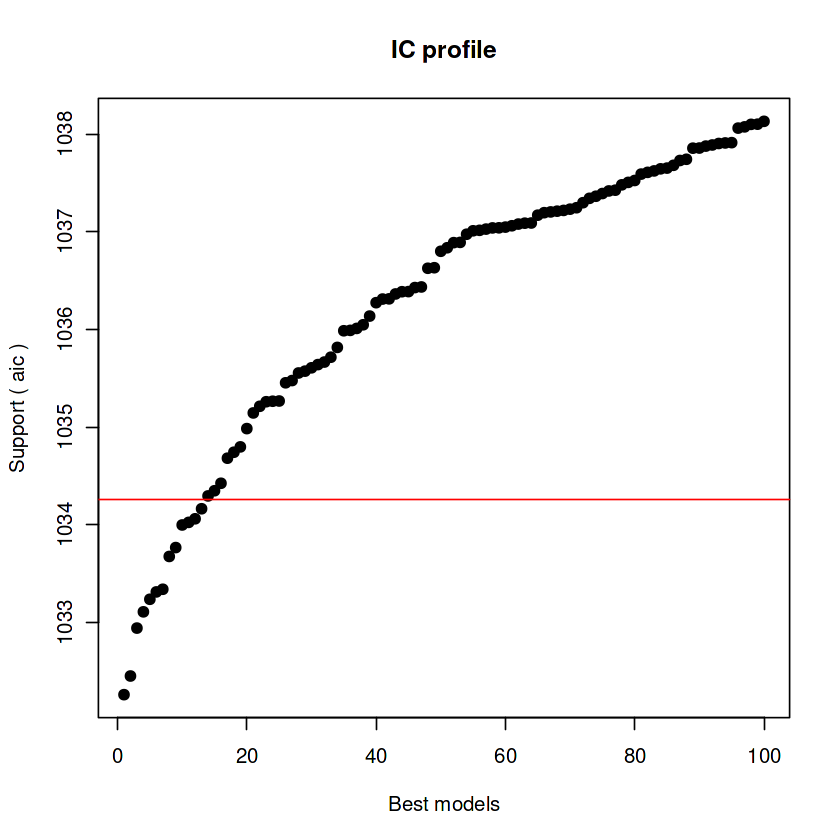


After 88600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1032.25996140033
Mean crit= 1035.93018681634


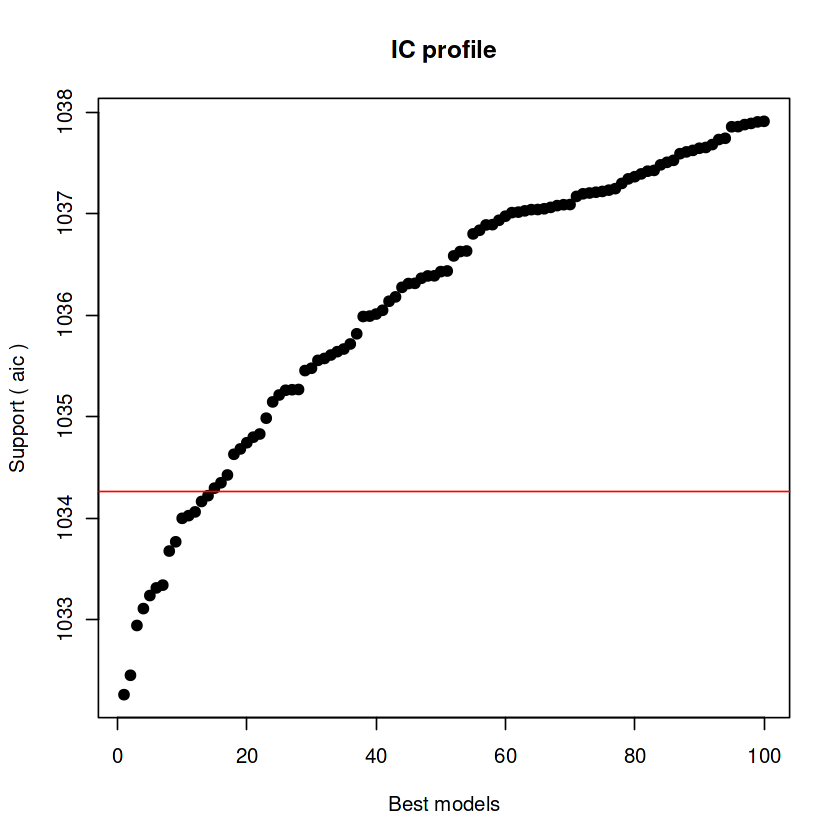


After 88650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1035.68429183758


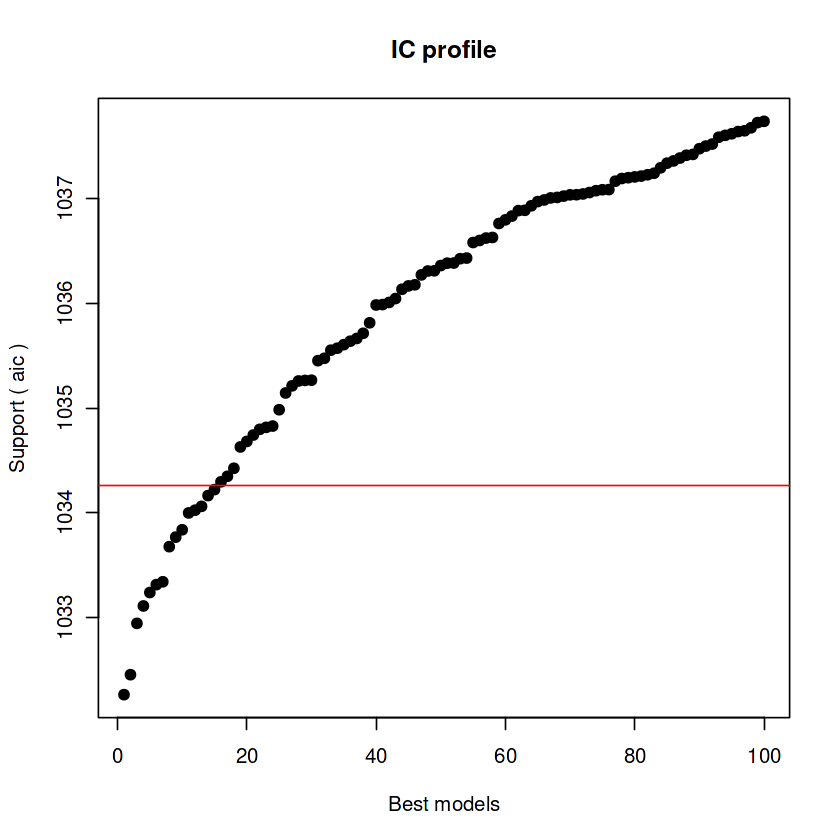


After 88700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1035.46284366624


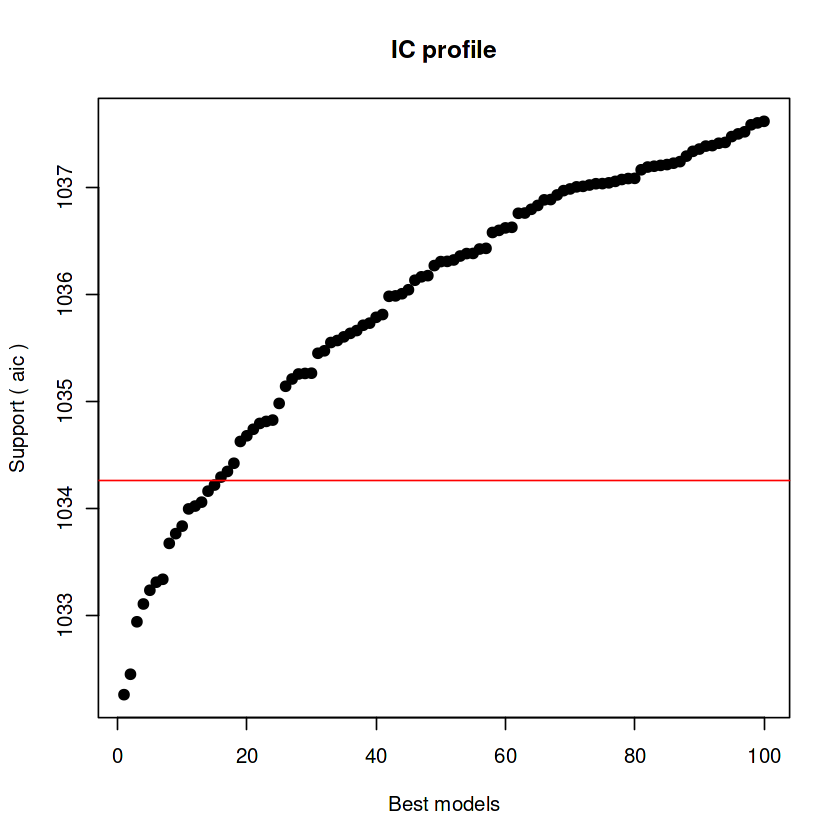


After 88750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1035.356579742


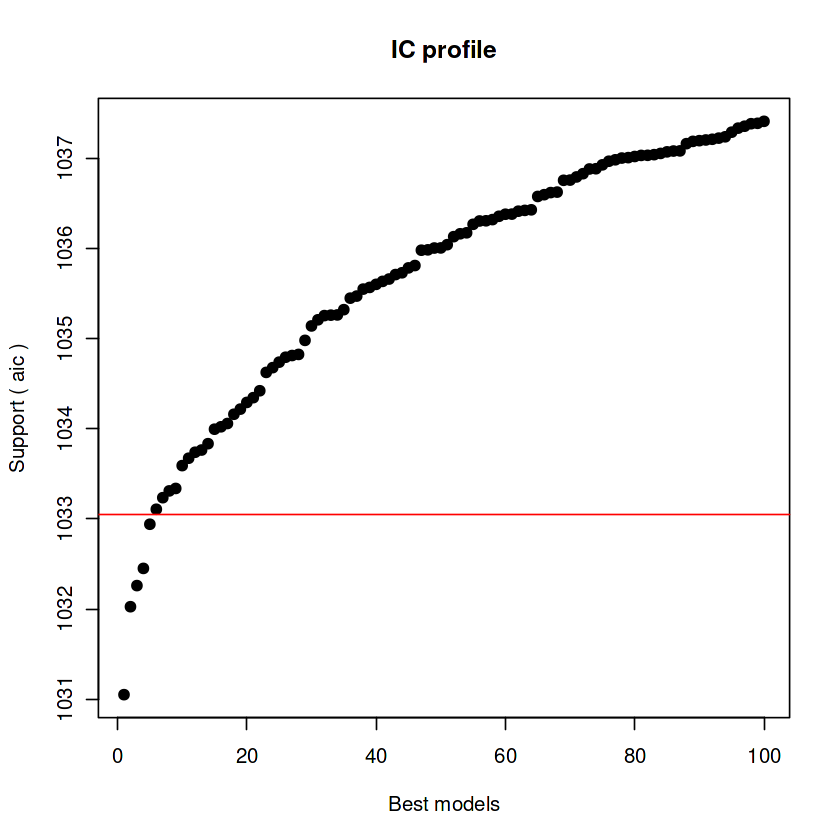


After 88800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1035.356579742


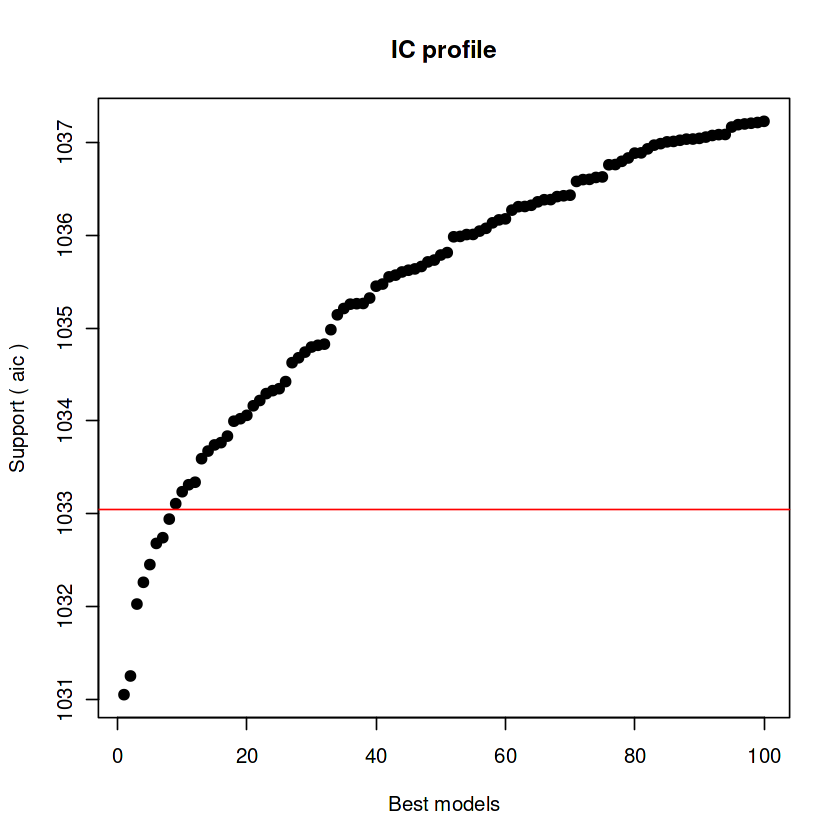


After 88850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1035.3192499145



After 88900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1035.19258675023


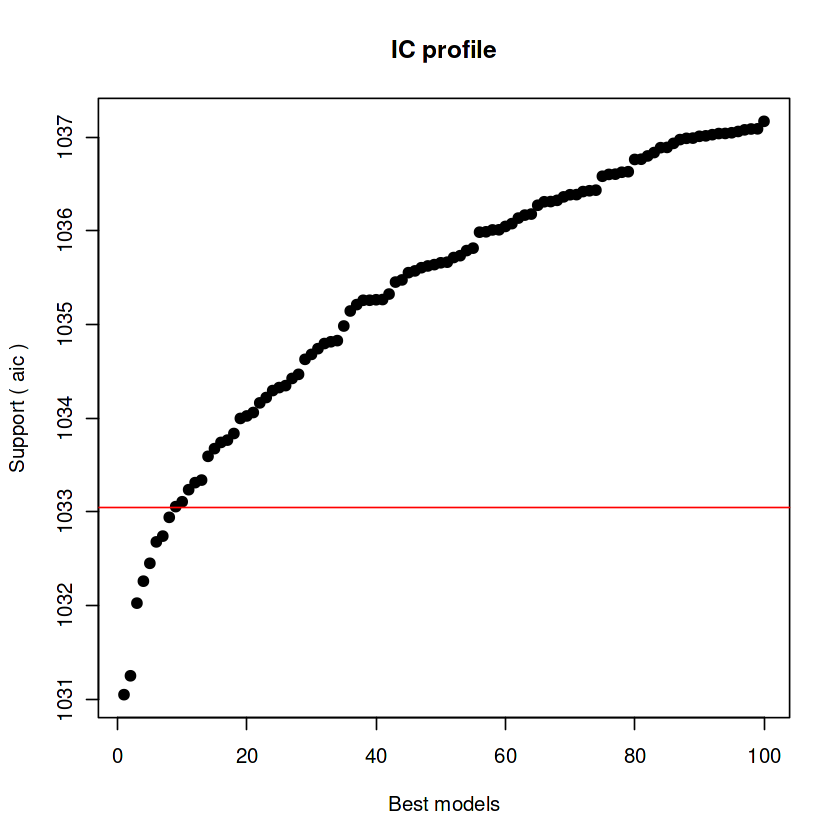


After 88950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1035.02696415451


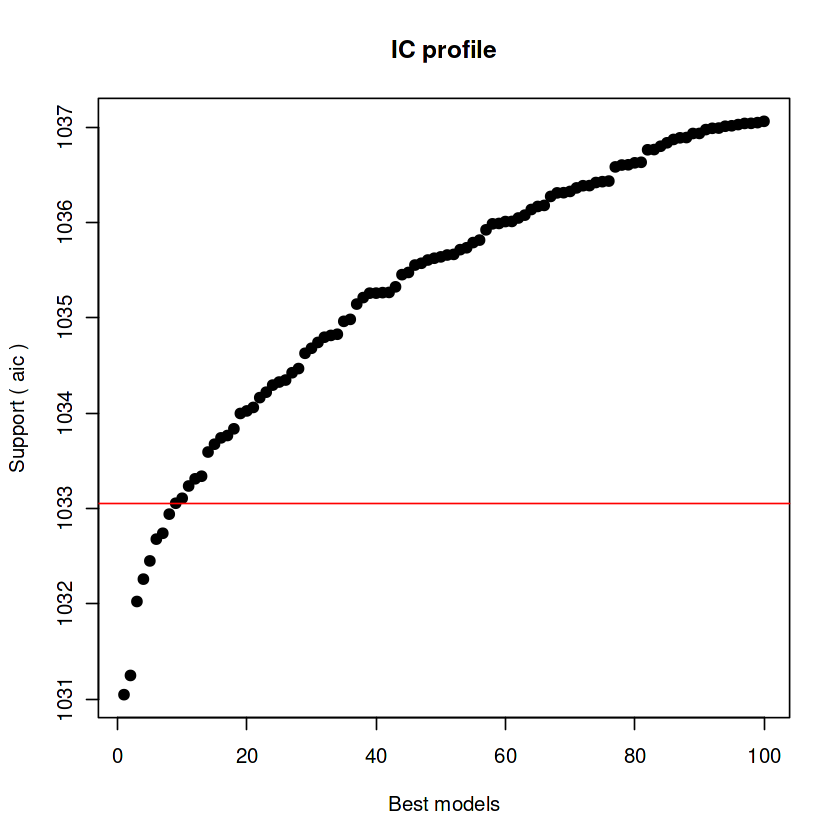


After 89000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905


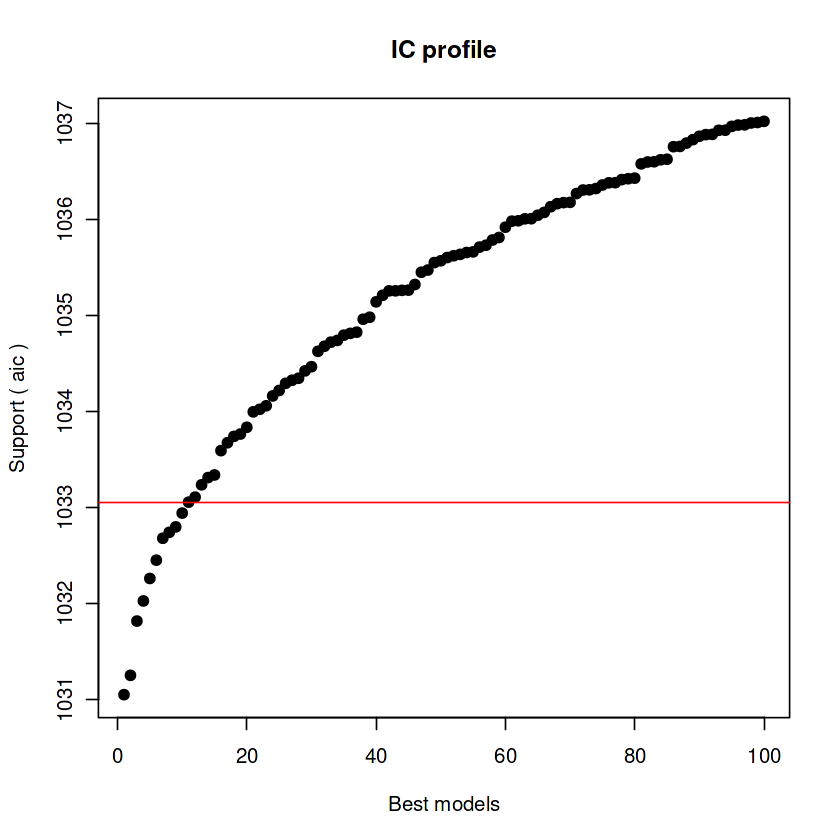


After 89050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905


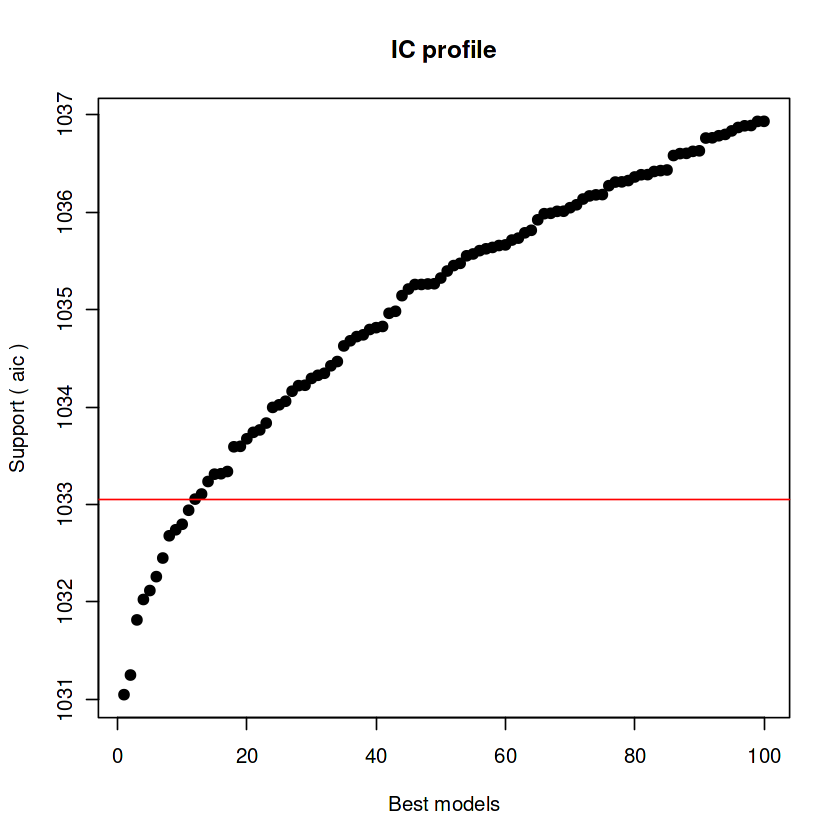


After 89100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 89950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 90950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 91000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 91050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 91100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 91150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 91200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 91250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 91300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 91350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 91400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 91450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 91500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.97863012905



After 91550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.9373518251



After 91600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.9107782301


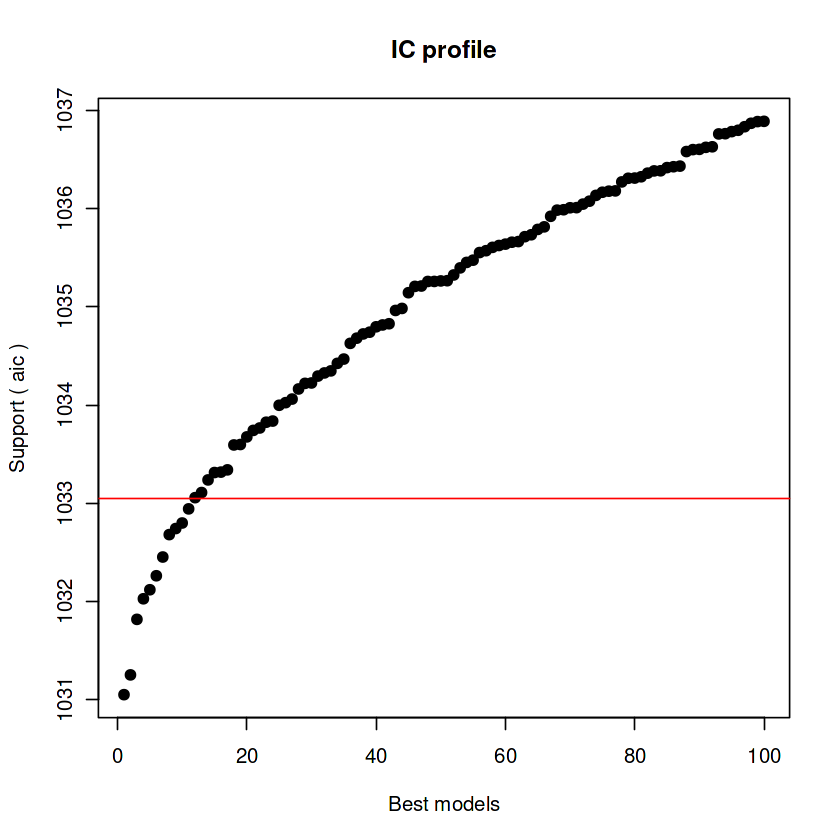


After 91650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.9102232415


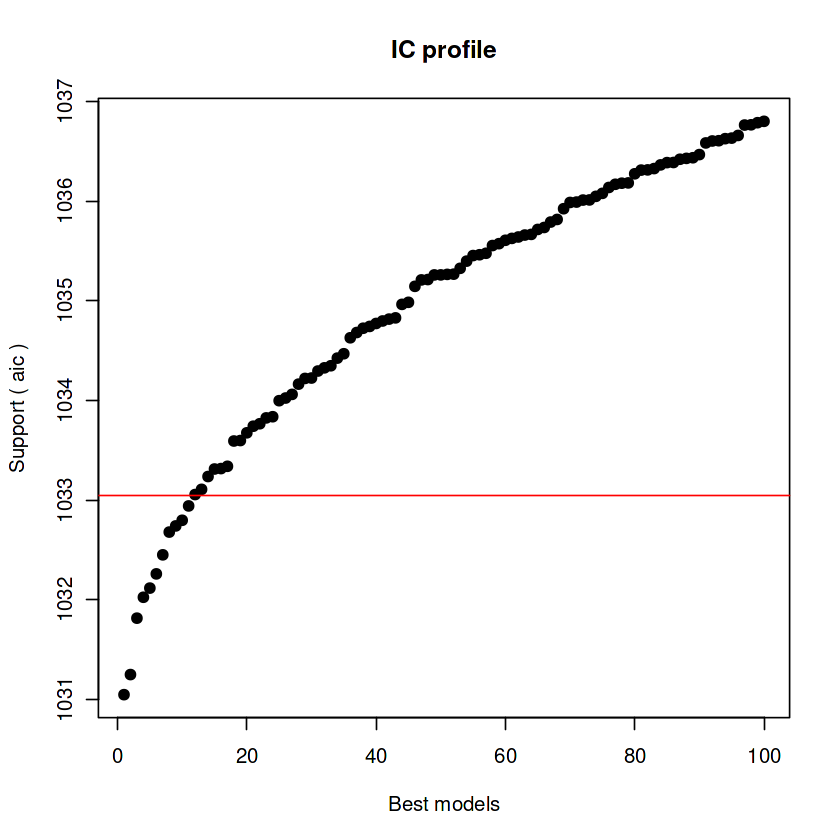


After 91700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.9102232415


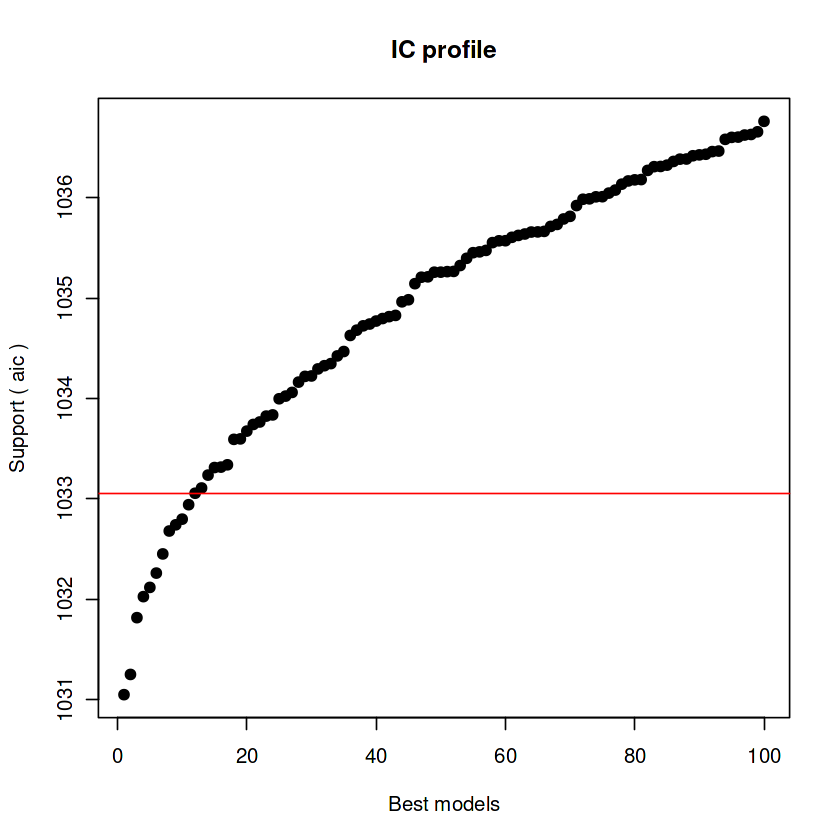


After 91750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.9102232415



After 91800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.89323070207



After 91850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.8818381979


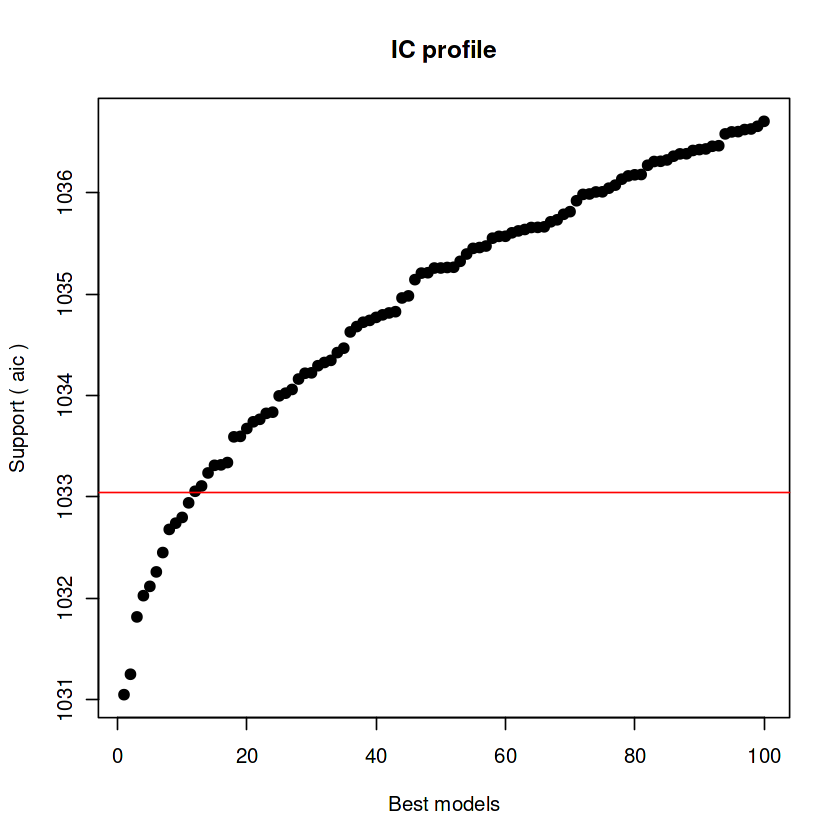


After 91900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.8818381979


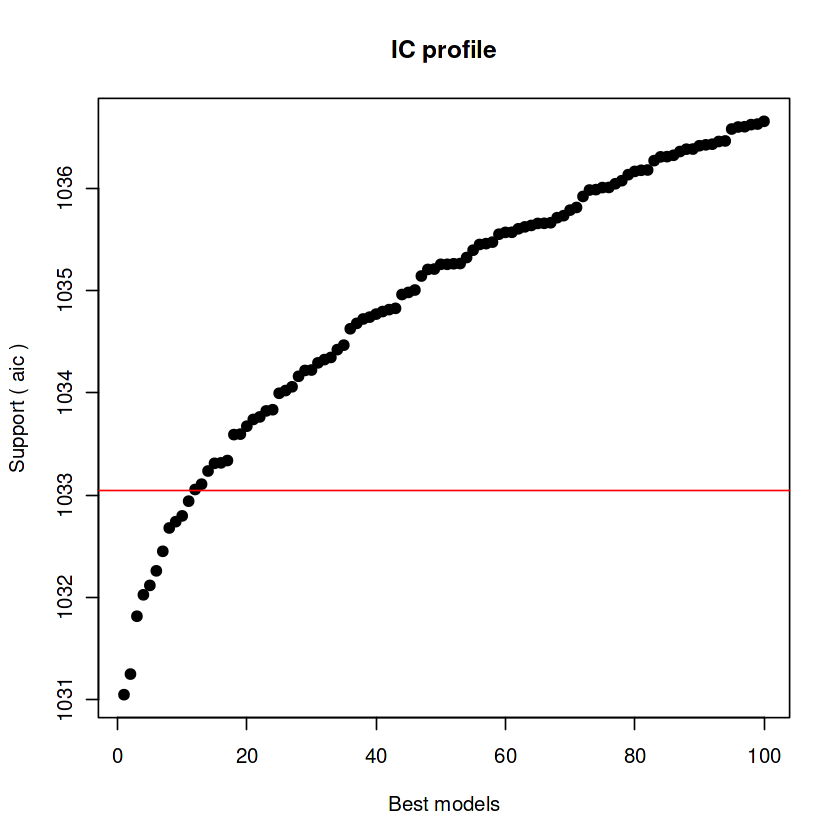


After 91950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.87054539117



After 92000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.86563750051


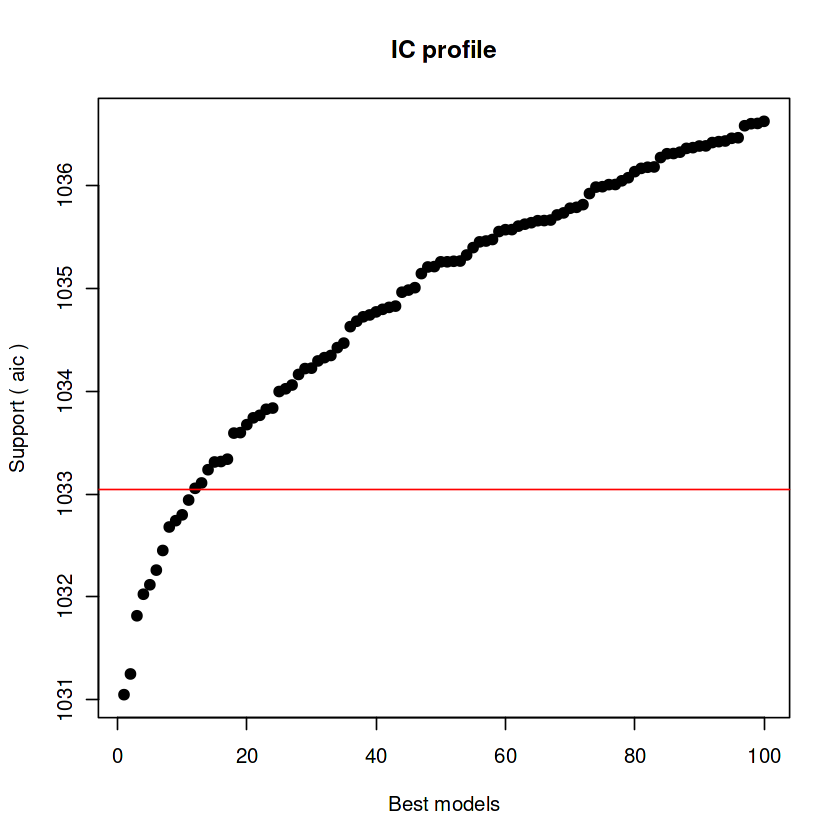


After 92050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.80338543534


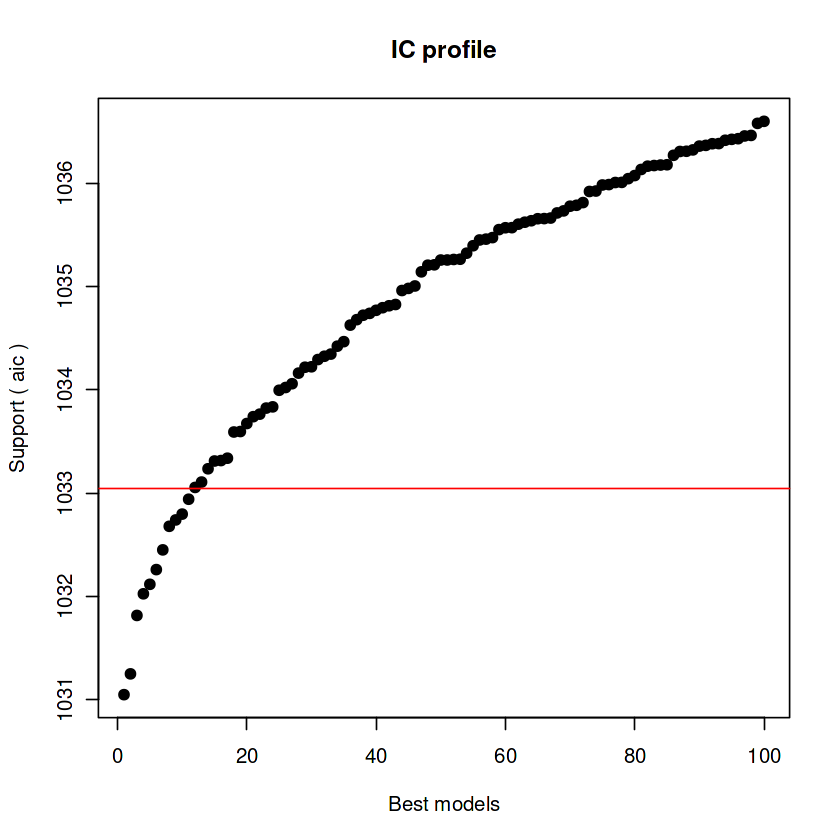


After 92100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.65025396416


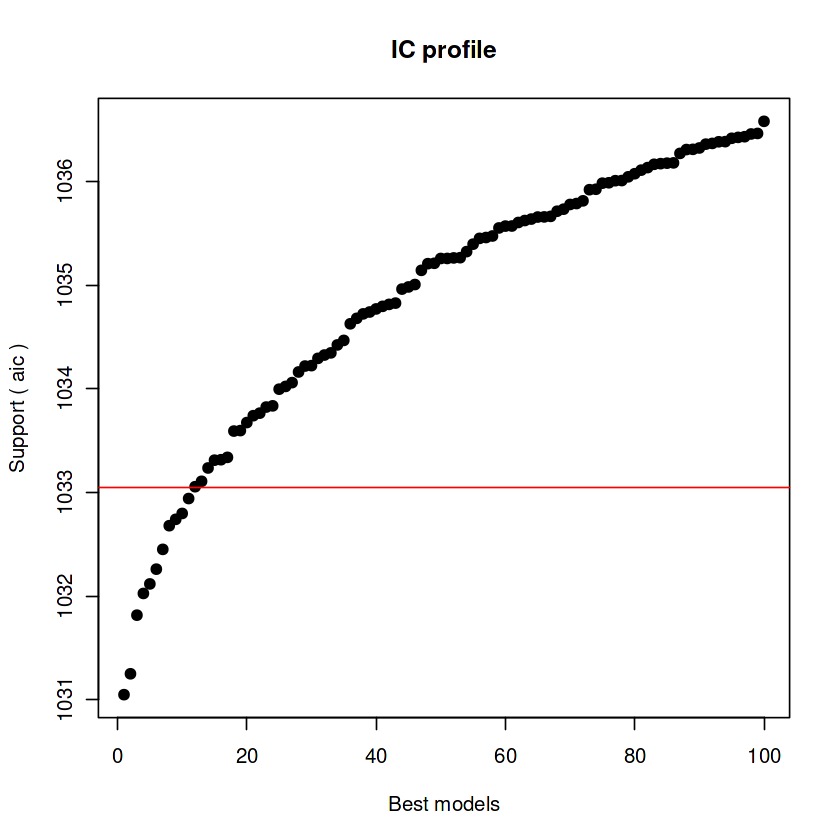


After 92150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.54049137007


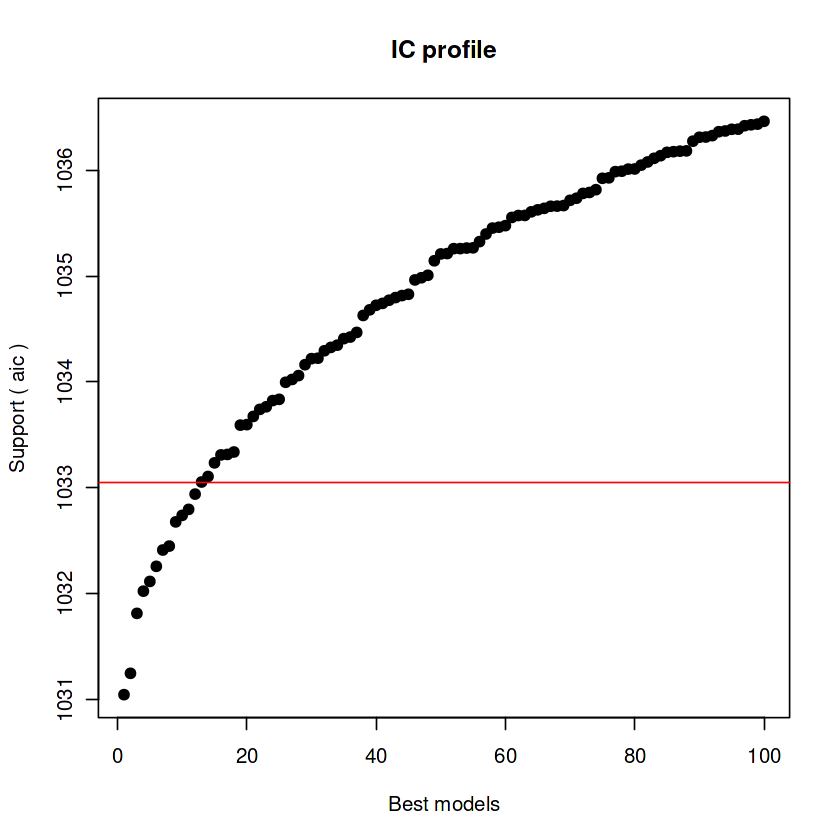


After 92200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.50430059437


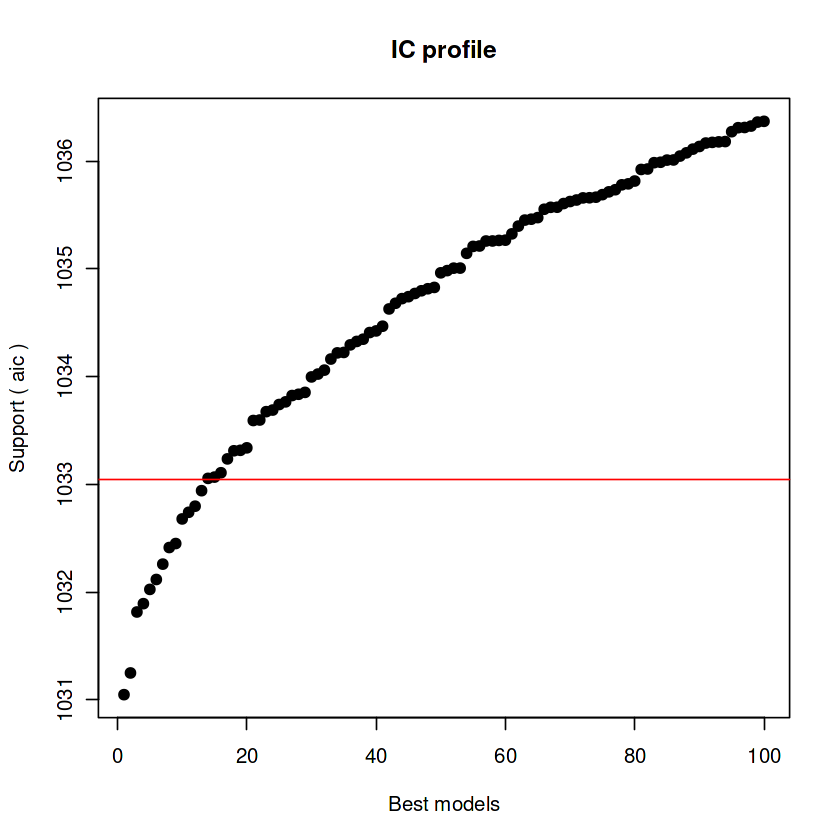


After 92250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.49037629044


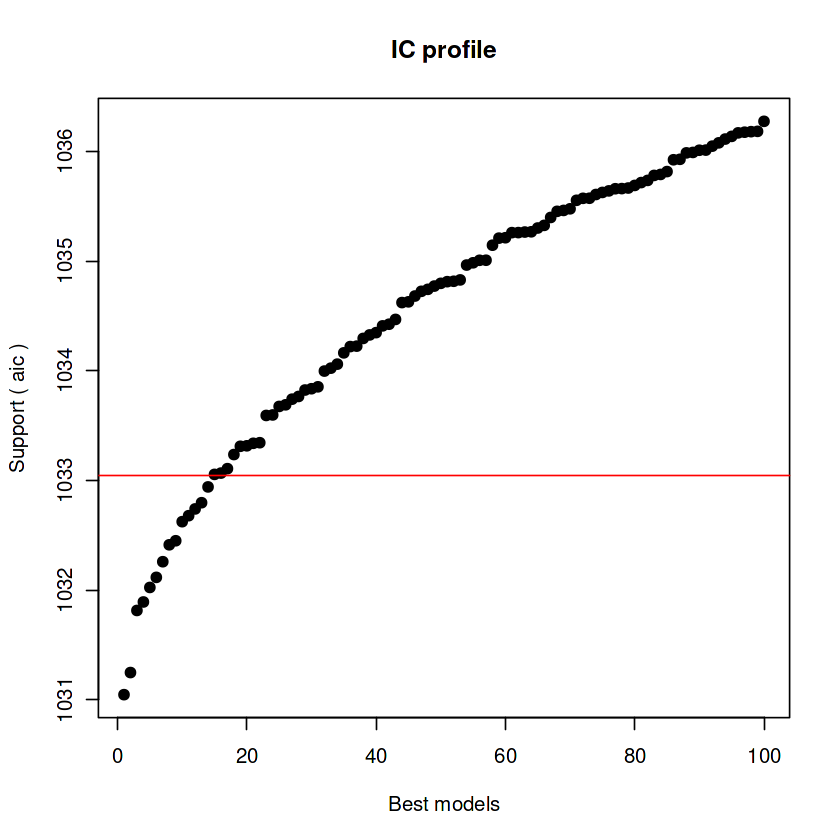


After 92300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.48287626525


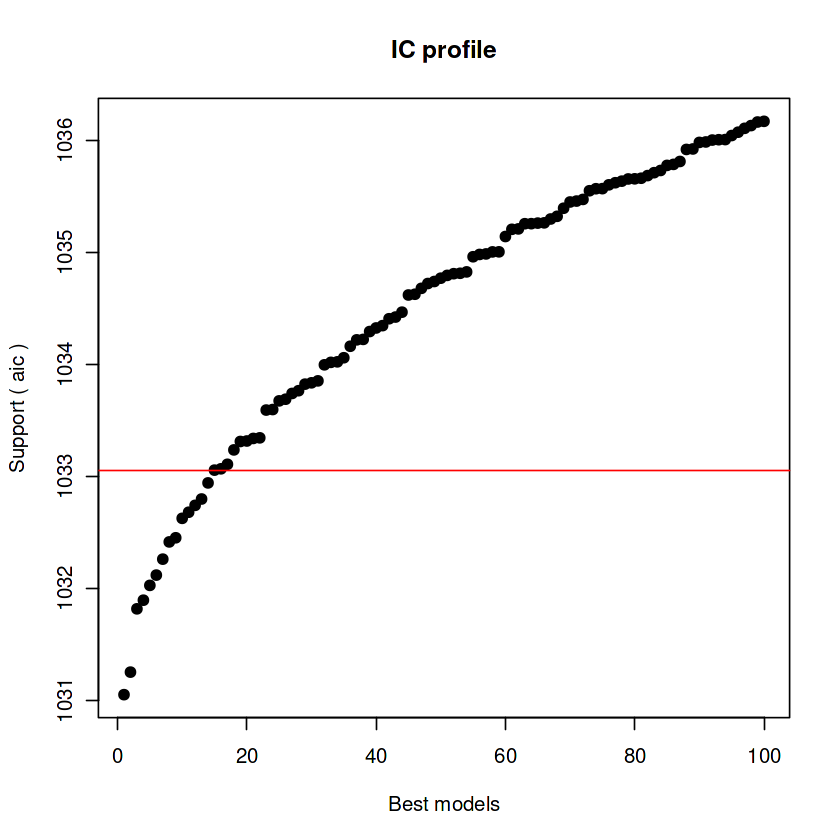


After 92350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.37837377841


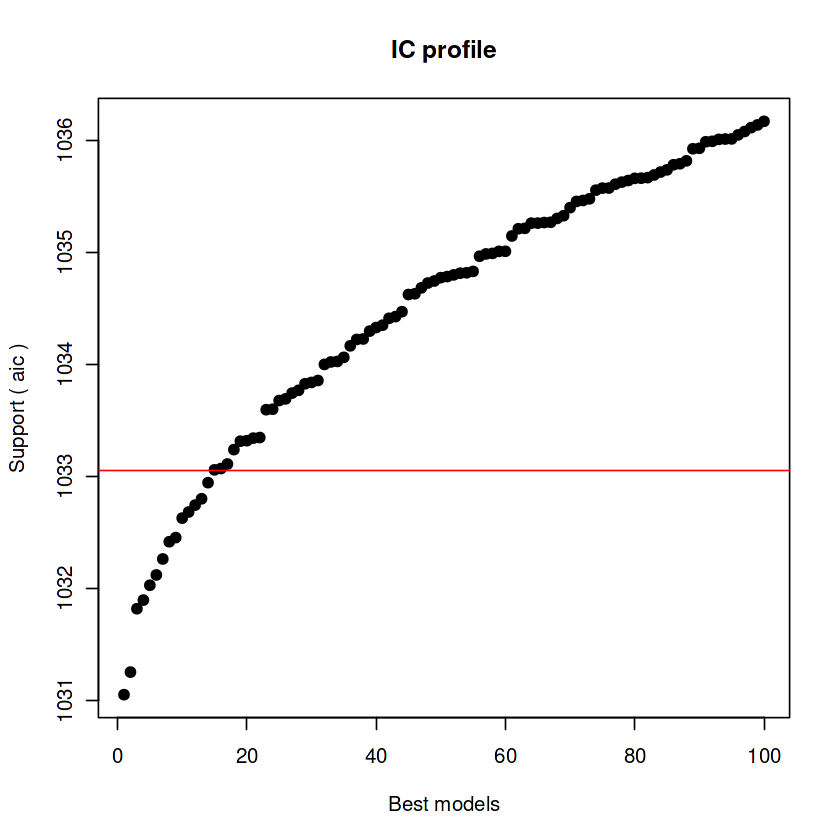


After 92400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.30384086578


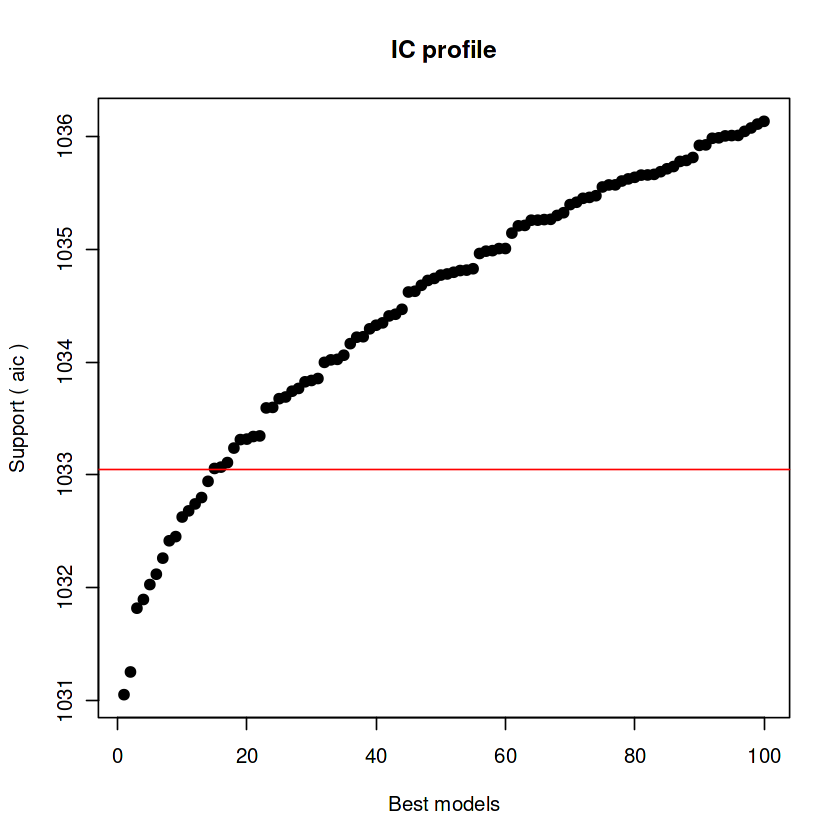


After 92450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.27383517166


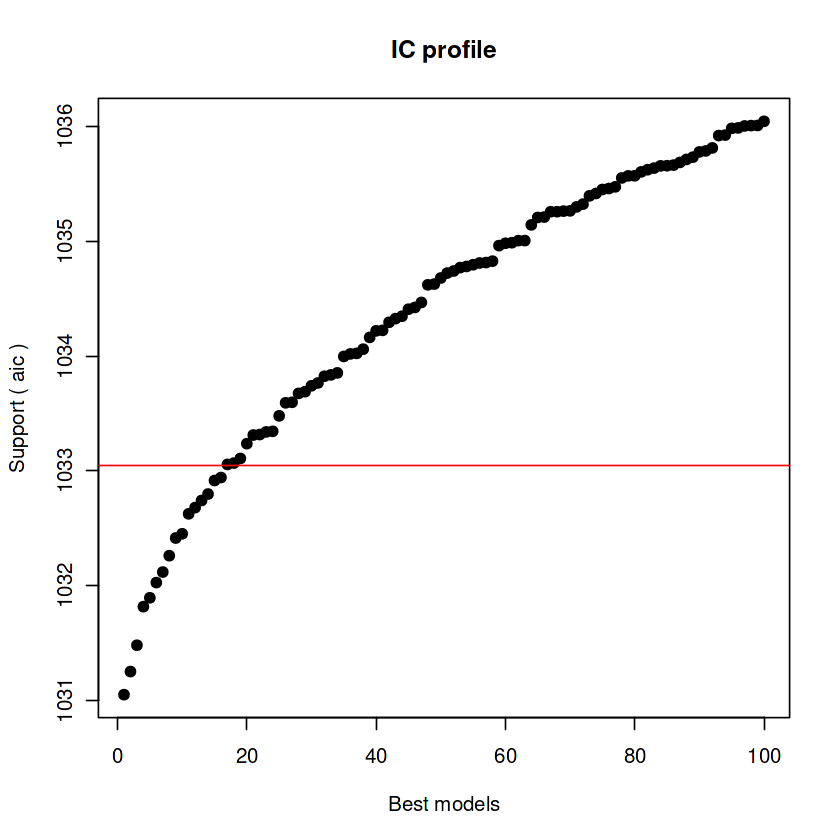


After 92500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.27383517166


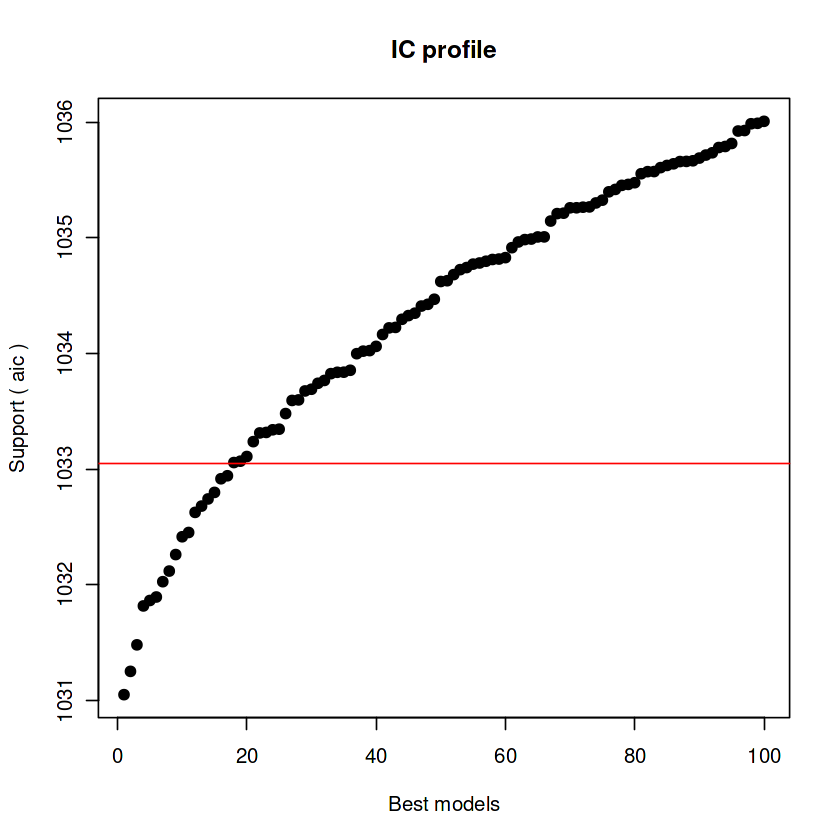


After 92550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.27354911958



After 92600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.22098782985


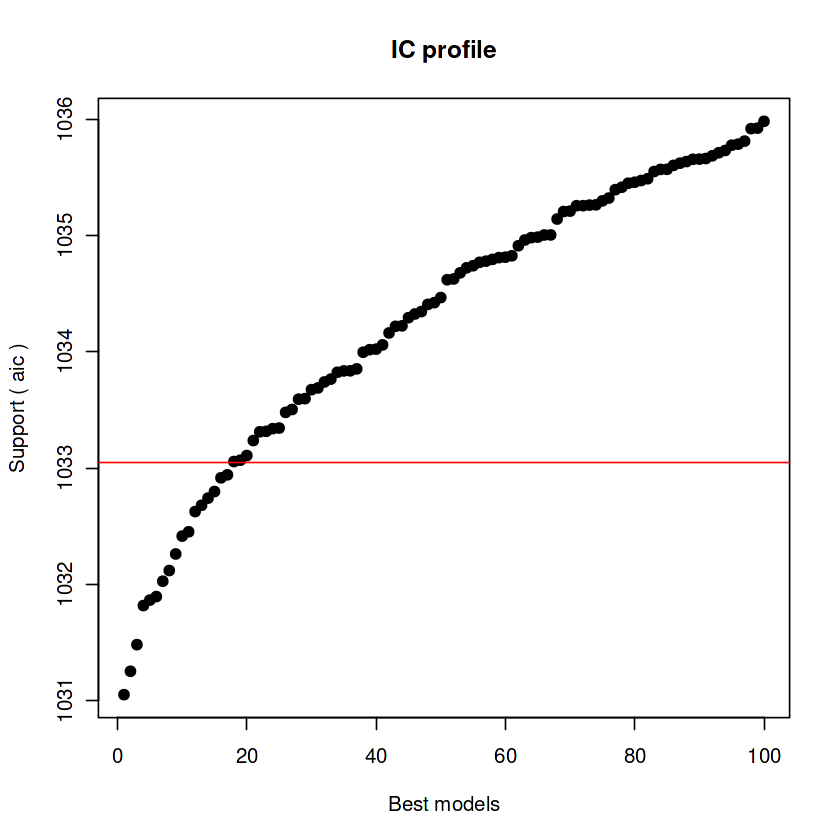


After 92650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.16571768563


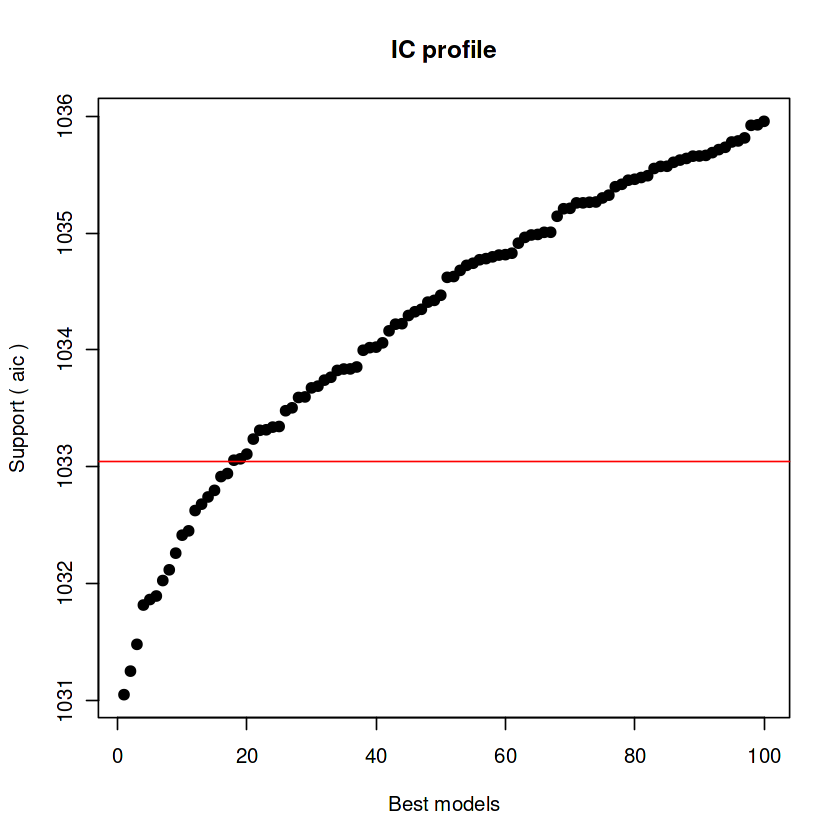


After 92700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.14118735754


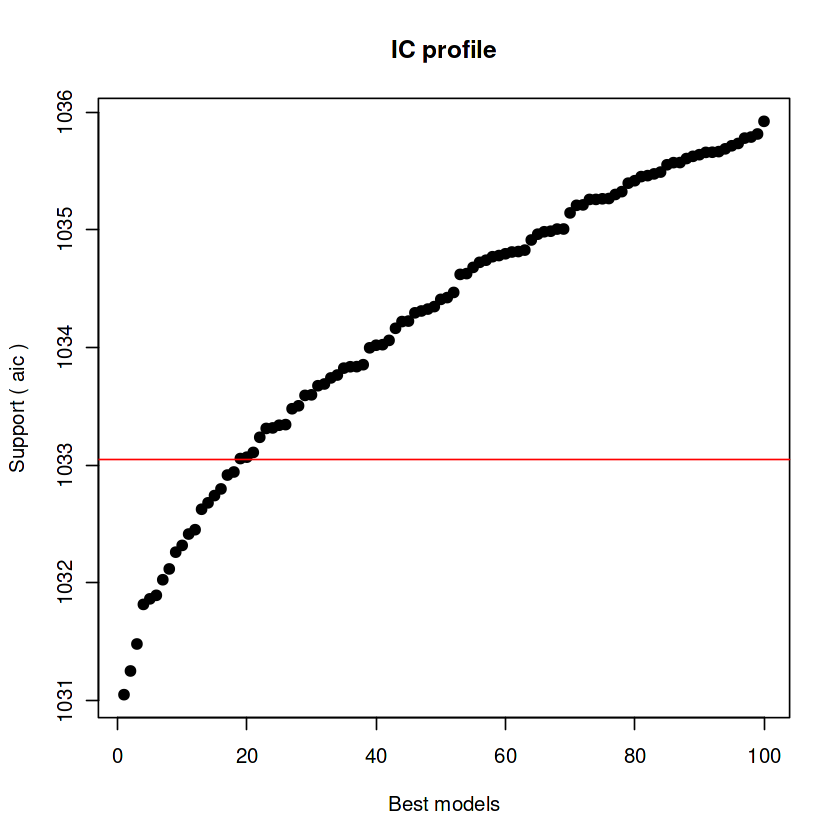


After 92750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.07908759524


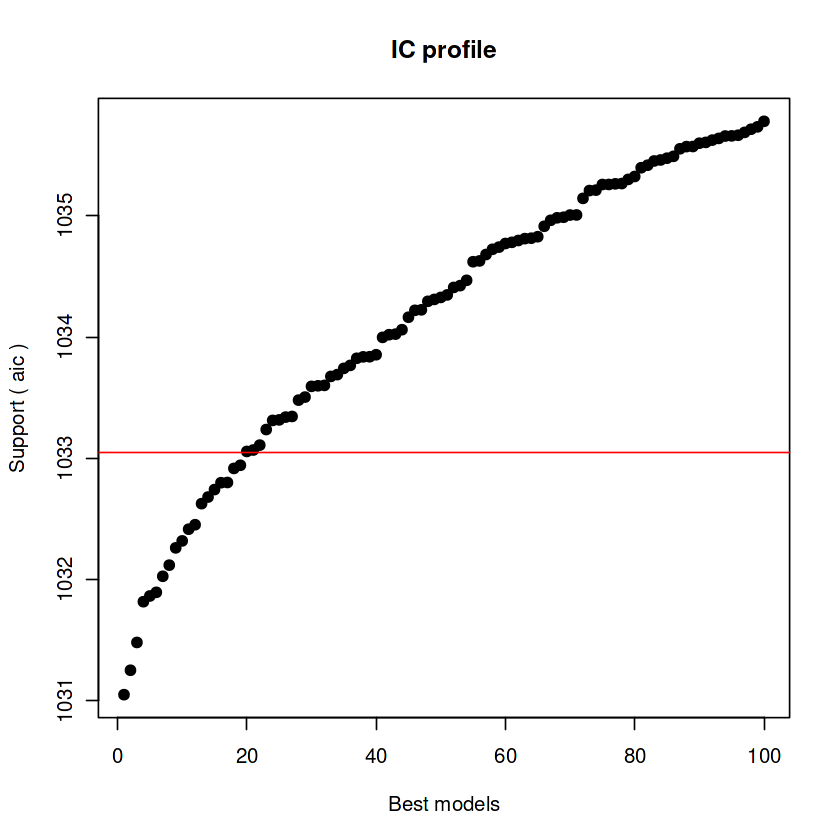


After 92800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+percentage.expenditure+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1031.04845865194
Mean crit= 1034.0226018052


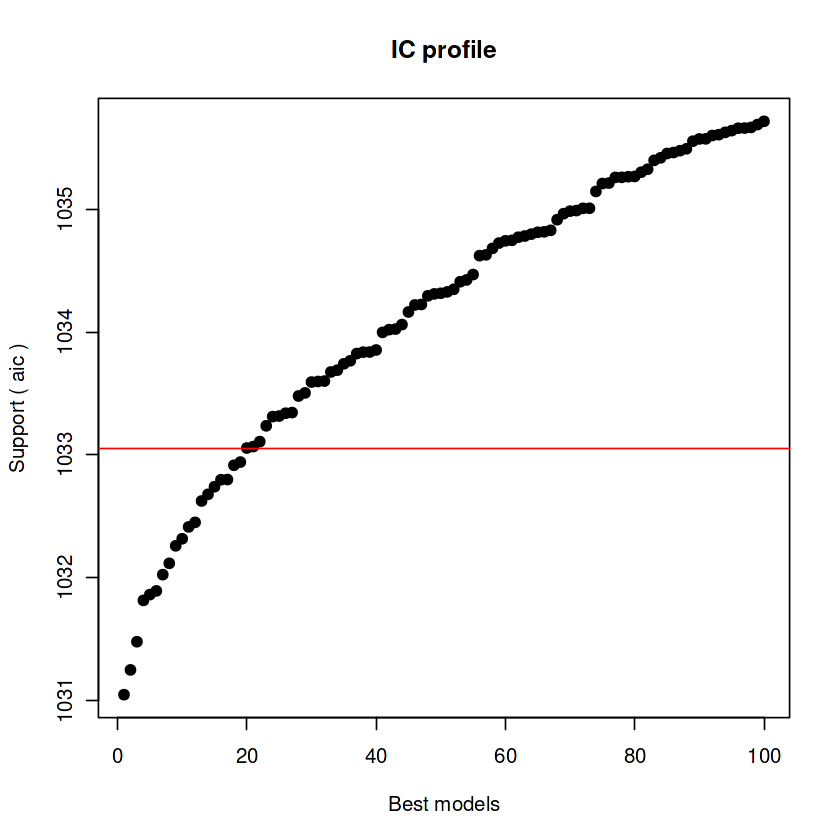


After 92850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.89819162834


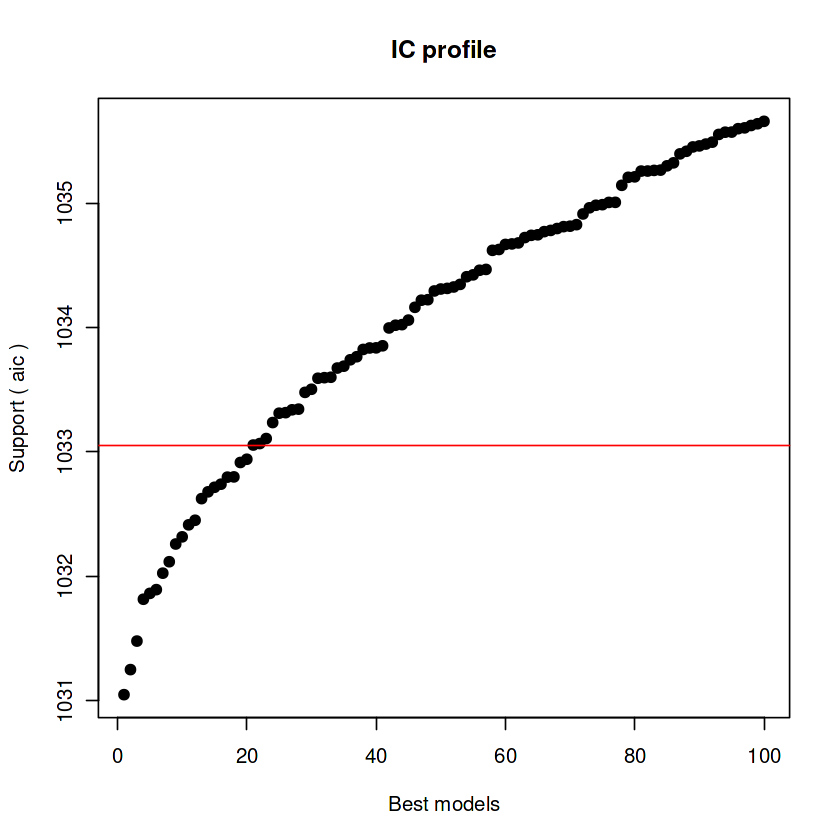


After 92900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.74908134168


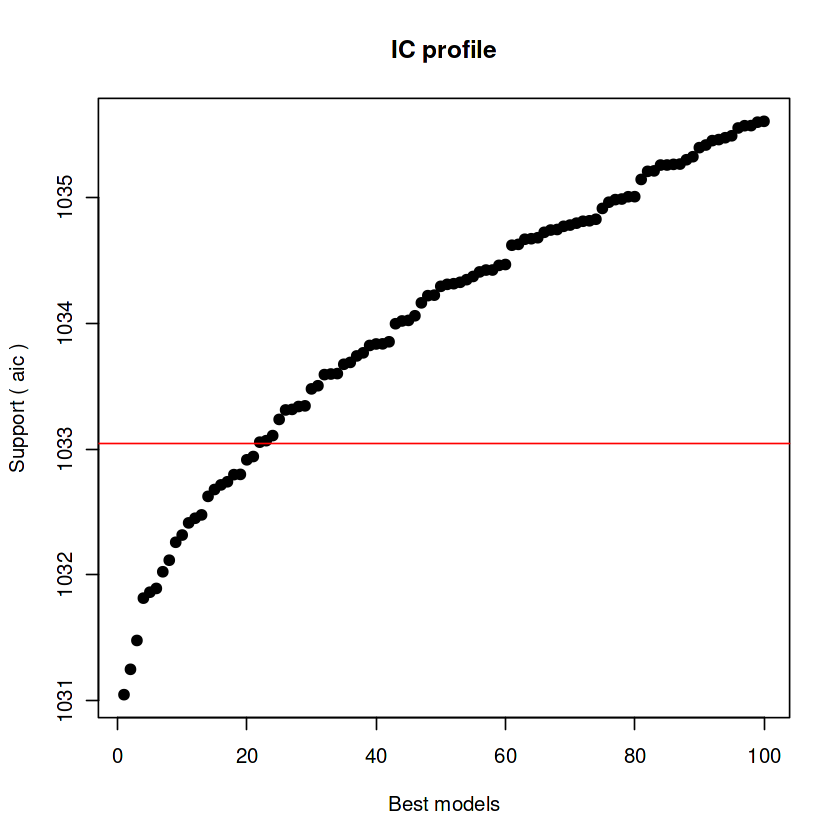


After 92950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.60568809425


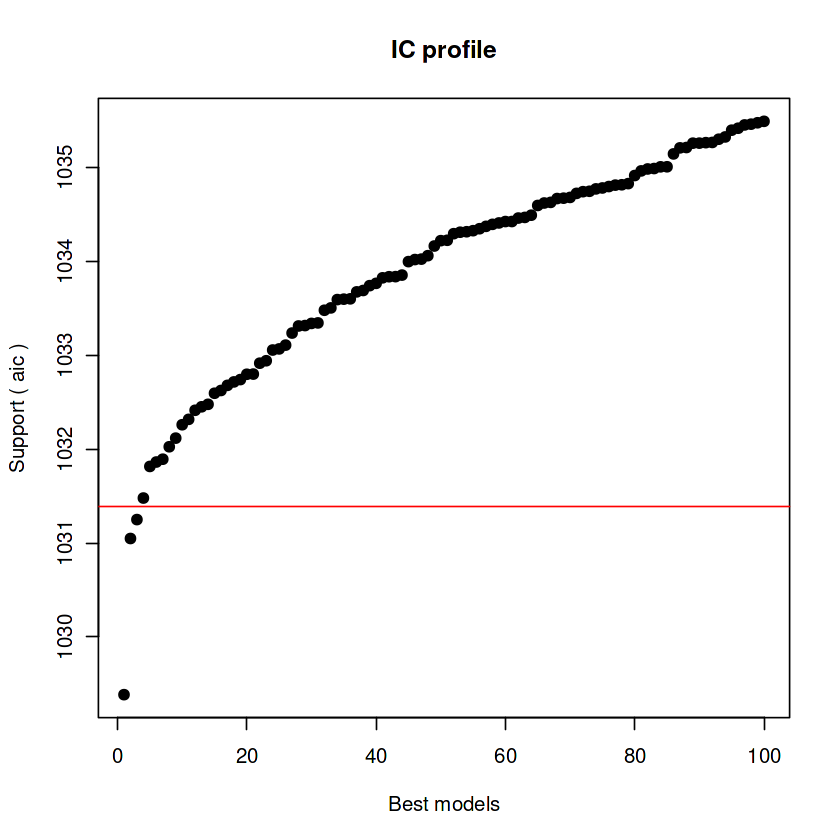


After 93000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.57330014079


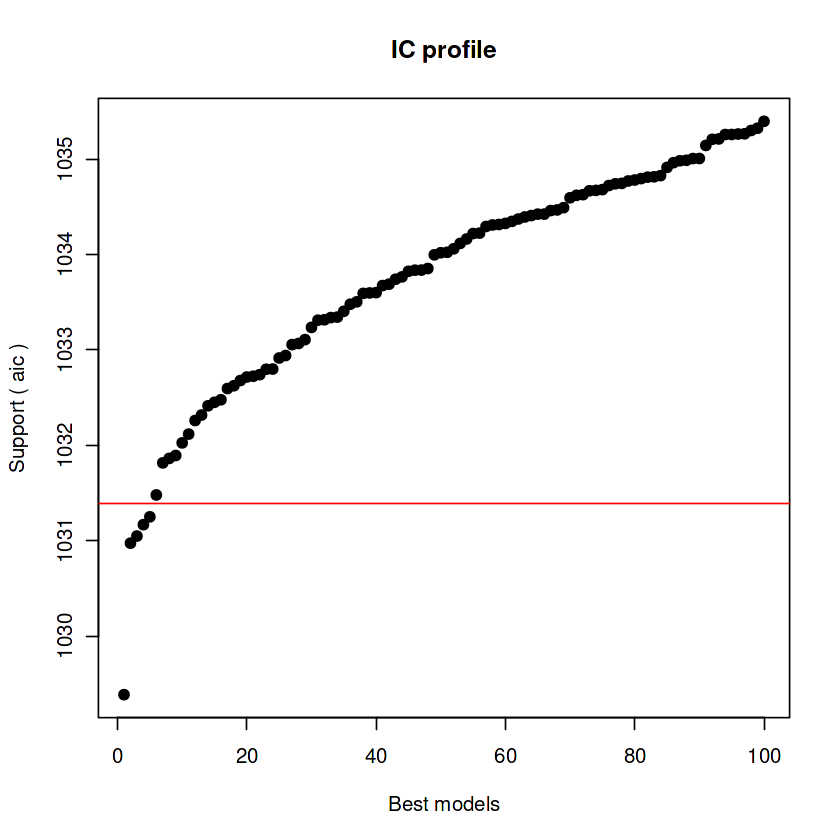


After 93050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.55863381436


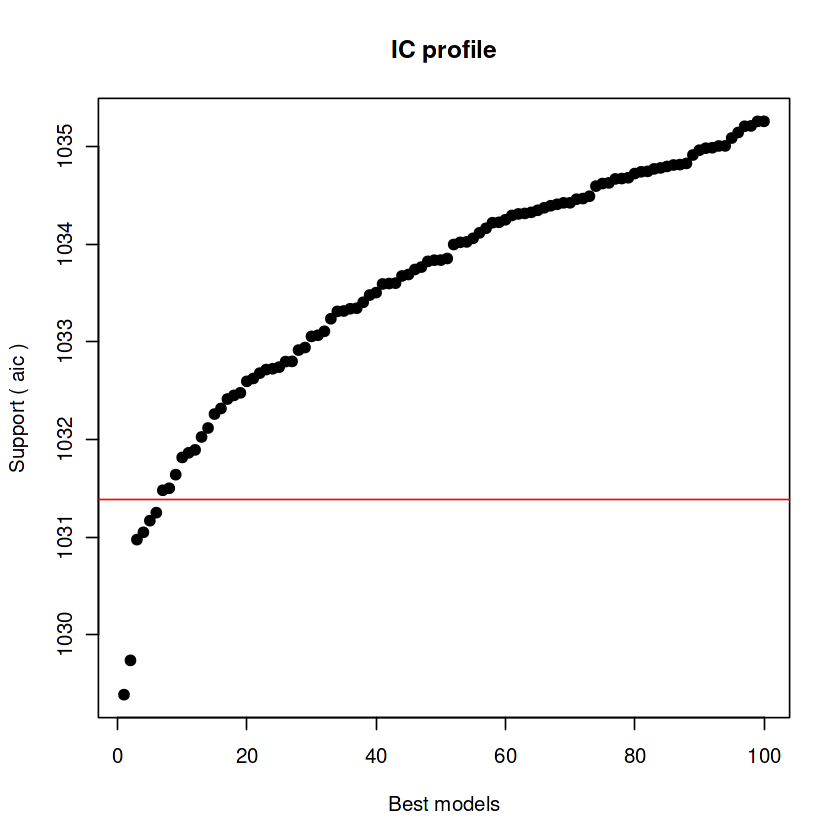


After 93100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.54422012777


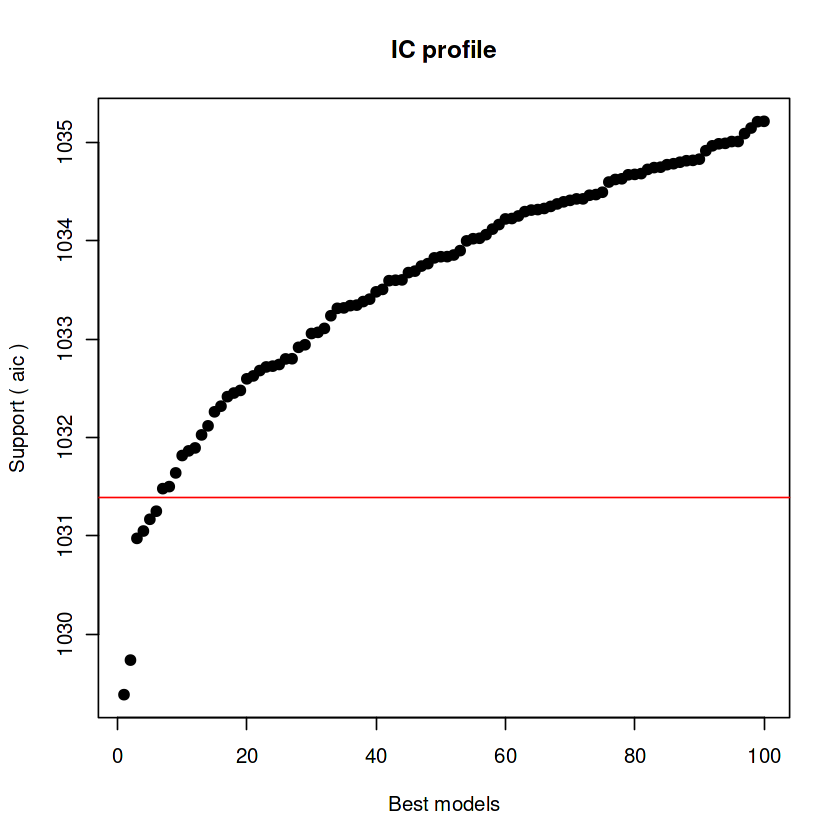


After 93150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.43483499927


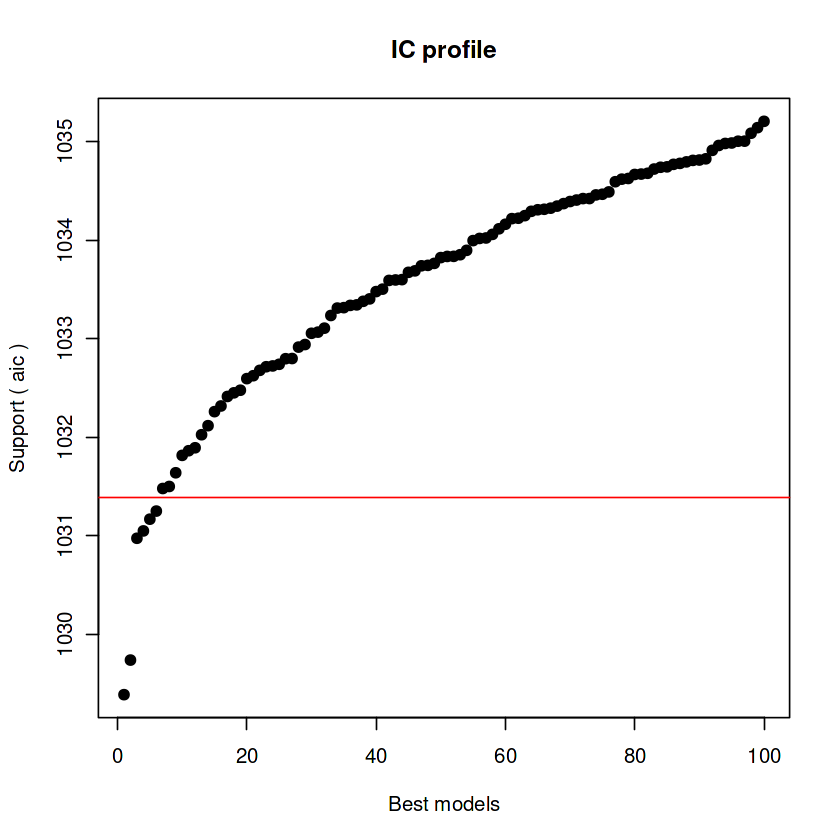


After 93200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.35307025327


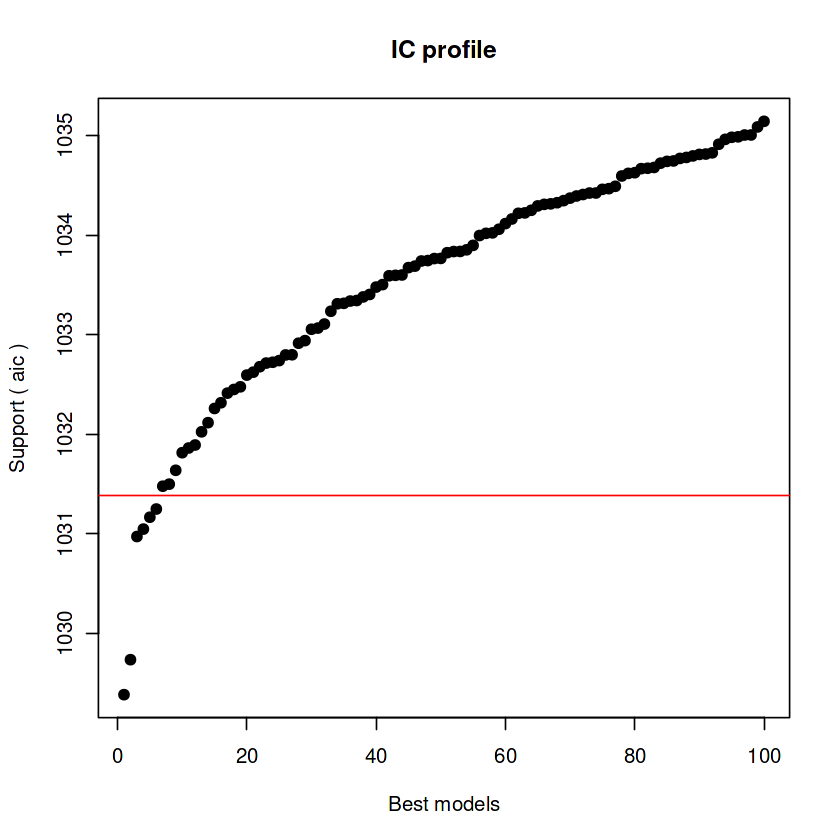


After 93250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971


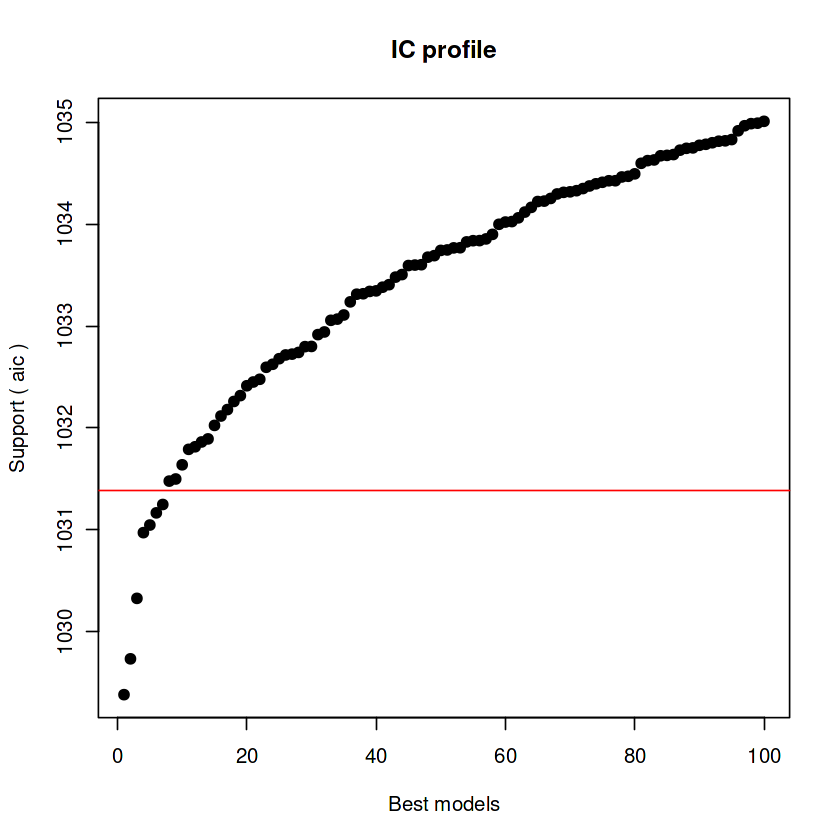


After 93300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971


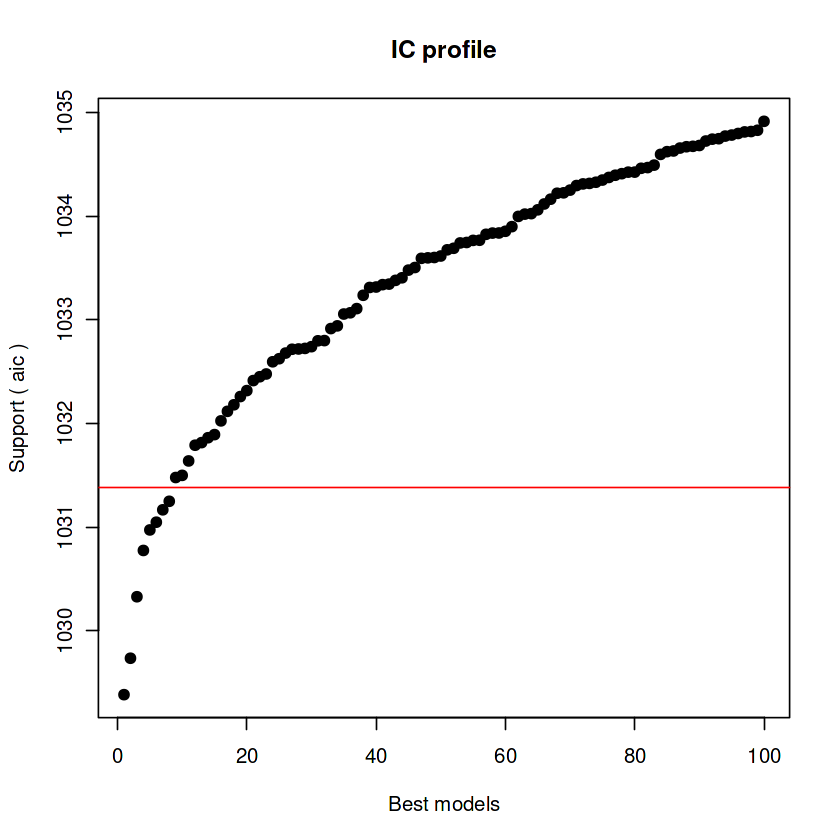


After 93350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 93400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 93450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 93500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 93550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 93600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 93650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 93700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 93750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 93800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 93850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 93900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 93950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 94950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 95950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.32368962971



After 96600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.31460858393



After 96650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.30727853702


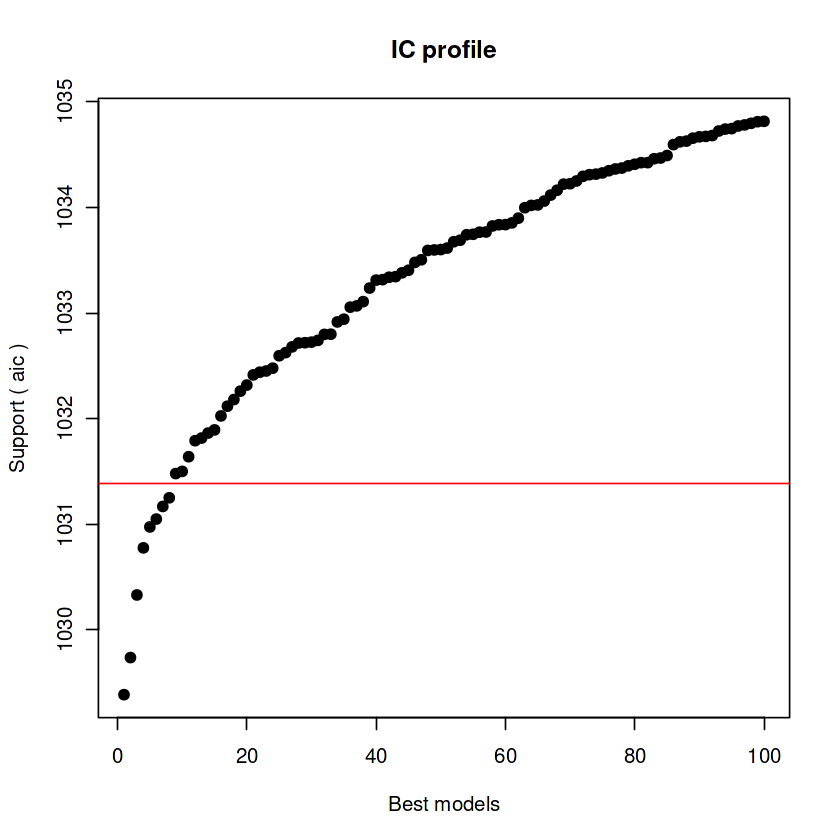


After 96700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.30727853702


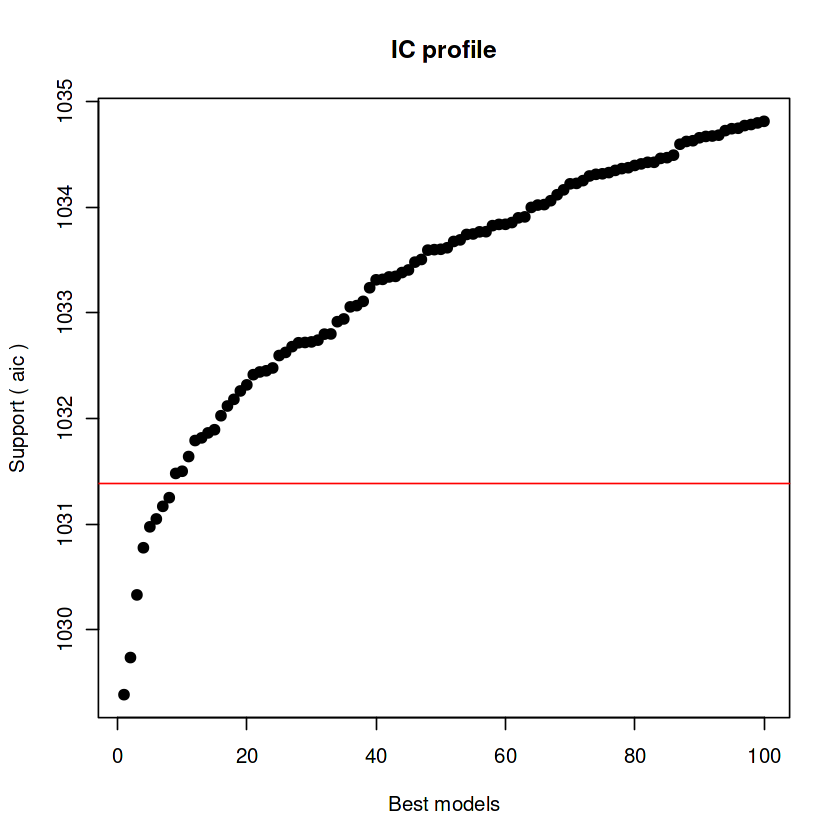


After 96750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.30727853702



After 96800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.30727853702



After 96850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.30688675152



After 96900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.30688675152


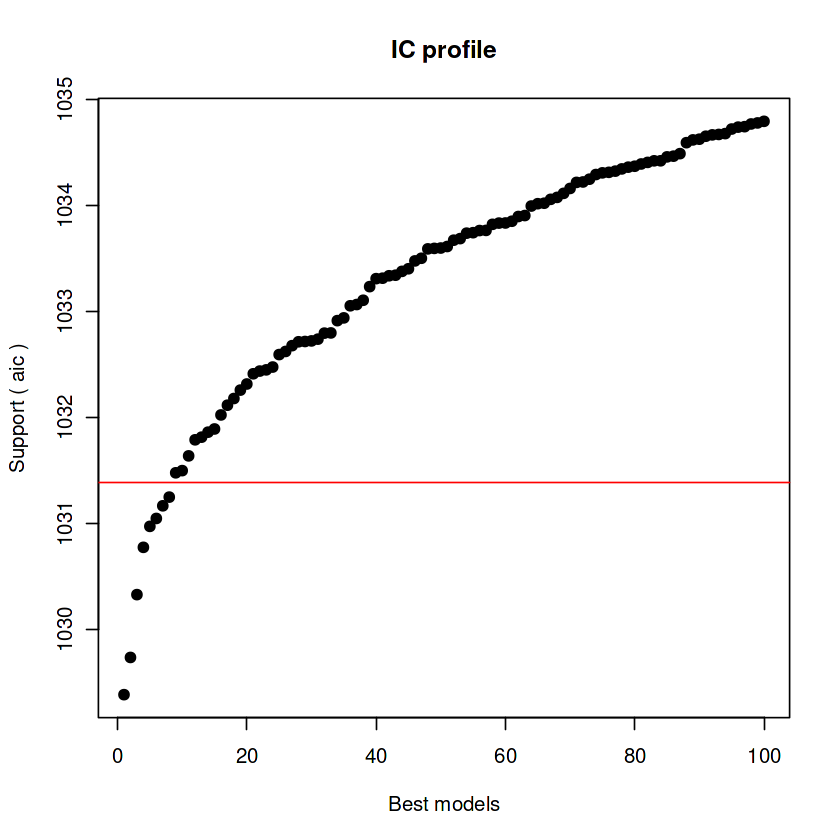


After 96950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.30688675152



After 97000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.30688675152



After 97050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.30688675152



After 97100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.27500417465



After 97150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.26578675185


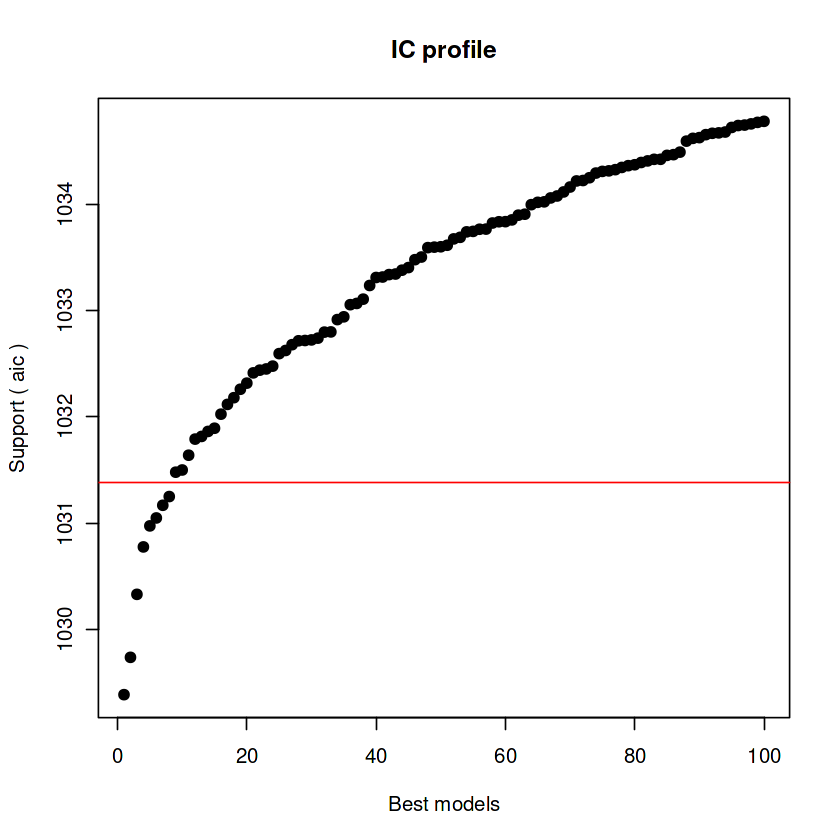


After 97200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.24556146367


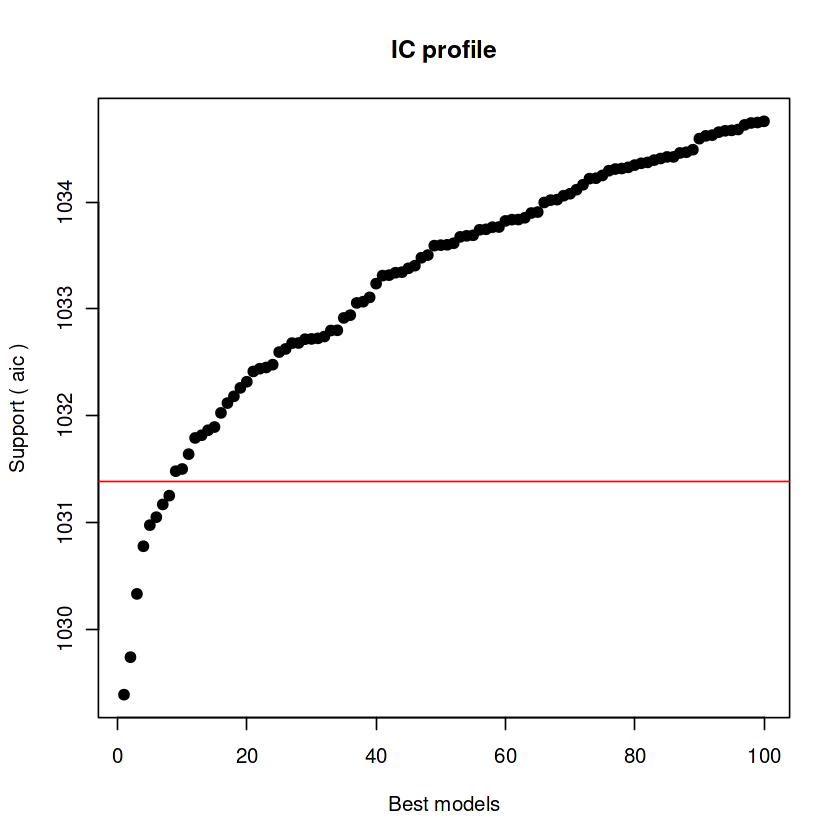


After 97250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.24556146367


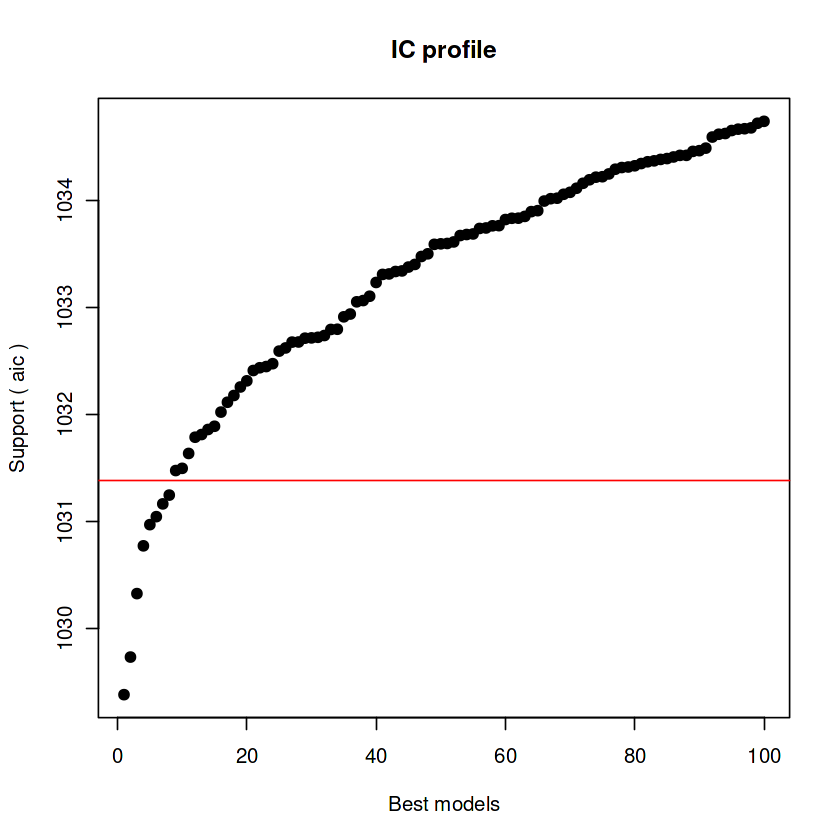


After 97300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.24556146367



After 97350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.24492416675



After 97400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.23435013791


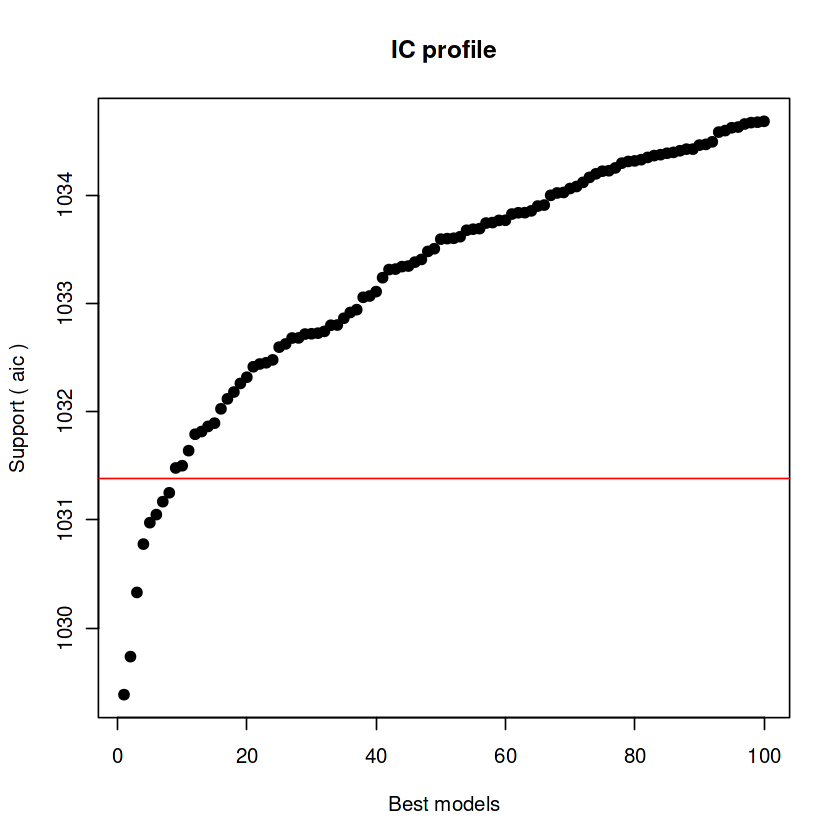


After 97450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911


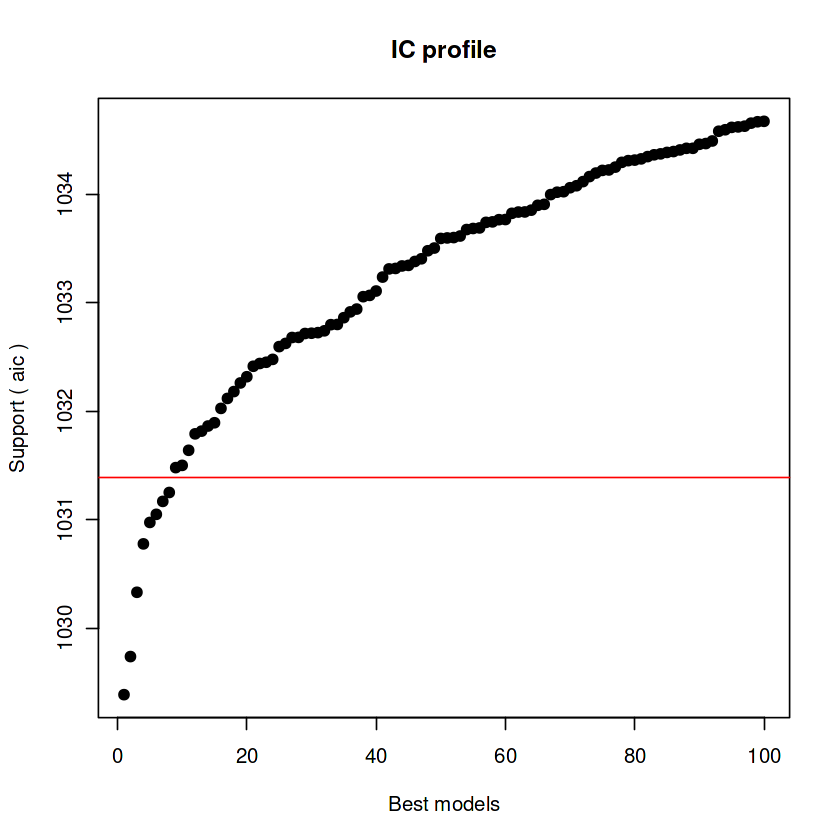


After 97500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911


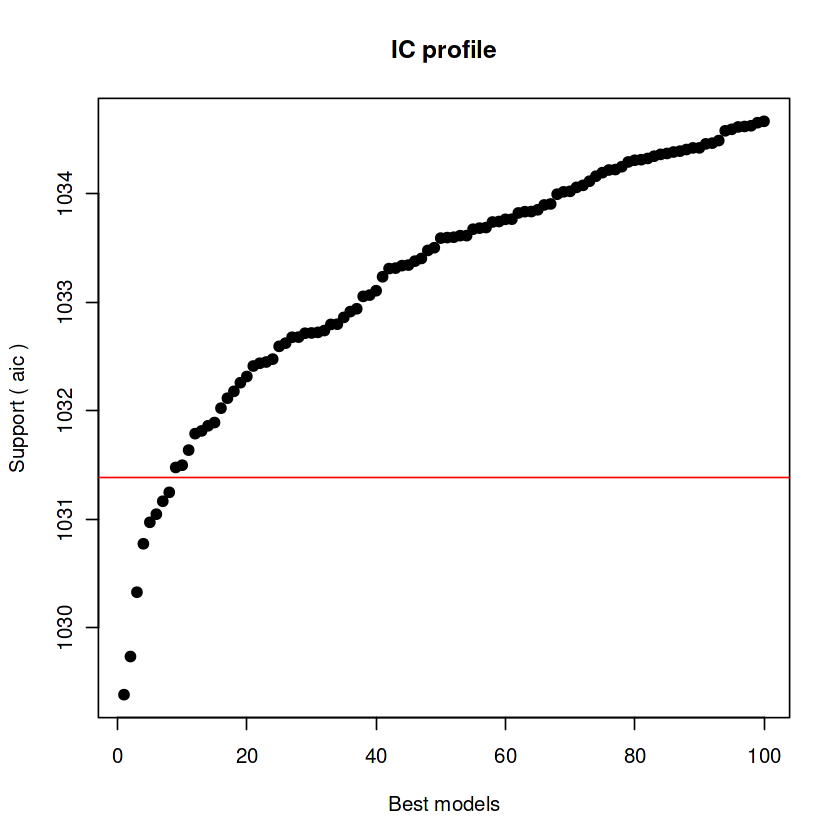


After 97550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 97600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 97650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 97700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 97750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 97800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 97850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 97900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 97950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 98950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 99950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 1e+05 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 100050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 100100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 100150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 100200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 100250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 100300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 100350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 100400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 100450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 100500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.22662295911



After 100550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.21534412328



After 100600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.21490206225


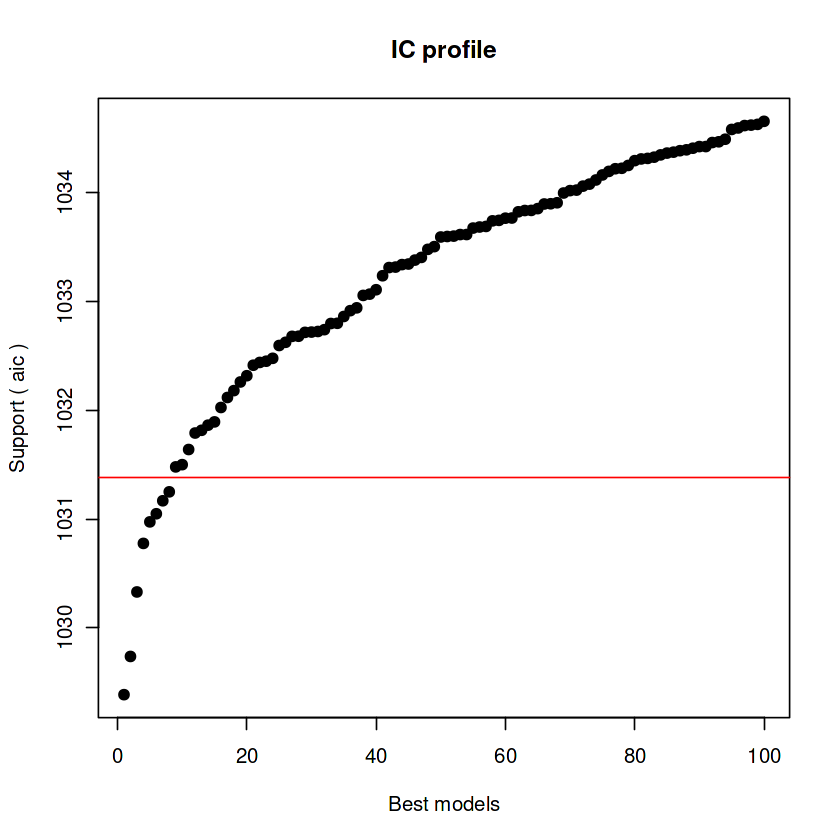


After 100650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.21490206225


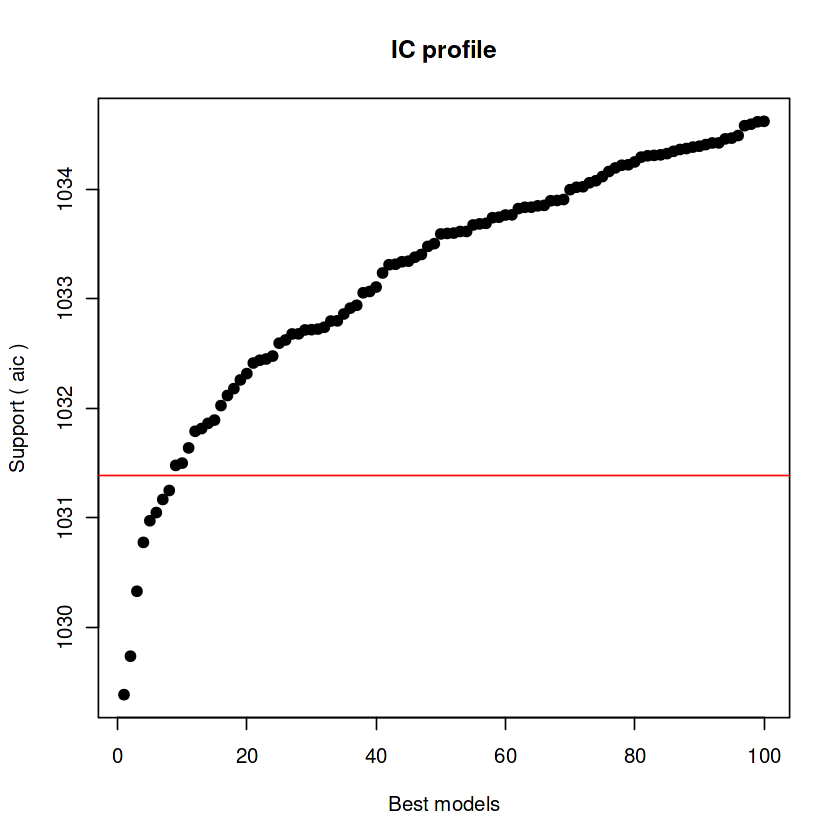


After 100700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.21490206225



After 100750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.21490206225



After 100800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.20018177606



After 100850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.19867412134


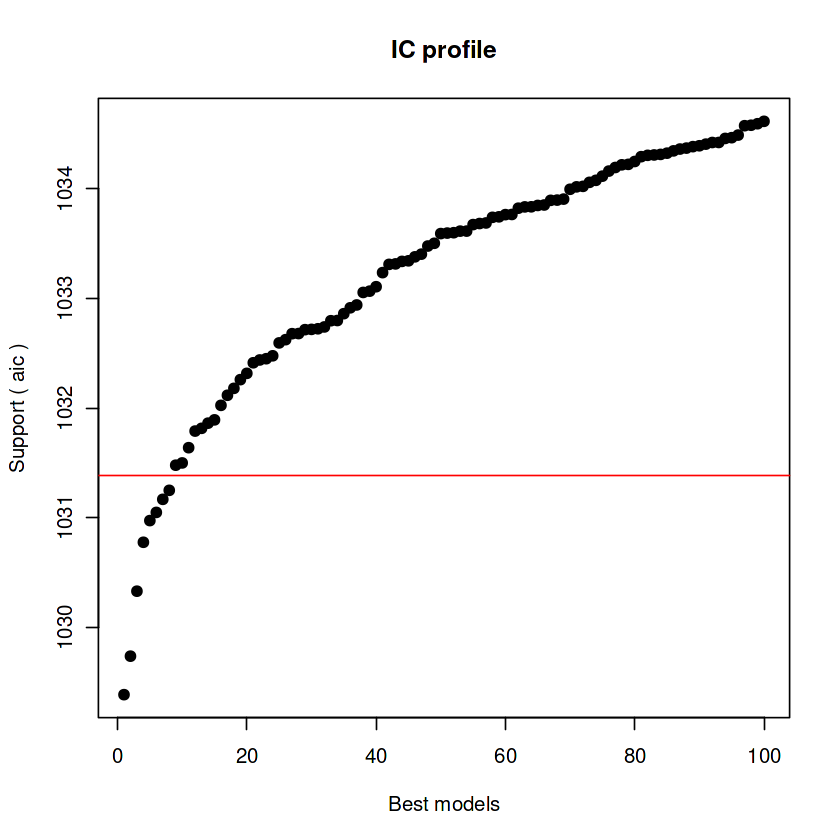


After 100900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.18798642825


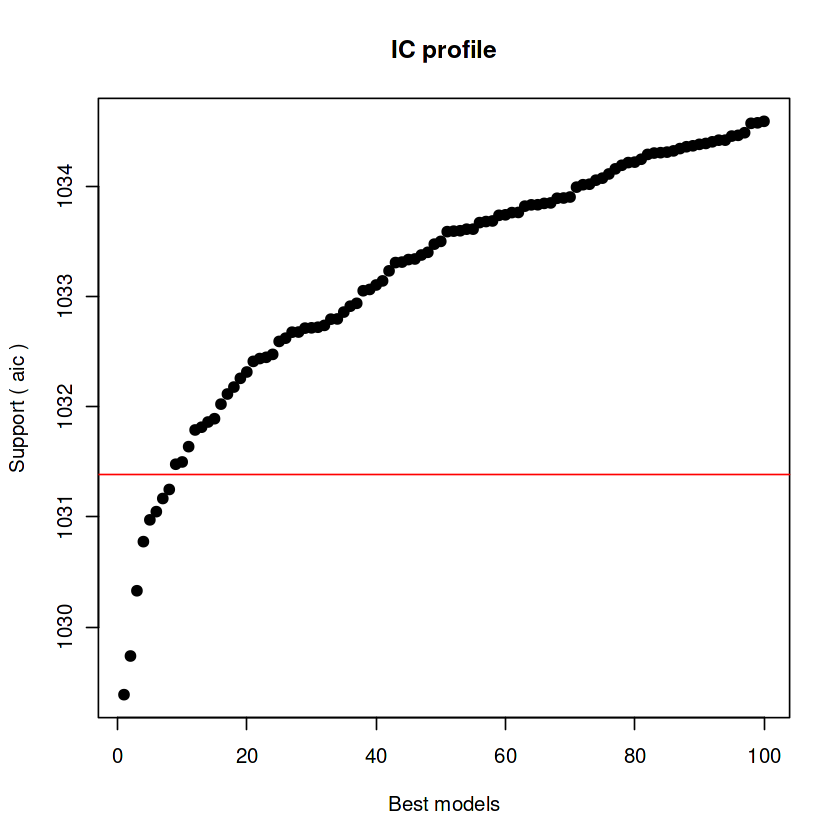


After 100950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.18798642825


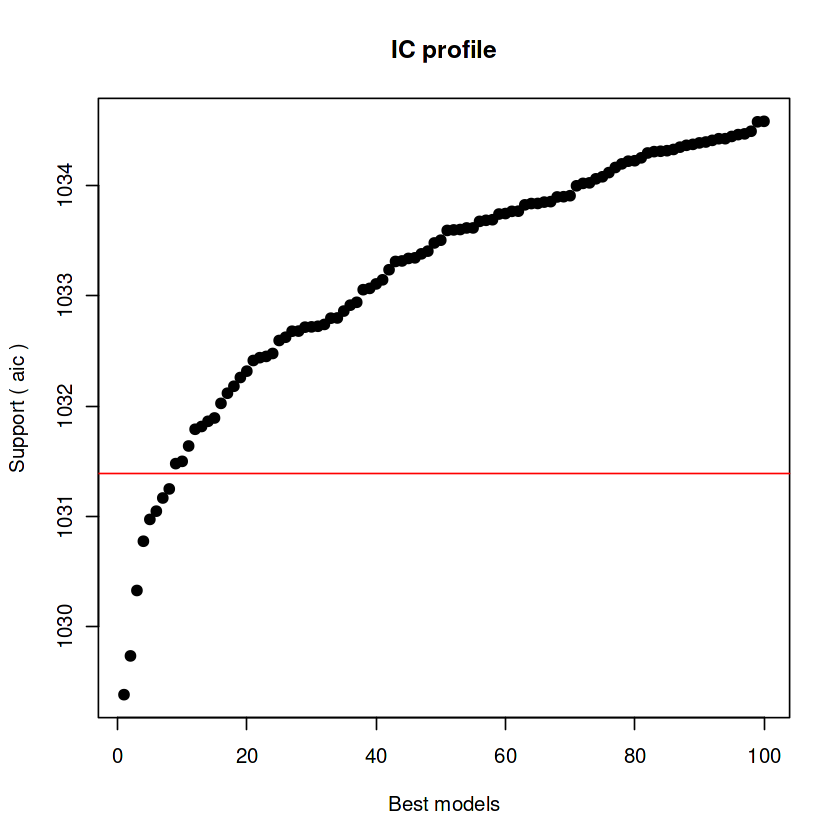


After 101000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.18798642825



After 101050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.18798642825



After 101100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.18359643043



After 101150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.18359643043


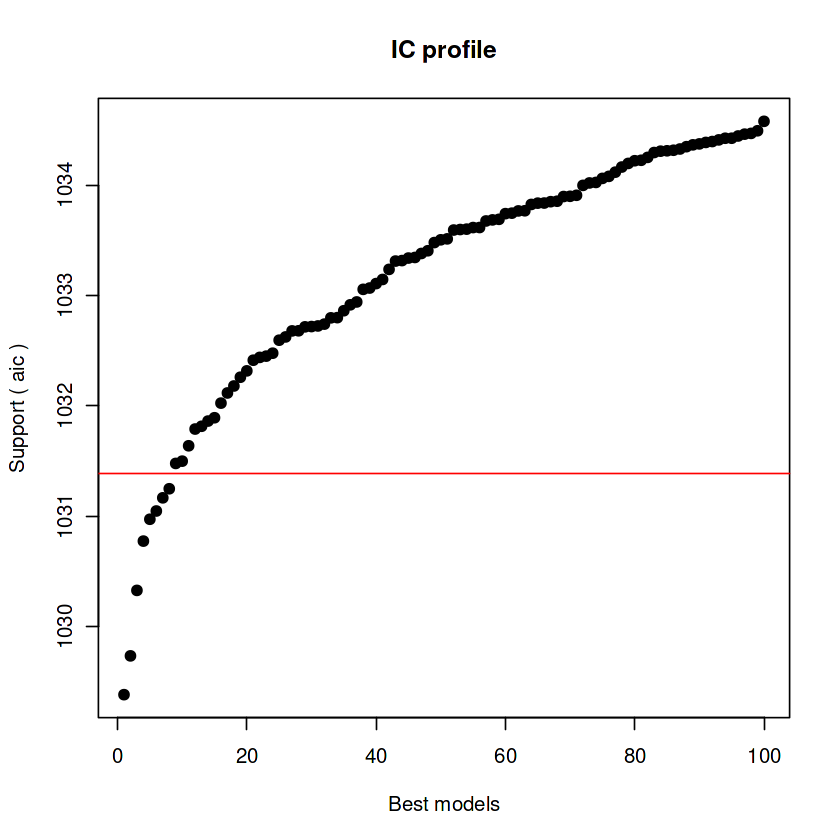


After 101200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.18246372745



After 101250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.18246372745


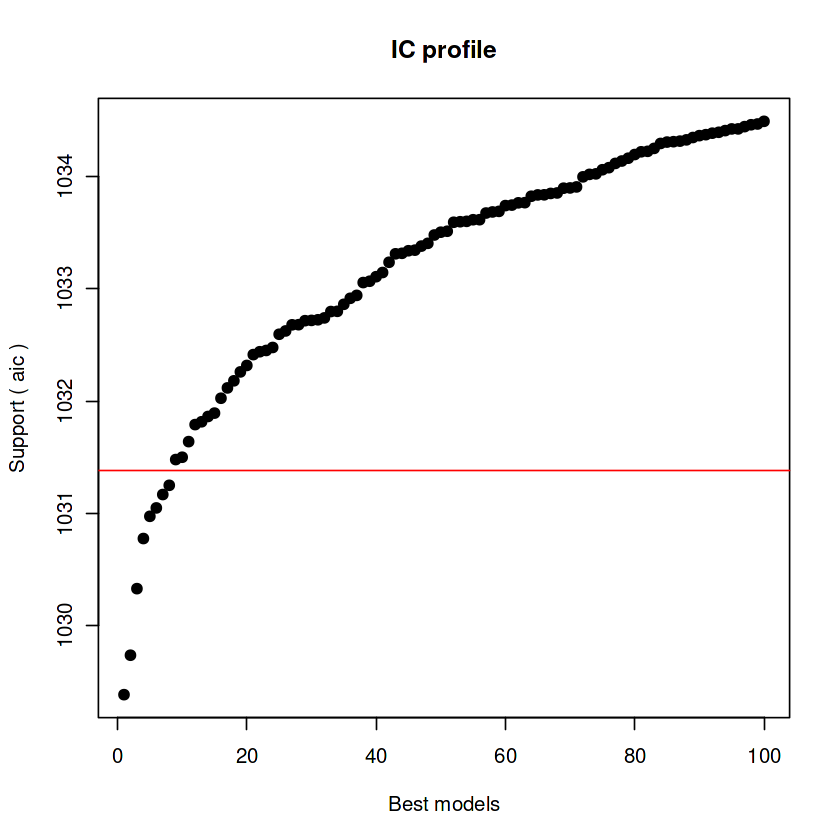


After 101300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.17988941236



After 101350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.1266878465


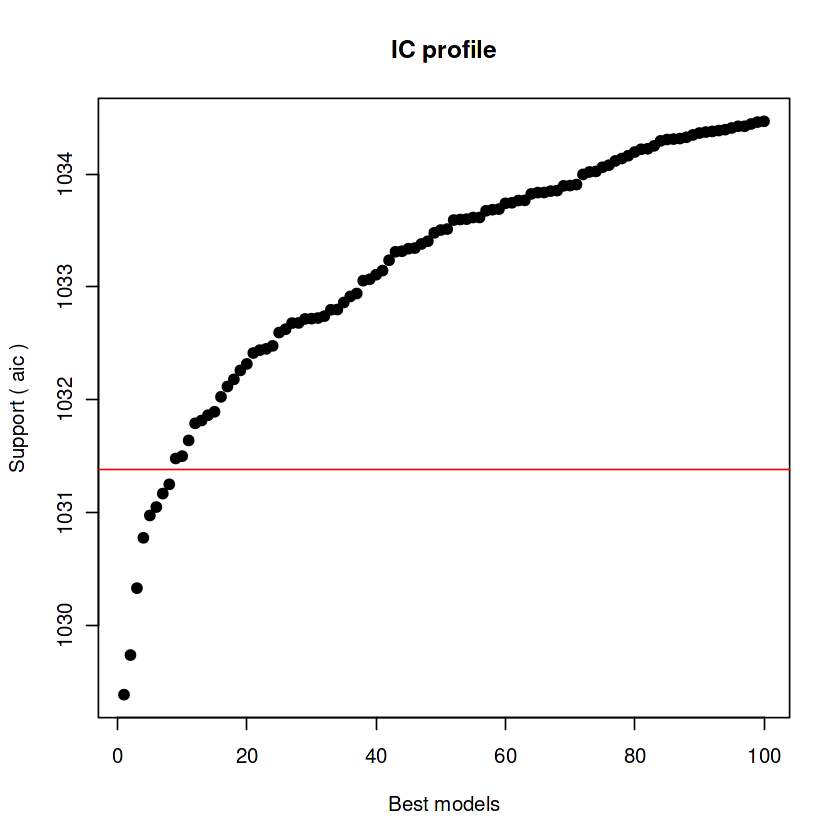


After 101400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.06480521198


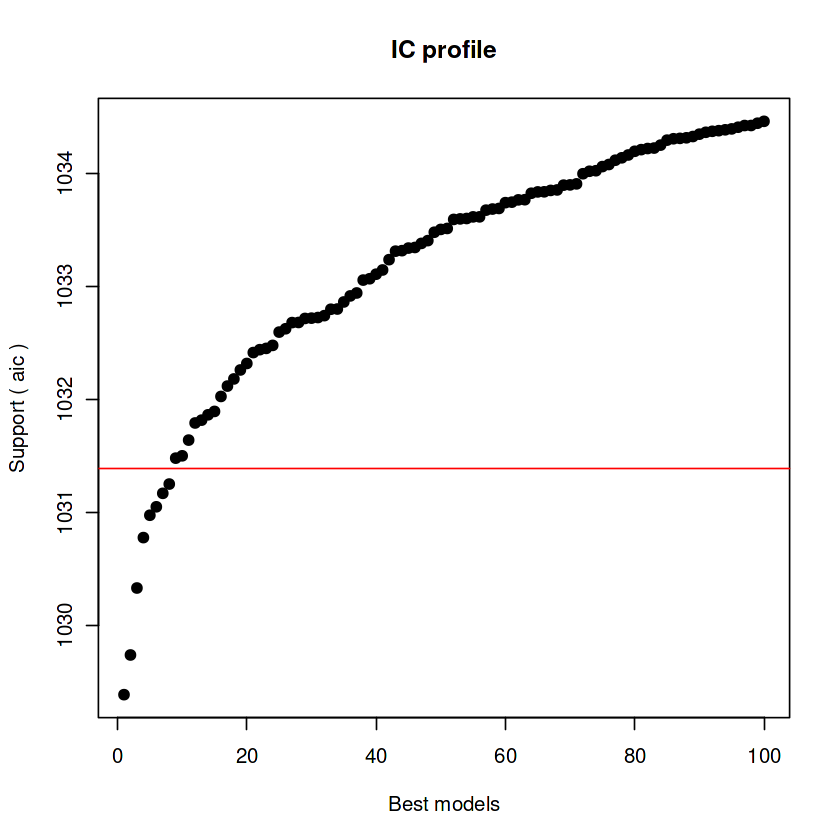


After 101450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.05154038766


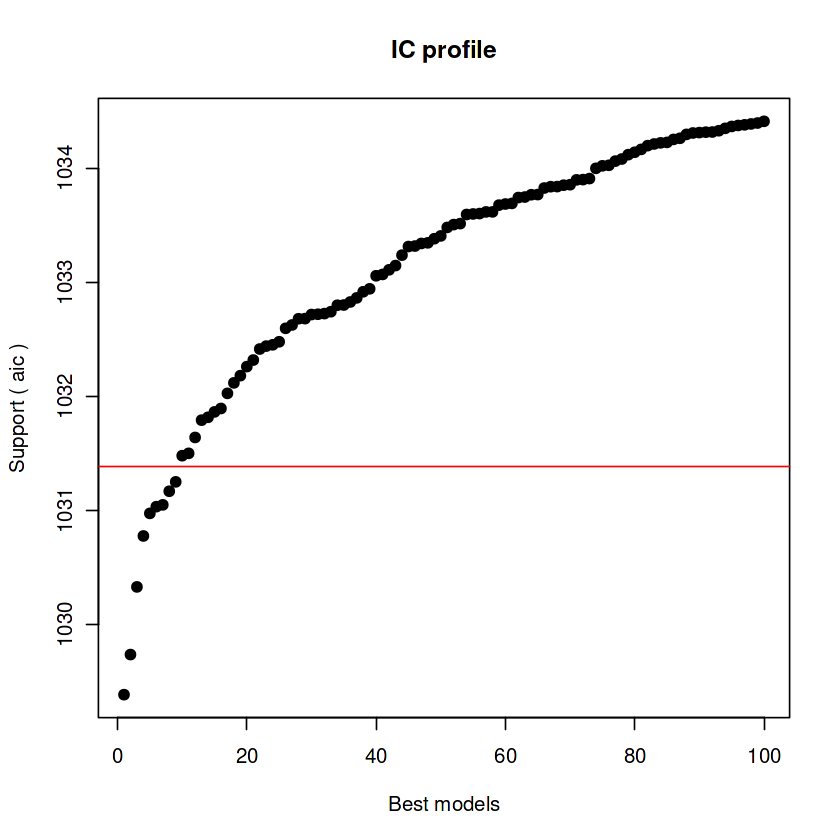


After 101500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.05154038766


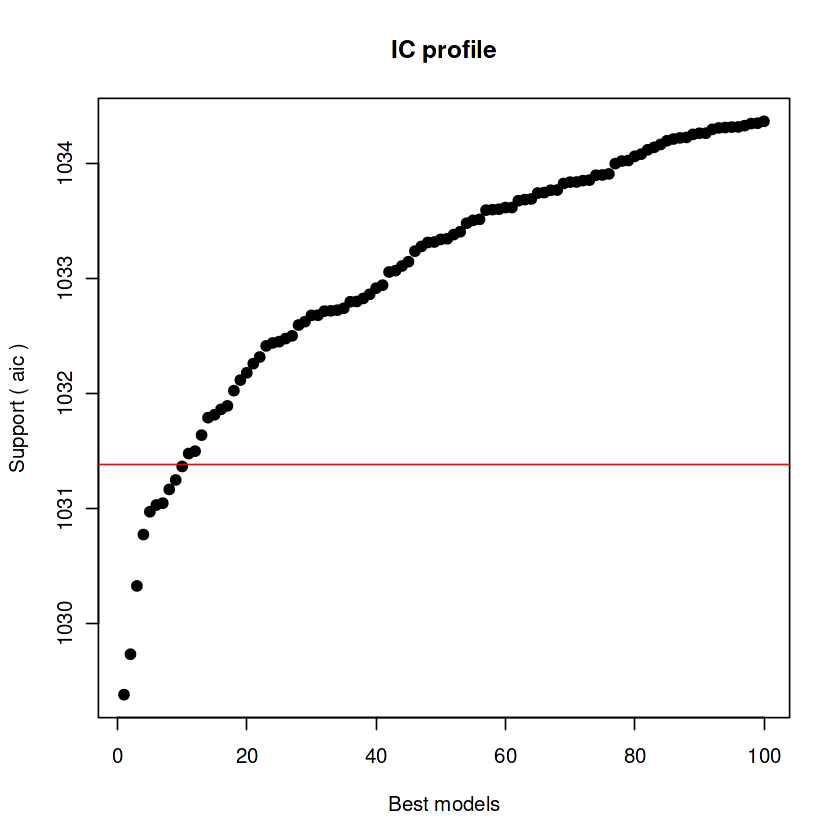


After 101550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.05154038766



After 101600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.02575758803



After 101650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1033.0174570751


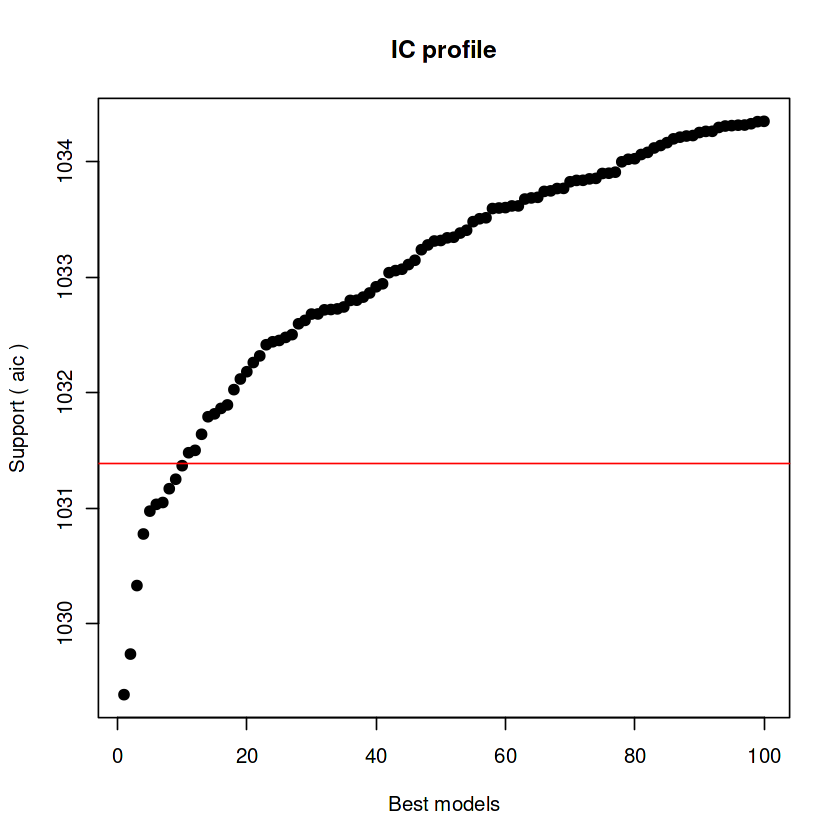


After 101700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529


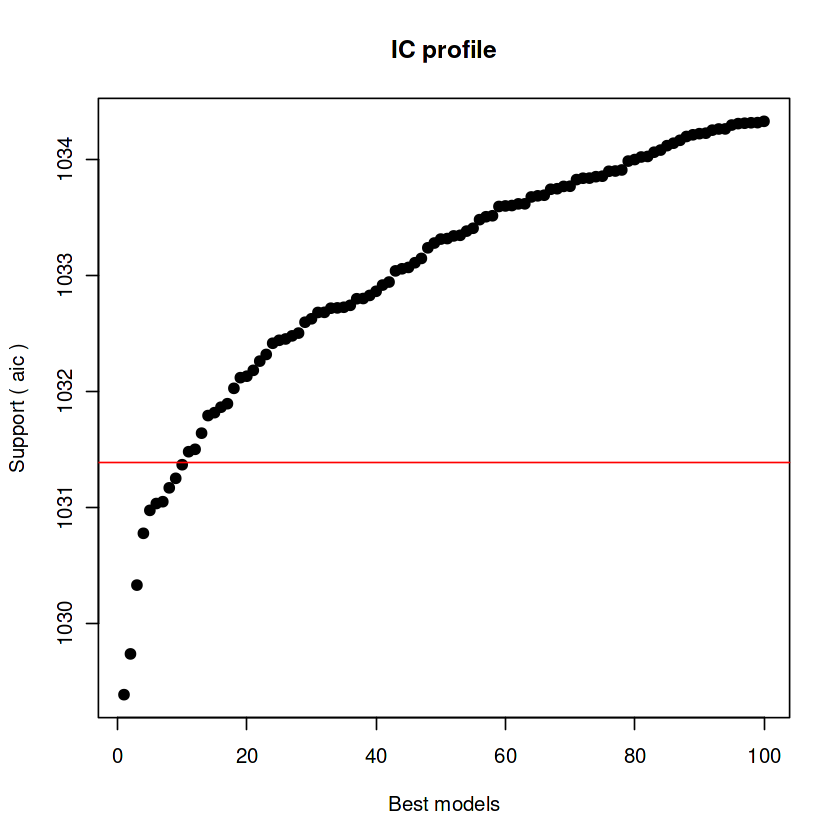


After 101750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529


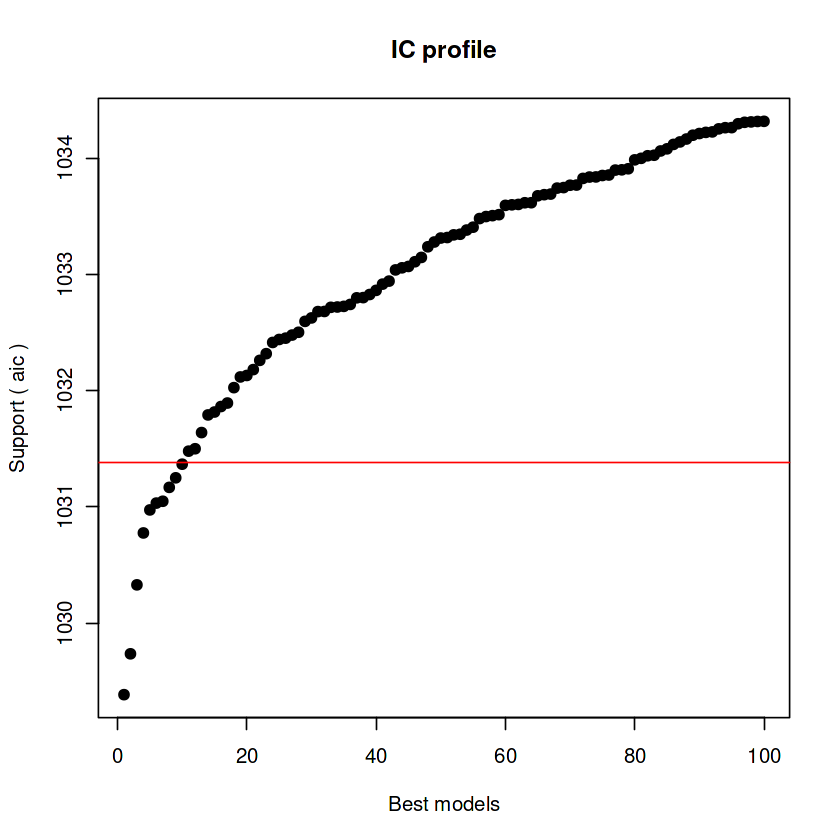


After 101800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 101850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 101900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 101950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 102950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 103950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99818203529



After 104800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99017618474



After 104850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.99017618474


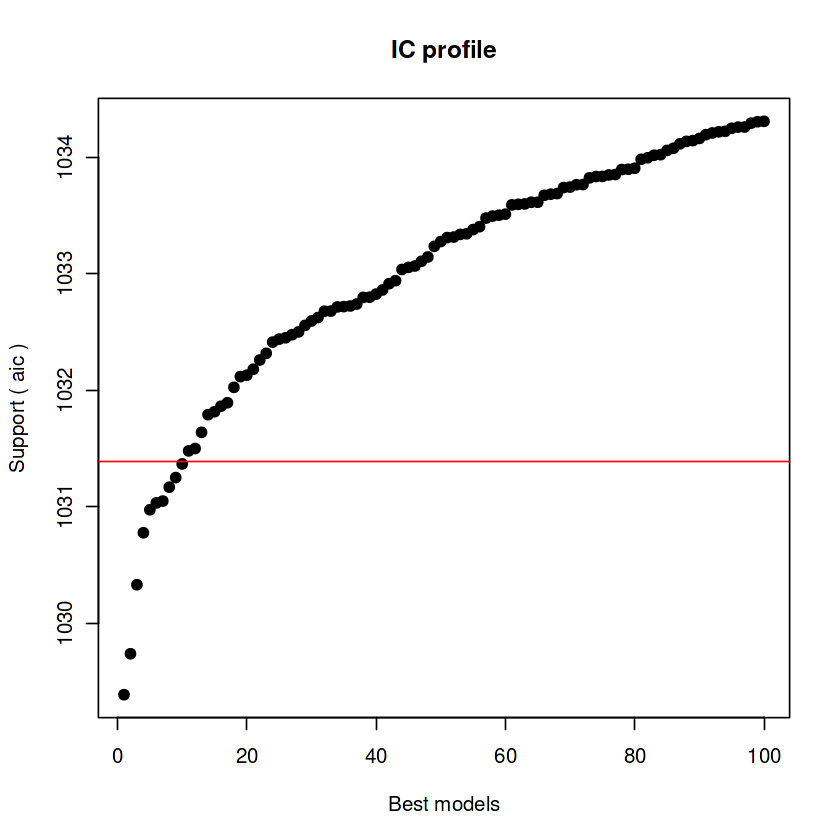


After 104900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.9894641831



After 104950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.98530093901


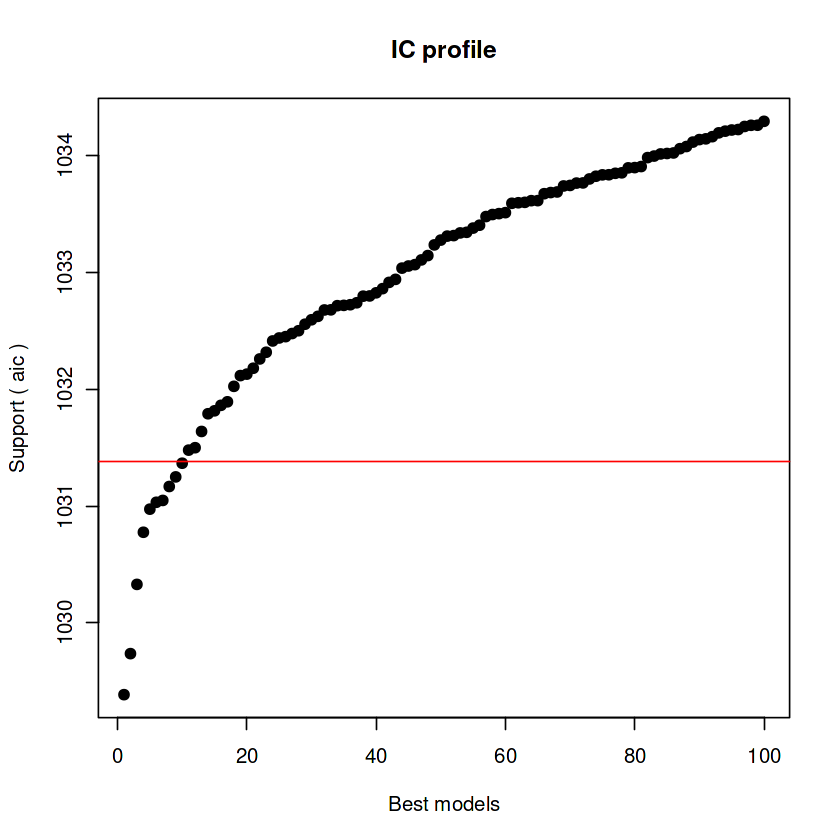


After 105000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.98283919894


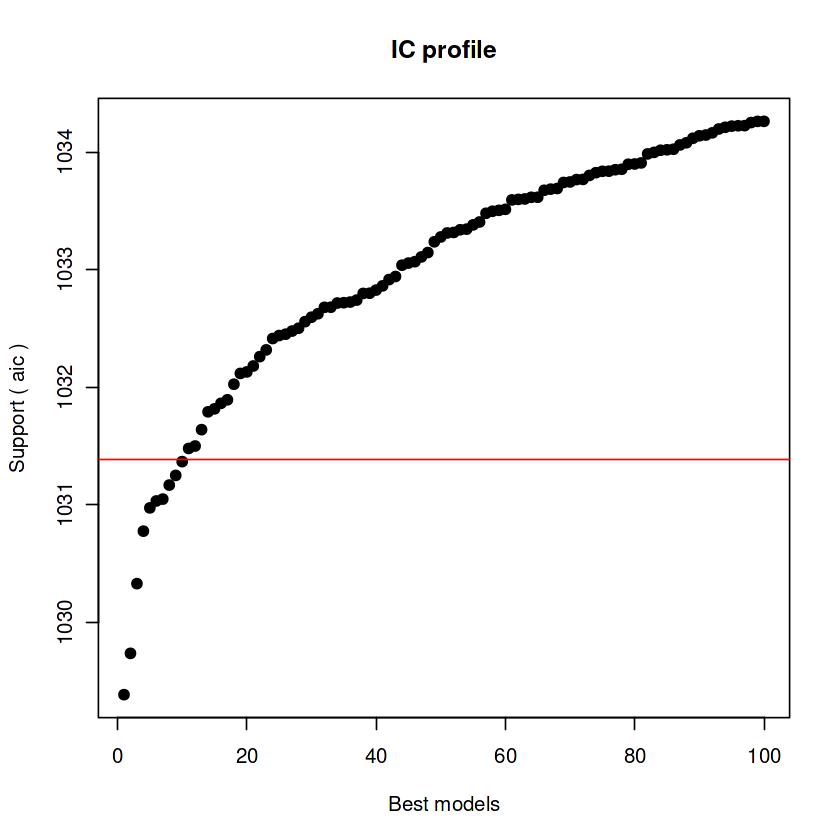


After 105050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.95976223388


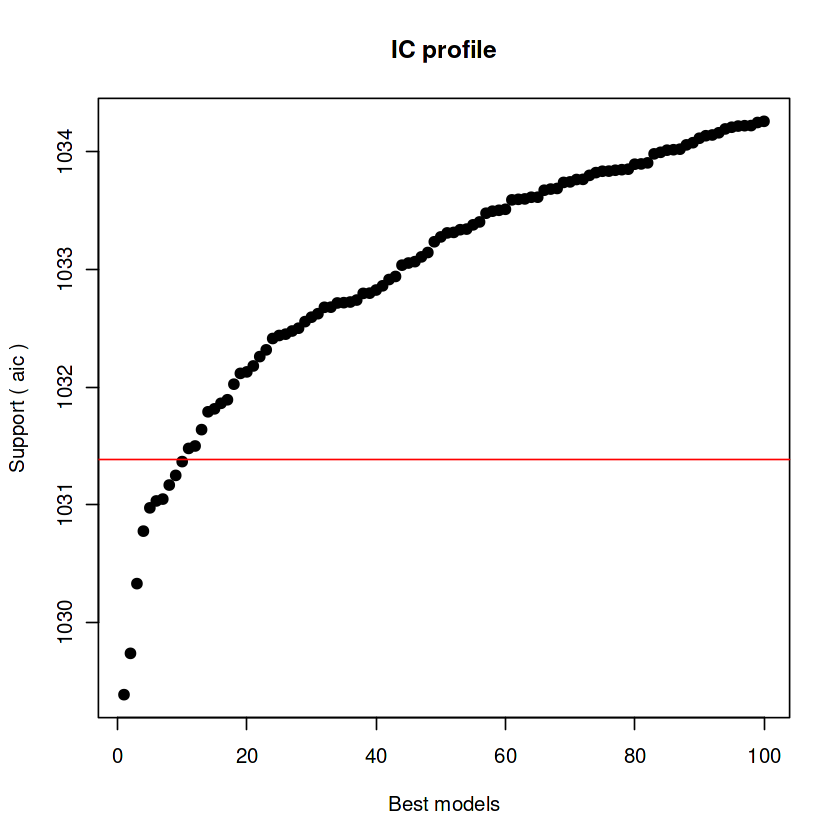


After 105100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.95976223388


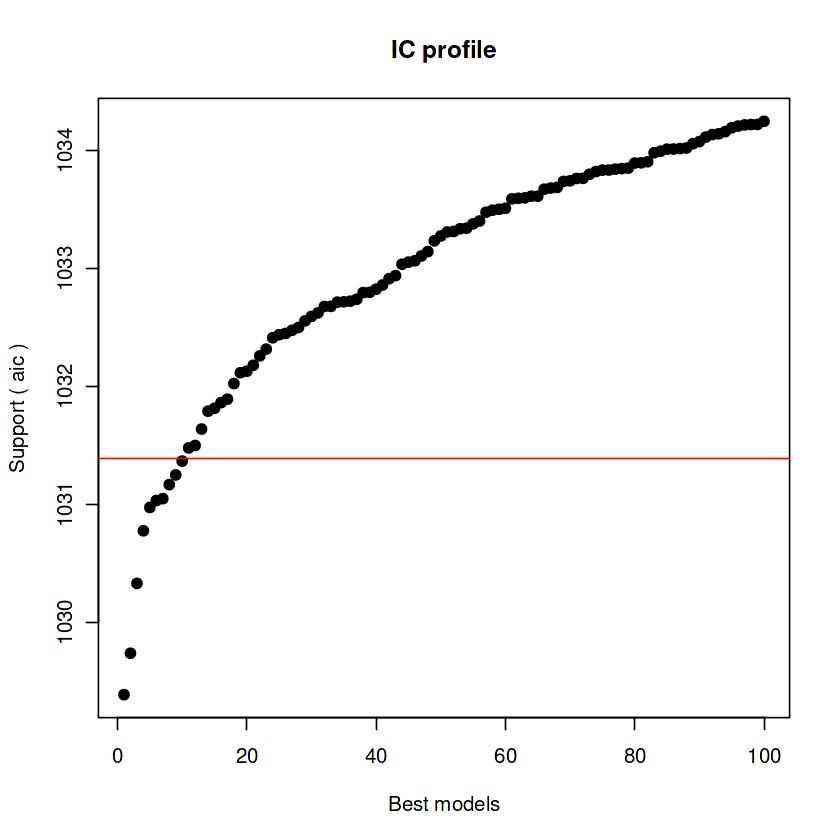


After 105150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.94846625025



After 105200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.94846625025


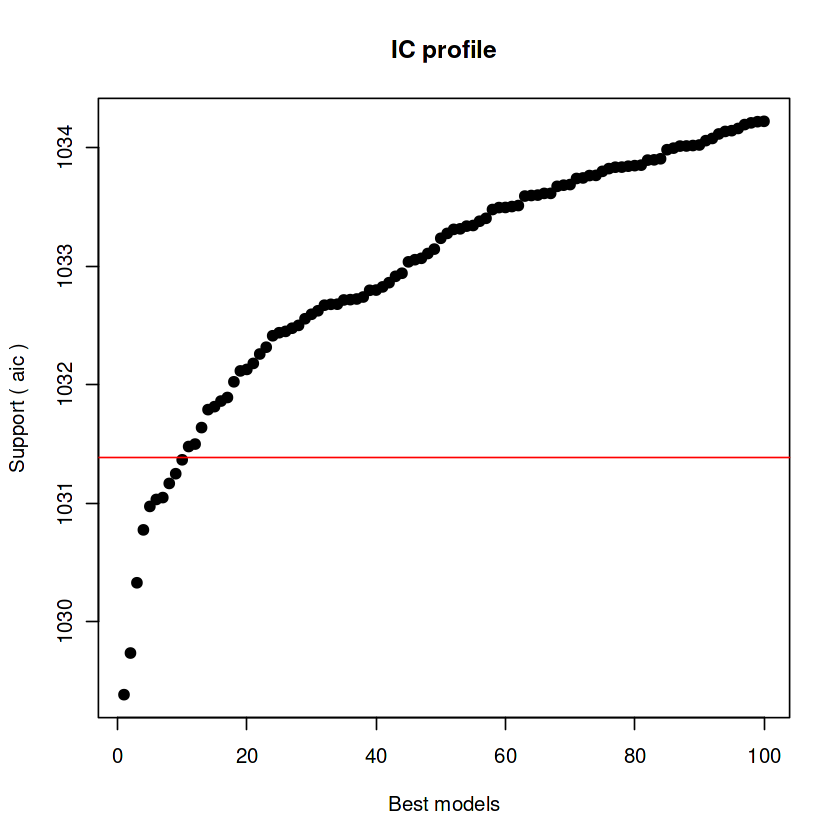


After 105250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.94846625025



After 105300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.94840921485



After 105350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.94018705498


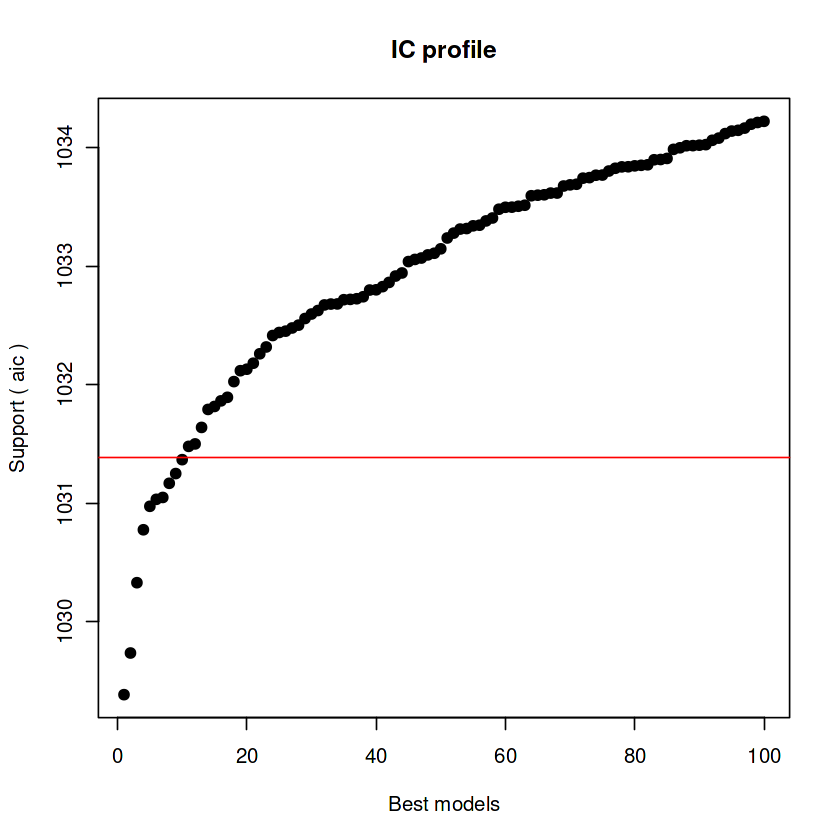


After 105400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.93722534244


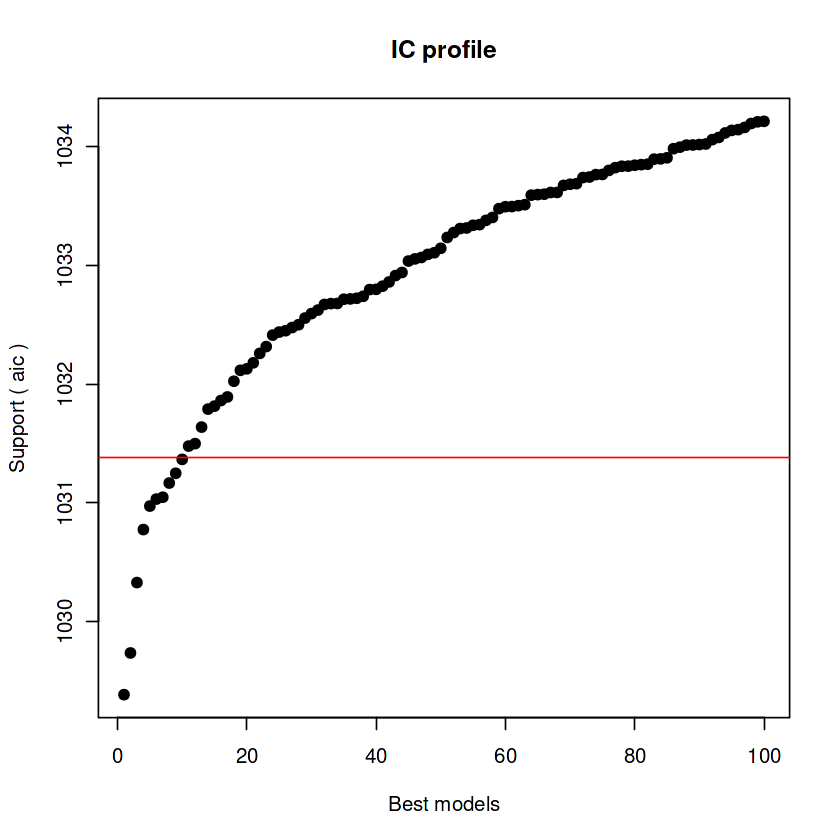


After 105450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.91310618816


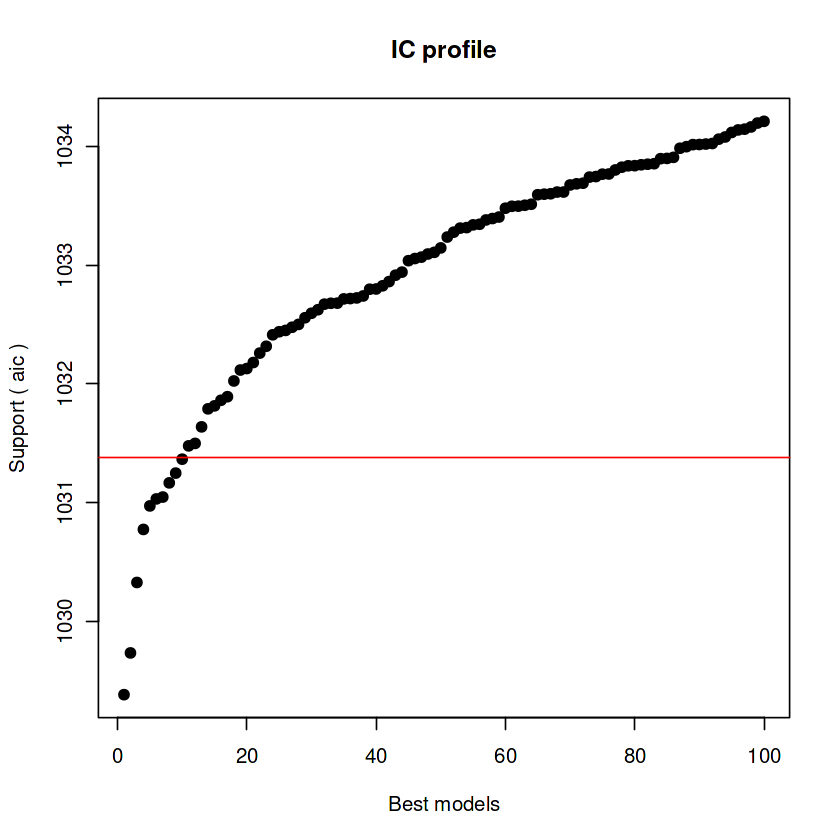


After 105500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.89731135621


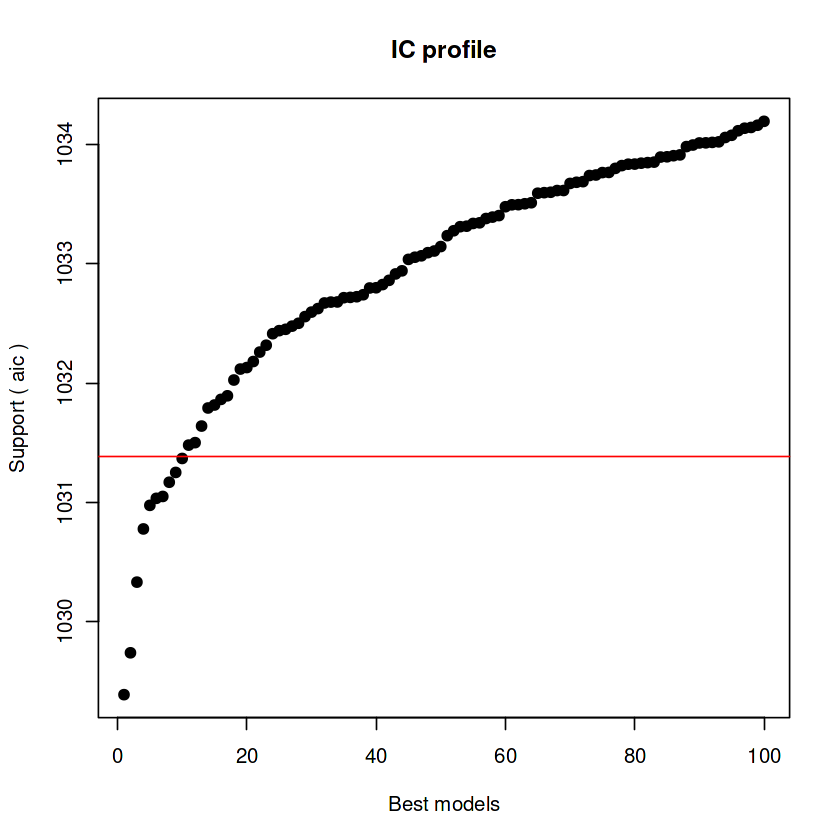


After 105550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.89731135621


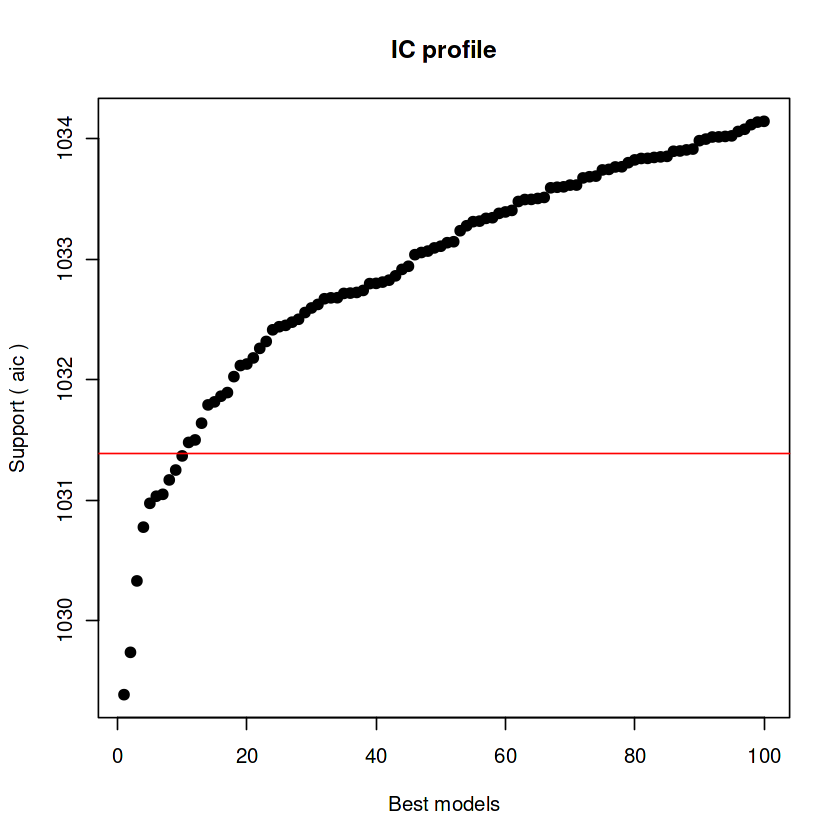


After 105600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.85432862418



After 105650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.82892865698


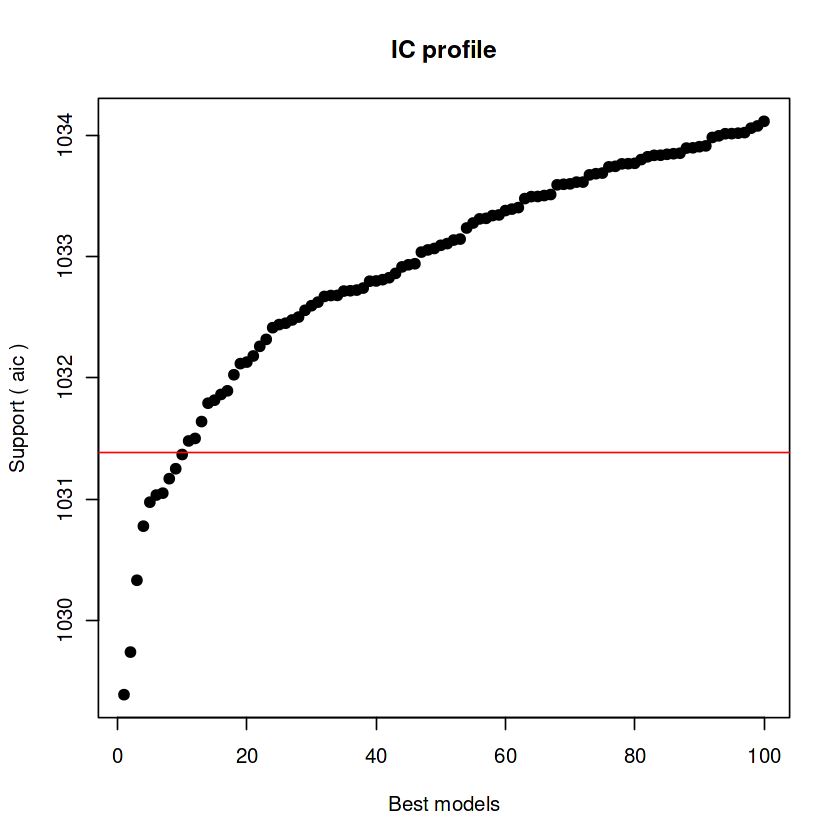


After 105700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.82709544819


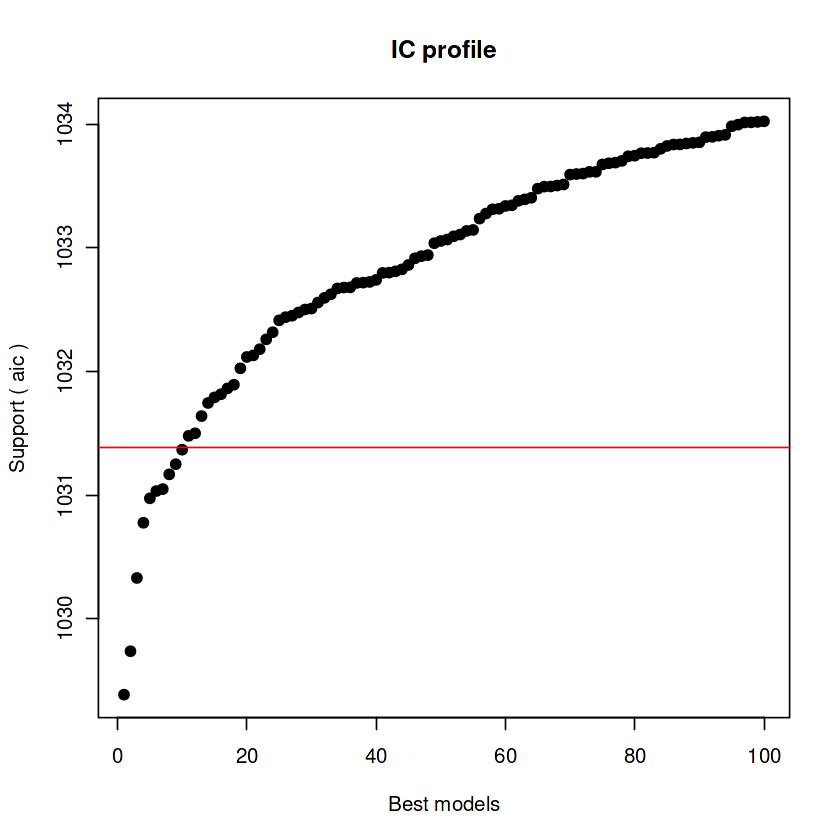


After 105750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.82709544819


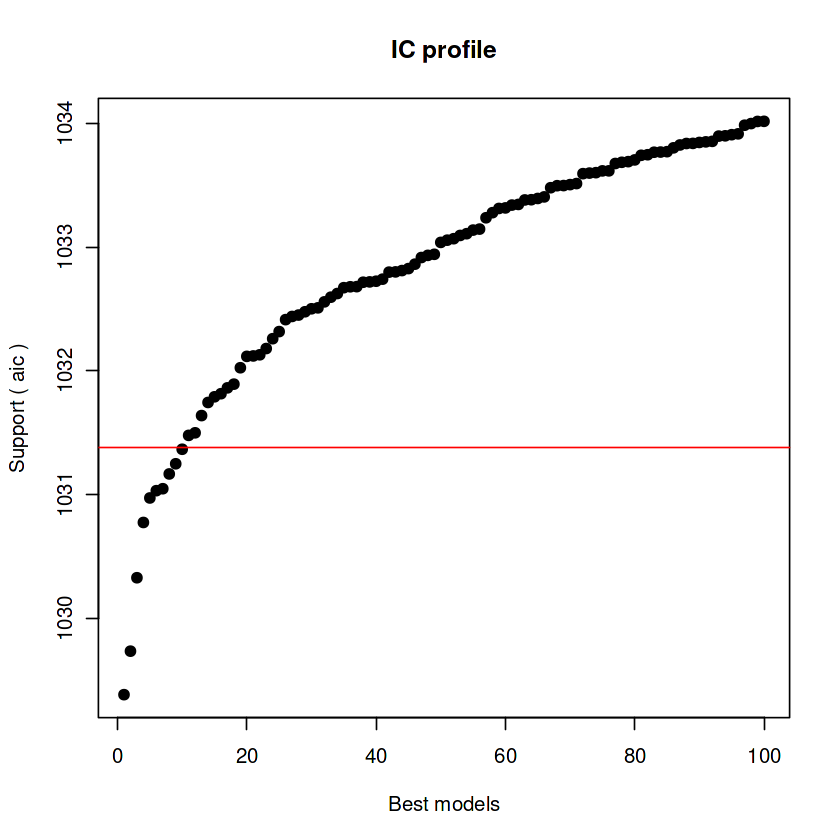


After 105800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.82709544819



After 105850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.80564897102



After 105900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582


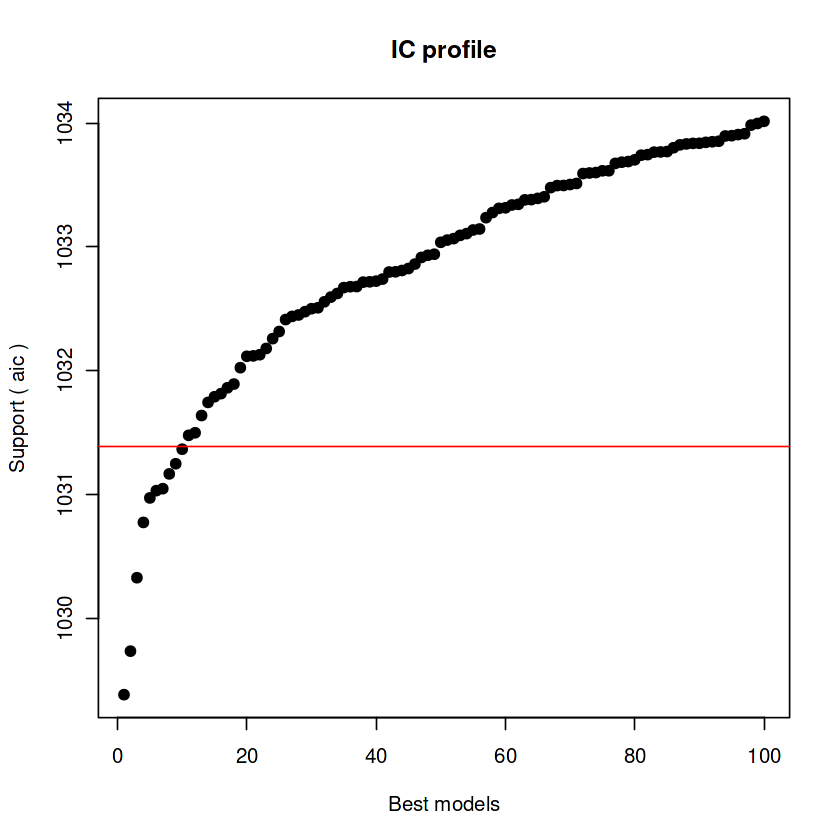


After 105950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582


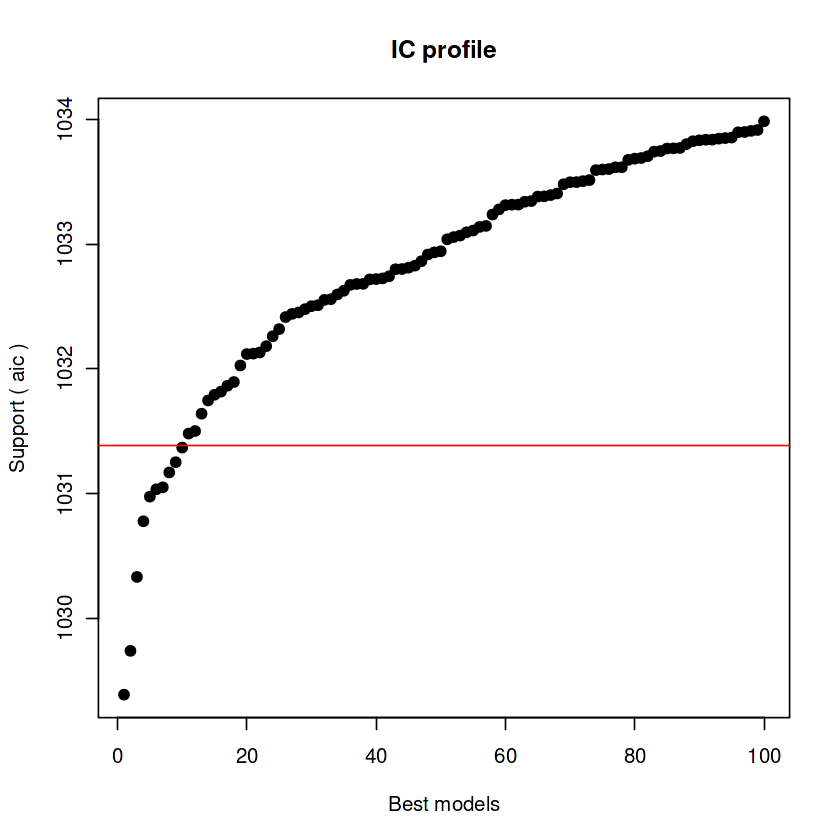


After 106000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 106950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 107950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 108950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.79606755582



After 109000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.7891959863



After 109050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.77735007404


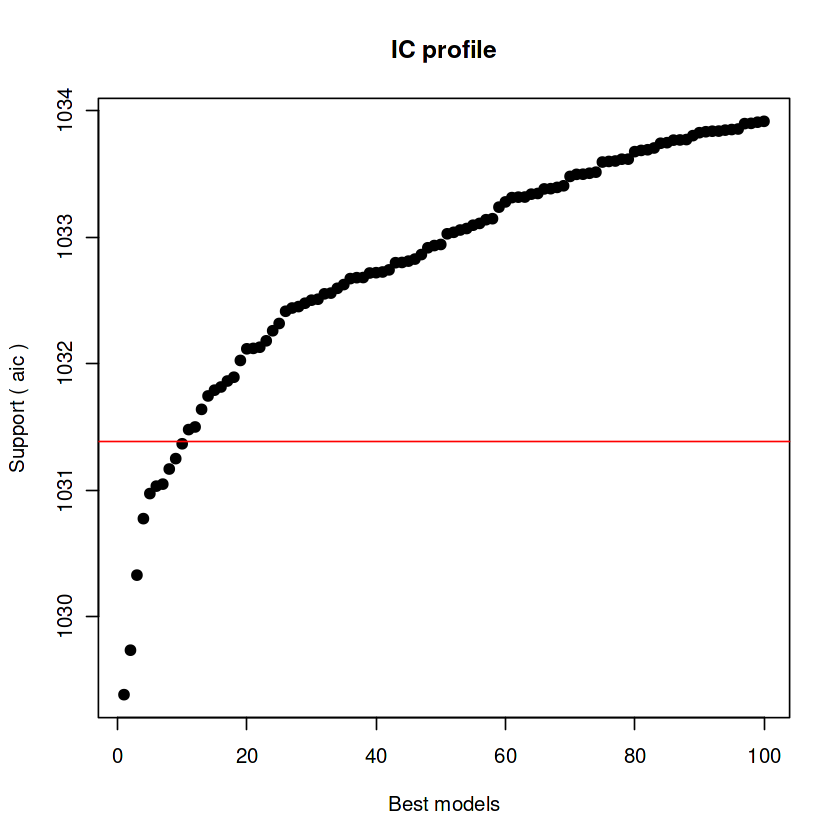


After 109100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.77427122623


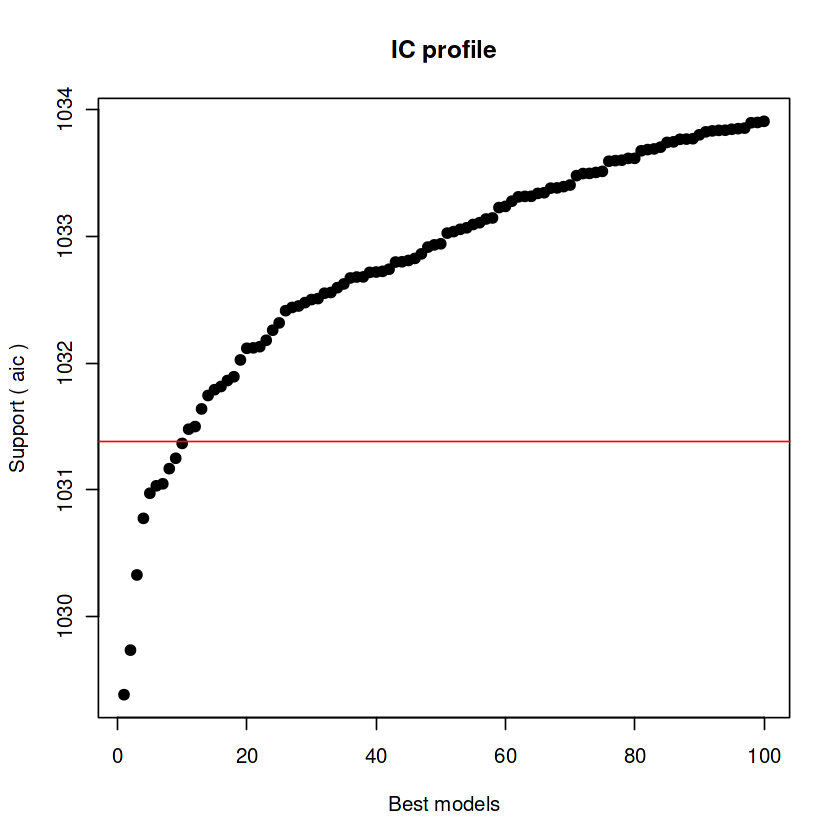


After 109150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.76761987131


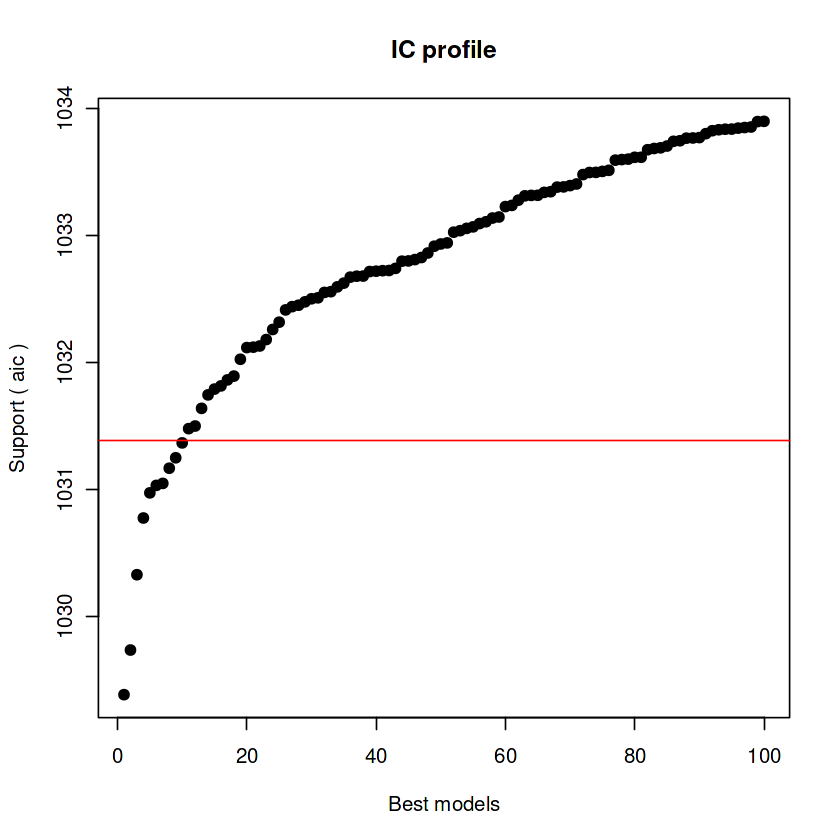


After 109200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.76472388734


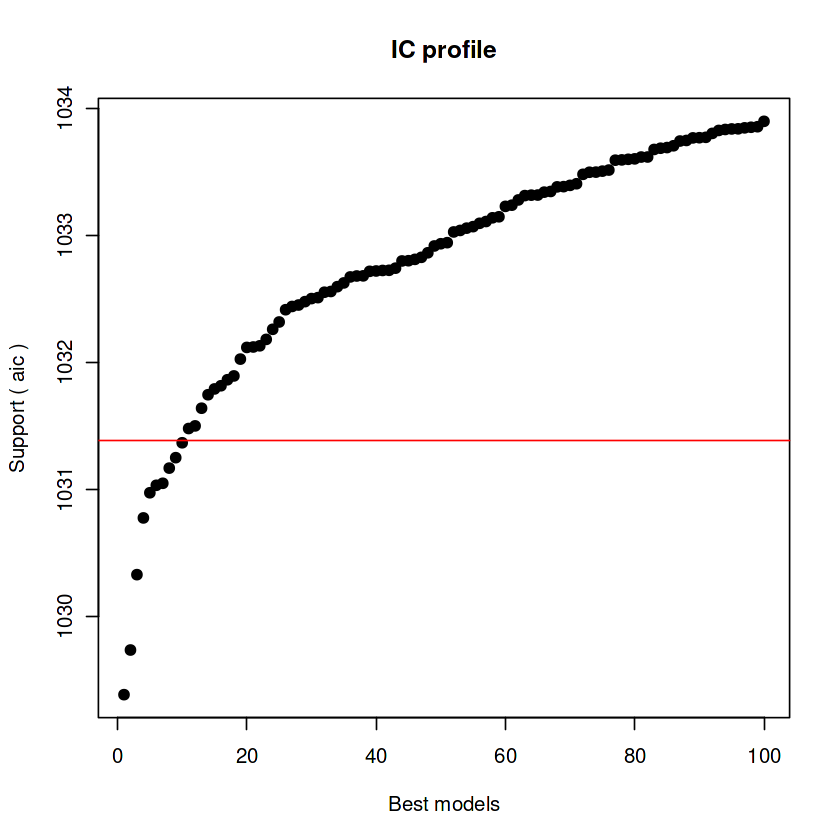


After 109250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.76472388734


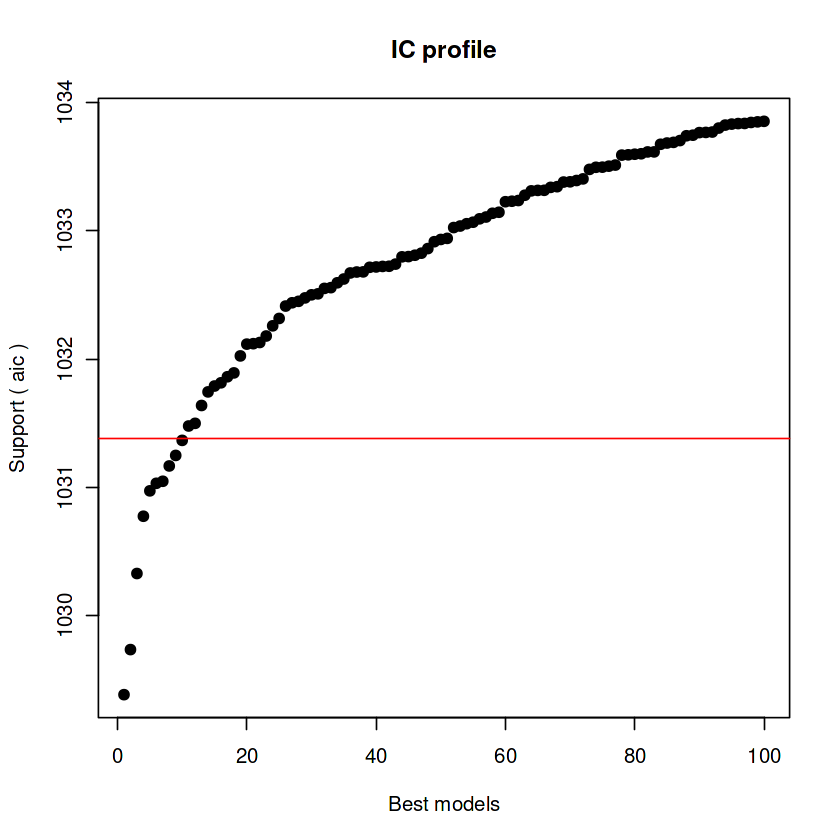


After 109300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.7460426357



After 109350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.7332577578


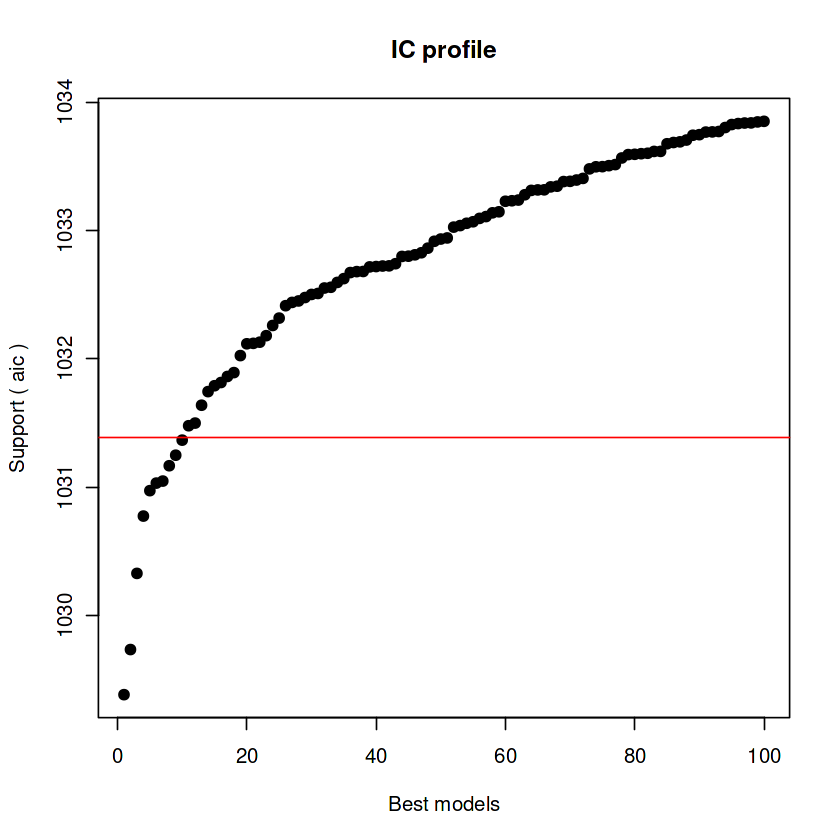


After 109400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.7332577578


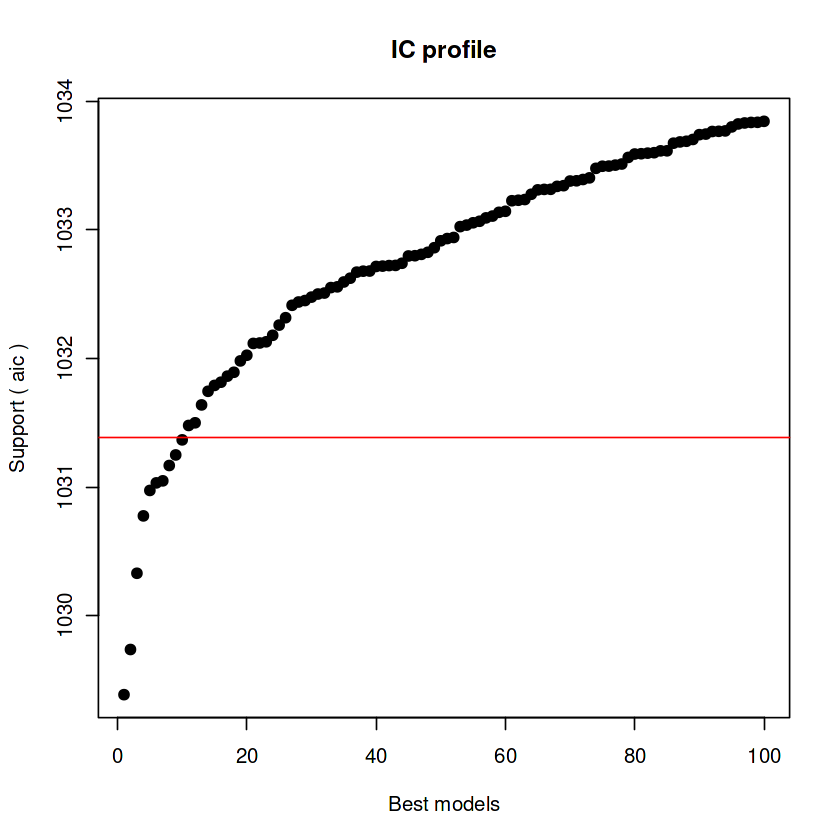


After 109450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.7332577578



After 109500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.7332577578



After 109550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.72339810725



After 109600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.72034981436


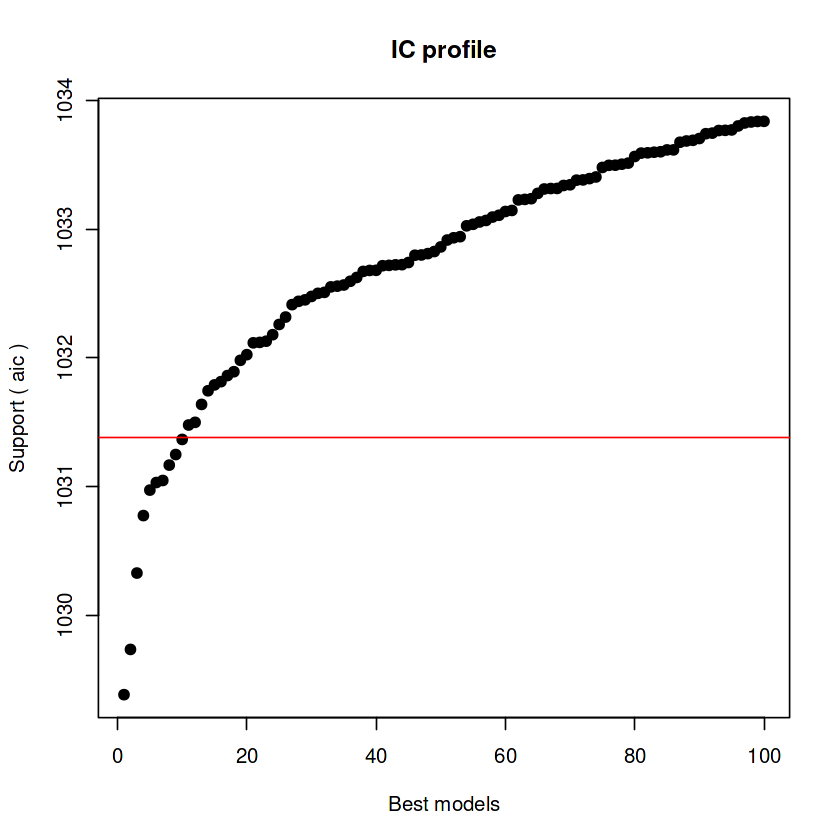


After 109650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.72034981436


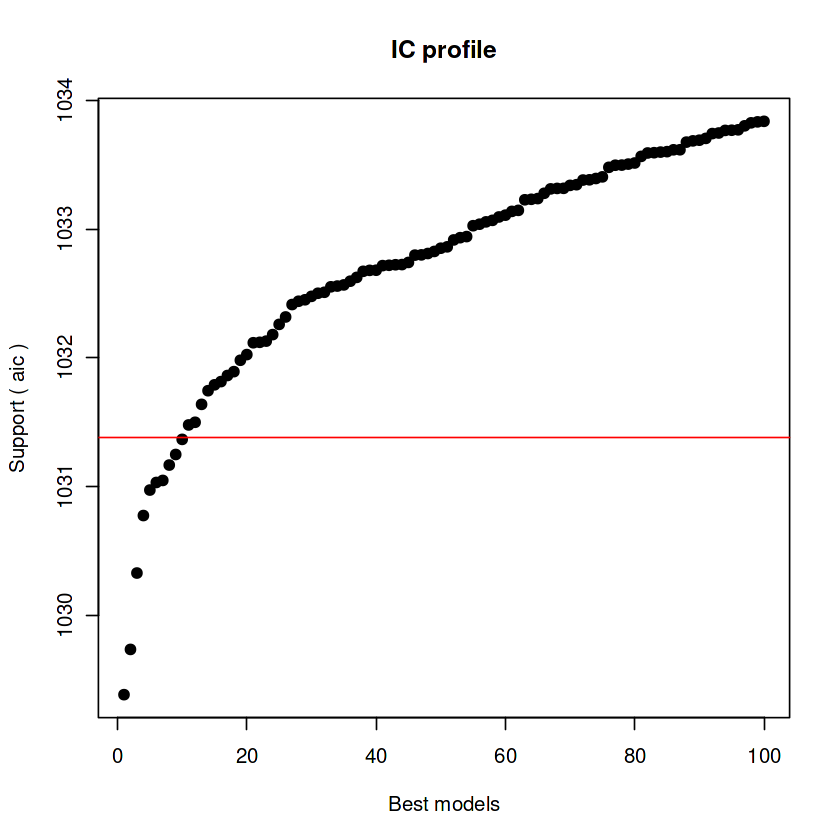


After 109700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.67992525371



After 109750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.65599261631


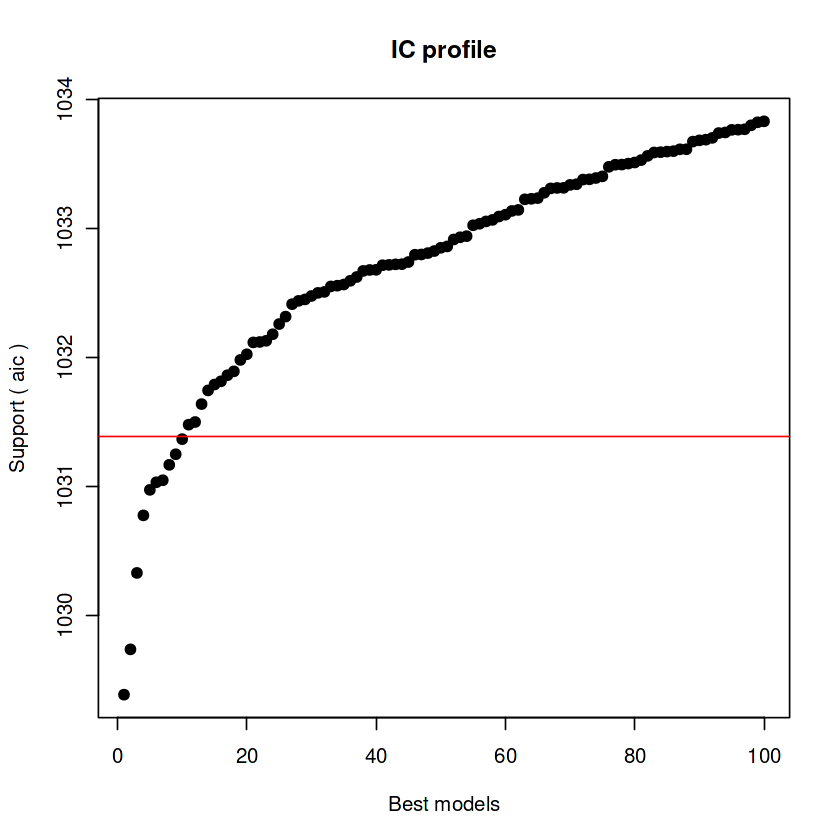


After 109800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.61167865148


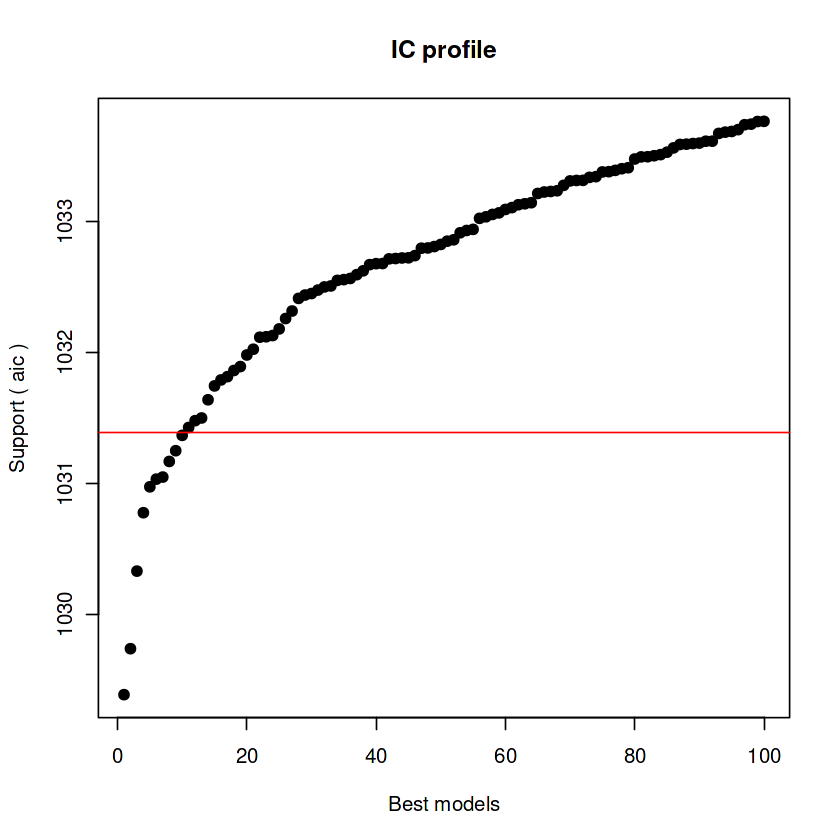


After 109850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.58055912311


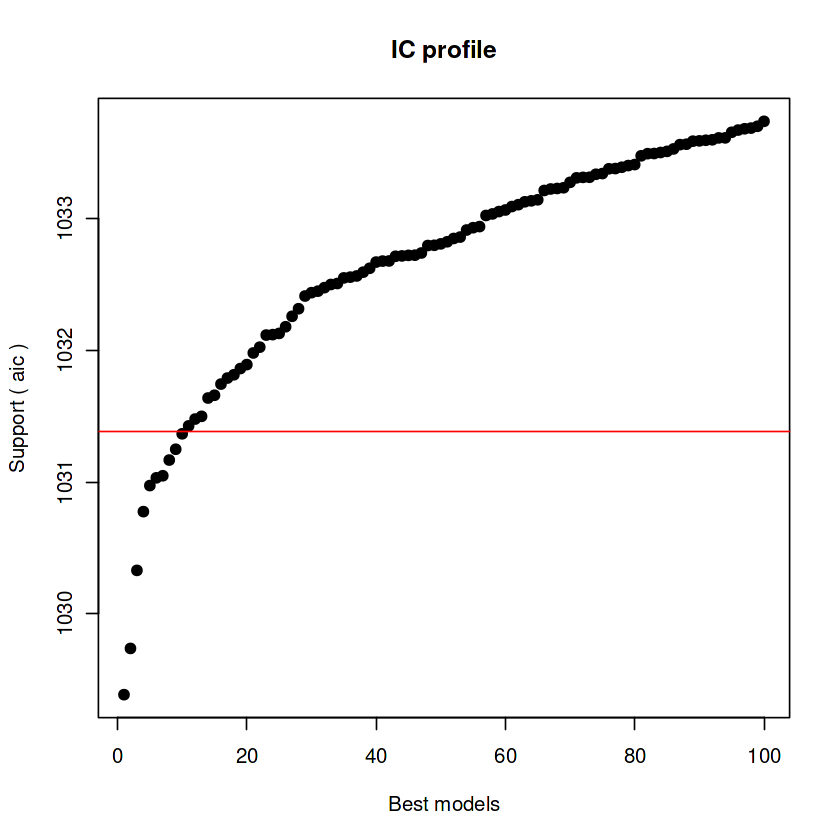


After 109900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.5329218047


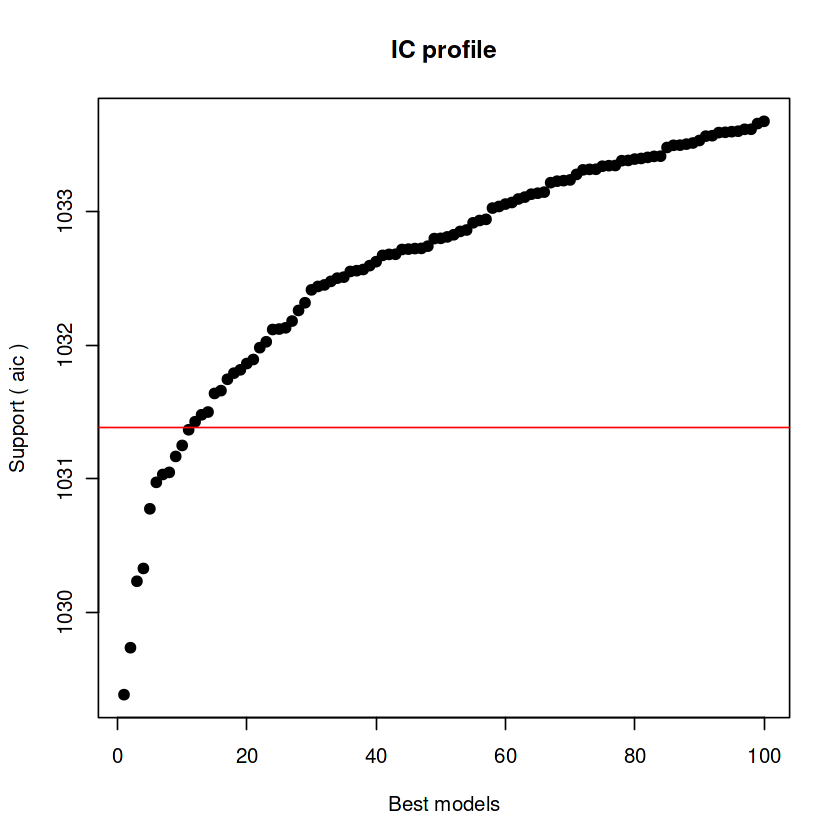


After 109950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.52286691391


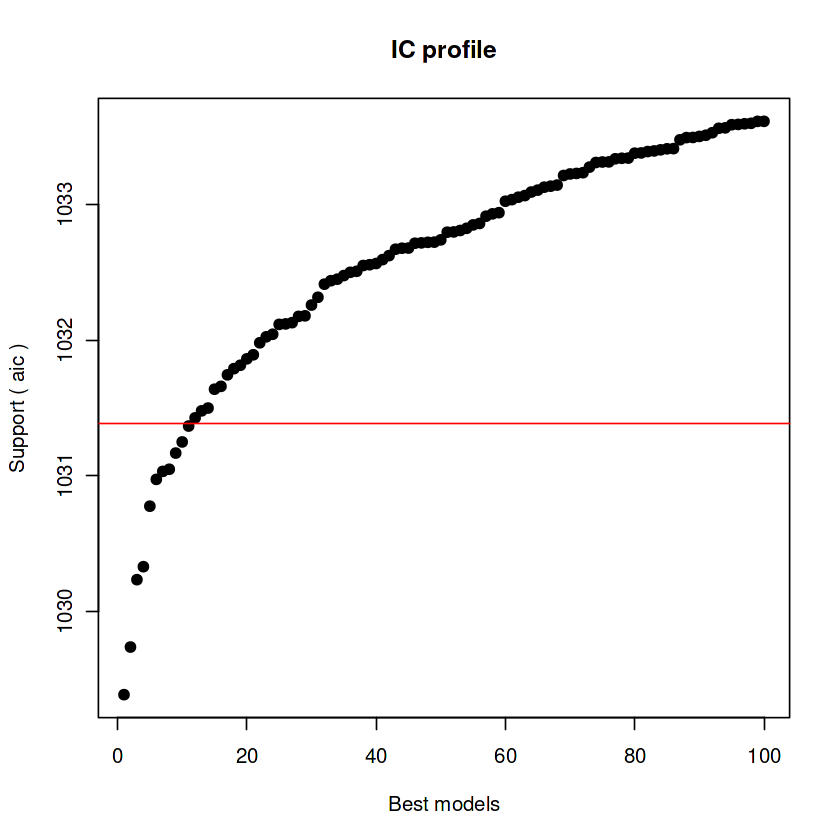


After 110000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.5160042403


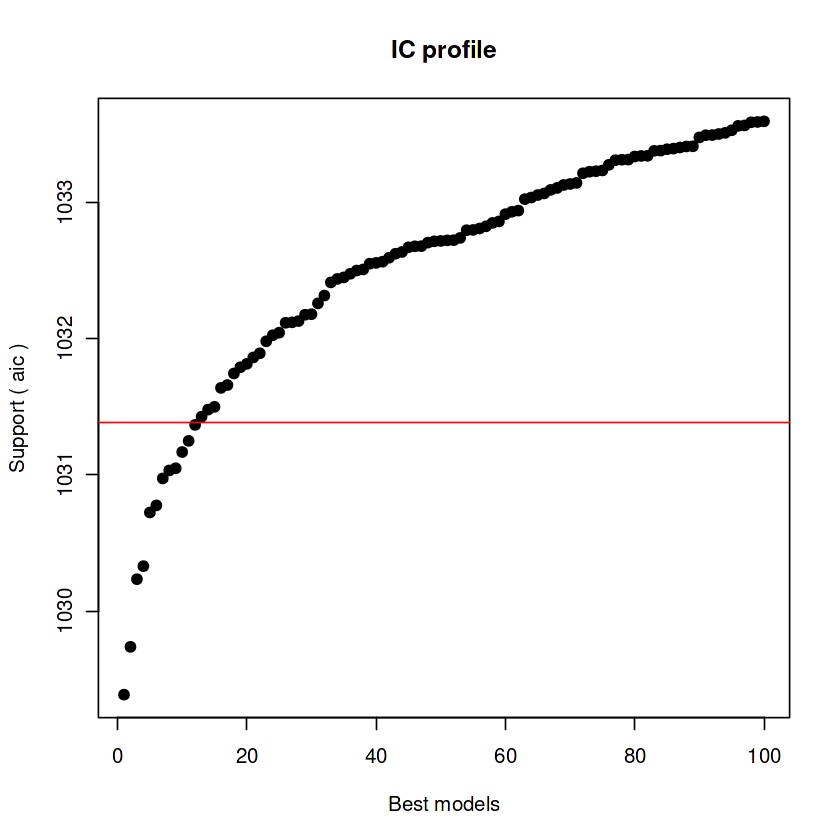


After 110050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.5160042403


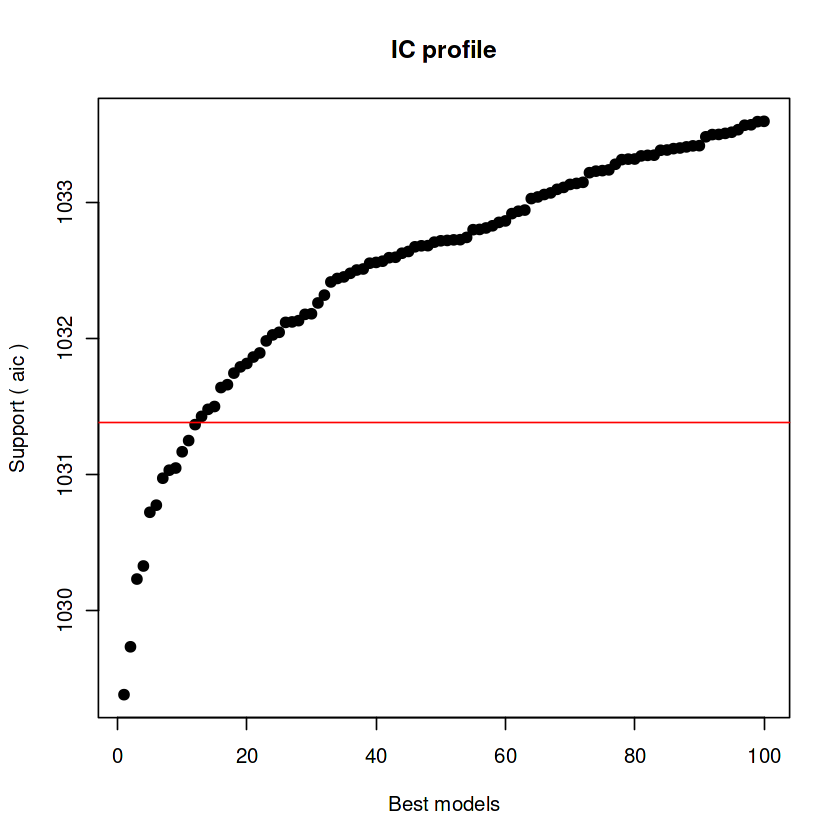


After 110100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.48282377394



After 110150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498


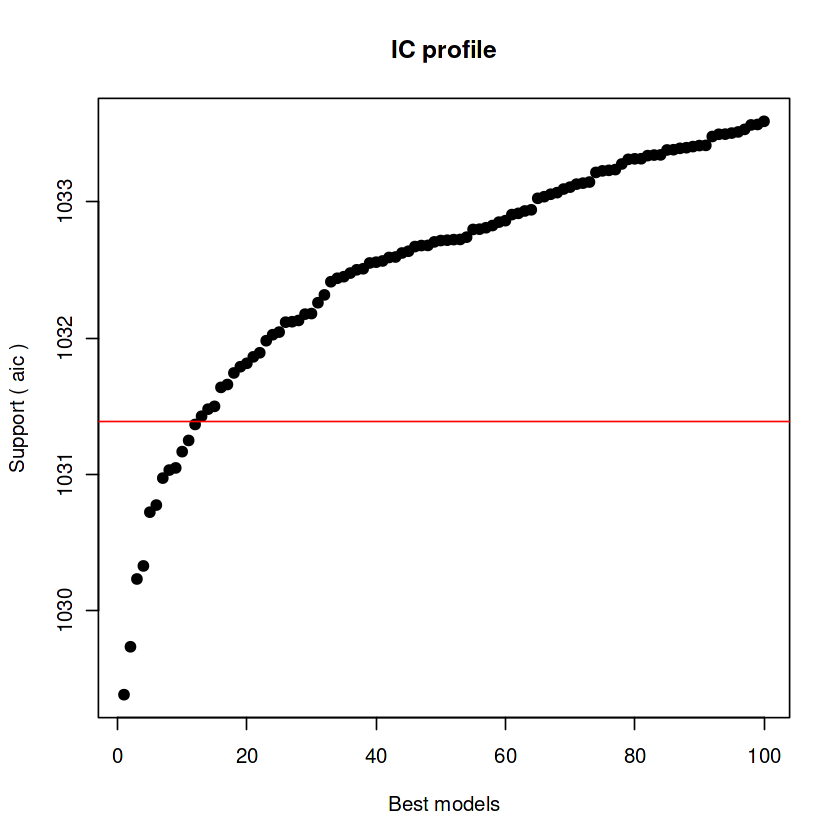


After 110200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498


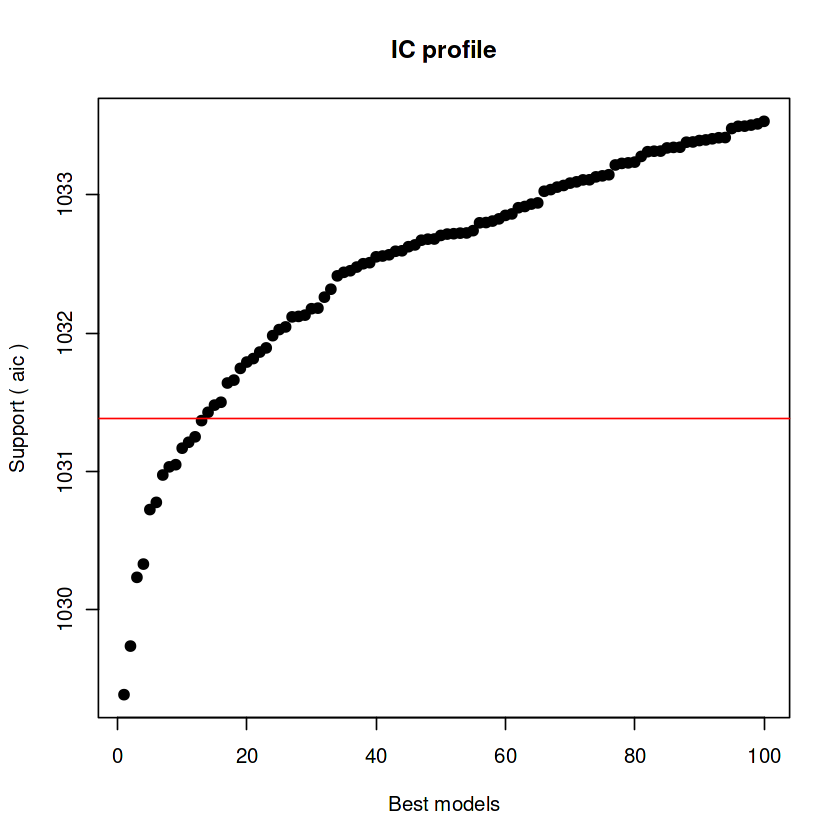


After 110250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 110950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 111950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 112950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 113950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 114000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46546440498



After 114050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478


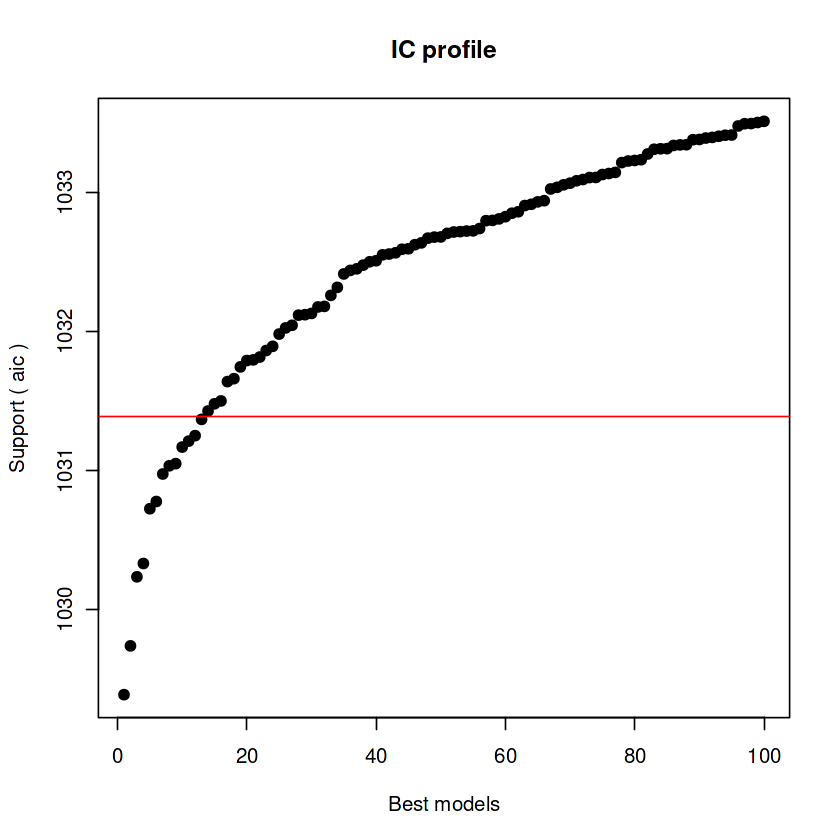


After 114150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 114950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 115950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 116950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46240619478



After 117750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46207534674



After 117800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46207534674


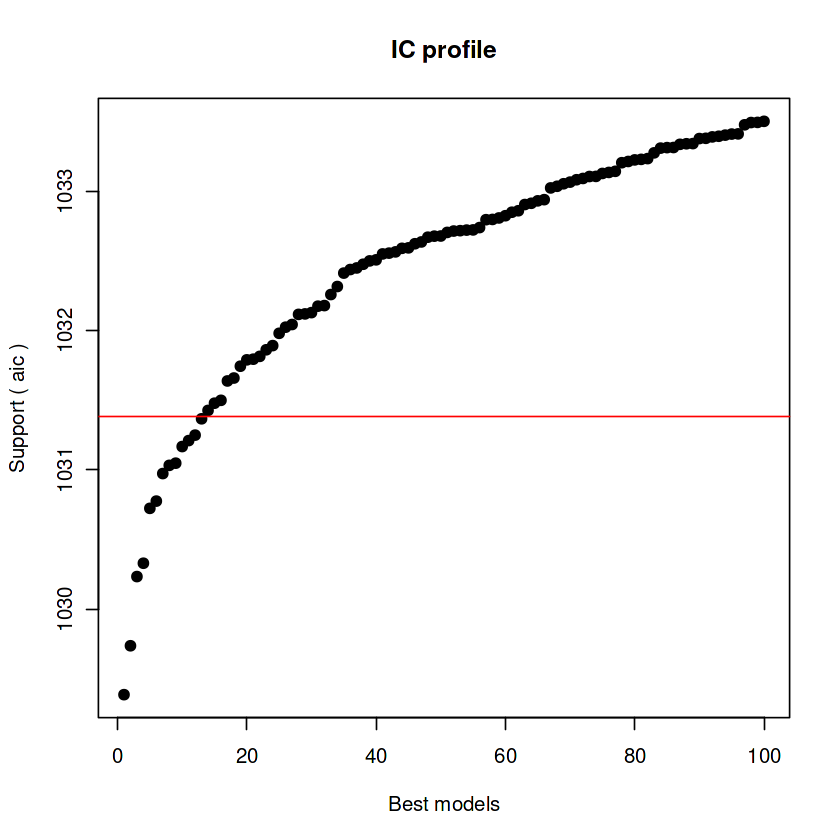


After 117850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46207534674



After 117900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46207534674



After 117950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46207534674



After 118000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46207534674



After 118050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46207534674



After 118100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.46207534674



After 118150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.45688552415



After 118200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.45688552415


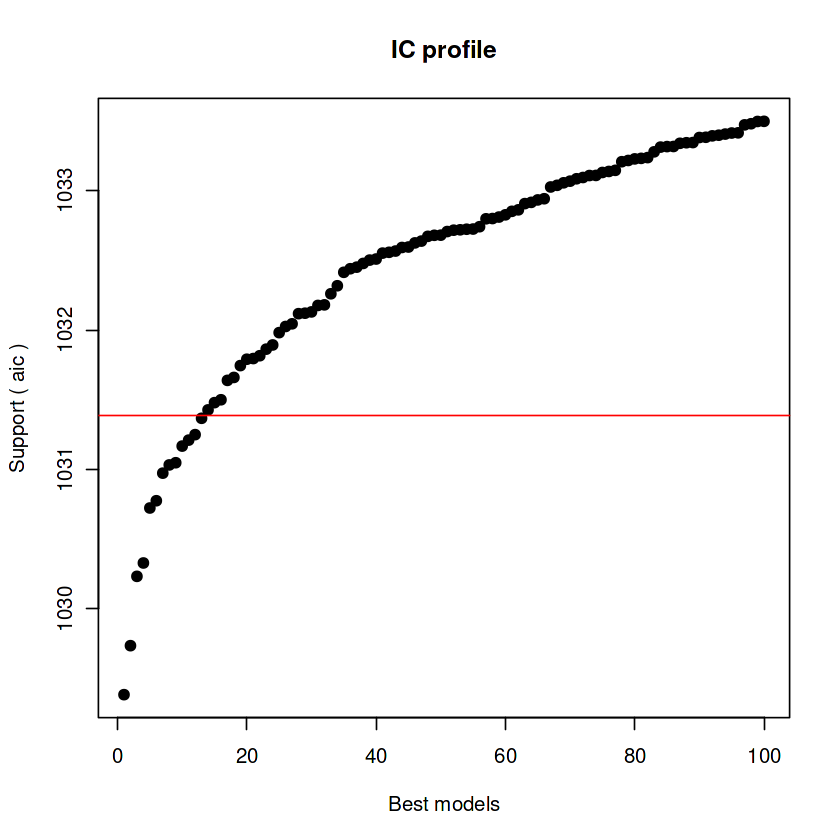


After 118250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.45502855266



After 118300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.43743233068


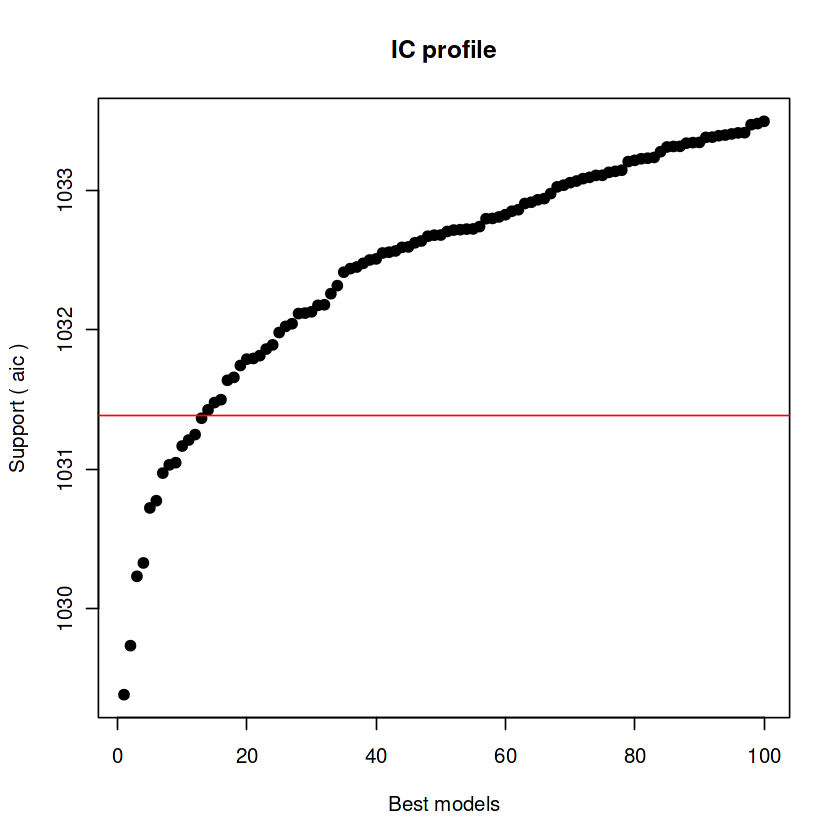


After 118350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.42491039562


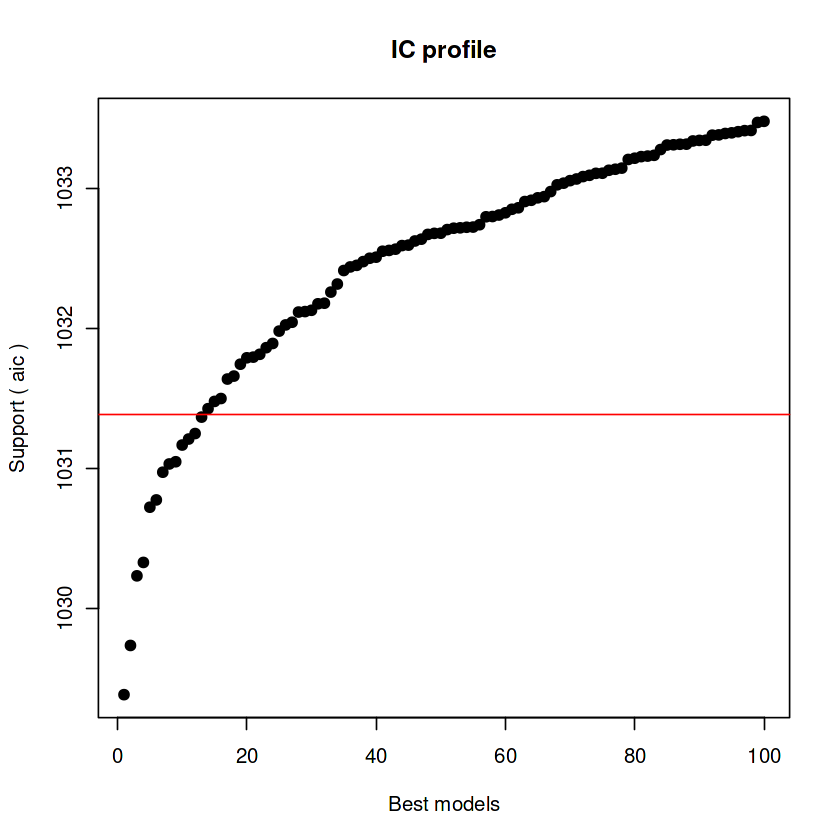


After 118400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.42491039562


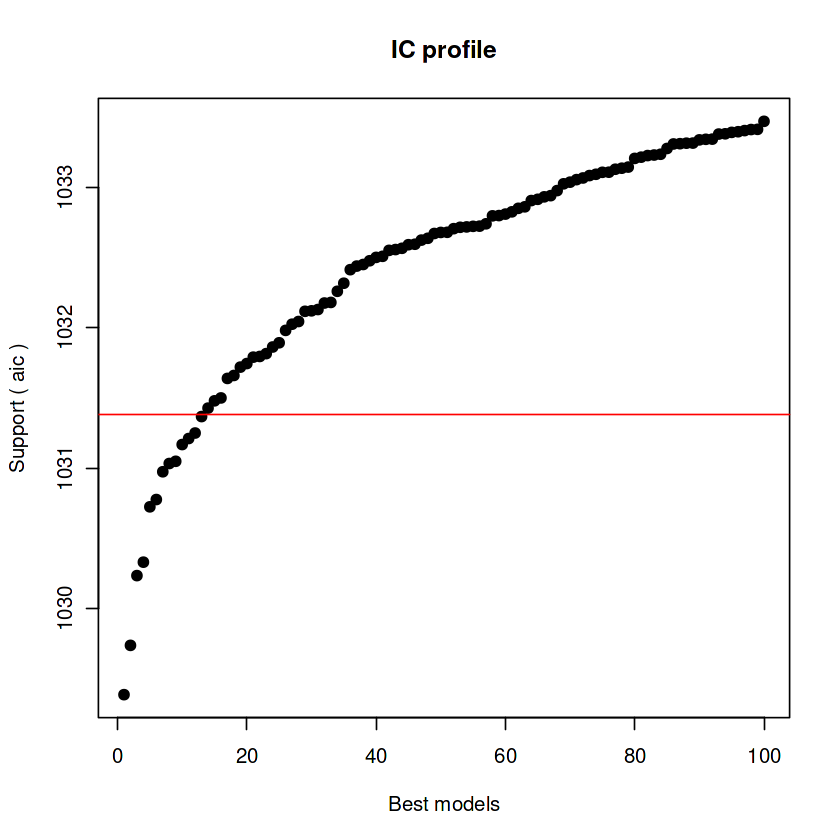


After 118450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.42491039562



After 118500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.42491039562



After 118550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 118600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486


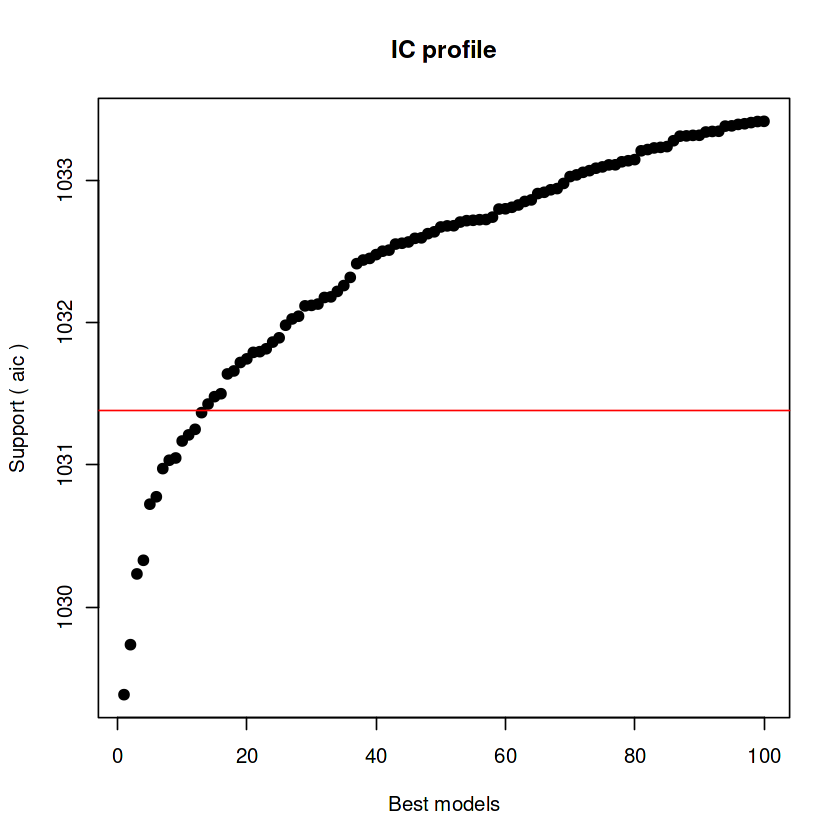


After 118650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 118700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 118750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 118800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 118850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 118900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 118950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 119950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 120950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 121950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 122000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 122050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 122100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 122150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 122200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 122250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 122300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 122350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 122400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 122450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 122500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.4195604486



After 122550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41453128319



After 122600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485


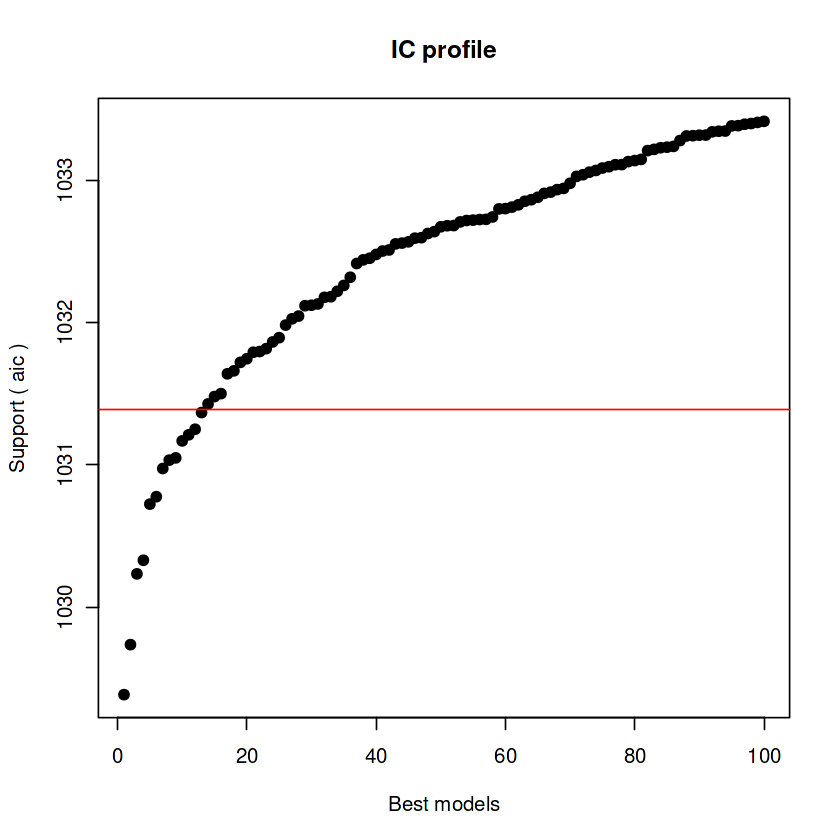


After 122650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485


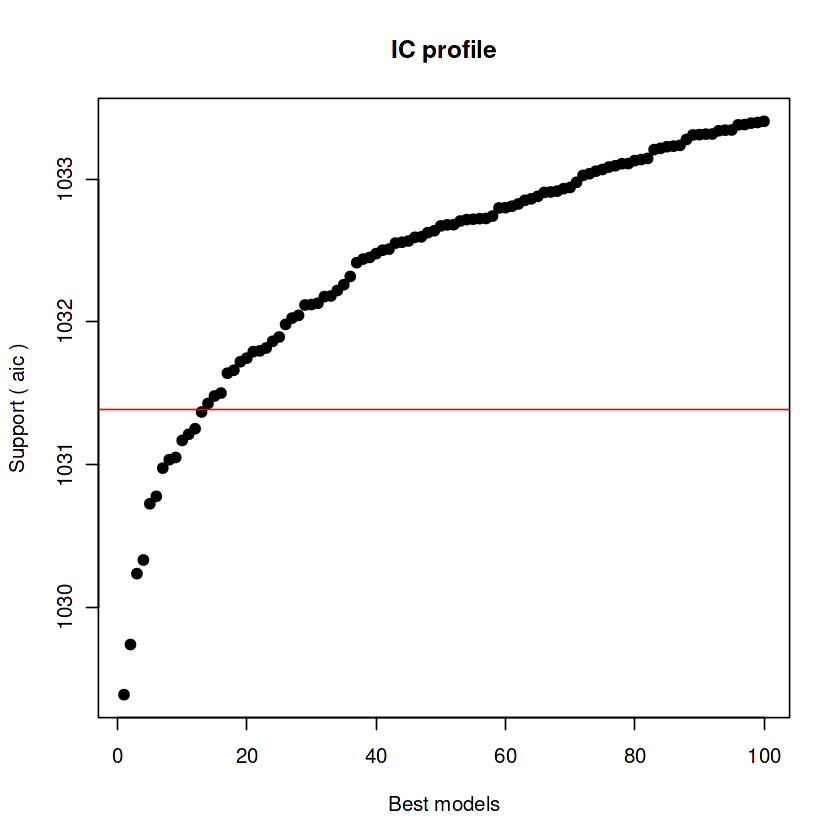


After 122700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 122750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 122800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 122850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 122900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 122950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 123950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 124950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 125950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 126000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 126050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 126100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 126150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 126200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41270897485



After 126250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41115062804



After 126300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41115062804


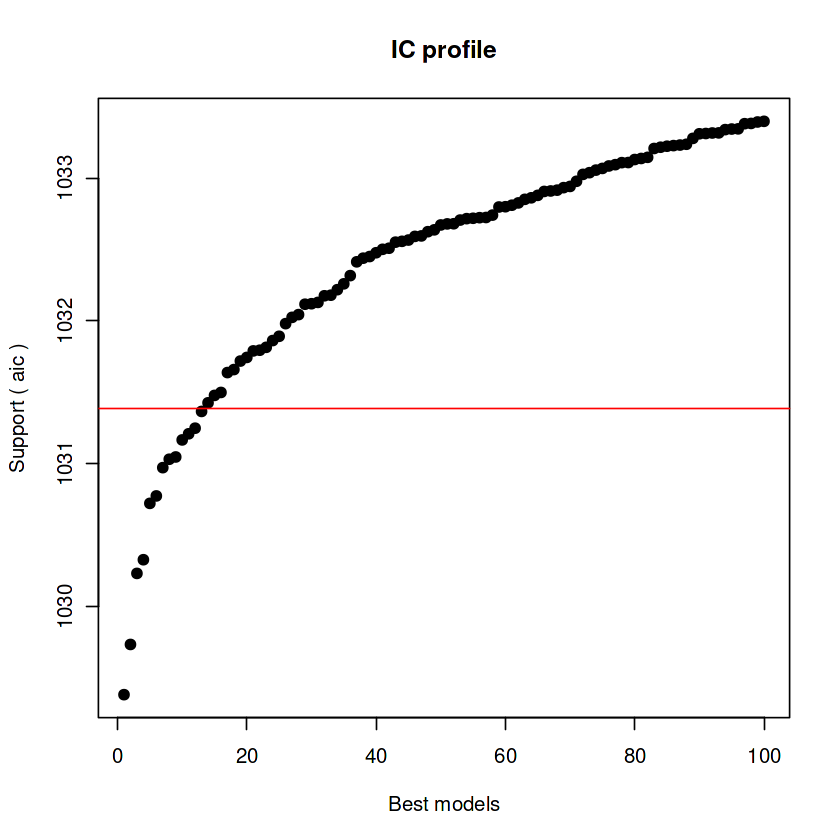


After 126350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41115062804



After 126400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41115062804



After 126450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41115062804



After 126500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41115062804



After 126550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41115062804



After 126600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41115062804



After 126650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41115062804



After 126700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.41115062804



After 126750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.39021125227



After 126800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.38311211384


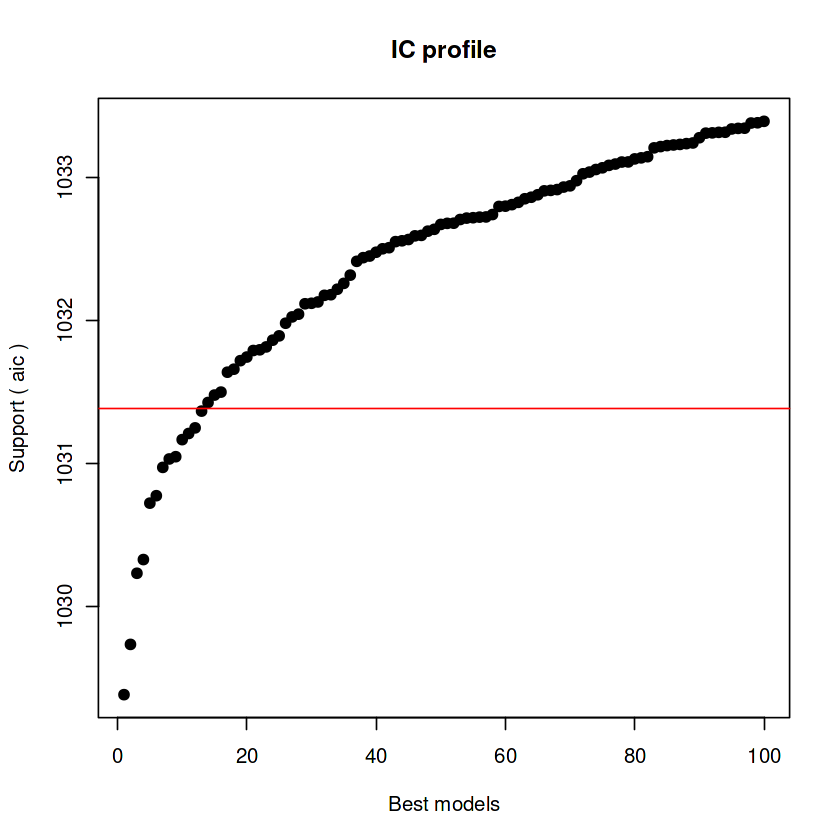


After 126850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.36694349084


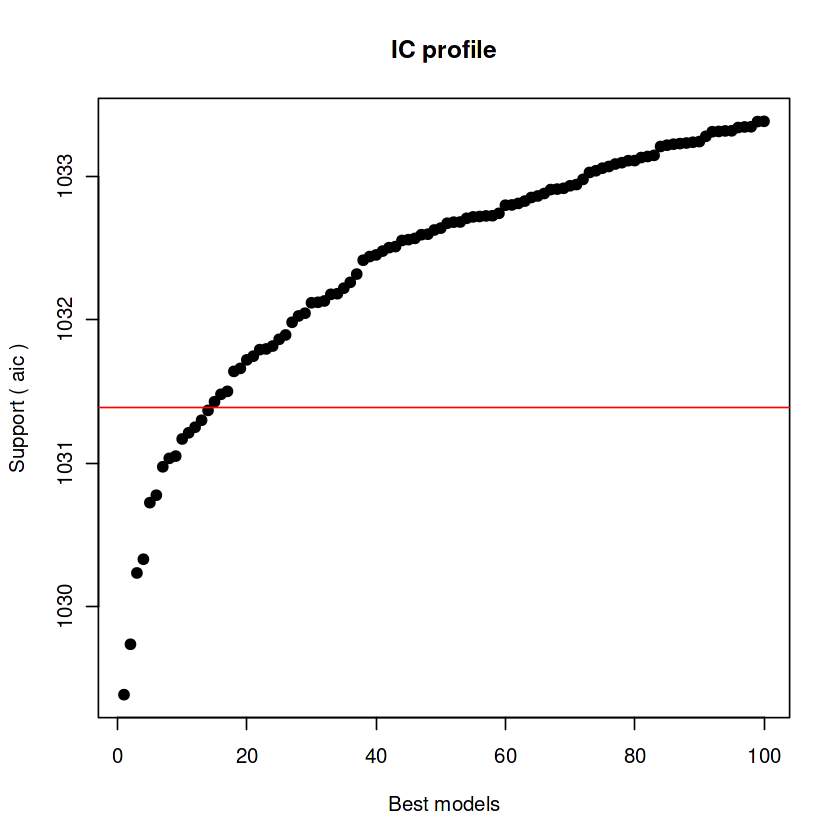


After 126900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.36694349084


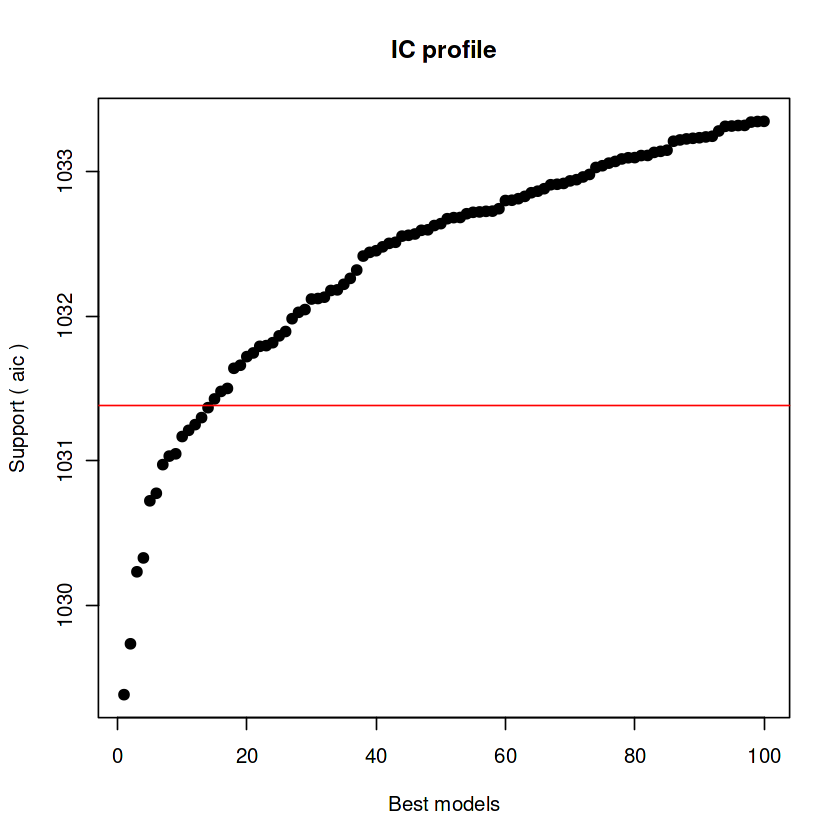


After 126950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.36694349084



After 127000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.36694349084



After 127050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35588785527



After 127100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102


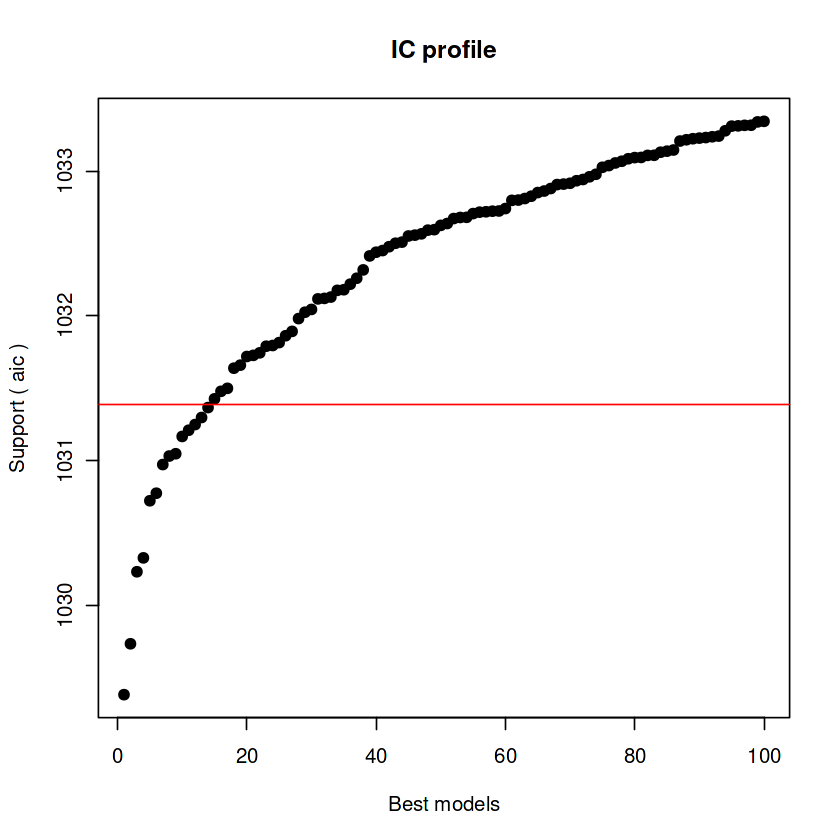


After 127150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102


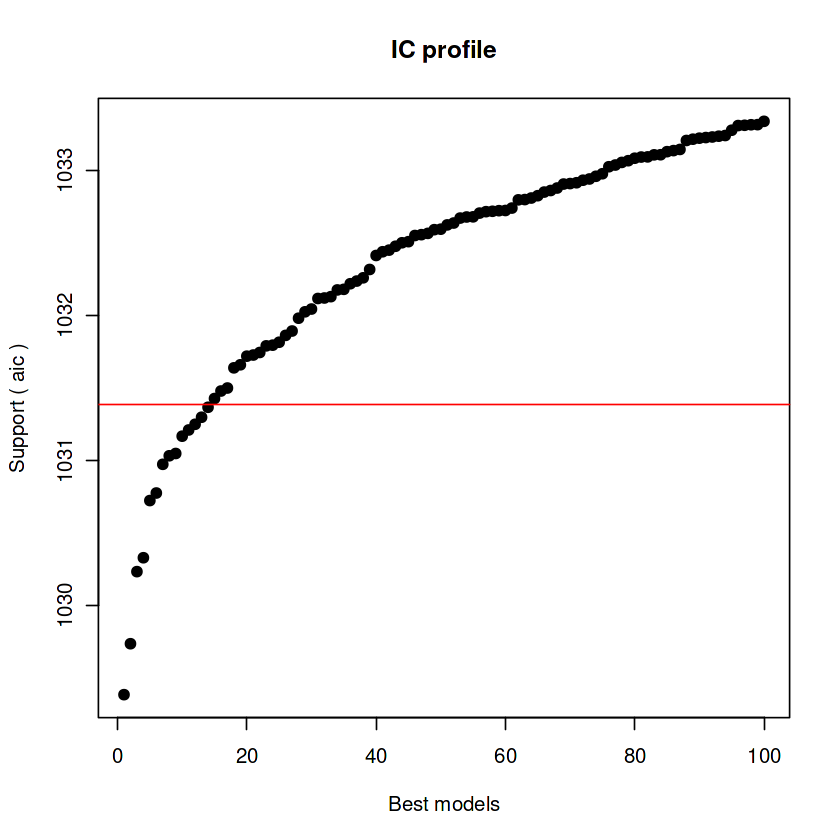


After 127200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 127950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 128950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 129950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 130950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 131950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 132950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 133950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 134950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 135000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 135050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 135100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 135150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 135200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.35013564102



After 135250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076


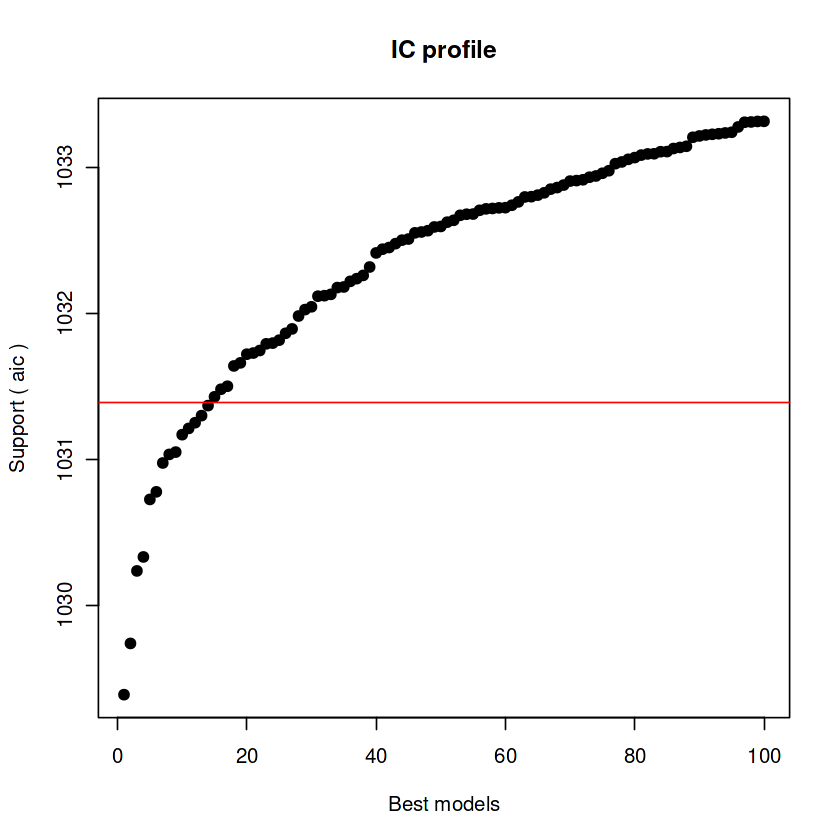


After 135350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 135950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 136950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 137950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 138950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 139950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 140950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 141950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 142950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 143950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 144950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 145950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 146950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 147950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 148950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 149950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 150950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 151950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 152950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 153950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 154950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 155950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 156950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 157950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 158950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 159950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34595605076



After 160650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34182494762



After 160700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.34182494762


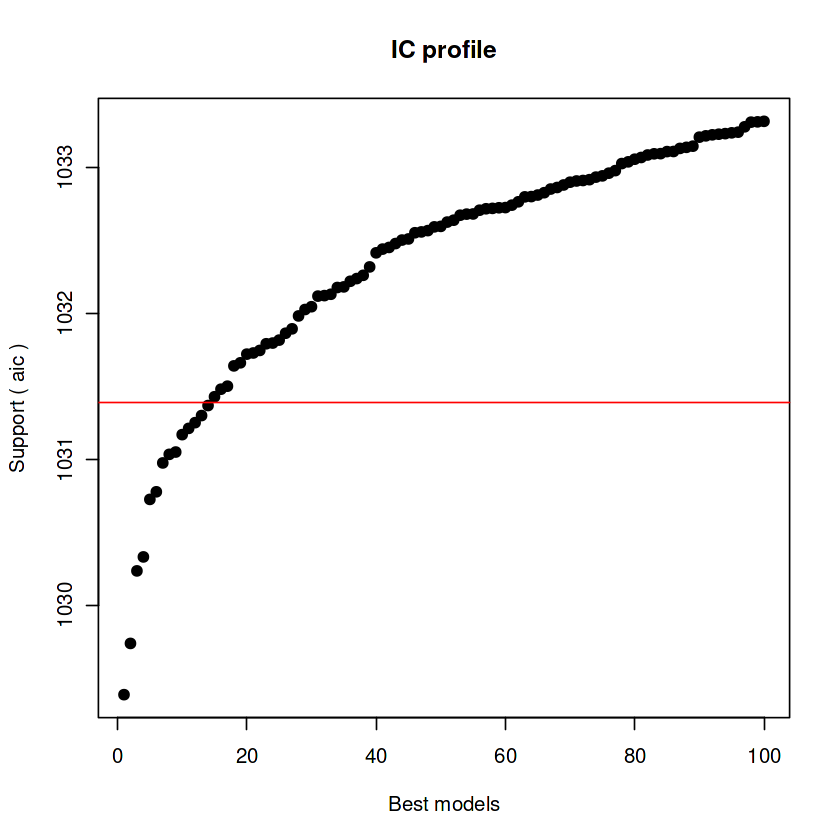


After 160750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 160800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693


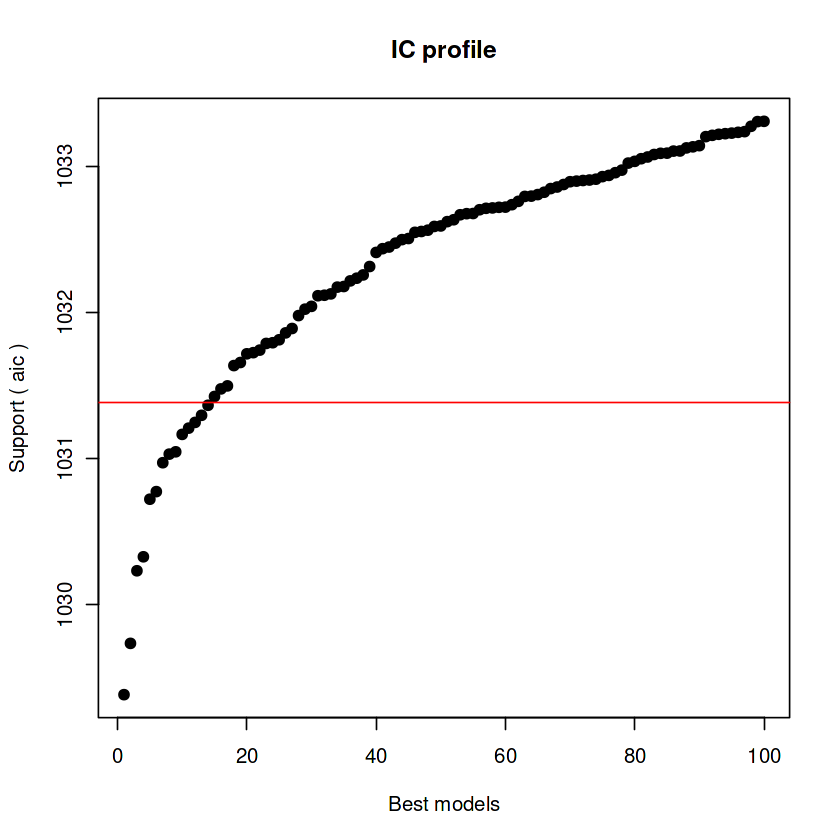


After 160850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 160900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 160950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 161950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 162950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 163950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 164950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 165950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 166950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 167950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 168950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 169950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 170950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 171950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 172950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 173950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 174950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 175950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 176950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 177950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 178950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 179950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 180950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 181950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 182950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 183950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 184950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 185950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 186950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 187950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 188950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 189950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 190950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 191950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 192950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 193950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 194950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 195950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 196950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 197950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 198950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 199950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 2e+05 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 200950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 201950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 202950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 203950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 204950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 205950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 206950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 207950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 208950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 209950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 210950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 211950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 212950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 213950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 214950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 215950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 216950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 217950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 218950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 219950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 220950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 221950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 222950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 223950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 224000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 224050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 224100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 224150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 224200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33703000693



After 224250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33234458082



After 224300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834


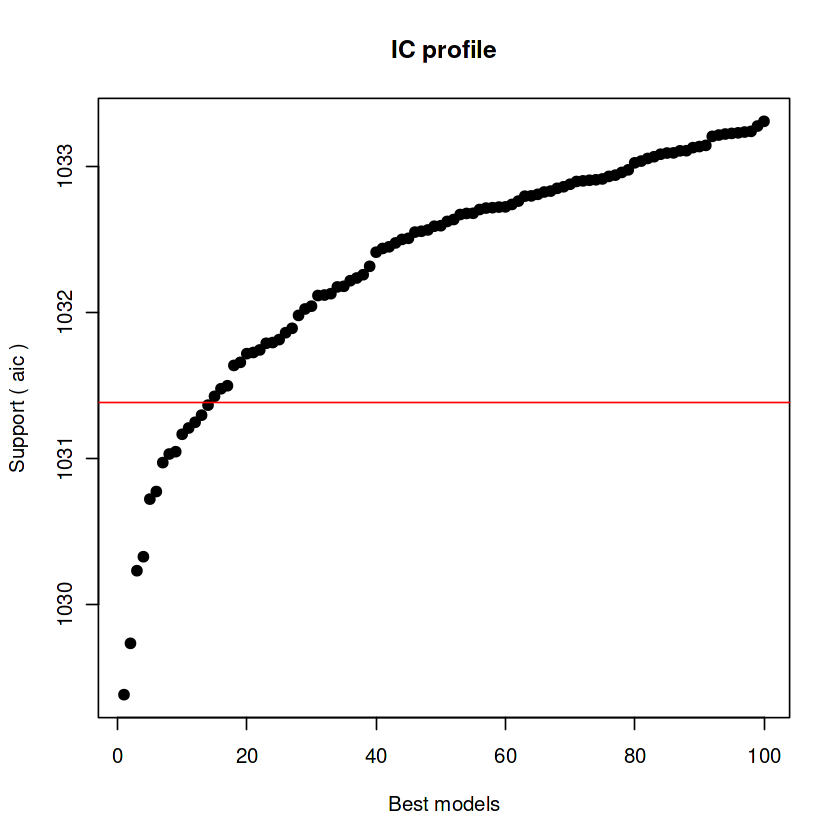


After 224350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834


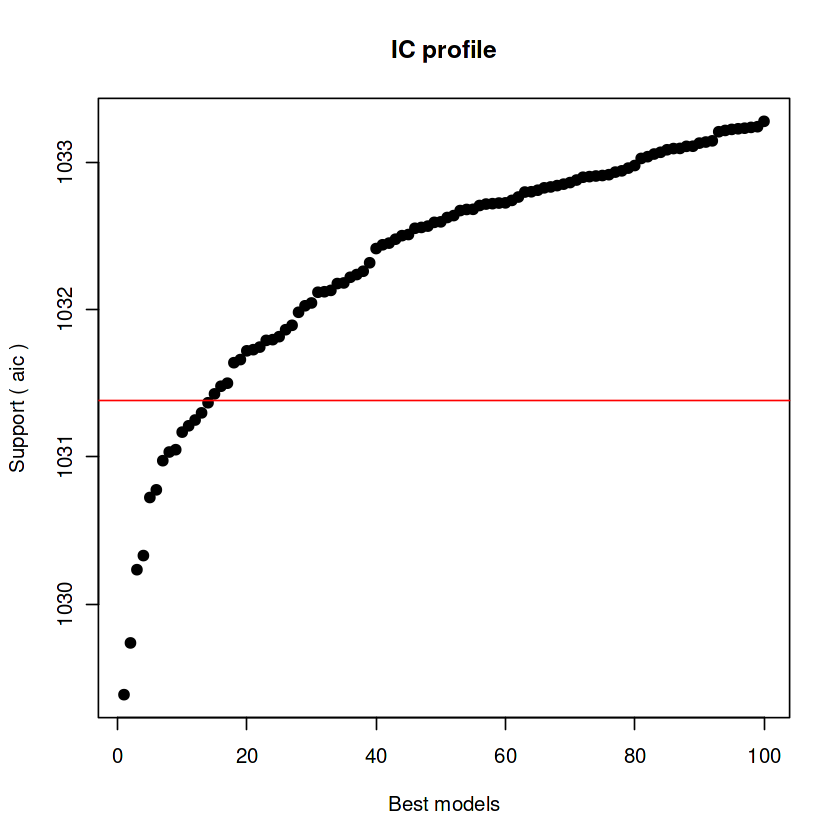


After 224400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 224450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 224500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 224550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 224600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 224650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 224700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 224750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 224800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 224850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 224900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 224950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 225950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 226950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 227950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 228000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 228050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 228100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 228150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 228200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 228250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 228300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 228350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 228400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.33062002834



After 228450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.30923376653



After 228500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.30551888992


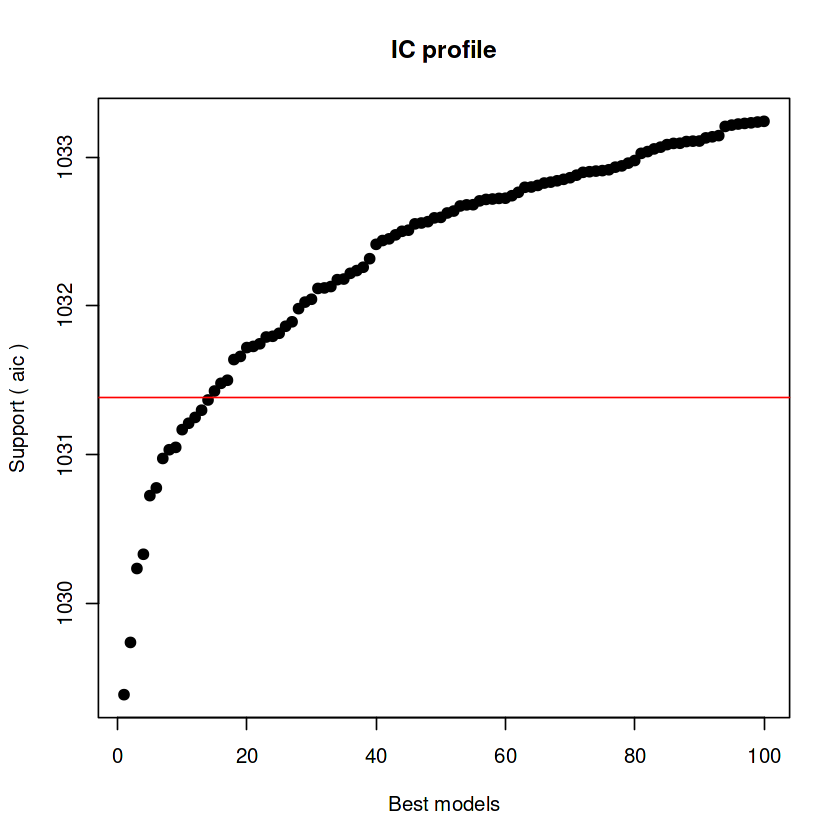


After 228550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.28988631355


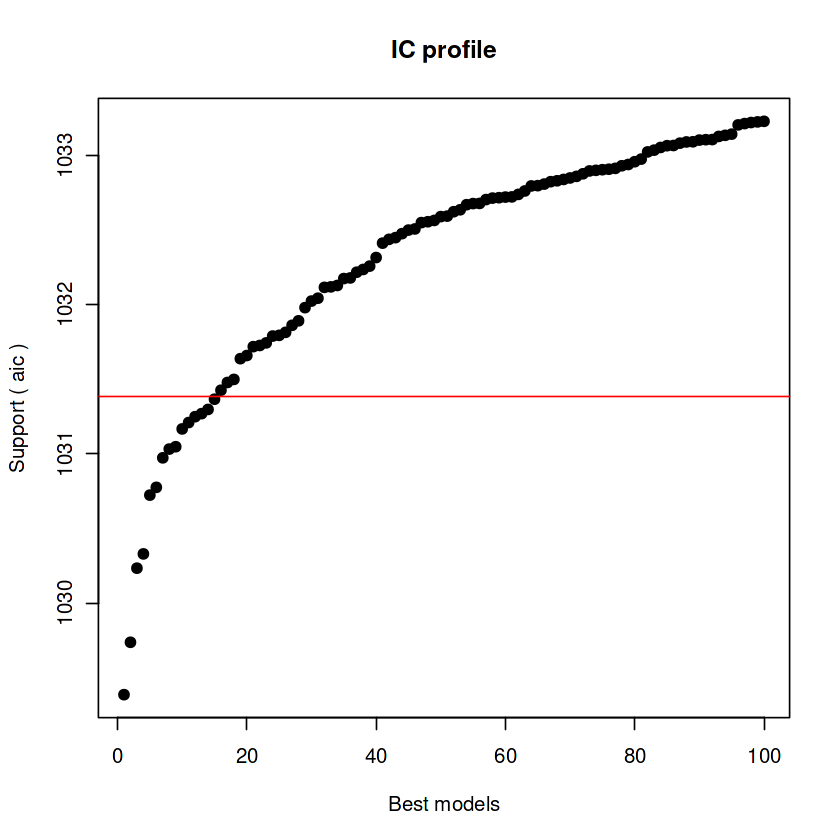


After 228600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.28988631355


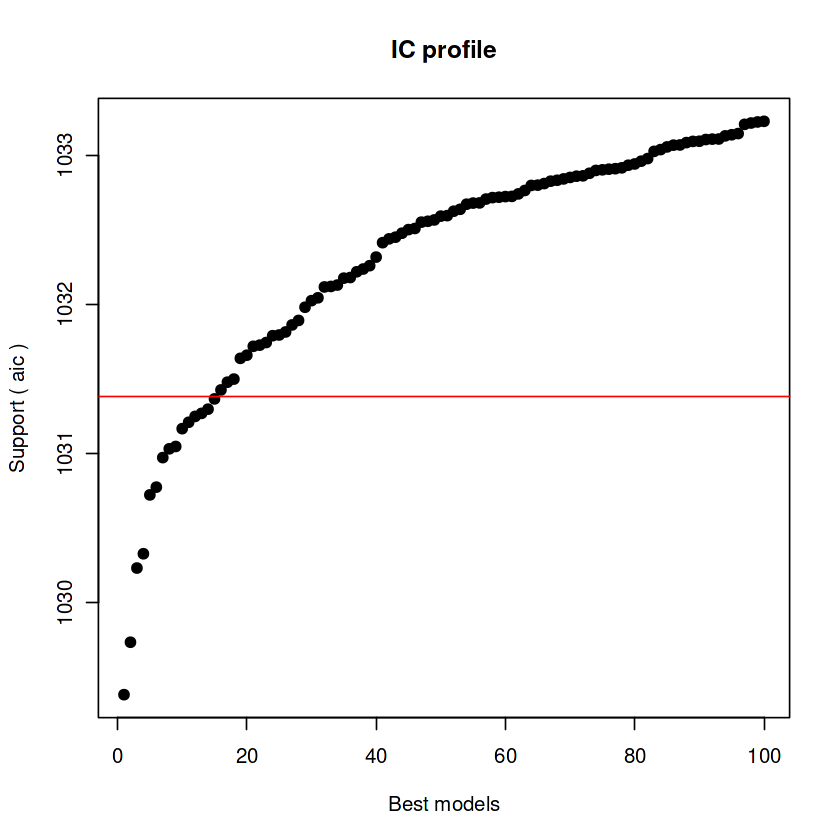


After 228650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.28988631355



After 228700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.28988631355



After 228750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27982933854



After 228800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796


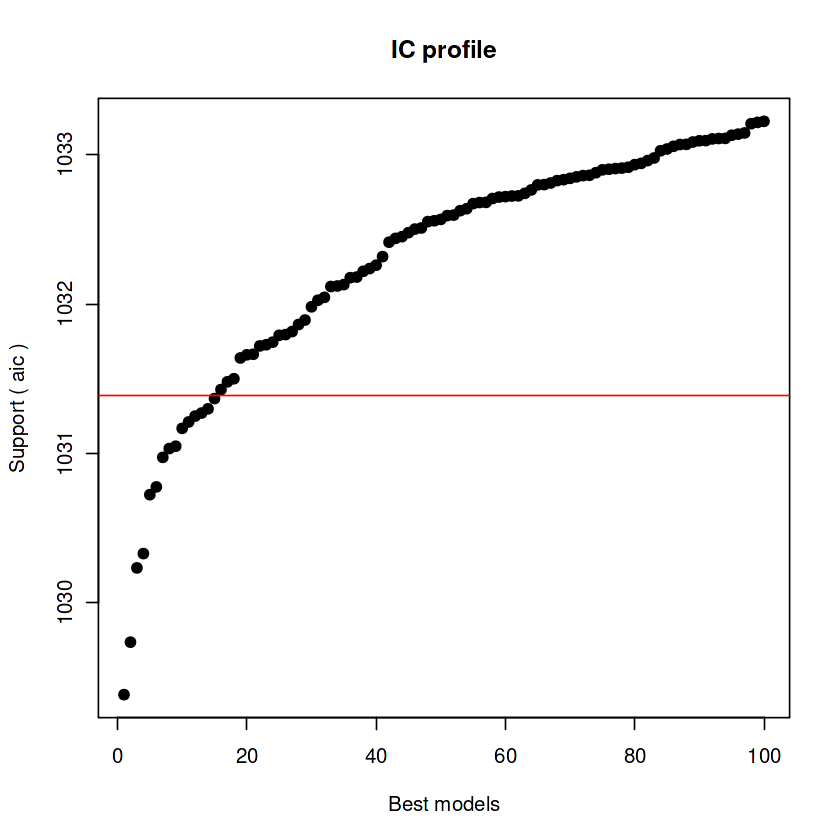


After 228850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796


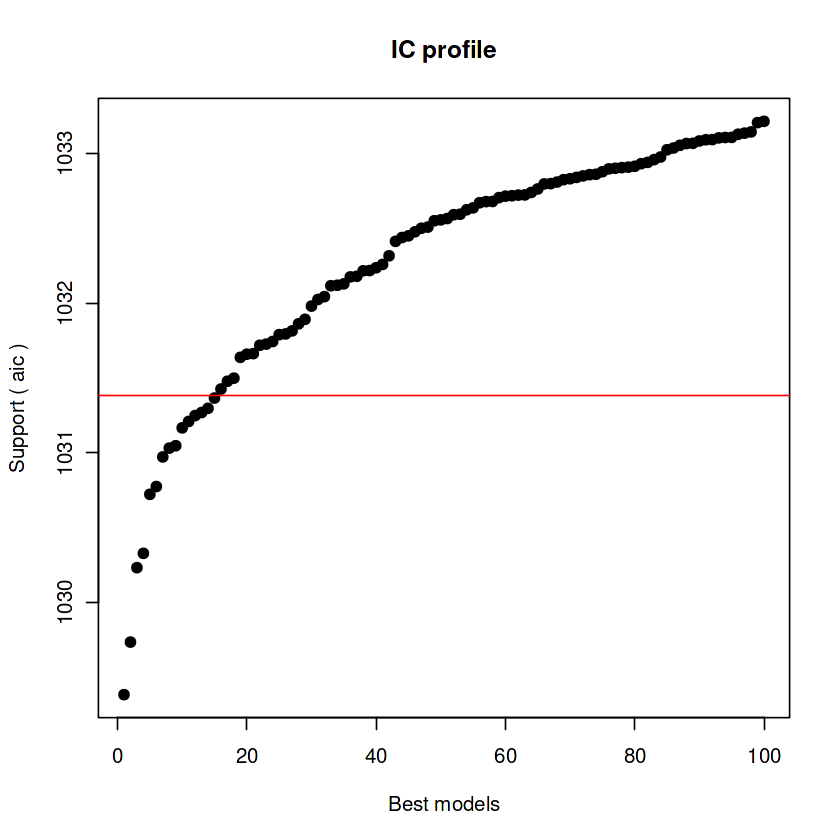


After 228900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 228950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 229950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 230950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 231950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 232950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 233950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 234950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 235950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27471274796



After 236950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712


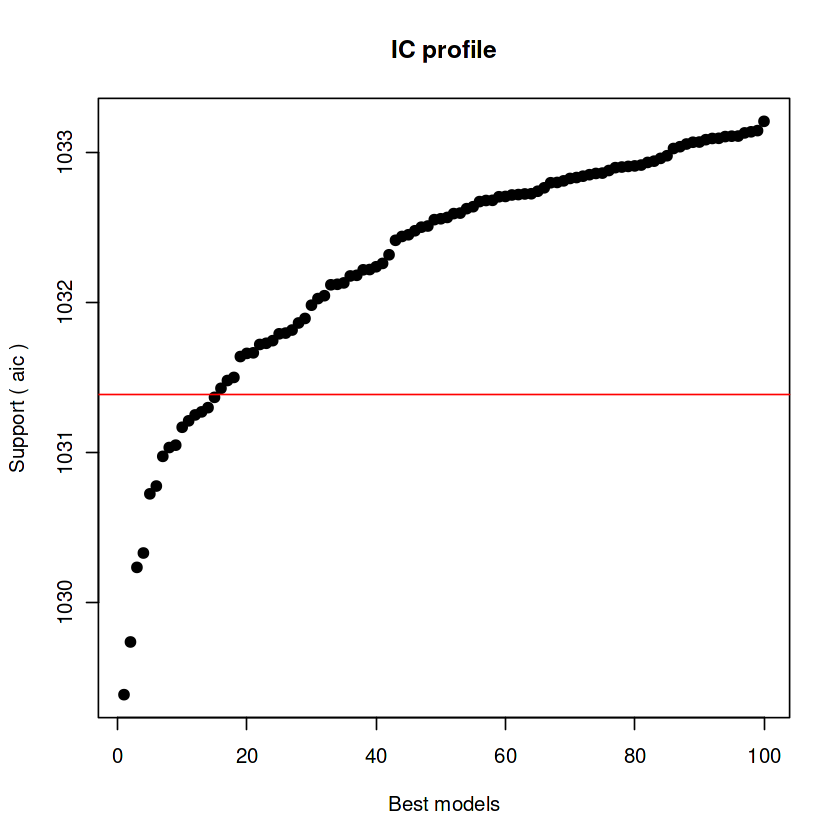


After 237050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 237950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 238950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 239950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 240950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 241950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 242950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 243950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 244950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 245000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 245050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 245100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 245150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 245200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 245250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 245300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 245350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.27217315712



After 245400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.26211562348



After 245450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.26211562348


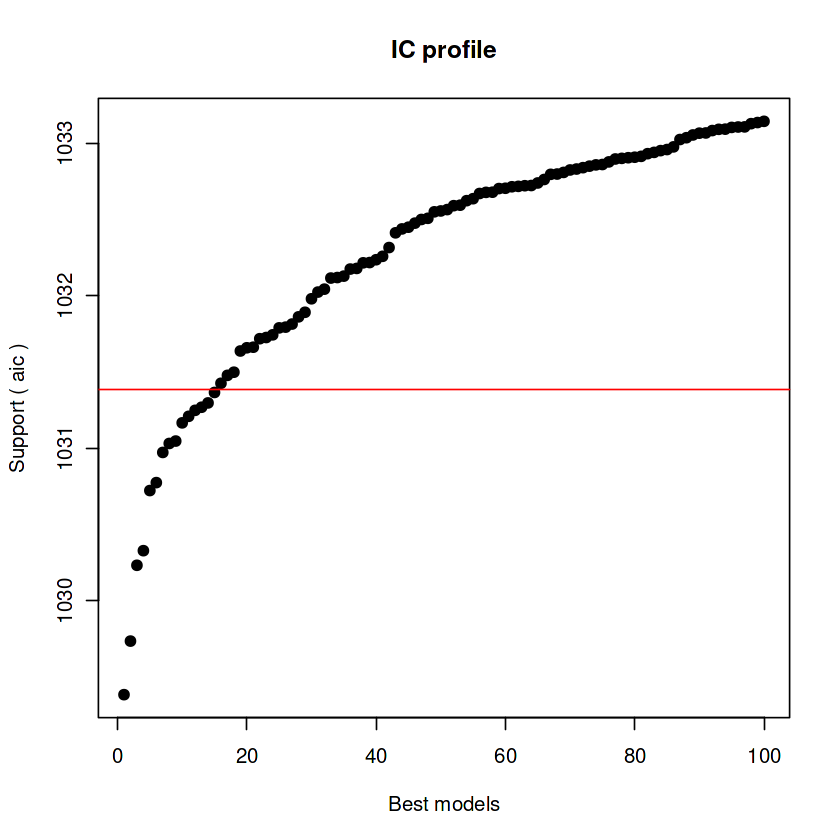


After 245500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25737887729



After 245550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25737887729


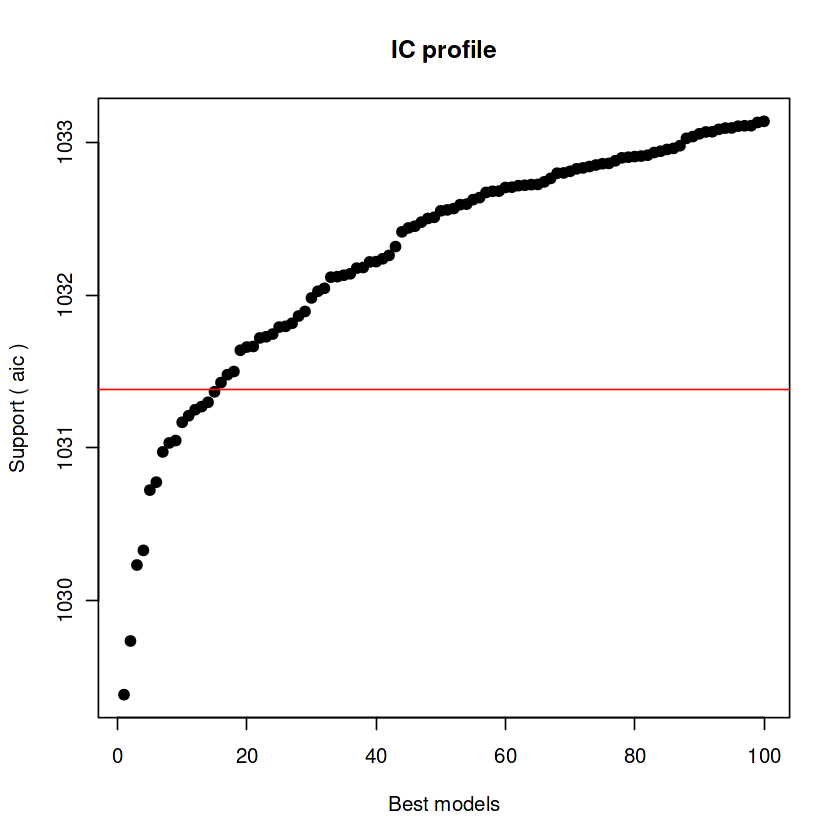


After 245600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25737887729



After 245650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25737887729



After 245700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 245750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022


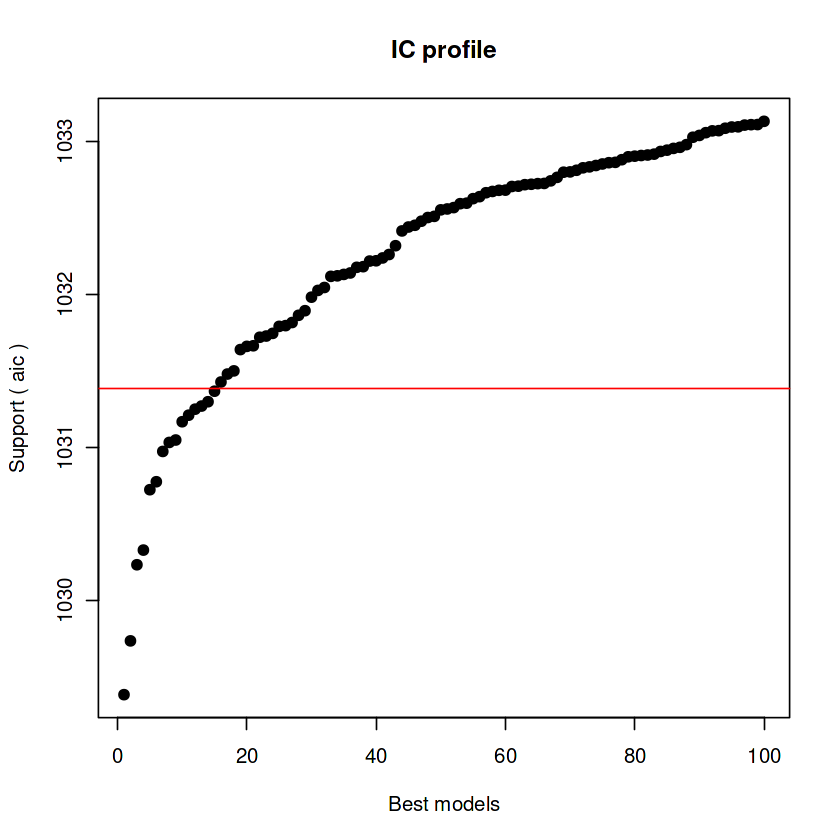


After 245800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 245850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 245900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 245950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 246950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 247950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 248950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 249950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 250950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 251950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 252950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 253950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 254950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 255950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 256950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 257950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 258950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 259950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 260950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 261950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 262950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 263950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 264950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 265950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 266950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 267950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 268950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 269950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 270950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 271950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 272950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 273950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 274950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 275950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 276950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 277950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 278950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 279950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 280950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 281950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 282950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 283950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 284950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 285950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 286950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 287950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 288950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 289950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 290950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 291950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 292950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 293950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 294950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 295950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 296950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 297950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 298950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 299950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 3e+05 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 300950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 301950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 302950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 303950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 304950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 305950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 306950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 307950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 308950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 309950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 310950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 311950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 312950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 313950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 314950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 315950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 316950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 317950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 318950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 319950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 320950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 321950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 322950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 323950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 324950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 325950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 326950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 327950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 328950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 329950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 330950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 331950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 332950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 333950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 334950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 335950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 336950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 337950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 338950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 339950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 340950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 341000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 341050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 341100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 341150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 341200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 341250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 341300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 341350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 341400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25727261022



After 341450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25626577413



After 341500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25626577413


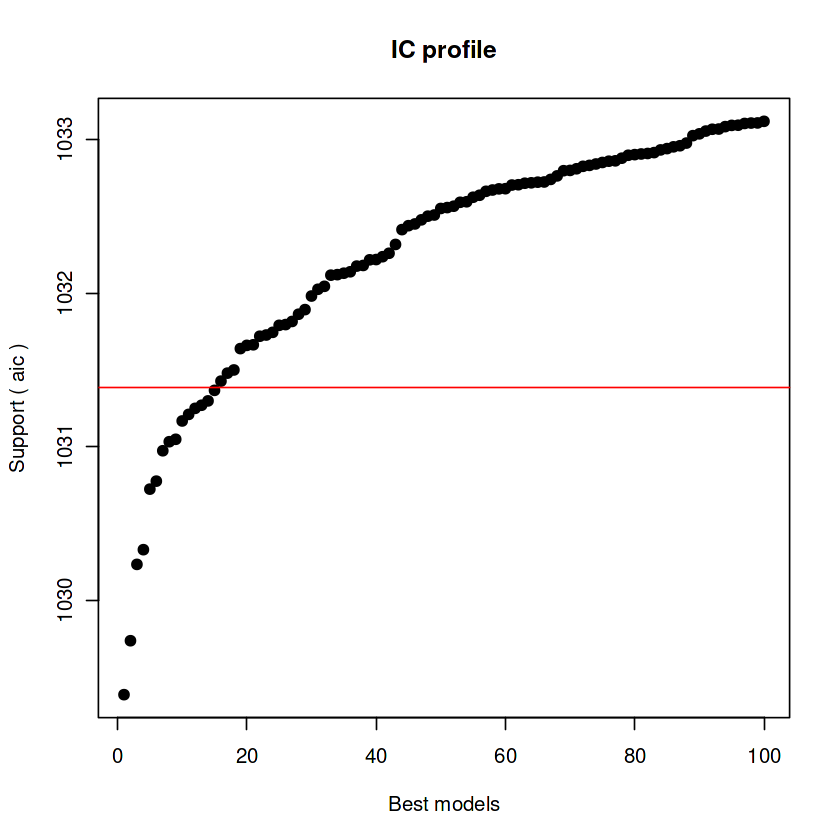


After 341550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.25626577413



After 341600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.21926322168



After 341650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.21926322168


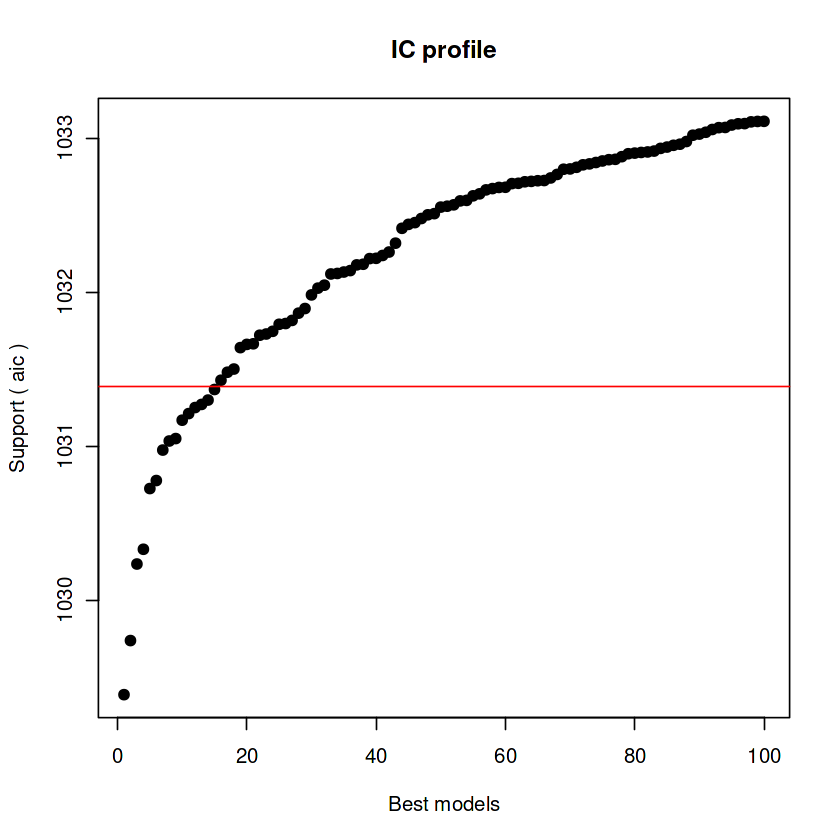


After 341700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.21469543185



After 341750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.21429506134


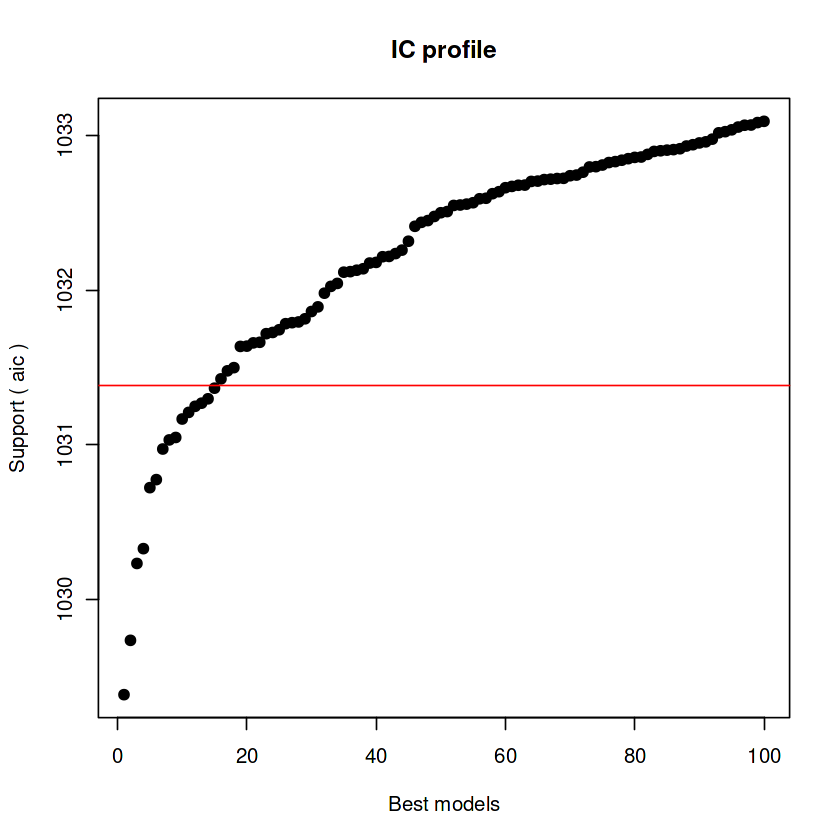


After 341800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.21429506134


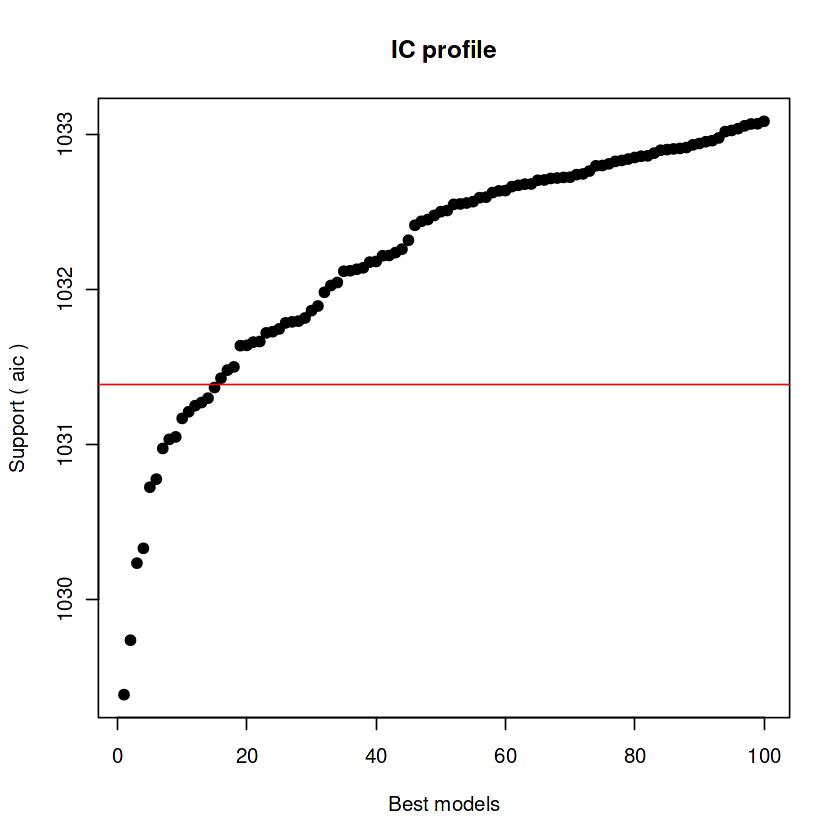


After 341850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.17874119378



After 341900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.17874119378


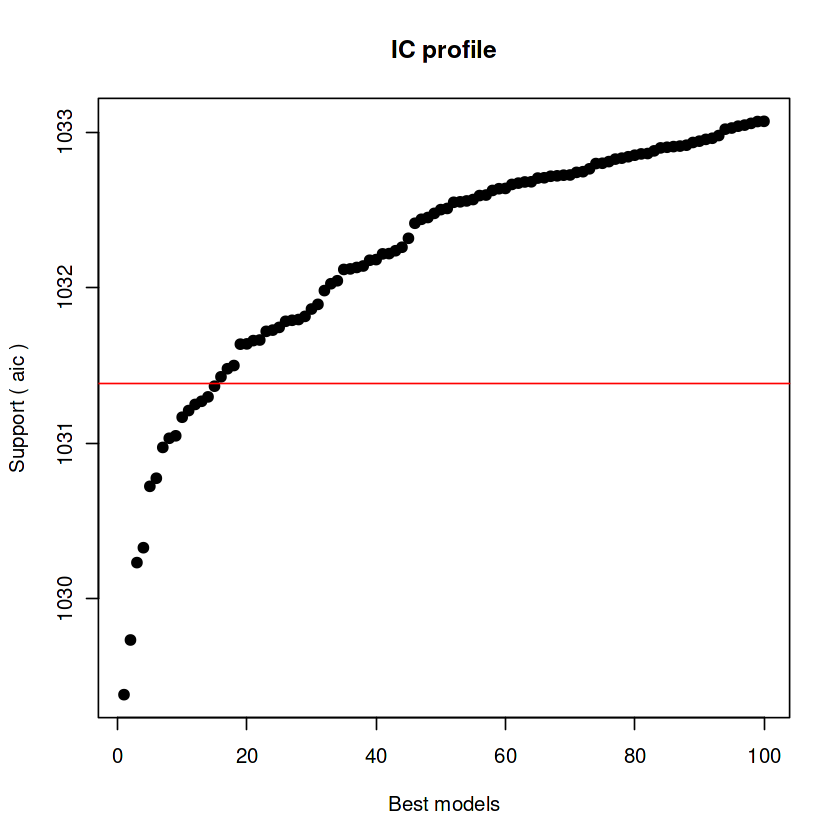


After 341950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.17874119378



After 342000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.1282048298



After 342050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.12654800236


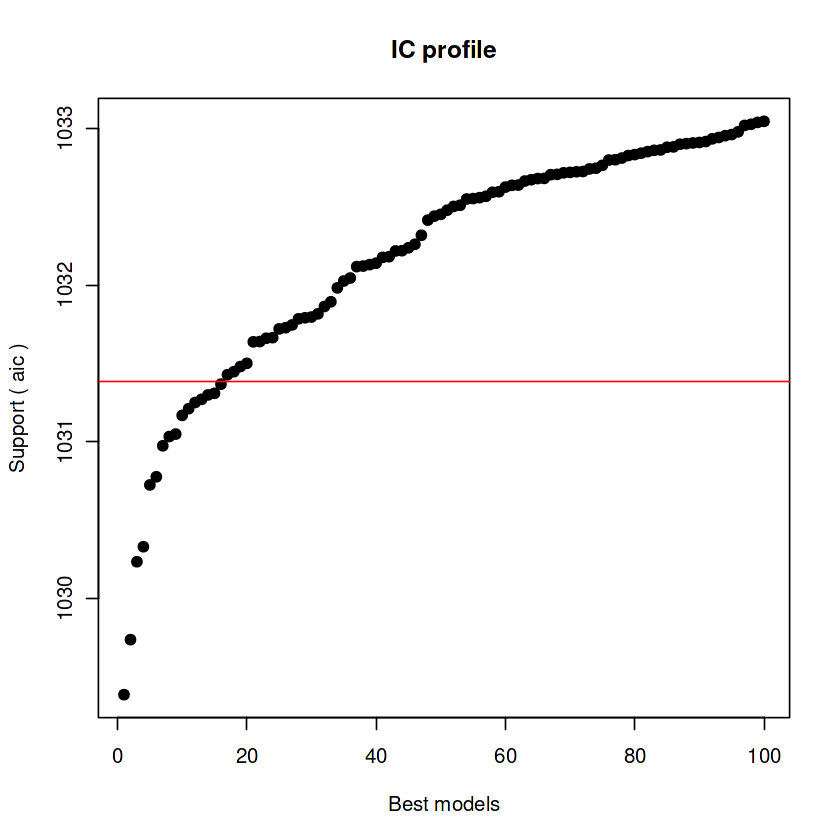


After 342100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.09209910043


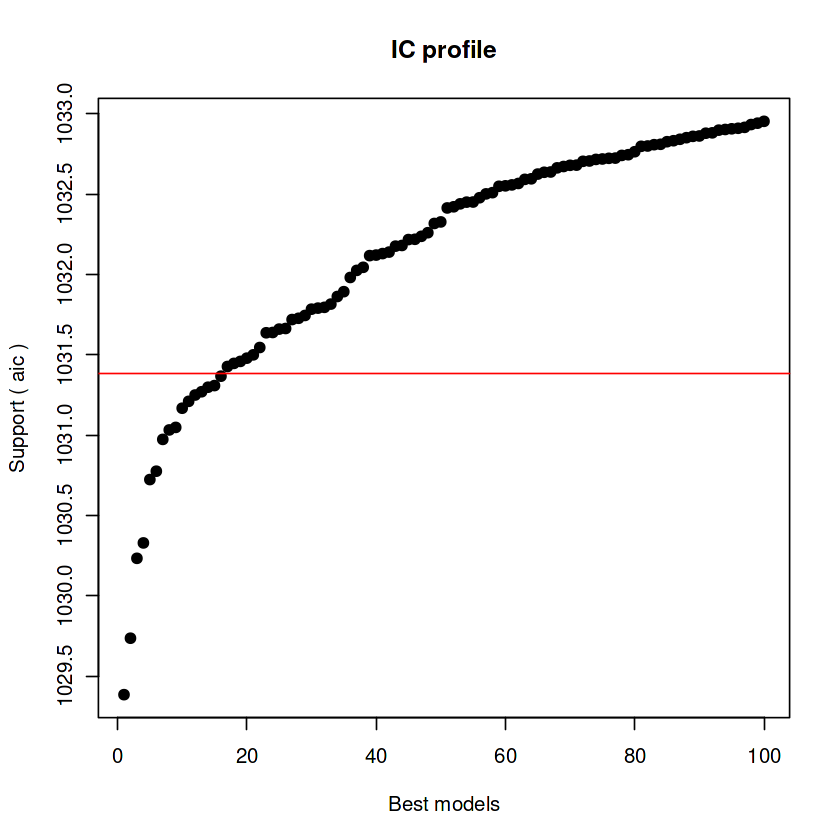


After 342150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.01499528604


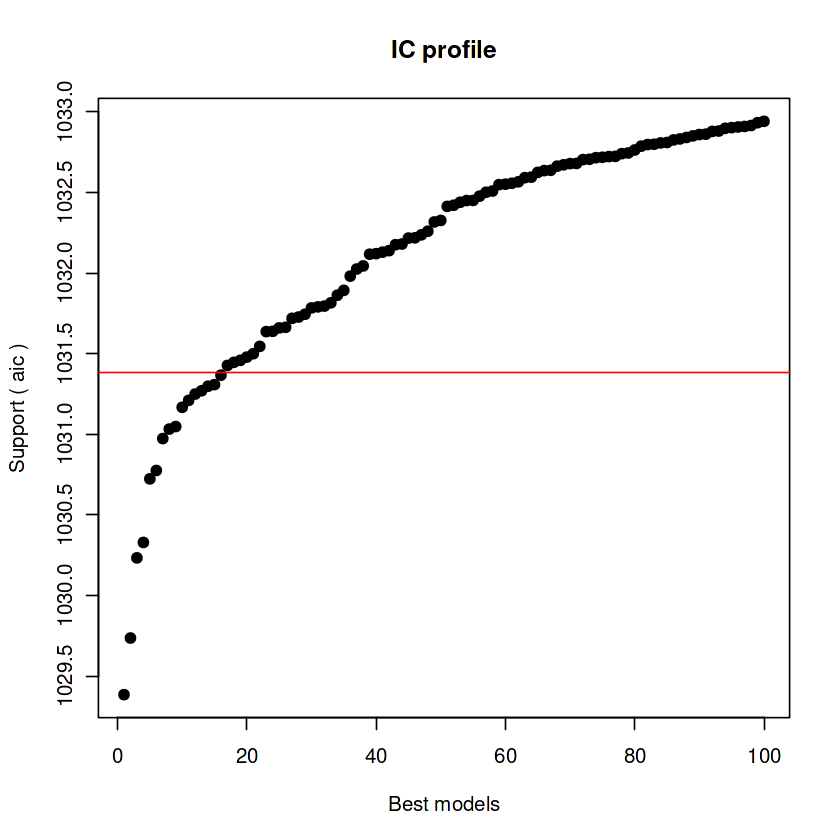


After 342200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1032.01499528604


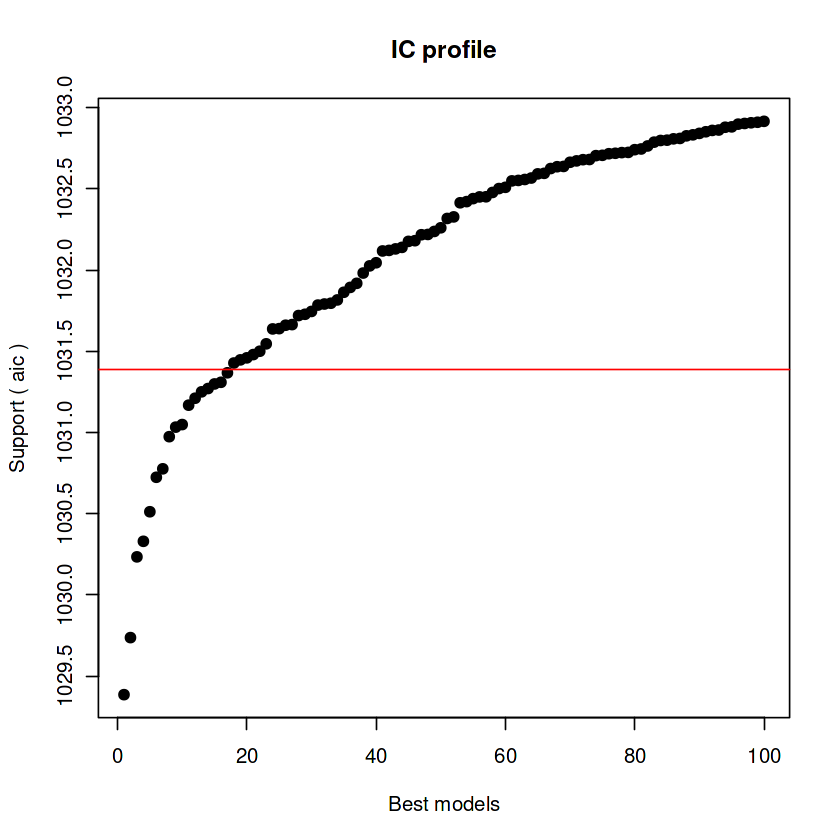


After 342250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.99270024866



After 342300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.98442844696


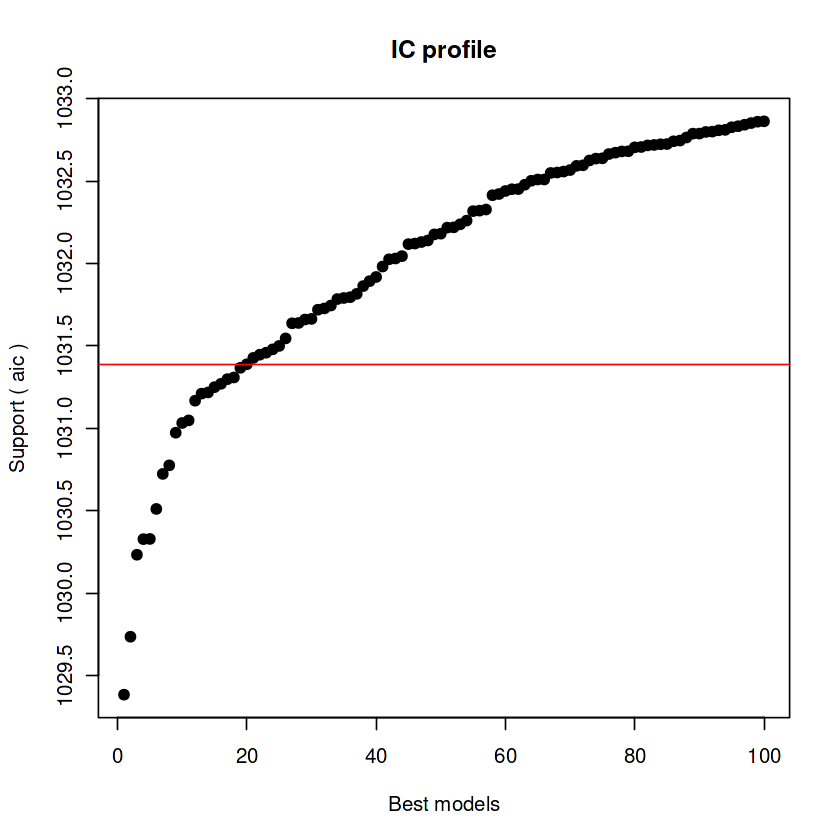


After 342350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.98442844696


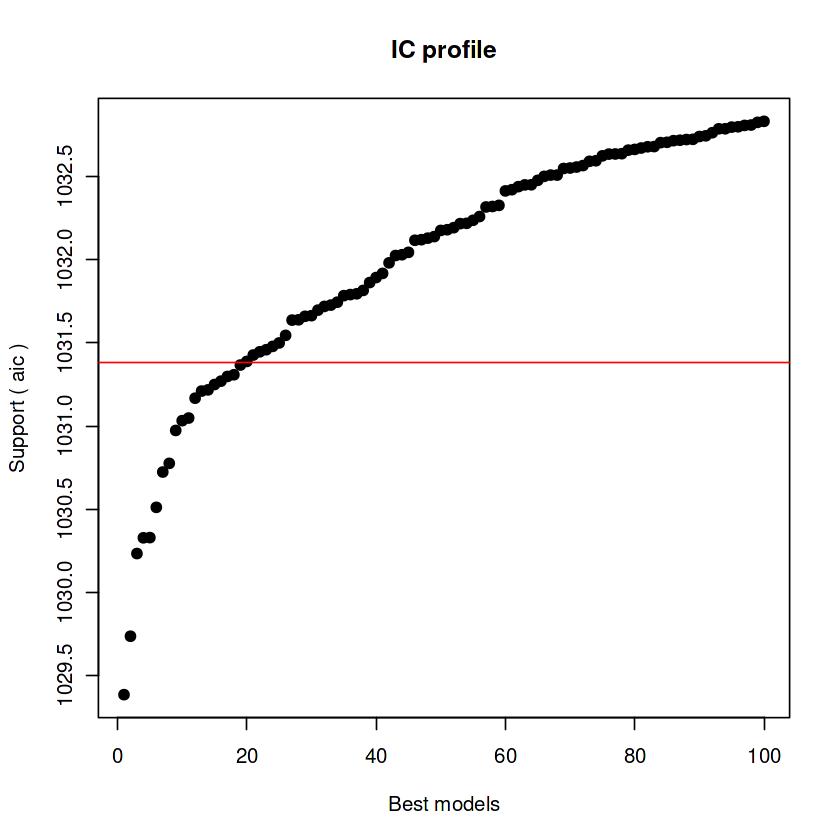


After 342400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.90208666079



After 342450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.90017454215


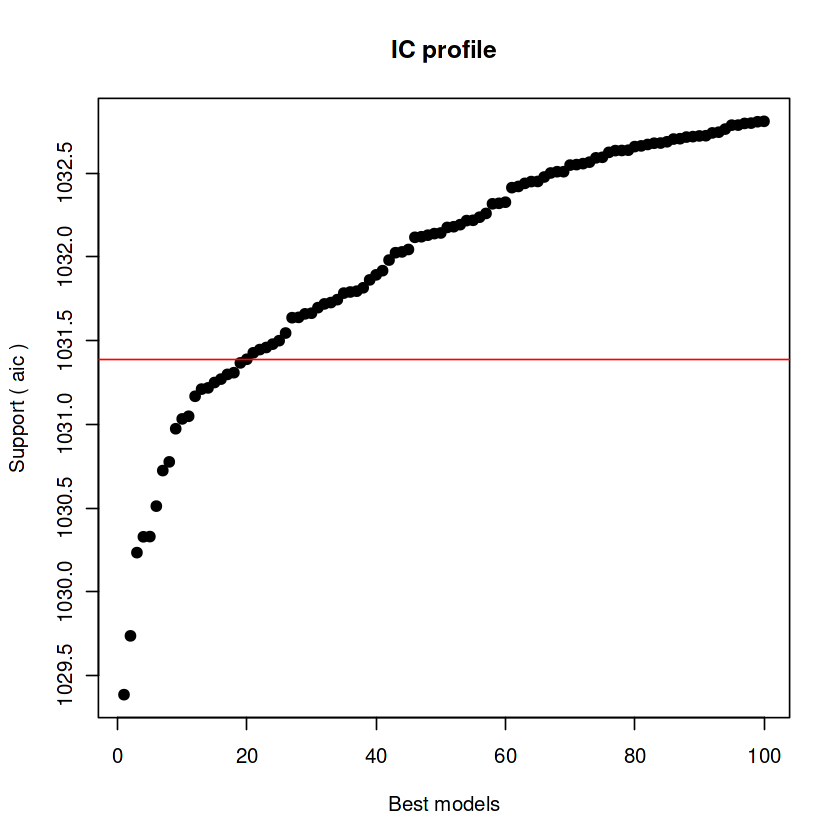


After 342500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.90017454215


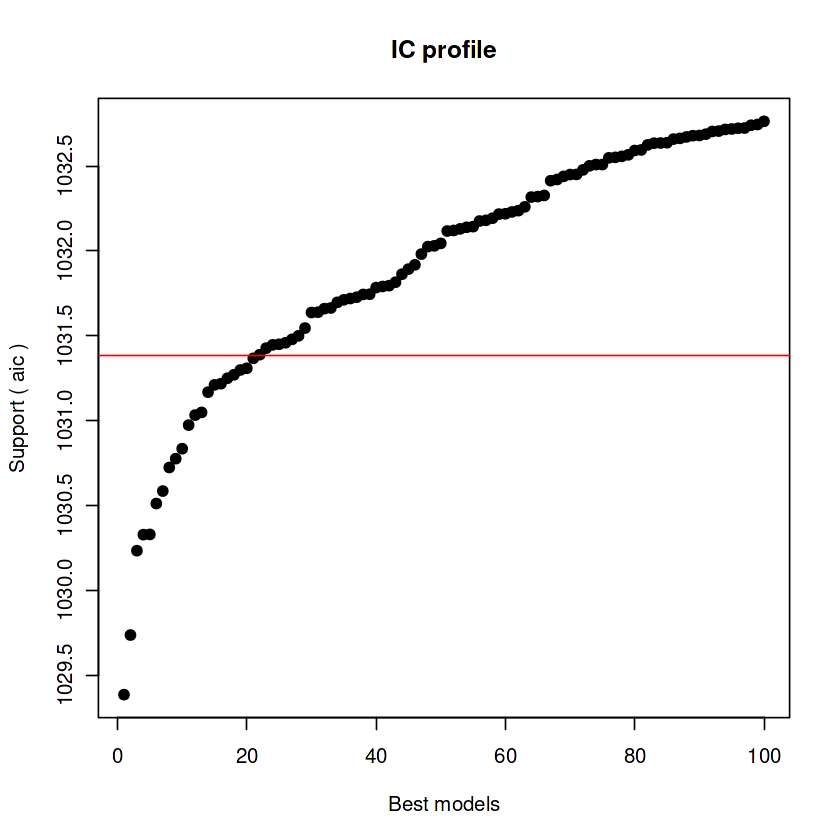


After 342550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.90017454215



After 342600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.90017454215



After 342650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.89186397192



After 342700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.88607121847


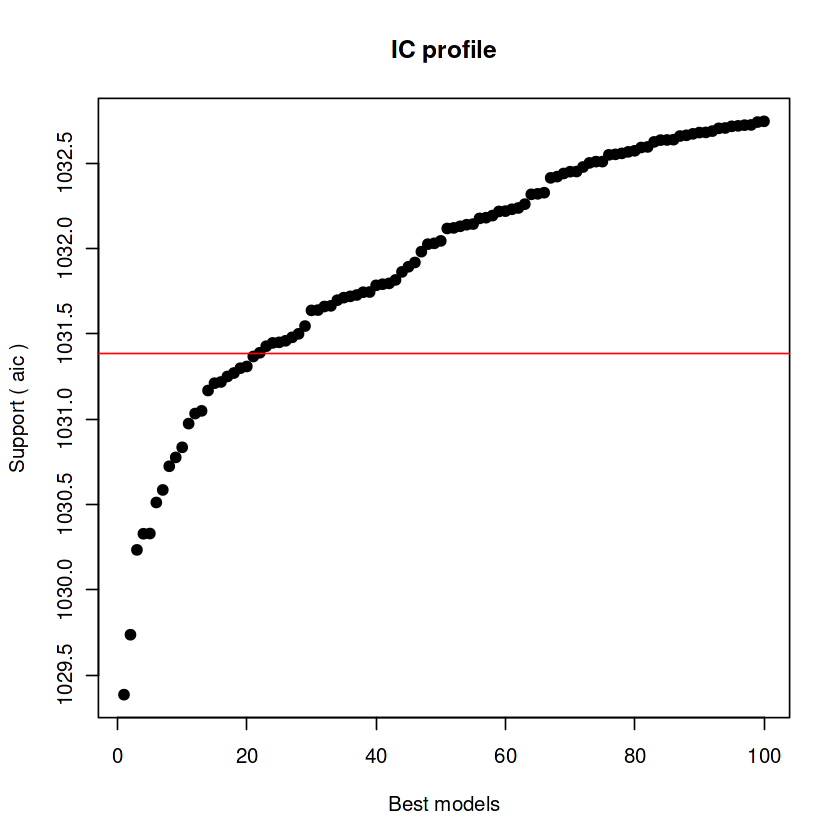


After 342750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.88607121847


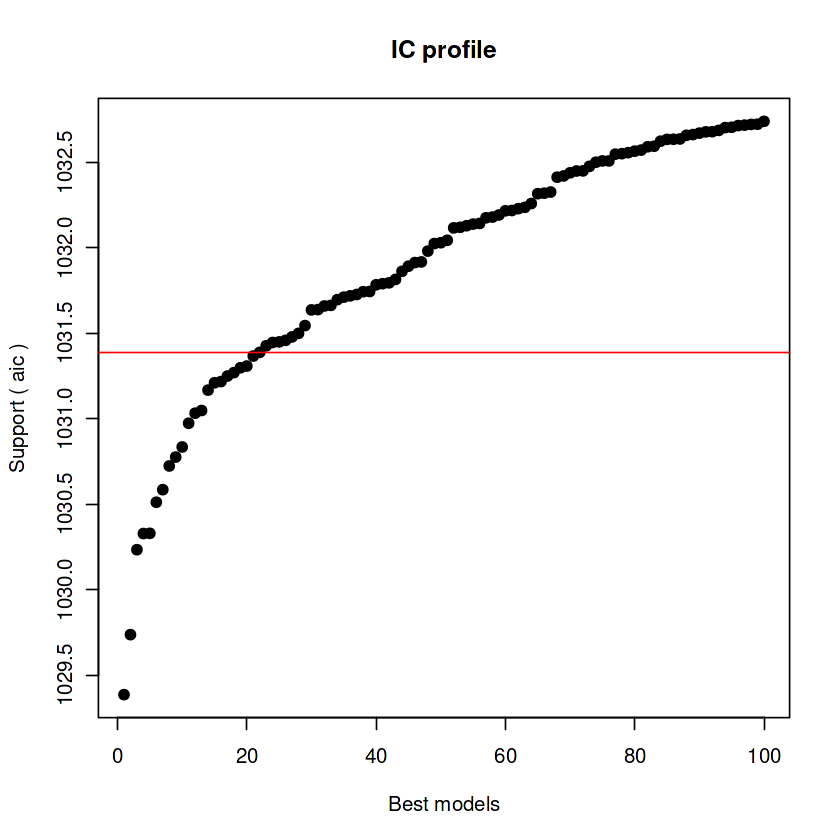


After 342800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.78562436744



After 342850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.78098499813


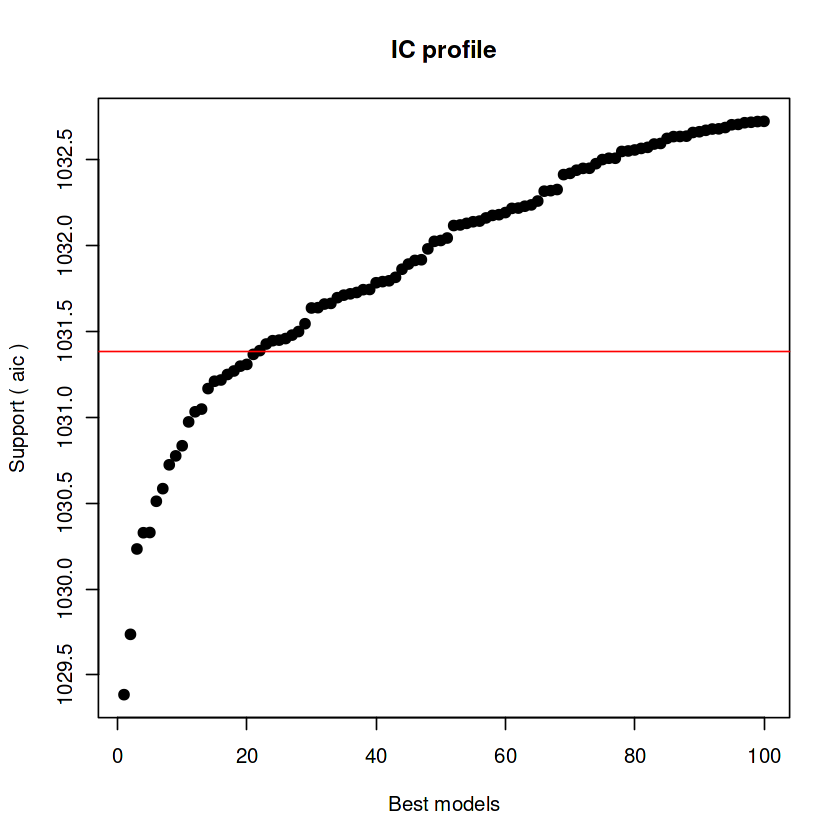


After 342900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.74346097157


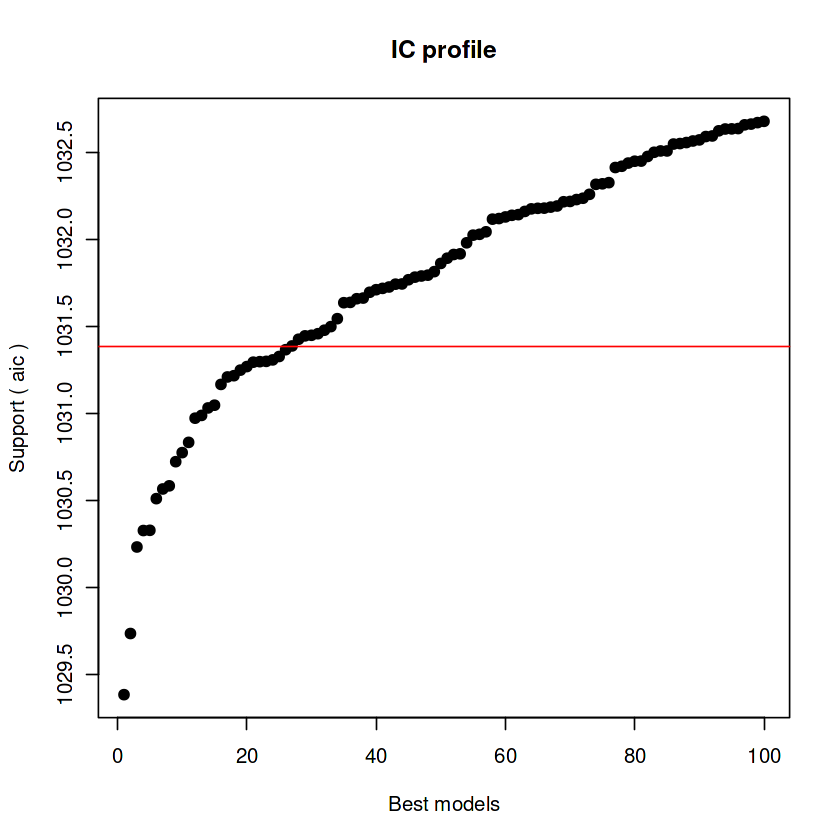


After 342950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.61591983933


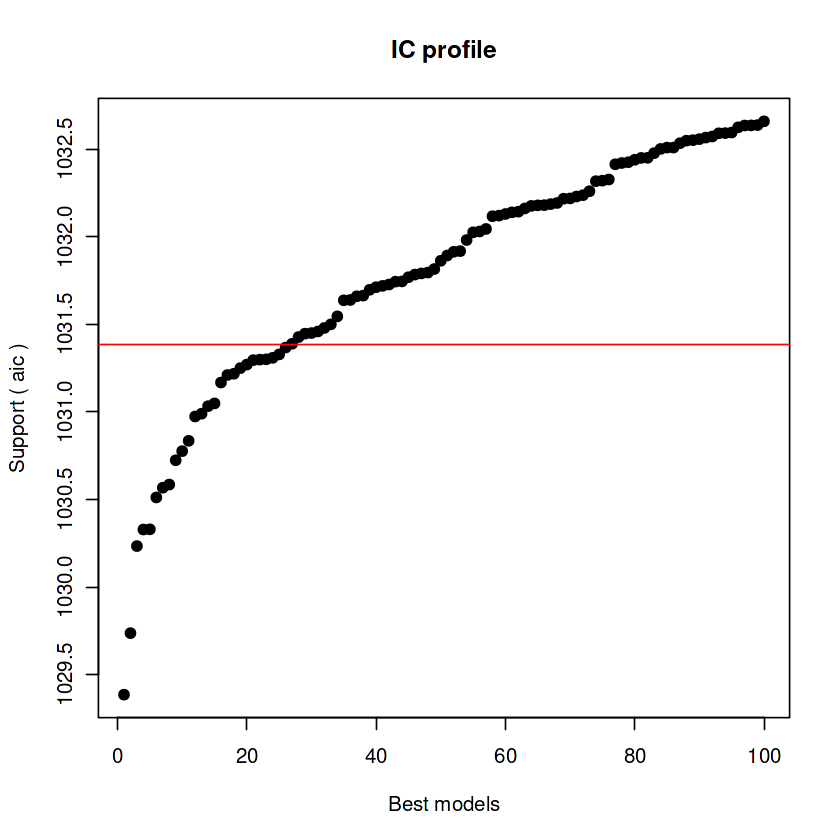


After 343000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.60917635509


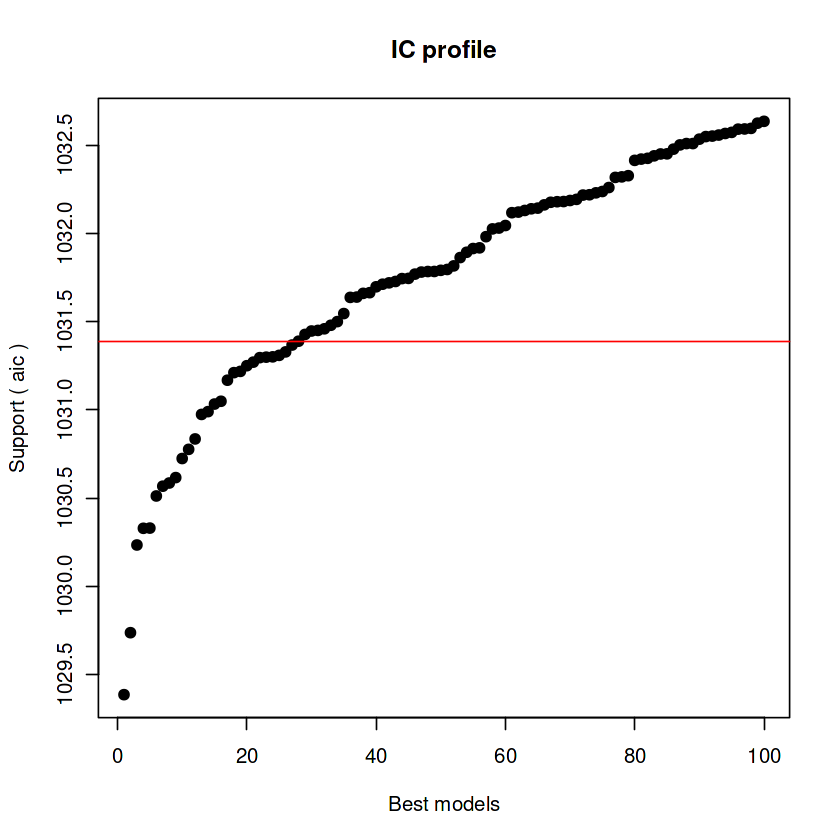


After 343050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.60253143508


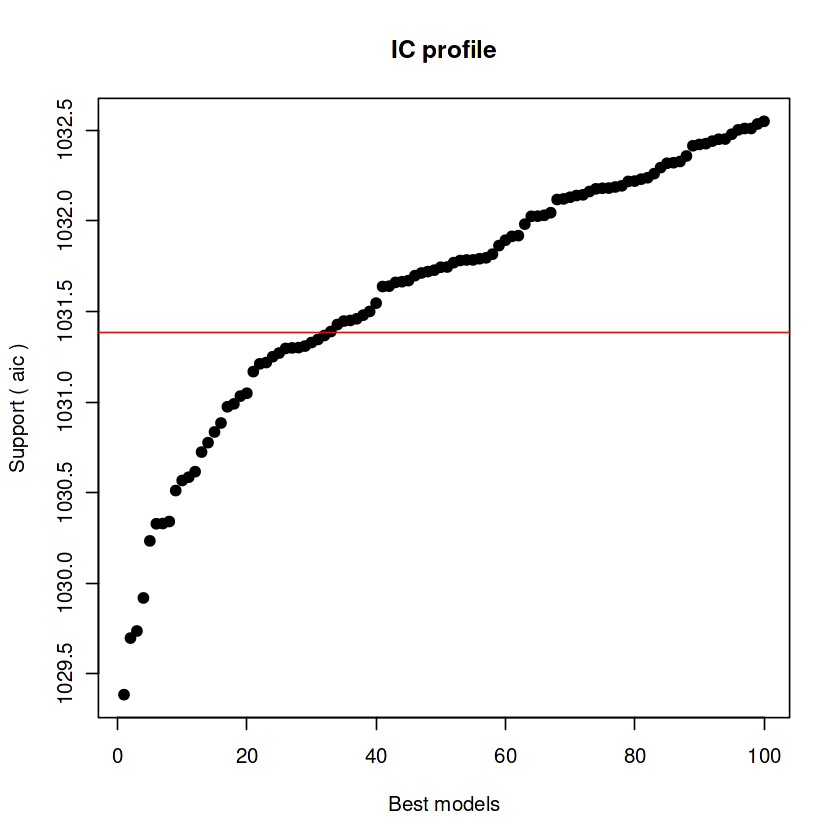


After 343100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.60253143508


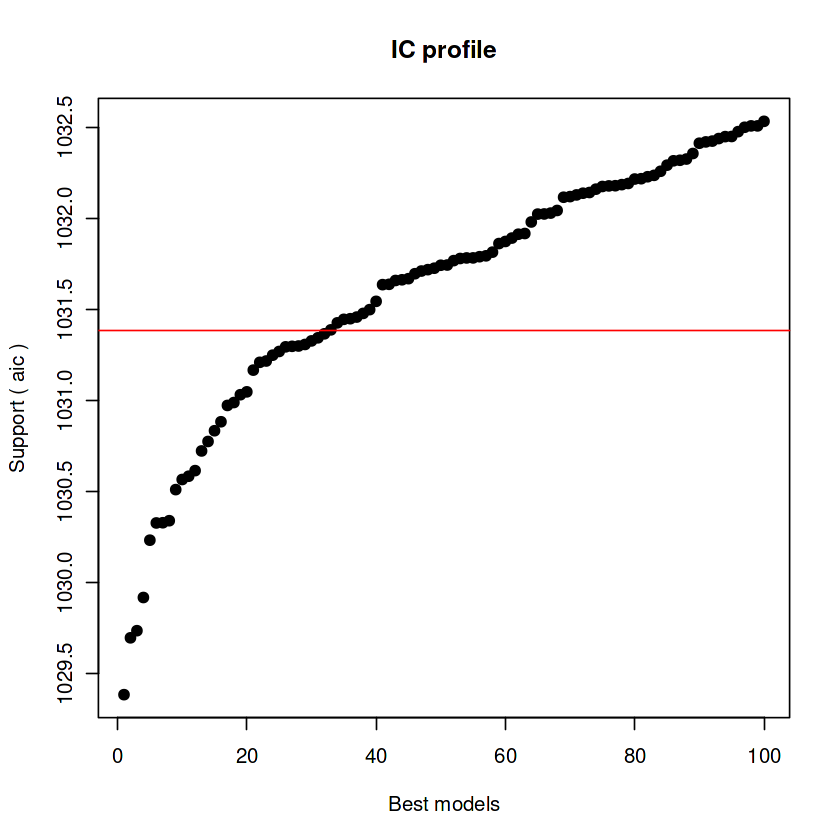


After 343150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.60253143508



After 343200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622


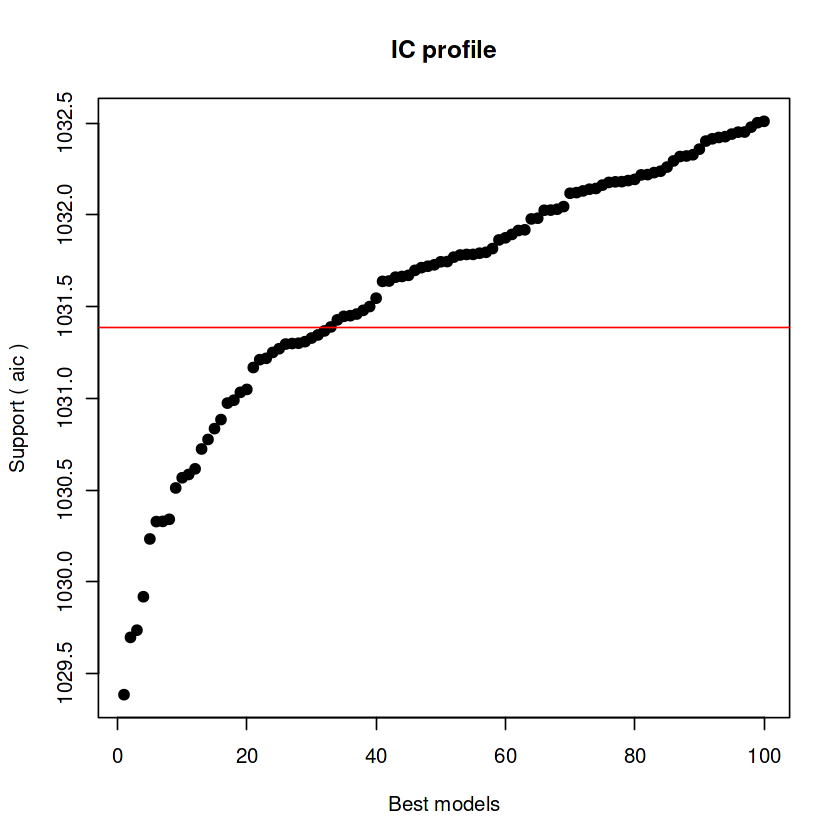


After 343300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 343950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 344950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.56490236622



After 345850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.55683074936



After 345900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.55683074936


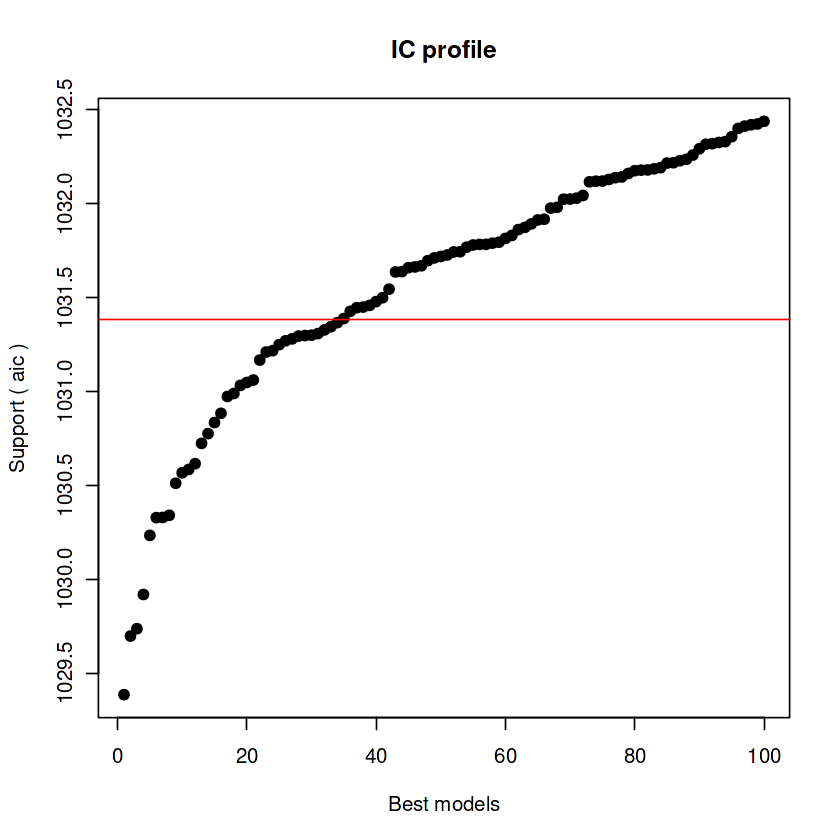


After 345950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.55394851182



After 346000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.55394851182


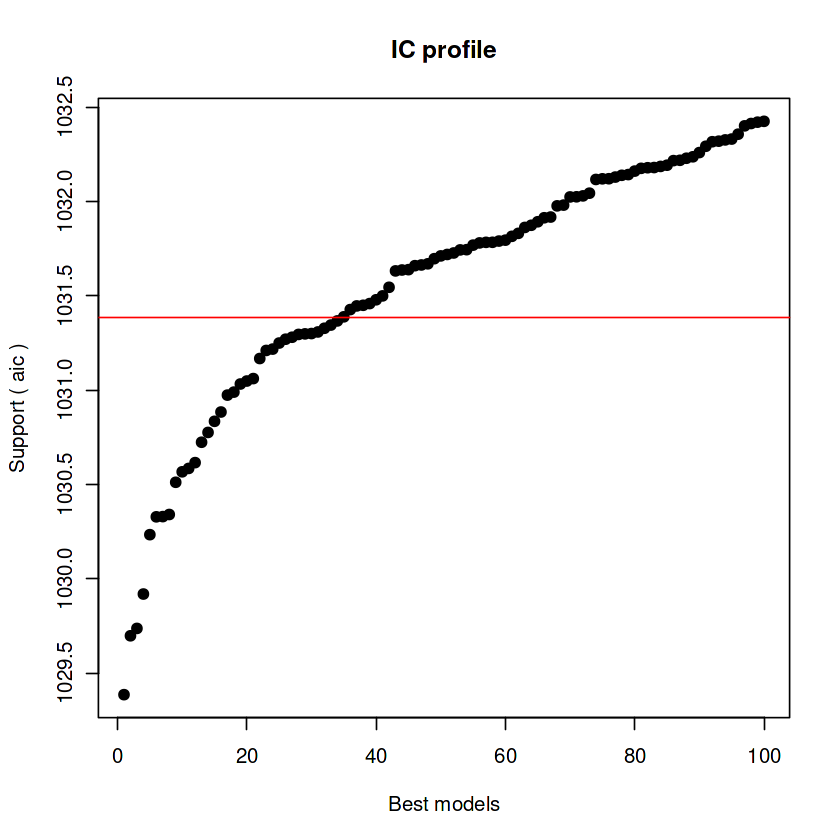


After 346050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.55394851182



After 346100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.53348370855



After 346150 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.53348370855


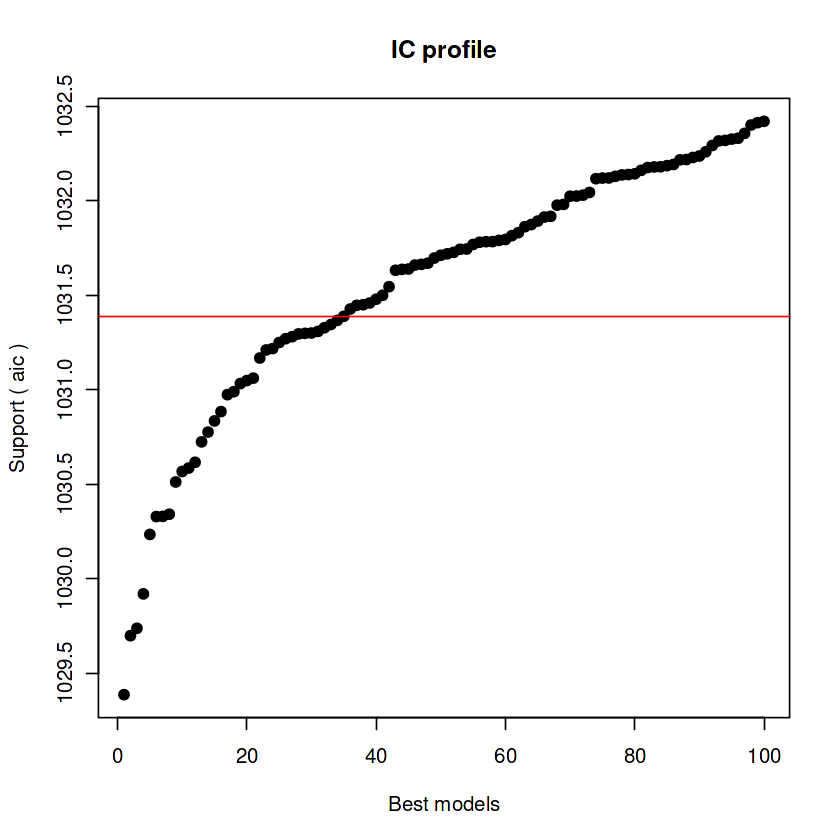


After 346200 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.53348370855



After 346250 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.5099843223



After 346300 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.50954596139


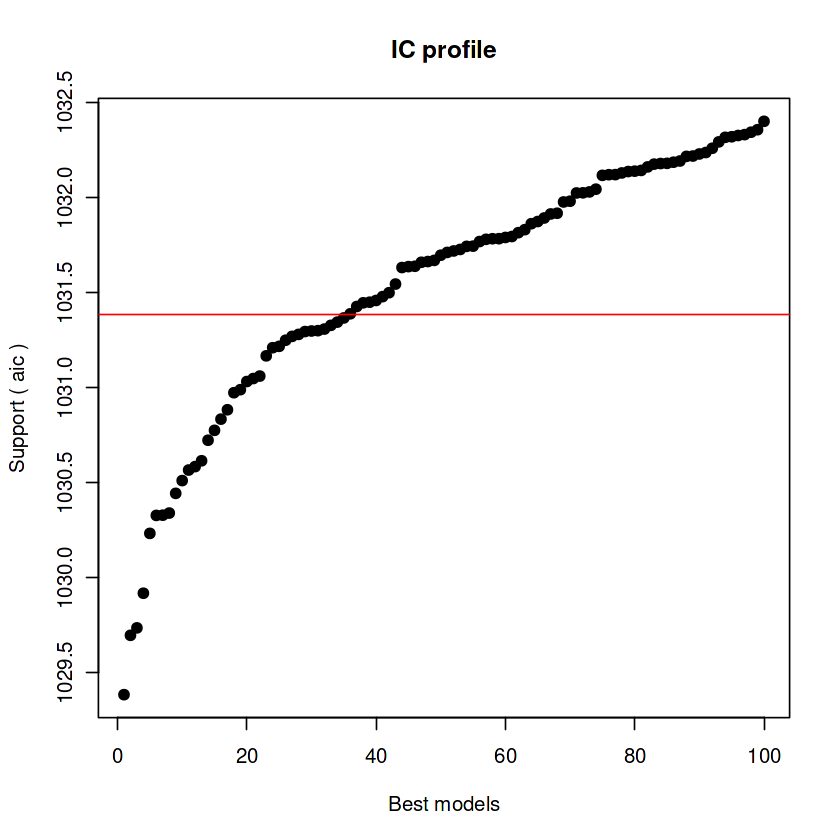


After 346350 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.46544143792


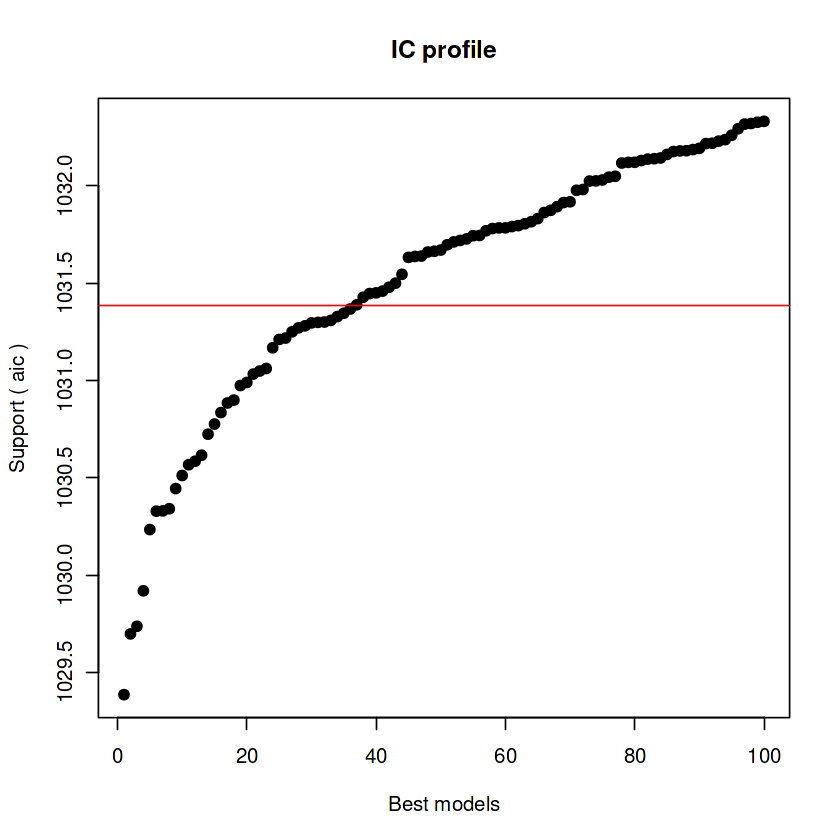


After 346400 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.44069118981


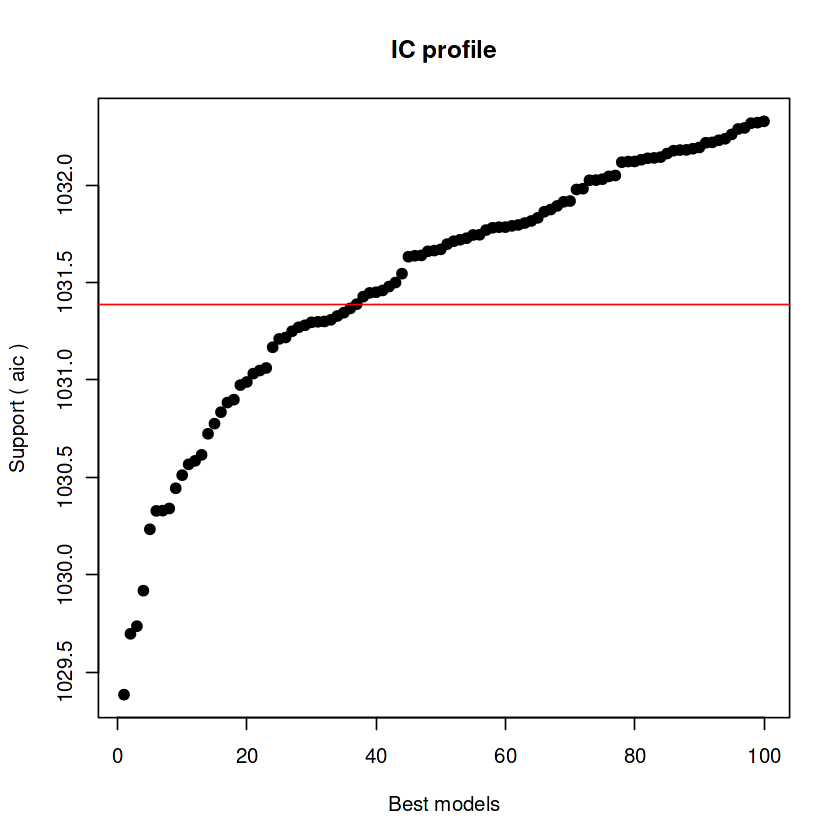


After 346450 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.44069118981


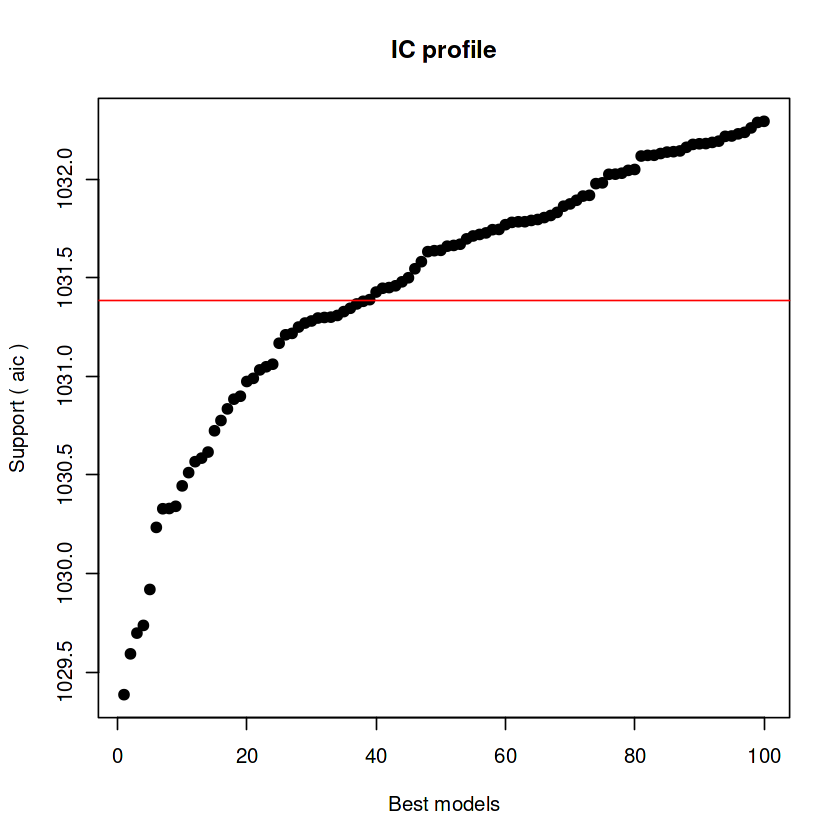


After 346500 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.43567894672



After 346550 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.43567894672


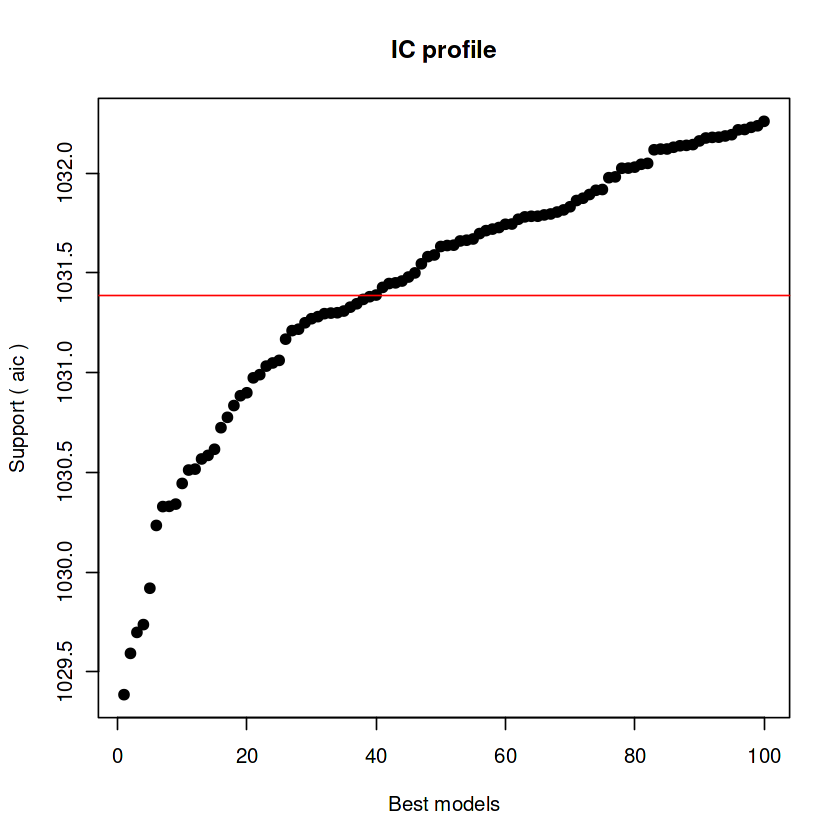


After 346600 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.43567894672



After 346650 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.40373403518



After 346700 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.40373403518


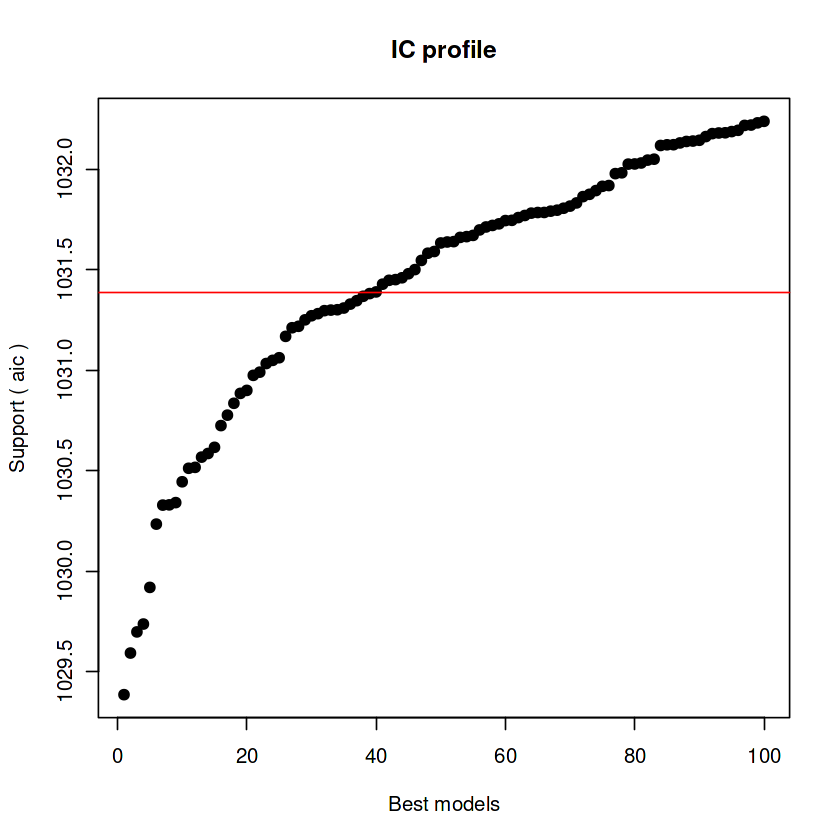


After 346750 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.40373403518



After 346800 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.40373403518



After 346850 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.40373403518



After 346900 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.39918186734



After 346950 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.39918186734


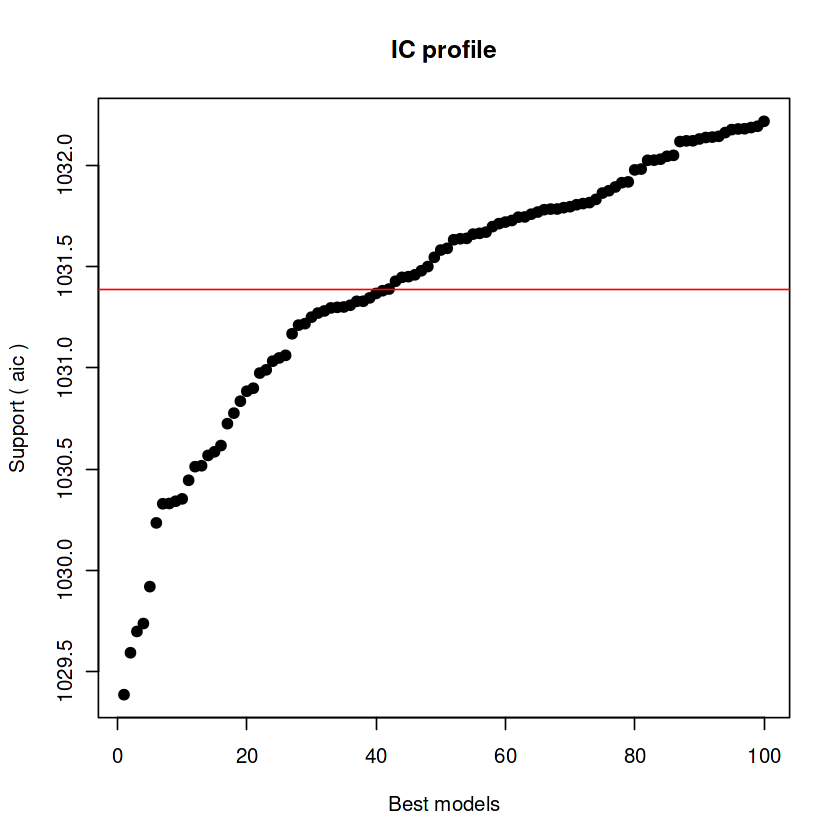


After 347000 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.37498881262



After 347050 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.32982237301


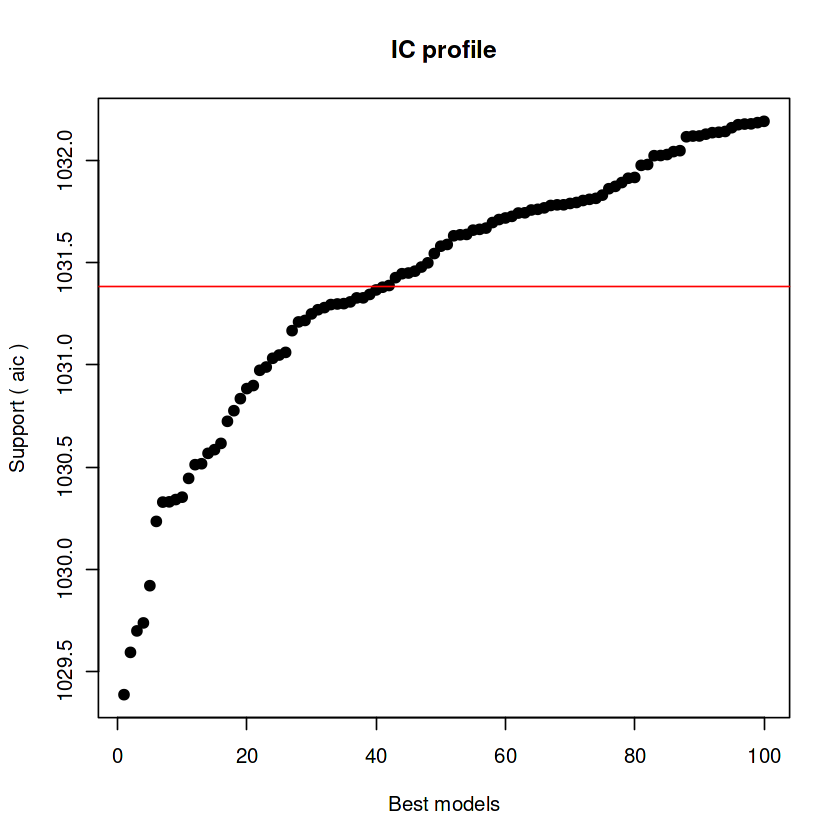


After 347100 models:
Best model: Life.expectancy~1+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1029.38535330948
Mean crit= 1031.32766619623


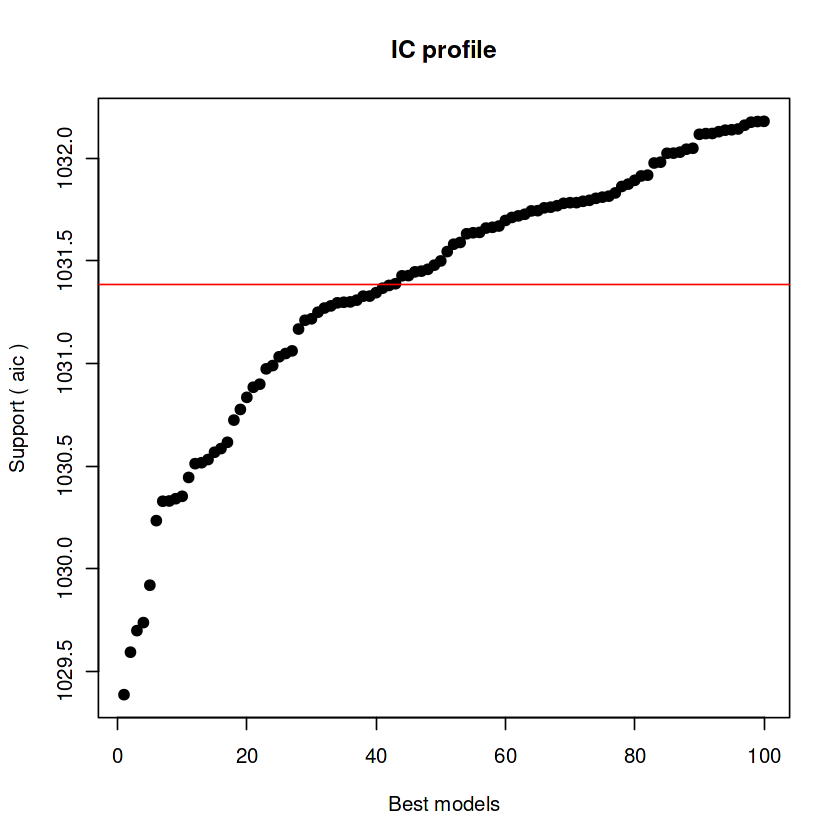


After 347150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.23161187984


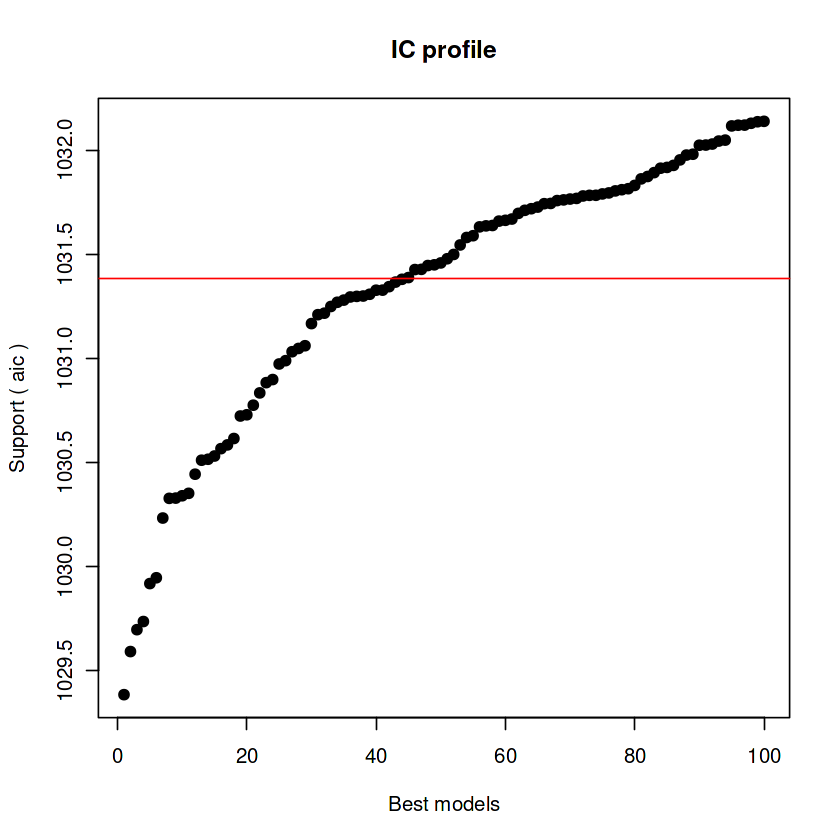


After 347200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.1911080194


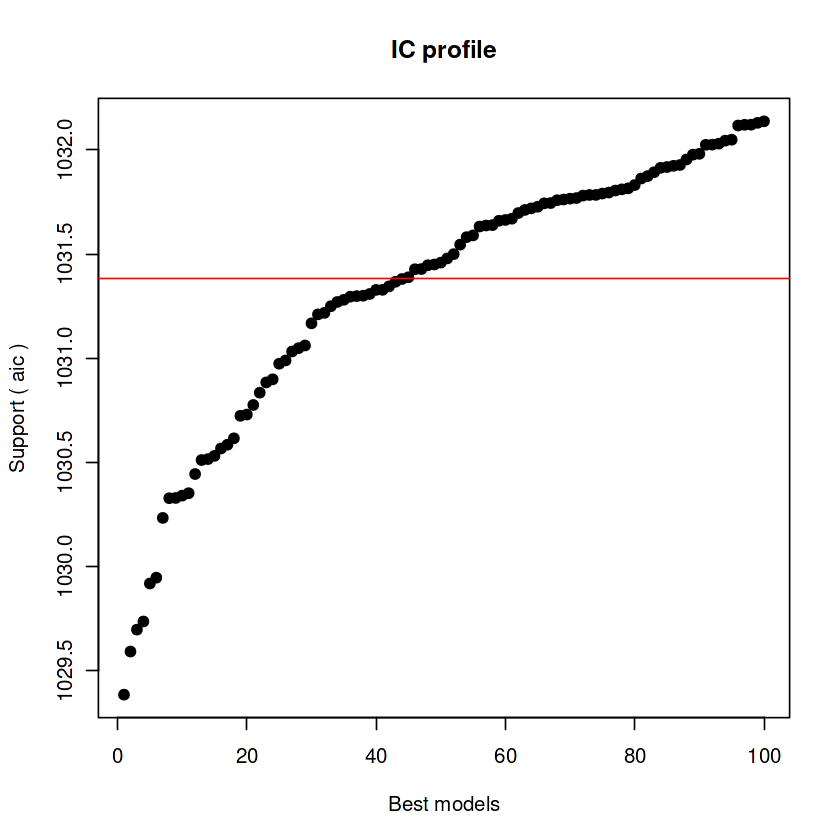


After 347250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.1911080194


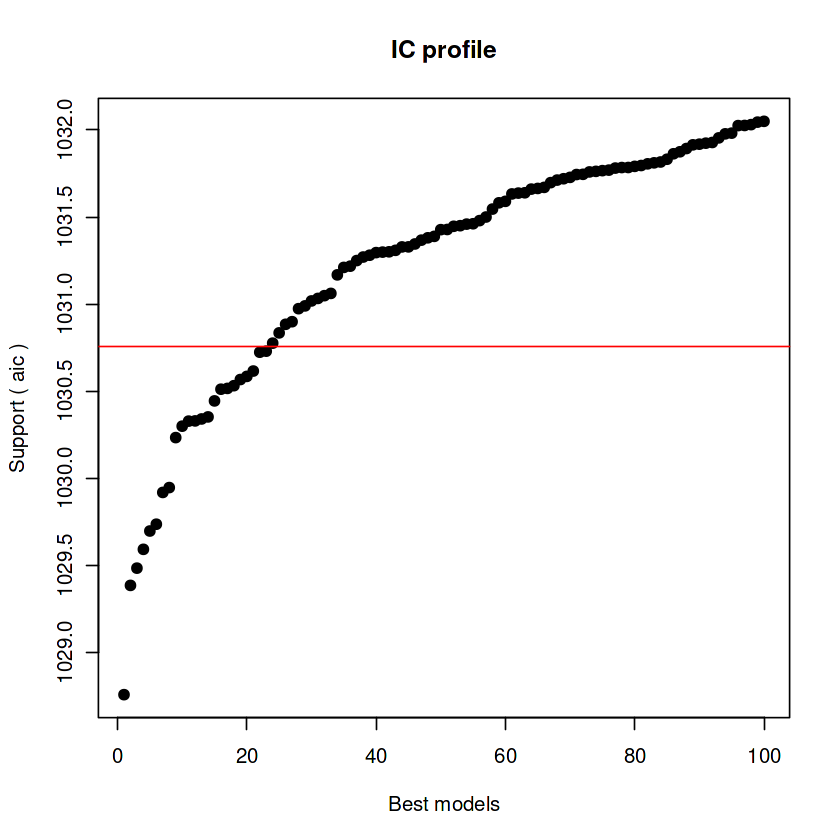


After 347300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.18532957012



After 347350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.18532957012


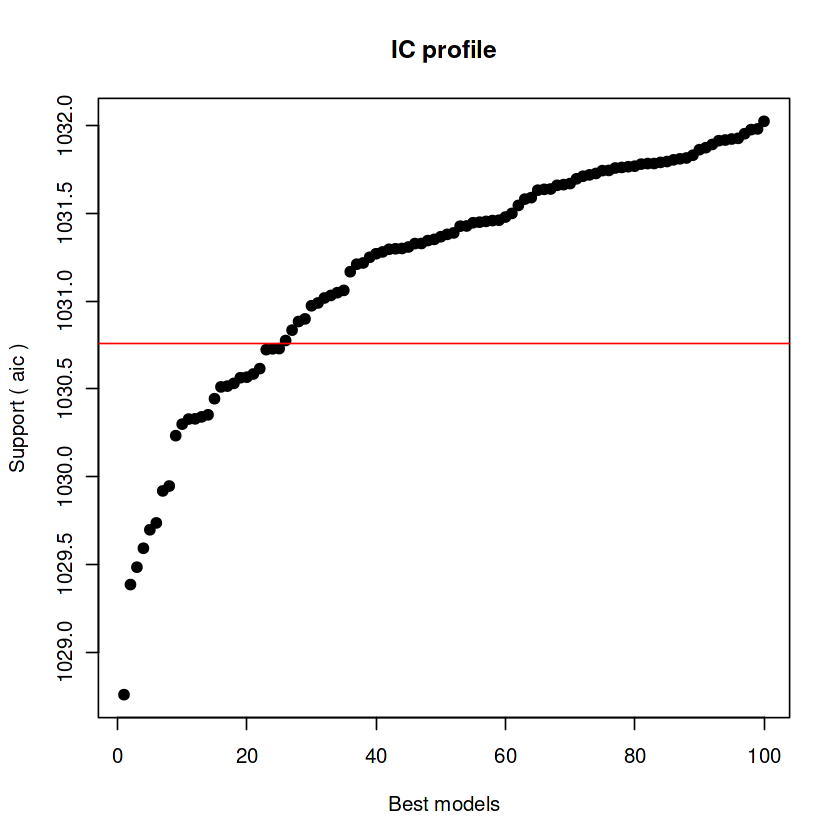


After 347400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.17622242371



After 347450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494


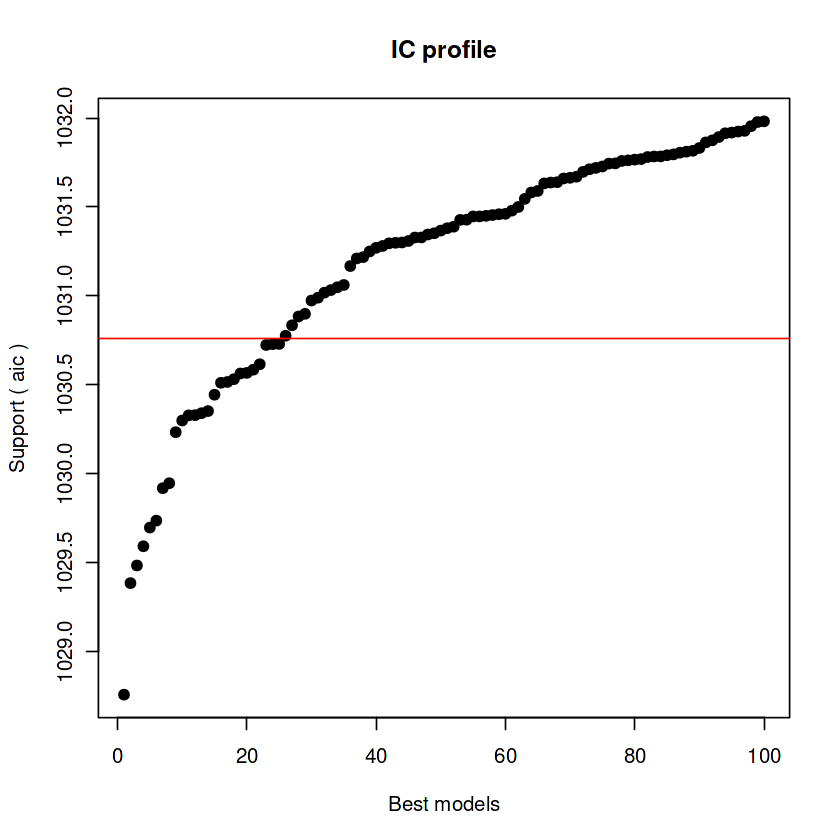


After 347500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494


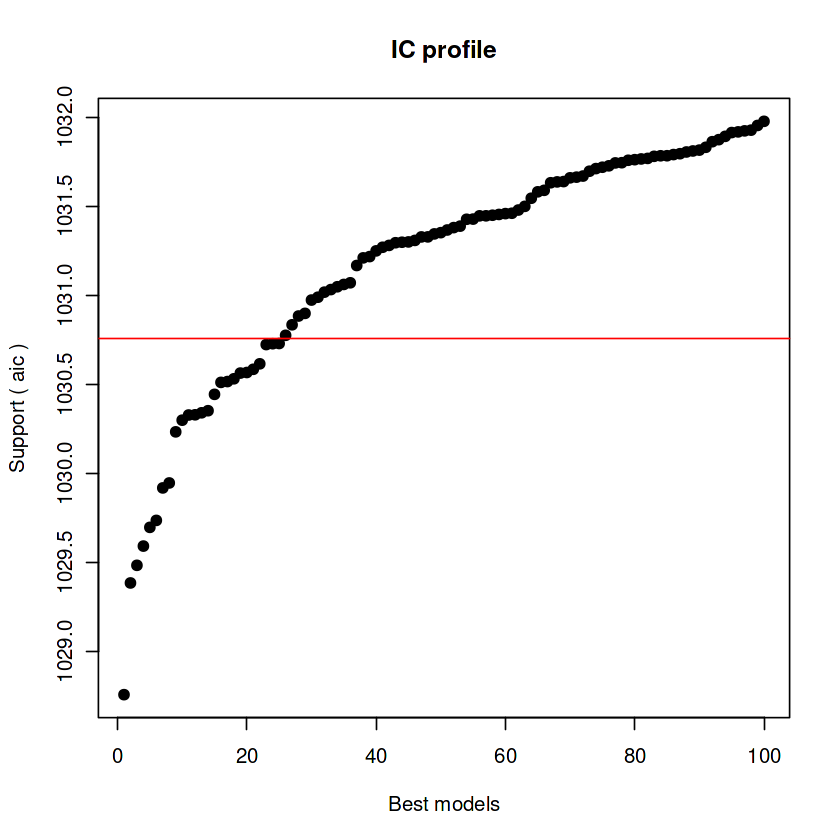


After 347550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 347600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 347650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 347700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 347750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 347800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 347850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 347900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 347950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 348950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 349950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 350950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 351000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 351050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 351100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 351150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 351200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 351250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 351300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 351350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15739328494



After 351400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 351450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591


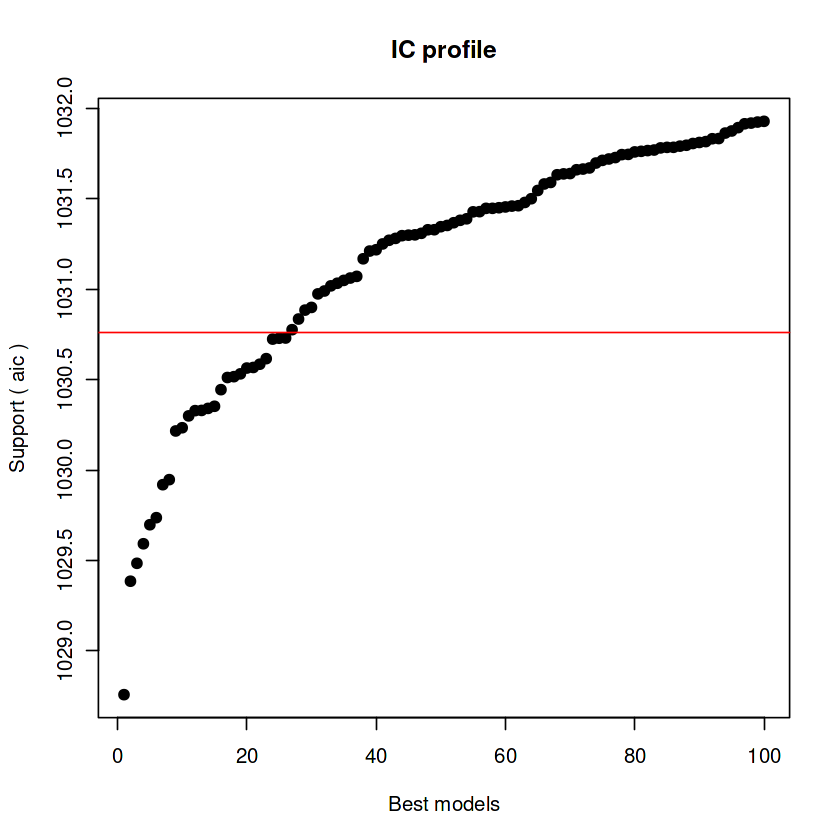


After 351500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 351550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 351600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 351650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 351700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 351750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 351800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 351850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 351900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 351950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 352950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 353950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.15087200591



After 354850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715



After 354900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715


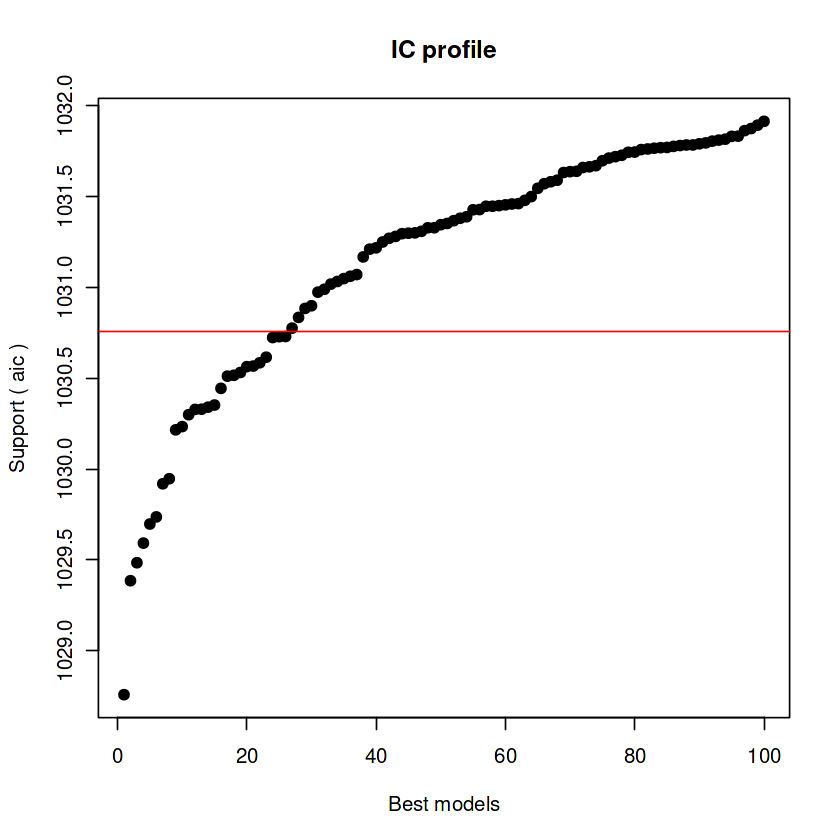


After 354950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715



After 355000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715



After 355050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715



After 355100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715



After 355150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715



After 355200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715



After 355250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715



After 355300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715



After 355350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715



After 355400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715



After 355450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14481701715



After 355500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14235204714



After 355550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14235204714


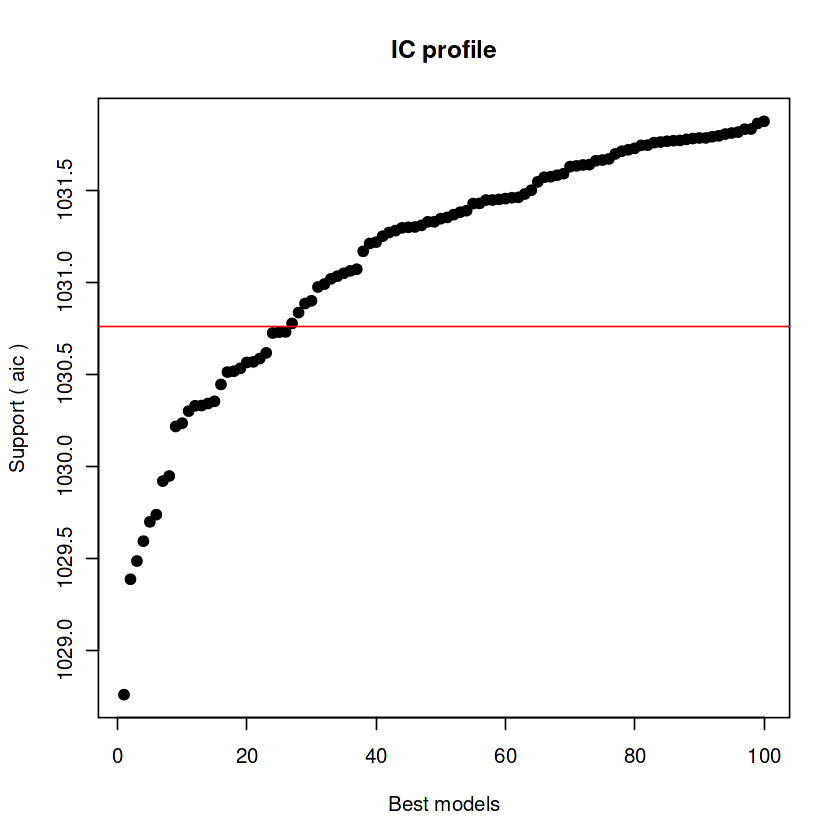


After 355600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.14235204714



After 355650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 355700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939


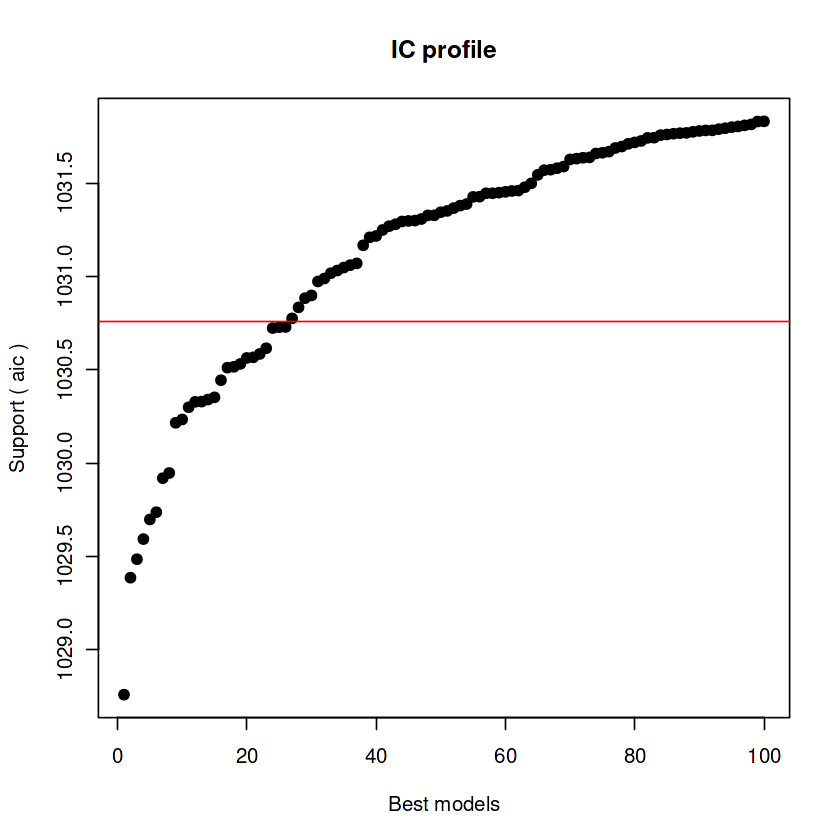


After 355750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 355800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 355850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 355900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 355950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 356950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 357950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 358000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 358050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 358100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 358150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+Hepatitis.B+BMI+under.five.deaths+Total.expenditure+Diphtheria+HIV.AIDS+GDP+Income.composition.of.resources
Crit= 1028.75815764822
Mean crit= 1031.11741403939



After 358200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1028.48507262284
Mean crit= 1031.0575588603



After 358250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1028.48507262284
Mean crit= 1031.00317916293


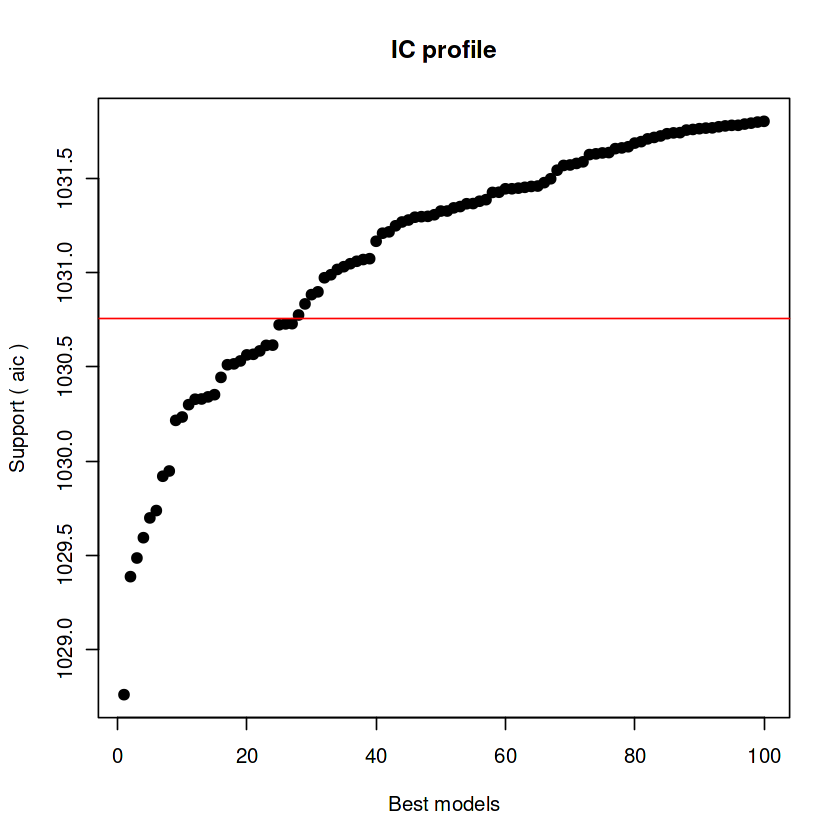


After 358300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1028.48507262284
Mean crit= 1030.91033541811


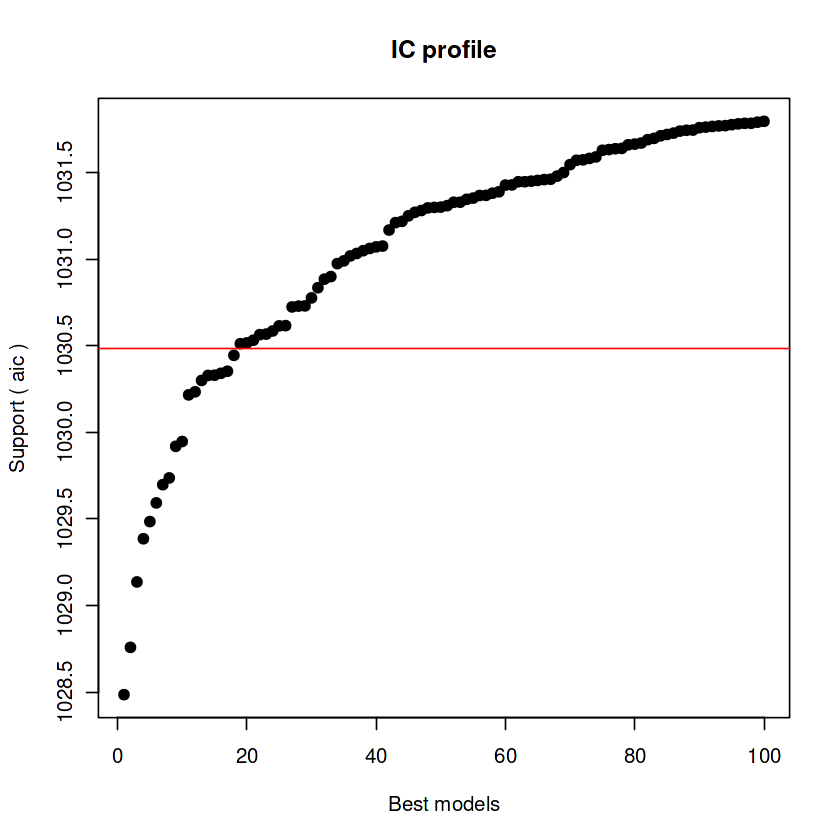


After 358350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1028.48507262284
Mean crit= 1030.86926059734


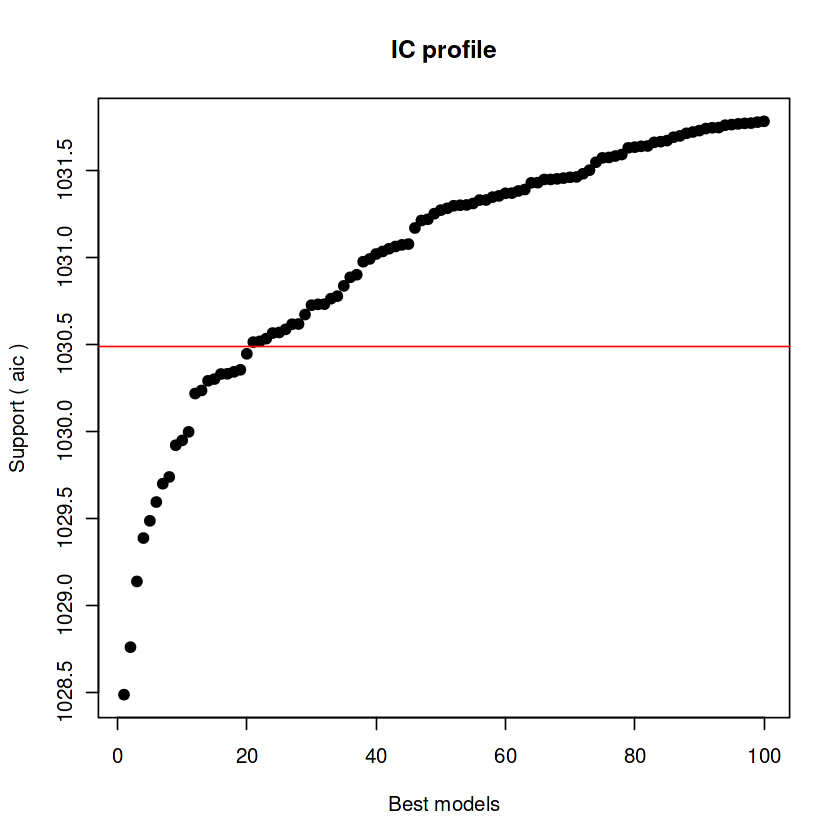


After 358400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1028.48507262284
Mean crit= 1030.82564002116


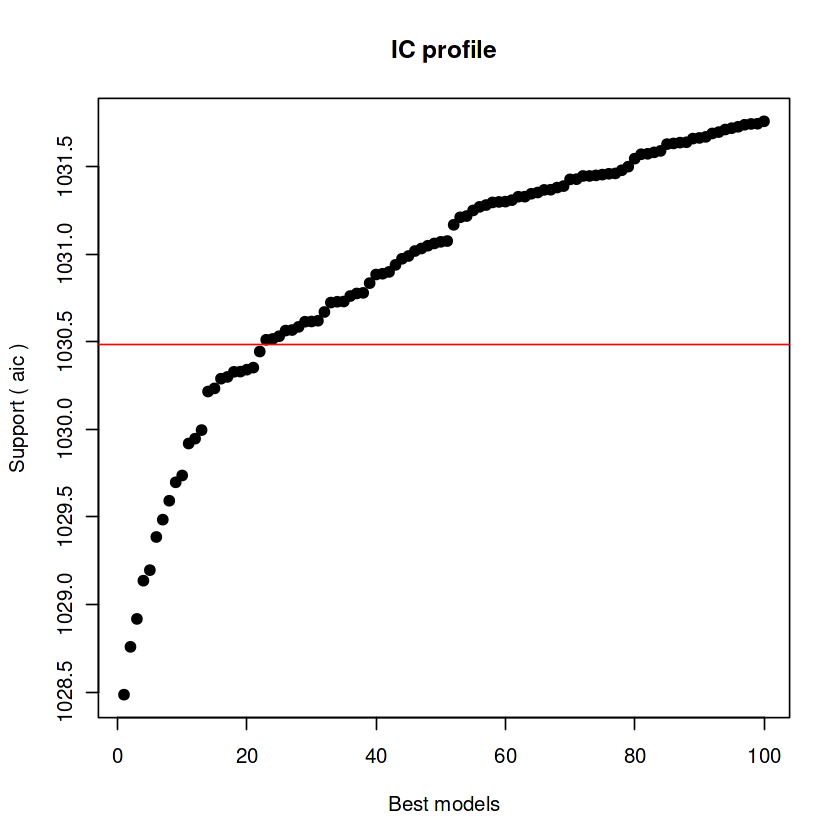


After 358450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1028.48507262284
Mean crit= 1030.82158844933


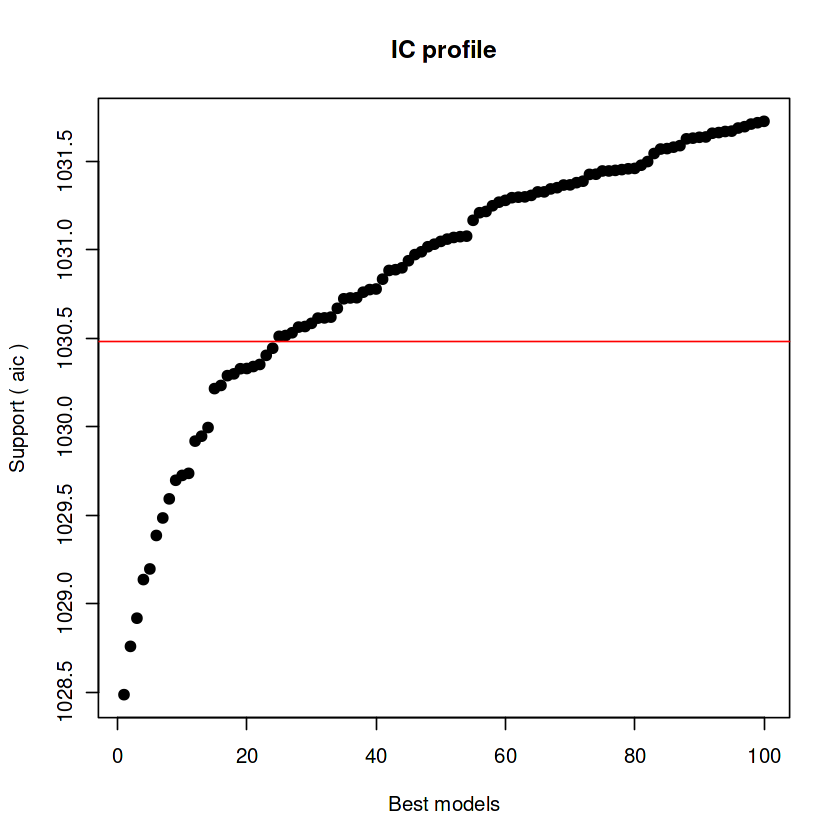


After 358500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1025.38384192484
Mean crit= 1030.50872871143


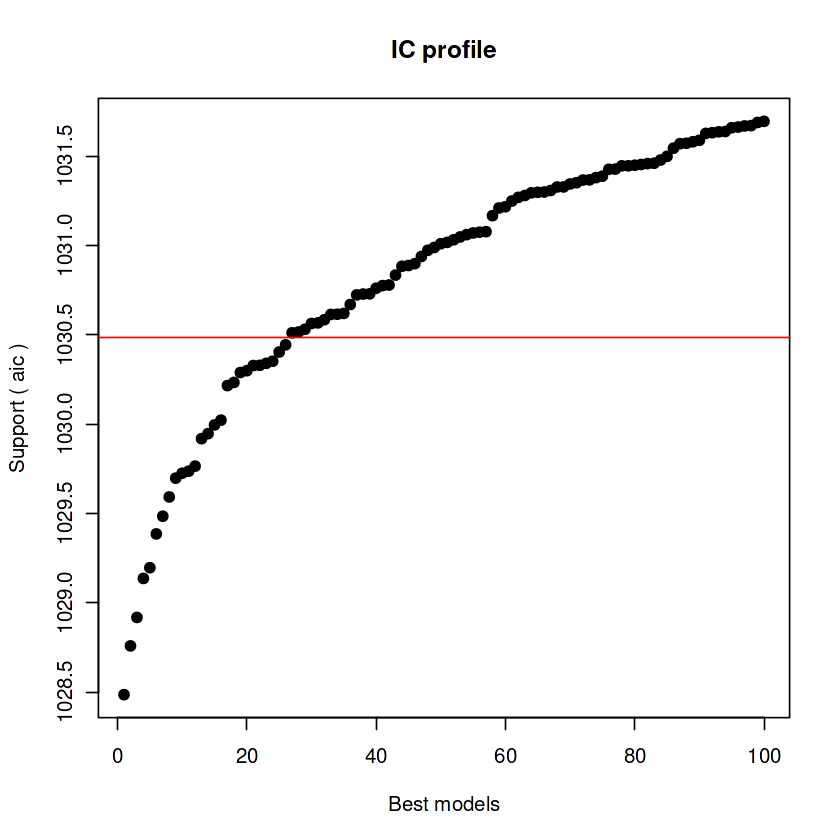


After 358550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1025.38384192484
Mean crit= 1030.24051984179


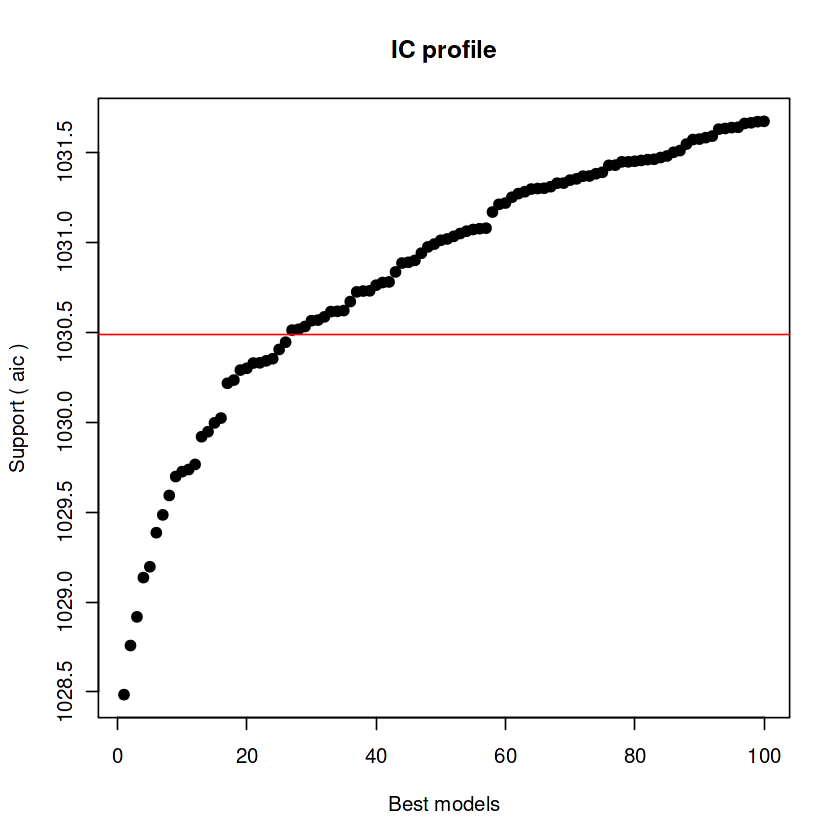


After 358600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1025.38384192484
Mean crit= 1030.10534768706


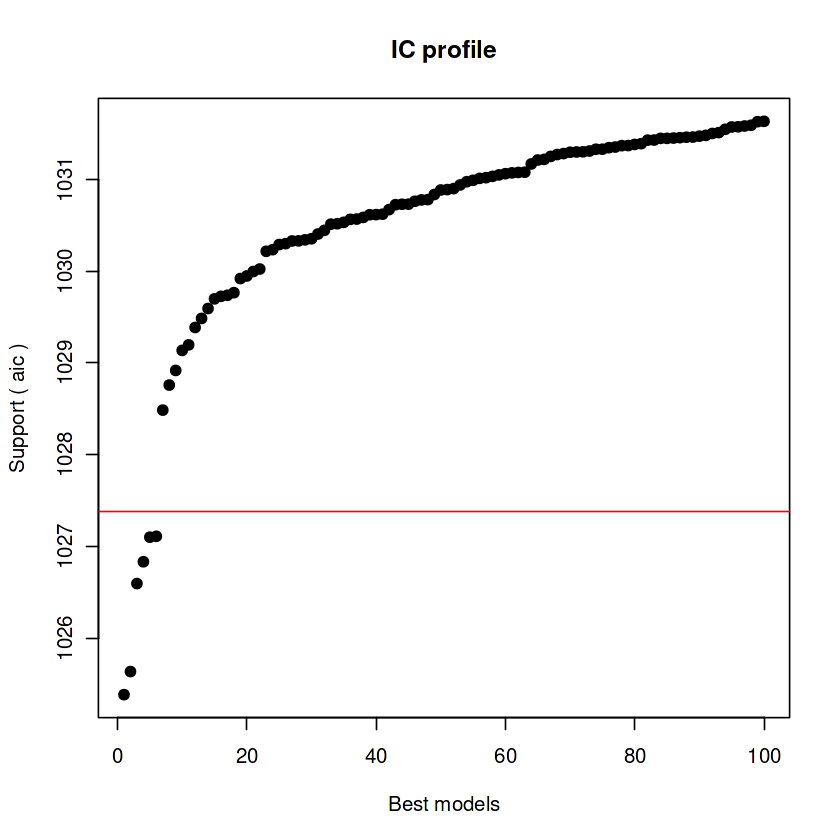


After 358650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1025.38384192484
Mean crit= 1030.1001960156


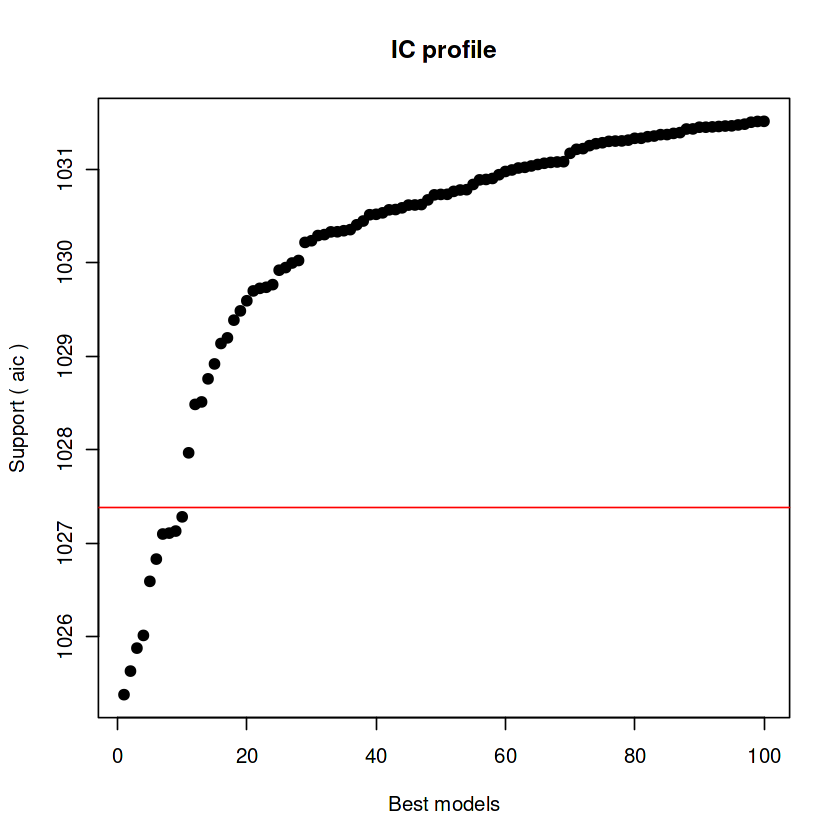


After 358700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1025.38384192484
Mean crit= 1030.1001960156


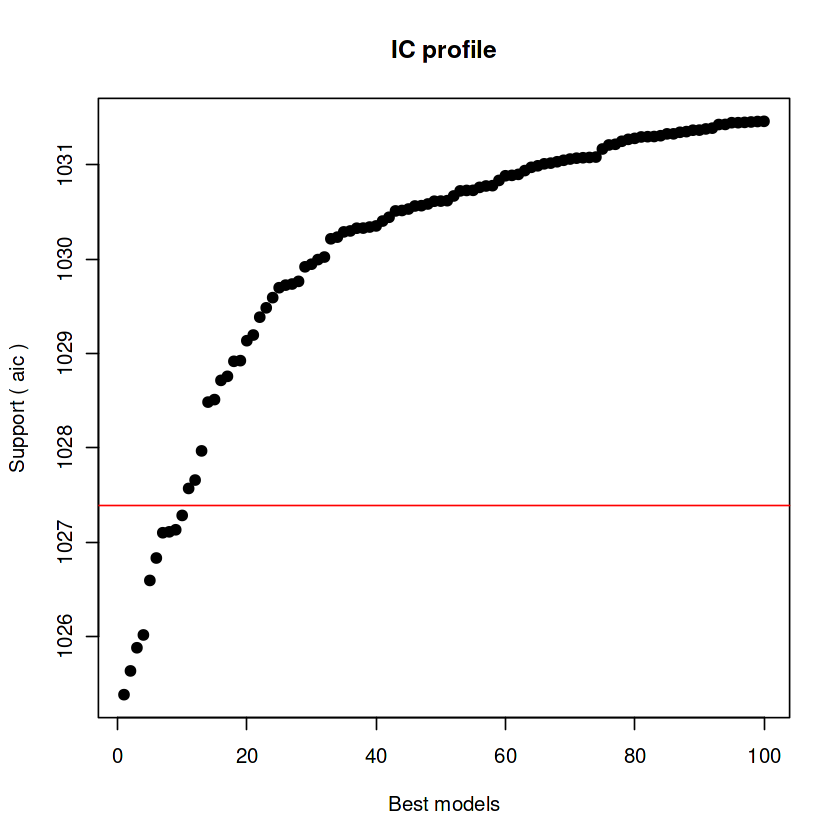


After 358750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1025.38384192484
Mean crit= 1029.94809037943



After 358800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1025.38384192484
Mean crit= 1029.82505650544


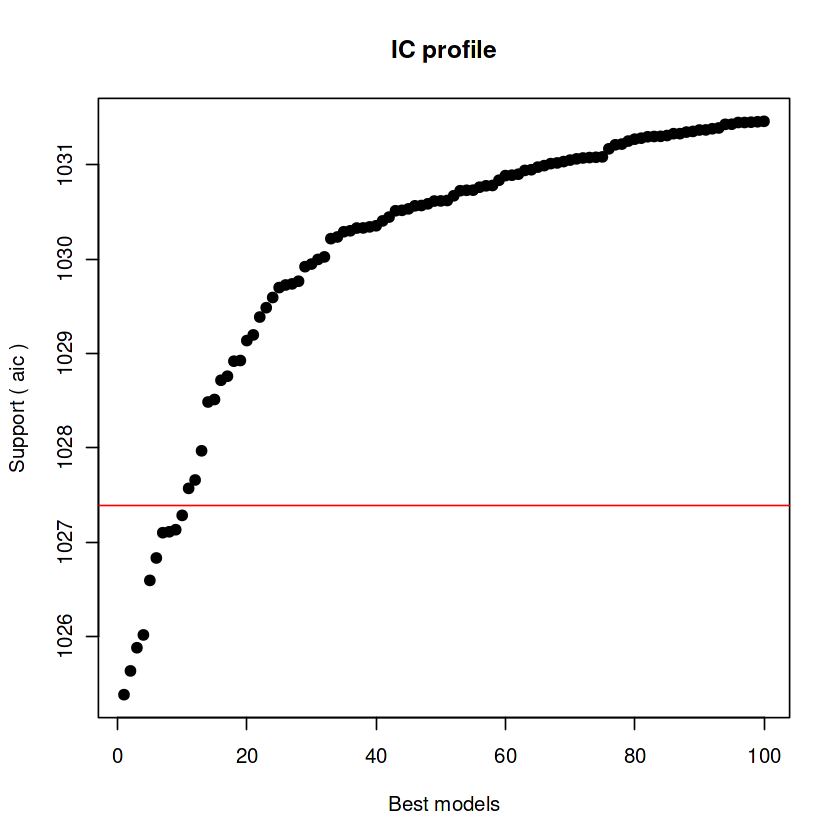


After 358850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1025.38384192484
Mean crit= 1029.7412183896


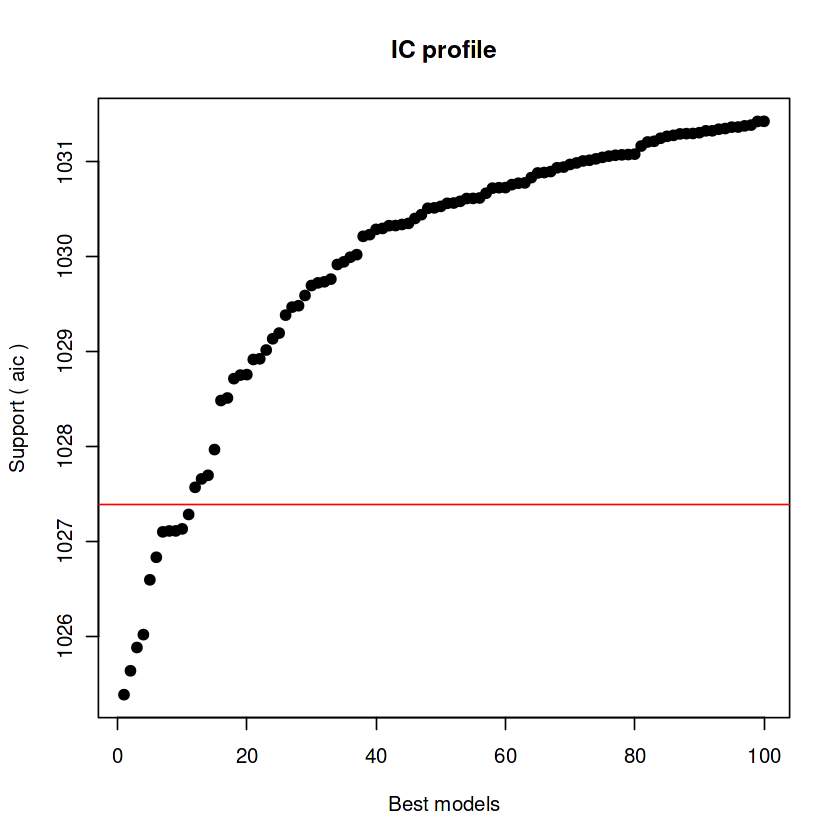


After 358900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1025.38384192484
Mean crit= 1029.70403170618


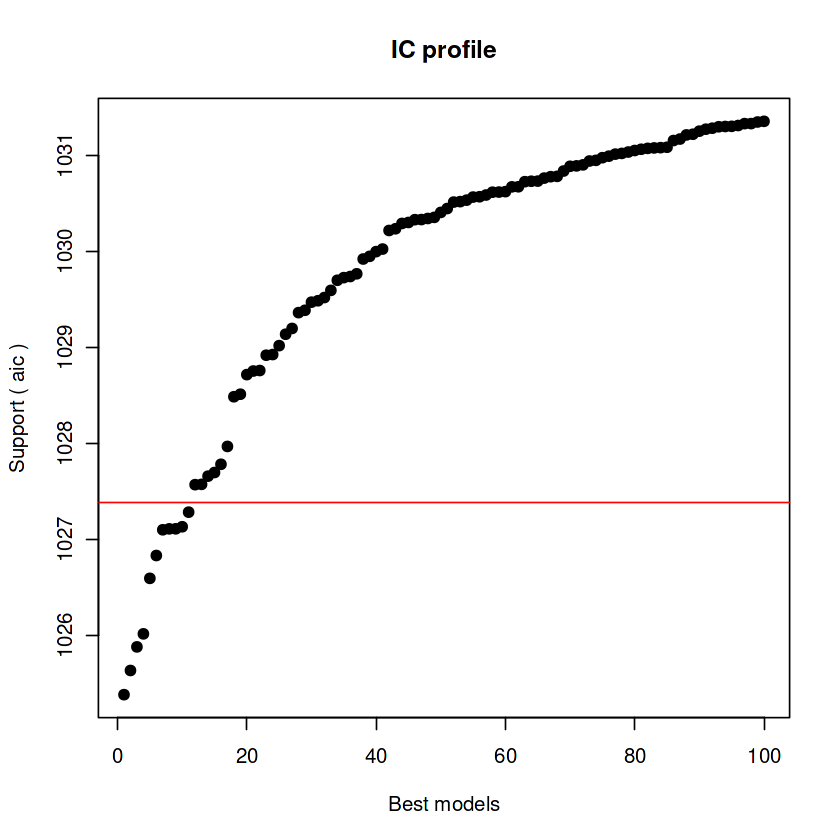


After 358950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1025.38384192484
Mean crit= 1029.63571686263


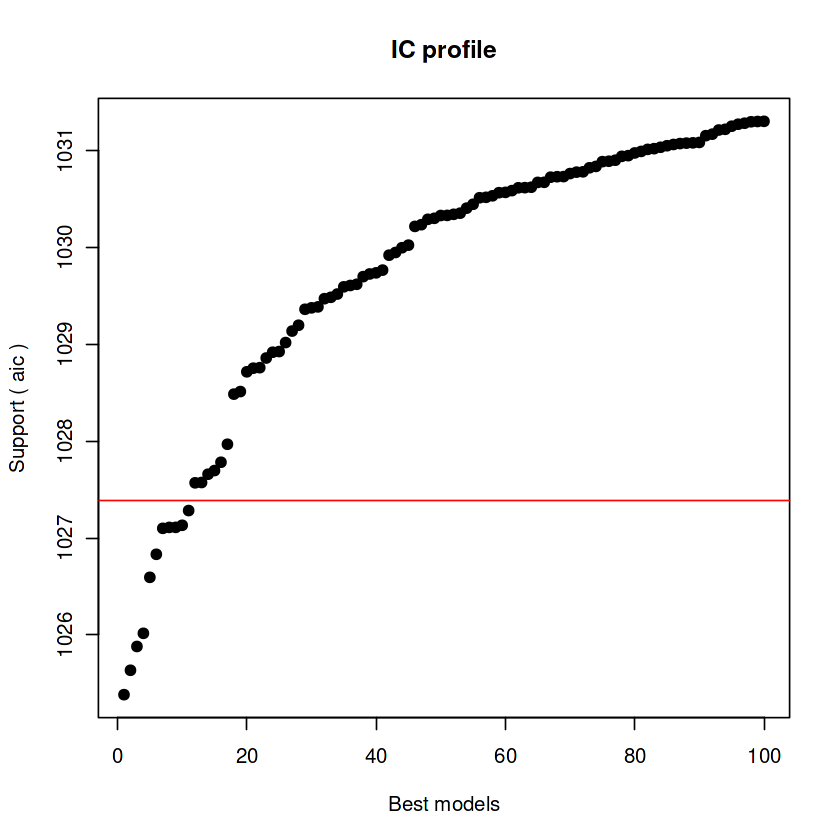


After 359000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1029.45740436996


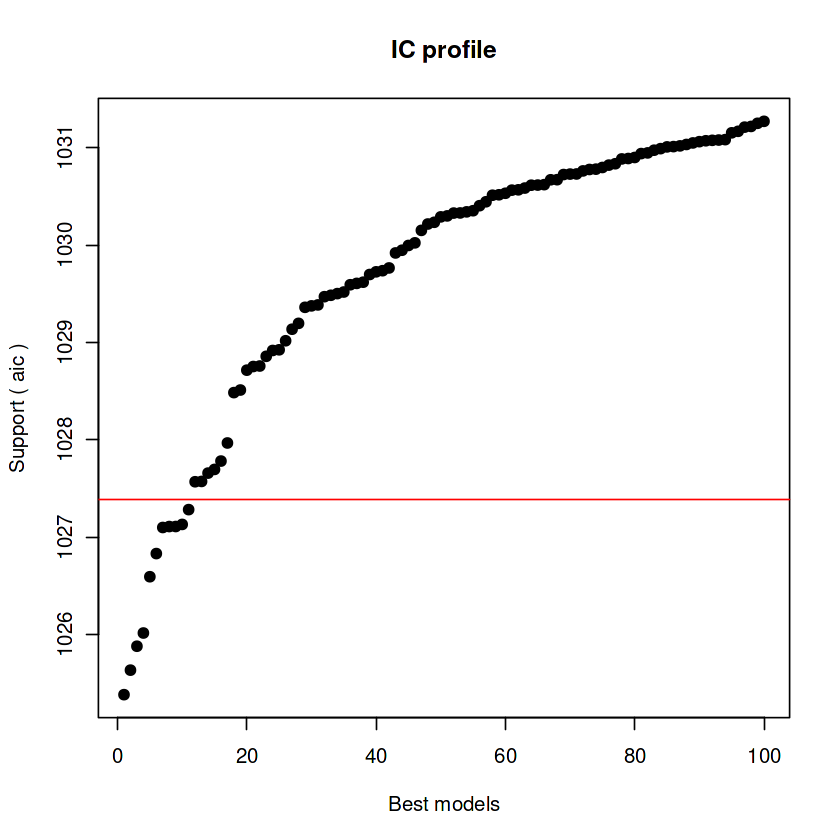


After 359050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1029.19898515461


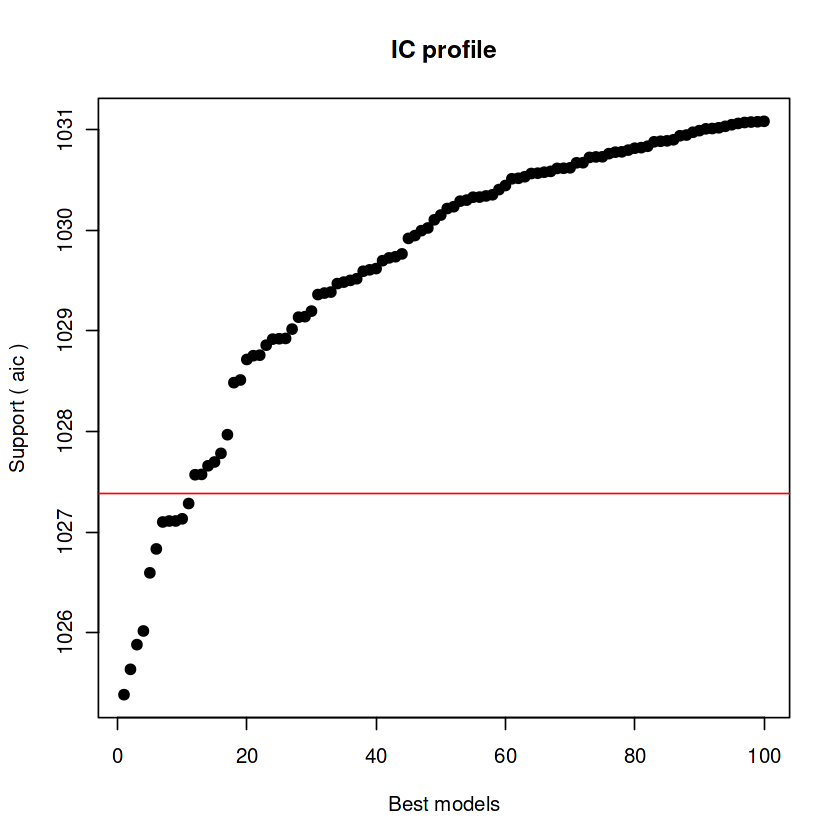


After 359100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1028.94757508645


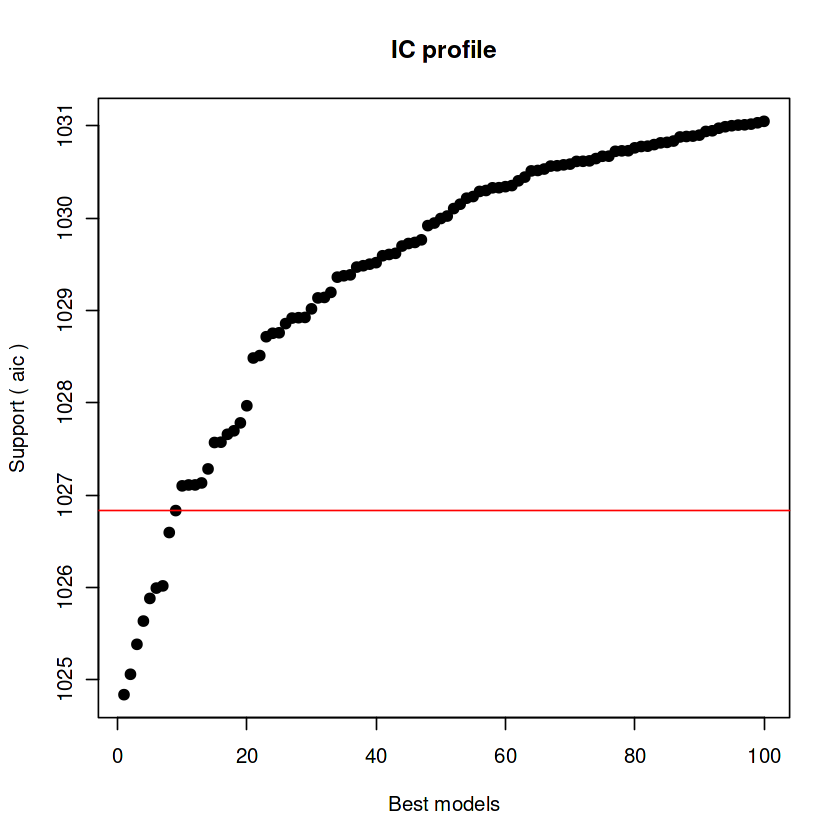


After 359150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1028.88303419493


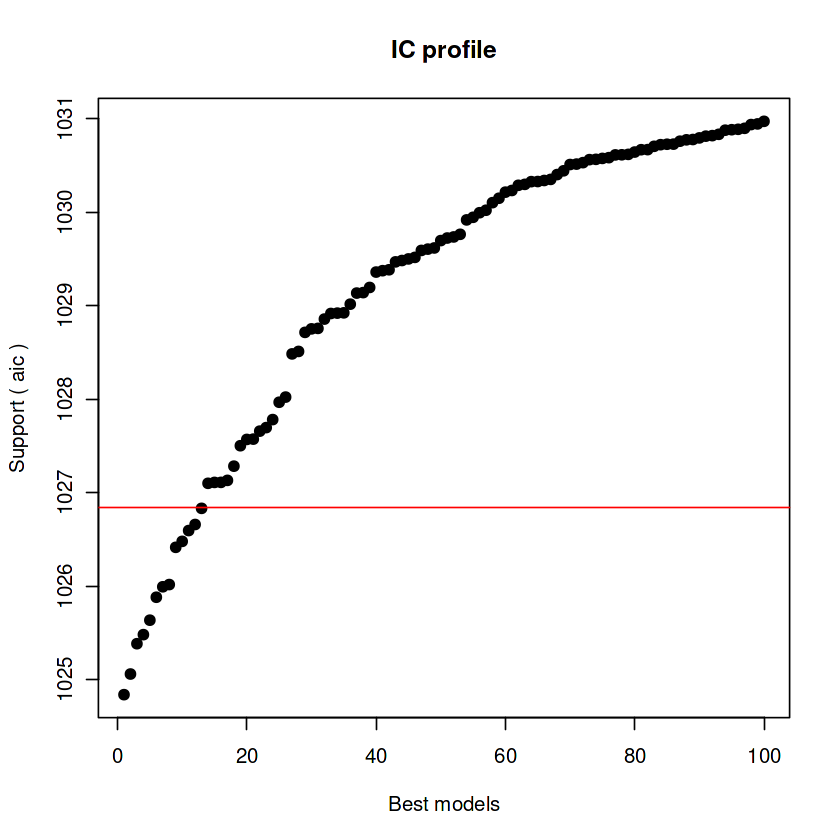


After 359200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1028.84001367049


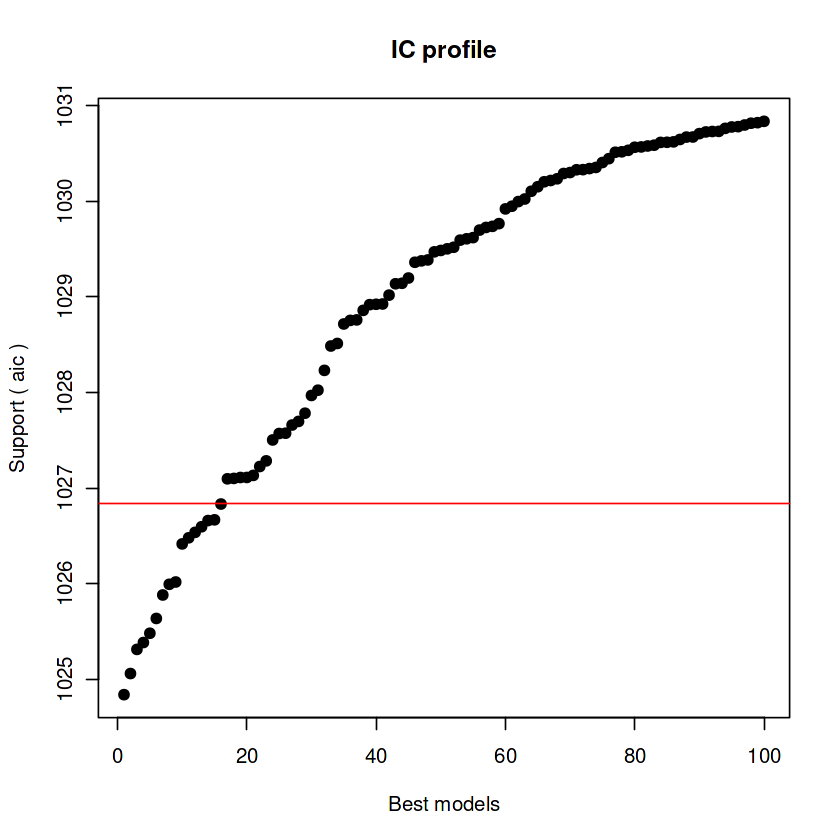


After 359250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1028.77738188865


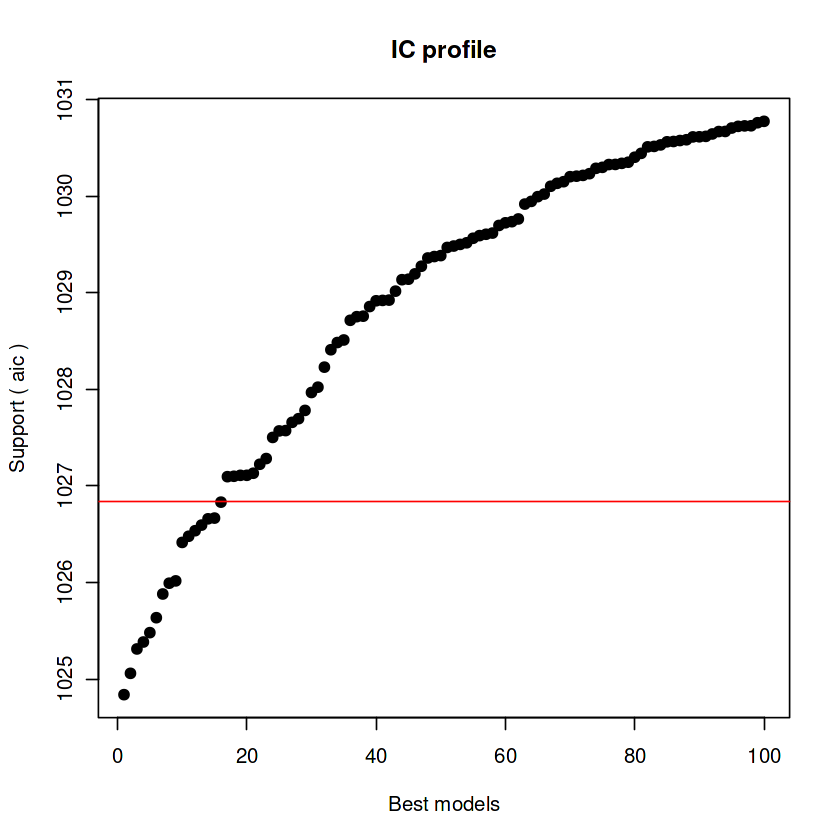


After 359300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1028.53650346194


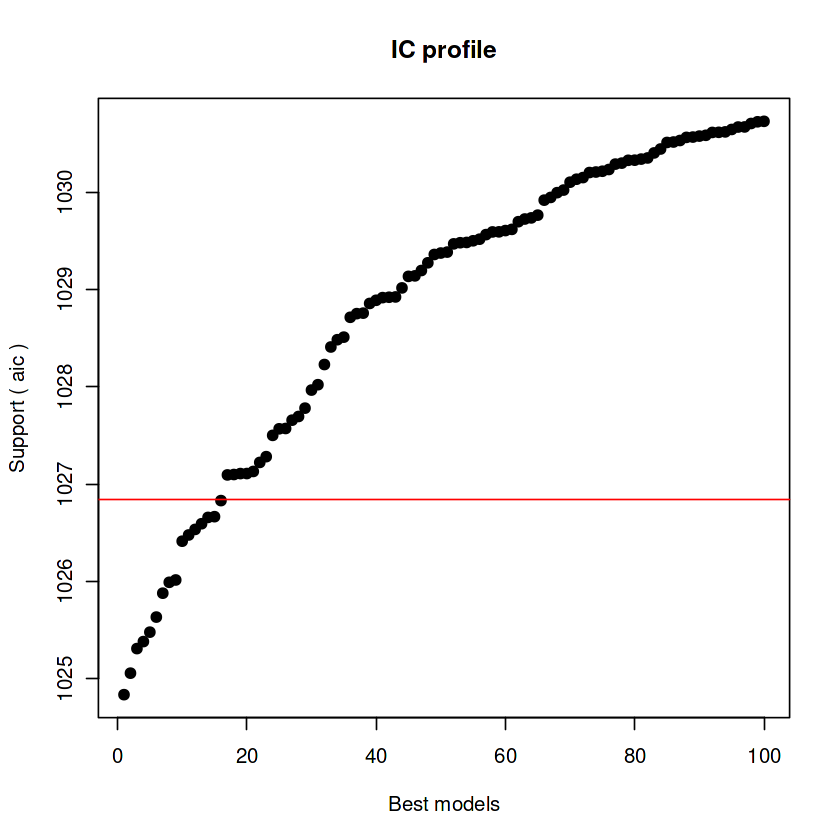


After 359350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1028.30148307519


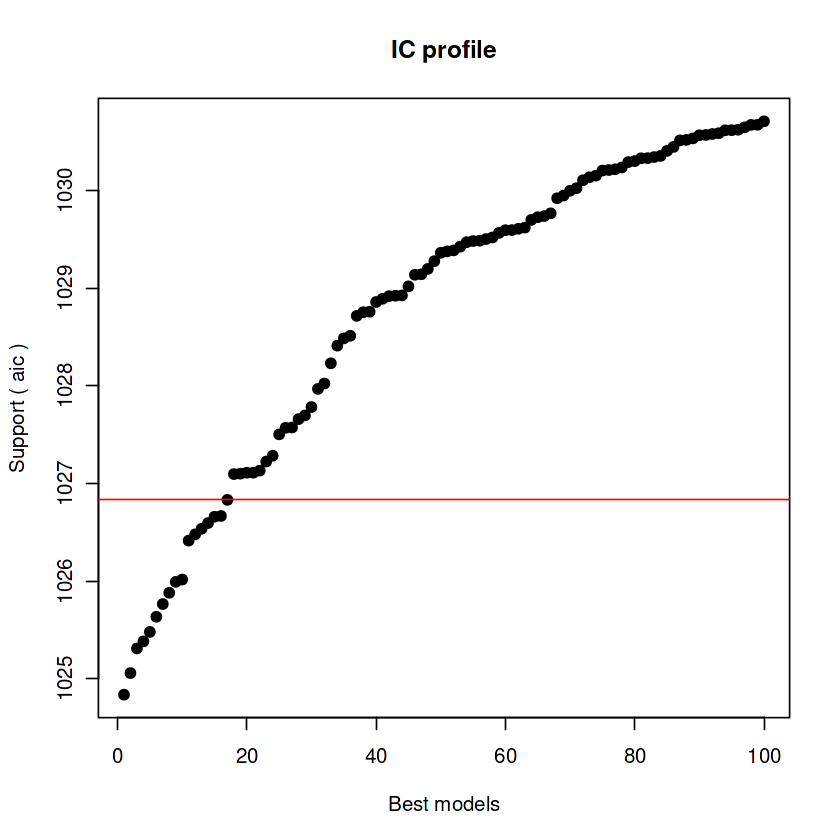


After 359400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1028.21979273461


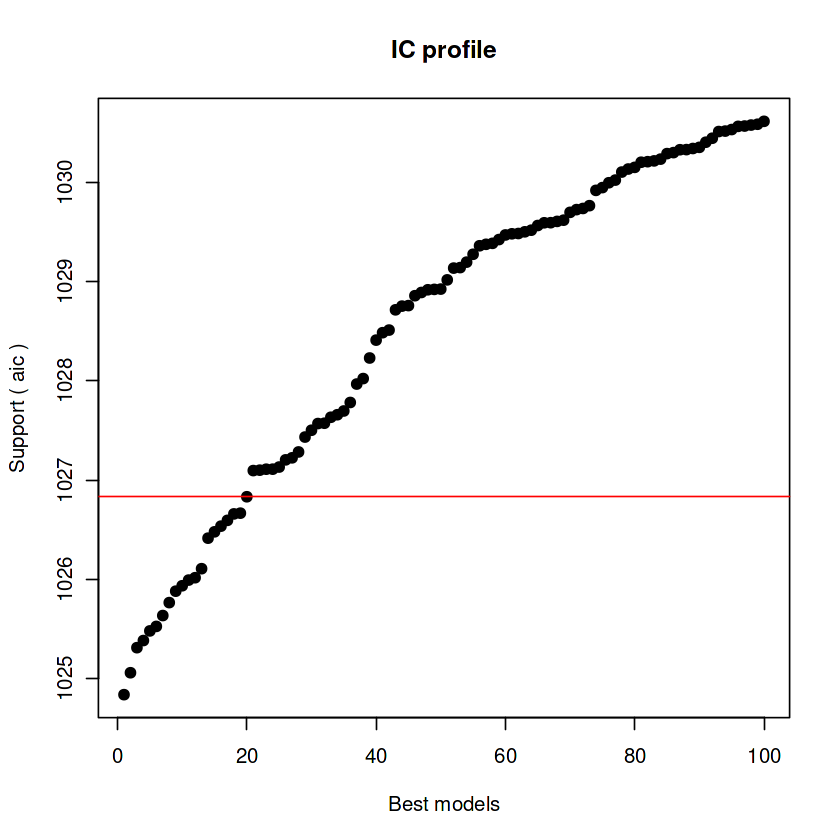


After 359450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1028.21979273461


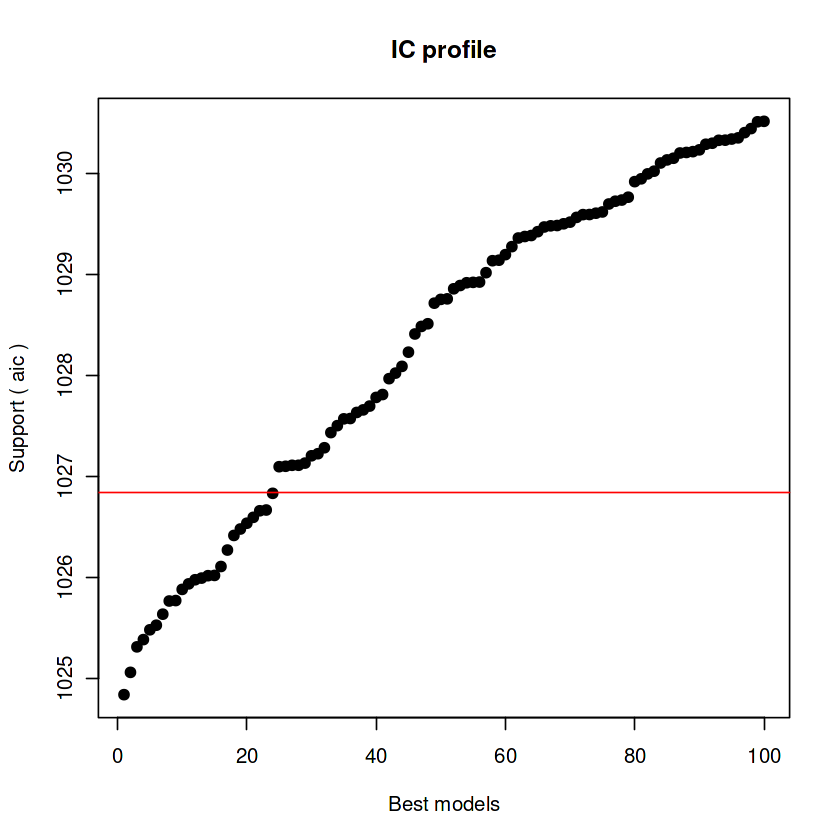


After 359500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1028.21683418245



After 359550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1028.05365454345


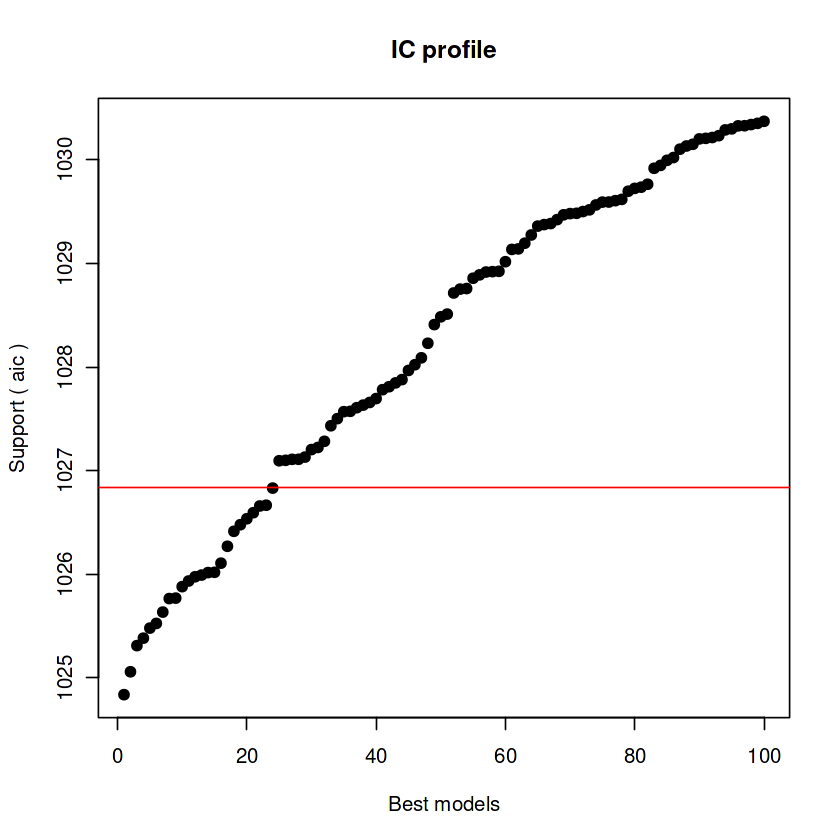


After 359600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.90218306263


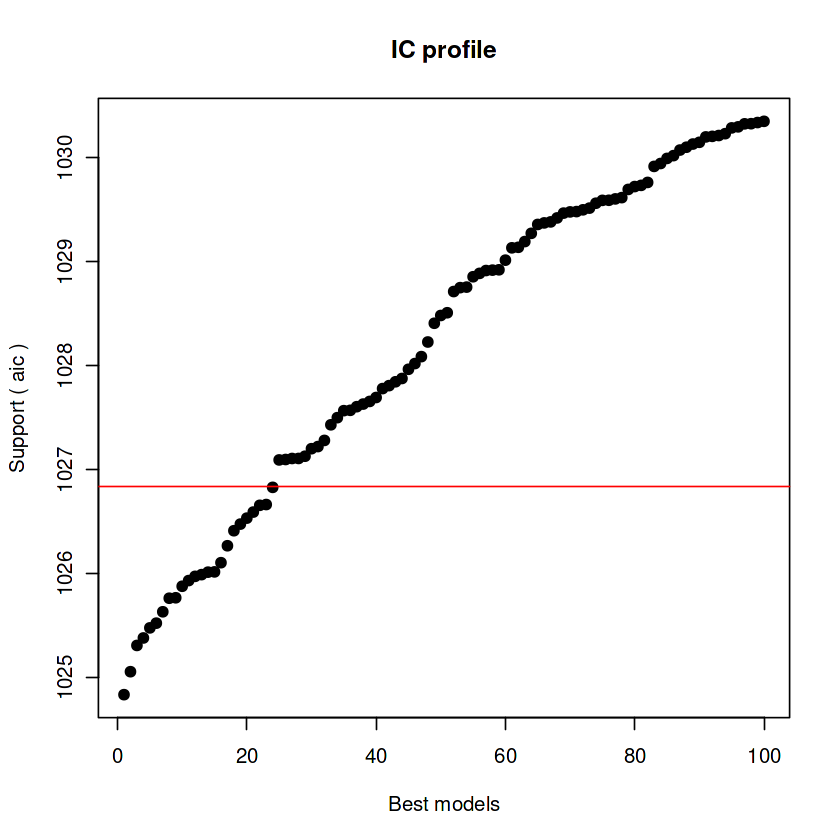


After 359650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.80454267883


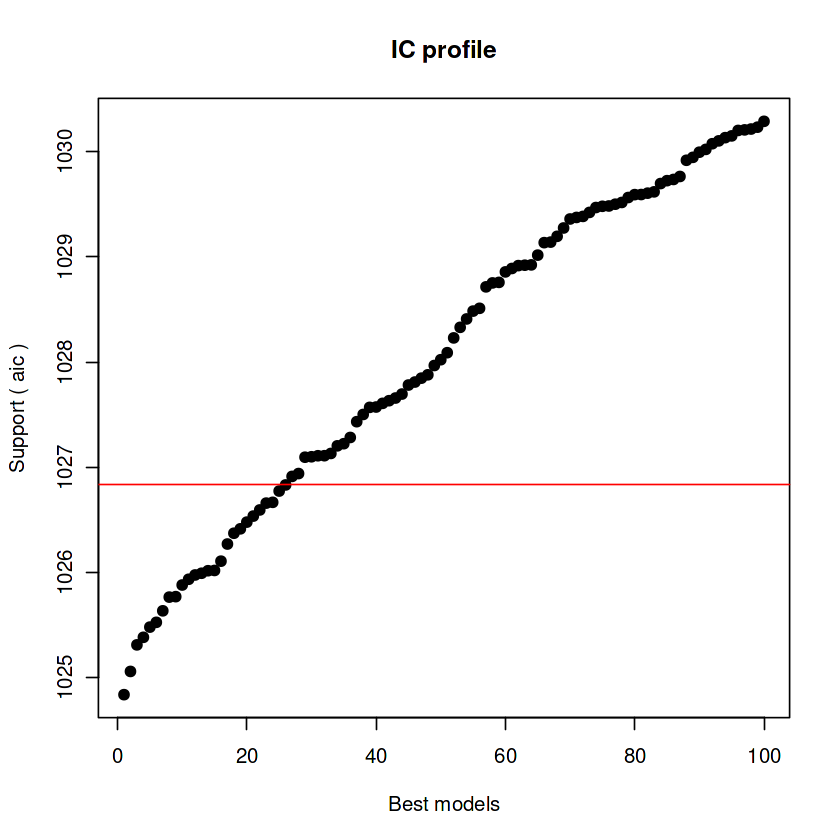


After 359700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.79349074049


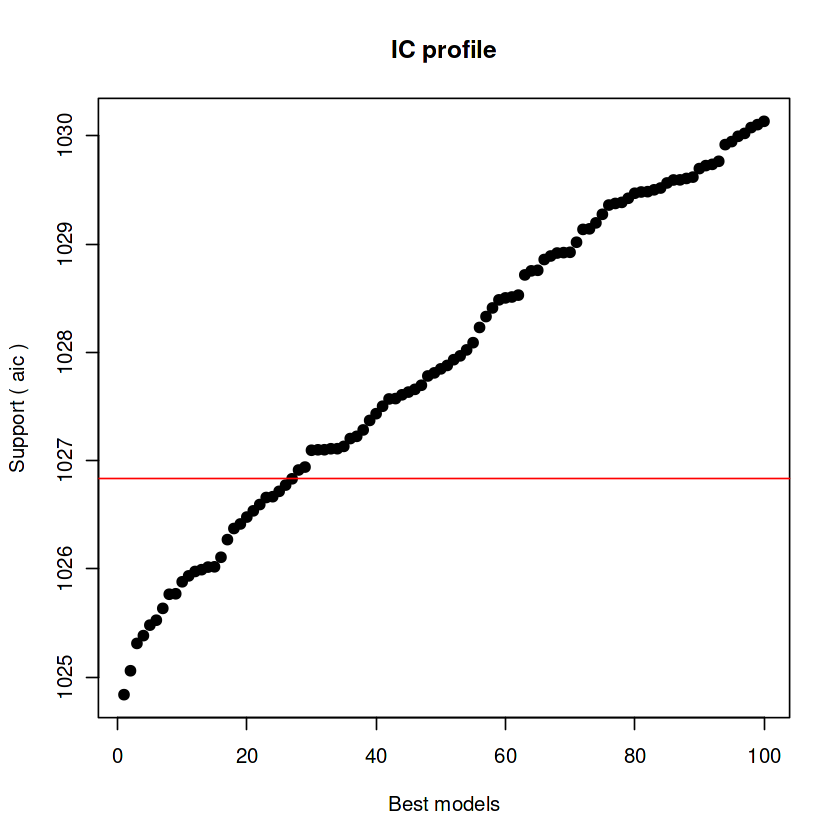


After 359750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.75759122228


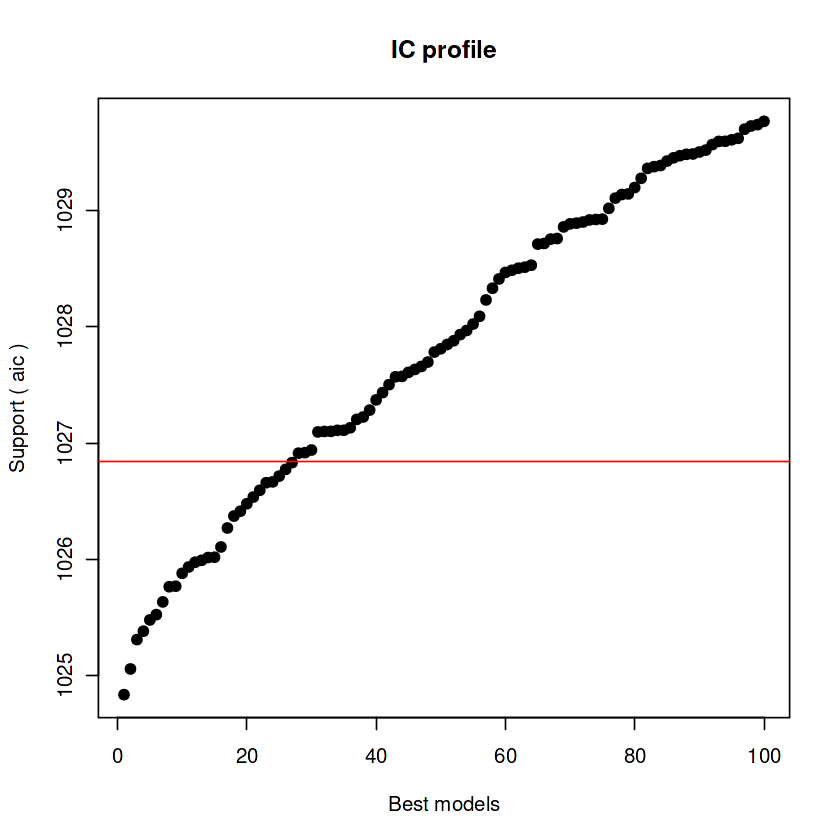


After 359800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.63074076502


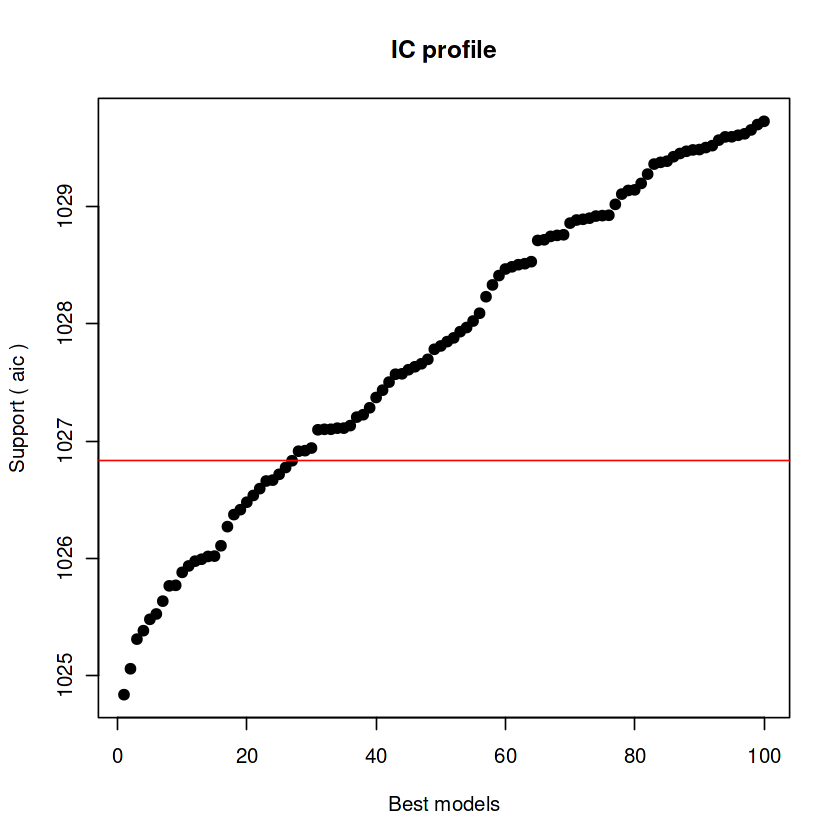


After 359850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.46695846658


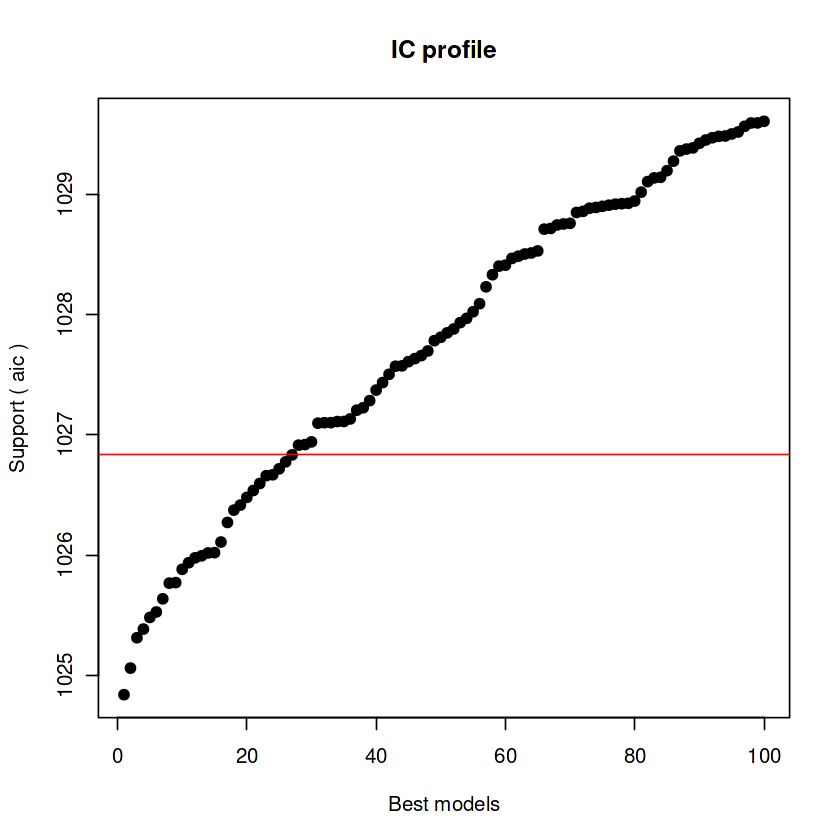


After 359900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.28347300392


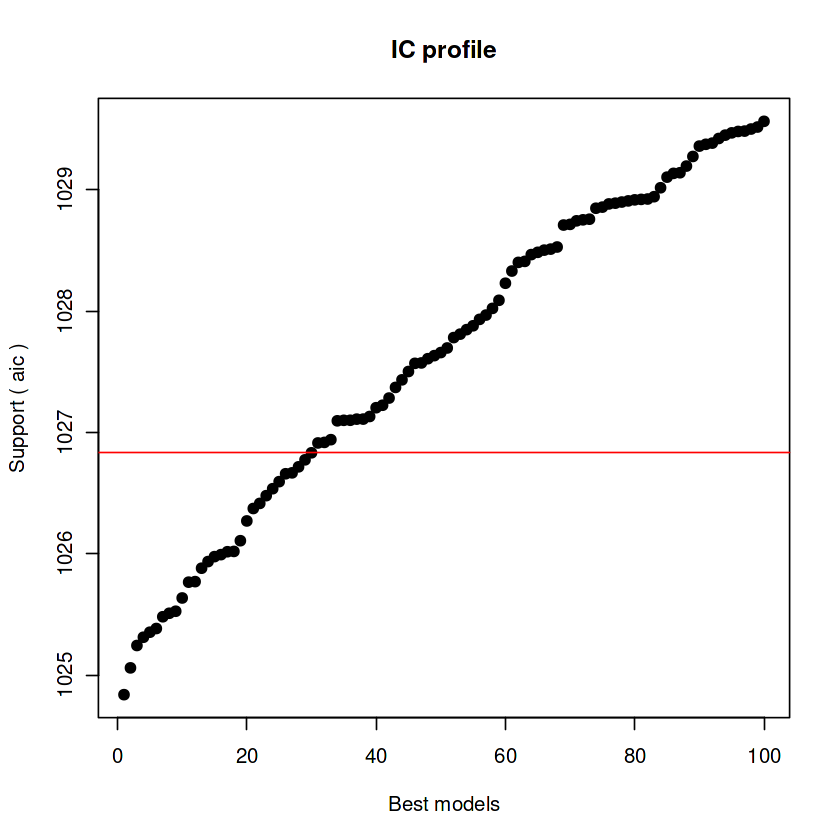


After 359950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.28347300392


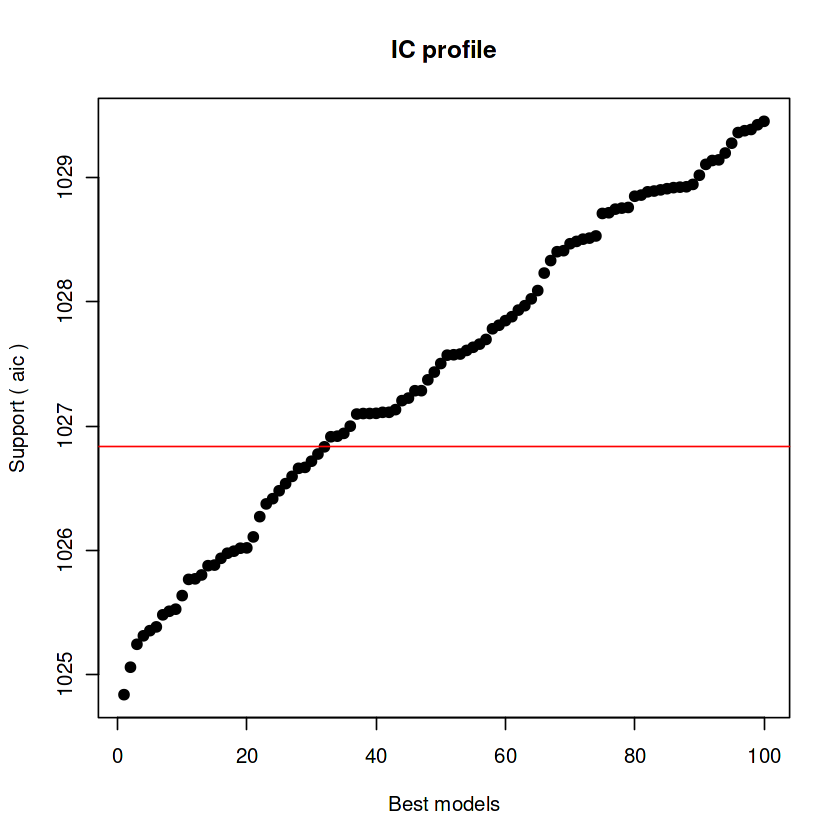


After 360000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.28347300392



After 360050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.23026960181



After 360100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.14513360096


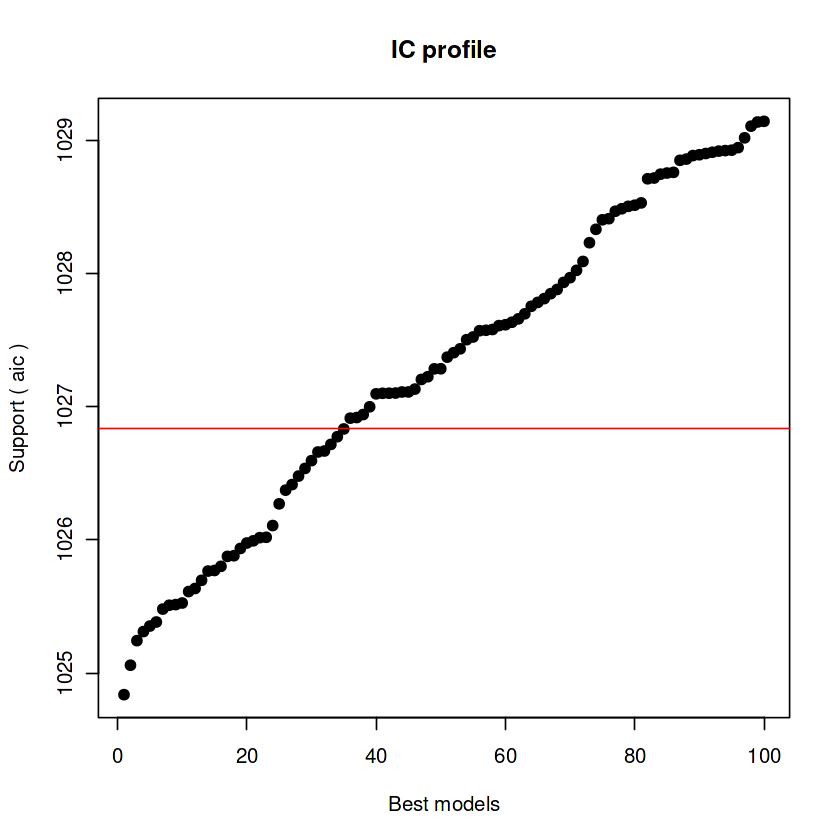


After 360150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.05634956114


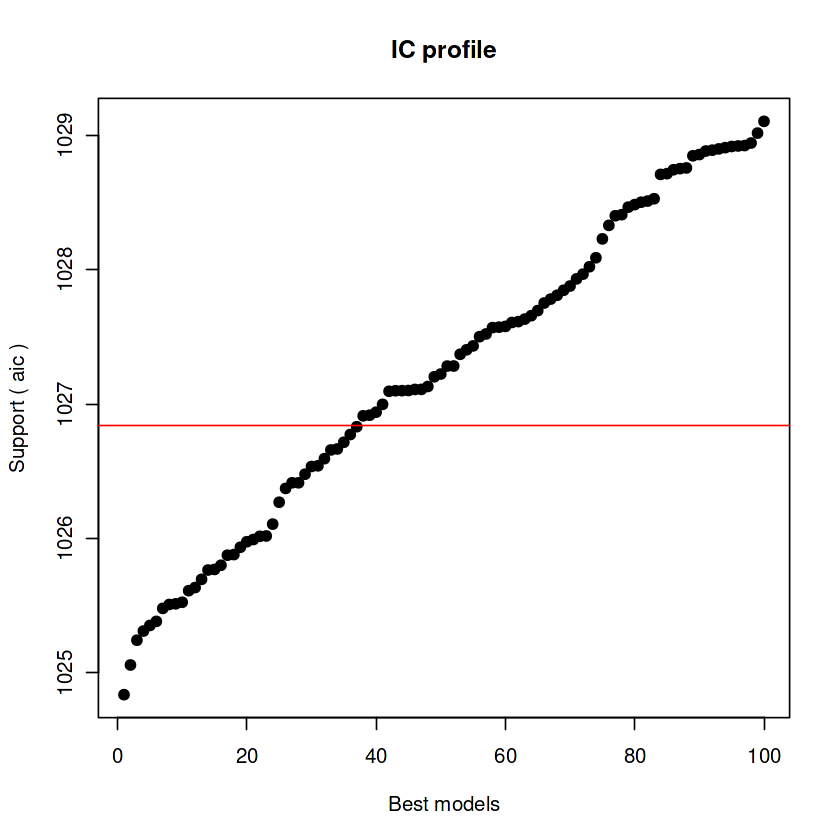


After 360200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094


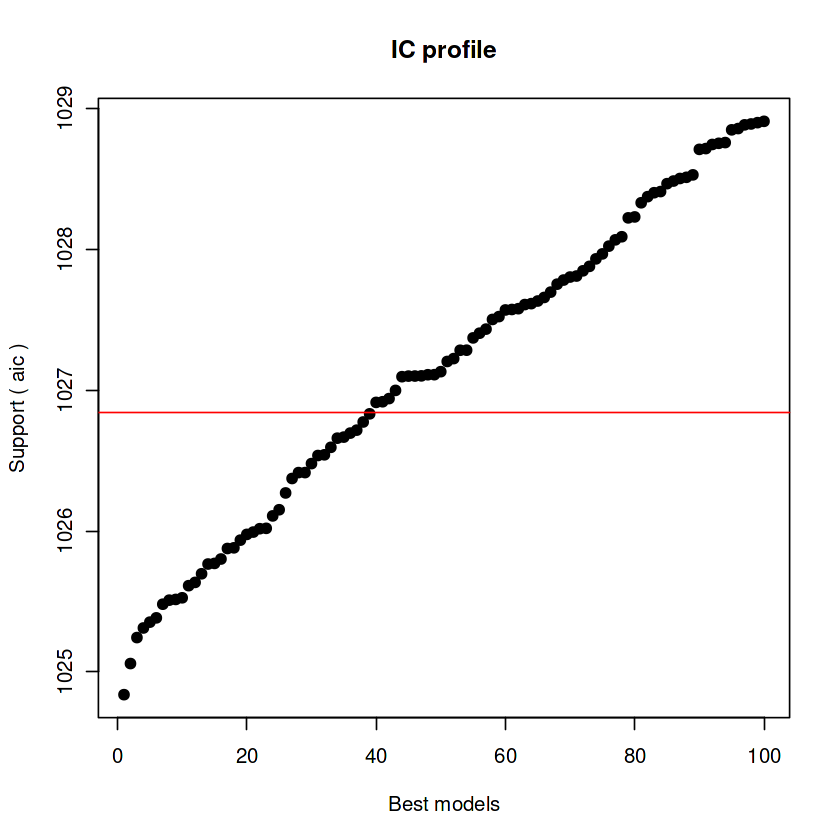


After 360250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094


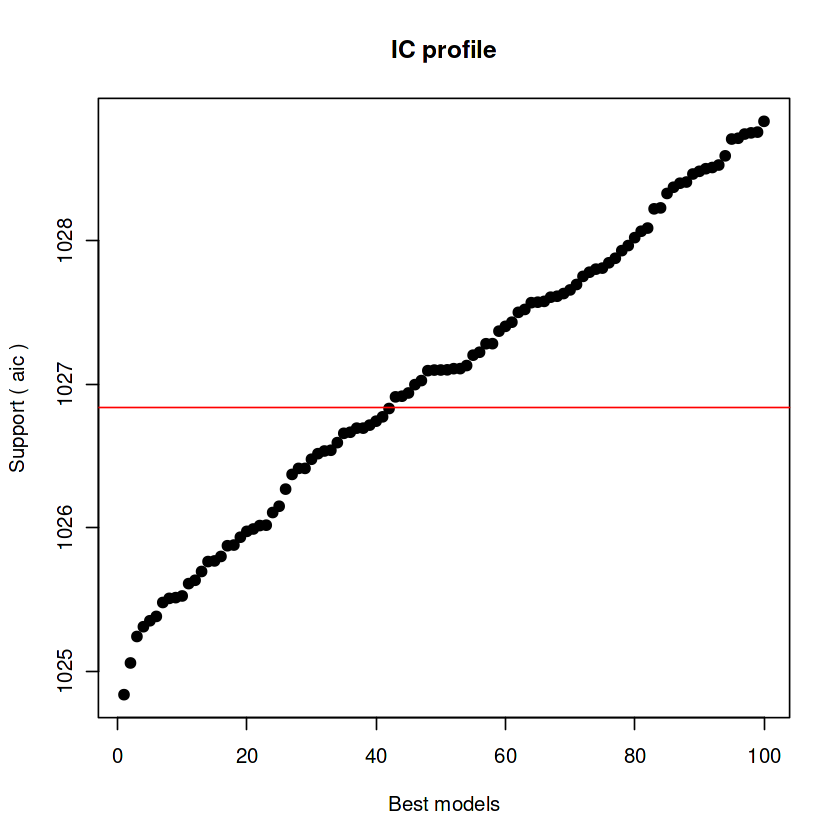


After 360300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 360950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 361950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 362000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 362050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 362100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 362150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 362200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 362250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 362300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 362350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 362400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.04928449094



After 362450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.0487611717



After 362500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.0487611717


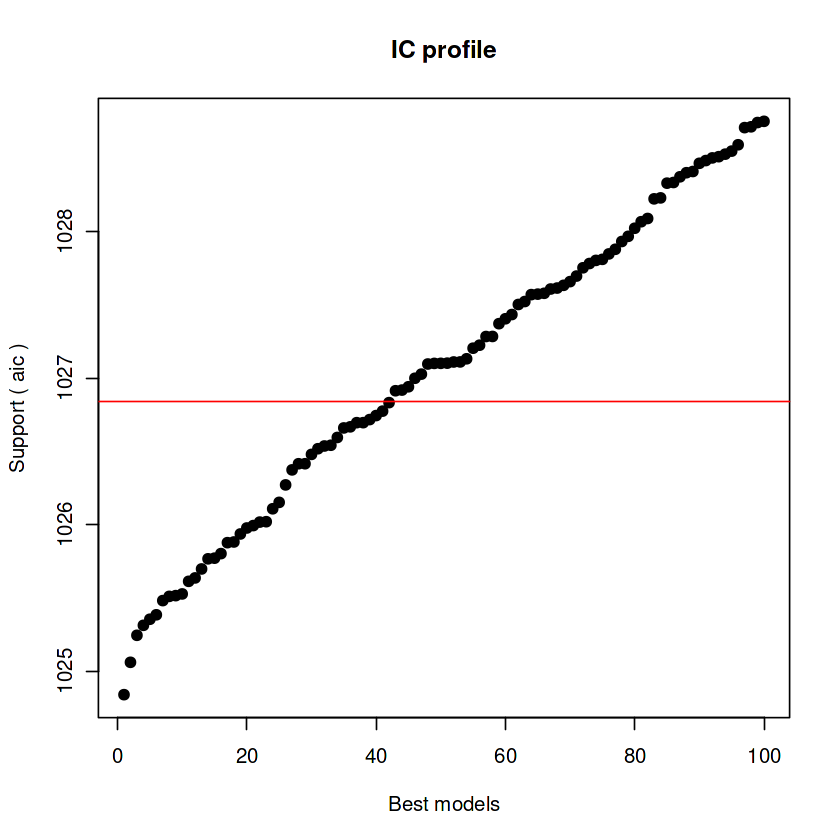


After 362550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.0487611717



After 362600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.0487611717



After 362650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.0487611717



After 362700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1027.002744839



After 362750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1026.96104908595


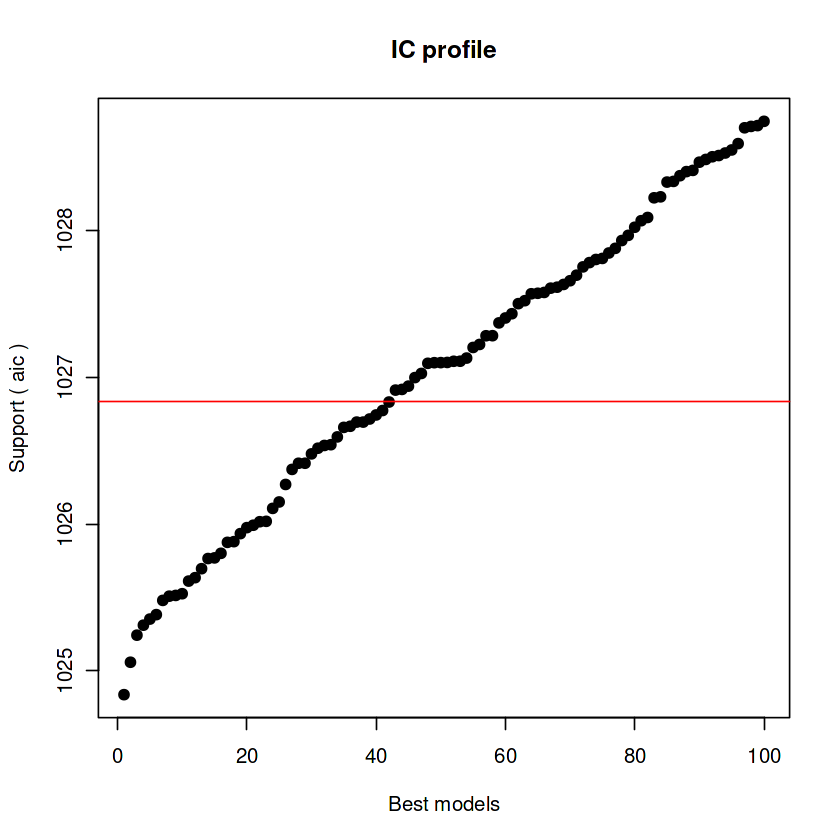


After 362800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1026.90276585355


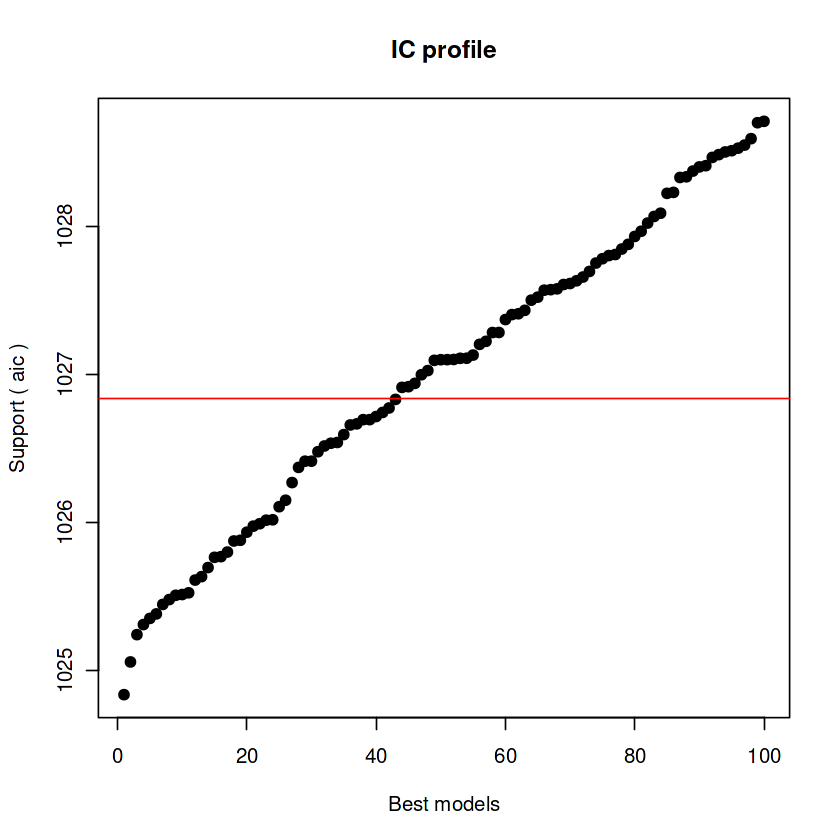


After 362850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1026.90276585355


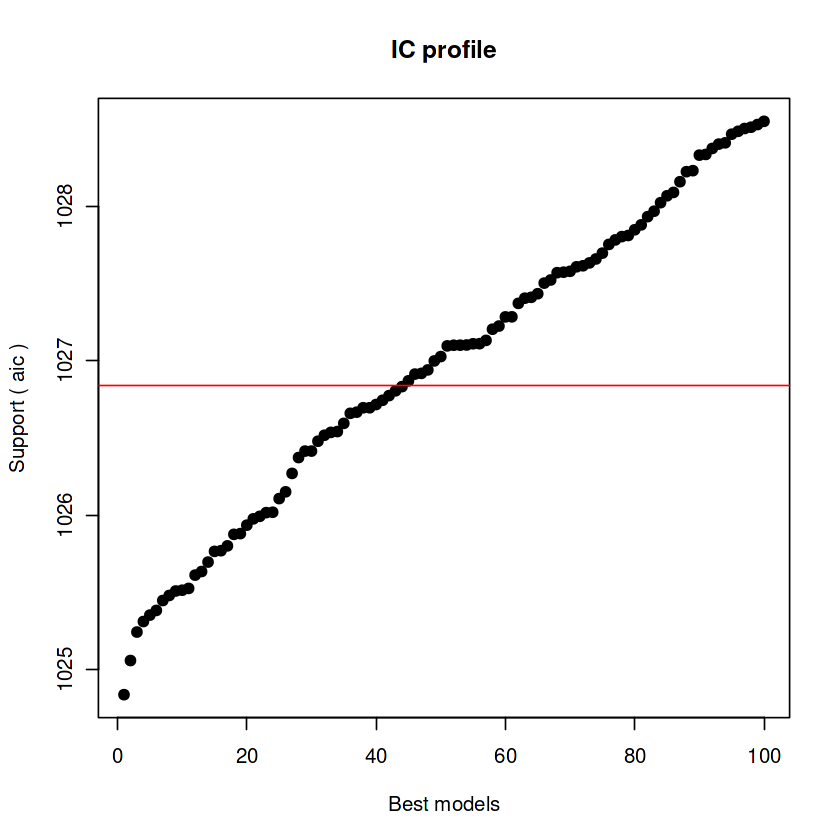


After 362900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1026.90276585355



After 362950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1026.90276585355



After 363000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1026.88105251455



After 363050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1026.86508871639


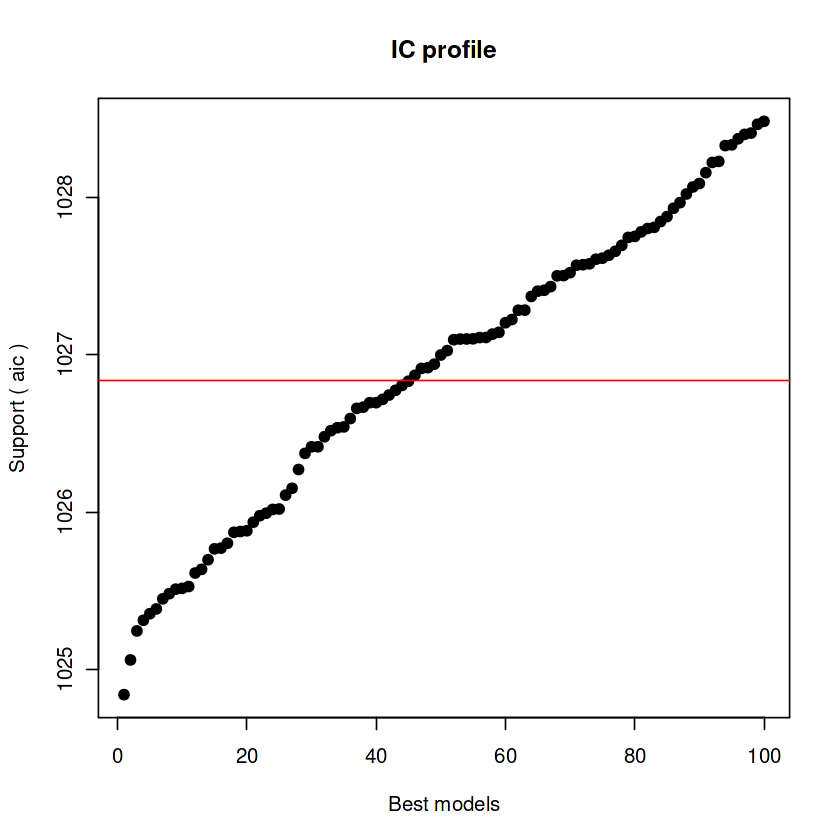


After 363100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1026.86508871639


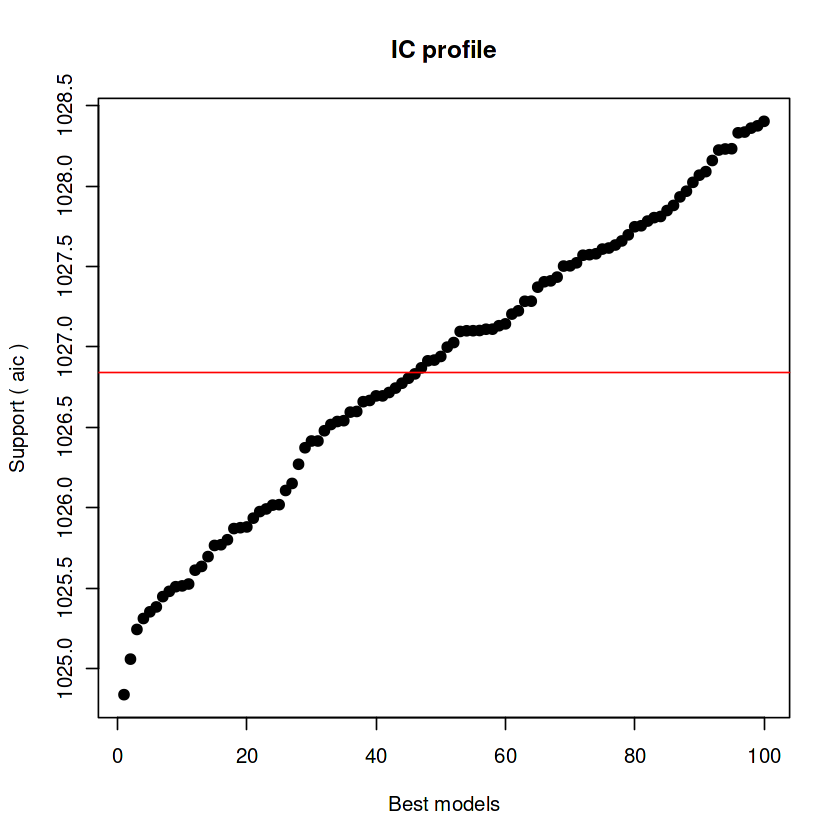


After 363150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1026.86508871639



After 363200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.83858431882
Mean crit= 1026.86508871639



After 363250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.76623608421



After 363300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.67677346356


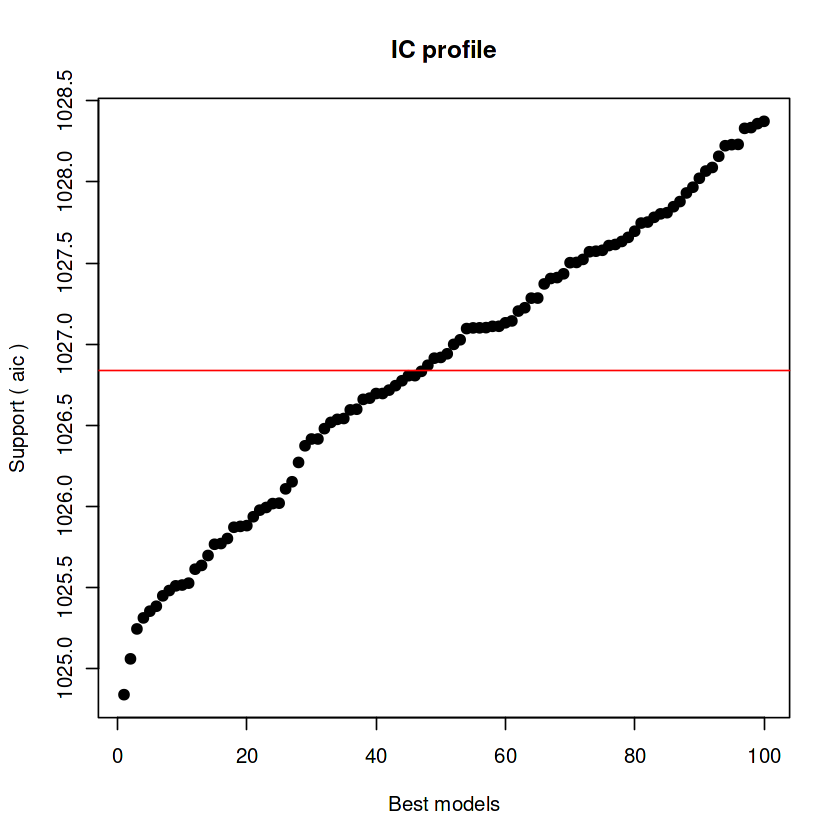


After 363350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.63440854982


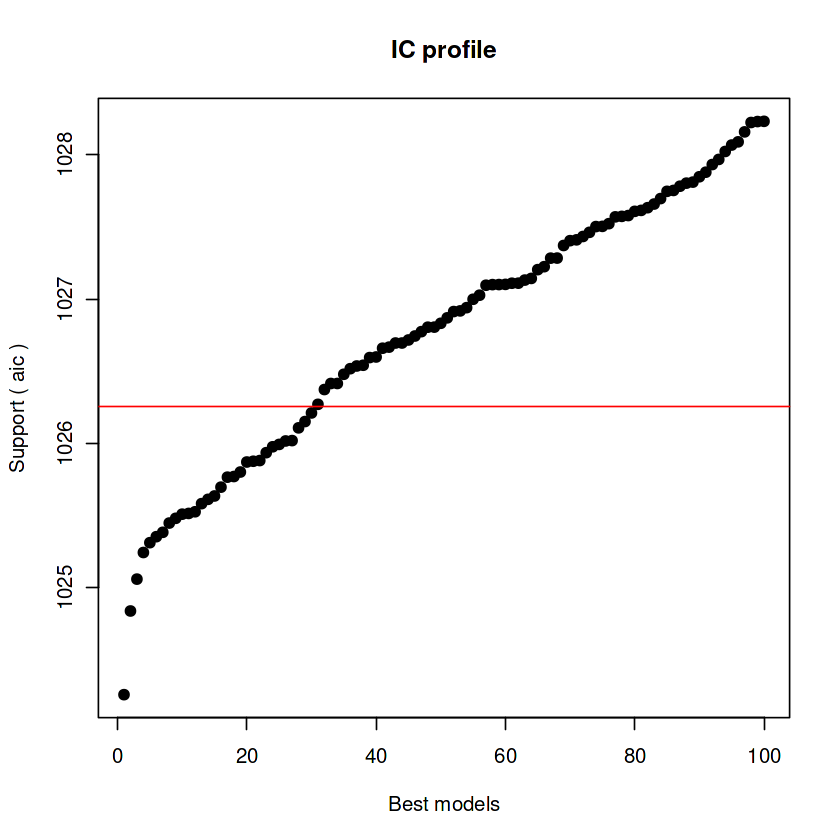


After 363400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.63440854982


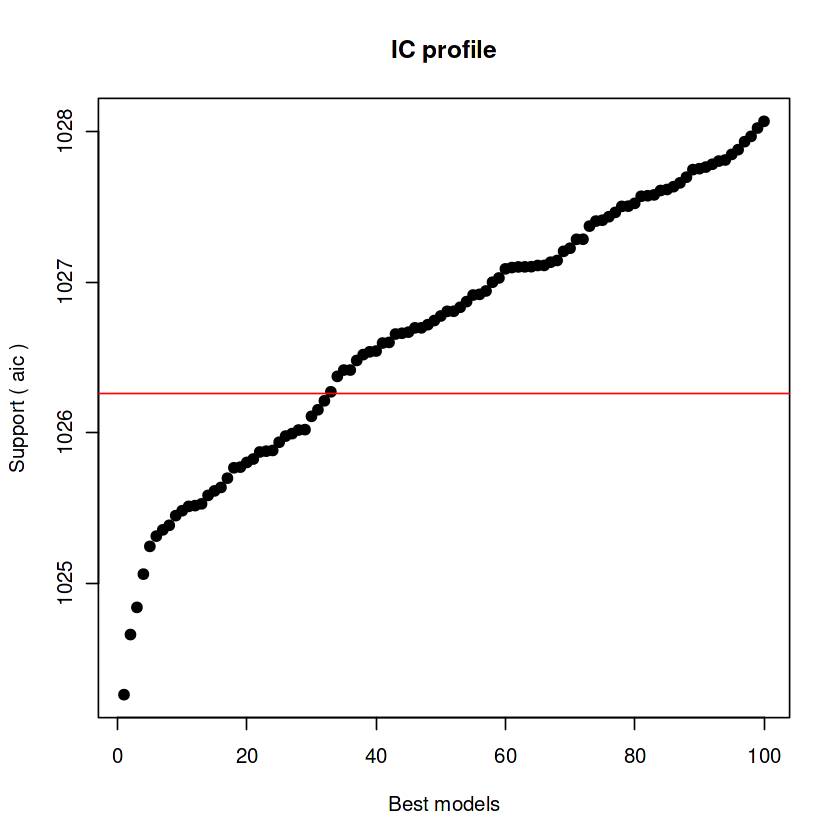


After 363450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.63440854982



After 363500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.58522608941



After 363550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.5509389956


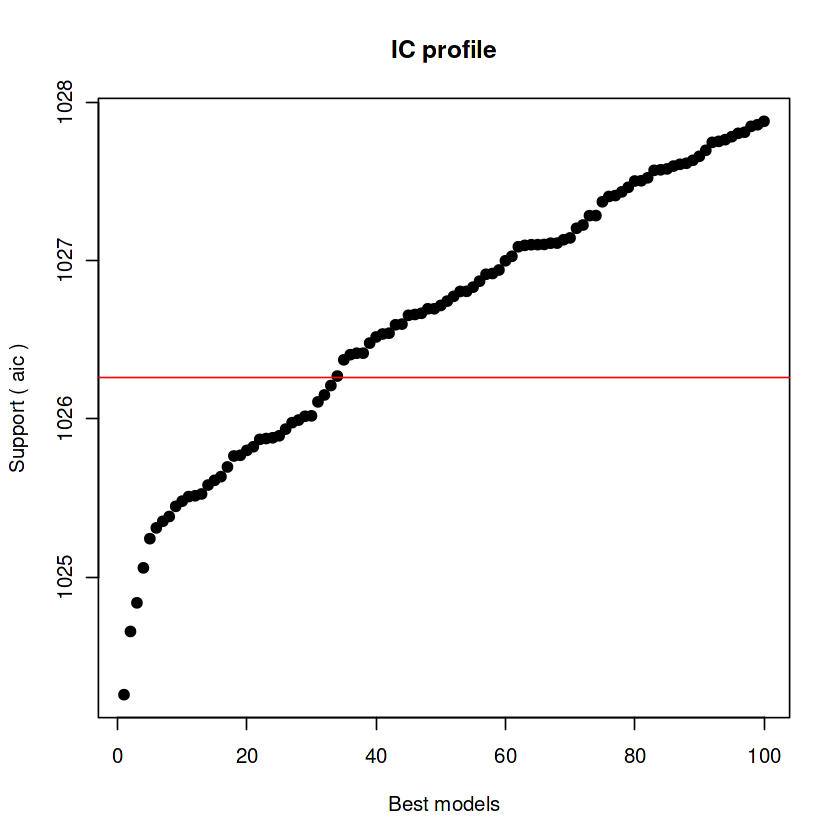


After 363600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.5223407655


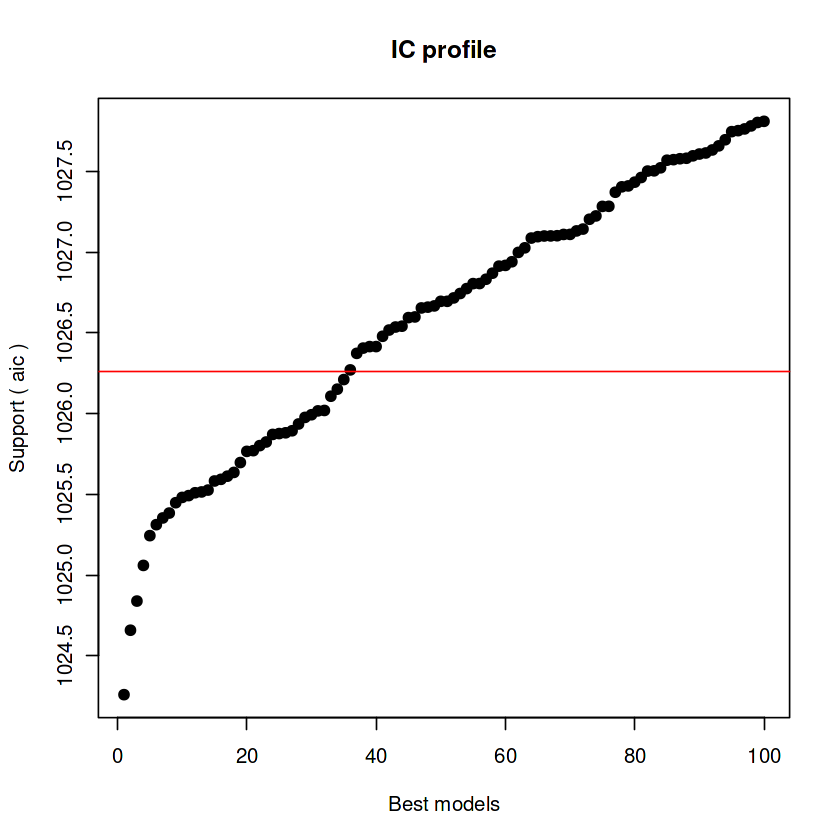


After 363650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.5223407655


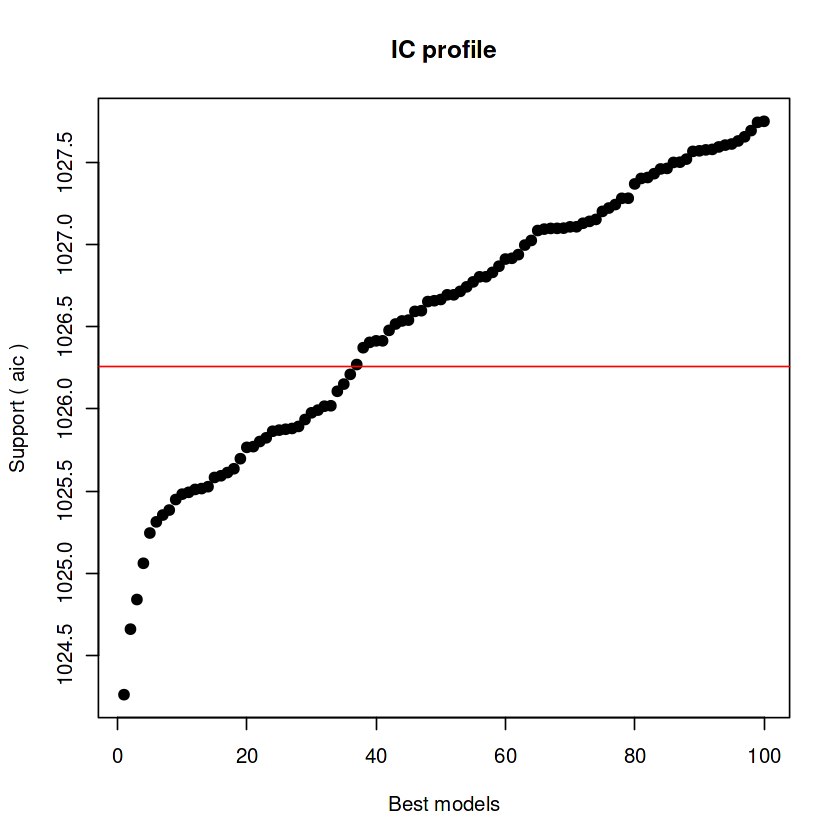


After 363700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.5223407655



After 363750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.51261901851



After 363800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.50061450747


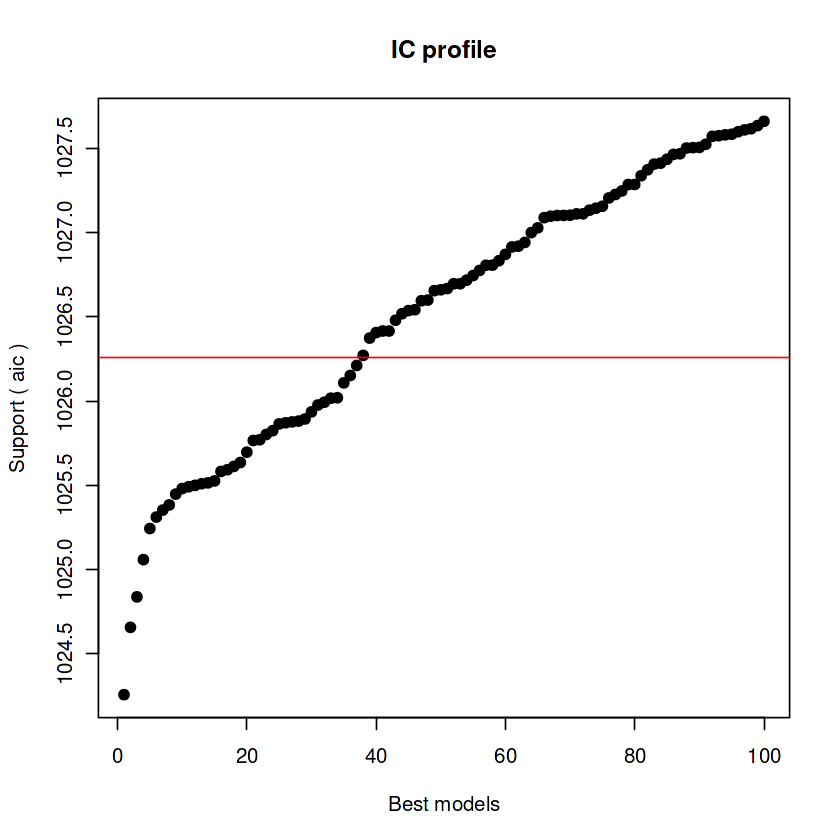


After 363850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.48443225135


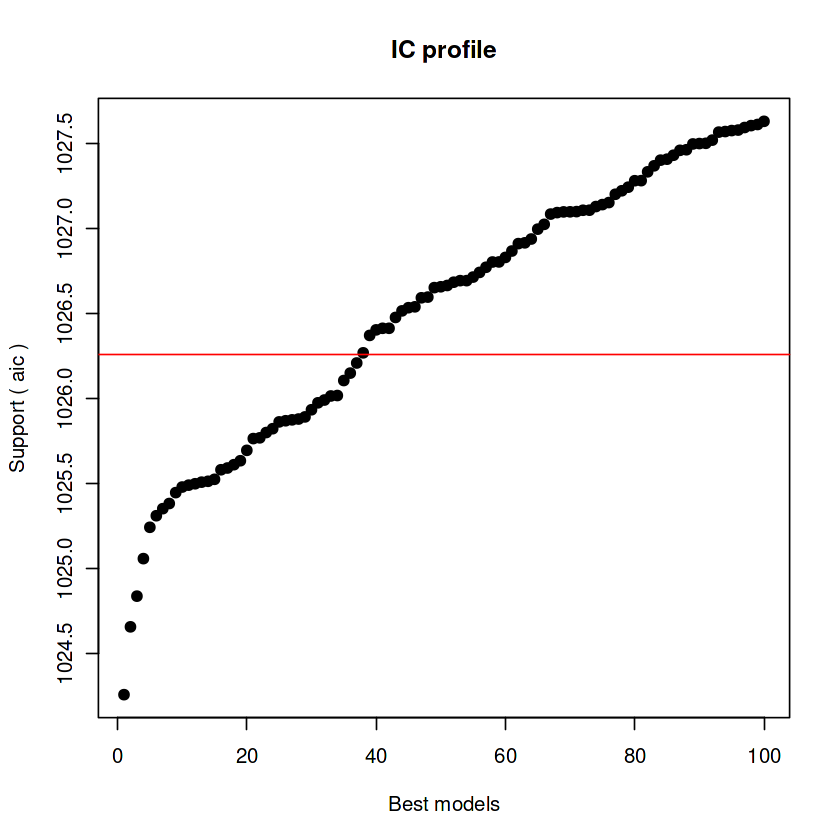


After 363900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.48443225135


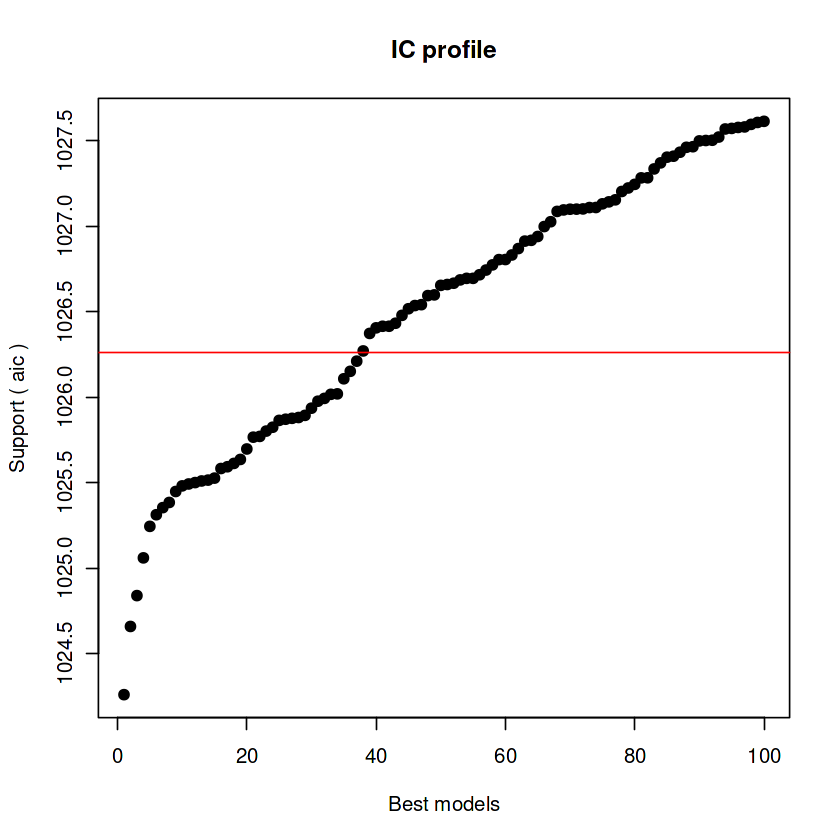


After 363950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.48443225135



After 364000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.48443225135



After 364050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.38755644446



After 364100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.31298905625


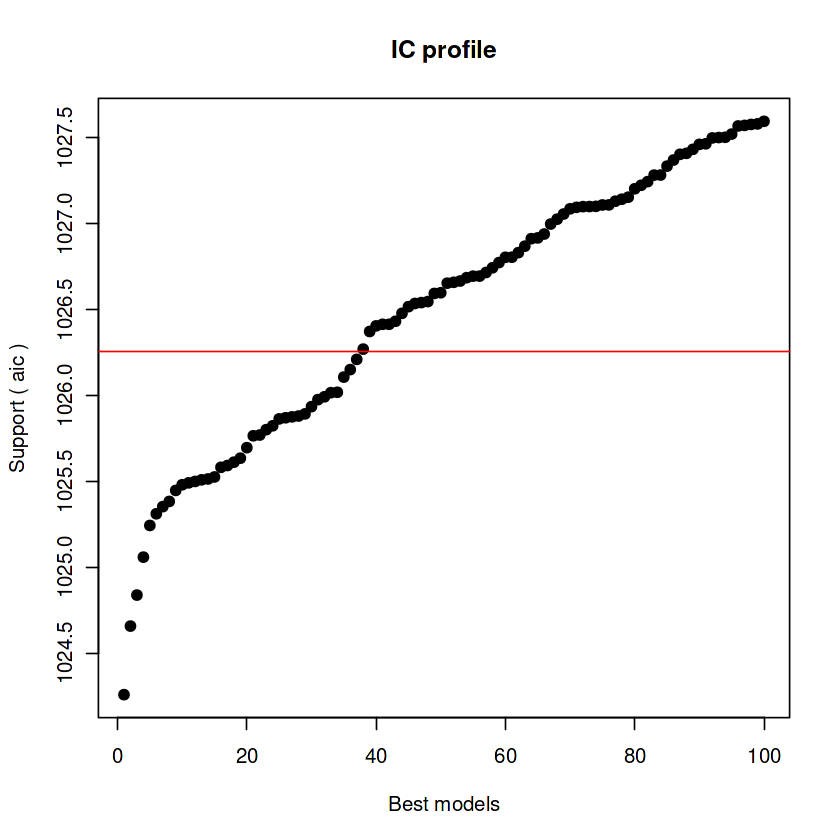


After 364150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.28601405492


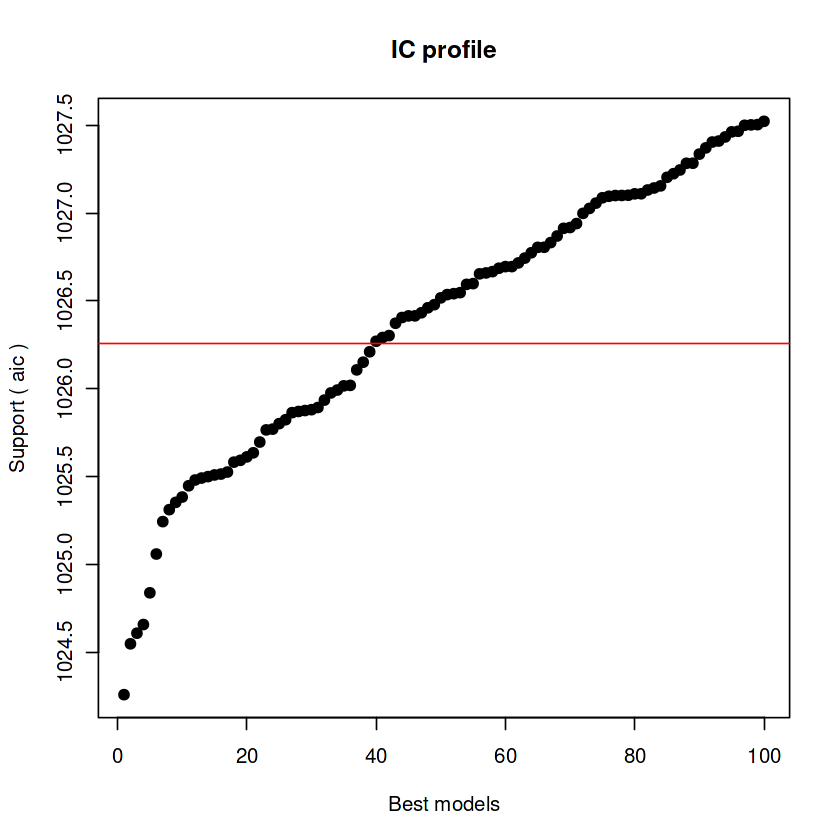


After 364200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.28601405492


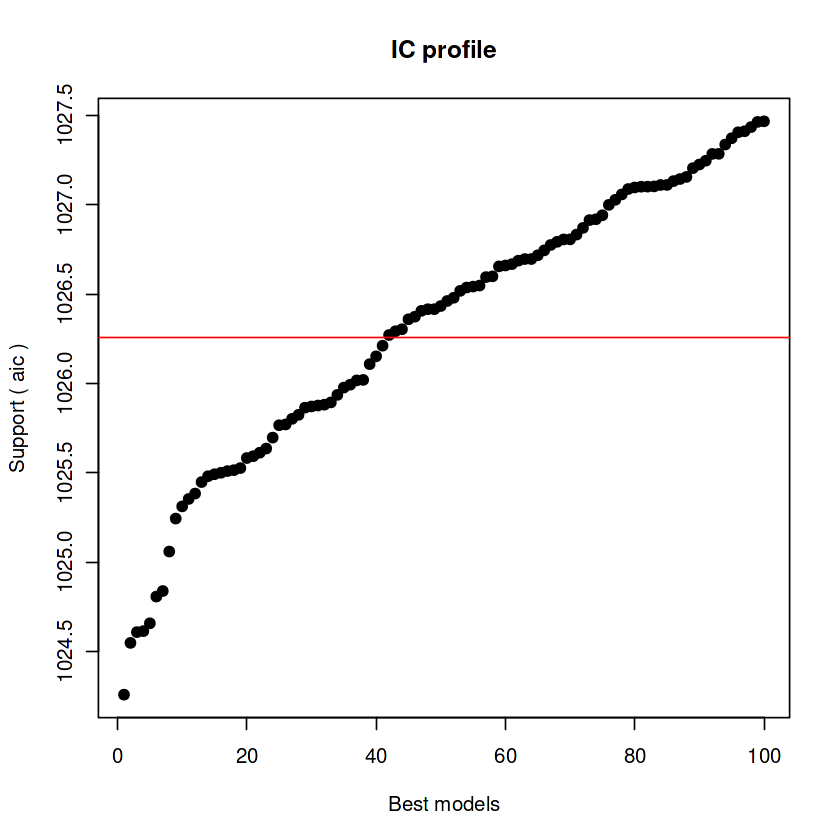


After 364250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.28601405492



After 364300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.25125185849



After 364350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.2376404851


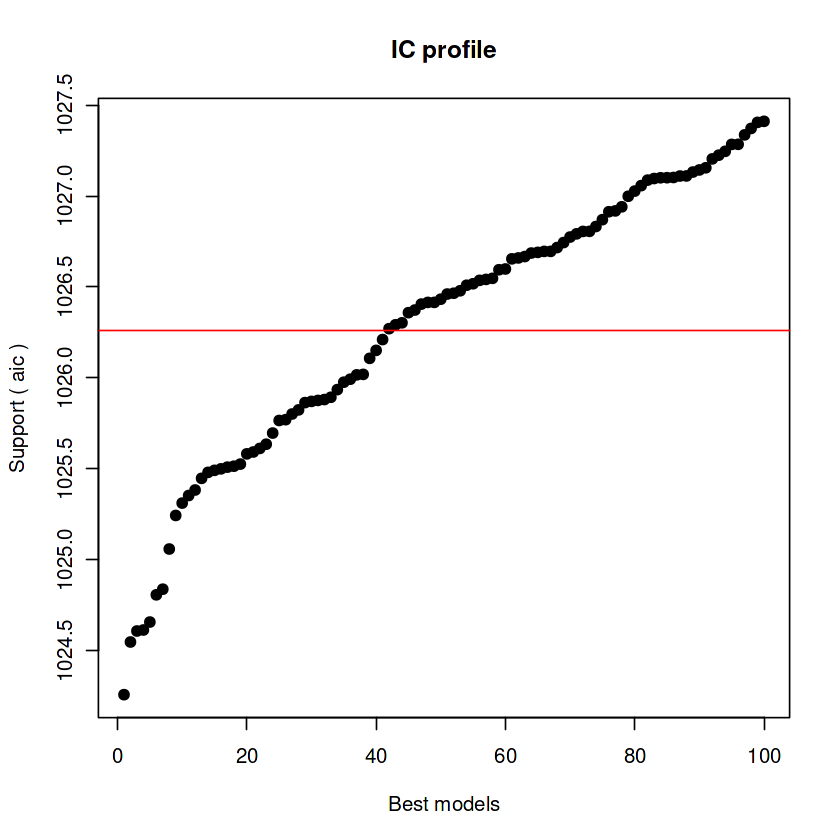


After 364400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592


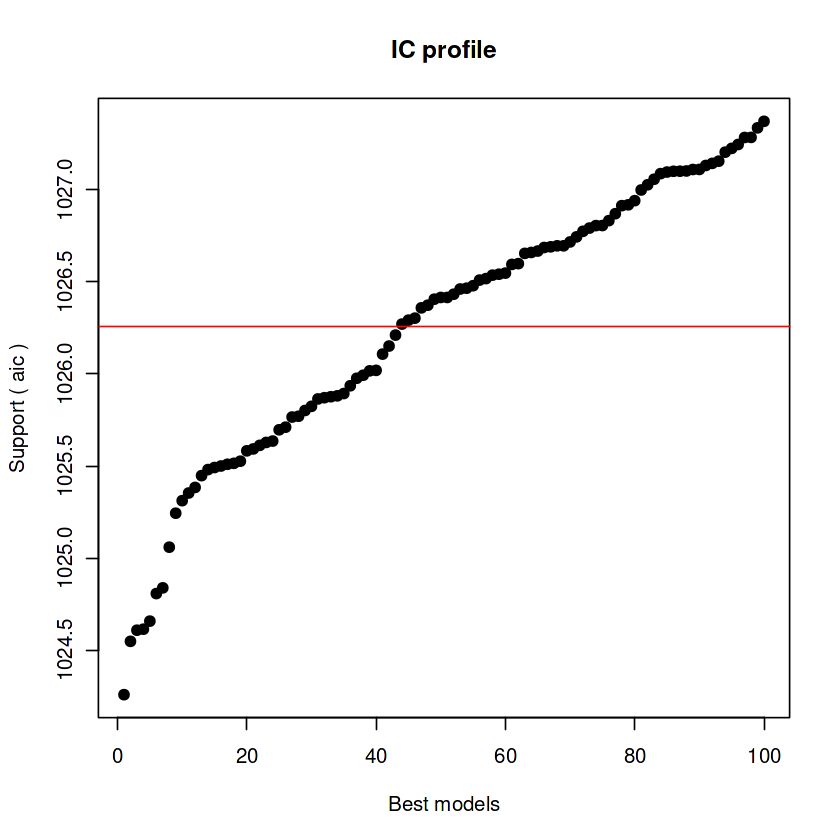


After 364450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592


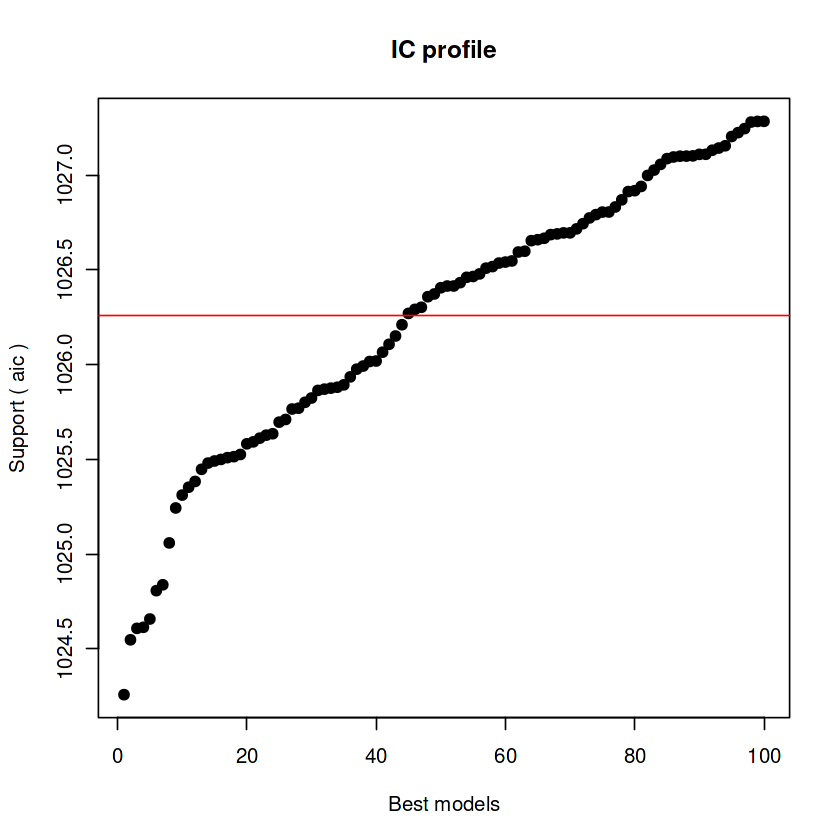


After 364500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 364550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 364600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 364650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 364700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 364750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 364800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 364850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 364900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 364950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 365950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 366950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 367000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 367050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 367100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 367150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 367200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 367250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 367300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 367350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 367400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 367450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.22215936592



After 367500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 367550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235


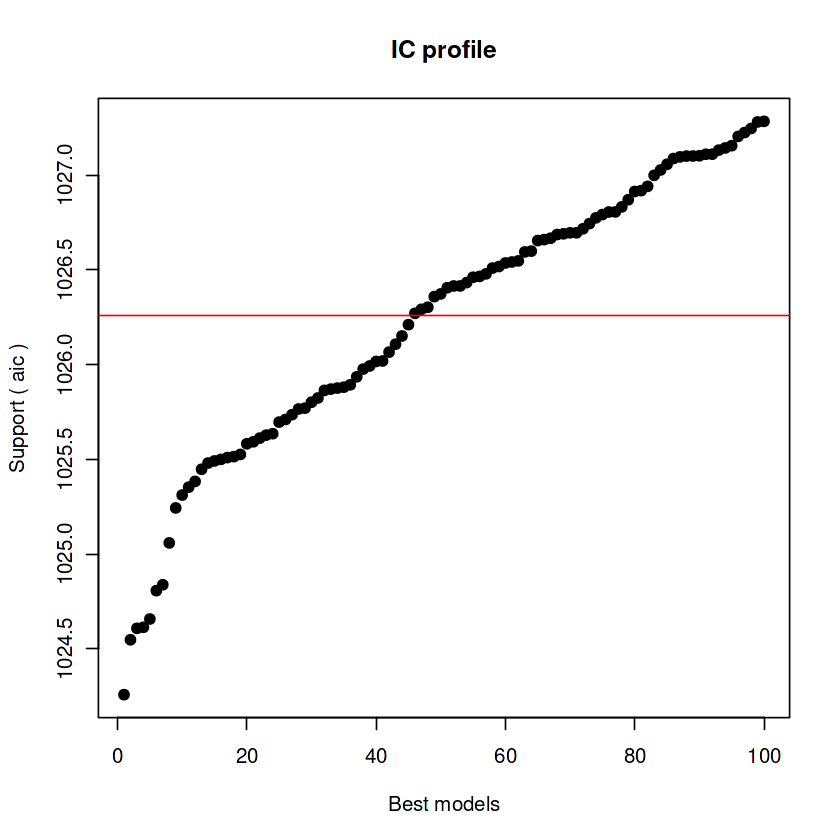


After 367600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 367650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 367700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 367750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 367800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 367850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 367900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 367950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 368000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 368050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 368100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 368150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 368200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 368250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21464265235



After 368300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 368350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514


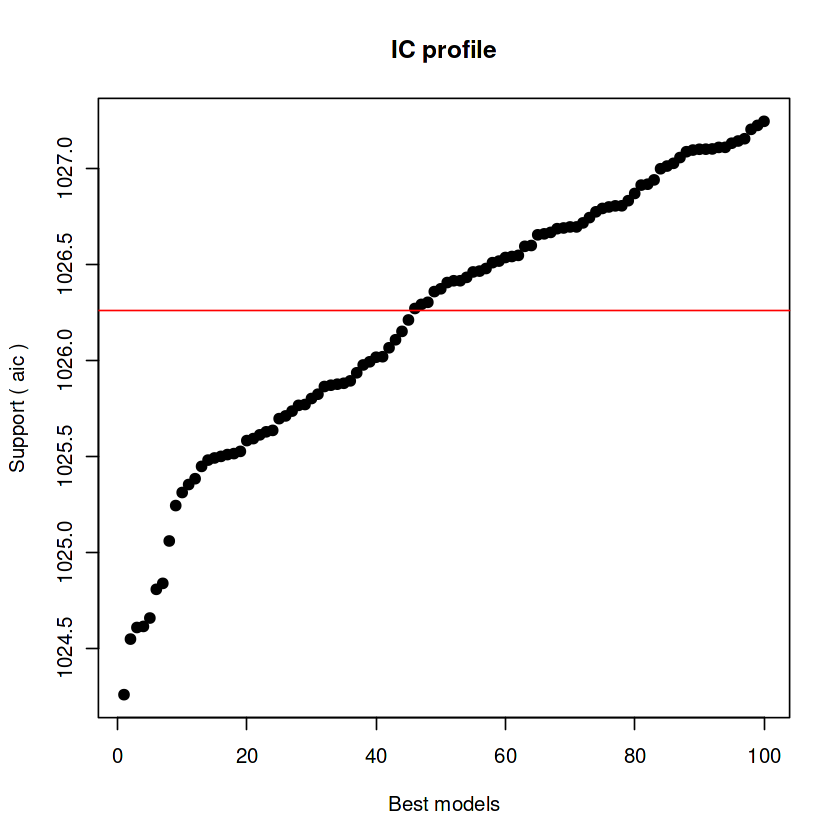


After 368400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 368450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 368500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 368550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 368600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 368650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 368700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 368750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 368800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 368850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 368900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 368950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 369950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 370950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.21187416514



After 371700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.20196508573



After 371750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.20196508573


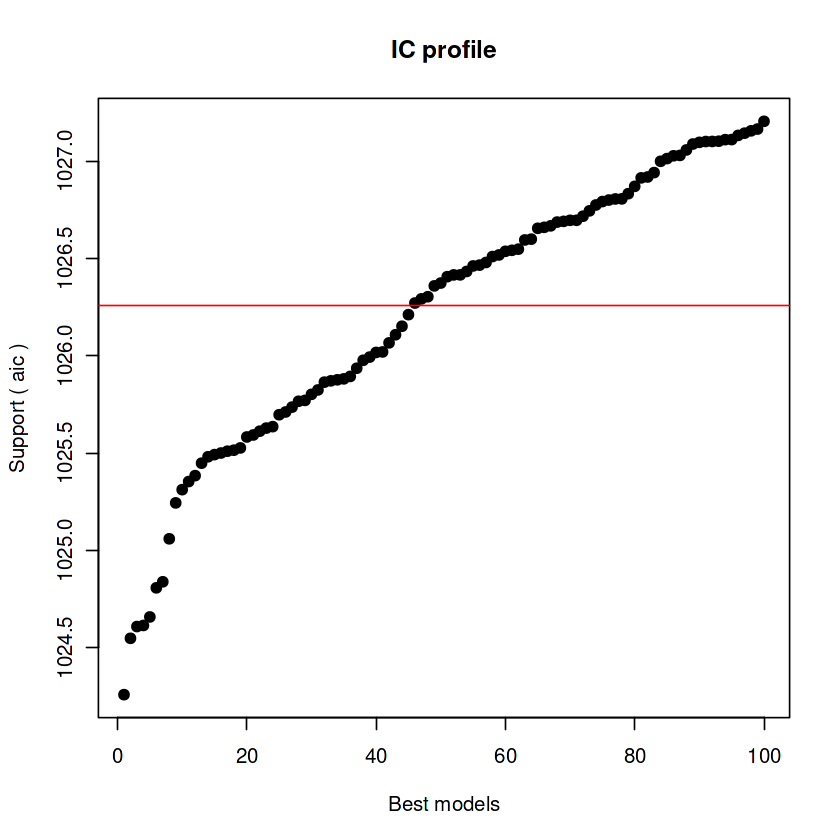


After 371800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 371850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567


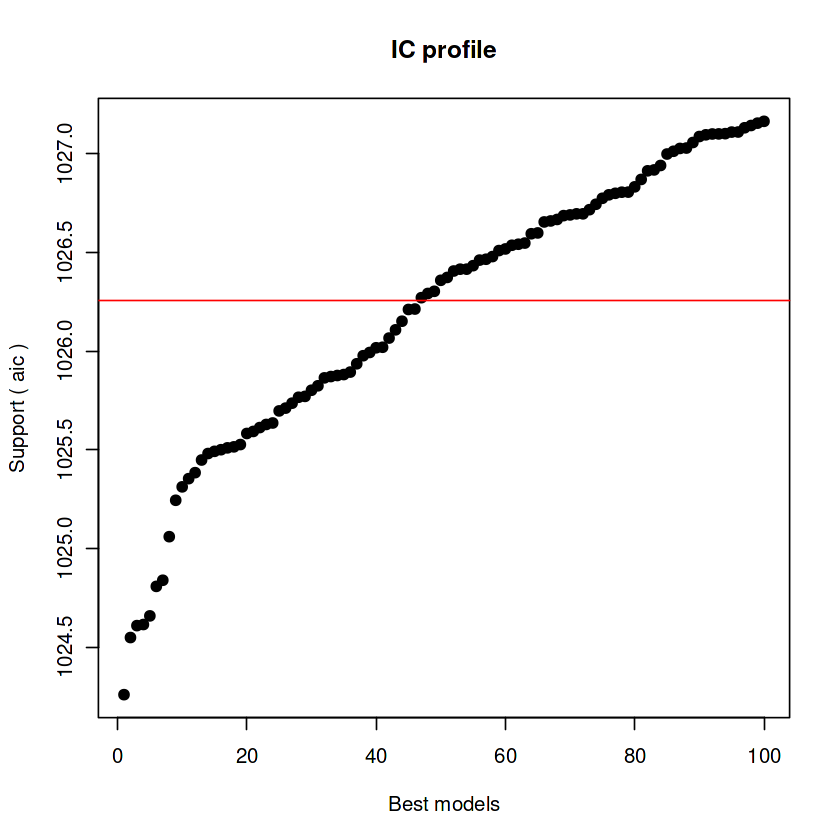


After 371900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 371950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 372000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 372050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 372100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 372150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 372200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 372250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 372300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 372350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 372400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 372450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.19638673567



After 372500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.18822710483



After 372550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.18053780953


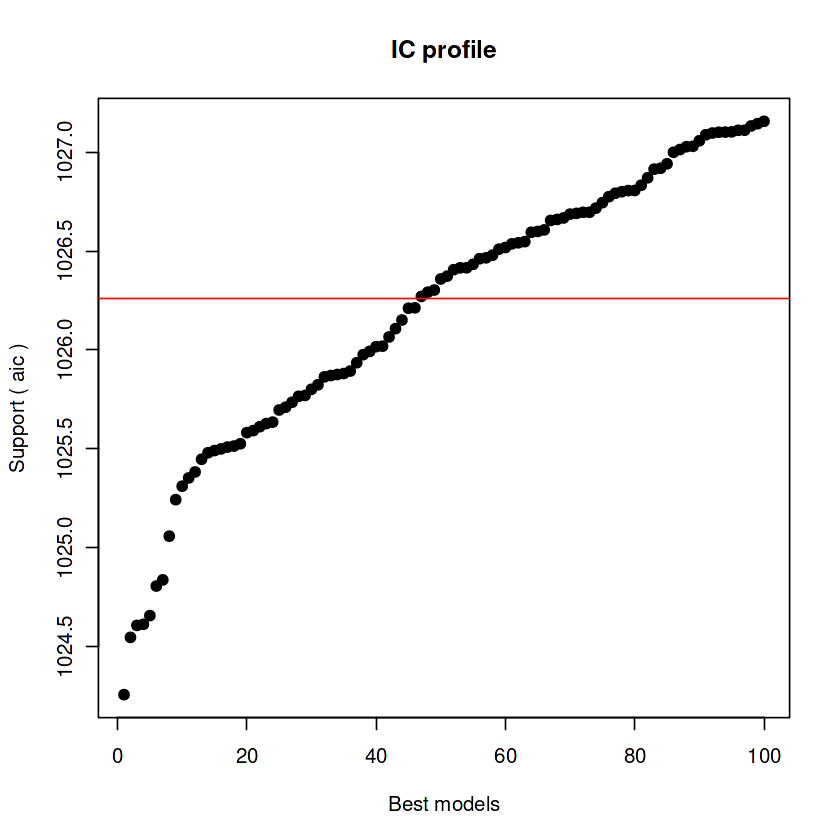


After 372600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423


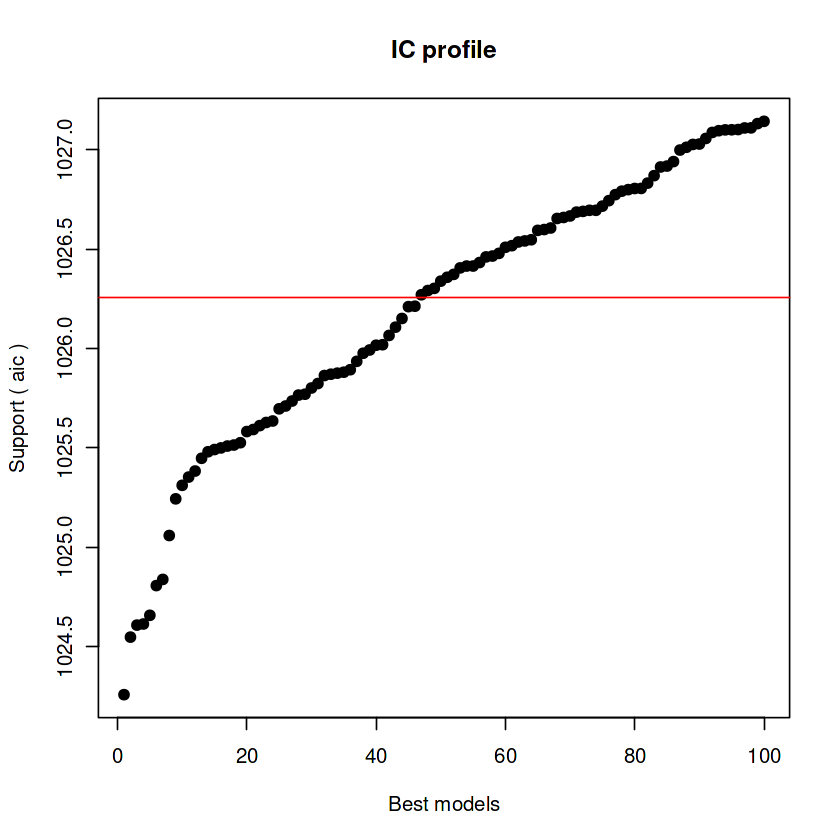


After 372650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423


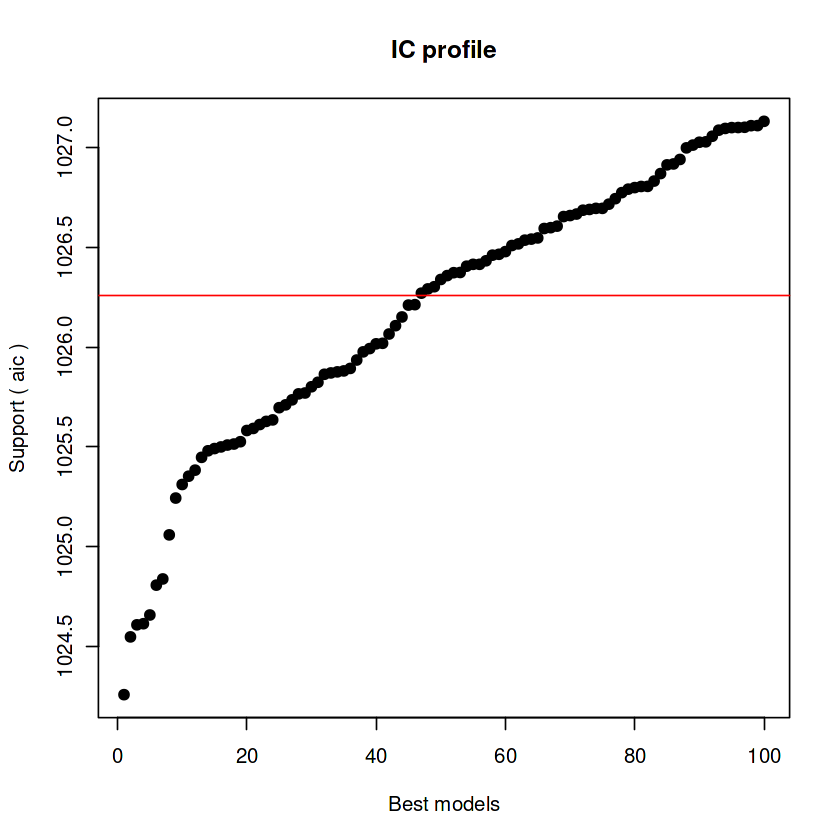


After 372700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 372750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 372800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 372850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 372900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 372950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 373950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 374950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 375000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 375050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 375100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 375150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 375200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 375250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 375300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 375350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 375400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.16768736423



After 375450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.14414668276



After 375500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.13422127815


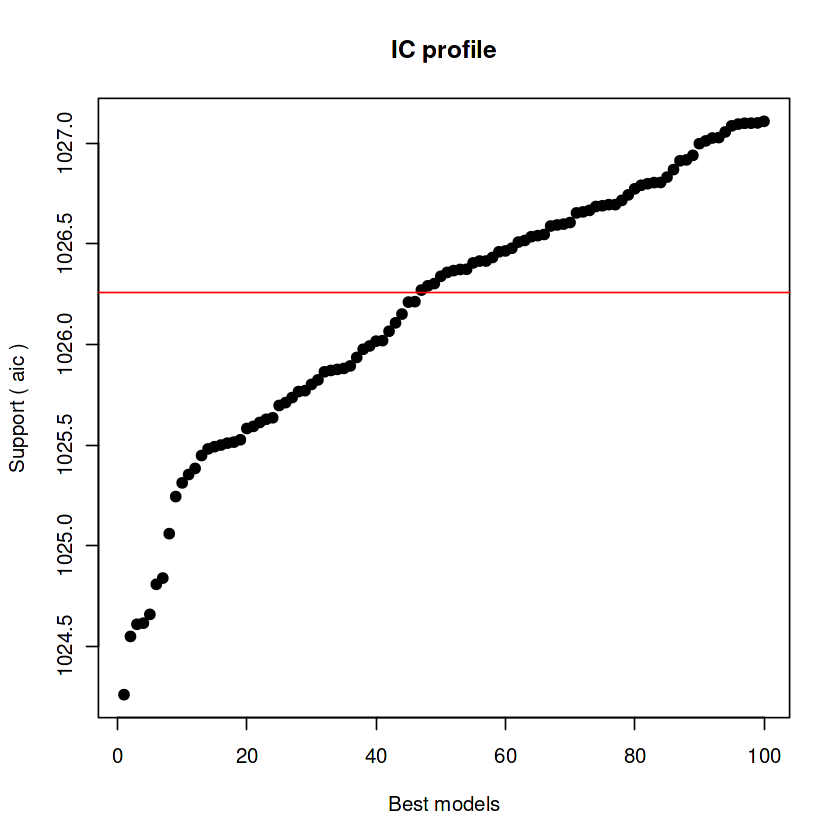


After 375550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.13422127815


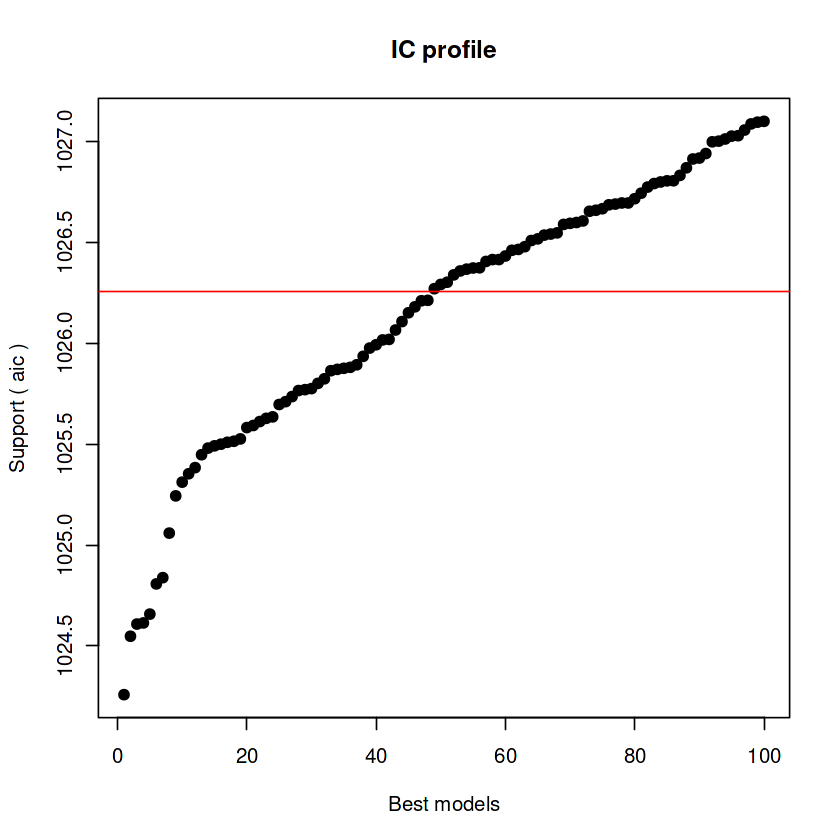


After 375600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.13422127815



After 375650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.13422127815



After 375700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.13422127815



After 375750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.13422127815



After 375800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.13422127815



After 375850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.13422127815



After 375900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.13422127815



After 375950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.10186971214



After 376000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.09400867595


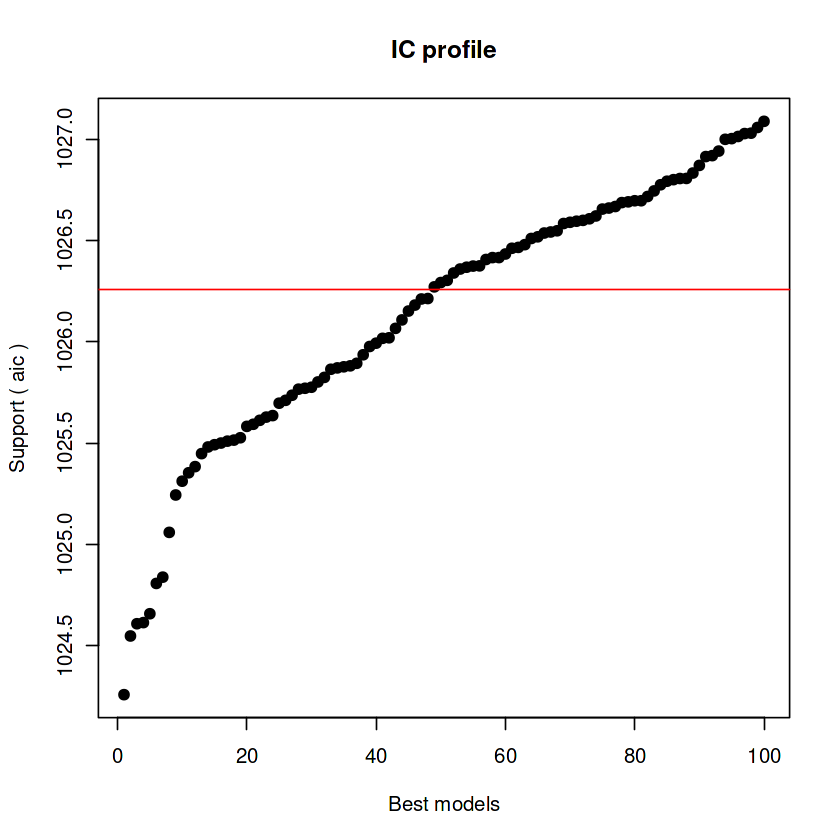


After 376050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.08624924407


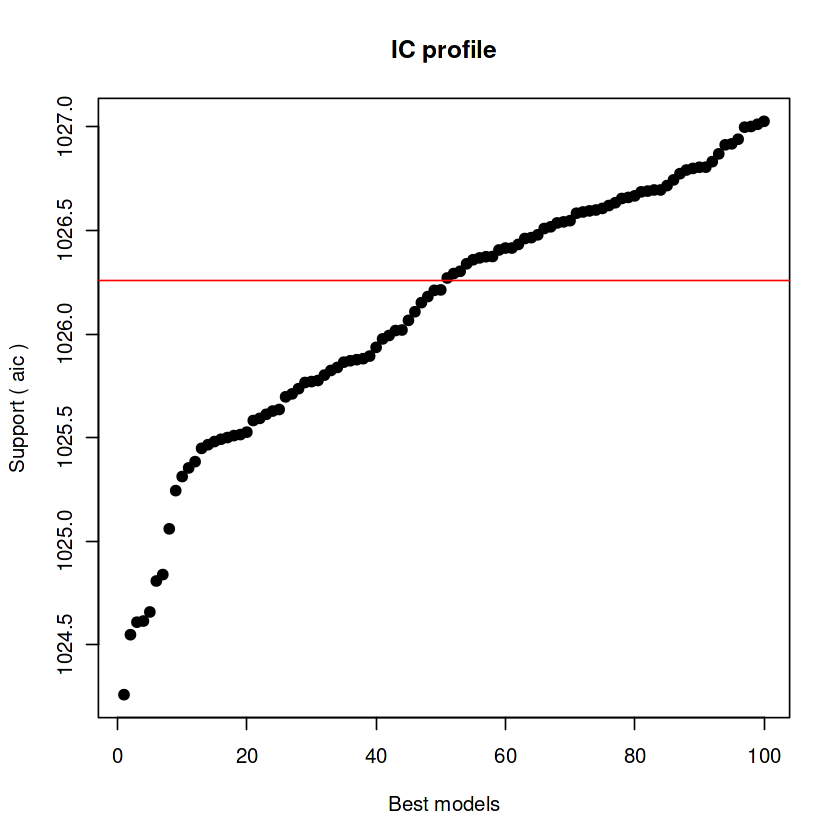


After 376100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.08624924407


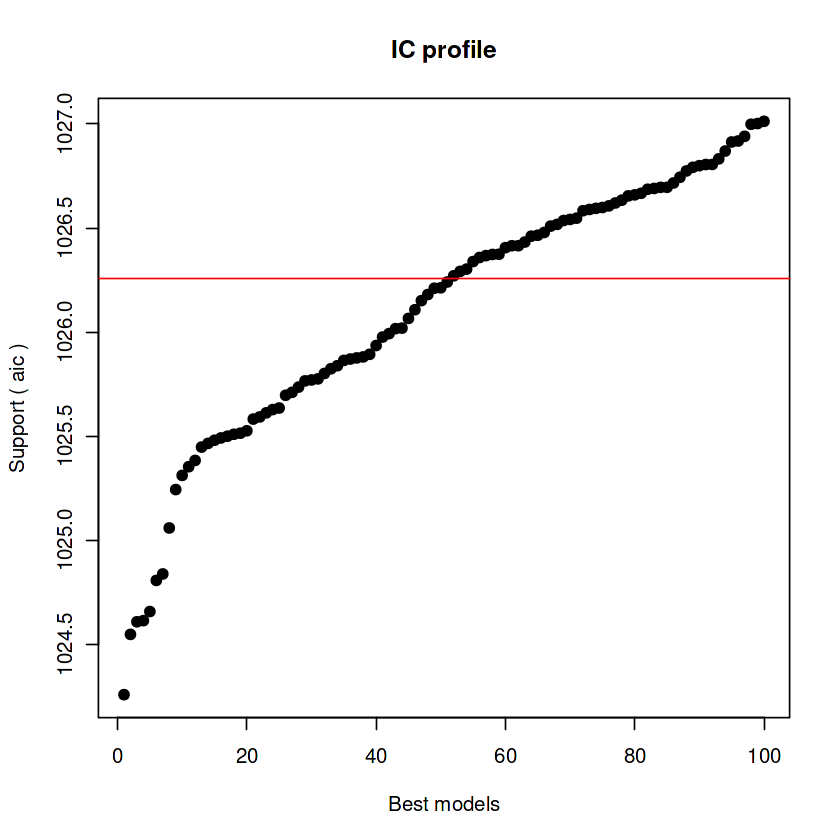


After 376150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.08624924407



After 376200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.07766816732



After 376250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.05989979161


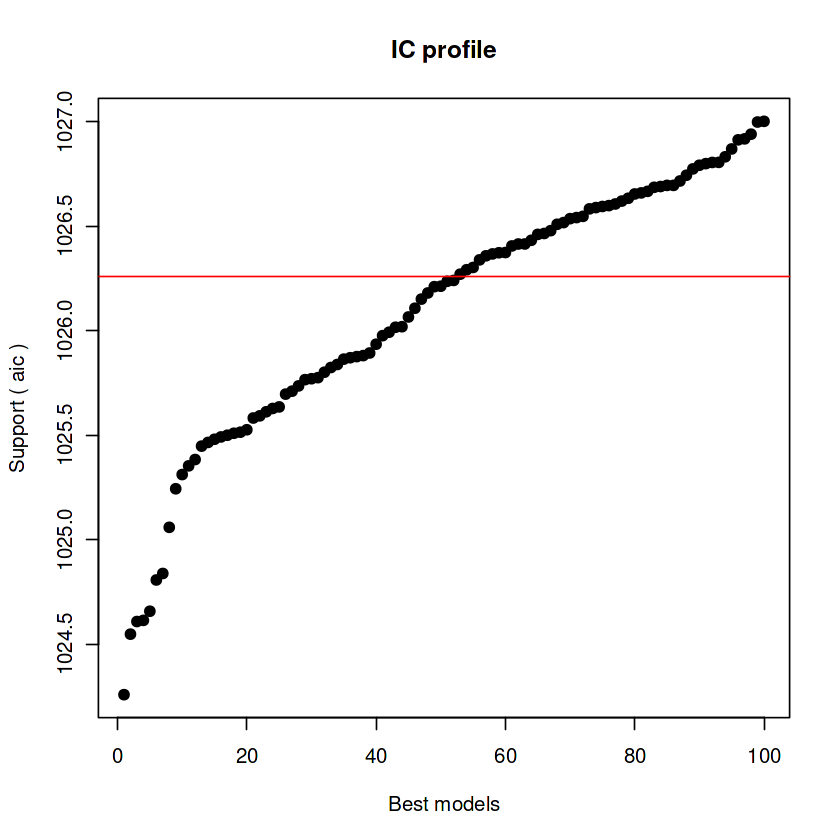


After 376300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.05225722313


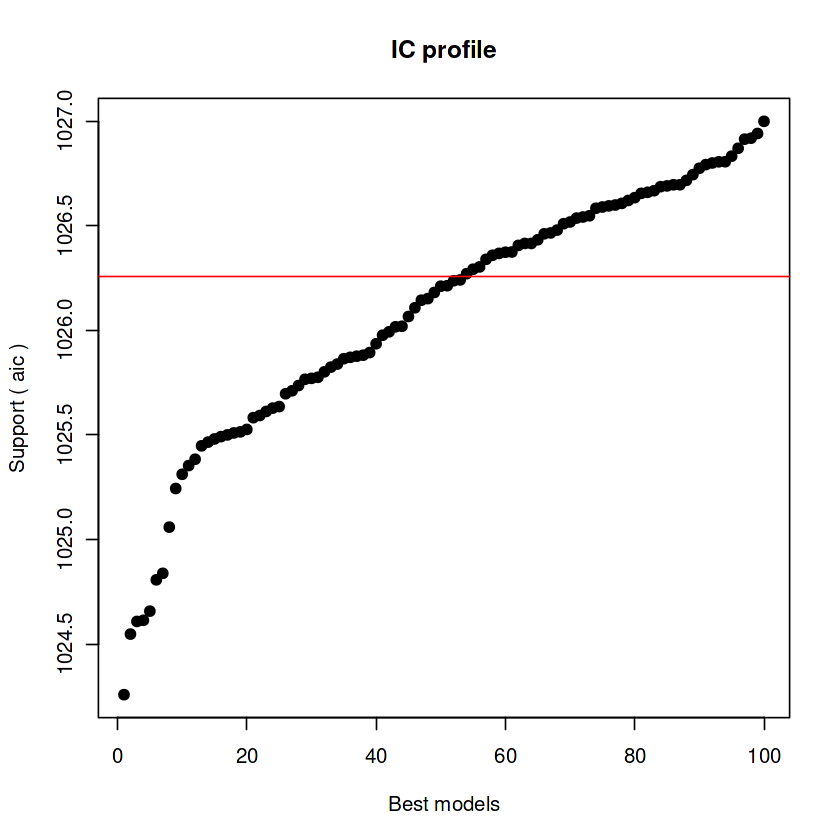


After 376350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.05225722313


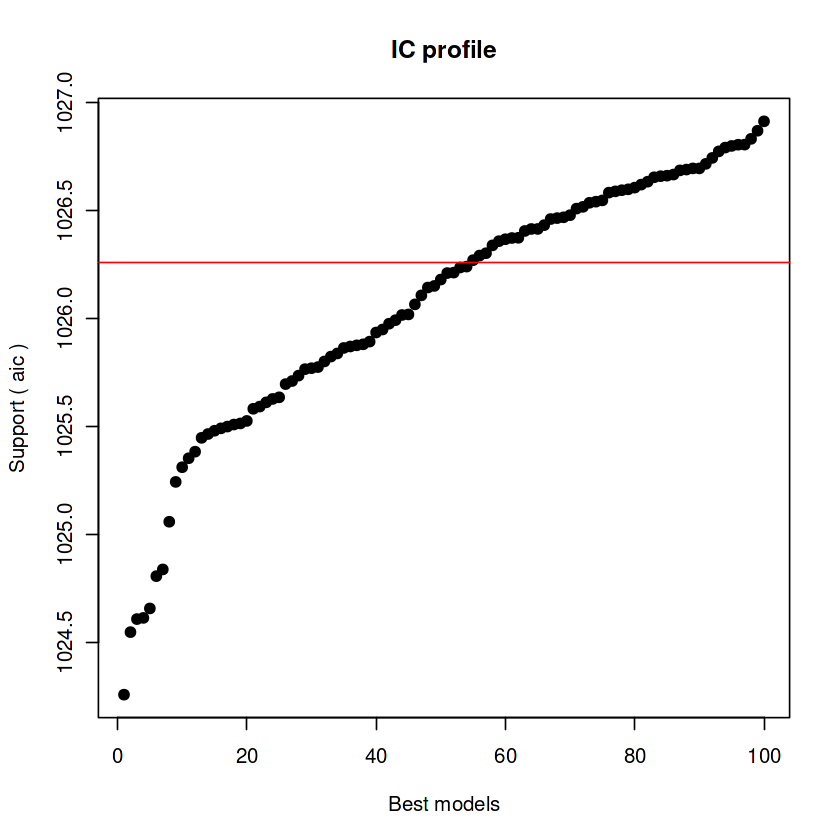


After 376400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.05225722313



After 376450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.05225722313



After 376500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.05225722313



After 376550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.05225722313



After 376600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.05225722313



After 376650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.05225722313



After 376700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.05225722313



After 376750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.0268401202



After 376800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.02289635519


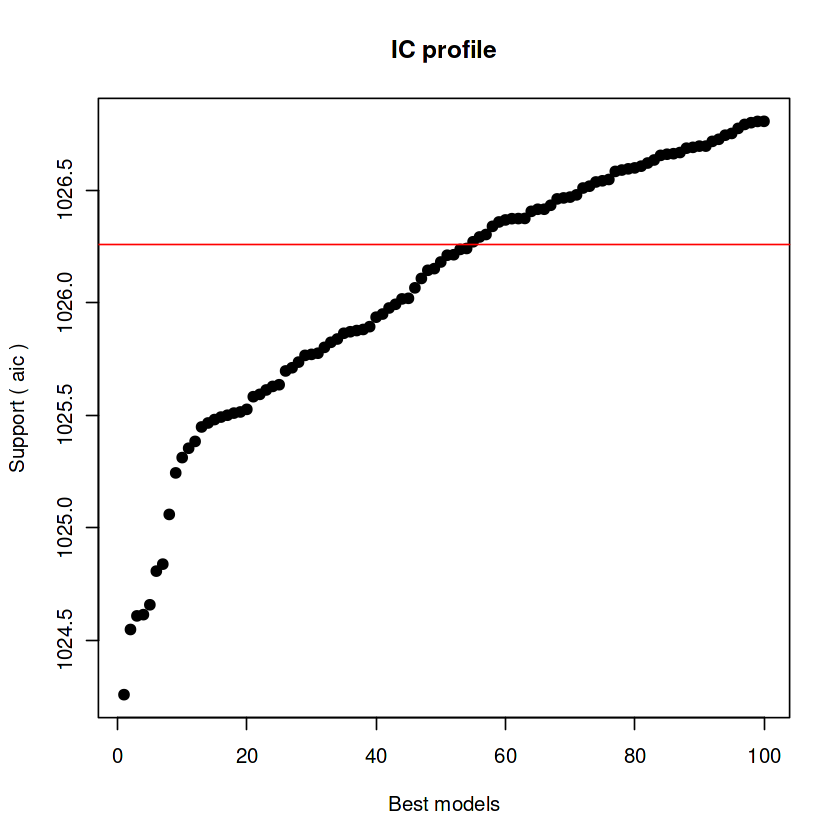


After 376850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799


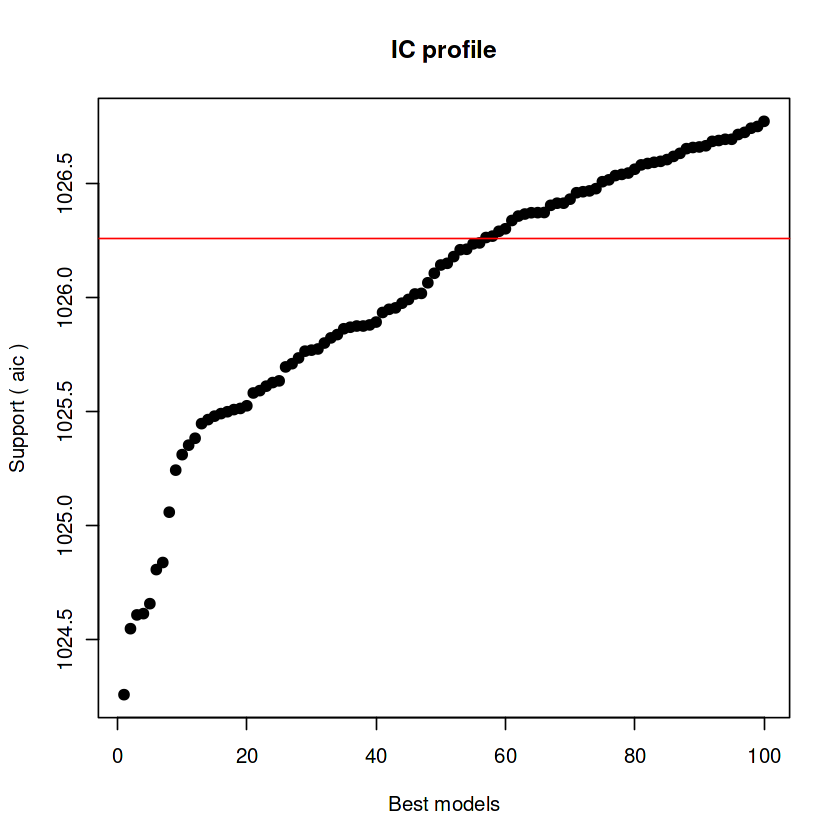


After 376900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799


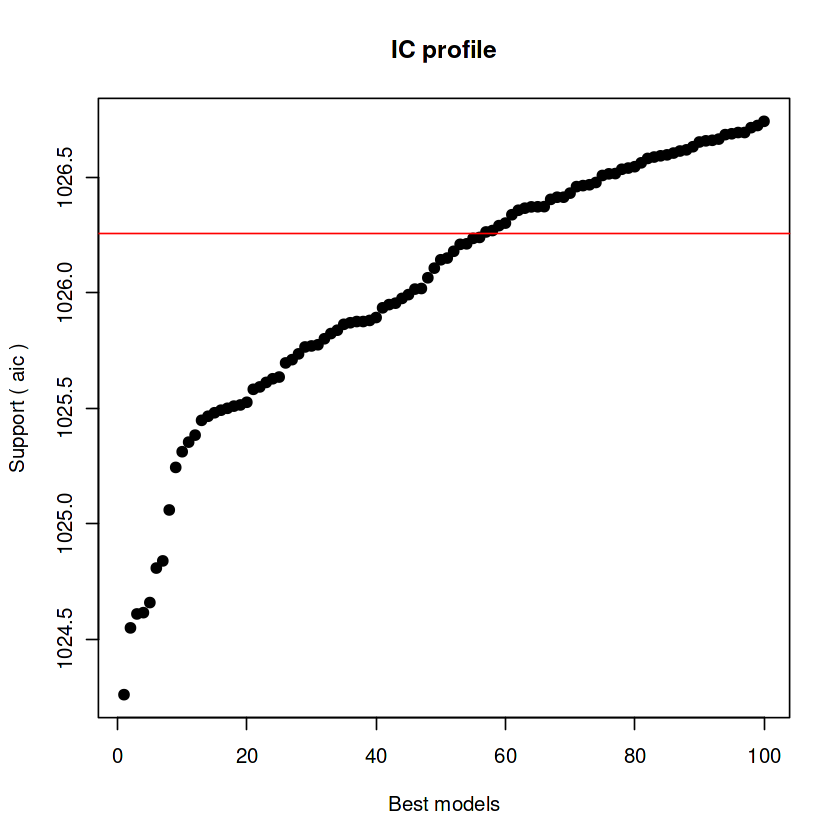


After 376950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 377950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 378950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01702900799



After 379650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01025068631



After 379700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.01025068631


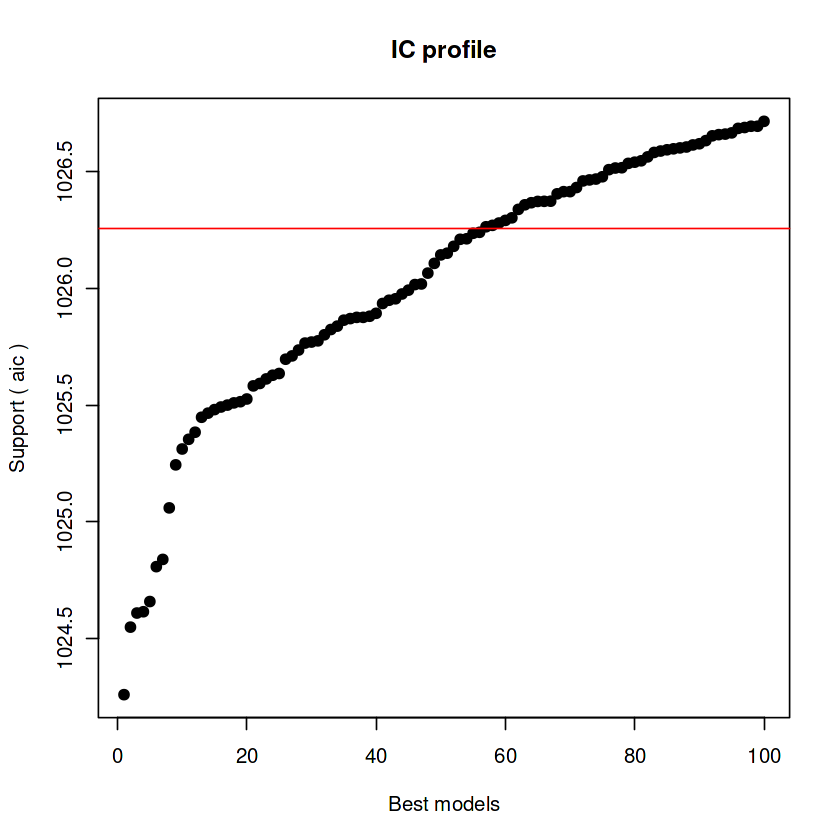


After 379750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.00963815997



After 379800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.00963815997


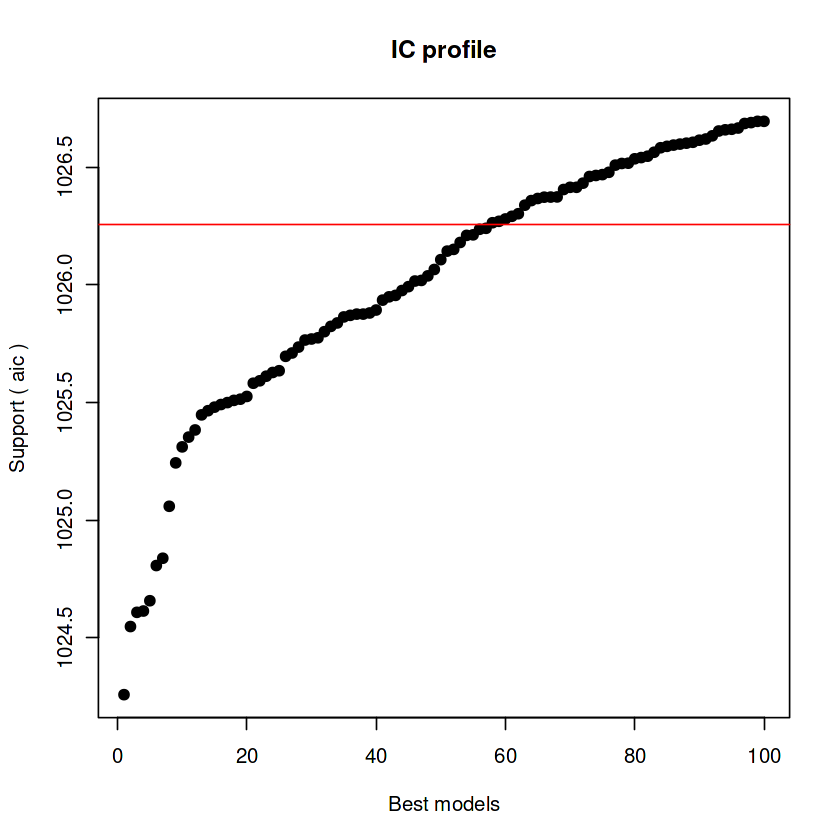


After 379850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.00963815997



After 379900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.00963815997



After 379950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.00963815997



After 380000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.00963815997



After 380050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.00963815997



After 380100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.00963815997



After 380150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1026.00963815997



After 380200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.99174574909



After 380250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.98142254914


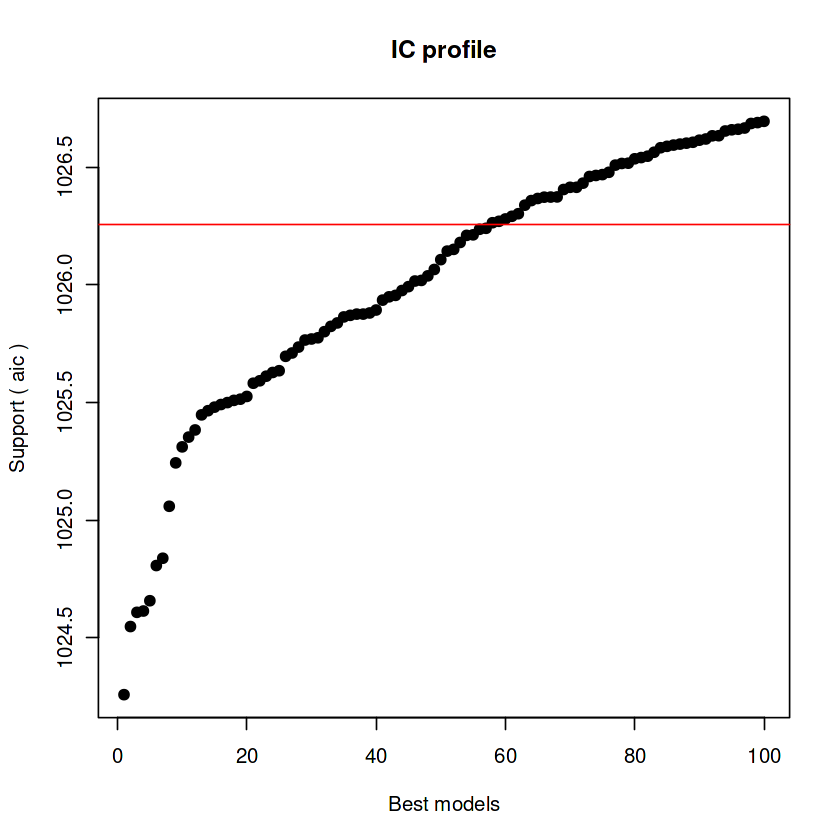


After 380300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.98142254914


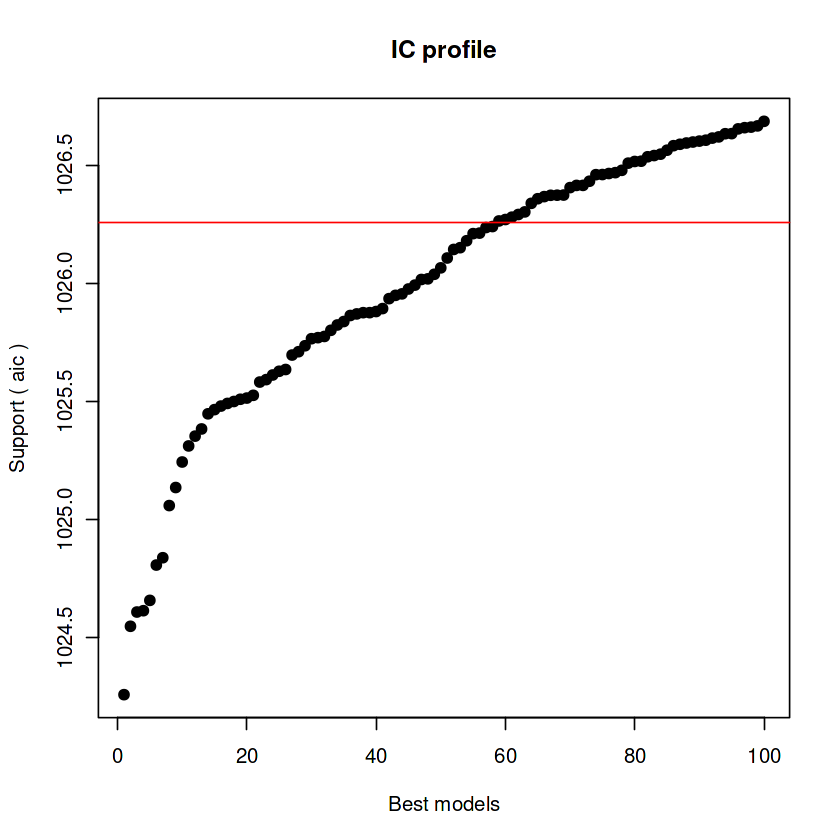


After 380350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.98142254914



After 380400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.98142254914



After 380450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.97108981534



After 380500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.97078866508


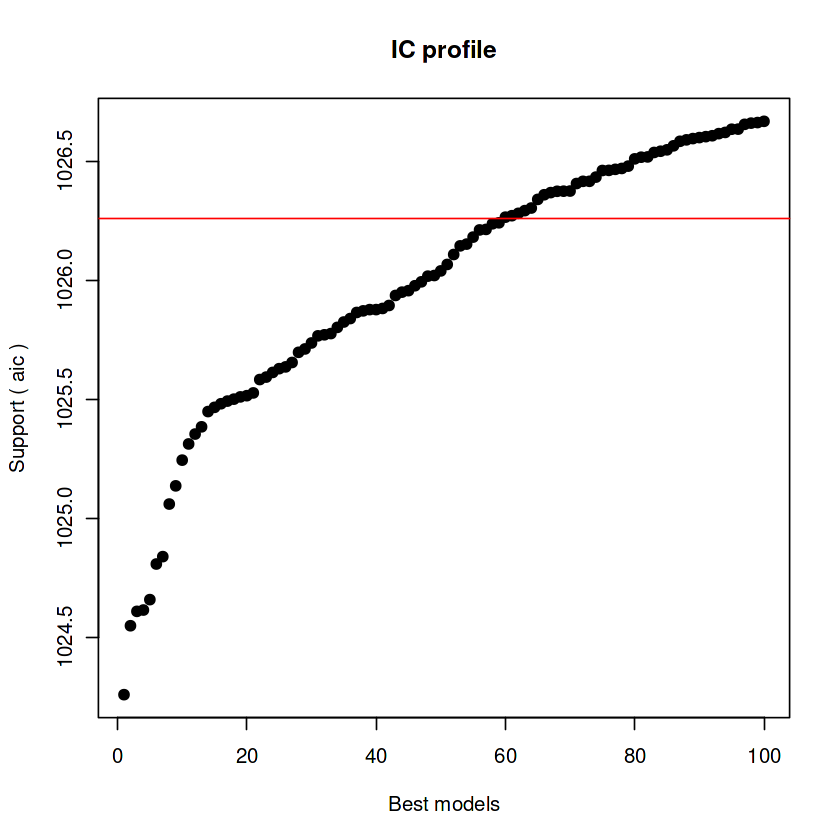


After 380550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.96719319454


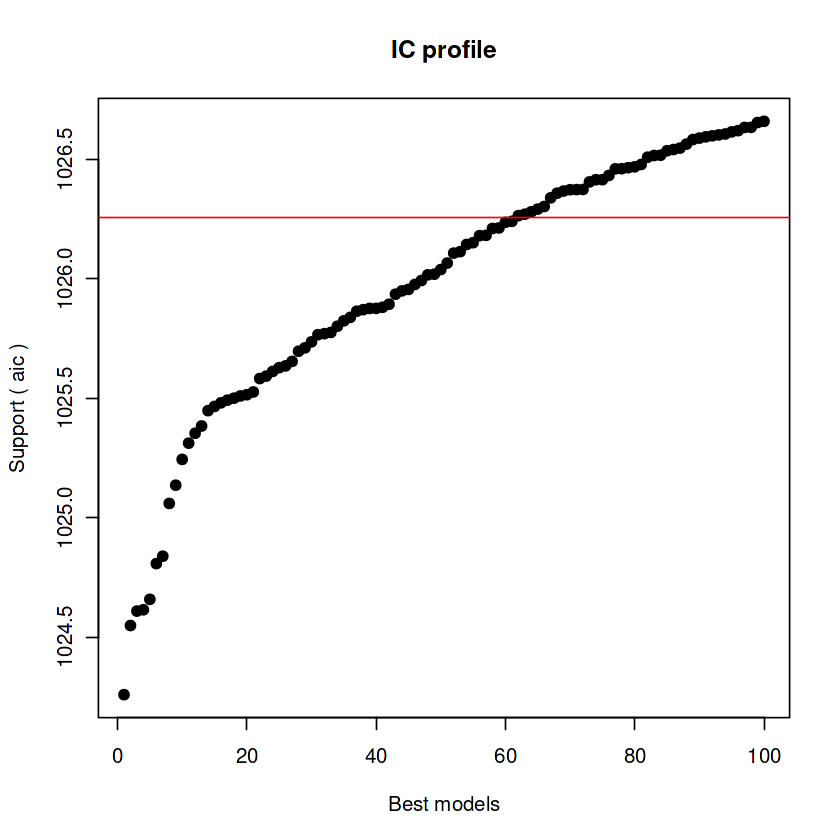


After 380600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.96719319454


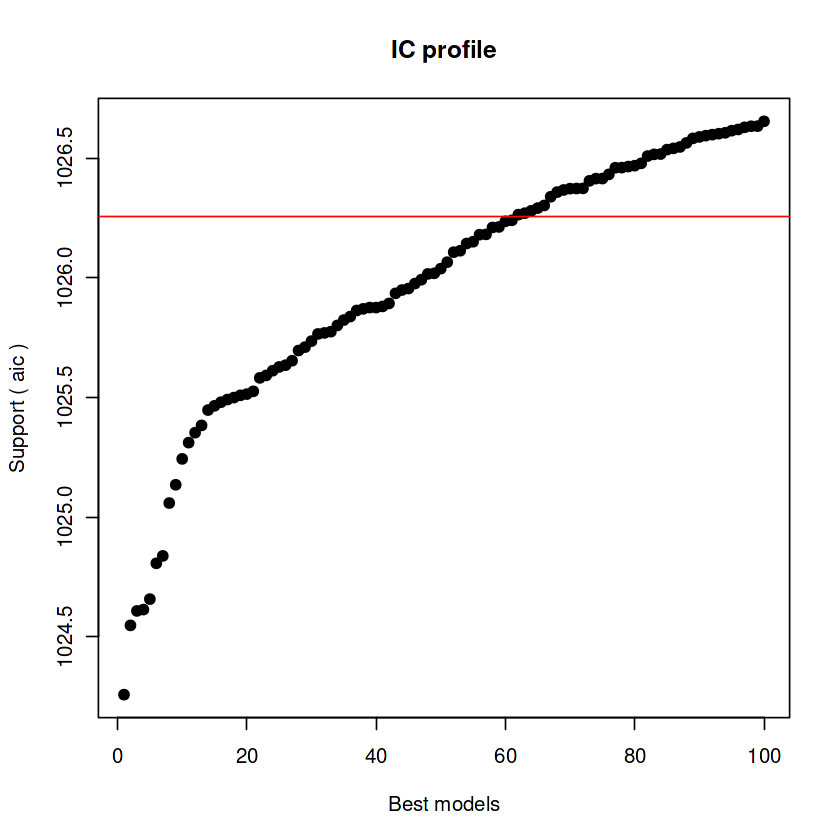


After 380650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.96719319454



After 380700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.96719319454



After 380750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.96719319454



After 380800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.96719319454



After 380850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.96719319454



After 380900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.96719319454



After 380950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.96719319454



After 381000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.94346776877



After 381050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92492495514


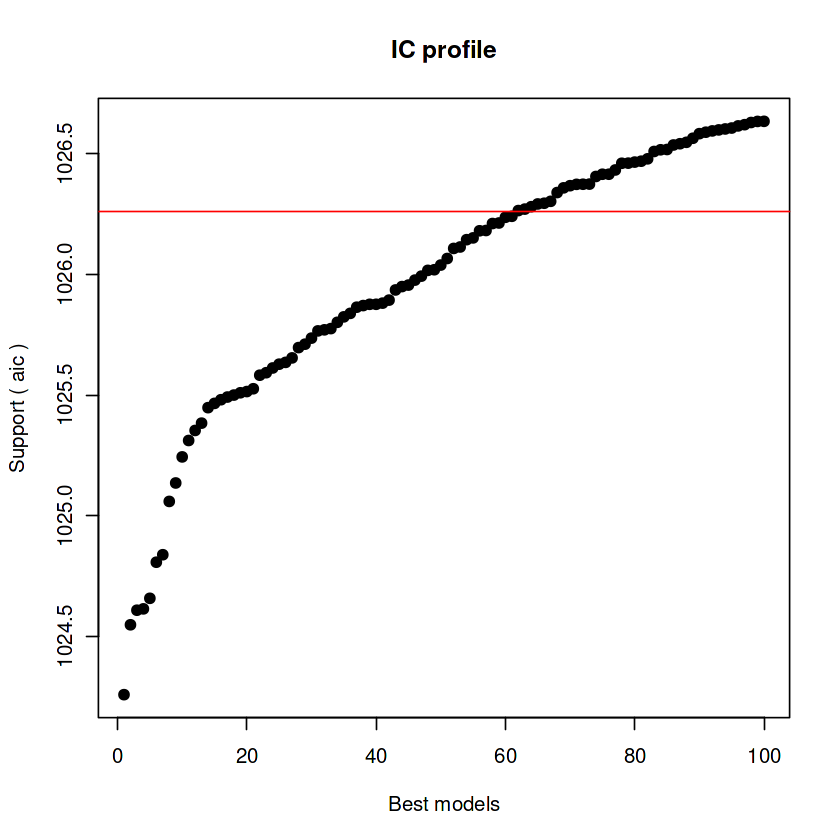


After 381100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92492495514


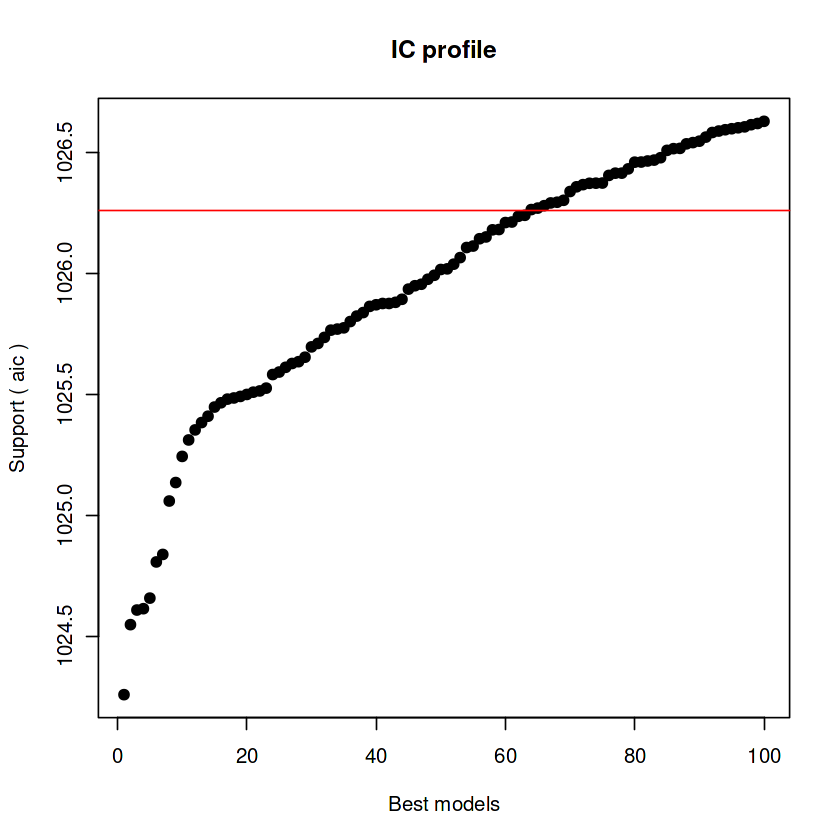


After 381150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92492495514



After 381200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92492495514



After 381250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348


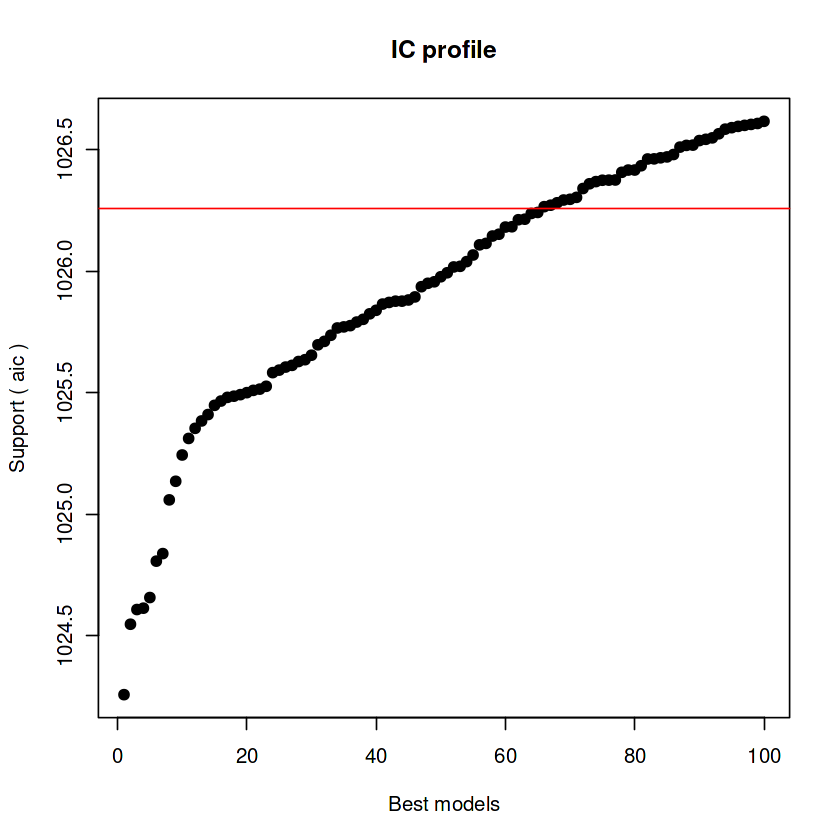


After 381350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 381950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 382950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 383950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 384950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 385950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 386950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 387950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 388950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 389950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 390950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 391950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 392950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 393950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 394950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 395950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 396950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 397000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 397050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 397100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92409763348



After 397150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746


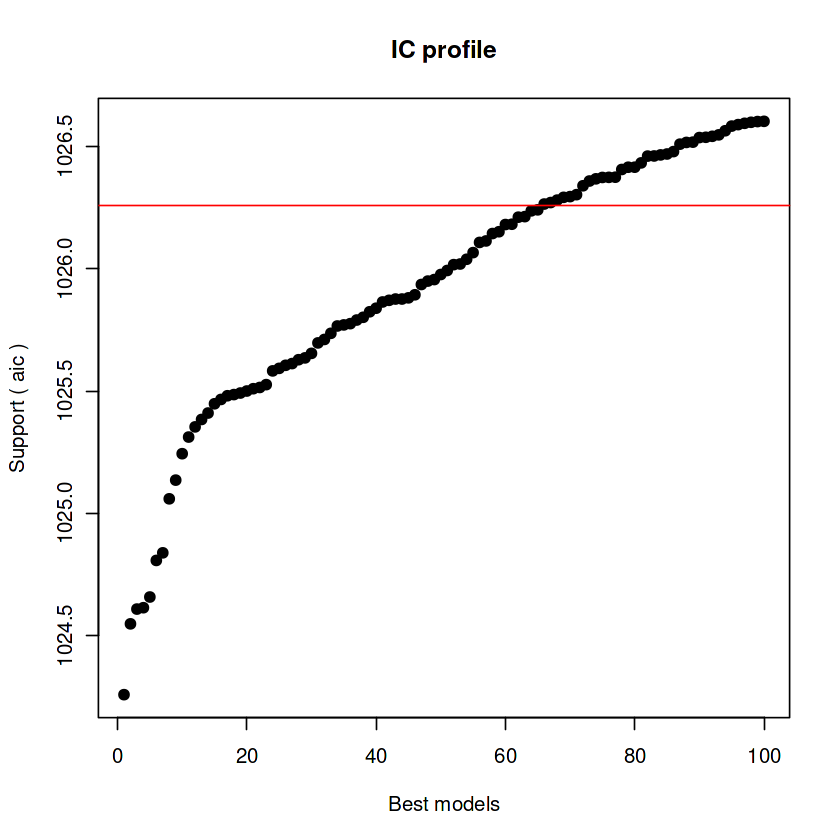


After 397250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.92001432746



After 397950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342


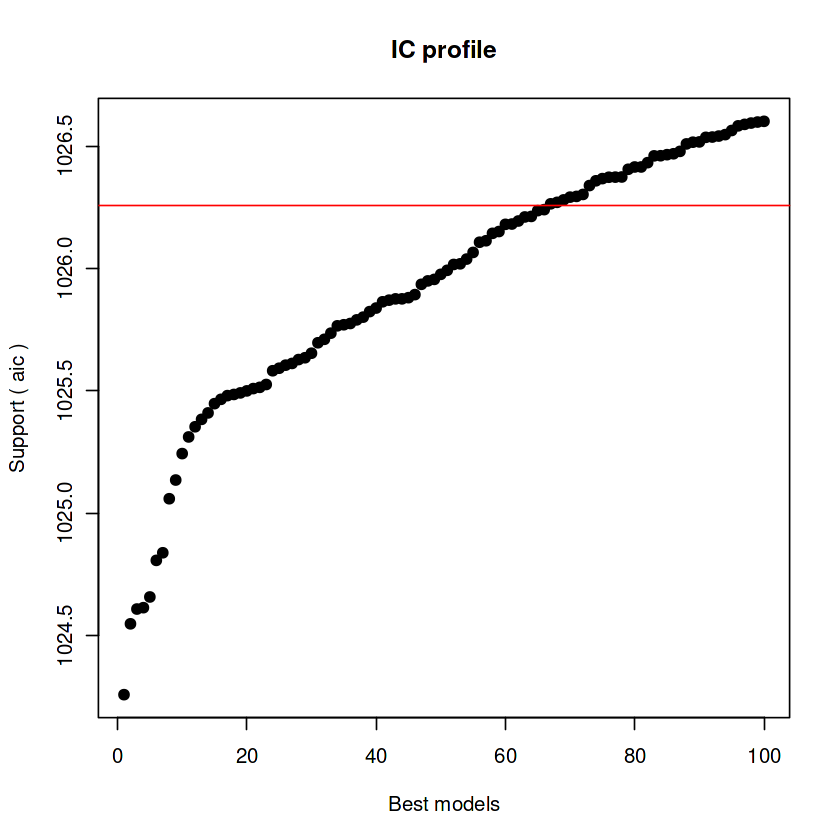


After 398050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 398950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 399950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 4e+05 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 400950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 401950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 402950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 403950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 404950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 405950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 406950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 407950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 408950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 409950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 410950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 411950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 412950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 413950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 414950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 415950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 416950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 417950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 418950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 419950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 420950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 421950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 422950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 423950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 424950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 425950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 426950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 427950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 428950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 429950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 430950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 431950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 432950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 433950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 434950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 435950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 436950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 437950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 438950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 439950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 440950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 441950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 442950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 443950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 444950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 445950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 446950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 447950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 448950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 449950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 450950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 451950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 452950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 453950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 454950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 455950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 456950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 457950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 458950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 459950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 460950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 461950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 462950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 463950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 464950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 465950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 466950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 467950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 468950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 469950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 470950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 471950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 472950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 473950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 474950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 475950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 476950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 477950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 478950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 479950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 480950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 481950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 482950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 483950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 484950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 485950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 486950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 487950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 488950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 489950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 490950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 491950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 492950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 493950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91851549342



After 494600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 494650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007


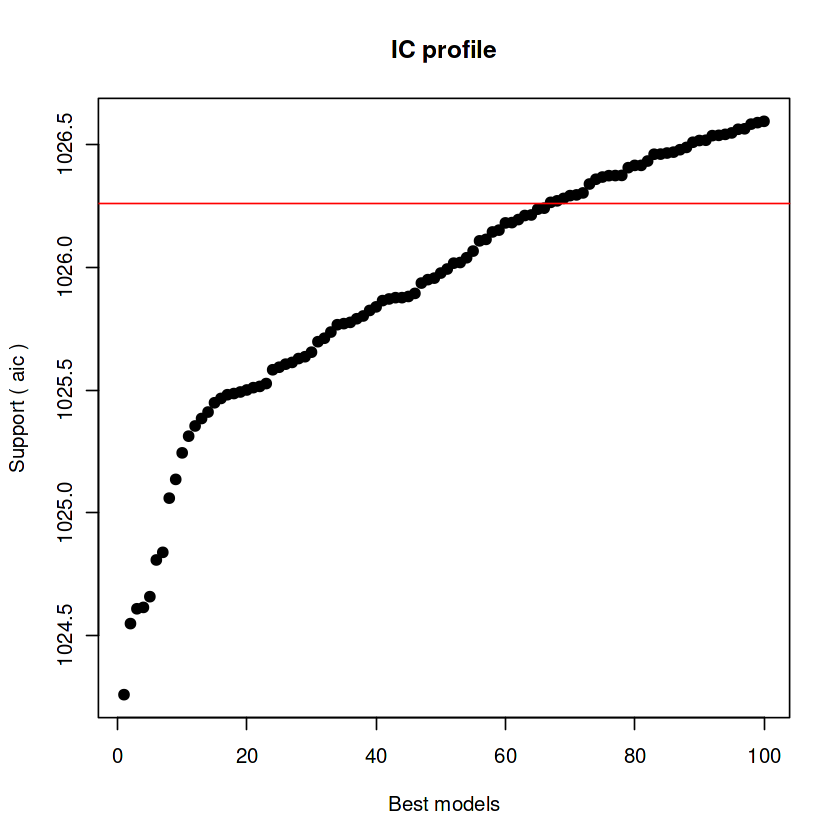


After 494700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 494750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 494800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 494850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 494900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 494950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 495000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 495050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 495100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 495150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 495200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 495250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 495300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 495350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.91066512007



After 495400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 495450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526


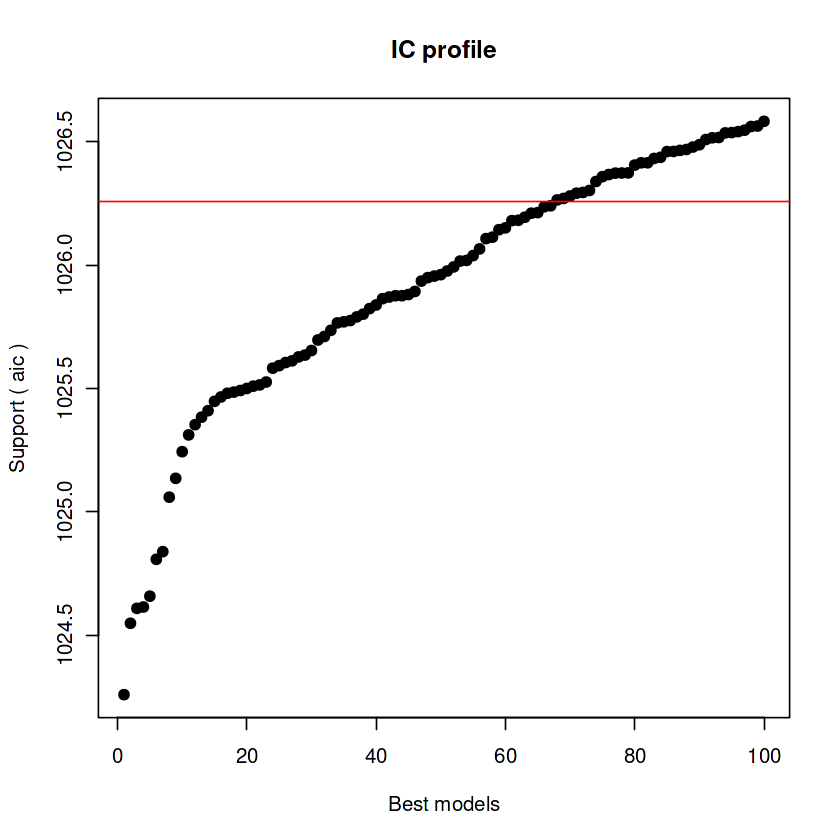


After 495500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 495550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 495600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 495650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 495700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 495750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 495800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 495850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 495900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 495950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 496950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 497950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90873283526



After 498850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.90067900259



After 498900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127


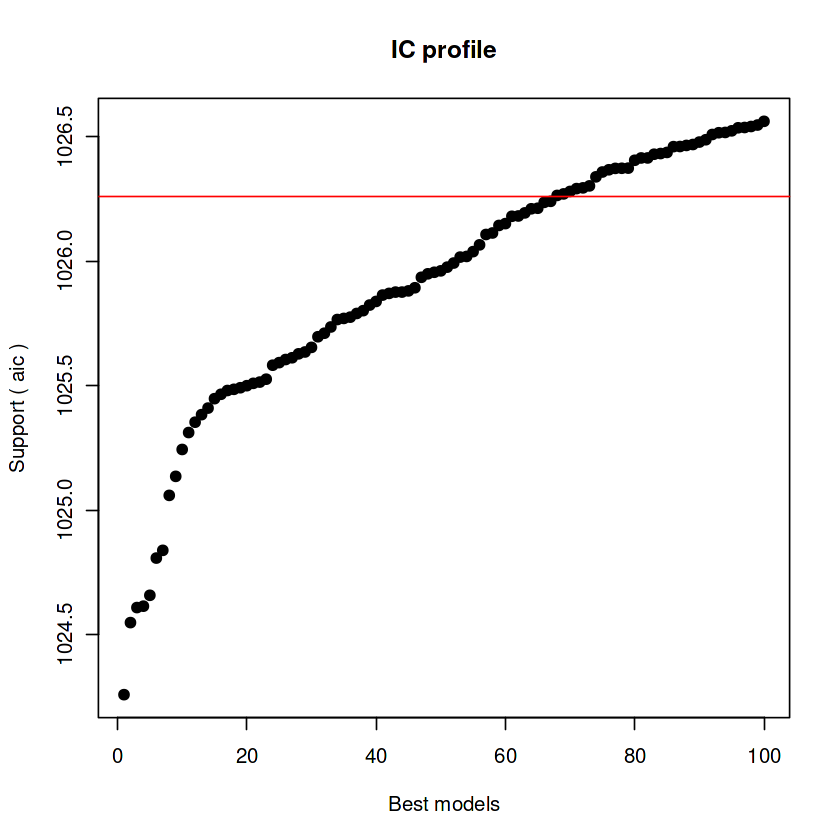


After 498950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127


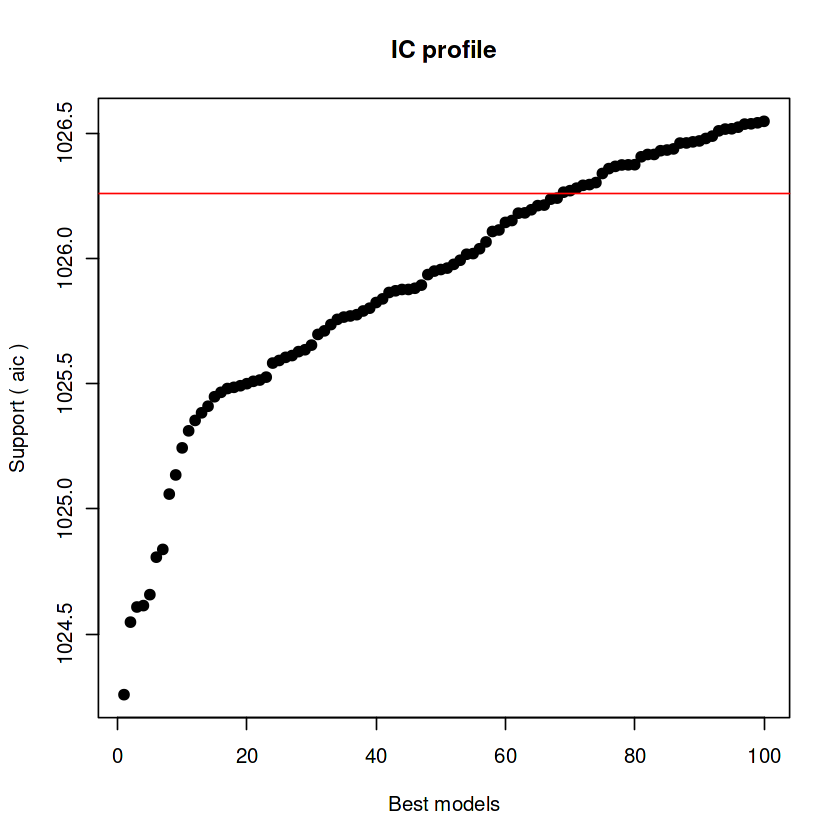


After 499000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.89753156127



After 499650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88918859079



After 499700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401


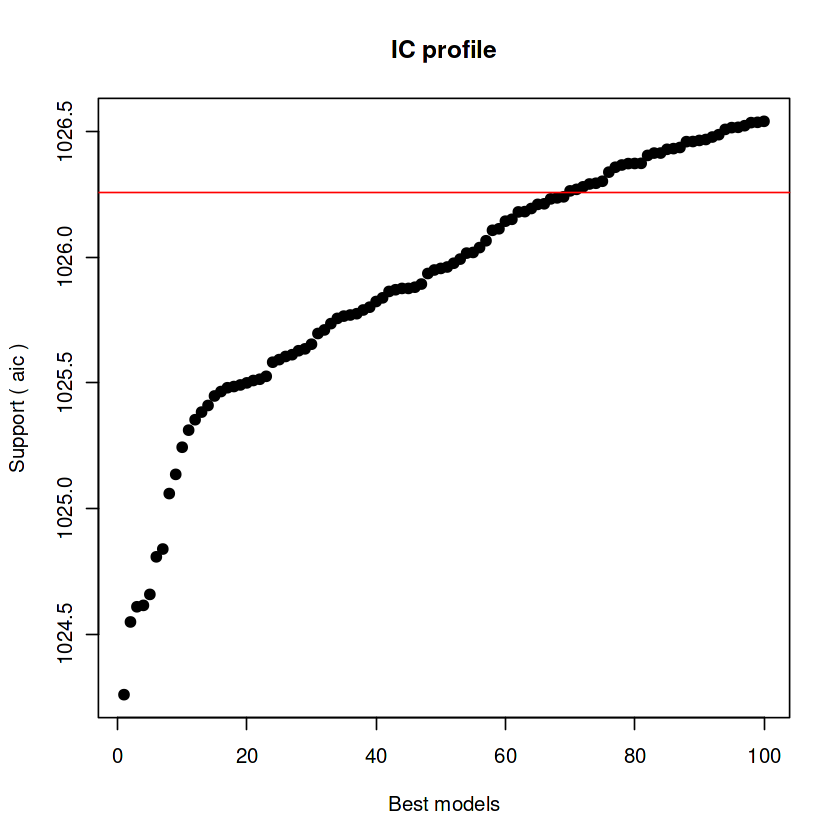


After 499750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401


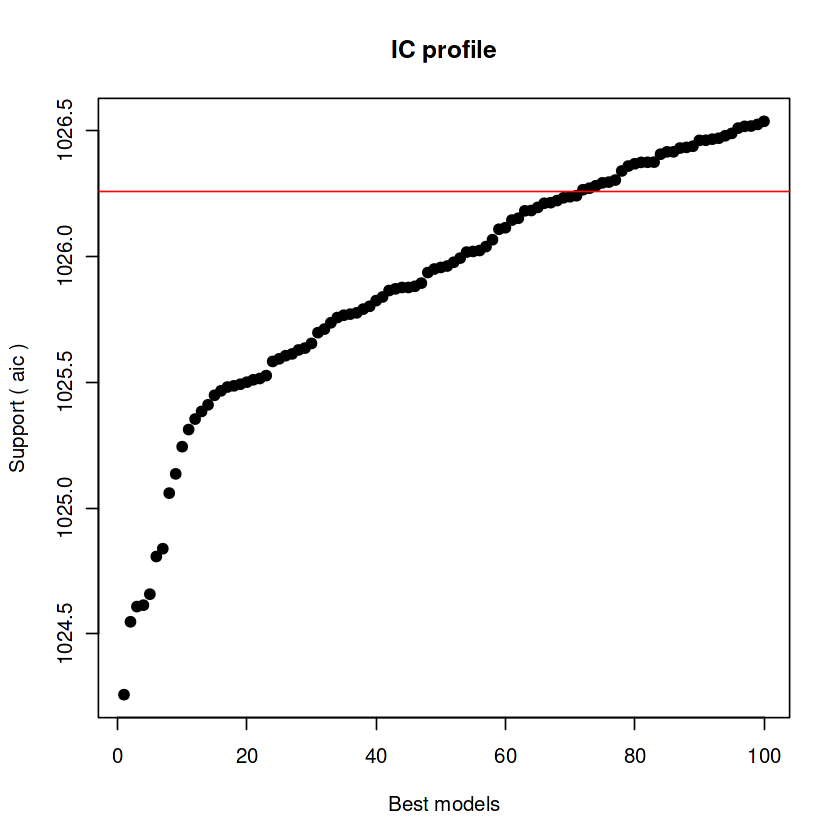


After 499800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 499850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 499900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 499950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 5e+05 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 500950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 501950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 502950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 503950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 504950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 505950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 506950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 507950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 508950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 509950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 510950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 511950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 512950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 513950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 514950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 515950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 516950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 517950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 518950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 519950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 520950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 521950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 522950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 523950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 524950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 525950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 526950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 527950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 528950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 529950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 530950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 531950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 532950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 533950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 534950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 535950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 536950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 537950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 538950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 539950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 540950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541400 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541450 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541500 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541550 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541600 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541650 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541700 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541750 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541800 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541850 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541900 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 541950 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 542000 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 542050 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 542100 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 542150 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 542200 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 542250 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 542300 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401



After 542350 models:
Best model: Life.expectancy~1+Status+Adult.Mortality+infant.deaths+Alcohol+under.five.deaths+Polio+Total.expenditure+HIV.AIDS+GDP+thinness..1.19.years+Income.composition.of.resources
Crit= 1024.2587742245
Mean crit= 1025.88530494401


Completed.



Call:
lm(formula = best_glmulti_model, data = data)

Residuals:
     Min       1Q   Median       3Q      Max 
-12.1453  -1.8025   0.1055   1.8773  13.1707 

Coefficients:
                                  Estimate Std. Error t value Pr(>|t|)    
(Intercept)                      6.978e+01  2.174e+00  32.098  < 2e-16 ***
StatusDeveloping                -2.912e+00  9.322e-01  -3.124 0.002098 ** 
Adult.Mortality                 -2.910e-02  3.827e-03  -7.604 1.82e-12 ***
infant.deaths                    1.089e-01  3.863e-02   2.818 0.005399 ** 
Alcohol                          2.505e-01  8.637e-02   2.900 0.004222 ** 
under.five.deaths               -8.312e-02  2.917e-02  -2.850 0.004910 ** 
Polio                            3.072e-02  1.516e-02   2.026 0.044339 *  
Total.expenditure                1.936e-01  1.117e-01   1.734 0.084750 .  
HIV.AIDS                        -1.038e+00  2.701e-01  -3.842 0.000172 ***
GDP                              3.007e-05  1.930e-05   1.558 0.121055    
thi

Best model formula (glmulti): ~ Life.expectancy 1 + Status + Adult.Mortality + infant.deaths + Alcohol + under.five.deaths + Polio + Total.expenditure + HIV.AIDS + GDP + thinness..1.19.years + Income.composition.of.resources 


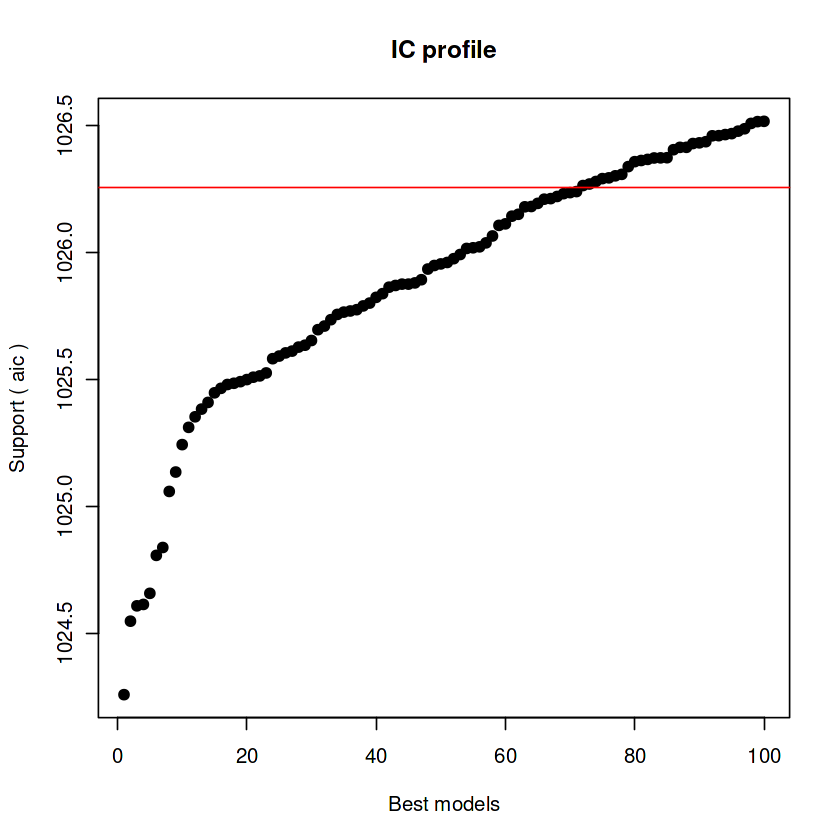

In [8]:
# Perform all-subset regression using glmulti (AIC criterion)
glmulti_fit <- glmulti(Life.expectancy ~ ., data = data, level = 1, crit = "aic", method = "h")

# Summary of the best model
best_glmulti_model <- glmulti_fit@formulas[[1]]
best_model_fit <- lm(best_glmulti_model, data = data)
summary(best_model_fit)

# Display the formula for the best model
cat("Best model formula (glmulti):", as.character(best_glmulti_model), "\n")


In [9]:
# Compare Adjusted R^2 for all models
cat("Adjusted R^2 for full model:", summary(full_model)$adj.r.squared, "\n")
cat("Adjusted R^2 for AIC-selected model:", adj_r2_aic, "\n")
cat("Adjusted R^2 for BIC-selected model:", adj_r2_bic, "\n")
cat("Adjusted R^2 for best all-subset model:", max(subset_summary$adjr2), "\n")


Adjusted R^2 for full model: 0.7961125 


Adjusted R^2 for AIC-selected model: 0.7996924 


Adjusted R^2 for BIC-selected model: 0.7921614 


Adjusted R^2 for best all-subset model: 0.7933889 
